In [9]:
import pandas as pd
import numpy as np
from math import log
import operator
import pickle
import re

### Pandas Reading

In [3]:
data = pd.read_csv('adult.csv')

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32560 entries, 0 to 32559
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   39              32560 non-null  int64 
 1    State-gov      32560 non-null  object
 2    77516          32560 non-null  int64 
 3    Bachelors      32560 non-null  object
 4    13             32560 non-null  int64 
 5    Never-married  32560 non-null  object
 6    Adm-clerical   32560 non-null  object
 7    Not-in-family  32560 non-null  object
 8    White          32560 non-null  object
 9    Male           32560 non-null  object
 10   2174           32560 non-null  int64 
 11   0              32560 non-null  int64 
 12   40             32560 non-null  int64 
 13   United-States  32560 non-null  object
 14   <=50K          32560 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [11]:
test = pd.read_csv('adult_test.csv')

In [12]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16280 entries, 0 to 16279
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   25                  16280 non-null  int64 
 1    Private            16280 non-null  object
 2    226802             16280 non-null  int64 
 3    11th               16280 non-null  object
 4    7                  16280 non-null  int64 
 5    Never-married      16280 non-null  object
 6    Machine-op-inspct  16280 non-null  object
 7    Own-child          16280 non-null  object
 8    Black              16280 non-null  object
 9    Male               16280 non-null  object
 10   0                  16280 non-null  int64 
 11   0.1                16280 non-null  int64 
 12   40                 16280 non-null  int64 
 13   United-States      16280 non-null  object
 14   <=50K.             16280 non-null  object
dtypes: int64(6), object(9)
memory usage: 1.9+ MB


In [5]:
data.head()

,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
0,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
1,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
3,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
4,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K


### Python Reading & Cleaning

#### remove '?', convert label to 1/-1 and delete the last blank row

In [238]:
def readData(filename):
    with open(filename, 'r') as f:
        data=[]
        # f.readline() # Uncomment here when reading adult.test
        for line in f.readlines():
            data += [line.strip().split(', ')]
        data = [[int(i) if i.isdigit() else i for i in row] for row in data] # String to int with numeric data
        data = [[1 if i=='>50K' else i for i in row] for row in data]
        data = [[-1 if i=='<=50K' else i for i in row] for row in data] #deal with label
        for row in data[:]:
            for column in row:
                if column == '?':
                    data.remove(row)
                    break
        del (data[-1]) #delete last row with no data
        return data

In [369]:
def readTestData(filename):
    with open(filename, 'r') as f:
        data=[]
        # f.readline() # Uncomment here when reading adult.test
        for line in f.readlines():
            data += [line.strip().split(', ')]
        data = [[int(i) if i.isdigit() else i for i in row] for row in data] # String to int with numeric data
        data = [[1 if i=='>50K.' else i for i in row] for row in data]
        data = [[-1 if i=='<=50K.' else i for i in row] for row in data] #deal with label
        for row in data[:]:
            for column in row:
                if column == '?':
                    data.remove(row)
                    break
        del (data[-1]) #delete last row with no data
        return data

In [563]:
X = readData('adult.csv')

In [564]:
test = readTestData('adult_test.csv')

In [565]:
column_names = ['age','workclass','fnlwgt','education','education-num','marital-status','occupation','relationship','race','sex','capital-gain','capital-loss','hours-per-week','income']

#### Remove Column native-country

In [566]:
X[:] = [i[:13]+i[14:] for i in X]

In [567]:
test[:] = [i[:13]+i[14:] for i in test]

In [568]:
for i in range(len(X)):
    X[i][2] = round(X[i][2]/10000) * 10000

In [569]:
for i in range(len(X)):
    X[i][10] = round(X[i][10]/1000) * 1000

In [570]:
for i in range(len(test)):
    test[i][2] = round(test[i][2]/10000) * 10000

In [571]:
for i in range(len(test)):
    test[i][10] = round(test[i][10]/1000) * 1000

### Find Unique Value for a column

In [23]:
def unique(rows, col):
    return set([row[col] for row in rows])

### Count Labels of the Set

In [492]:
def label_classes(data):
    counts = {1:0,-1:0}
    for row in data:
        label = row[-1]
        counts[label] += 1
    return counts

In [493]:
label_classes(X[0:10])

{1: 3, -1: 7}

### Checking Attribute

In [469]:
class check:   
    def __init__(self, col, val):
        self.col = col
        self.val = val
    
    def check(self, pending):
        pending_val = pending[self.col]
        if isinstance(pending_val, int):
            if pending_val >= self.val:
                return True
            else:
                return False
        else:
            if pending_val == self.val:
                return True
            else:
                return False
        
    def __repr__(self):
        condition = "=="
        if isinstance(self.val, int):
            condition = ">="
        return "Is %s %s %s?" % (
            column_names[self.col], condition, str(self.val))

In [476]:
c = check(9, 'Male') # check if it is male

In [477]:
pending = X[0]
c.check(pending)

True

In [472]:
c2 = check(0, 28) # check whether the age is larger and equal than 28

In [473]:
pending1 = X[0]
c2.check(pending1)

True

### Partitioning Rows

In [190]:
def partition(check, data):
    true_set = []
    false_set = []
    for row in data:
        if check.check(row):
            true_set.append(row)
        else:
            false_set.append(row)
    return true_set, false_set

In [191]:
t, f = partition(check(9, 'Female'), X[0:10])

In [192]:
t

[[28,
  'Private',
  340000,
  'Bachelors',
  13,
  'Married-civ-spouse',
  'Prof-specialty',
  'Wife',
  'Black',
  'Female',
  0,
  0,
  40,
  -1],
 [37,
  'Private',
  280000,
  'Masters',
  14,
  'Married-civ-spouse',
  'Exec-managerial',
  'Wife',
  'White',
  'Female',
  0,
  0,
  40,
  -1],
 [49,
  'Private',
  160000,
  '9th',
  5,
  'Married-spouse-absent',
  'Other-service',
  'Not-in-family',
  'Black',
  'Female',
  0,
  0,
  16,
  -1],
 [31,
  'Private',
  50000,
  'Masters',
  14,
  'Never-married',
  'Prof-specialty',
  'Not-in-family',
  'White',
  'Female',
  14000,
  0,
  50,
  1]]

In [193]:
f

[[39,
  'State-gov',
  80000,
  'Bachelors',
  13,
  'Never-married',
  'Adm-clerical',
  'Not-in-family',
  'White',
  'Male',
  2000,
  0,
  40,
  -1],
 [50,
  'Self-emp-not-inc',
  80000,
  'Bachelors',
  13,
  'Married-civ-spouse',
  'Exec-managerial',
  'Husband',
  'White',
  'Male',
  0,
  0,
  13,
  -1],
 [38,
  'Private',
  220000,
  'HS-grad',
  9,
  'Divorced',
  'Handlers-cleaners',
  'Not-in-family',
  'White',
  'Male',
  0,
  0,
  40,
  -1],
 [53,
  'Private',
  230000,
  '11th',
  7,
  'Married-civ-spouse',
  'Handlers-cleaners',
  'Husband',
  'Black',
  'Male',
  0,
  0,
  40,
  -1],
 [52,
  'Self-emp-not-inc',
  210000,
  'HS-grad',
  9,
  'Married-civ-spouse',
  'Exec-managerial',
  'Husband',
  'White',
  'Male',
  0,
  0,
  45,
  1],
 [42,
  'Private',
  160000,
  'Bachelors',
  13,
  'Married-civ-spouse',
  'Exec-managerial',
  'Husband',
  'White',
  'Male',
  5000,
  0,
  40,
  1]]

In [497]:
def gini(data):
    cnt = label_classes(data)
    gini = 1
    prob_of_1 = cnt[1] / float(len(data))
    prob_of_0 = cnt[-1] / float(len(data))
    # print(cnt[1], cnt[-1], prob_of_1, prob_of_0)
    gini = 1 - prob_of_1**2 - prob_of_0**2
#     for keys in cnt:
#         prob_of_keys = cnt[keys] / float(len(data))
#         gini -= prob_of_keys**2
    return gini

In [500]:
def gini_split(left, right):
    p = float(len(left)) / (len(left) + len(right))
    print(p, len(left), len(right))
    #print(left)
    #print(gini(left))
    return p * gini(left) + (1 - p) * gini(right)

In [501]:
t, f = partition(check(2, 80000), X)

In [502]:
gini_split(t, f)

0.8839267953053511 26661 3501


0.3737408586773853

In [511]:
def find_best_gini(data):

    best_split = 1
    best_check = None

    for col in range(13):
        unique_values = unique(data, col)
        for values in unique_values:
            c = check(col, values)
            t, f = partition(c, data)
            if len(t) == 0 or len(f) == 0:
                continue

            gs = gini_split(t, f)
            print(gs)

            if gs <= best_split:
                best_split = gs
                best_check = c

    return best_split, best_check

In [503]:
best_gs, best_check = find_best_gini(X)
best_check

0.9891253895630263 29834 328
0.3725577130528731
0.9743054174126384 29387 775
0.370651992697764
0.95461176314568 28793 1369
0.3680625299884398
0.9337577083747762 28164 1998
0.36516405338150254
0.9131688880047742 27543 2619
0.36228059852523964
0.8908228897287979 26869 3293
0.35931936549333376
0.8635037464359128 26045 4117
0.3553868564607741
0.8385717127511438 25293 4869
0.3522927692857439
0.8120814269610769 24494 5668
0.34957821045803705
0.787381473377097 23749 6413
0.34727915181523017
0.7612227305881573 22960 7202
0.3450215009237375
0.7344340560970758 22152 8010
0.34394077613203666
0.708772627809827 21378 8784
0.3434098989289581
0.6818181818181818 20565 9597
0.3436644380311814
0.6536038724222532 19714 10448
0.343748472520572
0.6274451296333134 18925 11237
0.34435156439613157
0.599694980438963 18088 12074
0.34449615720890137
0.5719779855447251 17252 12910
0.3458640810430057
0.5445262250513891 16424 13738
0.34619114605119783
0.5162787613553478 15572 14590
0.3477324696040591
0.488827000862

0.012432862542271732 375 29787
0.3676821414626791
0.015085206551289702 455 29707
0.3727675462262842
0.027186526092434188 820 29342
0.37216967310860594
0.012499171142497182 377 29785
0.3731712565886288
0.03341953451362642 1008 29154
0.3739184026255369
0.16723028976858298 5044 25118
0.3619598503890358
0.221404416152775 6678 23484
0.37256229610921576
0.32623831310921025 9840 20322
0.3669902191126798
0.043332670247331076 1307 28855
0.3739017012010825
0.017969630661096744 542 29620
0.3647652660724109
0.0050062993170214174 151 30011
0.3734798137166532
0.001491943505072608 45 30117
0.3737349981030262
0.00954843843246469 288 29874
0.3730919491641878
0.053942046283402954 1627 28535
0.3625829954184186
0.034745706518135404 1048 29114
0.37124891836270646
0.018466945162787615 557 29605
0.3726171557904675
0.9985080564949274 30117 45
0.3737349981030262
0.993501757177906 29966 196
0.37329670760300304
0.9839533187454412 29678 484
0.37245793422013224
0.9654863735826537 29121 1041
0.3711170007973854
0.95

0.01651084145613686 498 29664
0.3700973882885698
0.015914064054107818 480 29682
0.3697422401389928
0.01054306743584643 318 29844
0.37337540695202825
0.00026523440090179694 8 30154
0.3739201625541899
0.04465884225184007 1347 28815
0.3656879777891383
0.046250248657250845 1395 28767
0.3664268851564538
0.009780518533253763 295 29867
0.37319379637684835
0.009084278230886545 274 29888
0.3729875691822986
0.043166898746767456 1302 28860
0.36611647241632417
0.0012598634042835356 38 30124
0.3734421339715671
0.008421192228632053 254 29908
0.37274629414277904
0.0011272462038326371 34 30128
0.3735623945502736
0.9997679198992109 30155 7
0.37391494022227945
0.9992706053975201 30140 22
0.3739016675578947
0.9984749021948147 30116 46
0.37384002525197163
0.9975797360917711 30089 73
0.37378527425208863
0.9963198726874876 30051 111
0.37377367989463095
0.9949937006829785 30011 151
0.37371449407135926
0.9943637689808368 29992 170
0.37368821588387274
0.9909820303693389 29890 272
0.37345023064680516
0.99041840

Is marital-status == Married-civ-spouse?

In [512]:
best_gs, best_check = find_best_gini(X)
best_check

0.9891253895630263 29834 328
0.3725577130528731
0.9743054174126384 29387 775
0.370651992697764
0.95461176314568 28793 1369
0.3680625299884398
0.9337577083747762 28164 1998
0.36516405338150254
0.9131688880047742 27543 2619
0.36228059852523964
0.8908228897287979 26869 3293
0.35931936549333376
0.8635037464359128 26045 4117
0.3553868564607741
0.8385717127511438 25293 4869
0.3522927692857439
0.8120814269610769 24494 5668
0.34957821045803705
0.787381473377097 23749 6413
0.34727915181523017
0.7612227305881573 22960 7202
0.3450215009237375
0.7344340560970758 22152 8010
0.34394077613203666
0.708772627809827 21378 8784
0.3434098989289581
0.6818181818181818 20565 9597
0.3436644380311814
0.6536038724222532 19714 10448
0.343748472520572
0.6274451296333134 18925 11237
0.34435156439613157
0.599694980438963 18088 12074
0.34449615720890137
0.5719779855447251 17252 12910
0.3458640810430057
0.5445262250513891 16424 13738
0.34619114605119783
0.5162787613553478 15572 14590
0.3477324696040591
0.488827000862

0.016477687156024136 497 29665
0.3738775949165715
0.000961474703269014 29 30133
0.3739167636286447
0.012432862542271732 375 29787
0.3676821414626791
0.015085206551289702 455 29707
0.3727675462262842
0.027186526092434188 820 29342
0.37216967310860594
0.012499171142497182 377 29785
0.3731712565886288
0.03341953451362642 1008 29154
0.3739184026255369
0.16723028976858298 5044 25118
0.3619598503890358
0.221404416152775 6678 23484
0.37256229610921576
0.32623831310921025 9840 20322
0.3669902191126798
0.043332670247331076 1307 28855
0.3739017012010825
0.017969630661096744 542 29620
0.3647652660724109
0.0050062993170214174 151 30011
0.3734798137166532
0.001491943505072608 45 30117
0.3737349981030262
0.00954843843246469 288 29874
0.3730919491641878
0.053942046283402954 1627 28535
0.3625829954184186
0.034745706518135404 1048 29114
0.37124891836270646
0.018466945162787615 557 29605
0.3726171557904675
0.9985080564949274 30117 45
0.3737349981030262
0.993501757177906 29966 196
0.37329670760300304
0.9

0.046250248657250845 1395 28767
0.3664268851564538
0.009780518533253763 295 29867
0.37319379637684835
0.009084278230886545 274 29888
0.3729875691822986
0.043166898746767456 1302 28860
0.36611647241632417
0.0012598634042835356 38 30124
0.3734421339715671
0.008421192228632053 254 29908
0.37274629414277904
0.0011272462038326371 34 30128
0.3735623945502736
0.9997679198992109 30155 7
0.37391494022227945
0.9992706053975201 30140 22
0.3739016675578947
0.9984749021948147 30116 46
0.37384002525197163
0.9975797360917711 30089 73
0.37378527425208863
0.9963198726874876 30051 111
0.37377367989463095
0.9949937006829785 30011 151
0.37371449407135926
0.9943637689808368 29992 170
0.37368821588387274
0.9909820303693389 29890 272
0.37345023064680516
0.9904184072674226 29873 289
0.3734097597856826
0.9830581526423977 29651 511
0.3728699111656137
0.9827597639413832 29642 520
0.3728352657880177
0.9782176248259399 29505 657
0.3725188523242296
0.9776208474239109 29487 675
0.37249667105818374
0.9766593727206418

Is marital-status == Married-civ-spouse?

In [530]:
class leaf_node:
    def __init__(self, data):
        self.attribute = label_classes(data)

In [540]:
class internal_node:
    def __init__(self, check, left_branch, right_branch):
        self.check = check
        self.left_branch = left_branch
        self.right_branch = right_branch

In [541]:
def build_tree(data):

    gini_split, c = find_best_split(data)

    if gini_split == 1:
        return leaf_node(data)

    t_set, f_set = partition(c, data)

    left_branch = build_tree(t_set)
    right_branch = build_tree(f_set)
    
    return internal_node(c, left_branch, right_branch)

In [536]:
def print_tree(node, spacing=""):

    if isinstance(node, leaf_node):
        print (spacing + "Predict", node.attribute)
        return

    print (spacing + str(node.check))

    print (spacing + '--> True:')
    print_tree(node.left_branch, spacing + "  ")

    print (spacing + '--> False:')
    print_tree(node.right_branch, spacing + "  ")

In [580]:
dtree = build_tree(X)

0.9891253895630263 29834 328
0.3725577130528731
0.9743054174126384 29387 775
0.370651992697764
0.95461176314568 28793 1369
0.3680625299884398
0.9337577083747762 28164 1998
0.36516405338150254
0.9131688880047742 27543 2619
0.36228059852523964
0.8908228897287979 26869 3293
0.35931936549333376
0.8635037464359128 26045 4117
0.3553868564607741
0.8385717127511438 25293 4869
0.3522927692857439
0.8120814269610769 24494 5668
0.34957821045803705
0.787381473377097 23749 6413
0.34727915181523017
0.7612227305881573 22960 7202
0.3450215009237375
0.7344340560970758 22152 8010
0.34394077613203666
0.708772627809827 21378 8784
0.3434098989289581
0.6818181818181818 20565 9597
0.3436644380311814
0.6536038724222532 19714 10448
0.343748472520572
0.6274451296333134 18925 11237
0.34435156439613157
0.599694980438963 18088 12074
0.34449615720890137
0.5719779855447251 17252 12910
0.3458640810430057
0.5445262250513891 16424 13738
0.34619114605119783
0.5162787613553478 15572 14590
0.3477324696040591
0.488827000862

0.37389962217652756
0.6510178370134606 19636 10526
0.3739196673700836
0.016477687156024136 497 29665
0.3738775949165715
0.000961474703269014 29 30133
0.3739167636286447
0.012432862542271732 375 29787
0.3676821414626791
0.015085206551289702 455 29707
0.3727675462262842
0.027186526092434188 820 29342
0.37216967310860594
0.012499171142497182 377 29785
0.3731712565886288
0.03341953451362642 1008 29154
0.3739184026255369
0.16723028976858298 5044 25118
0.3619598503890358
0.221404416152775 6678 23484
0.37256229610921576
0.32623831310921025 9840 20322
0.3669902191126798
0.043332670247331076 1307 28855
0.3739017012010825
0.017969630661096744 542 29620
0.3647652660724109
0.0050062993170214174 151 30011
0.3734798137166532
0.001491943505072608 45 30117
0.3737349981030262
0.00954843843246469 288 29874
0.3730919491641878
0.053942046283402954 1627 28535
0.3625829954184186
0.034745706518135404 1048 29114
0.37124891836270646
0.018466945162787615 557 29605
0.3726171557904675
0.9985080564949274 30117 45


0.016543995756249586 499 29663
0.37011621565839503
0.0013593263046217095 41 30121
0.3734633966517599
0.047045951859956234 1419 28743
0.3666978235899259
0.0013261720045089848 40 30122
0.37343801178965236
0.00129301770439626 39 30123
0.3734111151184738
0.01651084145613686 498 29664
0.3700973882885698
0.015914064054107818 480 29682
0.3697422401389928
0.01054306743584643 318 29844
0.37337540695202825
0.00026523440090179694 8 30154
0.3739201625541899
0.04465884225184007 1347 28815
0.3656879777891383
0.046250248657250845 1395 28767
0.3664268851564538
0.009780518533253763 295 29867
0.37319379637684835
0.009084278230886545 274 29888
0.3729875691822986
0.043166898746767456 1302 28860
0.36611647241632417
0.0012598634042835356 38 30124
0.3734421339715671
0.008421192228632053 254 29908
0.37274629414277904
0.0011272462038326371 34 30128
0.3735623945502736
0.9997679198992109 30155 7
0.37391494022227945
0.9992706053975201 30140 22
0.3739016675578947
0.9984749021948147 30116 46
0.37384002525197163
0.9

0.008318521151795237 117 13948
0.49544106598050597
0.007038748666903662 99 13966
0.4953616602290373
0.005830074653394952 82 13983
0.49553396495319707
0.005047991468183434 71 13994
0.49563799714254947
0.004265908282971916 60 14005
0.49573689148903577
0.003697120511908994 52 14013
0.49573689828185374
0.0030572342694632063 43 14022
0.49569940187116496
0.0025595449697831496 36 14029
0.49578152082418225
0.002132954141485958 30 14035
0.49583998462023804
0.001848560255954497 26 14039
0.49589878822290084
0.0017063633131887664 24 14041
0.49585148403142393
0.0014930678990401707 21 14044
0.4958569757495546
0.0014219694276573053 20 14045
0.495874251127951
0.0012797724848915748 18 14047
0.4959047265299059
0.032847493778883755 462 13603
0.4934326815531791
0.05702097404905795 802 13263
0.4899098851112169
0.07202275151084252 1013 13052
0.49546612133556345
0.11766797013864203 1655 12410
0.4936044225118177
0.0005687877710629221 8 14057
0.4957070397020753
0.04088162104514753 575 13490
0.49567199284968494

0.4943276977630225
0.005687877710629221 80 13985
0.4949467238081125
0.0591539281905439 832 13233
0.48508553987438663
0.048133665126199786 677 13388
0.4807964295779789
0.007678634909349449 108 13957
0.4952489976004457
0.0644863135442588 907 13158
0.48642189769564287
0.03711340206185567 522 13543
0.4870281414401853
0.0036260220405261285 51 14014
0.49461311898914023
0.058229648062566655 819 13246
0.4843844424180732
0.058087451119800924 817 13248
0.4842735458644933
0.010380376821898329 146 13919
0.49591203878744755
0.0075364379665837184 106 13959
0.4951786499912758
0.9998578030572343 14063 2
0.4959420609390697
0.9992890152861713 14055 10
0.49585013828285934
0.9987202275151085 14047 18
0.49572963509254936
0.9979381443298969 14036 29
0.4956127542431391
0.9968716672591539 14021 44
0.4956172677240206
0.9959473871311767 14008 57
0.49552369453778106
0.9955207963028795 14002 63
0.49551942894088474
0.9936011375755421 13975 90
0.4951767608194993
0.9935300391041593 13974 91
0.49522228167455795
0.990

0.0007168458781362007 3 4182
0.3936666615243003
0.08434886499402629 353 3832
0.39369540055443886
0.8475507765830347 3547 638
0.39249219701465454
0.196415770609319 822 3363
0.39377066749365225
0.4948626045400239 2071 2114
0.3937661994295801
0.027001194743130227 113 4072
0.3937605481514801
0.9997610513739545 4184 1
0.39373616508014836
0.002867383512544803 12 4173
0.3937100338668021
0.0014336917562724014 6 4179
0.3935622814533497
0.011708482676224612 49 4136
0.3936693847273315
0.006690561529271207 28 4157
0.3936594281220912
0.44157706093189963 1848 2337
0.3937475544395086
0.18327359617682198 767 3418
0.3937651952910957
0.8014336917562724 3354 831
0.3927337784953814
0.07192353643966547 301 3884
0.393706612862818
0.9945041816009558 4162 23
0.3935570438236314
0.022461170848267622 94 4091
0.3937339877580664
0.01099163679808841 46 4139
0.39371045810568345
0.0011947431302270011 5 4180
0.39359709145787247
0.0064516129032258064 27 4158
0.3935795343202751
0.00023894862604540023 1 4184
0.3937361650

0.1961768219832736 821 3364
0.393149745327026
0.1954599761051374 818 3367
0.39313985506902926
0.1949820788530466 816 3369
0.3931615944060163
0.14575866188769415 610 3575
0.39349272244883027
0.14432497013142173 604 3581
0.39350995644426623
0.14384707287933093 602 3583
0.3935257594019201
0.14289127837514934 598 3587
0.3934956512729373
0.05137395459976105 215 3970
0.3937505031169631
0.051135005973715654 214 3971
0.3937539844676505
0.05089605734767025 213 3972
0.39375715322009996
0.03727598566308244 156 4029
0.3937211762830863
0.036798088410991636 154 4031
0.3937058896286176
0.03655913978494624 153 4032
0.3936973953261114
0.035842293906810034 150 4035
0.3937018827197506
0.01935483870967742 81 4104
0.39374262019046014
0.016726403823178016 70 4115
0.3937393137267711
0.013381123058542414 56 4129
0.39369784262947494
0.013142174432497013 55 4130
0.3936820994448114
0.012664277180406212 53 4132
0.3937440404960506
0.0064516129032258064 27 4158
0.39363884047277115
0.005973715651135006 25 4160
0.393

0.9638157894736842 586 22
0.0032838602478893813
0.9523026315789473 579 29
0.0032837923825106297
0.9243421052631579 562 46
0.0032836205281888756
0.9029605263157895 549 59
0.003283481928865962
0.8782894736842105 534 74
0.00328331362113147
0.8601973684210527 523 85
0.0032831840595752885
0.837171052631579 509 99
0.003283011064005744
0.8075657894736842 491 117
0.0032827741451388805
0.756578947368421 460 148
0.0032823226544622616
0.7105263157894737 432 176
0.00328185916179327
0.6743421052631579 410 198
0.0032814505776636925
0.631578947368421 384 224
0.0032809073464911734
0.5986842105263158 364 244
0.003280436668594549
0.5674342105263158 345 263
0.0032799389778794016
0.5197368421052632 316 292
0.0032790639573617936
0.4934210526315789 300 308
0.00327850877192981
0.4407894736842105 268 340
0.003277199528672371
0.39144736842105265 238 370
0.0032756523662096286
0.3651315789473684 222 386
0.0032746562351825244
0.34210526315789475 208 400
0.0032736589068825986
0.29605263157894735 180 428
0.00327119

0.009933774834437087 6 598
0.0
0.07119205298013245 43 561
0.0
0.23344370860927152 141 463
0.0
0.17052980132450332 103 501
0.0
0.5248344370860927 317 287
0.0
0.07119205298013245 43 561
0.0
0.47516556291390727 287 317
0.0
0.24172185430463577 146 458
0.0
0.0033112582781456954 2 602
0.0
0.3509933774834437 212 392
0.0
0.011589403973509934 7 597
0.0
0.009933774834437087 6 598
0.0
0.02152317880794702 13 591
0.0
0.0016556291390728477 1 603
0.0
0.4139072847682119 250 354
0.0
0.033112582781456956 20 584
0.0
0.014900662251655629 9 595
0.0
0.011589403973509934 7 597
0.0
0.12748344370860928 77 527
0.0
0.09271523178807947 56 548
0.0
0.0033112582781456954 2 602
0.0
0.9039735099337748 546 58
0.0
0.9205298013245033 556 48
0.0
0.006622516556291391 4 600
0.0
0.039735099337748346 24 580
0.0
0.028145695364238412 17 587
0.0
0.004966887417218543 3 601
0.0
0.9056291390728477 547 57
0.0
0.09437086092715231 57 547
0.0
0.18543046357615894 112 492
0.0
0.8327814569536424 503 101
0.0
0.15562913907284767 94 510
0.0


0.10316139767054909 62 539
0.0
0.09317803660565724 56 545
0.0
0.08818635607321132 53 548
0.0
0.08319467554076539 50 551
0.0
0.07487520798668885 45 556
0.0
0.06655574043261231 40 561
0.0
0.051580698835274545 31 570
0.0
0.04159733777038269 25 576
0.0
0.03161397670549085 19 582
0.0
0.024958402662229616 15 586
0.0
0.016638935108153077 10 591
0.0
0.011647254575707155 7 594
0.0
0.008319467554076539 5 596
0.0
0.0066555740432612314 4 597
0.0
0.004991680532445923 3 598
0.0
0.0033277870216306157 2 599
0.0
0.0016638935108153079 1 600
0.0
0.04326123128119801 26 575
0.0
0.1497504159733777 90 511
0.0
0.07321131447587355 44 557
0.0
0.059900166389351084 36 565
0.0
0.10149750415973377 61 540
0.0
0.5723793677204659 344 257
0.0
0.6156405990016639 370 231
0.0
0.913477537437604 549 52
0.0
0.24459234608985025 147 454
0.0
0.11980033277870217 72 529
0.0
0.03161397670549085 19 582
0.0
0.014975041597337771 9 592
0.0
0.8985024958402662 540 61
0.0
0.5757071547420965 346 255
0.0
0.11314475873544093 68 533
0.0
0.21

0.571912013536379 338 253
0.0
0.9983079526226735 590 1
0.0
0.9966159052453468 589 2
0.0
0.9847715736040609 582 9
0.0
0.9830795262267343 581 10
0.0
0.9813874788494078 580 11
0.0
0.9796954314720813 579 12
0.0
0.9780033840947546 578 13
0.0
0.9644670050761421 570 21
0.0
0.9593908629441624 567 24
0.0
0.922165820642978 545 46
0.0
0.9153976311336718 541 50
0.0
0.9103214890016921 538 53
0.0
0.9001692047377327 532 59
0.0
0.8984771573604061 531 60
0.0
0.6057529610829103 358 233
0.0
0.5989847715736041 354 237
0.0
0.5939086294416244 351 240
0.0
0.5888324873096447 348 243
0.0
0.505922165820643 299 292
0.0
0.5042301184433164 298 293
0.0
0.5025380710659898 297 294
0.0
0.4890016920473773 289 302
0.0
0.2656514382402707 157 434
0.0
0.2622673434856176 155 436
0.0
0.26057529610829105 154 437
0.0
0.25888324873096447 153 438
0.0
0.1793570219966159 106 485
0.0
0.05922165820642978 35 556
0.0
0.028764805414551606 17 574
0.0
0.025380710659898477 15 576
0.0
0.001692047377326565 1 590
0.0
0.9983050847457627 589 1

0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0

0.0
0.010452961672473868 6 568
0.0
0.020905923344947737 12 562
0.0
0.0017421602787456446 1 573
0.0
0.41289198606271776 237 337
0.0
0.03484320557491289 20 554
0.0
0.0156794425087108 9 565
0.0
0.012195121951219513 7 567
0.0
0.12717770034843207 73 501
0.0
0.0975609756097561 56 518
0.0
0.003484320557491289 2 572
0.0
0.8989547038327527 516 58
0.0
0.9198606271777003 528 46
0.0
0.005226480836236934 3 571
0.0
0.04006968641114982 23 551
0.0
0.029616724738675958 17 557
0.0
0.005226480836236934 3 571
0.0
0.9006968641114983 517 57
0.0
0.09930313588850175 57 517
0.0
0.17247386759581881 99 475
0.0
0.8275261324041812 475 99
0.0
0.14111498257839722 81 493
0.0
0.5836236933797909 335 239
0.0
0.578397212543554 332 242
0.0
0.9930313588850174 570 4
0.0
0.5679442508710801 326 248
0.0
0.9982578397212544 573 1
0.0
0.9965156794425087 572 2
0.0
0.9843205574912892 565 9
0.0
0.9825783972125436 564 10
0.0
0.980836236933798 563 11
0.0
0.9790940766550522 562 12
0.0
0.9773519163763066 561 13
0.0
0.9634146341463414 55

0.052158273381294966 29 527
0.0
0.30755395683453235 171 385
0.0
0.1528776978417266 85 471
0.0
0.9442446043165468 525 31
0.0
0.019784172661870502 11 545
0.0
0.7014388489208633 390 166
0.0
0.1366906474820144 76 480
0.0
0.9316546762589928 518 38
0.0
0.0035971223021582736 2 554
0.0
0.2805755395683453 156 400
0.0
0.04316546762589928 24 532
0.0
0.01618705035971223 9 547
0.0
0.6726618705035972 374 182
0.0
0.2607913669064748 145 411
0.0
0.12589928057553956 70 486
0.0
0.9154676258992805 509 47
0.0
0.03597122302158273 20 536
0.0
0.01079136690647482 6 550
0.0
0.07014388489208633 39 517
0.0
0.2302158273381295 128 428
0.0
0.16366906474820145 91 465
0.0
0.5359712230215827 298 258
0.0
0.07014388489208633 39 517
0.0
0.46402877697841727 258 298
0.0
0.23381294964028776 130 426
0.0
0.0035971223021582736 2 554
0.0
0.3471223021582734 193 363
0.0
0.01079136690647482 6 550
0.0
0.01079136690647482 6 550
0.0
0.02158273381294964 12 544
0.0
0.0017985611510791368 1 555
0.0
0.4118705035971223 229 327
0.0
0.0359712

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9428571428571428 33 2
0.0
0.9142857142857143 32 3
0.0
0.8857142857142857 31 4
0.0
0.8571428571428571 30 5
0.0
0.8285714285714286 29 6
0.0
0.7714285714285715 27 8
0.0
0.7428571428571429 26 9
0.0
0.7142857142857143 25 10
0.0
0.6571428571428571 23 12
0.0
0.6285714285714286 22 13
0.0
0.5428571428571428 19 16
0.0
0.45714285714285713 16 19
0.0
0.42857142857142855 15 20
0.0
0.37142857142857144 13 22
0.0
0.2857142857142857 10 25
0.0
0.17142857142857143 6 29
0.0
0.14285714285714285 5 30
0.0
0.11428571428571428 4 31
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.02857142857142857 1 34
0.0
0.6285714285714286 22 13
0.0
0.2857142857142857 10 25
0.0
0.05714285714285714 2 33
0.0
0.42857142857142855 15 20
0.0
0.5714285714285714 20 15
0.0
0.05714285714285714 2 33
0.0
0.7428571428571429 26 9
0.0
0.2 7 

0.045454545454545456 1 21
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.8181818181818182 18 4
0.0
0.6818181818181818 15 7
0.0
0.6363636363636364 14 8
0.0
0.5909090909090909 13 9
0.0
0.5454545454545454 12 10
0.0
0.45454545454545453 10 12
0.0
0.4090909090909091 9 13
0.0
0.36363636363636365 8 14
0.0
0.3181818181818182 7 15
0.0
0.2727272727272727 6 16
0.0
0.22727272727272727 5 17
0.0
0.18181818181818182 4 18
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.13636363636363635 3 19
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.18181818181818182 4 18
0.0
0.45454545454545453 10 12
0.0
0.045454545454545456 1 21
0.0
0.7272727272727273 16 6
0.0
0.2727272727272727 6 16
0.0
0.9090909090909091 20 2
0.0
0.45454545454545453 10 12
0.0
0.5454545454545454 12 10
0.0
0.13636363636363635 3 19
0.0
0.4090909090909091 9 13
0.0
0.9545454545454546 21 1
0.0
0.8636363636363636 19 3
0.0
0.5 11 11
0.0
0.6818181818181818 15 7
0.0
0.18181818181818182 4 18
0.0
0.0909090

0.05360824742268041 26 459
0.0
0.31752577319587627 154 331
0.0
0.9402061855670103 456 29
0.0
0.15051546391752577 73 412
0.0
0.020618556701030927 10 475
0.0
0.7030927835051546 341 144
0.0
0.13402061855670103 65 420
0.0
0.9257731958762887 449 36
0.0
0.004123711340206186 2 483
0.0
0.28865979381443296 140 345
0.0
0.04536082474226804 22 463
0.0
0.6762886597938145 328 157
0.0
0.26597938144329897 129 356
0.0
0.12164948453608247 59 426
0.0
0.9072164948453608 440 45
0.0
0.03711340206185567 18 467
0.0
0.012371134020618556 6 479
0.0
0.06804123711340206 33 452
0.0
0.22474226804123712 109 376
0.0
0.15051546391752577 73 412
0.0
0.5567010309278351 270 215
0.0
0.06804123711340206 33 452
0.0
0.44329896907216493 215 270
0.0
0.21855670103092784 106 379
0.0
0.004123711340206186 2 483
0.0
0.33814432989690724 164 321
0.0
0.010309278350515464 5 480
0.0
0.012371134020618556 6 479
0.0
0.02268041237113402 11 474
0.0
0.002061855670103093 1 484
0.0
0.4144329896907217 201 284
0.0
0.041237113402061855 20 465
0.0
0.

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 18 3
0.0
0.8095238095238095 17 4
0.0
0.7142857142857143 15 6
0.0
0.66666666666666

0.0593607305936073 26 412
0.0
0.4315068493150685 189 249
0.0
0.2100456621004566 92 346
0.0
0.0045662100456621 2 436
0.0
0.3287671232876712 144 294
0.0
0.0091324200913242 4 434
0.0
0.0136986301369863 6 432
0.0
0.0182648401826484 8 430
0.0
0.00228310502283105 1 437
0.0
0.4223744292237443 185 253
0.0
0.045662100456621 20 418
0.0
0.01598173515981735 7 431
0.0
0.01598173515981735 7 431
0.0
0.1232876712328767 54 384
0.0
0.1232876712328767 54 384
0.0
0.0045662100456621 2 436
0.0
0.8721461187214612 382 56
0.0
0.908675799086758 398 40
0.0
0.0045662100456621 2 436
0.0
0.045662100456621 20 418
0.0
0.03424657534246575 15 423
0.0
0.00684931506849315 3 435
0.0
0.8744292237442922 383 55
0.0
0.12557077625570776 55 383
0.0
0.14840182648401826 65 373
0.0
0.821917808219178 360 78
0.0
0.11643835616438356 51 387
0.0
0.5593607305936074 245 193
0.0
0.5388127853881278 236 202
0.0
0.5525114155251142 242 196
0.0
0.9908675799086758 434 4
0.0
0.997716894977169 437 1
0.0
0.9954337899543378 436 2
0.0
0.979452054794

0.0
0.0045871559633027525 2 434
0.0
0.2798165137614679 122 314
0.0
0.045871559633027525 20 416
0.0
0.6651376146788991 290 146
0.0
0.25688073394495414 112 324
0.0
0.11697247706422019 51 385
0.0
0.9036697247706422 394 42
0.0
0.03669724770642202 16 420
0.0
0.013761467889908258 6 430
0.0
0.05963302752293578 26 410
0.0
0.22018348623853212 96 340
0.0
0.15137614678899083 66 370
0.0
0.5688073394495413 248 188
0.0
0.05963302752293578 26 410
0.0
0.43119266055045874 188 248
0.0
0.21100917431192662 92 344
0.0
0.0045871559633027525 2 434
0.0
0.32798165137614677 143 293
0.0
0.009174311926605505 4 432
0.0
0.013761467889908258 6 430
0.0
0.01834862385321101 8 428
0.0
0.0022935779816513763 1 435
0.0
0.4243119266055046 185 251
0.0
0.045871559633027525 20 416
0.0
0.013761467889908258 6 430
0.0
0.016055045871559634 7 429
0.0
0.12385321100917432 54 382
0.0
0.12385321100917432 54 382
0.0
0.0045871559633027525 2 434
0.0
0.8715596330275229 380 56
0.0
0.908256880733945 396 40
0.0
0.0045871559633027525 2 434
0.0

0.14393939393939395 19 113
0.0
0.06060606060606061 8 124
0.0
0.9393939393939394 124 8
0.0
0.05303030303030303 7 125
0.0
0.007575757575757576 1 131
0.0
0.9166666666666666 121 11
0.0
0.022727272727272728 3 129
0.0
0.9393939393939394 124 8
0.0
0.06060606060606061 8 124
0.0
0.8712121212121212 115 17
0.0
0.17424242424242425 23 109
0.0
0.16666666666666666 22 110
0.0
0.6363636363636364 84 48
0.0
0.6212121212121212 82 50
0.0
0.6287878787878788 83 49
0.0
0.9924242424242424 131 1
0.0
0.9618320610687023 126 5
0.0
0.9541984732824428 125 6
0.0
0.8931297709923665 117 14
0.0
0.8702290076335878 114 17
0.0
0.8549618320610687 112 19
0.0
0.8244274809160306 108 23
0.0
0.7862595419847328 103 28
0.0
0.7404580152671756 97 34
0.0
0.6946564885496184 91 40
0.0
0.6564885496183206 86 45
0.0
0.6335877862595419 83 48
0.0
0.5877862595419847 77 54
0.0
0.5648854961832062 74 57
0.0
0.5419847328244275 71 60
0.0
0.4961832061068702 65 66
0.0
0.4580152671755725 60 71
0.0
0.4198473282442748 55 76
0.0
0.3511450381679389 46 8

0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.9090909090909091 10 1
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.9 9 1
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5

0.0
0.6346153846153846 33 19
0.0
0.5961538461538461 31 21
0.0
0.5576923076923077 29 23
0.0
0.5384615384615384 28 24
0.0
0.5 26 26
0.0
0.38461538461538464 20 32
0.0
0.34615384615384615 18 34
0.0
0.3076923076923077 16 36
0.0
0.2692307692307692 14 38
0.0
0.21153846153846154 11 41
0.0
0.19230769230769232 10 42
0.0
0.17307692307692307 9 43
0.0
0.1346153846153846 7 45
0.0
0.07692307692307693 4 48
0.0
0.057692307692307696 3 49
0.0
0.038461538461538464 2 50
0.0
0.019230769230769232 1 51
0.0
0.038461538461538464 2 50
0.0
0.17307692307692307 9 43
0.0
0.07692307692307693 4 48
0.0
0.057692307692307696 3 49
0.0
0.6538461538461539 34 18
0.0
0.19230769230769232 10 42
0.0
0.8846153846153846 46 6
0.0
0.07692307692307693 4 48
0.0
0.5 26 26
0.0
0.8653846153846154 45 7
0.0
0.4230769230769231 22 30
0.0
0.8461538461538461 44 8
0.0
0.038461538461538464 2 50
0.0
0.15384615384615385 8 44
0.0
0.8076923076923077 42 10
0.0
0.1346153846153846 7 45
0.0
0.36538461538461536 19 33
0.0
0.7307692307692307 38 14
0.0
0.32

0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 

0.0
0.3870967741935484 12 19
0.0
0.9354838709677419 29 2
0.0
0.7419354838709677 23 8
0.0
0.9032258064516129 28 3
0.0
0.2903225806451613 9 22
0.0
0.0967741935483871 3 28
0.0
0.06451612903225806 2 29
0.0
0.25806451612903225 8 23
0.0
0.8709677419354839 27 4
0.0
0.6774193548387096 21 10
0.0
0.03225806451612903 1 30
0.0
0.22580645161290322 7 24
0.0
0.06451612903225806 2 29
0.0
0.25806451612903225 8 23
0.0
0.06451612903225806 2 29
0.0
0.6129032258064516 19 12
0.0
0.06451612903225806 2 29
0.0
0.3870967741935484 12 19
0.0
0.12903225806451613 4 27
0.0
0.22580645161290322 7 24
0.0
0.06451612903225806 2 29
0.0
0.03225806451612903 1 30
0.0
0.3870967741935484 12 19
0.0
0.03225806451612903 1 30
0.0
0.03225806451612903 1 30
0.0
0.22580645161290322 7 24
0.0
0.06451612903225806 2 29
0.0
0.9354838709677419 29 2
0.0
0.0967741935483871 3 28
0.0
0.9032258064516129 28 3
0.0
0.9354838709677419 29 2
0.0
0.06451612903225806 2 29
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9310

0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.75 12 4
0.0
0.5 8 8
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.125 2 14
0.0
0.8125 13 3
0.0
0.875 14 2
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.375 6 10
0.0
0.9375 15 1
0.0
0.1875 3 13
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.9375 15 1
0

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9965986394557823 293 1
0.0
0.9795918367346939 288 6
0.0
0.9659863945578231 284 10
0.0
0.95578231292517 281 13
0.0
0.9489795918367347 279 15
0.0
0.9285714285714286 273 21
0.0
0.9081632653061225 267 27
0.0
0.8877551020408163 261 33
0.0
0.8673469387755102 255 39
0.0
0.8435374149659864 248 

0.8054607508532423 236 57
0.0
0.09556313993174062 28 265
0.0
0.5290102389078498 155 138
0.0
0.5051194539249146 148 145
0.0
0.5221843003412969 153 140
0.0
0.9897610921501706 290 3
0.0
0.9965870307167235 292 1
0.0
0.9931740614334471 291 2
0.0
0.9692832764505119 284 9
0.0
0.9658703071672355 283 10
0.0
0.962457337883959 282 11
0.0
0.9590443686006825 281 12
0.0
0.9556313993174061 280 13
0.0
0.9283276450511946 272 21
0.0
0.9180887372013652 269 24
0.0
0.8430034129692833 247 46
0.0
0.8293515358361775 243 50
0.0
0.8191126279863481 240 53
0.0
0.7986348122866894 234 59
0.0
0.7952218430034129 233 60
0.0
0.20477815699658702 60 233
0.0
0.19112627986348124 56 237
0.0
0.18088737201365188 53 240
0.0
0.17064846416382254 50 243
0.0
0.0034129692832764505 1 292
0.0
0.9965753424657534 291 1
0.0
0.9794520547945206 286 6
0.0
0.9657534246575342 282 10
0.0
0.9554794520547946 279 13
0.0
0.9486301369863014 277 15
0.0
0.928082191780822 271 21
0.0
0.9075342465753424 265 27
0.0
0.886986301369863 259 33
0.0
0.8664383

0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.0769

0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0

0.11607142857142858 26 198
0.0
0.14285714285714285 32 192
0.0
0.008928571428571428 2 222
0.0
0.8482142857142857 190 34
0.0
0.8973214285714286 201 23
0.0
0.004464285714285714 1 223
0.0
0.044642857142857144 10 214
0.0
0.044642857142857144 10 214
0.0
0.008928571428571428 2 222
0.0
0.8526785714285714 191 33
0.0
0.14732142857142858 33 191
0.0
0.14732142857142858 33 191
0.0
0.7857142857142857 176 48
0.0
0.10714285714285714 24 200
0.0
0.53125 119 105
0.0
0.5089285714285714 114 110
0.0
0.5267857142857143 118 106
0.0
0.9955357142857143 223 1
0.0
0.9642857142857143 216 8
0.0
0.9508928571428571 213 11
0.0
0.8526785714285714 191 33
0.0
0.8348214285714286 187 37
0.0
0.8214285714285714 184 40
0.0
0.7946428571428571 178 46
0.0
0.7901785714285714 177 47
0.0
0.017857142857142856 4 220
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.

0.7965116279069767 137 35
0.0
0.4011627906976744 69 103
0.0
0.1744186046511628 30 142
0.0
0.9534883720930233 164 8
0.0
0.7558139534883721 130 42
0.0
0.3430232558139535 59 113
0.0
0.029069767441860465 5 167
0.0
0.08139534883720931 14 158
0.0
0.9418604651162791 162 10
0.0
0.1569767441860465 27 145
0.0
0.7383720930232558 127 45
0.0
0.1511627906976744 26 146
0.0
0.005813953488372093 1 171
0.0
0.0755813953488372 13 159
0.0
0.3023255813953488 52 120
0.0
0.9186046511627907 158 14
0.0
0.7151162790697675 123 49
0.0
0.12790697674418605 22 150
0.0
0.27906976744186046 48 124
0.0
0.05813953488372093 10 162
0.0
0.05232558139534884 9 163
0.0
0.22674418604651161 39 133
0.0
0.11627906976744186 20 152
0.0
0.6046511627906976 104 68
0.0
0.05232558139534884 9 163
0.0
0.3953488372093023 68 104
0.0
0.1686046511627907 29 143
0.0
0.3313953488372093 57 115
0.0
0.011627906976744186 2 170
0.0
0.01744186046511628 3 169
0.0
0.3953488372093023 68 104
0.0
0.05813953488372093 10 162
0.0
0.01744186046511628 3 169
0.0
0

0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9857142857142858 69 1
0.0
0.9714285714285714 68 2
0.0
0.9428571428571428 66 4
0.0
0.9 63 7
0.0
0.8714285714285714 61 9
0.0
0.8428571428571429 59 11
0.0
0.8142857142857143 57 13
0.0
0.7714285714285715 54 16
0.0
0.7285714285714285 51 19
0.0
0.7 49 21
0.0
0.6571428571428571 46 24
0.0
0.6142857142857143 43 27
0.0
0.5285714285714286 37 33
0.0
0.4857142857142857 34 36
0.0
0.42857142857142855 30 40
0.0
0.38571428571428573 27 43
0.0
0.3142857142857143 22 48
0.0
0.24285714285714285 17 53
0.0
0.22857142857142856 16 54
0.0
0.21428571428571427 15 55
0.0
0.18571428571428572 13 57
0.0
0.17142857142857143 12 58
0.0
0.14285714285714285 10 60
0.0
0.11428571428571428 8 62
0.0
0.08571428571428572 6 64
0.0
0.07142857142857142 5 65
0.0
0.04285714285714286 3 67
0.0
0.02857142

0.0
0.07017543859649122 4 53
0.0
0.08771929824561403 5 52
0.0
0.21052631578947367 12 45
0.0
0.17543859649122806 10 47
0.0
0.5263157894736842 30 27
0.0
0.08771929824561403 5 52
0.0
0.47368421052631576 27 30
0.0
0.2631578947368421 15 42
0.0
0.38596491228070173 22 35
0.0
0.017543859649122806 1 56
0.0
0.017543859649122806 1 56
0.0
0.3684210526315789 21 36
0.0
0.017543859649122806 1 56
0.0
0.07017543859649122 4 53
0.0
0.12280701754385964 7 50
0.0
0.05263157894736842 3 54
0.0
0.9473684210526315 54 3
0.0
0.9814814814814815 53 1
0.0
0.9629629629629629 52 2
0.0
0.9259259259259259 50 4
0.0
0.8888888888888888 48 6
0.0
0.8703703703703703 47 7
0.0
0.8518518518518519 46 8
0.0
0.8333333333333334 45 9
0.0
0.7777777777777778 42 12
0.0
0.7407407407407407 40 14
0.0
0.7037037037037037 38 16
0.0
0.6851851851851852 37 17
0.0
0.6296296296296297 34 20
0.0
0.5185185185185185 28 26
0.0
0.46296296296296297 25 29
0.0
0.3888888888888889 21 33
0.0
0.35185185185185186 19 35
0.0
0.2777777777777778 15 39
0.0
0.2222222

0.3333333333333333 4 8
0.0
0.5 6 6
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.36363636363636365 4 7
0.0
0.5454545454545454 6 5
0.0
0.8181818181818182 9 2
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5


0.47619047619047616 20 22
0.0
0.07142857142857142 3 39
0.0
0.023809523809523808 1 41
0.0
0.047619047619047616 2 40
0.0
0.11904761904761904 5 37
0.0
0.8809523809523809 37 5
0.0
0.9285714285714286 39 3
0.0
0.07142857142857142 3 39
0.0
0.8809523809523809 37 5
0.0
0.11904761904761904 5 37
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9459459459459459 35 2
0.0
0.918918918918919 34 3
0.0
0.8648648648648649 32 5
0.0
0.8378378378378378 31 6
0.0
0.7837837837837838 29 8
0.0
0.7027027027027027 26 11
0.0
0.6486486486486487 24 13
0.0
0.5675675675675675 21 16
0.0
0.54054054054054

0.7058823529411765 12 5
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.75 12 4
0.0
0.5625 9 7
0.0
0.375 6 10
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.5625 9 7
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.375 6 10
0.0
0.875 14 2
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.9375 15 1
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.8 12 3
0.0
0.7333333333333333 11 4
0.0
0.6 9 6
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.6 9 6
0.0
0.06666666666666667 1 14
0.0
0.2 3 12
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.73

0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9130434782608695 21 2
0.0
0.043478260869565216 1 22
0.0
0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.7391304347826086 17 6
0.0
0.6956521739130435 16 7
0.0
0.6521739130434783 15 8
0.0
0.5652173913043478 13 10
0.0
0.5217391304347826 12 11
0.0
0.43478260869565216 10 13
0.0
0.30434782608695654 7 16
0.0
0.2608695652173913 6 17
0.0
0.21739130434782608 5 18
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.

0.2826086956521739 13 33
0.0
0.021739130434782608 1 45
0.0
0.9782608695652174 45 1
0.0
0.6956521739130435 32 14
0.0
0.1956521739130435 9 37
0.0
0.6304347826086957 29 17
0.0
0.17391304347826086 8 38
0.0
0.13043478260869565 6 40
0.0
0.5434782608695652 25 21
0.0
0.06521739130434782 3 43
0.0
0.15217391304347827 7 39
0.0
0.3695652173913043 17 29
0.0
0.15217391304347827 7 39
0.0
0.32608695652173914 15 31
0.0
0.15217391304347827 7 39
0.0
0.6739130434782609 31 15
0.0
0.30434782608695654 14 32
0.0
0.021739130434782608 1 45
0.0
0.17391304347826086 8 38
0.0
0.043478260869565216 2 44
0.0
0.6739130434782609 31 15
0.0
0.06521739130434782 3 43
0.0
0.021739130434782608 1 45
0.0
0.391304347826087 18 28
0.0
0.021739130434782608 1 45
0.0
0.5869565217391305 27 19
0.0
0.043478260869565216 2 44
0.0
0.021739130434782608 1 45
0.0
0.8695652173913043 40 6
0.0
0.06521739130434782 3 43
0.0
0.5869565217391305 27 19
0.0
0.41304347826086957 19 27
0.0
0.2608695652173913 12 34
0.0
0.8695652173913043 40 6
0.0
0.1956521

0.3333333333333333 11 22
0.0
0.030303030303030304 1 32
0.0
0.18181818181818182 6 27
0.0
0.7272727272727273 24 9
0.0
0.030303030303030304 1 32
0.0
0.030303030303030304 1 32
0.0
0.36363636363636365 12 21
0.0
0.6363636363636364 21 12
0.0
0.030303030303030304 1 32
0.0
0.9090909090909091 30 3
0.0
0.06060606060606061 2 31
0.0
0.6363636363636364 21 12
0.0
0.36363636363636365 12 21
0.0
0.2727272727272727 9 24
0.0
0.8484848484848485 28 5
0.0
0.18181818181818182 6 27
0.0
0.6363636363636364 21 12
0.0
0.5757575757575758 19 14
0.0
0.6060606060606061 20 13
0.0
0.7575757575757576 25 8
0.0
0.6666666666666666 22 11
0.0
0.9545454545454546 21 1
0.0
0.8636363636363636 19 3
0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.7272727272727273 16 6
0.0
0.6818181818181818 15 7
0.0
0.6363636363636364 14 8
0.0
0.5909090909090909 13 9
0.0
0.5454545454545454 12 10
0.0
0.5 11 11
0.0
0.45454545454545453 10 12
0.0
0.4090909090909091 9 13
0.0
0.36363636363636365 8 14
0.0
0.3181818181818182 7 15
0.0
0.227272

0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.333333333

0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9994402462916316 3571 2
0.4311291718286351
0.9972012314581584 3563 10
0.4297344846067338
0.9896445563951861 3536 37
0.4259368858013103
0.9792891127903722 3499 74
0.42438425476112385
0.9689336691855583 3462 111
0.42490226498101846
0.9557794570389029 3415 158
0.4247345855074726
0.9333893087041701 3335 238
0.4231791794131086
0.9126784214945424 3261 312
0.4231757048906831
0.8872096277

0.5877659574468085 221 155
0.05129333503107164
0.6196808510638298 233 143
0.051738098446161625
0.925531914893617 348 28
0.051662998288089984
0.26063829787234044 98 278
0.05176544825798066
0.03723404255319149 14 362
0.05172211120253916
0.14627659574468085 55 321
0.05174412649059697
0.5797872340425532 218 158
0.05177444980072492
0.13031914893617022 49 327
0.05171621644949224
0.24202127659574468 91 285
0.05175089934328452
0.9175531914893617 345 31
0.05164970706136294
0.026595744680851064 10 366
0.05173816998023492
0.10904255319148937 41 335
0.05165635238441943
0.898936170212766 338 38
0.05161777665869325
0.5186170212765957 195 181
0.05177485811081677
0.22872340425531915 86 290
0.051770205941067154
0.08776595744680851 33 343
0.05155424977396316
0.48404255319148937 182 194
0.051736813307333186
0.22340425531914893 84 292
0.05177235569249562
0.851063829787234 320 56
0.05152925531914894
0.9946808510638298 374 2
0.05176925702582774
0.018617021276595744 7 369
0.0517499855849623
0.005319148936170

0.07692307692307693 4 48
0.0
0.057692307692307696 3 49
0.0
0.038461538461538464 2 50
0.0
0.019230769230769232 1 51
0.0
0.019230769230769232 1 51
0.0
0.40384615384615385 21 31
0.0
0.34615384615384615 18 34
0.0
0.23076923076923078 12 40
0.0
0.6538461538461539 34 18
0.0
0.3076923076923077 16 36
0.0
0.057692307692307696 3 49
0.0
0.9038461538461539 47 5
0.0
0.17307692307692307 9 43
0.0
0.5961538461538461 31 21
0.0
0.5769230769230769 30 22
0.0
0.2692307692307692 14 38
0.0
0.11538461538461539 6 46
0.0
0.8846153846153846 46 6
0.0
0.8269230769230769 43 9
0.0
0.5576923076923077 29 23
0.0
0.038461538461538464 2 50
0.0
0.07692307692307693 4 48
0.0
0.7692307692307693 40 12
0.0
0.4423076923076923 23 29
0.0
0.25 13 39
0.0
0.9807692307692307 51 1
0.0
0.7307692307692307 38 14
0.0
0.9615384615384616 50 2
0.0
0.23076923076923078 12 40
0.0
0.36538461538461536 19 33
0.0
0.21153846153846154 11 41
0.0
0.9423076923076923 49 3
0.0
0.019230769230769232 1 51
0.0
0.3269230769230769 17 35
0.0
0.7115384615384616 37

0.15384615384615385 2 11
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.5384615384615384 7 6
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.23076923076923078 3 10
0.0
0.5384615384615384 7 6
0.0
0.8461538461538461 11 2
0.0
0.9230769230769231 12 1
0.0
0.6923076923076923 9 4
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 

0.9130434782608695 21 2
0.0
0.9565217391304348 22 1
0.0
0.8695652173913043 20 3
0.0
0.6956521739130435 16 7
0.0
0.8260869565217391 19 4
0.0
0.9565217391304348 22 1
0.0
0.8695652173913043 20 3
0.0
0.5652173913043478 13 10
0.0
0.34782608695652173 8 15
0.0
0.30434782608695654 7 16
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.

0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1

0.13675213675213677
0.5384615384615384 7 6
0.1318681318681319
0.46153846153846156 6 7
0.12820512820512817
0.38461538461538464 5 8
0.12307692307692303
0.23076923076923078 3 10
0.10256410256410257
0.07692307692307693 1 12
0.0
0.23076923076923078 3 10
0.1384615384615384
0.38461538461538464 5 8
0.13461538461538464
0.8461538461538461 11 2
0.13986013986013993
0.6923076923076923 9 4
0.13675213675213677
0.07692307692307693 1 12
0.14102564102564114
0.7692307692307693 10 3
0.1384615384615384
0.46153846153846156 6 7
0.1318681318681319
0.9230769230769231 12 1
0.14102564102564114
0.6153846153846154 8 5
0.123076923076923
0.3076923076923077 4 9
0.13675213675213677
0.07692307692307693 1 12
0.14102564102564114
0.46153846153846156 6 7
0.1318681318681319
0.15384615384615385 2 11
0.13986013986013993
0.3076923076923077 4 9
0.11538461538461539
0.07692307692307693 1 12
0.14102564102564114
0.6923076923076923 9 4
0.11538461538461539
0.23076923076923078 3 10
0.1384615384615384
0.23076923076923078 3 10
0.1025641

0.7370242214532872 213 76
0.0
0.7093425605536332 205 84
0.0
0.657439446366782 190 99
0.0
0.6262975778546713 181 108
0.0
0.5916955017301038 171 118
0.0
0.5259515570934256 152 137
0.0
0.4740484429065744 137 152
0.0
0.43252595155709345 125 164
0.0
0.39100346020761245 113 176
0.0
0.3460207612456747 100 189
0.0
0.31141868512110726 90 199
0.0
0.2837370242214533 82 207
0.0
0.2560553633217993 74 215
0.0
0.22491349480968859 65 224
0.0
0.1972318339100346 57 232
0.0
0.17647058823529413 51 238
0.0
0.1453287197231834 42 247
0.0
0.12110726643598616 35 254
0.0
0.09688581314878893 28 261
0.0
0.08650519031141868 25 264
0.0
0.05536332179930796 16 273
0.0
0.04844290657439446 14 275
0.0
0.03806228373702422 11 278
0.0
0.02768166089965398 8 281
0.0
0.01730103806228374 5 284
0.0
0.006920415224913495 2 287
0.0
0.0034602076124567475 1 288
0.0
0.05536332179930796 16 273
0.0
0.12110726643598616 35 254
0.0
0.10380622837370242 30 259
0.0
0.0726643598615917 21 268
0.0
0.6470588235294118 187 102
0.0
0.61937716262975

0.0036101083032490976 1 276
0.0
0.039711191335740074 11 266
0.0
0.8880866425992779 246 31
0.0
0.11191335740072202 31 246
0.0
0.7689530685920578 213 64
0.0
0.9963898916967509 276 1
0.0
0.4007220216606498 111 166
0.0
0.9422382671480144 261 16
0.0
0.9963898916967509 276 1
0.0
0.9927797833935018 275 2
0.0
0.9819494584837545 272 5
0.0
0.9783393501805054 271 6
0.0
0.9711191335740073 269 8
0.0
0.9602888086642599 266 11
0.0
0.927797833935018 257 20
0.0
0.924187725631769 256 21
0.0
0.5595667870036101 155 122
0.0
0.555956678700361 154 123
0.0
0.5523465703971119 153 124
0.0
0.5379061371841155 149 128
0.0
0.5270758122743683 146 131
0.0
0.40794223826714804 113 164
0.0
0.4043321299638989 112 165
0.0
0.3971119133574007 110 167
0.0
0.37906137184115524 105 172
0.0
0.16606498194945848 46 231
0.0
0.1624548736462094 45 232
0.0
0.1588447653429603 44 233
0.0
0.11191335740072202 31 246
0.0
0.10830324909747292 30 247
0.0
0.9666666666666667 29 1
0.0
0.9 27 3
0.0
0.8666666666666667 26 4
0.0
0.8333333333333334 2

0.1 1 9
0.0
0.8 8 2
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.333333333

0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.15384615384615385 2 11
0.0
0.7692307692307693 10 3
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.38461538461538464 5 8
0.0
0.5384615384615384 7 6
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.6923076923076923 9 4
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.23076923076923078 3 10
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.38461538461538464 5 8
0.0
0.8461538461538461 11 2
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8

0.6233766233766234 144 87
0.0
0.9393939393939394 217 14
0.0
0.24675324675324675 57 174
0.0
0.13852813852813853 32 199
0.0
0.22943722943722944 53 178
0.0
0.11688311688311688 27 204
0.0
0.935064935064935 216 15
0.0
0.5887445887445888 136 95
0.0
0.030303030303030304 7 224
0.0
0.9177489177489178 212 19
0.0
0.5064935064935064 117 114
0.0
0.09956709956709957 23 208
0.0
0.21645021645021645 50 181
0.0
0.46320346320346323 107 124
0.0
0.8658008658008658 200 31
0.0
0.21212121212121213 49 182
0.0
0.08658008658008658 20 211
0.0
0.9956709956709957 230 1
0.0
0.008658008658008658 2 229
0.0
0.8051948051948052 186 45
0.0
0.36796536796536794 85 146
0.0
0.19480519480519481 45 186
0.0
0.974025974025974 225 6
0.0
0.05627705627705628 13 218
0.0
0.017316017316017316 4 227
0.0
0.329004329004329 76 155
0.0
0.7748917748917749 179 52
0.0
0.17316017316017315 40 191
0.0
0.004329004329004329 1 230
0.0
0.9653679653679653 223 8
0.0
0.9523809523809523 220 11
0.0
0.1471861471861472 34 197
0.0
0.30303030303030304 70 161


0.0
0.37037037037037035 10 17
0.0
0.3333333333333333 9 18
0.0
0.2962962962962963 8 19
0.0
0.2222222222222222 6 21
0.0
0.18518518518518517 5 22
0.0
0.14814814814814814 4 23
0.0
0.07407407407407407 2 25
0.0
0.1111111111111111 3 24
0.0
0.07407407407407407 2 25
0.0
0.1111111111111111 3 24
0.0
0.037037037037037035 1 26
0.0
0.6666666666666666 18 9
0.0
0.5925925925925926 16 11
0.0
0.8148148148148148 22 5
0.0
0.8888888888888888 24 3
0.0
0.25925925925925924 7 20
0.0
0.3333333333333333 9 18
0.0
0.7037037037037037 19 8
0.0
0.4074074074074074 11 16
0.0
0.18518518518518517 5 22
0.0
0.14814814814814814 4 23
0.0
0.6666666666666666 18 9
0.0
0.9629629629629629 26 1
0.0
0.37037037037037035 10 17
0.0
0.2962962962962963 8 19
0.0
0.7407407407407407 20 7
0.0
0.8518518518518519 23 4
0.0
0.5185185185185185 14 13
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.25925925925925924 7 20
0.0
0.25925925925925924 7 20
0.0
0.4074074074074074 11 16
0.0
0.07407407407407407 2 25
0.0
0.5925925925925926 16

0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9813664596273292 158 3
0.0
0.937888198757764 151 10
0.0
0.9006211180124224 145 16
0.0
0.8695652173913043 140 21
0.0
0.8385093167701864 135 26
0.0
0.8012422360248447 129 32
0.0
0.7391304347826086 119 42
0.0
0.7018633540372671 113 48
0.0
0.6832298136645962 110 51
0.0
0.639751552795031 103 58
0.0
0.6211180124223602 100 61
0.0
0.5962732919254659 96 65
0.0
0.546583850931677 88 73
0.0
0.4968944099378882 80 81
0.0
0.4

0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.9696969696969697 32 1
0.0
0.030303030303030304 1 32
0.0
0.45454545454545453 15 18
0.0
0.7878787878787878 26 7
0.0
0.9090909090909091 30 3
0.0
0.9666666666666667 29 1
0.0
0.9333333333333333 28 2
0.0
0.8666666666666667 26 4
0.0
0.7666666666666667 23 7
0.0
0.7 21 9
0.0
0.6333333333333333 19 11
0.0
0.5333333333333333 16 14
0.0
0.4666666666666667 14 16
0.0
0.43333333333333335 13 17
0.0
0.4 12 18
0.0
0.36666666666666664 11 19
0.0
0.3333333333333333 10 20
0.0
0.23333333333333334 7 23
0.0
0.2 6 24
0.0
0.16666666666666666 5 25
0.0
0.13333333333333333 4 26
0.0
0.06666666666666667 2 28
0.0
0.03333333333333333 1 29
0.0
0.06666666666666667 2 28
0.0
0.1 3 27
0.0
0.06666666666666667 2 28
0.0
0.1 3 27
0.0
0.6666666666666666 20 10
0.0
0.6 18 12
0.0
0.4 12 18
0.0
0.03333333333333333 1 29
0.0
0.06666666666666667 2 28
0.0
0.16666666666666666 5 25
0.0
0.7333333333333333 22 8
0.0
0.966666666

0.672 84 41
0.0
0.648 81 44
0.0
0.584 73 52
0.0
0.528 66 59
0.0
0.48 60 65
0.0
0.44 55 70
0.0
0.408 51 74
0.0
0.376 47 78
0.0
0.344 43 82
0.0
0.312 39 86
0.0
0.28 35 90
0.0
0.248 31 94
0.0
0.224 28 97
0.0
0.192 24 101
0.0
0.16 20 105
0.0
0.128 16 109
0.0
0.12 15 110
0.0
0.064 8 117
0.0
0.056 7 118
0.0
0.04 5 120
0.0
0.016 2 123
0.0
0.016 2 123
0.0
0.136 17 108
0.0
0.096 12 113
0.0
0.064 8 117
0.0
0.688 86 39
0.0
0.152 19 106
0.0
0.248 31 94
0.0
0.624 78 47
0.0
0.24 30 95
0.0
0.128 16 109
0.0
0.592 74 51
0.0
0.04 5 120
0.0
0.952 119 6
0.0
0.528 66 59
0.0
0.104 13 112
0.0
0.488 61 64
0.0
0.224 28 97
0.0
0.88 110 15
0.0
0.096 12 113
0.0
0.016 2 123
0.0
0.832 104 21
0.0
0.368 46 79
0.0
0.968 121 4
0.0
0.08 10 115
0.0
0.192 24 101
0.0
0.792 99 26
0.0
0.184 23 102
0.0
0.008 1 124
0.0
0.336 42 83
0.0
0.16 20 105
0.0
0.32 40 85
0.0
0.728 91 34
0.0
0.064 8 117
0.0
0.672 84 41
0.0
0.272 34 91
0.0
0.024 3 122
0.0
0.048 6 119
0.0
0.088 11 114
0.0
0.296 37 88
0.0
0.056 7 118
0.0
0.56 70 55
0.0
0.08

0.0
0.8376068376068376 98 19
0.0
0.05128205128205128 6 111
0.0
0.8803418803418803 103 14
0.0
0.06837606837606838 8 109
0.0
0.8376068376068376 98 19
0.0
0.1623931623931624 19 98
0.0
0.3162393162393162 37 80
0.0
0.6923076923076923 81 36
0.0
0.9316239316239316 109 8
0.0
0.9829059829059829 115 2
0.0
0.9572649572649573 112 5
0.0
0.8803418803418803 103 14
0.0
0.8717948717948718 102 15
0.0
0.008547008547008548 1 116
0.0
0.9827586206896551 114 2
0.0
0.9396551724137931 109 7
0.0
0.9051724137931034 105 11
0.0
0.896551724137931 104 12
0.0
0.8706896551724138 101 15
0.0
0.8362068965517241 97 19
0.0
0.7844827586206896 91 25
0.0
0.7413793103448276 86 30
0.0
0.7155172413793104 83 33
0.0
0.6810344827586207 79 37
0.0
0.6637931034482759 77 39
0.0
0.646551724137931 75 41
0.0
0.5775862068965517 67 49
0.0
0.5172413793103449 60 56
0.0
0.46551724137931033 54 62
0.0
0.43103448275862066 50 66
0.0
0.39655172413793105 46 70
0.0
0.3706896551724138 43 73
0.0
0.33620689655172414 39 77
0.0
0.3017241379310345 35 81
0.

0.07692307692307693 2 24
0.0
0.07692307692307693 2 24
0.0
0.15384615384615385 4 22
0.0
0.11538461538461539 3 23
0.0
0.34615384615384615 9 17
0.0
0.9230769230769231 24 2
0.0
0.23076923076923078 6 20
0.0
0.6538461538461539 17 9
0.0
0.038461538461538464 1 25
0.0
0.7692307692307693 20 6
0.0
0.07692307692307693 2 24
0.0
0.46153846153846156 12 14
0.0
0.8076923076923077 21 5
0.0
0.5769230769230769 15 11
0.0
0.2692307692307692 7 19
0.0
0.19230769230769232 5 21
0.0
0.5 13 13
0.0
0.07692307692307693 2 24
0.0
0.5 13 13
0.0
0.07692307692307693 2 24
0.0
0.34615384615384615 9 17
0.0
0.07692307692307693 2 24
0.0
0.6538461538461539 17 9
0.0
0.15384615384615385 4 22
0.0
0.34615384615384615 9 17
0.0
0.038461538461538464 1 25
0.0
0.2692307692307692 7 19
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.19230769230769232 5 21
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.8846153846153846 23 3
0.0
0.07692307692307693 2 24
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9583333333333334 23 

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9736842105263158 37 1
0.0
0.9210526315789473 35 3
0.0
0.868421052631579 33 5
0.0
0.8421052631578947 32 6
0.0
0.8157894736842105 31 7
0.0
0.7631578947368421 29 9
0.0
0.6578947368421053 25 13
0.0
0.5789473684210527 22 16
0.0
0.5526315789473685 21 17
0.0
0.5 19 19
0.0
0.4473684210526316 17 21
0.0
0.39473684210526316 15 23
0.0
0.34210526315789475 13 25
0.0
0.3157894736842105 12 26
0.0
0.2894736842105263 11 27
0.0
0.21052631578947367 8 30
0.0
0.10526315789473684 4 34
0.0
0.05263157894736842 2 36
0.0
0.13157894736842105 5 33
0.0
0.07894736842105263 3 35
0.0
0.6578947368421053 25 13
0.0
0.13157894736842105 5 33
0.0
0.15789473684210525 6 32
0.0
0.7105263157894737 27 11
0.0
0.2631578947368421 10 28
0.0
0.13157894736842105 5 33
0.0
0.657

0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.2857142857142857 4 10
0.0
0.5 7 7
0.0
0.21428571428571427 3 11
0.0
0.5714285714285714 8 6
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.5714285714285714 8 6
0.0
0.21428571428571427 3 11
0.0
0.42857142857142855 6 8
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.4166666666666667 5 7
0.0
0.25 

0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666

0.4514732791600047
0.05598999061620269 179 3018
0.45099727169126935
0.04441664060056303 142 3055
0.4504512666778028
0.03753518923991242 120 3077
0.4510292663129673
0.03190491085392556 102 3095
0.45035924456126536
0.027838598686268378 89 3108
0.45064234292900207
0.02158273381294964 69 3128
0.45076999670140455
0.018142008132624336 58 3139
0.4509822343876525
0.01563966218329684 50 3147
0.4509648354595224
0.013137316233969347 42 3155
0.45134149258439726
0.011260556771973726 36 3161
0.45127316437704407
0.010009383797309979 32 3165
0.45168126986150614
0.009071004066312168 29 3168
0.4523210380857097
0.007194244604316547 23 3174
0.45270386797326345
0.00688145136065061 22 3175
0.4529103138702197
0.005630278385986863 18 3179
0.45330244823931054
0.0046918986549890525 15 3182
0.45349371310483105
0.003753518923991242 12 3185
0.45368461765977286
0.003440725680325305 11 3186
0.45387474214817647
0.0028151391929934315 9 3188
0.4538751629213241
0.002189552705661558 7 3190
0.4538592985110734
0.0018767594

0.07282535401213756 216 2750
0.43989899443979014
0.10822656776803777 321 2645
0.440601050213304
0.06979096426163182 207 2759
0.4405532054875012
0.09710047201618341 288 2678
0.4371579757848653
0.609912339851652 1809 1157
0.440501294516881
0.5829399865138233 1729 1237
0.44051398128995556
0.033715441672285906 100 2866
0.44063476789047695
0.2329737019554956 691 2275
0.4406320776972436
0.8853674983142279 2626 340
0.4402222016931101
0.013486176668914362 40 2926
0.4405591578099297
0.10148347943358058 301 2665
0.4405814088616613
0.008428860418071477 25 2941
0.4403578307753085
0.8617666891436278 2556 410
0.44004146179571646
0.5407956844234659 1604 1362
0.4405713550819259
0.20734996628455832 615 2351
0.44057748154263404
0.08833445718138908 262 2704
0.44061202328986393
0.02933243425488874 87 2879
0.4406174320612911
0.008091706001348618 24 2942
0.44040260882493476
0.012137559002022926 36 2930
0.440486722099609
0.0010114632501685772 3 2963
0.44041765728771287
0.07855697909642616 233 2733
0.44059972

0.42817835065158577
0.538768115942029 1487 1273
0.42809408795265064
0.008695652173913044 24 2736
0.4280018433765573
0.012681159420289856 35 2725
0.4280125363268563
0.0010869565217391304 3 2757
0.42797516729484353
0.0786231884057971 217 2543
0.4281644619247665
0.8398550724637681 2318 442
0.4276369372245855
0.1894927536231884 523 2237
0.42818166458823215
0.48840579710144927 1348 1412
0.42812688794975917
0.02717391304347826 75 2685
0.4281841686233233
0.9996376811594203 2759 1
0.42811510156483906
0.003985507246376811 11 2749
0.4280524574512903
0.0018115942028985507 5 2755
0.4278350298534943
0.007608695652173913 21 2739
0.4281045885027027
0.012318840579710146 34 2726
0.4279119357717886
0.4355072463768116 1202 1558
0.4281816457170119
0.17717391304347826 489 2271
0.4281704868350431
0.7931159420289855 2189 571
0.42773872036763055
0.06811594202898551 188 2572
0.4281616547951827
0.9945652173913043 2745 15
0.42784192603151977
0.011594202898550725 32 2728
0.4279874702494793
0.0014492753623188406 4

0.3421717171717172 271 521
0.33424784780041134
0.3068181818181818 243 549
0.33421988896589183
0.27525252525252525 218 574
0.3341300677393762
0.24873737373737373 197 595
0.33394888181391624
0.2222222222222222 176 616
0.333659238488784
0.19823232323232323 157 635
0.3341056890181721
0.1691919191919192 134 658
0.33354641547718705
0.14267676767676768 113 679
0.33296326882678484
0.11868686868686869 94 698
0.33227107384273763
0.10606060606060606 84 708
0.3333486193655685
0.09090909090909091 72 720
0.33371562850729514
0.07323232323232323 58 734
0.3339098966741549
0.06313131313131314 50 742
0.3332108143428898
0.047979797979797977 38 754
0.33178920293257863
0.039141414141414144 31 761
0.3325921672748853
0.02904040404040404 23 769
0.332331056365658
0.025252525252525252 20 772
0.3324226723190454
0.022727272727272728 18 774
0.332798266906794
0.016414141414141416 13 779
0.3306971163197094
0.015151515151515152 12 780
0.33170163170163175
0.012626262626262626 10 782
0.33213206231109044
0.01136363636363

0.11320754716981132 6 47
0.45978857219322883
0.8867924528301887 47 6
0.45978857219322883
0.9622641509433962 51 2
0.4661487236403996
0.03773584905660377 2 51
0.4661487236403996
0.018867924528301886 1 52
0.4724238026124818
0.03773584905660377 2 51
0.47761746207917144
0.018867924528301886 1 52
0.46444121915820025
0.05660377358490566 3 50
0.4779874213836478
0.9811320754716981 52 1
0.46444121915820025
0.6226415094339622 33 20
0.475871926815323
0.6037735849056604 32 21
0.47327044025157233
0.5094339622641509 27 26
0.47363328495403967
0.49056603773584906 26 27
0.47024673439767783
0.22641509433962265 12 41
0.4782175180242368
0.9090909090909091 20 2
0.38181818181818183
0.8181818181818182 18 4
0.39646464646464646
0.7272727272727273 16 6
0.38825757575757575
0.6363636363636364 14 8
0.39610389610389607
0.45454545454545453 10 12
0.36969696969696964
0.2727272727272727 6 16
0.3579545454545454
0.22727272727272727 5 17
0.3871657754010695
0.045454545454545456 1 21
0.38961038961038963
0.5909090909090909 13

0.2608695652173913 6 17
0.44075021312872964
0.21739130434782608 5 18
0.45603864734299515
0.9130434782608695 21 2
0.474120082815735
0.34782608695652173 8 15
0.4007246376811594
0.6521739130434783 15 8
0.4760869565217391
0.043478260869565216 1 22
0.4624505928853754
0.9565217391304348 22 1
0.4624505928853754
0.043478260869565216 1 22
0.4624505928853754
0.043478260869565216 1 22
0.4426877470355732
0.043478260869565216 1 22
0.4624505928853754
0.9130434782608695 21 2
0.474120082815735
0.21739130434782608 5 18
0.47632850241545893
0.782608695652174 18 5
0.4763285024154589
0.9565217391304348 22 1
0.4426877470355732
0.043478260869565216 1 22
0.4426877470355732
0.043478260869565216 1 22
0.4426877470355732
0.08695652173913043 2 21
0.47412008281573503
0.6956521739130435 16 7
0.4666149068322981
0.6086956521739131 14 9
0.4720496894409938
0.5652173913043478 13 10
0.4762541806020067
0.21739130434782608 5 18
0.47632850241545893
0.75 6 2
0.20833333333333326
0.625 5 3
0.1999999999999999
0.5 4 4
0.1875
0.25

0.1335149863760218 98 636
0.3120670045818955
0.1307901907356948 96 638
0.31206108225921714
0.039509536784741145 29 705
0.31187814985776297
0.03814713896457766 28 706
0.3118134942995423
0.021798365122615803 16 718
0.3105982406472719
0.005449591280653951 4 730
0.3116568997051248
0.004087193460490463 3 731
0.3117598601445521
0.0027247956403269754 2 732
0.3118625392713033
0.9867109634551495 297 4
0.23481772318981625
0.9634551495016611 290 11
0.23390370655807707
0.9335548172757475 281 20
0.23473829819935918
0.9069767441860465 273 28
0.23494943594611367
0.8704318936877077 262 39
0.23475997344273572
0.8305647840531561 250 51
0.23465624389290604
0.7973421926910299 240 61
0.23432819563204618
0.760797342192691 229 72
0.23318519378233005
0.707641196013289 213 88
0.23488499708611077
0.654485049833887 197 104
0.23524961050046633
0.6013289036544851 181 120
0.23506543565646743
0.5614617940199336 169 132
0.23522422717413768
0.5149501661129569 155 146
0.23520801922594156
0.4850498338870432 146 155
0.23

0.9647887323943662 274 10
0.21030122339878685
0.9366197183098591 266 18
0.21047336651487866
0.9084507042253521 258 26
0.21053692458867695
0.8732394366197183 248 36
0.21066497551617955
0.8345070422535211 237 47
0.21074665968700254
0.8028169014084507 228 56
0.2107579688658266
0.7640845070422535 217 67
0.21023299159424524
0.7147887323943662 203 81
0.210760518838874
0.6619718309859155 188 96
0.21074474328238946
0.6091549295774648 173 111
0.2107629896443704
0.5704225352112676 162 122
0.21073455507381467
0.5211267605633803 148 136
0.21076378781432636
0.49295774647887325 140 144
0.21061927118265147
0.45774647887323944 130 154
0.21056549084718096
0.4295774647887324 122 162
0.21075593410696924
0.38028169014084506 108 176
0.21068075117370894
0.3380281690140845 96 188
0.21074474328238946
0.30633802816901406 87 197
0.21075152707481257
0.28169014084507044 80 204
0.21074979287489648
0.2535211267605634 72 212
0.21075272389051286
0.22183098591549297 63 221
0.2107415736247551
0.18309859154929578 52 232

0.9 45 5
0.0
0.84 42 8
0.0
0.82 41 9
0.0
0.74 37 13
0.0
0.66 33 17
0.0
0.6 30 20
0.0
0.5 25 25
0.0
0.48 24 26
0.0
0.46 23 27
0.0
0.44 22 28
0.0
0.4 20 30
0.0
0.34 17 33
0.0
0.28 14 36
0.0
0.24 12 38
0.0
0.22 11 39
0.0
0.2 10 40
0.0
0.12 6 44
0.0
0.06 3 47
0.0
0.02 1 49
0.0
0.6 30 20
0.0
0.14 7 43
0.0
0.9 45 5
0.0
0.52 26 24
0.0
0.86 43 7
0.0
0.12 6 44
0.0
0.48 24 26
0.0
0.06 3 47
0.0
0.4 20 30
0.0
0.8 40 10
0.0
0.76 38 12
0.0
0.34 17 33
0.0
0.98 49 1
0.0
0.04 2 48
0.0
0.96 48 2
0.0
0.26 13 37
0.0
0.68 34 16
0.0
0.22 11 39
0.0
0.64 32 18
0.0
0.16 8 42
0.0
0.06 3 47
0.0
0.94 47 3
0.0
0.04 2 48
0.0
0.96 48 2
0.0
0.94 47 3
0.0
0.06 3 47
0.0
0.1 5 45
0.0
0.28 14 36
0.0
0.4 20 30
0.0
0.95 19 1
0.0
0.85 17 3
0.0
0.8 16 4
0.0
0.7 14 6
0.0
0.5 10 10
0.0
0.45 9 11
0.0
0.4 8 12
0.0
0.35 7 13
0.0
0.3 6 14
0.0
0.25 5 15
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.65 13 7
0.0
0.75 15 5
0.0
0.7 14 6
0.0
0.25 5 15
0.0
0.4 8 12
0.0
0.5 10 10
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.1 2 18
0.0


0.29411764705882354 5 12
0.19607843137254893
0.8235294117647058 14 3
0.20168067226890762
0.35294117647058826 6 11
0.20499108734402854
0.23529411764705882 4 13
0.19909502262443438
0.058823529411764705 1 16
0.20588235294117646
0.4117647058823529 7 10
0.20672268907563024
0.9411764705882353 16 1
0.20588235294117646
0.7058823529411765 12 5
0.19607843137254896
0.5294117647058824 9 8
0.20751633986928109
0.8823529411764706 15 2
0.20392156862745092
0.11764705882352941 2 15
0.20392156862745092
0.5882352941176471 10 7
0.20672268907563024
0.11764705882352941 2 15
0.20392156862745092
0.8823529411764706 15 2
0.20392156862745092
0.9411764705882353 16 1
0.20588235294117646
0.058823529411764705 1 16
0.20588235294117646
0.8823529411764706 15 2
0.20392156862745092
0.11764705882352941 2 15
0.20392156862745092
0.35294117647058826 6 11
0.19251336898395713
0.47058823529411764 8 9
0.20751633986928109
0.8 8 2
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.

0.3604171719621635
0.7631578947368421 29 9
0.3613631780600928
0.7105263157894737 27 11
0.36044657097288674
0.5526315789473685 21 17
0.36149196520713556
0.5 19 19
0.3601108033240997
0.4473684210526316 17 21
0.36149196520713556
0.42105263157894735 16 22
0.36124401913875603
0.3684210526315789 14 24
0.3587092731829574
0.2631578947368421 10 28
0.3605263157894737
0.23684210526315788 9 29
0.3613631780600928
0.21052631578947367 8 30
0.3614035087719297
0.18421052631578946 7 31
0.3604171719621635
0.15789473684210525 6 32
0.3596491228070175
0.13157894736842105 5 33
0.3610845295055821
0.10526315789473684 4 34
0.3482972136222909
0.07894736842105263 3 35
0.35187969924812024
0.05263157894736842 2 36
0.35526315789473684
0.02631578947368421 1 37
0.3584637268847795
0.8157894736842105 31 7
0.3604171719621635
0.15789473684210525 6 32
0.35800438596491224
0.02631578947368421 1 37
0.3584637268847795
0.2894736842105263 11 27
0.3483962431330853
0.7105263157894737 27 11
0.3590288853446748
0.6842105263157895 26 

0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.5454545454545454 6 5
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7

0.3870967741935484 36 57
0.10064138841727979
0.3548387096774194 33 60
0.10022808732486158
0.34408602150537637 32 61
0.10006830601092898
0.2903225806451613 27 66
0.10140834872017658
0.25806451612903225 24 69
0.10113760324139003
0.21505376344086022 20 73
0.1017381057593165
0.17204301075268819 16 77
0.10054461667364897
0.15053763440860216 14 79
0.10072138287736494
0.12903225806451613 12 81
0.10088941988583575
0.11827956989247312 11 82
0.10097036454235524
0.10752688172043011 10 83
0.10104935872522347
0.08602150537634409 8 85
0.10120177103099301
0.07526881720430108 7 86
0.10127531882970739
0.06451612903225806 6 87
0.10134717587442847
0.043010752688172046 4 89
0.1014860456687206
0.021505376344086023 2 91
0.10161881129623065
0.010752688172043012 1 92
0.10168302945301548
0.010752688172043012 1 92
0.10168302945301548
0.0967741935483871 9 84
0.10104113329919787
0.043010752688172046 4 89
0.1014860456687206
0.053763440860215055 5 88
0.10141739980449645
0.7956989247311828 74 19
0.1017452087061595
0

0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.5 7 7
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.42857142857142855 6 8
0.0
0.7142857142857143 10 4
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285

0.9565217391304348 22 1
0.28458498023715406
0.17391304347826086 4 19
0.2848970251716248
0.8260869565217391 19 4
0.27459954233409606
0.043478260869565216 1 22
0.28458498023715406
0.08695652173913043 2 21
0.26708074534161497
0.43478260869565216 10 13
0.28628762541806013
0.6956521739130435 16 7
0.2864906832298137
0.2608695652173913 6 17
0.2693947144075022
0.13043478260869565 3 20
0.27826086956521723
0.8695652173913043 20 3
0.27826086956521723
0.043478260869565216 1 22
0.28458498023715406
0.9130434782608695 21 2
0.2815734989648033
0.043478260869565216 1 22
0.28458498023715406
0.8695652173913043 20 3
0.27826086956521723
0.13043478260869565 3 20
0.27826086956521723
0.043478260869565216 1 22
0.22529644268774704
0.30434782608695654 7 16
0.2608695652173913
0.2608695652173913 6 17
0.26598465473145777
0.45454545454545453 10 12
0.23333333333333325
0.3181818181818182 7 15
0.23549783549783548
0.8181818181818182 18 4
0.2272727272727272
0.6818181818181818 15 7
0.23549783549783548
0.8636363636363636 19

0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9792147806004619 424 9
0.35727046930149464
0.9584295612009238 415 18
0.3576850898590513
0.9422632794457275 408 25
0.35742788570393513
0.9006928406466512 390 43
0.35758344453763113
0.8660508083140878 375 58
0.3576752409014892
0.8244803695150116 357 76
0.35690622426191815
0.789838337182448 342 91
0.35720125801564967
0.766743648960739 332 101
0.35651925608821766
0.7390300230946882 320 113
0.3552555744037279
0.7043879907621247 305 128
0.35429854617044637
0.6766743648960739 293 140
0.3524786534591924
0.651270207852194 282 151
0.354853990176595
0.6120092378752887 265 168
0.35420653249752543
0.5704387990762124 247 186
0.35517169303639506
0.5265588914549654 228 205
0.3548307624804703
0.46189376

0.1696113074204947 48 235
0.2944922687517229
0.14840989399293286 42 241
0.2954345675340354
0.1166077738515901 33 250
0.2954706071313846
0.0989399293286219 28 255
0.2952163197434451
0.07420494699646643 21 262
0.2936869728065477
0.0636042402826855 18 265
0.2952315339541154
0.045936395759717315 13 270
0.2952251517622543
0.028268551236749116 8 275
0.2932637327336974
0.024734982332155476 7 276
0.2923424708645173
0.02120141342756184 6 277
0.29104106338737873
0.0176678445229682 5 278
0.2891323690164477
0.01060070671378092 3 280
0.29040047114252066
0.007067137809187279 2 281
0.2940155678231454
0.0812720848056537 23 260
0.29546426840942136
0.0812720848056537 23 260
0.2950329130080244
0.06007067137809187 17 266
0.29546949893961677
0.0989399293286219 28 255
0.2952163197434451
0.6784452296819788 192 91
0.2954530378337799
0.5901060070671378 167 116
0.2954703484465211
0.20141342756183744 57 226
0.29263776721894796
0.8833922261484098 250 33
0.2932116929007389
0.007067137809187279 2 281
0.295008991109

0.8152173913043478 225 51
0.27668845315904145
0.06521739130434782 18 258
0.27605512489233414
0.4528985507246377 125 151
0.2769271523178808
0.9927536231884058 274 2
0.2773722627737227
0.0036231884057971015 1 275
0.27757575757575753
0.15579710144927536 43 233
0.2768406693948165
0.021739130434782608 6 270
0.27654320987654324
0.014492753623188406 4 272
0.27696078431372534
0.14130434782608695 39 237
0.27729092286054313
0.7753623188405797 214 62
0.27670585870766756
0.38405797101449274 106 170
0.27628560858305584
0.967391304347826 267 9
0.2775697045359966
0.04710144927536232 13 263
0.27698157355952036
0.010869565217391304 3 273
0.27716727716727707
0.12318840579710146 34 242
0.27710257656781717
0.9456521739130435 261 15
0.2776500638569603
0.7028985507246377 194 82
0.27709328639678155
0.3007246376811594 83 193
0.27594315084170884
0.27898550724637683 77 199
0.27585981857338643
0.10869565217391304 30 246
0.2766937669376694
0.6702898550724637 185 91
0.2768240768240768
0.9384057971014492 259 17
0.2

0.04780876494023904 12 239
0.2726861035634311
0.01195219123505976 3 248
0.2726834597095489
0.9482071713147411 238 13
0.2733191345799735
0.29880478087649404 75 176
0.2725612700712302
0.6932270916334662 174 77
0.27330237194229506
0.12350597609561753 31 220
0.27299716091645154
0.2788844621513944 70 181
0.2723936141778584
0.11155378486055777 28 223
0.2725357378940357
0.6653386454183267 167 84
0.27309581179132913
0.9402390438247012 236 15
0.27315821459923023
0.250996015936255 63 188
0.2730476271206966
0.9123505976095617 229 22
0.2731891014742144
0.6254980079681275 157 94
0.27331195613264503
0.10358565737051793 26 225
0.272797357578234
0.0398406374501992 10 241
0.2711147112793638
0.03187250996015936 8 243
0.2715721476234978
0.29880478087649404 75 176
0.2725612700712302
0.0199203187250996 5 246
0.2732743821462119
0.649402390438247 163 88
0.2717412558355536
0.03187250996015936 8 243
0.2715721476234978
0.350597609561753 88 163
0.2717412558355536
0.05179282868525897 13 238
0.27251305057726427
0.

0.6363636363636364 21 12
0.0
0.48484848484848486 16 17
0.0
0.45454545454545453 15 18
0.0
0.36363636363636365 12 21
0.0
0.30303030303030304 10 23
0.0
0.24242424242424243 8 25
0.0
0.15151515151515152 5 28
0.0
0.09090909090909091 3 30
0.0
0.06060606060606061 2 31
0.0
0.06060606060606061 2 31
0.0
0.8181818181818182 27 6
0.0
0.06060606060606061 2 31
0.0
0.06060606060606061 2 31
0.0
0.8787878787878788 29 4
0.0
0.6060606060606061 20 13
0.0
0.15151515151515152 5 28
0.0
0.5757575757575758 19 14
0.0
0.12121212121212122 4 29
0.0
0.06060606060606061 2 31
0.0
0.5151515151515151 17 16
0.0
0.48484848484848486 16 17
0.0
0.8484848484848485 28 5
0.0
0.3939393939393939 13 20
0.0
0.21212121212121213 7 26
0.0
0.7272727272727273 24 9
0.0
0.9393939393939394 31 2
0.0
0.2727272727272727 9 24
0.0
0.18181818181818182 6 27
0.0
0.696969696969697 23 10
0.0
0.9090909090909091 30 3
0.0
0.24242424242424243 8 25
0.0
0.09090909090909091 3 30
0.0
0.030303030303030304 1 32
0.0
0.2727272727272727 9 24
0.0
0.030303030303030

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9565217391304348 176 8
0.29817193675889336
0.8913043478260869 164 20
0.3009809119830329
0.8206521739130435 151 33
0.3012721514017223
0.7663043478260869 141 43
0.30090929300317687
0.6630434782608695 122 62
0.3012208861196054
0.5869565217391305 108 76
0.3002584964827528
0.5489130434782609 101 83
0.2986193590548159
0.5054347826086957 93 91
0.2978361049889802
0.44021739130434784 81 103
0.297377650620932
0.3967391304347826 73 111
0.29823361181312347
0.3532608695652174 65 119
0.2971614063685675
0.32608695652173914 60 124
0.2971598877980364
0.29347826086956524 54 130
0.30011148272017835
0.2554347826086957 47 137
0.30073870503791433
0.21195652173913043 39 145
0.3012609080075348
0.1956521739130435 36 148
0.30123057840449147
0.16847826086956522 31 153
0.3010523517494

0.4444444444444444 4 5
0.3999999999999999
0.6666666666666666 6 3
0.3333333333333333
0.7777777777777778 7 2
0.38095238095238104
0.1111111111111111 1 8
0.41666666666666663
0.7777777777777778 7 2
0.4285714285714286
0.1111111111111111 1 8
0.3333333333333333
0.1111111111111111 1 8
0.41666666666666663
0.2222222222222222 2 7
0.4285714285714286
0.8888888888888888 8 1
0.41666666666666663
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.6 3 2
0.4666666666666667
0.2 1 4
0.4
0.2 1 4
0.30000000000000004
0.2 1 4
0.4
0.4 2 3
0.4666666666666667
0.6 3 2
0.26666666666666666
0.8 4 1
0.4
0.8 4 1
0.4
0.2 1 4
0.4
0.2 1 4
0.4
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 

0.8943089430894309 110 13
0.3408152822786969
0.4715447154471545 58 65
0.3417998317914213
0.024390243902439025 3 120
0.3402439024390243
0.04065040650406504 5 118
0.3385696568830095
0.17073170731707318 21 102
0.34230602810229777
0.8455284552845529 104 19
0.34195714426779894
0.056910569105691054 7 116
0.3368376787216148
0.44715447154471544 55 68
0.34265031955132386
0.983739837398374 121 2
0.34106027010683343
0.16260162601626016 20 103
0.342505327965901
0.032520325203252036 4 119
0.3394138143062102
0.016260162601626018 2 121
0.34106027010683343
0.7967479674796748 98 25
0.3407864609258338
0.15447154471544716 19 104
0.34262367927322995
0.3821138211382114 47 76
0.3425968918143829
0.008130081300813009 1 122
0.34186325469812073
0.975609756097561 120 3
0.3402439024390243
0.967479674796748 119 4
0.3425906948145111
0.7154471544715447 88 35
0.3415267659170098
0.3089430894308943 38 85
0.3392584761760931
0.13008130081300814 16 107
0.3423467061773422
0.2926829268292683 36 87
0.34034202410989634
0.1138

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.26666666666666666 4 11
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.8 12 3
0.0
0.7333333333333333 11 4
0.0
0.6666666666666666 10 5
0.0
0.5333333333333333 8 7
0.0
0.4666666666666667 7 8
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.7333333333333333 11 4
0.0
0.2 3 12
0.0
0.9333333333333333 14 1
0.0
0.7333333333333333 11 4
0.0
0.4666666666666667 7 8
0.0
0.6 9 6
0.0
0.4 6 9
0.0
0.13333333333333333 2 13
0.0
0.8666666666666667 13 2
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.23076923076923078 3 10
0.0
0.9230769230769231 12 1
0.0
0.6923076923076923 9 4

0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.6666666666666666 4 2
0.0
0.6666666666666666 4 2
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.7272727272727273 8 3
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0

0.8777777777777778 79 11
0.4582534202787367
0.12222222222222222 11 79
0.45825342027873667
0.022222222222222223 2 88
0.4525252525252525
0.03333333333333333 3 87
0.45823754789272036
0.9888888888888889 89 1
0.44893882646691635
0.9666666666666667 87 3
0.42962962962962964
0.3111111111111111 28 62
0.4572196620583717
0.2777777777777778 25 65
0.4582564102564103
0.25555555555555554 23 67
0.4582305861994376
0.044444444444444446 4 86
0.45723514211886307
0.03333333333333333 3 87
0.44955300127713915
0.78125 50 14
0.3886607142857143
0.609375 39 25
0.3846153846153845
0.5625 36 28
0.3860367063492064
0.421875 27 37
0.38344594594594594
0.328125 21 43
0.3771456256921374
0.265625 17 47
0.35974655819774726
0.1875 12 52
0.38802083333333337
0.09375 6 58
0.378771551724138
0.921875 59 5
0.3870762711864406
0.859375 55 9
0.38952020202020204
0.046875 3 61
0.3896857923497267
0.015625 1 63
0.38789682539682546
0.078125 5 59
0.38940677966101706
0.046875 3 61
0.3370901639344263
0.8125 52 12
0.37960737179487175
0.59375

0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.3333333333333333
0.25 1 3
0.33333333333333337
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.5 2 2
0.0
0.75 3 1
0.3333333333333333
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 

0.4945054945054945
0.35 7 13
0.4945054945054945
0.85 17 3
0.4901960784313725
0.05 1 19
0.47368421052631576
0.2 4 16
0.49375
0.75 15 5
0.4933333333333333
0.05 1 19
0.47368421052631576
0.25 5 15
0.4933333333333333
0.15 3 17
0.47843137254901963
0.85 17 3
0.4784313725490197
0.95 19 1
0.4631578947368421
0.05 1 19
0.4631578947368421
0.85 17 3
0.4784313725490197
0.15 3 17
0.47843137254901963
0.95 19 1
0.4631578947368421
0.15 3 17
0.4901960784313725
0.8666666666666667 13 2
0.43589743589743585
0.5333333333333333 8 7
0.4285714285714286
0.4 6 9
0.4444444444444445
0.26666666666666666 4 11
0.4242424242424243
0.13333333333333333 2 13
0.43589743589743585
0.6666666666666666 10 5
0.44000000000000006
0.4 6 9
0.4444444444444445
0.8666666666666667 13 2
0.43589743589743585
0.06666666666666667 1 14
0.42857142857142855
0.2 3 12
0.44444444444444453
0.7333333333333333 11 4
0.4393939393939394
0.06666666666666667 1 14
0.42857142857142855
0.26666666666666666 4 11
0.43939393939393945
0.13333333333333333 2 13
0.435

0.35714285714285715
0.4 2 3
0.4666666666666667
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.4 2 3
0.4666666666666667
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.8 4 1
0.4
0.25 1 3
0.33333333333333337
0.5 2 2
0.5
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 14 7
0.08843537414965985
0.42857142857142855 9 12
0.08465608465608467
0.8571428571428571 

0.13137996219281664 139 919
0.3990073309519888
0.04064272211720227 43 1015
0.3994813802112378
0.9120982986767486 965 93
0.39939370328933455
0.014177693761814745 15 1043
0.3994751217496424
0.8979206049149339 950 108
0.3994425098663483
0.611531190926276 647 411
0.3996257825748363
0.2551984877126654 270 788
0.39963870292716014
0.008506616257088847 9 1049
0.39959161354098666
0.013232514177693762 14 1044
0.3995391020845685
0.11909262759924386 126 932
0.3986116696936366
0.034026465028355386 36 1022
0.3995936282688232
0.002835538752362949 3 1055
0.3992080201399403
0.13043478260869565 138 920
0.3986109969589875
0.2731568998109641 289 769
0.39951387434793895
0.15595463137996218 165 893
0.39334419605081783
0.44045368620037806 466 592
0.3915597469492989
0.13043478260869565 138 920
0.3986109969589875
0.5595463137996219 592 466
0.3915597469492989
0.28638941398865786 303 755
0.39196800011502547
0.001890359168241966 2 1056
0.3976556682133242
0.11436672967863894 121 937
0.3993004719036892
0.0037807183

0.013059701492537313 7 529
0.3193558268608349
0.009328358208955223 5 531
0.31879585125221344
0.007462686567164179 4 532
0.31819520816967783
0.005597014925373134 3 533
0.3193507135989844
0.0037313432835820895 2 534
0.31887612499301254
0.0018656716417910447 1 535
0.3194029850746267
0.03731343283582089 20 516
0.31878254078444984
0.08208955223880597 44 492
0.31822939074031165
0.18097014925373134 97 439
0.31942622327388026
0.13619402985074627 73 463
0.31920334126285643
0.13992537313432835 75 461
0.31955191504516456
0.42350746268656714 227 309
0.3194710336942805
0.5485074626865671 294 242
0.31902985074626866
0.22201492537313433 119 417
0.3193489357516871
0.10261194029850747 55 481
0.31888083679128454
0.024253731343283583 13 523
0.3188034675863219
0.8768656716417911 470 66
0.319337307658997
0.5018656716417911 269 267
0.3194046059747626
0.8488805970149254 455 81
0.31937018205674916
0.20149253731343283 108 428
0.3190398604072059
0.08582089552238806 46 490
0.3191291766544386
0.018656716417910446

0.35365853658536583 29 53
0.13463033784534328
0.5853658536585366 48 34
0.13534194165471072
0.14634146341463414 12 70
0.13559814169570267
0.2926829268292683 24 58
0.13554807961872725
0.9390243902439024 77 5
0.13493823249920814
0.926829268292683 76 6
0.13478818998716308
0.13414634146341464 11 71
0.1355360544642579
0.5487804878048781 45 37
0.13503259356917896
0.012195121951219513 1 81
0.1355013550135501
0.25609756097560976 21 61
0.13529826164772182
0.5 41 41
0.13563355145746575
0.9146341463414634 75 7
0.1346341463414634
0.10975609756097561 9 73
0.13527861306010328
0.24390243902439024 20 62
0.1351691581431944
0.23170731707317074 19 63
0.1350123275668847
0.08536585365853659 7 75
0.1347270615563298
0.8292682926829268 68 14
0.13342898134863707
0.45121951219512196 37 45
0.13503259356917896
0.2073170731707317 17 65
0.13552588014567918
0.7804878048780488 64 18
0.13545901084010842
0.4024390243902439 33 49
0.13542090894007264
0.9878048780487805 81 1
0.1355013550135501
0.1951219512195122 16 66
0.13

0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.9166666666666666 11 1
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.4166666666666667 5 7
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.9090909090909091 10 1
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.5454545454545454 6 5
0.0
0.27272727

0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334

0.13778484366719657
0.8918918918918919 33 4
0.14209664209664202
0.10810810810810811 4 33
0.14209664209664202
0.972972972972973 36 1
0.14864864864864874
0.8918918918918919 33 4
0.1474201474201475
0.8378378378378378 31 6
0.14646904969485622
0.8108108108108109 30 7
0.1459459459459459
0.24324324324324326 9 28
0.14478764478764478
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9411764705882353 32 2
0.11029411764705882
0.8529411764705882 29 5
0.10953346855983773
0.8235294117647058 28 6
0.10924369747899157
0.7058823529411765 24 10
0.10784313725490204
0.5588235294117647 19 15
0.11062951496388033
0.5 17 17
0.11072664359861589
0.35294117647058826 12 22
0.10695187165775405
0.2647058823529412 9 25
0.10823529411764704
0.23529411764705

0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9457364341085271 366 21
0.347185156944974
0.9069767441860465 351 36
0.34840654608096466
0.8940568475452196 346 41
0.34808857296799883
0.8501291989664083 329 58
0.34813359560412066
0.8191214470284238 317 70
0.34689835144680725
0.7855297157622739 304 83
0.3476519296279364
0.7545219638242894 292 95
0.348342024

0.2222222222222222 2 7
0.3174603174603175
0.3333333333333333 3 6
0.29629629629629634
0.7777777777777778 7 2
0.3174603174603175
0.4444444444444444 4 5
0.34444444444444433
0.8888888888888888 8 1
0.3333333333333333
0.1111111111111111 1 8
0.3333333333333333
0.1111111111111111 1 8
0.3333333333333333
0.2222222222222222 2 7
0.3015873015873016
0.16666666666666666 1 5
0.4
0.6666666666666666 4 2
0.4166666666666667
0.5 3 3
0.4444444444444445
0.5 3 3
0.4444444444444445
0.3333333333333333 2 4
0.41666666666666663
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.33333333333333337
0.16666666666666666 1 5
0.4
0.5 3 3
0.2222222222222222
0.6666666666666666 4 2
0.4166666666666667
0.8333333333333334 5 1
0.4
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.41666666666666663
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666

0.7272727272727273 8 3
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.

0.31189710610932475 97 214
0.31896120939232664
0.28938906752411575 90 221
0.31913821840056006
0.2508038585209003 78 233
0.3189631348553834
0.21543408360128619 67 244
0.31900221626567493
0.18006430868167203 56 255
0.3192237023426733
0.1639871382636656 51 260
0.3191228606208746
0.1382636655948553 43 268
0.3182046471448933
0.1157556270096463 36 275
0.3185559777842737
0.09646302250803858 30 281
0.318260080176067
0.08038585209003216 25 286
0.31809052683650746
0.06109324758842444 19 292
0.3186977376048145
0.04823151125401929 15 296
0.3187682859708584
0.03536977491961415 11 300
0.31883269999025626
0.02572347266881029 8 303
0.31909203782114537
0.01929260450160772 6 305
0.3191854233654875
0.012861736334405145 4 307
0.31916063554573354
0.00964630225080386 3 308
0.3184532509291351
0.003215434083601286 1 310
0.31897106109324747
0.03858520900321544 12 299
0.3181469492807393
0.01929260450160772 6 305
0.3191854233654875
0.24758842443729903 77 234
0.319213833683287
0.06109324758842444 19 292
0.3155078

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9402390438247012 236 15
0.2774078825939182
0.9163346613545816 230 21
0.2785644172791238
0.9123505976095617 229 22
0.2786219156719688
0.8725099601593626 219 32
0.27854336080336195
0.8446215139442231 212 39
0.277181549563719
0.8087649402390438 203 48
0.27786718479121286
0.7689243027888446 193 58
0.27864671384143613
0.7211155378486056 181 70
0.2784008402066557
0.6733067729083665 169 82
0.2771106366854705
0.6175298804780877 155 96
0.2753871610332862
0.5697211155378487 143 108
0.27666387028936834
0.50199203187251 126 125
0.27654461519003337
0.450199203187251 113 138
0.27757739083425176
0.4302788844621514 108 143
0.27744035512959814
0.38247011952191234 9

0.02 1 49
0.21061224489795927
0.16 8 42
0.21119047619047623
0.56 28 22
0.20987012987012996
0.28 14 36
0.20936507936507925
0.7 35 15
0.19885714285714273
0.12 6 44
0.20727272727272728
0.26 13 37
0.20989604989604976
0.66 33 17
0.20734402852049905
0.6 30 20
0.2106666666666666
0.56 28 22
0.21077922077922076
0.06 3 47
0.20936170212765948
0.96 48 2
0.21
0.22 11 39
0.20307692307692307
0.48 24 26
0.20871794871794874
0.86 43 7
0.20651162790697677
0.02 1 49
0.21061224489795927
0.42 21 29
0.21031198686371108
0.2 10 40
0.20400000000000007
0.78 39 11
0.20307692307692307
0.18 9 41
0.20487804878048785
0.36 18 32
0.21111111111111114
0.76 38 12
0.20210526315789484
0.16 8 42
0.20571428571428577
0.74 37 13
0.20108108108108108
0.32 16 34
0.21117647058823533
0.32 16 34
0.20808823529411766
0.68 34 16
0.20808823529411768
0.32 16 34
0.20808823529411766
0.14 7 43
0.21102990033222593
0.86 43 7
0.21102990033222593
0.86 43 7
0.21102990033222593
0.14 7 43
0.21102990033222593
0.02 1 49
0.21061224489795927
0.98 49 1


0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7

0.2361111111111111 17 55
0.21604278074866315
0.1527777777777778 11 61
0.2108792846497764
0.8472222222222222 61 11
0.2108792846497764
0.8472222222222222 61 11
0.2108792846497764
0.1527777777777778 11 61
0.2108792846497764
0.041666666666666664 3 69
0.2173913043478261
0.013888888888888888 1 71
0.21830985915492968
0.027777777777777776 2 70
0.21785714285714286
0.9305555555555556 67 5
0.21791044776119406
0.8888888888888888 64 8
0.21875
0.875 63 9
0.218694885361552
0.8472222222222222 61 11
0.21833084947839052
0.9230769230769231 24 2
0.342948717948718
0.7692307692307693 20 6
0.31153846153846154
0.5384615384615384 14 12
0.3543956043956044
0.2692307692307692 7 19
0.34933487565066523
0.038461538461538464 1 25
0.3507692307692308
0.038461538461538464 1 25
0.3507692307692308
0.34615384615384615 9 17
0.3549522373051785
0.23076923076923078 6 20
0.3487179487179486
0.34615384615384615 9 17
0.3549522373051785
0.4230769230769231 11 15
0.3291375291375291
0.5384615384615384 14 12
0.34798534798534797
0.61538

0.25 4 12
0.20833333333333326
0.125 2 14
0.21428571428571436
0.6875 11 5
0.21363636363636365
0.4375 7 9
0.2182539682539683
0.375 6 10
0.2166666666666666
0.3125 5 11
0.20454545454545447
0.8125 13 3
0.21153846153846154
0.75 12 4
0.20833333333333326
0.875 14 2
0.21428571428571436
0.0625 1 15
0.21666666666666662
0.125 2 14
0.21428571428571436
0.5 8 8
0.21875
0.0625 1 15
0.21666666666666662
0.9375 15 1
0.21666666666666662
0.0625 1 15
0.21666666666666662
0.25 4 12
0.2083333333333334
0.75 12 4
0.2083333333333334
0.75 12 4
0.2083333333333334
0.25 4 12
0.2083333333333334
0.0625 1 15
0.21666666666666662
0.625 10 6
0.2166666666666666
0.75 12 4
0.2083333333333334
0.6875 11 5
0.21363636363636365
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.333

0.35714285714285715 5 9
0.45714285714285713
0.07142857142857142 1 13
0.46153846153846156
0.5714285714285714 8 6
0.47619047619047616
0.6428571428571429 9 5
0.4888888888888888
0.2857142857142857 4 10
0.4857142857142857
0.7142857142857143 10 4
0.4857142857142857
0.5 7 7
0.44897959183673475
0.7857142857142857 11 3
0.4588744588744589
0.42857142857142855 6 8
0.40476190476190477
0.21428571428571427 3 11
0.4848484848484849
0.8571428571428571 12 2
0.48809523809523797
0.07142857142857142 1 13
0.43956043956043955
0.9285714285714286 13 1
0.43956043956043955
0.9285714285714286 13 1
0.43956043956043955
0.07142857142857142 1 13
0.43956043956043955
0.9285714285714286 13 1
0.43956043956043955
0.35714285714285715 5 9
0.4888888888888888
0.5714285714285714 8 6
0.48214285714285715
0.8333333333333334 5 1
0.4
0.6666666666666666 4 2
0.4166666666666667
0.5 3 3
0.4444444444444444
0.3333333333333333 2 4
0.41666666666666663
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.41666666666666663
0.16666666666666666

0.3111111111111111 14 31
0.2276497695852534
0.3111111111111111 14 31
0.2276497695852534
0.6888888888888889 31 14
0.2276497695852534
0.6888888888888889 31 14
0.2276497695852534
0.3111111111111111 14 31
0.2276497695852534
0.022222222222222223 1 44
0.2303030303030303
0.9333333333333333 42 3
0.22857142857142865
0.9111111111111111 41 4
0.22764227642276424
0.8444444444444444 38 7
0.22456140350877205
0.4444444444444444 20 25
0.2293333333333334
0.26666666666666666 12 33
0.22929292929292927
0.24444444444444444 11 34
0.22994652406417113
0.8333333333333334 20 4
0.07916666666666669
0.75 18 6
0.07870370370370373
0.5833333333333334 14 10
0.07738095238095237
0.5416666666666666 13 11
0.07692307692307684
0.4583333333333333 11 13
0.0757575757575758
0.375 9 15
0.0740740740740741
0.20833333333333334 5 19
0.06666666666666664
0.125 3 21
0.05555555555555556
0.125 3 21
0.05555555555555556
0.3333333333333333 8 16
0.07812500000000001
0.125 3 21
0.07936507936507943
0.4166666666666667 10 14
0.07738095238095236
0.

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.8 8 2
0.0
0.9 9 1
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0


0.030303030303030304 1 32
0.29545454545454547
0.2727272727272727 9 24
0.33417508417508424
0.8181818181818182 27 6
0.31425364758698104
0.18181818181818182 6 27
0.314253647586981
0.9393939393939394 31 2
0.3235581622678398
0.8484848484848485 28 5
0.3341991341991342
0.15151515151515152 5 28
0.3341991341991342
0.12121212121212122 4 29
0.33385579937304066
0.875 28 4
0.30357142857142866
0.8125 26 6
0.3044871794871794
0.75 24 8
0.30208333333333326
0.6875 22 10
0.2931818181818182
0.65625 21 11
0.2970779220779221
0.59375 19 13
0.3021255060728746
0.53125 17 15
0.30441176470588227
0.5 16 16
0.3046875
0.46875 15 17
0.30441176470588227
0.4375 14 18
0.30357142857142855
0.375 12 20
0.30416666666666653
0.34375 11 21
0.29491341991342
0.3125 10 22
0.29772727272727273
0.28125 9 23
0.30012077294685985
0.25 8 24
0.30208333333333337
0.21875 7 25
0.3035714285714285
0.15625 5 27
0.3046296296296297
0.125 4 28
0.30357142857142866
0.09375 3 29
0.30028735632183906
0.0625 2 30
0.2916666666666666
0.03125 1 31
0.3024

0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.25
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.23214285714285715 13 43
0.48249424993611045
0.73

0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.2857142857142857
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.5714285714285714 4 3
0.40476190476190477
0.14285714285714285 1 6
0.23809523809523803
0.5714285714285714 4 3
0.40476190476190477
0.2857142857142857 2 5
0.34285714285714286
0.14285714285714285 1 6
0.23809523809523803
0.42857142857142855 3 4
0.4

0.37124463519313305 173 293
0.4528957489401202
0.3283261802575107 153 313
0.4531478686809455
0.2939914163090129 137 329
0.4535551245480745
0.2553648068669528 119 347
0.45330070284907326
0.2296137339055794 107 359
0.4521660842420903
0.20600858369098712 96 370
0.45128537872636587
0.19313304721030042 90 376
0.45123606164835284
0.16738197424892703 78 388
0.45245303418614324
0.148068669527897 69 397
0.4532842496493184
0.12446351931330472 58 408
0.4527269469279498
0.1223175965665236 57 409
0.45289251755683846
0.11158798283261803 52 414
0.4531716754146312
0.0944206008583691 44 422
0.45356310085374624
0.07939914163090128 37 429
0.45357017030836777
0.06223175965665236 29 437
0.453571497513046
0.05150214592274678 24 442
0.4535503207555719
0.045064377682403435 21 445
0.4535532301361495
0.03862660944206009 18 448
0.4531803511819607
0.023605150214592276 11 455
0.45330120523253564
0.019313304721030045 9 457
0.45356448568289176
0.015021459227467811 7 459
0.4534555834732559
0.008583690987124463 4 462


0.010964912280701754 5 451
0.44690940210837515
0.6118421052631579 279 177
0.44660745174399463
0.12280701754385964 56 400
0.4465726817042607
0.27631578947368424 126 330
0.4472139945824156
0.8947368421052632 408 48
0.4458634330925353
0.041666666666666664 19 437
0.44672608294190863
0.006578947368421052 3 453
0.44581929437279727
0.0043859649122807015 2 454
0.44346549192364176
0.11842105263157894 54 402
0.44636466788862705
0.006578947368421052 3 453
0.44152046783625737
0.0021929824561403508 1 455
0.4454019664545981
0.868421052631579 396 60
0.44728424596845645
0.9276315789473685 423 33
0.44683678894205214
0.0043859649122807015 2 454
0.44346549192364176
0.03728070175438596 17 439
0.4469053176959551
0.02412280701754386 11 445
0.4472967403186209
0.006578947368421052 3 453
0.44581929437279727
0.8793859649122807 401 55
0.4467288716009021
0.1206140350877193 55 401
0.4467288716009021
0.021929824561403508 10 446
0.446479427267721
0.019736842105263157 9 447
0.44526211128118576
0.006578947368421052 3 

0.0022727272727272726 1 439
0.4366742596810933
0.12045454545454545 53 387
0.4377358490566038
0.006818181818181818 3 437
0.4324942791762013
0.0022727272727272726 1 439
0.4366742596810933
0.8681818181818182 382 58
0.4387479689474635
0.9272727272727272 408 32
0.43771446078431364
0.004545454545454545 2 438
0.4345890410958903
0.038636363636363635 17 423
0.4381449033514115
0.025 11 429
0.4386734477643568
0.004545454545454545 2 438
0.43778538812785384
0.8772727272727273 386 54
0.43812607944732296
0.12272727272727273 54 386
0.43812607944732296
0.020454545454545454 9 431
0.43683939159577206
0.006818181818181818 3 437
0.4324942791762013
0.0022727272727272726 1 439
0.4366742596810933
0.011363636363636364 5 435
0.4370114942528736
0.9954545454545455 438 2
0.43778538812785384
0.9931818181818182 437 3
0.437299771167048
0.95 418 22
0.43698347107438024
0.9454545454545454 416 24
0.4377804487179487
0.9386363636363636 413 27
0.43688458434221145
0.9113636363636364 401 39
0.4363578233902423
0.46590909090909

0.0
0.5 1 1
0.0
0.9292929292929293 184 14
0.3670242800677583
0.8737373737373737 173 25
0.3667892800840778
0.8383838383838383 166 32
0.3672873311427528
0.7272727272727273 144 54
0.36637205387205385
0.696969696969697 138 60
0.3667984189723321
0.6313131313131313 125 73
0.36728933167289335
0.5656565656565656 112 86
0.36659996979764414
0.5151515151515151 102 96
0.3669786096256685
0.4595959595959596 91 107
0.3671281989038998
0.43434343434343436 86 112
0.3673046914325985
0.3939393939393939 78 120
0.36705516705516694
0.3484848484848485 69 129
0.3672927454525028
0.2828282828282828 56 142
0.36726419120785314
0.26262626262626265 52 146
0.36679758597566825
0.22727272727272727 45 153
0.36696375519904934
0.19696969696969696 39 159
0.3672428200730087
0.18686868686868688 37 161
0.36699375829810615
0.1717171717171717 34 164
0.3655058475718447
0.1414141414141414 28 170
0.3659663865546219
0.1111111111111111 22 176
0.36725206611570244
0.09090909090909091 18 180
0.36722783389450064
0.08585858585858586 17 1

0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.45833333333333337
0.625 5 3
0.4666666666666667
0.375 3 5
0.3666666666666666
0.125 1 7
0.35714285714285715
0.625 5 3
0.4666666666666667
0.5 4 4
0.4375
0.25 2 6
0.20833333333333326
0.875 7 1
0.42857142857142866
0.25 2 6
0.45833333333333337
0.5 1 1
0.0
0.3333333333333333 2 4
0.16666666666666666
0.8333333333333334 5 1
0.26666666666666655
0.6666666666666666 4 2
0.25
0.5 3 3
0.22222222222222224
0.3333333333333333 2 4
0.25
0.8333333333333334 5 1
0.26666666666666655
0.3333333333333333 2 4
0.16666666666666666
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.9166666666666666 11 1
0.0
0.6666666666666666 8 4
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0

0.9 54 6
0.2549382716049383
0.31666666666666665 19 41
0.2549422336328627
0.05 3 57
0.25263157894736854
0.3 18 42
0.2547619047619048
0.6833333333333333 41 19
0.2549422336328627
0.03333333333333333 2 58
0.25344827586206886
0.26666666666666666 16 44
0.2539772727272727
0.6166666666666667 37 23
0.25428907168037596
0.06666666666666667 4 56
0.25357142857142867
0.9333333333333333 56 4
0.25357142857142867
0.016666666666666666 1 59
0.25423728813559326
0.95 57 3
0.25263157894736854
0.03333333333333333 2 58
0.25344827586206886
0.9333333333333333 56 4
0.25357142857142867
0.06666666666666667 4 56
0.25357142857142867
0.016666666666666666 1 59
0.25423728813559326
0.9833333333333333 59 1
0.25423728813559326
0.95 57 3
0.25263157894736854
0.9333333333333333 56 4
0.2517857142857142
0.9166666666666666 55 5
0.25454545454545463
0.5 30 30
0.25444444444444436
0.48333333333333334 29 31
0.25406006674082315
0.45 27 33
0.2529741863075197
0.26666666666666666 16 44
0.2545454545454545
0.25 15 45
0.2548148148148148
0.

0.5 1 1
0.0
0.8125 13 3
0.2948717948717949
0.625 10 6
0.30416666666666653
0.3125 5 11
0.2727272727272727
0.1875 3 13
0.28846153846153844
0.4375 7 9
0.3015873015873016
0.8125 13 3
0.2948717948717949
0.3125 5 11
0.30454545454545445
0.125 2 14
0.2946428571428572
0.9375 15 1
0.21666666666666662
0.4375 7 9
0.3015873015873016
0.375 6 10
0.30416666666666653
0.1875 3 13
0.28846153846153844
0.0625 1 15
0.2999999999999998
0.8 12 3
0.2111111111111112
0.6 9 6
0.22962962962962963
0.3333333333333333 5 10
0.21333333333333326
0.2 3 12
0.22222222222222215
0.4666666666666667 7 8
0.230952380952381
0.8 12 3
0.2111111111111112
0.3333333333333333 5 10
0.22666666666666657
0.13333333333333333 2 13
0.22564102564102564
0.4666666666666667 7 8
0.230952380952381
0.4 6 9
0.22962962962962963
0.2 3 12
0.22222222222222215
0.06666666666666667 1 14
0.22857142857142865
0.75 9 3
0.11111111111111112
0.5833333333333334 7 5
0.13333333333333325
0.3333333333333333 4 8
0.14583333333333334
0.25 3 9
0.1481481481481482
0.583333333

0.0
0.5 2 2
0.25
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.96875 31 1
0.16935483870967752
0.84375 27 5
0.1666666666666667
0.8125 26 6
0.16586538461538464
0.625 20 12
0.16979166666666667
0.59375 19 13
0.1695344129554655
0.53125 17 15
0.16862745098039217
0.46875 15 17
0.167156862745098
0.375 12 20
0.16979166666666667
0.3125 10 22
0.16988636363636367
0.21875 7 25
0.16857142857142857
0.125 4 28
0.16294642857142855
0.09375 3 29
0.15804597701149425
0.90625 29 3
0.16810344827586202
0.78125 25 7
0.16857142857142857
0.375 12 20
0.15937500000000004
0.21875 7 25
0.165
0.5625 18 14
0.1473214285714286
0.15625 5 27
0.1666666666666667
0.28125 9 23
0.16304347826086957
0.9375 30 2
0.16874999999999996
0.84375 27 5
0.1657407407407407
0.1875 6 26
0.16586538461538464
0.8125 26 6
0.16586538461538464

0.44582043343653244
0.7368421052631579 14 5
0.49473684210526314
0.42105263157894735 8 11
0.465311004784689
0.5263157894736842 10 9
0.4631578947368421
0.05263157894736842 1 18
0.46783625730994155
0.6842105263157895 13 6
0.4804318488529015
0.3684210526315789 7 12
0.43107769423558895
0.2631578947368421 5 14
0.487218045112782
0.7894736842105263 15 4
0.49824561403508766
0.05263157894736842 1 18
0.4736842105263158
0.05263157894736842 1 18
0.46783625730994155
0.8947368421052632 17 2
0.49845201238390086
0.10526315789473684 2 17
0.49845201238390086
0.05263157894736842 1 18
0.46783625730994155
0.8421052631578947 16 3
0.4846491228070175
0.9473684210526315 18 1
0.47368421052631576
0.05263157894736842 1 18
0.4736842105263158
0.05263157894736842 1 18
0.46783625730994155
0.10526315789473684 2 17
0.43343653250774
0.21052631578947367 4 15
0.45789473684210524
0.42857142857142855 3 4
0.40476190476190477
0.7142857142857143 5 2
0.37142857142857133
0.8571428571428571 6 1
0.38095238095238093
0.57142857142857

0.4474840582079791
0.03597122302158273 5 134
0.4473102115322667
0.8561151079136691 119 20
0.435699171755033
0.14388489208633093 20 119
0.435699171755033
0.007194244604316547 1 138
0.4459389010530705
0.007194244604316547 1 138
0.44124700239808157
0.9928057553956835 138 1
0.4459389010530705
0.935251798561151 130 9
0.44105023673369
0.9280575539568345 129 10
0.4435335452568178
0.920863309352518 128 11
0.44020806082406805
0.8776978417266187 122 17
0.44270620148047424
0.45323741007194246 63 76
0.446887602699795
0.43884892086330934 61 78
0.44469745767068564
0.4316546762589928 60 79
0.4453874874783717
0.302158273381295 42 97
0.44600784762469853
0.2949640287769784 41 98
0.44695274144049624
0.14388489208633093 20 119
0.4433891542228402
0.12949640287769784 18 121
0.4442330433174122
0.1223021582733813 17 122
0.44608479079802693
0.9444444444444444 17 1
0.10457516339869279
0.8888888888888888 16 2
0.10416666666666666
0.8333333333333334 15 3
0.10370370370370366
0.7222222222222222 13 5
0.10256410256410

0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9801980198019802 99 2
0.4887488748874887
0.9405940594059405 95 6
0.48789299982629847
0.9108910891089109 92 9
0.48730090400344384
0.8910891089108911 90 11
0.4832483248324832
0.8514851485148515 86 15
0.4859927853250441
0.7821782178217822 79 22
0.4868233658808919
0.7722772277227723 78 23
0.48827223859509694
0.7425742574257426 75 26
0.4889667428281289
0.693069306930693 70 31
0.4876488570516037
0.6534653465346535 66 35
0.4858428700012859
0.6039603960396039 61 40
0.4814478169128388
0.5247524752475248 53 48
0.4873513294725699
0.49504950495049505 50 51
0.48857309260337795
0.48514851485148514 49 52
0.4879540544321308
0.44554455445544555 45 56
0.4889517523180891
0.4158415

0.8888888888888888 8 1
0.3333333333333333
0.7777777777777778 7 2
0.4285714285714286
0.5555555555555556 5 4
0.43333333333333335
0.4444444444444444 4 5
0.43333333333333335
0.3333333333333333 3 6
0.4444444444444445
0.1111111111111111 1 8
0.41666666666666663
0.2222222222222222 2 7
0.4285714285714286
0.7777777777777778 7 2
0.4285714285714286
0.3333333333333333 3 6
0.4444444444444445
0.4444444444444444 4 5
0.43333333333333335
0.5555555555555556 5 4
0.3999999999999999
0.1111111111111111 1 8
0.41666666666666663
0.8888888888888888 8 1
0.41666666666666663
0.1111111111111111 1 8
0.41666666666666663
0.1111111111111111 1 8
0.41666666666666663
0.875 7 1
0.35714285714285715
0.625 5 3
0.3
0.5 4 4
0.375
0.375 3 5
0.3666666666666666
0.125 1 7
0.35714285714285715
0.75 6 2
0.33333333333333326
0.25 2 6
0.33333333333333337
0.375 3 5
0.3
0.5 4 4
0.25
0.125 1 7
0.35714285714285715
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.125 1 7
0.35714285714285715
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.

0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.041666666666666664 1 23
0.4710144927536232
0.9166666666666666 22 2
0.4583333333333333
0.8333333333333334 20 4
0.4791666666666667
0.7083333333333334 17 7
0.4145658263305323
0.6666666666666666 16 8
0.453125
0.5833333333333334 14 10
0.4916666666666667
0.5416666666666666 13 11
0.48135

0.5 11 11
0.44628099173553726
0.22727272727272727 5 17
0.42994652406417105
0.18181818181818182 4 18
0.4545454545454546
0.13636363636363635 3 19
0.4338118022328549
0.8181818181818182 9 2
0.4949494949494949
0.7272727272727273 8 3
0.48484848484848486
0.6363636363636364 7 4
0.4480519480519481
0.36363636363636365 4 7
0.39610389610389607
0.2727272727272727 3 8
0.46212121212121215
0.18181818181818182 2 9
0.3636363636363636
0.18181818181818182 2 9
0.4949494949494949
0.8181818181818182 9 2
0.4949494949494949
0.7272727272727273 8 3
0.48484848484848486
0.2727272727272727 3 8
0.46212121212121215
0.45454545454545453 5 6
0.49090909090909085
0.5454545454545454 6 5
0.4909090909090909
0.09090909090909091 1 10
0.45454545454545453
0.36363636363636365 4 7
0.4480519480519481
0.09090909090909091 1 10
0.45454545454545453
0.5454545454545454 6 5
0.3878787878787878
0.5454545454545454 6 5
0.3878787878787878
0.45454545454545453 5 6
0.3878787878787878
0.9090909090909091 10 1
0.43636363636363634
0.36363636363636365

0.5 2 2
0.25
0.5 2 2
0.25
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.21428571428571433
0.75 6 2
0.20833333333333326
0.5 4 4
0.1875
0.25 2 6
0.20833333333333326
0.125 1 7
0.21428571428571433
0.25 2 6
0.20833333333333326
0.5 4 4
0.1875
0.25 2 6
0.125
0.625 5 3
0.16666666666666666
0.875 7 1
0.0
0.75 6 2
0.125
0.5 4 4
0.1875
0.375 3 5
0.1999999999999999
0.125 1 7
0.21428571428571433
0.875 7 1
0.21428571428571433
0.25 2 6
0.20833333333333326
0.75 6 2
0.20833333333333326
0.875 7 1
0.21428571428571433
0.125 1 7
0.21428571428571433
0.125 1 7
0.21428571428571433
0.875 7 1
0.21428571428571433
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4

0.2664576802507837
0.3103448275862069 9 20
0.25862068965517243
0.9655172413793104 28 1
0.28325123152709375
0.7241379310344828 21 8
0.2836617405582923
0.20689655172413793 6 23
0.2698650674662668
0.6896551724137931 20 9
0.28314176245210737
0.10344827586206896 3 26
0.2785145888594164
0.1724137931034483 5 24
0.27298850574712646
0.06896551724137931 2 27
0.280970625798212
0.5862068965517241 17 12
0.2853279242731575
0.13793103448275862 4 25
0.27586206896551707
0.8620689655172413 25 4
0.27586206896551707
0.13793103448275862 4 25
0.27586206896551707
0.20689655172413793 6 23
0.2853573213393304
0.034482758620689655 1 28
0.28325123152709375
0.7586206896551724 22 7
0.2848186296462158
0.20689655172413793 6 23
0.2718640679660169
0.7931034482758621 23 6
0.2718640679660169
0.7931034482758621 23 6
0.2853573213393304
0.20689655172413793 6 23
0.2853573213393304
0.034482758620689655 1 28
0.28325123152709375
0.9655172413793104 28 1
0.28325123152709375
0.06896551724137931 2 27
0.2694763729246488
0.8620689655

0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.0
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.333333333

0.48183946811050204
0.15254237288135594 18 100
0.4853860640301318
0.2542372881355932 30 88
0.48547765793528497
0.576271186440678 68 50
0.4852941176470589
0.00847457627118644 1 117
0.4797913950456323
0.1440677966101695 17 101
0.48563221227406894
0.2457627118644068 29 89
0.48563492011373854
0.5423728813559322 64 54
0.48544413057124924
0.864406779661017 102 16
0.48512794948487864
0.13559322033898305 16 102
0.4854810568295115
0.03389830508474576 4 114
0.48371989295272083
0.8305084745762712 98 20
0.4838983050847458
0.5 59 59
0.4854926745188164
0.22033898305084745 26 92
0.4844254860835554
0.00847457627118644 1 117
0.48268868607851645
0.19491525423728814 23 95
0.4837140751658069
0.03389830508474576 4 114
0.48513232233125186
0.7627118644067796 90 28
0.48414043583535105
0.00847457627118644 1 117
0.48268868607851645
0.23728813559322035 28 90
0.48414043583535105
0.0423728813559322 5 113
0.4856157192140393
0.025423728813559324 3 115
0.485286170474085
0.23728813559322035 28 90
0.4686440677966101
0.

0.5185185185185185 28 26
0.4167684167684168
0.18518518518518517 10 44
0.4121212121212121
0.2777777777777778 15 39
0.40873694207027533
0.48148148148148145 26 28
0.4167684167684168
0.8333333333333334 45 9
0.4164609053497943
0.25925925925925924 14 40
0.4144179894179893
0.14814814814814814 8 46
0.4148550724637682
0.7962962962962963 43 11
0.41672539346957954
0.4444444444444444 24 30
0.41481481481481486
0.018518518518518517 1 53
0.4136967155835081
0.7222222222222222 39 15
0.4098765432098765
0.42592592592592593 23 31
0.41306945093761355
0.09259259259259259 5 49
0.4151171579743008
0.37037037037037035 20 34
0.40435729847494556
0.07407407407407407 4 50
0.4166666666666668
0.5925925925925926 32 22
0.4162457912457912
0.24074074074074073 13 41
0.4120630949899242
0.5740740740740741 31 23
0.4169134070957352
0.5555555555555556 30 24
0.41697530864197535
0.9444444444444444 51 3
0.41684822076978933
0.3148148148148148 17 37
0.40475769887534585
0.037037037037037035 2 52
0.4102564102564103
0.2222222222222222

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.2 1 4
0.30000000000000004
0.6 3 2
0.4666666666666667
0.8 4 1
0.30000000000000004
0.2 1 4
0.4
0.2 1 4
0.4
0.8 4 1
0.4
0.2 1 4
0.4
0.2 1 4
0.4
0.8 4 1
0.4
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.4
0.8 4 1
0.4
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9629629629629629 26 1
0.4558404558404558
0.9259259259259259 25 2
0.4444444444444444
0.8888888888888888 24 3
0.43209876543209863
0.8518518518518519 23 4
0.4186795491

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9545454545454546 42 2
0.45021645021645024
0.8863636363636364 39 5
0.4741258741258741
0.8636363636363636 38 6
0.4625199362041468
0.7727272727272727 34 10
0.46203208556149733
0.75 33 11
0.4710743801652893
0.7272727272727273 32 12
0.46070075757575757
0.6590909090909091 29 15
0.4457680250783698
0.5909090909090909 26 18
0.42696192696192703
0.5454545454545454 24 20
0.4503787878787878
0.5 22 22
0.44628099173553726
0.4318181818181818 19 25
0.4702392344497608
0.36363636363636365 16 28
0.47280844155844154
0.29545454545454547 13 31
0.47484773291224913
0.2727272727272727 12 32
0.4791666666666667
0.25 11 33
0.48209366391184566
0.22727272727272727 10 34
0.4834224598930481
0.18181818181818182 8 36
0.4829545454545453
0.1590909090909091 7 37
0.48332748332748326
0.1363636363636363

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 14 2
0.40178571428571425
0.6875 11 5
0.42272727272727273
0.625 10 6
0.4291666666666667
0.5 8 8
0.421875
0.4375 7 9
0.4285714285714286
0.375 6 10
0.4291666666666667
0.1875 3 13
0.42948717948717946
0.3125 5 11
0.42272727272727273
0.9375 15 1
0.41666666666666663
0.75 12 4
0.36458333333333326
0.4375 7 9
0.4087301587301587
0.8125 13 3
0.3846153846153846
0.25 4 12
0.40625
0.375 6 10
0.4291666666666667
0.1875 3 13
0.3717948717948717
0.125 2 14
0.41964285714285715
0.0625 1 15
0.36666666666666675
0.625 10 6
0.4041666666666666
0.5 8 8
0.421875
0.125 2 14
0.40178571428571425
0.375 6 10
0.4041666666666666
0.0625 1 15
0.41666666666666663
0.0625 1 15
0.36666666666666675
0.375 6 10
0.3874999999999999
0.0625 1 15
0.41666666666666663
0.9375 15 1
0.41666666666666663
0.875 14 2
0.40178571428571425
0.4375 7 9
0.4285714285714286
0.8333333333333334 10 2
0.3500000000000001
0.75 9 3
0.4444444444444444
0.5833333333333334 7 5
0.48571428571428577


0.9940652818991098 335 2
0.43218920235617164
0.1543026706231454 52 285
0.42578078384731516
0.41543026706231456 140 197
0.42936695622984
0.020771513353115726 7 330
0.4320988605855074
0.002967359050445104 1 336
0.4327928500777165
0.9436201780415431 318 19
0.43339256264506526
0.35311572700296734 119 218
0.4308142770897051
0.02373887240356083 8 329
0.43159064876029324
0.13649851632047477 46 291
0.428698480763595
0.7091988130563798 239 98
0.4293460179845625
0.04747774480712166 16 321
0.42691029516440654
0.9228486646884273 311 26
0.4332557059092499
0.11869436201780416 40 297
0.4296735905044511
0.3026706231454006 102 235
0.4299905049462174
0.6765578635014837 228 109
0.43010515426398455
0.04154302670623145 14 323
0.42814358290559706
0.8931750741839762 301 36
0.4333330047221428
0.03857566765578635 13 324
0.4287481577293645
0.10979228486646884 37 300
0.4293314085598952
0.6320474777448071 213 124
0.43099351027835114
0.26706231454005935 90 247
0.4305959679690744
0.011869436201780416 4 333
0.433283

0.03125 1 31
0.06048387096774184
0.0625 2 30
0.0604166666666667
0.1875 6 26
0.06009615384615385
0.03125 1 31
0.06048387096774184
0.03125 1 31
0.06048387096774184
0.6875 22 10
0.05965909090909083
0.5625 18 14
0.058035714285714274
0.3125 10 22
0.05965909090909083
0.75 24 8
0.0546875
0.15625 5 27
0.060185185185185314
0.875 28 4
0.060267857142857074
0.40625 13 19
0.059210526315789554
0.4375 14 18
0.0590277777777778
0.09375 3 29
0.06034482758620678
0.1875 6 26
0.06009615384615385
0.0625 2 30
0.0604166666666667
0.78125 25 7
0.06000000000000002
0.125 4 28
0.060267857142857074
0.46875 15 17
0.05882352941176469
0.03125 1 31
0.06048387096774184
0.25 8 24
0.059895833333333245
0.34375 11 21
0.05952380952380957
0.59375 19 13
0.05769230769230764
0.125 4 28
0.060267857142857074
0.875 28 4
0.060267857142857074
0.125 4 28
0.060267857142857074
0.0625 2 30
0.0604166666666667
0.09375 3 29
0.04166666666666667
0.03125 1 31
0.06048387096774184
0.125 4 28
0.060267857142857074
0.09375 3 29
0.06034482758620678


0.2857142857142857 4 10
0.3357142857142856
0.21428571428571427 3 11
0.3290043290043289
0.42857142857142855 6 8
0.33333333333333326
0.07142857142857142 1 13
0.32967032967032966
0.9285714285714286 13 1
0.32967032967032966
0.8571428571428571 12 2
0.3214285714285714
0.8888888888888888 8 1
0.3333333333333333
0.6666666666666666 6 3
0.33333333333333326
0.5555555555555556 5 4
0.3999999999999999
0.4444444444444444 4 5
0.43333333333333335
0.3333333333333333 3 6
0.33333333333333337
0.2222222222222222 2 7
0.38095238095238104
0.1111111111111111 1 8
0.41666666666666663
0.5555555555555556 5 4
0.43333333333333335
0.3333333333333333 3 6
0.4444444444444445
0.1111111111111111 1 8
0.41666666666666663
0.7777777777777778 7 2
0.38095238095238104
0.2222222222222222 2 7
0.4285714285714286
0.5555555555555556 5 4
0.43333333333333335
0.1111111111111111 1 8
0.41666666666666663
0.3333333333333333 3 6
0.4444444444444445
0.2222222222222222 2 7
0.4285714285714286
0.4444444444444444 4 5
0.43333333333333335
0.8333333333

0.4450322953316181
0.8561151079136691 238 40
0.44484009431110577
0.01079136690647482 3 275
0.4452408981905385
0.14388489208633093 40 238
0.44484009431110577
0.025179856115107913 7 271
0.4451178119180986
0.017985611510791366 5 273
0.44265949877460675
0.0035971223021582736 1 277
0.4420434771316521
0.02877697841726619 8 270
0.4436184385824673
0.03597122302158273 10 268
0.44492107806292286
0.12589928057553956 35 243
0.44522096608427547
0.02158273381294964 6 272
0.4440330088870082
0.1079136690647482 30 248
0.4449911038910808
0.05755395683453238 16 262
0.44436816958646824
0.06115107913669065 17 261
0.44395801816964275
0.539568345323741 150 128
0.4441876498800959
0.02158273381294964 6 272
0.44399774298208494
0.007194244604316547 2 276
0.43882285475967053
0.0035971223021582736 1 277
0.44443290133236374
0.9676258992805755 269 9
0.4452408333556203
0.017985611510791366 5 273
0.44508393285371706
0.9568345323741008 266 12
0.44524079984132997
0.025179856115107913 7 271
0.4451178119180986
0.978417266

0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5

0.12903225806451613 8 54
0.468936678614098
0.11290322580645161 7 55
0.471889400921659
0.0967741935483871 6 56
0.4738863287250385
0.08064516129032258 5 57
0.4683644595359367
0.06451612903225806 4 58
0.4719132369299222
0.04838709677419355 3 59
0.4742117732823035
0.03225806451612903 2 60
0.4736559139784946
0.016129032258064516 1 61
0.4695928080380751
0.016129032258064516 1 61
0.46218931782125855
0.1774193548387097 11 51
0.46886320510608936
0.04838709677419355 3 59
0.4592673592126846
0.03225806451612903 2 60
0.4494623655913979
0.7258064516129032 45 17
0.47362428842504745
0.5161290322580645 32 30
0.4737231182795699
0.3548387096774194 22 40
0.47397360703812313
0.6612903225806451 41 21
0.47446704881795354
0.9354838709677419 58 4
0.4538375973303671
0.12903225806451613 8 54
0.47446236559139776
0.22580645161290322 14 48
0.47350230414746547
0.03225806451612903 2 60
0.4736559139784946
0.7903225806451613 49 13
0.4715653010583887
0.6129032258064516 38 24
0.474320882852292
0.8548387096774194 53 9
0.4

0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8235294117647058 28 6
0.4145658263305322
0.7647058823529411 26 8
0.41119909502262453
0.6176470588235294 21 13
0.4149967679379444
0.5588235294117647 19 15
0.412796697626419
0.5 17 17
0.4152249134948096
0.47058823529411764 16 18
0.4146241830065359
0.4411764705882353 15 19
0.412796697626419
0.35294117647058826 12 22
0.41354723707664887
0.3235294117647059 11 23
0.41478725877702866
0.2647058823529412 9 25
0.4115032679738561
0.17647058823529413 6 28
0.4082633053221287
0.08823529411764706 3 31
0.41492726122707135
0.9117647058823529 31 3
0.3984819734345352
0.029411764705882353 1 33
0.3850267379679144
0.7647058823529411 26 8
0.41402714932126694
0.11764705882352941 4 30
0.4147058823529412
0.08823529411764706 3 31
0.3984819734345352
0.4117647058823529 14 20
0.3457983193277311
0.5588235294117

0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1 1 9
0.3111111111111111
0.9 9 1
0.3111111111111111
0.8 8 2
0.30000000000000004
0.7 7 3
0.2857142857142857
0.5 5 5
0.24
0.4 4 6
0.31666666666666665
0.2 2 8
0.30000000000000004
0.2 2 8
0.275
0.6 6 4
0.31666666666666665
0.2 2 8
0.30000000000000004
0.5 5 5
0.24
0.2 2 8
0.30000000000000004
0.4 4 6
0.26666666666666666
0.9 9 1
0.17777777777777778
0.1 1 9
0.17777777777777778
0.2 2 8
0.275
0.1 1 9
0.3111111111111111
0.6 6 4
0.2
0.1 1 9
0.3111111111111111
0.9 9 1
0.3111111111111111
0.1 1 9
0.311111

0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143 5 2
0.34285714285714286
0.5714285714285714 4 3
0.2857142857142857
0.42857142857142855 3 4
0.40476190476190477
0.2857142857142857 2 5
0.37142857142857133
0.14285714285714285 1 6
0.380952380952381
0.7142857142857143 5 2
0.34285714285714286
0.2857142857142857 2 5
0.34285714285714286
0.2857142857142857 2 5
0.34285714285714286
0.5714285714285714 4 3
0.40476190476190477
0.14285714285714285 1 6
0.380952380952381
0.7142857142857143 5 2
0.37142857142857133
0.42857142857142855 3 4
0.2857142857142857
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.5714285714285714 4 3
0.2857142857142857
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.142857

0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9583333333333334 23 1
0.2173913043478261
0.8333333333333334 20 4
0.21250000000000005
0.7916666666666666 19 5
0.21052631578947378
0.75 18 6
0.20833333333333326
0.6666666666666666 16 8
0.203125
0.041666666666666

0.36493948147877275
0.4367816091954023 38 49
0.3626430608541057
0.367816091954023 32 55
0.3643808777429467
0.3218390804597701 28 59
0.3643650329798781
0.27586206896551724 24 63
0.3643039591315453
0.25287356321839083 22 65
0.36556546901374487
0.21839080459770116 19 68
0.36596562399914595
0.1839080459770115 16 71
0.3661971830985915
0.16091954022988506 14 73
0.3659491193737769
0.14942528735632185 13 74
0.3661911248118145
0.12643678160919541 11 76
0.3659462134961227
0.10344827586206896 9 78
0.366145986835642
0.06896551724137931 6 81
0.3654037178941394
0.05747126436781609 5 82
0.36602186711522283
0.022988505747126436 2 85
0.3634888438133875
0.011494252873563218 1 86
0.36487570168404176
0.034482758620689655 3 84
0.3656267104542968
0.11494252873563218 10 77
0.3657859381997313
0.06896551724137931 6 81
0.3649780048247482
0.034482758620689655 3 84
0.3620689655172414
0.7471264367816092 65 22
0.3660959729925247
0.08045977011494253 7 80
0.3658866995073893
0.7816091954022989 68 19
0.3558770150528451

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.4666666666666667
0.2 1 4
0.30000000000000004
0.8 4 1
0.4
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.4 2 3
0.4666666666666667
0.6 3 2
0.4666666666666667
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.4
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.0
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.19444444444444442
0.7777777777777778 7 2
0.19047619047619055
0.6666666666666666 6 3
0.14814814814814817
0.5555555555555556 5 4
0.16666666666666666
0.44444444

0.06666666666666667 1 14
0.0
0.3333333333333333 5 10
0.0
0.13333333333333333 2 13
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.5333333333333333 8 7
0.0
0.4666666666666667 7 8
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666

0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.238095238095238
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.34285714285714286
0.7142857142857143 5 2
0.37142857142857133
0.5714285714285714 4 3
0.40476190476190477
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.238095238095238
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.7142857142857143 5 2
0.34285714285714286
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.38095238095238093
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.7142857142857143 5 2
0.37142857142857133
0.5714285714285714 4 3
0.40476190476190

0.35714285714285715 5 9
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.6428571428571429 9 5
0.0
0.7142857142857143 10 4
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.9285714285714286 13 1
0.0
0.2857142857142857 4 10
0.0
0.6428571428571429 9 5
0.0
0.7857142857142857 11 3
0.0
0.42857142857142855 6 8
0.0
0.5714285714285714 8 6
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.35714285714285715 5 9
0.0
0.14285714285714285 2 12
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.7857142857142857 11 3
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.81818

0.45688451776649747
0.030456852791878174 6 191
0.4520512752367538
0.03553299492385787 7 190
0.4486469982061753
0.015228426395939087 3 194
0.4581261883580163
0.1218274111675127 24 173
0.4485074772845085
0.05583756345177665 11 186
0.45697684227240476
0.08121827411167512 16 181
0.4531613708388255
0.2436548223350254 48 149
0.4578294098275021
0.10152284263959391 20 177
0.4574493102756029
0.3147208121827411 62 135
0.4520944392894614
0.06598984771573604 13 184
0.4565472047264145
0.005076142131979695 1 196
0.4539003418626333
0.005076142131979695 1 196
0.4568527918781725
0.9238578680203046 182 15
0.45609787843290384
0.08121827411167512 16 181
0.4569474436996943
0.8527918781725888 168 29
0.4569611495919915
0.01015228426395939 2 195
0.45771183131589216
0.05583756345177665 11 186
0.4581329919466483
0.9289340101522843 183 14
0.4573203834250686
0.07106598984771574 14 183
0.4573203834250686
0.050761421319796954 10 187
0.4555606829718505
0.02030456852791878 4 193
0.4576812813971227
0.02538071065989847

0.2 1 4
0.30000000000000004
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.30000000000000004
0.6 3 2
0.0
0.2 1 4
0.4
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.4 2 3
0.4666666666666667
0.6 3 2
0.4666666666666667
0.2 1 4
0.4
0.8 4 1
0.4
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9259259259259259 150 12
0.41666666666666674
0.8580246913580247 139 23
0.4165942608232256
0.7777777777777778 126 36
0.41578483245149916
0.7160493827160493 116 46
0.41695818757288033
0.6358024691358025 103 59
0.41693330651698274
0.5987654320987654 97 65
0.4165065938261815
0.55555555555555

0.9375 15 1
0.2999999999999998
0.6875 11 5
0.30454545454545445
0.4375 7 9
0.3015873015873016
0.1875 3 13
0.28846153846153844
0.125 2 14
0.2946428571428572
0.0625 1 15
0.2999999999999998
0.0625 1 15
0.2999999999999998
0.8125 13 3
0.28846153846153844
0.125 2 14
0.2946428571428572
0.4375 7 9
0.2896825396825397
0.125 2 14
0.2946428571428572
0.5625 9 7
0.3015873015873016
0.1875 3 13
0.2948717948717949
0.875 14 2
0.2946428571428572
0.625 10 6
0.30416666666666653
0.5 8 8
0.296875
0.25 4 12
0.30208333333333326
0.6875 11 5
0.30454545454545445
0.0625 1 15
0.2999999999999998
0.9375 15 1
0.2999999999999998
0.0625 1 15
0.2999999999999998
0.1875 3 13
0.2948717948717949
0.0625 1 15
0.2999999999999998
0.25 4 12
0.30208333333333326
0.125 2 14
0.2946428571428572
0.375 6 10
0.30416666666666653
0.0625 1 15
0.21666666666666662
0.9375 15 1
0.21666666666666662
0.0625 1 15
0.2999999999999998
0.9375 15 1
0.2999999999999998
0.9375 15 1
0.21666666666666662
0.0625 1 15
0.21666666666666662
0.875 14 2
0.29464285714

0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8981481481481481 97 11
0.3647818390086431
0.8148148148148148 88 20
0.36553030303030304
0.7129629629629629 77 31
0.3653896879703331
0.6481481481481481 70 38
0.36502367028682814
0.5462962962962963 59 49
0.3645669190463379
0.49074074074074076 53 55
0.36517375007941044
0.4351851851851852 47 61
0.3655001356431423
0.351851

0.5 2 2
0.5
0.5 2 2
0.5
0.5 2 2
0.5
0.5 2 2
0.5
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0

0.16666666666666666 4 20
0.21250000000000005
0.5416666666666666 13 11
0.18181818181818185
0.3333333333333333 8 16
0.20312500000000003
0.20833333333333334 5 19
0.21052631578947378
0.7916666666666666 19 5
0.21052631578947378
0.20833333333333334 5 19
0.21052631578947378
0.041666666666666664 1 23
0.2173913043478261
0.9583333333333334 23 1
0.2173913043478261
0.08333333333333333 2 22
0.21590909090909088
0.7916666666666666 19 5
0.21052631578947378
0.125 3 21
0.21428571428571436
0.9583333333333334 23 1
0.2173913043478261
0.041666666666666664 1 23
0.2173913043478261
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.6153846153846154 8 5
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.9230769230769231 12 1
0.0
0.07692307692307693 1 12
0.0
0.5384615384615384 7 6
0.0
0.6923076923076923 9 4
0.0
0.3076923076923077 4 9
0.0
0.9230769230769231 12 1
0.0
0.15384615384615385 2 11
0.0
0.6153846153846154 8 5
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 

0.6428571428571429 9 5
0.12698412698412703
0.14285714285714285 2 12
0.13095238095238104
0.8571428571428571 12 2
0.13095238095238101
0.8571428571428571 12 2
0.13095238095238101
0.14285714285714285 2 12
0.13095238095238104
0.07142857142857142 1 13
0.13186813186813176
0.9285714285714286 13 1
0.13186813186813176
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.9090909090909091 10 1
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.

0.3818181818181819
0.045454545454545456 1 21
0.3463203463203464
0.09090909090909091 2 20
0.29090909090909073
0.9090909090909091 20 2
0.3818181818181819
0.9545454545454546 21 1
0.38961038961038963
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.85 17 3
0.3137254901960784
0.7 14 6
0.319047619047619
0.6 12 8
0.3125
0.35 7 13
0.31648351648351647
0.25 5 15
0.2933333333333334
0.15 3 17
0.30588235294117655
0.1 2 18
0.3111111111111111
0.95 19 1
0.31578947368421045
0.05 1 19
0.31578947368421045
0.8 16 4
0.30000000000000004
0.05 1 19
0.31578947368421045
0.1 2 18
0.3111111111111111
0.8 16 4
0.30000000000000004
0.15 3 17
0.30588235294117655
0.25 5 15
0.31999999999999984
0.45 9 11
0.31919191919191914
0.35 7 13
0.31648351648351647
0.05 1 19
0.31578947368421045
0.7 14 6
0.319047619047619
0.95 19 1
0.31578947368421045
0.3 6 14
0.319047619047619
0.2 4 16
0.30000000000000004
0.65 13 7
0.31648351648351647
0.55 11 9
0.30707070707070705
0.4 8 12
0.316666666

0.4971808679125753
0.6727272727272727 111 54
0.49773409773409777
0.6303030303030303 104 61
0.4994841224349421
0.5878787878787879 97 68
0.4997905066431447
0.47878787878787876 79 86
0.49982069740680274
0.42424242424242425 70 95
0.499712918660287
0.36363636363636365 60 105
0.49777777777777765
0.2787878787878788 46 119
0.49769820971867
0.19393939393939394 32 133
0.49905160628844836
0.10303030303030303 17 148
0.49765862118803295
0.9393939393939394 155 10
0.4987683284457479
0.8181818181818182 135 30
0.49957351290684626
0.030303030303030304 5 160
0.49909090909090903
0.030303030303030304 5 160
0.4938636363636363
0.09696969696969697 16 149
0.4987339841366687
0.03636363636363636 6 159
0.49982847341337905
0.806060606060606 133 32
0.49474538619275454
0.6242424242424243 103 62
0.49918856589699057
0.21212121212121213 35 130
0.4995404595404596
0.9030303030303031 149 16
0.49922208663819395
0.04242424242424243 7 158
0.4961038961038961
0.08484848484848485 14 151
0.4998193859121011
0.5878787878787879 97 

0.4322033898305085 51 67
0.49280020634613575
0.3728813559322034 44 74
0.49136925831841094
0.3220338983050847 38 80
0.48961864406779654
0.2542372881355932 30 88
0.4925012840267076
0.16101694915254236 19 99
0.49254363438127924
0.07627118644067797 9 109
0.49078249451441797
0.9152542372881356 108 10
0.4926553672316384
0.788135593220339 93 25
0.49296154547111354
0.576271186440678 68 50
0.4929611166500498
0.1271186440677966 15 103
0.4927650704843399
0.9067796610169492 107 11
0.492922252782858
0.5254237288135594 62 56
0.4929020542060454
0.11016949152542373 13 105
0.4905941516111008
0.8813559322033898 104 14
0.4920143415906128
0.4661016949152542 55 63
0.4929292929292929
0.09322033898305085 11 107
0.4907046066558185
0.07627118644067797 9 109
0.49078249451441797
0.8220338983050848 97 21
0.4924157326743383
0.3728813559322034 44 74
0.49136925831841094
0.7796610169491526 92 26
0.49097273397199703
0.059322033898305086 7 111
0.4835198394520429
0.2966101694915254 35 83
0.4883923101607398
0.96610169491

0.3819444444444444
0.3888888888888889 14 22
0.39321789321789324
0.6388888888888888 23 13
0.3838721664808621
0.4166666666666667 15 21
0.39682539682539686
0.19444444444444445 7 29
0.39244663382594414
0.9444444444444444 34 2
0.392156862745098
0.08333333333333333 3 33
0.4006734006734007
0.027777777777777776 1 35
0.3968253968253968
0.9722222222222222 35 1
0.3968253968253968
0.9722222222222222 35 1
0.3968253968253968
0.027777777777777776 1 35
0.3968253968253968
0.9722222222222222 35 1
0.3968253968253968
0.027777777777777776 1 35
0.3968253968253968
0.65625 21 11
0.42803030303030304
0.53125 17 15
0.42892156862745096
0.5 16 16
0.421875
0.46875 15 17
0.4259803921568628
0.3125 10 22
0.4181818181818181
0.25 8 24
0.42708333333333337
0.1875 6 26
0.4294871794871795
0.125 4 28
0.42857142857142844
0.0625 2 30
0.42500000000000004
0.90625 29 3
0.42959770114942525
0.8125 26 6
0.4198717948717948
0.6875 22 10
0.42954545454545456
0.5625 18 14
0.42658730158730157
0.3125 10 22
0.42954545454545456
0.0625 2 30
0

0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5277777777777778 19 17
0.4633642930856553
0.4444444444444444 16 20
0.48333333333333334
0.4166666666666667 15 21
0.47619047619047616
0.3611111111111111 13 23
0.48494983277591974
0.25 9 27
0.48148148148148145
0.1388888888888889 5 31
0.47096774193548396
0.8611111111111112 31 5
0.48602150537634403
0.6666666666666666 24 12
0.45833333333333326
0.9444444444444444 34 2
0.4852941176470589
0.8333333333333334 30 6
0.4833333333333333
0.5277777777777778 19 17
0.47884416924664597
0.16666666666666666 6 30
0.46111111111111114
0.6944444444444444 25 11
0.4678787878787879
0.1388888888888889 5 31
0.47526881720430114
0.08333333333333333 3 33
0.48484848484848475
0.6111111111111112 22 14
0.4816017316017317
0.9166666666666666 33 3
0.48484848484848475
0.0277777

0.9 9 1
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 

0.4901728628936774
0.9951456310679612 205 1
0.49130949561922793
0.9902912621359223 204 2
0.48938701694269937
0.9805825242718447 202 4
0.49175718542728053
0.9611650485436893 198 8
0.49285329018338725
0.5 103 103
0.4795927985672541
0.49514563106796117 102 104
0.4781388657031146
0.47572815533980584 98 108
0.48470855440342264
0.46601941747572817 96 110
0.48229626360694317
0.4563106796116505 94 112
0.48259657095641395
0.3106796116504854 64 142
0.4930966258717353
0.3058252427184466 63 143
0.4932069009738912
0.2912621359223301 60 146
0.4931573347519617
0.1650485436893204 34 172
0.49187175434635355
0.10679611650485436 22 184
0.4878928585133735
0.0970873786407767 20 186
0.4906931830044889
0.024271844660194174 5 201
0.49196734772738243
0.019417475728155338 4 202
0.49307891954243965
0.014563106796116505 3 203
0.4917180799336809
0.009708737864077669 2 204
0.49314677327241574
0.7887323943661971 112 30
0.49577464788732395
0.49295774647887325 70 72
0.49823943661971837
0.014084507042253521 2 140
0.499

0.03508771929824561 4 110
0.49601275917065396
0.05263157894736842 6 108
0.4959389213775178
0.03508771929824561 4 110
0.49601275917065396
0.043859649122807015 5 109
0.4958635119909866
0.008771929824561403 1 113
0.4909175593851887
0.03508771929824561 4 110
0.49601275917065396
0.008771929824561403 1 113
0.49247011333643853
0.02631578947368421 3 111
0.4953374427058638
0.9912280701754386 113 1
0.4909175593851887
0.5877192982456141 67 47
0.49483823881711264
0.5789473684210527 66 48
0.4938862307283359
0.5526315789473685 63 51
0.49610955493308434
0.543859649122807 62 52
0.49583170084018985
0.38596491228070173 44 70
0.49336978810663024
0.37719298245614036 43 71
0.49167629194177714
0.017543859649122806 2 112
0.4960839598997495
0.35964912280701755 41 73
0.49127496321826947
0.21052631578947367 24 90
0.4953216374269005
0.14035087719298245 16 98
0.4868421052631579
0.12280701754385964 14 100
0.4924310776942356
0.7727272727272727 17 5
0.46203208556149733
0.45454545454545453 10 12
0.45606060606060594
0

0.2894736842105263 22 54
0.5
0.09210526315789473 7 69
0.49896480331262943
0.7763157894736842 59 17
0.49950149551345957
0.06578947368421052 5 71
0.49859154929577465
0.7236842105263158 55 21
0.4995670995670996
0.19736842105263158 15 61
0.4994535519125682
0.6447368421052632 49 27
0.4996220710506425
0.17105263157894737 13 63
0.4993894993894995
0.13157894736842105 10 66
0.4969696969696969
0.039473684210526314 3 73
0.497716894977169
0.8289473684210527 63 13
0.4993894993894995
0.17105263157894737 13 63
0.4993894993894995
0.039473684210526314 3 73
0.497716894977169
0.013157894736842105 1 75
0.49333333333333323
0.3684210526315789 28 48
0.4985119047619047
0.013157894736842105 1 75
0.49333333333333323
0.05263157894736842 4 72
0.49305555555555575
0.10526315789473684 8 68
0.5
0.35526315789473684 27 49
0.4965986394557823
0.05263157894736842 4 72
0.5
0.039473684210526314 3 73
0.4977168949771689
0.013157894736842105 1 75
0.4933333333333333
0.9868421052631579 75 1
0.4933333333333333
0.03947368421052631

0.4904862579281184
0.046511627906976744 2 41
0.497447532614861
0.6744186046511628 29 14
0.48631000114560663
0.18604651162790697 8 35
0.4970099667774087
0.16279069767441862 7 36
0.4931709117755629
0.13953488372093023 6 37
0.46867798030588737
0.023255813953488372 1 42
0.48726467331118495
0.8372093023255814 36 7
0.45717977113325947
0.16279069767441862 7 36
0.45717977113325947
0.023255813953488372 1 42
0.48726467331118495
0.3488372093023256 15 28
0.49756367663344403
0.023255813953488372 1 42
0.48726467331118495
0.06976744186046512 3 40
0.49147286821705427
0.13953488372093023 6 37
0.49717159019484597
0.37209302325581395 16 27
0.49612403100775193
0.046511627906976744 2 41
0.476460578559274
0.06976744186046512 3 40
0.49496124031007754
0.9069767441860465 39 4
0.4973166368515206
0.023255813953488372 1 42
0.4839424141749723
0.023255813953488372 1 42
0.4839424141749723
0.046511627906976744 2 41
0.497447532614861
0.9767441860465116 42 1
0.48726467331118495
0.32558139534883723 14 29
0.4863100011456

0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.33333

0.024390243902439025 1 40
0.24878048780487816
0.926829268292683 38 3
0.24646983311938395
0.04878048780487805 2 39
0.24765478424015008
0.6097560975609756 25 16
0.24926829268292694
0.3902439024390244 16 25
0.24926829268292694
0.024390243902439025 1 40
0.24878048780487816
0.975609756097561 40 1
0.24878048780487816
0.9512195121951219 39 2
0.24765478424015008
0.9024390243902439 37 4
0.2475280158206986
0.8292682926829268 34 7
0.24185283869645424
0.024390243902439025 1 40
0.24878048780487816
0.85 34 6
0.21323529411764702
0.5 20 20
0.21750000000000003
0.025 1 39
0.17948717948717946
0.075 3 37
0.21171171171171166
0.05 2 38
0.21710526315789466
0.025 1 39
0.2179487179487179
0.825 33 7
0.20779220779220792
0.05 2 38
0.2039473684210526
0.1 4 36
0.2152777777777778
0.575 23 17
0.21483375959079296
0.85 34 6
0.21813725490196084
0.225 9 31
0.2186379928315413
0.075 3 37
0.21171171171171166
0.8 32 8
0.21875
0.175 7 33
0.21861471861471868
0.5 20 20
0.20749999999999996
0.475 19 21
0.20927318295739358
0.4 16 

0.38461538461538464 5 8
0.0
0.5384615384615384 7 6
0.0
0.9230769230769231 12 1
0.0
0.7692307692307693 10 3
0.0
0.6153846153846154 8 5
0.0
0.23076923076923078 3 10
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.5384615384615384 7 6
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.3333333333333333 4 8
0.0
0.5 6 6
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.5833333333333334 7 5
0.0
0.25 

0.008658008658008658 2 229
0.46707877275562865
0.7445887445887446 172 59
0.42650845410009774
0.06060606060606061 14 217
0.4661559638518164
0.8961038961038961 207 24
0.46788276136102225
0.004329004329004329 1 230
0.4683229813664597
0.03896103896103896 9 222
0.4691834691834691
0.7532467532467533 174 57
0.42090597444499445
0.24675324675324675 57 174
0.42090597444499445
0.03463203463203463 8 223
0.4650136858657038
0.05627705627705628 13 218
0.4636372801510416
0.012987012987012988 3 228
0.4658236500341763
0.05194805194805195 12 219
0.46472553321868393
0.004329004329004329 1 230
0.4683229813664597
0.008658008658008658 2 229
0.46707877275562865
0.9956709956709957 230 1
0.46617730095990956
0.9783549783549783 226 5
0.4695322376738307
0.961038961038961 222 9
0.4676234676234676
0.948051948051948 219 12
0.46779932396370744
0.922077922077922 213 18
0.4695309906577512
0.9134199134199135 211 20
0.46942204714716573
0.8874458874458875 205 26
0.46954021588167927
0.8831168831168831 204 27
0.4693055673447

0.45454545454545453 5 6
0.2727272727272727
0.09090909090909091 1 10
0.38181818181818183
0.09090909090909091 1 10
0.38181818181818183
0.09090909090909091 1 10
0.38181818181818183
0.6363636363636364 7 4
0.39610389610389607
0.18181818181818182 2 9
0.3737373737373737
0.09090909090909091 1 10
0.38181818181818183
0.9090909090909091 10 1
0.38181818181818183
0.8181818181818182 9 2
0.3636363636363637
0.5454545454545454 6 5
0.3878787878787878
0.36363636363636365 4 7
0.39610389610389607
0.2727272727272727 3 8
0.34090909090909094
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.666

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8125 13 3
0.3846153846153846
0.75 12 4
0.4583333333333332
0.6875 11 5
0.49090909090909096
0.625 10 6
0.4666666666666667
0.5625 9 7
0.4920634920634921
0.5 8 8
0.46875
0.4375 7 9
0.4920634920634921
0.375 6 10
0.5
0.3125 5 11
0.49090909090909096
0.25 4 12
0.5
0.1875 3 13
0.48717948717948717
0.0625 1 15
0.4666666666666666
0.875 14 2
0.42857142857142866
0.125 2 14
0.5
0.375 6 10
0.4666666666666667
0.1875 3 13
0.48717948717948717
0.3125 5 11
0.49090909090909096
0.5 8 8
0.5
0.875 14 2
0.42857142857142866
0.5625 9 7
0.4920634920634921
0.1875 3 13
0.48717948717948717
0.625 10 6
0.5
0.375 6 10
0.5
0.1875 3 13
0.3846153846153846
0.0625 1 15
0.4666666666666666
0.75 12 4
0.45833333333333326
0.25 4 12
0.45833333333333326
0.0625 1 15
0.4666666666666666
0.125 2 14
0.5
0.125 2 14
0.5
0.0625 1 15
0.4666666666666666
0.5625 9 7
0.4920634920634921
0.0625 1 15
0.4666666666666666
0.0625 1 15
0.466666

0.05113636363636364 9 167
0.4065051714752314
0.022727272727272728 4 172
0.4030126849894291
0.35795454545454547 63 113
0.40406275140788406
0.05113636363636364 9 167
0.3980675013609146
0.022727272727272728 4 172
0.40671247357293866
0.0625 11 165
0.39765840220385684
0.1534090909090909 27 149
0.40406865071294595
0.011363636363636364 2 174
0.4049111807732498
0.011363636363636364 2 174
0.4049111807732498
0.9772727272727273 172 4
0.4030126849894291
0.06818181818181818 12 164
0.40086844050258696
0.8863636363636364 156 20
0.4049533799533799
0.005681818181818182 1 175
0.40584415584415584
0.03977272727272727 7 169
0.4050372704218857
0.9886363636363636 174 2
0.4049111807732498
0.011363636363636364 2 174
0.4049111807732498
0.045454545454545456 8 168
0.4043560606060606
0.0625 11 165
0.40179063360881545
0.017045454545454544 3 173
0.4039674198633736
0.056818181818181816 10 166
0.4026834611171961
0.005681818181818182 1 175
0.40584415584415584
0.9943181818181818 175 1
0.4009090909090909
0.98295454545454

0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.125 1 7
0.35714285714285715
0.875 7 1
0.4285714285714286
0.75 6 2
0.4583333333333333
0.625 5 3
0.4666666666666667
0.375 3 5
0.3666666666666666
0.125 1 7
0.4285714285714286
0.375 3 5
0.4666666666666667
0.5 4 4
0.4375
0.75 6 2
0.375
0.875 7 1
0.4285714285714286
0.25 2 6
0.4583333333333333
0.625 5 3
0.4666666666666667
0.25 2 6
0.4583333333333333
0.75 6 2
0.4583333333333333
0.25 2 6
0.4583333333333333
0.375 3 5
0.4666666666666667

0.6814159292035398 77 36
0.40250801312748213
0.168141592920354 19 94
0.40555351851668325
0.672566371681416 76 37
0.4016163345460039
0.1504424778761062 17 96
0.40594091618948464
0.336283185840708 38 75
0.39862133209129014
0.6460176991150443 73 40
0.40227300278821676
0.9557522123893806 108 5
0.4053425106522452
0.035398230088495575 4 109
0.4025330843549565
0.3274336283185841 37 76
0.4014589811049987
0.13274336283185842 15 98
0.40589970501474926
0.061946902654867256 7 106
0.40319156548911106
0.17699115044247787 20 93
0.4040631839375773
0.8230088495575221 93 20
0.40406318393757734
0.17699115044247787 20 93
0.4040631839375773
0.017699115044247787 2 111
0.4030933588455713
0.1592920353982301 18 95
0.4059721575324743
0.02654867256637168 3 110
0.4016090104585679
0.05309734513274336 6 107
0.40446061809059086
0.07079646017699115 8 105
0.40217024863042555
0.05309734513274336 6 107
0.4057012102665896
0.02654867256637168 3 110
0.4016090104585679
0.23893805309734514 27 86
0.40562377565876223
0.0530973

0.4722222222222222
0.3333333333333333 4 8
0.47916666666666674
0.25 3 9
0.4444444444444445
0.16666666666666666 2 10
0.48333333333333334
0.9166666666666666 11 1
0.45454545454545464
0.08333333333333333 1 11
0.45454545454545464
0.8333333333333334 10 2
0.48333333333333334
0.75 9 3
0.48148148148148145
0.6666666666666666 8 4
0.4791666666666667
0.8333333333333334 10 2
0.48333333333333334
0.16666666666666666 2 10
0.48333333333333334
0.9166666666666666 11 1
0.45454545454545464
0.5 6 6
0.4722222222222222
0.5833333333333334 7 5
0.48571428571428577
0.75 9 3
0.4444444444444445
0.3333333333333333 4 8
0.47916666666666674
0.16666666666666666 2 10
0.48333333333333334
0.4166666666666667 5 7
0.4380952380952381
0.08333333333333333 1 11
0.45454545454545464
0.6666666666666666 8 4
0.4791666666666667
0.08333333333333333 1 11
0.45454545454545464
0.9166666666666666 11 1
0.45454545454545464
0.08333333333333333 1 11
0.45454545454545464
0.08333333333333333 1 11
0.42424242424242425
0.9166666666666666 11 1
0.45454545

0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.16666666666666666 2 10
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.44444444444

0.75 6 2
0.20833333333333326
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 

0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.26666666666666655
0.16666666666666666 1 5
0.26666666666666655
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.26666666666666655
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.5 3 3
0.2222222222222222
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.26666666666666655
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2


0.06666666666666667 2 28
0.06428571428571418
0.03333333333333333 1 29
0.06436781609195387
0.06666666666666667 2 28
0.06428571428571418
0.9666666666666667 29 1
0.06436781609195387
0.9333333333333333 28 2
0.06428571428571418
0.8333333333333334 25 5
0.053333333333333295
0.8 24 6
0.055555555555555525
0.36666666666666664 11 19
0.0631578947368422
0.3 9 21
0.0634920634920635
0.26666666666666666 8 22
0.0636363636363635
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.03571428571428571 1 27
0.0
0.9285714285714286 26 2
0.0
0.8214285714285714 23 5
0.0
0.7857142857142857 22 6
0.0
0.6071428571428571 17 11
0.0
0.5714285714285714 16 12
0.0
0.5 14 14
0.0
0.25 7 21
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.35714285714285715 10 18
0.0
0.07142857142857142 2 26
0.0
0.5 14 14
0.0
0.8214285714285714 23 5
0.0
0.75 21 7
0.0
0.35714285714285715 10 18
0.0
0.5714285714285714 16 12
0.0
0.14285714285714285 4 24
0.0
0.5357142857142857 15 13

0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.8571428571

0.0003036437246963563 3 9877
0.44761026209420407
0.5120445344129555 5059 4821
0.4476509481965527
0.010728744939271255 106 9774
0.4476783558361684
0.000708502024291498 7 9873
0.44762562625154384
0.993421052631579 9815 65
0.4474250970896815
0.07702429149797571 761 9119
0.4475906488271972
0.0019230769230769232 19 9861
0.44767626280604045
0.3948380566801619 3901 5979
0.4476779943022837
0.008502024291497975 84 9796
0.447678933253604
0.9365384615384615 9253 627
0.4476669896129871
0.06062753036437247 599 9281
0.4476601598116254
0.3063765182186235 3027 6853
0.44767211393541295
0.00010121457489878542 1 9879
0.4476566044277458
0.0069838056680161945 69 9811
0.4476588625772271
0.0016194331983805667 16 9864
0.4476776159822164
0.8972672064777328 8865 1015
0.447242911481444
0.00020242914979757084 2 9878
0.44763343560670954
0.045344129554655874 448 9432
0.4476796684410184
0.24787449392712552 2449 7431
0.4476752719331316
0.005060728744939271 50 9830
0.4476797377276042
0.8550607287449393 8448 1432
0.447

0.03178137651821862 314 9566
0.447587266801016
0.020951417004048584 207 9673
0.44753640508473425
0.018016194331983804 178 9702
0.4475687735804319
0.01791497975708502 177 9703
0.44758273654174136
0.017813765182186234 176 9704
0.4475748297944516
0.015384615384615385 152 9728
0.44755551403020455
0.015283400809716598 151 9729
0.447545720712131
0.014777327935222672 146 9734
0.4475212216132075
0.010425101214574899 103 9777
0.44767050841243733
0.007692307692307693 76 9804
0.44767194089167933
0.0069838056680161945 69 9811
0.4476744646200683
0.006882591093117409 68 9812
0.4476767613122415
0.0066801619433198385 66 9814
0.4476794422135663
0.006477732793522267 64 9816
0.4476784293551963
0.005465587044534413 54 9826
0.4476795018751376
0.005161943319838057 51 9829
0.4476775315625221
0.005060728744939271 50 9830
0.4476749601525529
0.004959514170040486 49 9831
0.4476713342205576
0.004858299595141701 48 9832
0.4476772977657575
0.004352226720647773 43 9837
0.44766976072087833
0.004251012145748988 42 983

0.07272727272727272 4 51
0.2695187165775401
0.03636363636363636 2 53
0.2716981132075471
0.2545454545454545 14 41
0.2679125752296484
0.07272727272727272 4 51
0.27254901960784317
0.14545454545454545 8 47
0.2711798839458414
0.10909090909090909 6 49
0.2666666666666667
0.01818181818181818 1 54
0.24781144781144784
0.05454545454545454 3 52
0.27062937062937065
0.05454545454545454 3 52
0.27062937062937065
0.01818181818181818 1 54
0.24781144781144784
0.07272727272727272 4 51
0.2695187165775401
0.01818181818181818 1 54
0.27272727272727265
0.14545454545454545 8 47
0.27321083172147
0.14545454545454545 8 47
0.2711798839458414
0.8545454545454545 47 8
0.27117988394584147
0.01818181818181818 1 54
0.27272727272727265
0.9454545454545454 52 3
0.2703962703962704
0.03636363636363636 2 53
0.2651801029159519
0.8545454545454545 47 8
0.27117988394584147
0.14545454545454545 8 47
0.2711798839458414
0.2545454545454545 14 41
0.2679125752296484
0.01818181818181818 1 54
0.27272727272727265
0.7454545454545455 41 14
0.

0.0
0.8333333333333334 10 2
0.0
0.3333333333333333 4 8
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.9166666666666666 11 1
0.0
0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.5833333333333334 7 5
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.6666666666666666 8 4
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3


0.0
0.041666666666666664 1 23
0.0
0.7916666666666666 19 5
0.0
0.75 18 6
0.0
0.08333333333333333 2 22
0.0
0.5 12 12
0.0
0.125 3 21
0.0
0.2916666666666667 7 17
0.0
0.4583333333333333 11 13
0.0
0.25 6 18
0.0
0.9583333333333334 23 1
0.0
0.625 15 9
0.0
0.125 3 21
0.0
0.75 18 6
0.0
0.041666666666666664 1 23
0.0
0.3333333333333333 8 16
0.0
0.6666666666666666 16 8
0.0
0.5 12 12
0.0
0.7916666666666666 19 5
0.0
0.5416666666666666 13 11
0.0
0.4166666666666667 10 14
0.0
0.16666666666666666 4 20
0.0
0.9166666666666666 22 2
0.0
0.08333333333333333 2 22
0.0
0.041666666666666664 1 23
0.0
0.08333333333333333 2 22
0.0
0.3333333333333333 8 16
0.0
0.3333333333333333 8 16
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.125 3 21
0.0
0.9583333333333334 23 1
0.0
0.8333333333333334 20 4
0.0
0.7916666666666666 19 5
0.0
0.75 18 6
0.0
0.4166666666666667 10 14
0.0
0.08333333333333333 2 22
0.0
0.08333333333333333 2 22
0.0
0.16666666666666666 4 20
0.0
0.08333333333333333 2 22
0.0
0.1666666666666666

0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.33333333333333

0.23116883116883116 89 296
0.0
0.07532467532467532 29 356
0.0
0.023376623376623377 9 376
0.0
0.21038961038961038 81 304
0.0
0.01818181818181818 7 378
0.0
0.03896103896103896 15 370
0.0
0.08571428571428572 33 352
0.0
0.033766233766233764 13 372
0.0
0.07792207792207792 30 355
0.0
0.02857142857142857 11 374
0.0
0.15584415584415584 60 325
0.0
0.11428571428571428 44 341
0.0
0.007792207792207792 3 382
0.0
0.8779220779220779 338 47
0.0
0.9064935064935065 349 36
0.0
0.0025974025974025974 1 384
0.0
0.01038961038961039 4 381
0.0
0.07272727272727272 28 357
0.0
0.007792207792207792 3 382
0.0
0.8805194805194805 339 46
0.0
0.11948051948051948 46 339
0.0
0.6337662337662338 244 141
0.0
0.07012987012987013 27 358
0.0
0.3168831168831169 122 263
0.0
0.3142857142857143 121 264
0.0
0.9974025974025974 384 1
0.0
0.9974025974025974 384 1
0.0
0.9948051948051948 383 2
0.0
0.987012987012987 380 5
0.0
0.9844155844155844 379 6
0.0
0.9818181818181818 378 7
0.0
0.9792207792207792 377 8
0.0
0.9714285714285714 374 11


0.1618798955613577 62 321
0.0
0.15926892950391644 61 322
0.0
0.1514360313315927 58 325
0.0
0.14882506527415143 57 326
0.0
0.1122715404699739 43 340
0.0
0.10704960835509138 41 342
0.0
0.028720626631853787 11 372
0.0
0.020887728459530026 8 375
0.0
0.018276762402088774 7 376
0.0
0.007832898172323759 3 380
0.0
0.0026109660574412533 1 382
0.0
0.9973821989528796 381 1
0.0
0.9921465968586387 379 3
0.0
0.9869109947643979 377 5
0.0
0.981675392670157 375 7
0.0
0.9764397905759162 373 9
0.0
0.9554973821989529 365 17
0.0
0.9450261780104712 361 21
0.0
0.9240837696335078 353 29
0.0
0.9083769633507853 347 35
0.0
0.887434554973822 339 43
0.0
0.8691099476439791 332 50
0.0
0.8455497382198953 323 59
0.0
0.819371727748691 313 69
0.0
0.7670157068062827 293 89
0.0
0.7303664921465969 279 103
0.0
0.6910994764397905 264 118
0.0
0.6544502617801047 250 132
0.0
0.6204188481675392 237 145
0.0
0.5837696335078534 223 159
0.0
0.5418848167539267 207 175
0.0
0.5078534031413613 194 188
0.0
0.4816753926701571 184 198
0.0


0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9973404255319149 375 1
0.0
0.9920212765957447 373 3
0.0
0.9867021276595744 371 5
0.0
0.9813829787234043 369 7
0.0
0.9787234042553191 368 8
0.0
0.9574468085106383 360 16
0.0
0.9468085106382979 356 20
0.0
0.925531914893617 348 28
0.0
0.9095744680851063 342 34
0.0
0.8882978723404256 334 42
0.0
0.8696808510638298 327 49
0.0
0.8457446808510638 318 

0.9253333333333333 347 28
0.0
0.448 168 207
0.0
0.44 165 210
0.0
0.432 162 213
0.0
0.42133333333333334 158 217
0.0
0.336 126 249
0.0
0.32 120 255
0.0
0.144 54 321
0.0
0.14133333333333334 53 322
0.0
0.13333333333333333 50 325
0.0
0.13066666666666665 49 326
0.0
0.09333333333333334 35 340
0.0
0.088 33 342
0.0
0.008 3 372
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9973118279569892 371 1
0.0
0.9919354838709677 369 3
0.0
0.9865591397849462 367 5
0.0
0.9811827956989247 365 7
0.0
0.978494623655914 364 8
0.0
0.956989247311828 356 16
0.0
0.946236559139785 352 20
0.0
0.9

0.9333333333333333 14 1
0.0
0.2 3 12
0.0
0.5333333333333333 8 7
0.0
0.3333333333333333 5 10
0.0
0.13333333333333333 2 13
0.0
0.6666666666666666 10 5
0.0
0.13333333333333333 2 13
0.0
0.4 6 9
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.26666666666666666 4 11
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.09090909

0.0
0.06140350877192982 21 321
0.0
0.05847953216374269 20 322
0.0
0.049707602339181284 17 325
0.0
0.04678362573099415 16 326
0.0
0.005847953216374269 2 340
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9941176470588236 338 2
0.0
0.9882352941176471 336 4
0.0
0.9823529411764705 334 6
0.0
0.9794117647058823 333 7
0.0
0.9558823529411765 325 15
0.0
0.9441176470588235 321 19
0.0
0.9264705882352942 315 25
0.0
0.9117647058823529 310 30
0.0
0.8911764705882353 303 37
0.0
0.8735294117647059 297 43
0.0
0.8470588235294118 288 52
0.0
0.8264705882352941 281 59
0.0
0.7735294117647059 263 77
0.0
0.7382352941176471 251 89
0.0
0.7 238 102
0.0
0.6647058823529411 226 114
0.0
0.6264705882352941 213 127
0.0
0.5911764705882353 201 139
0.0
0.5441176470588235 185 155
0.0
0.5088235294117647 173 167
0.0
0.4823529411764706 164 176
0.0
0.4470588235294118 152 188
0.0
0.4088235294117647 139 201
0.0
0.36176470588235293 123 217
0.0
0.338235

0.0
0.2085889570552147 68 258
0.0
0.5214723926380368 170 156
0.0
0.08895705521472393 29 297
0.0
0.8404907975460123 274 52
0.0
0.02147239263803681 7 319
0.0
0.46319018404907975 151 175
0.0
0.8067484662576687 263 63
0.0
0.9785276073619632 319 7
0.0
0.07975460122699386 26 300
0.0
0.20245398773006135 66 260
0.0
0.018404907975460124 6 320
0.0
0.17484662576687116 57 269
0.0
0.7668711656441718 250 76
0.0
0.39263803680981596 128 198
0.0
0.9478527607361963 309 17
0.0
0.06748466257668712 22 304
0.0
0.34049079754601225 111 215
0.0
0.147239263803681 48 278
0.0
0.7024539877300614 229 97
0.0
0.9263803680981595 302 24
0.0
0.003067484662576687 1 325
0.0
0.049079754601226995 16 310
0.0
0.13496932515337423 44 282
0.0
0.3220858895705521 105 221
0.0
0.9141104294478528 298 28
0.0
0.046012269938650305 15 311
0.0
0.6687116564417178 218 108
0.0
0.6441717791411042 210 116
0.0
0.2822085889570552 92 234
0.0
0.8895705521472392 290 36
0.0
0.03680981595092025 12 314
0.0
0.006134969325153374 2 324
0.0
0.015337423312

0.9968944099378882 321 1
0.0
0.9937888198757764 320 2
0.0
0.984472049689441 317 5
0.0
0.968944099378882 312 10
0.0
0.9596273291925466 309 13
0.0
0.5652173913043478 182 140
0.0
0.16770186335403728 54 268
0.0
0.055900621118012424 18 304
0.0
0.024844720496894408 8 314
0.0
0.21739130434782608 70 252
0.0
0.055900621118012424 18 304
0.0
0.021739130434782608 7 315
0.0
0.22981366459627328 74 248
0.0
0.015527950310559006 5 317
0.0
0.043478260869565216 14 308
0.0
0.09316770186335403 30 292
0.0
0.031055900621118012 10 312
0.0
0.08695652173913043 28 294
0.0
0.034161490683229816 11 311
0.0
0.14596273291925466 47 275
0.0
0.13043478260869565 42 280
0.0
0.009316770186335404 3 319
0.0
0.860248447204969 277 45
0.0
0.8975155279503105 289 33
0.0
0.003105590062111801 1 321
0.0
0.009316770186335404 3 319
0.0
0.08074534161490683 26 296
0.0
0.009316770186335404 3 319
0.0
0.8633540372670807 278 44
0.0
0.13664596273291926 44 278
0.0
0.6055900621118012 195 127
0.0
0.06832298136645963 22 300
0.0
0.276397515527950

0.9692307692307692 63 2
0.0
0.03076923076923077 2 63
0.0
0.6923076923076923 45 20
0.0
0.36923076923076925 24 41
0.0
0.07692307692307693 5 60
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9833333333333333 59 1
0.0
0.95 57 3
0.0
0.9333333333333333 56 4
0.0
0.9166666666666666 55 5
0.0
0.8833333333333333 53 7
0.0
0.85 51 9
0.0
0.8 48 12
0.0
0.7666666666666667 46 14
0.0


0.5 1 1
0.0
0.9473684210526315 18 1
0.0
0.8947368421052632 17 2
0.0
0.7894736842105263 15 4
0.0
0.7368421052631579 14 5
0.0
0.6842105263157895 13 6
0.0
0.5789473684210527 11 8
0.0
0.5263157894736842 10 9
0.0
0.47368421052631576 9 10
0.0
0.42105263157894735 8 11
0.0
0.3157894736842105 6 13
0.0
0.2631578947368421 5 14
0.0
0.15789473684210525 3 16
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.2631578947368421 5 14
0.0
0.5263157894736842 10 9
0.0
0.10526315789473684 2 17
0.0
0.10526315789473684 2 17
0.0
0.3684210526315789 7 12
0.0
0.9473684210526315 18 1
0.0
0.7894736842105263 15 4
0.0
0.631578947368421 12 7
0.0
0.2631578947368421 5 14
0.0
0.10526315789473684 2 17
0.0
0.21052631578947367 4 15
0.0
0.47368421052631576 9 10
0.0
0.8421052631578947 16 3
0.0
0.6842105263157895 13 6
0.0
0.5263157894736842 10 9
0.0
0.15789473684210525 3 16
0.0
0.5789473684210527 11 8
0.0
0.42105263157894735 8 11
0.0
0.3684210526315789 7 12
0.0
0.05263157894736842 1 18
0.0
0.15789473684210525 3 16

0.8666666666666667 13 2
0.0
0.2 3 12
0.0
0.6 9 6
0.0
0.4666666666666667 7 8
0.0
0.06666666666666667 1 14
0.0
0.4666666666666667 7 8
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.26666666666666666 4 11
0.0
0.06666666666666667 1 14
0.0
0.4666666666666667 7 8
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.7142857142857143 10 4
0.0
0.2857142857142857 4 10
0.0
0.6428571428571429 9 5
0.0
0.42857142857142855 6 8
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.21428571428571427 3 11
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.07142857

0.14919354838709678 37 211
0.0
0.004032258064516129 1 247
0.0
0.8467741935483871 210 38
0.0
0.8790322580645161 218 30
0.0
0.004032258064516129 1 247
0.0
0.012096774193548387 3 245
0.0
0.0967741935483871 24 224
0.0
0.008064516129032258 2 246
0.0
0.8467741935483871 210 38
0.0
0.1532258064516129 38 210
0.0
0.5887096774193549 146 102
0.0
0.06451612903225806 16 232
0.0
0.2540322580645161 63 185
0.0
0.25 62 186
0.0
0.9959677419354839 247 1
0.0
0.9838709677419355 244 4
0.0
0.9798387096774194 243 5
0.0
0.9516129032258065 236 12
0.0
0.9395161290322581 233 15
0.0
0.9193548387096774 228 20
0.0
0.9153225806451613 227 21
0.0
0.1935483870967742 48 200
0.0
0.1814516129032258 45 203
0.0
0.1693548387096774 42 206
0.0
0.1532258064516129 38 210
0.0
0.024193548387096774 6 242
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.

0.125 1 7
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2


0.0
0.5095238095238095 107 103
0.0
0.47619047619047616 100 110
0.0
0.43333333333333335 91 119
0.0
0.38571428571428573 81 129
0.0
0.3523809523809524 74 136
0.0
0.32857142857142857 69 141
0.0
0.29523809523809524 62 148
0.0
0.24761904761904763 52 158
0.0
0.21428571428571427 45 165
0.0
0.17142857142857143 36 174
0.0
0.14761904761904762 31 179
0.0
0.11904761904761904 25 185
0.0
0.10952380952380952 23 187
0.0
0.08571428571428572 18 192
0.0
0.05238095238095238 11 199
0.0
0.047619047619047616 10 200
0.0
0.05714285714285714 12 198
0.0
0.06190476190476191 13 197
0.0
0.09523809523809523 20 190
0.0
0.0380952380952381 8 202
0.0
0.047619047619047616 10 200
0.0
0.7 147 63
0.0
0.10476190476190476 22 188
0.0
0.2571428571428571 54 156
0.0
0.6333333333333333 133 77
0.0
0.9047619047619048 190 20
0.0
0.014285714285714285 3 207
0.0
0.5952380952380952 125 85
0.0
0.8857142857142857 186 24
0.0
0.09523809523809523 20 190
0.0
0.009523809523809525 2 208
0.0
0.22380952380952382 47 163
0.0
0.023809523809523808 5 20

0.9458128078817734 192 11
0.0
0.5221674876847291 106 97
0.0
0.1724137931034483 35 168
0.0
0.04433497536945813 9 194
0.0
0.034482758620689655 7 196
0.0
0.18719211822660098 38 165
0.0
0.034482758620689655 7 196
0.0
0.019704433497536946 4 199
0.0
0.2512315270935961 51 152
0.0
0.024630541871921183 5 198
0.0
0.054187192118226604 11 192
0.0
0.09852216748768473 20 183
0.0
0.03940886699507389 8 195
0.0
0.09852216748768473 20 183
0.0
0.04433497536945813 9 194
0.0
0.11330049261083744 23 180
0.0
0.15763546798029557 32 171
0.0
0.0049261083743842365 1 202
0.0
0.8374384236453202 170 33
0.0
0.014778325123152709 3 200
0.0
0.8719211822660099 177 26
0.0
0.009852216748768473 2 201
0.0
0.10344827586206896 21 182
0.0
0.8374384236453202 170 33
0.0
0.1625615763546798 33 170
0.0
0.6009852216748769 122 81
0.0
0.06896551724137931 14 189
0.0
0.2561576354679803 52 151
0.0
0.2512315270935961 51 152
0.0
0.9950738916256158 202 1
0.0
0.9802955665024631 199 4
0.0
0.9753694581280788 198 5
0.0
0.9408866995073891 191 12


0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.7857142857142857 11 3
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.5833333333333334 7 5
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.583333333333333

0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9924812030075187 132 1
0.0
0.9774436090225563 130 3
0.0
0.9699248120300752 129 4
0.0
0.9624060150375939 128 5
0.0
0.9473684210526315 126 7
0.0
0.9398496240601504 125 8
0.0
0.924812030075188 123 10
0.0
0.9172932330827067 122 11
0.0
0.8947368421052632 119 14
0.0
0.8872180451127819 118 15
0.0
0.849624060150376 113 20
0.0
0.8345864661654135 111 22
0.0
0.7819548872180451 104 29
0.0
0.7443609022556391 99 34
0.0
0.6842105263157895 91 42
0.0
0.6541353383458647 87 46
0.0
0.6090225563909775 81 52
0.0
0.5789473684210527 77 56
0.0
0.5639097744360902 75 58
0.0
0.518796992481203 69 64
0.0
0.4962406015

0.5357142857142857 30 26
0.0
0.10714285714285714 6 50
0.0
0.5 28 28
0.0
0.08928571428571429 5 51
0.0
0.75 42 14
0.0
0.44642857142857145 25 31
0.0
0.07142857142857142 4 52
0.0
0.7142857142857143 40 16
0.0
0.9285714285714286 52 4
0.0
0.35714285714285715 20 36
0.0
0.875 49 7
0.0
0.6785714285714286 38 18
0.0
0.14285714285714285 8 48
0.0
0.03571428571428571 2 54
0.0
0.26785714285714285 15 41
0.0
0.6428571428571429 36 20
0.0
0.8571428571428571 48 8
0.0
0.25 14 42
0.0
0.8392857142857143 47 9
0.0
0.6071428571428571 34 22
0.0
0.017857142857142856 1 55
0.0
0.05357142857142857 3 53
0.0
0.03571428571428571 2 54
0.0
0.4107142857142857 23 33
0.0
0.2857142857142857 16 40
0.0
0.14285714285714285 8 48
0.0
0.07142857142857142 4 52
0.0
0.9285714285714286 52 4
0.0
0.875 49 7
0.0
0.5892857142857143 33 23
0.0
0.17857142857142858 10 46
0.0
0.03571428571428571 2 54
0.0
0.05357142857142857 3 53
0.0
0.07142857142857142 4 52
0.0
0.05357142857142857 3 53
0.0
0.03571428571428571 2 54
0.0
0.375 21 35
0.0
0.01785714

0.0
0.02702702702702703 1 36
0.0
0.08108108108108109 3 34
0.0
0.6486486486486487 24 13
0.0
0.10810810810810811 4 33
0.0
0.16216216216216217 6 31
0.0
0.5405405405405406 20 17
0.0
0.08108108108108109 3 34
0.0
0.7837837837837838 29 8
0.0
0.5135135135135135 19 18
0.0
0.4864864864864865 18 19
0.0
0.7297297297297297 27 10
0.0
0.40540540540540543 15 22
0.0
0.6756756756756757 25 12
0.0
0.8918918918918919 33 4
0.0
0.05405405405405406 2 35
0.0
0.2972972972972973 11 26
0.0
0.6216216216216216 23 14
0.0
0.13513513513513514 5 32
0.0
0.02702702702702703 1 36
0.0
0.1891891891891892 7 30
0.0
0.8378378378378378 31 6
0.0
0.8108108108108109 30 7
0.0
0.5675675675675675 21 16
0.0
0.02702702702702703 1 36
0.0
0.02702702702702703 1 36
0.0
0.35135135135135137 13 24
0.0
0.1891891891891892 7 30
0.0
0.35135135135135137 13 24
0.0
0.05405405405405406 2 35
0.0
0.9459459459459459 35 2
0.0
0.918918918918919 34 3
0.0
0.5675675675675675 21 16
0.0
0.21621621621621623 8 29
0.0
0.02702702702702703 1 36
0.0
0.05405405405405

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9818181818181818 54 1
0.0
0.9636363636363636 53 2
0.0
0.9454545454545454 52 3
0.0
0.9272727272727272 51 4
0.0
0.9090909090909091 50 5
0.0
0.8727272727272727 48 7
0.0
0.8545454545454545 47 8
0.0
0.8363636363636363 46 9
0.0
0.8 44 11
0.0
0.7090909090909091 39 16
0.0
0.6909090909090909 38 17
0.0
0.6363636363636364 35 20
0.0
0.6 33 22
0.0
0.5636363636363636 31 24
0.0
0.5454545454545454 30 25
0.0
0.509090909090909 28 27
0.0
0.4909090909090909 27 28
0.0
0.4727272727272727 26 29
0.0
0.4 22 33
0.0
0.38181818181818183 21 34
0.0
0.32727272727272727 18 37
0.0
0.2909090909090909 16 39
0.0
0.18181818181818182 10 45
0.0
0.14545454545454545 8 47
0.0
0.12727272727272726 7 48
0.0
0.10909090909090909 6 49
0.0
0.09090909090909091 5 50
0.0
0.07272727272727272 4 51
0.0
0.03636363636363636 2 53
0.0
0.05454545454545454 3 52
0.0
0.03636363636363636 2 53
0.0
0.05454545454545454 3 52
0.0
0.7454545454545455 41 14
0.0
0.2727272727272727 15 40
0.0
0.636

0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9736842105263158 37 1
0.0
0.9473684210526315 36 2
0.0
0.9210526315789473 35 3
0.0
0.8947368421052632 34 4
0.0
0.868421052631579 33 5
0.0
0.8421052631578947 32 6
0.0
0.8157894736842105 31 7
0.0
0.7631578947368421 29 9
0.0
0.6578947368421053 25 13
0.0
0.6052631578947368 23 15
0.0
0.5526315789473685 21 17
0.0
0.5263157894736842 20 18
0.0
0.5 19 19
0.0
0.47368421052631576 18 20
0.0
0.4473684210526316 17 21
0.0
0.3684210526315789 14 24
0.0
0.2894736842105263 11 27
0.0
0.23684210526315788 9 29
0.0
0.13157894736842105 5 33
0.0
0.07894736842105263 3 35
0.0
0.05263157894736842 2 36
0.0
0.02631578947368421 1 37
0.0
0.07894736842105263 3 35
0.0
0.05263157894736842 2 36
0.0
0.05263157894736842 2 36
0.0
0.02631578947368421 1 37
0.0
0.07894736842105263 3 35
0.0
0.7105263157894737 27 11
0.0
0.2894736842105263 11 27
0.0
0.7631578947368421 29 9
0.0
0.9210526315789473 35 

0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.

0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1

0.02998198961754423 283 9156
0.42657862699537
0.001483207966945651 14 9425
0.4265783577291591
0.18455344845852314 1742 7697
0.42657777249899664
0.003602076491153724 34 9405
0.42657841168768595
0.7544231380442844 7121 2318
0.4261455209578987
0.021612458946922344 204 9235
0.4265291404318012
0.0012713211145248438 12 9427
0.42657830428250404
0.15202881661192924 1435 8004
0.42656435602555587
0.0028604725076808984 27 9412
0.4265790461119116
0.6783557580252145 6403 3036
0.42618048513946616
0.01684500476745418 159 9280
0.4265578095090326
0.1252251297806971 1182 8257
0.426467010361148
0.0025426422290496875 24 9415
0.42657845905896097
0.00042377370484161455 4 9435
0.4265769948481851
0.6050429070876152 5711 3728
0.4262882343397751
0.012925097997669244 122 9317
0.42657524081122977
0.10255323657167073 968 8471
0.42642169152365933
0.00031783027863121094 3 9436
0.4265194090467602
0.5127661828583536 4840 4599
0.4265350540148459
0.011018116325881979 104 9335
0.4265781193480479
0.0007416039834728255 7 9

0.4216702874393927
0.8898188367411802 8399 1040
0.42164984600138594
0.8843097785782392 8347 1092
0.42185298488361833
0.8815552494967688 8321 1118
0.4218202289407399
0.8722322279902532 8233 1206
0.4222312087276465
0.8717025108592011 8228 1211
0.42215510017677177
0.3443161351838118 3250 6189
0.421242087839453
0.3429388706430766 3237 6202
0.42123145887386215
0.3357347176607691 3169 6270
0.4215888823046392
0.3311791503337218 3126 6313
0.4214521121171083
0.32196207225341666 3039 6400
0.4217480607041016
0.2613624324610658 2467 6972
0.42219573646709646
0.25765441254370164 2432 7007
0.4222997709058057
0.256171204576756 2418 7021
0.4222240825516242
0.23519440618709608 2220 7219
0.4223846404802501
0.23381714164636083 2207 7232
0.4224584929469818
0.13804428435215596 1303 8136
0.4246875286826379
0.13740862379489352 1297 8142
0.42460932965883713
0.13158173535332132 1242 8197
0.4248820430563099
0.1304163576650069 1231 8208
0.42489145520948707
0.12850937599321963 1213 8226
0.42492336857017987
0.10615

0.132703213610586 1053 6882
0.45256974835472175
0.6367989918084436 5053 2882
0.4518359305039739
0.013106490233144297 104 7831
0.4527587289265284
0.3159420289855073 2507 5428
0.44980625649290573
0.5542533081285445 4398 3537
0.4457758869876933
0.05217391304347826 414 7521
0.4512423311765494
0.07763074984247006 616 7319
0.4519533906513597
0.4457466918714556 3537 4398
0.4457758869876933
0.12980466288594833 1030 6905
0.45041719828020815
0.05217391304347826 414 7521
0.4512423311765494
0.03805923125393825 302 7633
0.45036182469008085
0.001260239445494644 10 7925
0.45245843296977206
0.12589792060491492 999 6936
0.4445141049413872
0.08783868935097669 697 7238
0.4522924968858036
0.04587271581600504 364 7571
0.4491991061996647
0.05822306238185255 462 7473
0.4480692023430002
0.2350346565847511 1865 6070
0.45226717168642727
0.08620037807183364 684 7251
0.45141023657722545
0.047763074984247006 379 7556
0.45096256081473507
0.0001260239445494644 1 7934
0.4527308708947113
0.08720856962822936 692 7243
0

0.08995616542786354 472 4775
0.482621680398383
0.003811701924909472 20 5227
0.4834235376568184
0.0001905850962454736 1 5246
0.4835109741921041
0.008385744234800839 44 5203
0.4834359646713912
0.0007623403849818944 4 5243
0.48353610853295975
0.0003811701924909472 2 5245
0.4834470575859499
0.823327615780446 4320 927
0.48244841472742395
0.07718696397941681 405 4842
0.48245054839814006
0.4854202401372213 2547 2700
0.4828675132775406
0.1812464265294454 951 4296
0.4833003004418214
0.02267962645321136 119 5128
0.4833499442864839
0.008195159138555366 43 5204
0.4834020849061765
0.0013340956737183153 7 5240
0.48357388206876906
0.0005717552887364208 3 5244
0.48338311660275307
0.0032399466361730514 17 5230
0.4833668984748199
0.4269106155898609 2240 3007
0.4826102886181256
0.16504669334858013 866 4381
0.48314729394721895
0.9931389365351629 5211 36
0.48327962315427136
0.7793024585477416 4089 1158
0.4828970848456971
0.06384600724223366 335 4912
0.4824174644180385
0.018296169239565466 96 5151
0.4834855

0.016194331983805668 4 243
0.3130321054297662
0.23481781376518218 58 189
0.3048735898100689
0.05668016194331984 14 233
0.3121306071385133
0.0728744939271255 18 229
0.31301184323478054
0.03643724696356275 9 238
0.3102779573367807
0.02834008097165992 7 240
0.31297956429535373
0.048582995951417005 12 235
0.3092772848651908
0.15789473684210525 39 208
0.3130514896709229
0.0728744939271255 18 229
0.3101065282173074
0.004048582995951417 1 246
0.31282709588229485
0.004048582995951417 1 246
0.3078568842368585
0.9190283400809717 227 20
0.31156610604790524
0.016194331983805668 4 243
0.3130321054297662
0.008097165991902834 2 245
0.31160869205981984
0.9311740890688259 230 17
0.3130869668761714
0.044534412955465584 11 236
0.3121370155268461
0.9190283400809717 227 20
0.31156610604790524
0.08097165991902834 20 227
0.31156610604790524
0.19433198380566802 48 199
0.22365877972860243
0.10931174089068826 27 220
0.28733761365340316
0.145748987854251 36 211
0.2812517988372316
0.012145748987854251 3 244
0.297

0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.08 2 23
0.0
0.88 22 3
0.0
0.92 23 2
0.0
0.72 18 7
0.0
0.68 17 8
0.0
0.04 1 24
0.0
0.6 15 10
0.0
0.56 14 11
0.0
0.52 13 12
0.0
0.48 12 13
0.0
0.44 11 14
0.0
0.4 10 15
0.0
0.32 8 17
0.0
0.24 6 19
0.0
0.16 4 21
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.24 6 19
0.0
0.6 15 10
0.0
0.12 3 22
0.0
0.64 16 9
0.0
0.8 20 5
0.0
0.08 2 23
0.0
0.28 7 18
0.0
0.4 10 15
0.0
0.04 1 24
0.0
0.52 13 12
0.0
0.16 4 21
0.0
0.92 23 2
0.0
0.48 12 13
0.0
0.12 3 22
0.0
0.2 5 20
0.0
0.96 24 1
0.0
0.24 6 19
0.0
0.32 8 17
0.0
0.56 14 11
0.0
0.68 17 8
0.0
0.04 1 24
0.0
0.92 23 2
0.0
0.04 1 24
0

0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.

0.09438502673796788
0.08333333333333333 8 88
0.0977746212121211
0.0625 6 90
0.09837962962962966
0.041666666666666664 4 92
0.09850543478260874
0.03125 3 93
0.09856630824372754
0.020833333333333332 2 94
0.09862588652482276
0.041666666666666664 4 92
0.09850543478260874
0.09375 9 87
0.09818007662835257
0.03125 3 93
0.09363799283154112
0.010416666666666666 1 95
0.09868421052631592
0.13541666666666666 13 83
0.09789156626506025
0.6875 66 30
0.09842171717171713
0.14583333333333334 14 82
0.09781504065040664
0.8333333333333334 80 16
0.09661458333333325
0.041666666666666664 4 92
0.09850543478260874
0.5520833333333334 53 43
0.098690946321486
0.2604166666666667 25 71
0.096830985915493
0.8125 78 18
0.09713319088319089
0.53125 51 45
0.09863834422657948
0.13541666666666666 13 83
0.09789156626506025
0.25 24 72
0.09693287037037036
0.8020833333333334 77 19
0.09734563681932104
0.46875 45 51
0.09863834422657948
0.03125 3 93
0.09856630824372754
0.125 12 84
0.09796626984126988
0.4166666666666667 40 56
0.0987

0.1951219512195122 16 66
0.04730229120473015
0.9024390243902439 74 8
0.04746209624258397
0.012195121951219513 1 81
0.04757603131586876
0.07317073170731707 6 76
0.04749679075738116
0.6829268292682927 56 26
0.04703832752613236
0.06097560975609756 5 77
0.04751346214760846
0.024390243902439025 2 80
0.047560975609756154
0.8780487804878049 72 10
0.04742547425474261
0.18292682926829268 15 67
0.047324353840553286
0.6097560975609756 50 32
0.04682926829268294
0.8658536585365854 71 11
0.047406389556853216
0.3170731707317073 26 56
0.04703832752613235
0.17073170731707318 14 68
0.047345767575322856
0.32926829268292684 27 55
0.04700665188470065
0.10975609756097561 9 73
0.04744403608419647
0.4878048780487805 40 42
0.04634146341463416
0.07317073170731707 6 76
0.04749679075738116
0.5121951219512195 42 40
0.04634146341463416
0.18292682926829268 15 67
0.047324353840553286
0.07317073170731707 6 76
0.04749679075738116
0.012195121951219513 1 81
0.04757603131586876
0.2682926829268293 22 60
0.04715447154471548

0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9464285714285714 53 3
0.0
0.9107142857142857 51 5
0.0
0.875 49 7
0.0
0.8214285714285714 46 10
0.0
0.8035714285714286 45 11
0.0
0.7142857142857143 40 16
0.0
0.6428571428571429 36 20
0.0
0.5535714285714286 31 25
0.0
0.5 28 28
0.0
0.4642857142857143 26 30
0.0
0.4107142857142857 23 33
0.0
0.375 21 35
0.0
0.32142857142857145 18 38
0.0
0.2857142857142857 16 40
0.0
0.21428571428571427 12 44
0.0
0.16071428571428573 9 47
0.0
0.08928571428571429 5 51
0.0
0.03571428571428571 2 54
0.0
0.03571428571428571 2 54
0.0
0.07142857142857142 4 52
0.0
0.125 7 49
0.0
0.017857142857142856 1 55
0.0
0.75 42 14
0.0
0.16071428571428573 9 47
0.0
0.839285714285714

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9512195121951219 39 2
0.0
0.926829268292683 38 3
0.0
0.9024390243902439 37 4
0.0
0.8292682926829268 34 7
0.0
0.7317073170731707 30 11
0.0
0.6341463414634146 26 15
0.0
0.5609756097560976 23 18
0.0
0.5365853658536586 22 19
0.0
0.4878048780487805 20 21
0.0
0.4146341463414634 17 24
0.0
0.3902439024390244 16 25
0.0
0.3170731707317073 13 28
0.0
0.2926829268292683 12 29
0.0
0.21951219512195122 9 32
0.0
0.14634146341463414 6 35
0.0
0.07317073170731707 3 38
0.0
0.024390243902439025 1 40
0.0
0.024390243902439025 1 40
0.0
0.0975609756097561 4 37
0.0
0.0975609756097561 4 37
0.0
0.024390243902439025 1 40
0.0
0.7560975609756098 31 10
0.0
0.14634146341463414 6 35
0.0
0.024390243902439025 1 40
0.0
0.3170731707317073 13 28
0.0
0.8536585365853658 35 6
0.0
0.5365853658536586 22 19
0.0
0.2926829268292683 12 29
0.0
0.8292682926829268 34 7
0.0
0.4878048780487805 20 21
0.0
0.12195121951219512 5 36
0.0
0.2682926829268293 11 

0.7727272727272727 17 5
0.0
0.45454545454545453 10 12
0.0
0.7272727272727273 16 6
0.0
0.09090909090909091 2 20
0.0
0.3181818181818182 7 15
0.0
0.6818181818181818 15 7
0.0
0.9545454545454546 21 1
0.0
0.2727272727272727 6 16
0.0
0.6363636363636364 14 8
0.0
0.22727272727272727 5 17
0.0
0.9090909090909091 20 2
0.0
0.4090909090909091 9 13
0.0
0.5909090909090909 13 9
0.0
0.8636363636363636 19 3
0.0
0.5 11 11
0.0
0.22727272727272727 5 17
0.0
0.6363636363636364 14 8
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.36363636363636365 8 14
0.0
0.13636363636363635 3 19
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.36363636363636365 8 14
0.0
0.045454545454545456 1 21
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.09090909090909091 2 20
0.0
0.8636363636363636 19 3
0.0
0.045454545454545456 1 21
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.8095238095238095 17 4
0.0
0.66666666

0.7 7 3
0.17142857142857149
0.5 5 5
0.15999999999999992
0.8 8 2
0.17500000000000002
0.1 1 9
0.1777777777777778
0.1 1 9
0.1777777777777778
0.8 8 2
0.17500000000000002
0.1 1 9
0.1777777777777778
0.2 2 8
0.17500000000000002
0.1 1 9
0.1777777777777778
0.2 2 8
0.17500000000000002
0.2 2 8
0.17500000000000002
0.3 3 7
0.13333333333333333
0.1 1 9
0.1777777777777778
0.2 2 8
0.17500000000000002
0.4 4 6
0.1666666666666666
0.1 1 9
0.1777777777777778
0.8 8 2
0.17500000000000002
0.5 5 5
0.15999999999999992
0.4 4 6
0.15000000000000002
0.3 3 7
0.17142857142857149
0.2 2 8
0.17500000000000002
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 

0.23076923076923078 18 60
0.0
0.358974358974359 28 50
0.0
0.46153846153846156 36 42
0.0
0.08974358974358974 7 71
0.0
0.08974358974358974 7 71
0.0
0.5384615384615384 42 36
0.0
0.1794871794871795 14 64
0.0
0.08974358974358974 7 71
0.0
0.02564102564102564 2 76
0.0
0.16666666666666666 13 65
0.0
0.08974358974358974 7 71
0.0
0.01282051282051282 1 77
0.0
0.23076923076923078 18 60
0.0
0.08974358974358974 7 71
0.0
0.05128205128205128 4 74
0.0
0.05128205128205128 4 74
0.0
0.01282051282051282 1 77
0.0
0.10256410256410256 8 70
0.0
0.16666666666666666 13 65
0.0
0.07692307692307693 6 72
0.0
0.9230769230769231 72 6
0.0
0.01282051282051282 1 77
0.0
0.01282051282051282 1 77
0.0
0.9230769230769231 72 6
0.0
0.05128205128205128 4 74
0.0
0.9230769230769231 72 6
0.0
0.07692307692307693 6 72
0.0
0.9743589743589743 76 2
0.0
0.782051282051282 61 17
0.0
0.9871794871794872 77 1
0.0
0.9615384615384616 75 3
0.0
0.9487179487179487 74 4
0.0
0.34615384615384615 27 51
0.0
0.3333333333333333 26 52
0.0
0.256410256410256

0.0
0.05084745762711865 3 56
0.0
0.7966101694915254 47 12
0.0
0.4067796610169492 24 35
0.0
0.7457627118644068 44 15
0.0
0.01694915254237288 1 58
0.0
0.3050847457627119 18 41
0.0
0.288135593220339 17 42
0.0
0.13559322033898305 8 51
0.0
0.9491525423728814 56 3
0.0
0.711864406779661 42 17
0.0
0.2542372881355932 15 44
0.0
0.1016949152542373 6 53
0.0
0.0847457627118644 5 54
0.0
0.6779661016949152 40 19
0.0
0.22033898305084745 13 46
0.0
0.3559322033898305 21 38
0.0
0.5084745762711864 30 29
0.0
0.06779661016949153 4 55
0.0
0.06779661016949153 4 55
0.0
0.4915254237288136 29 30
0.0
0.13559322033898305 8 51
0.0
0.06779661016949153 4 55
0.0
0.03389830508474576 2 57
0.0
0.13559322033898305 8 51
0.0
0.11864406779661017 7 52
0.0
0.23728813559322035 14 45
0.0
0.1016949152542373 6 53
0.0
0.05084745762711865 3 56
0.0
0.05084745762711865 3 56
0.0
0.01694915254237288 1 58
0.0
0.11864406779661017 7 52
0.0
0.13559322033898305 8 51
0.0
0.0847457627118644 5 54
0.0
0.9152542372881356 54 5
0.0
0.01694915254237

0.0
0.07894736842105263 3 35
0.0
0.05263157894736842 2 36
0.0
0.5789473684210527 22 16
0.0
0.39473684210526316 15 23
0.0
0.8947368421052632 34 4
0.0
0.7105263157894737 27 11
0.0
0.6052631578947368 23 15
0.0
0.13157894736842105 5 33
0.0
0.07894736842105263 3 35
0.0
0.18421052631578946 7 31
0.0
0.6578947368421053 25 13
0.0
0.5526315789473685 21 17
0.0
0.15789473684210525 6 32
0.0
0.9210526315789473 35 3
0.0
0.05263157894736842 2 36
0.0
0.3157894736842105 12 26
0.0
0.631578947368421 24 14
0.0
0.7631578947368421 29 9
0.0
0.10526315789473684 4 34
0.0
0.02631578947368421 1 37
0.0
0.39473684210526316 15 23
0.0
0.5263157894736842 20 18
0.0
0.05263157894736842 2 36
0.0
0.02631578947368421 1 37
0.0
0.47368421052631576 18 20
0.0
0.07894736842105263 3 35
0.0
0.05263157894736842 2 36
0.0
0.05263157894736842 2 36
0.0
0.15789473684210525 6 32
0.0
0.10526315789473684 4 34
0.0
0.2631578947368421 10 28
0.0
0.13157894736842105 5 33
0.0
0.07894736842105263 3 35
0.0
0.02631578947368421 1 37
0.0
0.078947368

0.18518518518518517 5 22
0.0
0.37037037037037035 10 17
0.0
0.9259259259259259 25 2
0.0
0.6666666666666666 18 9
0.0
0.5555555555555556 15 12
0.0
0.1111111111111111 3 24
0.0
0.18518518518518517 5 22
0.0
0.5185185185185185 14 13
0.0
0.14814814814814814 4 23
0.0
0.9629629629629629 26 1
0.0
0.07407407407407407 2 25
0.0
0.3333333333333333 9 18
0.0
0.7407407407407407 20 7
0.0
0.037037037037037035 1 26
0.0
0.5925925925925926 16 11
0.0
0.37037037037037035 10 17
0.0
0.5555555555555556 15 12
0.0
0.037037037037037035 1 26
0.0
0.037037037037037035 1 26
0.0
0.4444444444444444 12 15
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.14814814814814814 4 23
0.0
0.1111111111111111 3 24
0.0
0.37037037037037035 10 17
0.0
0.18518518518518517 5 22
0.0
0.1111111111111111 3 24
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0


0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.166666666

0.351 1755 3245
0.4715470455972151
0.347 1735 3265
0.47146340816713816
0.3352 1676 3324
0.4718516980720241
0.275 1375 3625
0.47287898683385576
0.271 1355 3645
0.4730009623454259
0.2696 1348 3652
0.47294345344691413
0.247 1235 3765
0.47318831384314297
0.2456 1228 3772
0.47326203812767487
0.1458 729 4271
0.4746925778506204
0.1454 727 4273
0.47464987196081987
0.1386 693 4307
0.47489723276749046
0.1376 688 4312
0.4749409306640204
0.1356 678 4322
0.47506799758114815
0.1146 573 4427
0.475152182683525
0.1096 548 4452
0.475371110499013
0.1082 541 4459
0.47537635743863066
0.1072 536 4464
0.4754080310811534
0.107 535 4465
0.4754267019706753
0.0456 228 4772
0.47570361465272565
0.0454 227 4773
0.47570024043098524
0.045 225 4775
0.475691709133217
0.0446 223 4777
0.4756941720932983
0.0362 181 4819
0.47569819923209117
0.0354 177 4823
0.47567433355473016
0.0346 173 4827
0.4756620186786514
0.0236 118 4882
0.4755867864656747
0.0196 98 4902
0.47561601512085855
0.0194 97 4903
0.4755986719681407
0.0172 86 

0.0381057268722467 173 4367
0.48455097821641885
0.025991189427312777 118 4422
0.4845087483848988
0.02158590308370044 98 4442
0.4845209270834822
0.021365638766519823 97 4443
0.4845098288807254
0.01894273127753304 86 4454
0.48455066433517696
0.018722466960352423 85 4455
0.48454731880144336
0.017841409691629957 81 4459
0.48453778144808746
0.012334801762114538 56 4484
0.4845178844408115
0.00881057268722467 40 4500
0.4844837004405286
0.007929515418502203 36 4504
0.48445307548454236
0.007709251101321586 35 4505
0.48447776018395056
0.007268722466960352 33 4507
0.48446140397691045
0.006167400881057269 28 4512
0.48445022071064814
0.005947136563876652 27 4513
0.4844780277436401
0.005726872246696035 26 4514
0.48450217081328517
0.005506607929515419 25 4515
0.4844583254057694
0.005066079295154185 23 4517
0.48451020145351426
0.003964757709251102 18 4522
0.4845028806792831
0.9455081001472754 1926 111
0.49907113285088045
0.8807069219440353 1794 243
0.4990942675090293
0.8232695139911634 1677 360
0.4988

0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.9444444444444444 34 2
0.05392156862745107
0.9166666666666666 33 3
0.05387205387205374
0.8055555555555556 29 7
0.05363984674329489
0.7777777777777778 28 8
0.05357142857142848
0.6666666666666666 24 12
0.05324074074074062
0.5277777777777778 19 17
0.05263157894736851
0.5 18 18
0.052469135

0.23497267759562843 43 140
0.4479657970698764
0.20218579234972678 37 146
0.4479215348292376
0.15300546448087432 28 155
0.4470096446828335
0.14207650273224043 26 157
0.4464247944460955
0.13114754098360656 24 159
0.445647317592879
0.09836065573770492 18 165
0.4472153226251587
0.08743169398907104 16 167
0.44364140571316385
0.08196721311475409 15 168
0.4445875618006766
0.060109289617486336 11 172
0.44016797791102025
0.0546448087431694 10 173
0.441435294860861
0.04918032786885246 9 174
0.44266482423633347
0.04371584699453552 8 175
0.4438485558157689
0.03825136612021858 7 176
0.4388971684053651
0.03278688524590164 6 177
0.4402457472754778
0.02185792349726776 4 179
0.4428977012546936
0.01639344262295082 3 180
0.4442015786278082
0.01092896174863388 2 181
0.4454910485161368
0.00546448087431694 1 182
0.4467663484056926
0.04918032786885246 9 174
0.4431673052362707
0.4918032786885246 90 93
0.44077795405135434
0.21311475409836064 39 144
0.44689061697258414
0.7978142076502732 146 37
0.44794783555169

0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9567901234567902 155 7
0.41190191727826125
0.9320987654320988 151 11
0.4118595818375068
0.9074074074074074 147 15
0.41024607373813726
0.8888888888888888 144 18
0.41075102880658443
0.8518518518518519 138 24
0.41134371086061905
0.8148148148148148 132 30
0.41043771043771043
0.7345679012345679 119 43
0.41181537214368946
0.7160493827160493 116 46
0.4112249430840136
0.691358024691358 112 50
0.41181216931216924
0.6296296296296297 102 60
0.4100096828854999
0.5987654320987654 97 65
0.4116701422543348
0.5308641975308642 86 76
0.41162715142723305
0.48148148148148145 78 84
0.4110930222041334
0.43209876543209874 70 92
0.4118740894103213
0.4074074074074074 66 96
0.41189674523007846
0.3395061728395062 55 107
0.41060238941858884
0.29012345679012347 47 115
0.40933292219138656
0.2839506172839506 46 116
0.40984137560849204
0.24691358024691357 40 122
0.41175369358429464
0.2222

0.19480519480519481 30 124
0.3837662337662338
0.07142857142857142 11 143
0.3845245663427483
0.006493506493506494 1 153
0.3773873185637892
0.2857142857142857 44 110
0.3759149940968123
0.07142857142857142 11 143
0.3845245663427483
0.2727272727272727 42 112
0.3780534941249226
0.08441558441558442 13 141
0.3824827654614888
0.07142857142857142 11 143
0.3845245663427483
0.2077922077922078 32 122
0.3845007451564828
0.05844155844155844 9 145
0.3843757774792257
0.9415584415584416 145 9
0.38437577747922563
0.9415584415584416 145 9
0.38180823008409204
0.006493506493506494 1 153
0.3773873185637892
0.012987012987012988 2 152
0.38277511961722493
0.01948051948051948 3 151
0.3818697858432958
0.01948051948051948 3 151
0.3818697858432958
0.9415584415584416 145 9
0.38437577747922563
0.05844155844155844 9 145
0.3843757774792257
0.025974025974025976 4 150
0.3814718614718614
0.012987012987012988 2 152
0.38277511961722493
0.07792207792207792 12 142
0.38308639717090415
0.07142857142857142 11 143
0.383616383616

0.25 1 3
0.0
0.5 2 2
0.25
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.96 120 5
0.3806666666666666
0.936 117 8
0.3809230769230768
0.92 115 10
0.38038260869565227
0.904 113 12
0.3792330383480826
0.864 108 17
0.3789368191721132
0.824 103 22
0.3785772285966461
0.728 91 34
0.3808713639301874
0.704 88 37
0.38079115479115483
0.688 86 39
0.380927847346452
0.624 78 47
0.3803469721767595
0.608 76 49
0.3807690655209453
0.56 70 55
0.38092467532467533
0.512 64 61
0.3808524590163934
0.456 57 68
0.380842105263158
0.432 54 71
0.3809118414188837
0.36 45 80
0.3796444444444444
0.304 38 87
0.3791215970961887
0.264 33 92
0.3807957839262188
0.232 29 96
0.38079885057471263
0.2 25 100
0.3808000000000001
0.16 20 105
0.38091428571428565
0.144 18 107
0.3805441329179648
0.128 16 109
0.37955045871559623
0.088 11 114
0.3798660287081341
0.08 10 115
0.

0.8636363636363636 19 3
0.4912280701754387
0.36363636363636365 8 14
0.48863636363636365
0.2727272727272727 6 16
0.48484848484848486
0.09090909090909091 2 20
0.45454545454545453
0.8181818181818182 18 4
0.4949494949494949
0.7272727272727273 16 6
0.4943181818181818
0.13636363636363635 3 19
0.4912280701754387
0.13636363636363635 3 19
0.481658692185008
0.2727272727272727 6 16
0.4943181818181818
0.13636363636363635 3 19
0.481658692185008
0.9545454545454546 21 1
0.4761904761904762
0.045454545454545456 1 21
0.4761904761904762
0.045454545454545456 1 21
0.4761904761904762
0.09090909090909091 2 20
0.45454545454545453
0.45454545454545453 10 12
0.4924242424242423
0.22727272727272727 5 17
0.4834224598930481
0.18181818181818182 4 18
0.457070707070707
0.07692307692307693 1 12
0.41025641025641024
0.9230769230769231 12 1
0.41025641025641024
0.8461538461538461 11 2
0.3916083916083916
0.7692307692307693 10 3
0.36923076923076925
0.6153846153846154 8 5
0.4115384615384615
0.5384615384615384 7 6
0.39194139194

0.24701754385964894
0.5921052631578947 45 31
0.24723637049613284
0.9210526315789473 70 6
0.24398496240601508
0.14473684210526316 11 65
0.24711078395288916
0.5131578947368421 39 37
0.24740124740124733
0.06578947368421052 5 71
0.24714603409933292
0.4473684210526316 34 42
0.24756744803184433
0.8421052631578947 64 12
0.2461622807017544
0.40789473684210525 31 45
0.2471986417657045
0.8026315789473685 61 15
0.24751222318090313
0.75 57 19
0.24746075715604798
0.3684210526315789 28 48
0.24624060150375943
0.9210526315789473 70 6
0.24749373433583965
0.07894736842105263 6 70
0.24749373433583963
0.07894736842105263 6 70
0.24749373433583963
0.07894736842105263 6 70
0.24398496240601508
0.40789473684210525 31 45
0.24723637049613284
0.13157894736842105 10 66
0.2412280701754385
0.06578947368421052 5 71
0.23839881393624915
0.3157894736842105 24 52
0.2438427800269906
0.09210526315789473 7 69
0.24354364171297804
0.9078947368421053 69 7
0.24354364171297804
0.9605263157894737 73 3
0.24585436193222798
0.039473

0.2391304347826087 11 35
0.08198757763975152
0.15217391304347827 7 39
0.08249721293199552
0.9130434782608695 42 4
0.08281573498964805
0.7608695652173914 35 11
0.08176171654432526
0.391304347826087 18 28
0.08074534161490686
0.6739130434782609 31 15
0.0826554464703131
0.5434782608695652 25 21
0.08314699792960663
0.08695652173913043 4 42
0.08281573498964806
0.5 23 23
0.08317580340264641
0.30434782608695654 14 32
0.08152173913043478
0.6956521739130435 32 14
0.08249223602484473
0.6521739130434783 30 16
0.08278985507246382
0.9782608695652174 45 1
0.08309178743961353
0.782608695652174 36 10
0.08140096618357497
0.17391304347826086 8 38
0.08237986270022897
0.9130434782608695 42 4
0.08281573498964805
0.08695652173913043 4 42
0.08281573498964806
0.08695652173913043 4 42
0.08281573498964806
0.15217391304347827 7 39
0.08249721293199552
0.45652173913043476 21 25
0.08314699792960661
0.06521739130434782 3 43
0.08291203235591506
0.32608695652173914 15 31
0.0826554464703131
0.043478260869565216 2 44
0.0

0.125 2 14
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.5625 9 7
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.3125 5 11
0.0
0.9375 15 1
0.0
0.75 12 4
0.0
0.125 2 14
0.0
0.6875 11 5
0.0
0.5 8 8
0.0
0.625 10 6
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.4375 7 9
0.0
0.125 2 14
0.0
0.375 6 10
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0

0.01567398119122257 5 314
0.4497693828245114
0.006269592476489028 2 317
0.44840441838157485
0.03134796238244514 10 309
0.4496576072069878
0.02821316614420063 9 310
0.4498735969258772
0.006269592476489028 2 317
0.4495614251950594
0.9843260188087775 314 5
0.44923826448096166
0.9811912225705329 313 6
0.44987497537899646
0.9686520376175548 309 10
0.44976514390642286
0.5203761755485894 166 153
0.43713461011048926
0.5109717868338558 163 156
0.4371997792772069
0.5078369905956113 162 157
0.4378758421514114
0.4952978056426332 158 161
0.44038600459756977
0.3981191222570533 127 192
0.44101481828877975
0.3949843260188088 126 193
0.43982952112307117
0.3761755485893417 120 199
0.44149719338594756
0.3730407523510972 119 200
0.4420336661310291
0.1786833855799373 57 262
0.4471939858260359
0.1755485893416928 56 263
0.44755601681653856
0.1724137931034483 55 264
0.4478958867673601
0.13479623824451412 43 276
0.4475795928674141
0.13166144200626959 42 277
0.44662304789281
0.047021943573667714 15 304
0.449322

0.1111111111111111 1 8
0.4444444444444444
0.5555555555555556 5 4
0.4888888888888889
0.7777777777777778 7 2
0.380952380952381
0.1111111111111111 1 8
0.4444444444444444
0.8888888888888888 8 1
0.4444444444444444
0.2222222222222222 2 7
0.380952380952381
0.5555555555555556 5 4
0.4888888888888889
0.4444444444444444 4 5
0.4888888888888889
0.4444444444444444 4 5
0.4888888888888889
0.1111111111111111 1 8
0.4444444444444444
0.8888888888888888 8 1
0.4444444444444444
0.8888888888888888 8 1
0.4444444444444444
0.1111111111111111 1 8
0.4444444444444444
0.1111111111111111 1 8
0.4444444444444444
0.2222222222222222 2 7
0.49206349206349215
0.1111111111111111 1 8
0.41666666666666663
0.8888888888888888 8 1
0.41666666666666663
0.6666666666666666 6 3
0.4444444444444444
0.3333333333333333 3 6
0.4814814814814815
0.7142857142857143 5 2
0.34285714285714286
0.5714285714285714 4 3
0.2857142857142857
0.42857142857142855 3 4
0.40476190476190477
0.7142857142857143 5 2
0.37142857142857133
0.14285714285714285 1 6
0.238

0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8947368421052632 17 2
0.0
0.7368421052631579 14 5
0.0
0.6842105263157895 13 6
0.0
0.5789473684210527 11 8
0.0
0.42105263157894735 8 11
0.0
0.3157894736842105 6 13
0.0
0.2631578947368421 5 14
0.0
0.15789473684210525 3 16
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.7368421052631579 14 5
0.0
0.2631578947368421 5 14
0.0
0.47368421052631576 9 10
0.0
0.6842105263157895 13 6
0.0
0.8421052631578947 16 3
0.0
0.7368421052631579 14 5
0.0
0.5789473684210527 11 8
0.0
0.10526315789473684 2 17
0.0
0.2631578947368421 5 14
0.0
0.15789473684210525 3 16
0.0
0.42105263157894735 8 11
0.0
0.631578947368421 12 7
0.0
0.21052631578947367 4 

0.14222222222222225
0.6 15 10
0.13866666666666663
0.48 12 13
0.14717948717948715
0.4 10 15
0.13866666666666663
0.36 9 16
0.14
0.28 7 18
0.14222222222222225
0.24 6 19
0.1431578947368421
0.2 5 20
0.14399999999999996
0.12 3 22
0.14545454545454553
0.68 17 8
0.14117647058823535
0.28 7 18
0.14222222222222225
0.04 1 24
0.14666666666666675
0.48 12 13
0.14717948717948715
0.28 7 18
0.14222222222222225
0.8 20 5
0.13999999999999999
0.2 5 20
0.14399999999999996
0.6 15 10
0.1466666666666666
0.04 1 24
0.14666666666666675
0.96 24 1
0.14666666666666675
0.4 10 15
0.13866666666666663
0.72 18 7
0.1441269841269842
0.84 21 4
0.13619047619047625
0.56 14 11
0.14701298701298704
0.24 6 19
0.1431578947368421
0.88 22 3
0.14545454545454553
0.92 23 2
0.14608695652173928
0.96 24 1
0.14666666666666675
0.04 1 24
0.14666666666666675
0.04 1 24
0.14666666666666675
0.2 5 20
0.14399999999999996
0.04 1 24
0.14666666666666675
0.12 3 22
0.14545454545454553
0.96 24 1
0.14666666666666675
0.08 2 23
0.14608695652173928
0.6 15 10


0.4101818181818182
0.05454545454545454 3 52
0.40279720279720277
0.9636363636363636 53 2
0.40617495711835344
0.9454545454545454 52 3
0.40279720279720277
0.8181818181818182 45 10
0.4125252525252526
0.01818181818181818 1 54
0.40942760942760936
0.7454545454545455 41 14
0.4125435540069686
0.7636363636363637 42 13
0.41238761238761235
0.36363636363636365 20 35
0.4106493506493506
0.2545454545454545 14 41
0.4125435540069686
0.23636363636363636 13 42
0.4103230103230104
0.8703703703703703 47 7
0.4012158054711245
0.7222222222222222 39 15
0.3988603988603988
0.5925925925925926 32 22
0.39109848484848486
0.5740740740740741 31 23
0.3939535608539816
0.5370370370370371 29 25
0.39816091954022986
0.5 27 27
0.3950617283950617
0.4444444444444444 24 30
0.3935185185185186
0.3333333333333333 18 36
0.40123456790123463
0.14814814814814814 8 46
0.39311594202898553
0.1111111111111111 6 48
0.39814814814814803
0.037037037037037035 2 52
0.3974358974358976
0.037037037037037035 2 52
0.3952991452991453
0.6296296296296297

0.3333333333333333 5 10
0.49333333333333335
0.26666666666666666 4 11
0.46363636363636374
0.5 5 5
0.48
0.7 7 3
0.4761904761904762
0.3 3 7
0.47619047619047616
0.6 6 4
0.4666666666666667
0.3 3 7
0.47619047619047616
0.2 2 8
0.4
0.4 4 6
0.45
0.5 5 5
0.3999999999999999
0.9 9 1
0.4444444444444444
0.2 2 8
0.475
0.1 1 9
0.39999999999999997
0.7 7 3
0.41904761904761906
0.8 8 2
0.475
0.2 2 8
0.475
0.1 1 9
0.39999999999999997
0.8 8 2
0.475
0.4 4 6
0.4666666666666667
0.3 3 7
0.419047619047619
0.2 2 8
0.30000000000000004
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 4 4
0.375
0.75 6 2
0.3333333333333333
0.25 2 6
0.3333333333333333
0.75 6 2
0.3333333333333333
0.375 3 5
0.3666666666666666
0.25 2 6
0.3333333333333333
0.5 4 4
0.375
0.625 5 3
0.3666666666666666
0.875 7 1
0.35714285714285715
0.25 2 6
0.33333333333333326
0.125 1 7
0.21428571428571433
0.625 5 3
0.16666666666666669
0.75 6 2
0.33333333333333326
0.25 2 6
0.33333333333333326
0.125 1 7
0.35714285714285715
0.75 6 2
0.33333333333333326
0.25 2

0.9548872180451128 127 6
0.4964182108815345
0.38345864661654133 51 82
0.49650668996738617
0.17293233082706766 23 110
0.4964189128948856
0.7518796992481203 100 33
0.49612668033720664
0.05263157894736842 7 126
0.4951664876476907
0.6766917293233082 90 43
0.4938975345340094
0.3609022556390977 48 85
0.49657968450538115
0.007518796992481203 1 132
0.49213943950786065
0.045112781954887216 6 127
0.4964182108815345
0.924812030075188 123 10
0.4963017299345926
0.631578947368421 84 49
0.49347859444529696
0.15037593984962405 20 113
0.4959744493978309
0.6165413533834586 82 51
0.49534165399150676
0.14285714285714285 19 114
0.49505342303126226
0.3157894736842105 42 91
0.4950012393621416
0.03759398496240601 5 128
0.49501879699248114
0.9097744360902256 121 12
0.49624060150375954
0.6992481203007519 93 40
0.4956059503597704
0.21052631578947367 28 105
0.49566774078052267
0.09022556390977443 12 121
0.4879450692847821
0.3007518796992481 40 93
0.4956059503597704
0.09022556390977443 12 121
0.4879450692847821
0.

0.48717948717948717 38 40
0.45172064777327936
0.8974358974358975 70 8
0.4505494505494505
0.07692307692307693 6 72
0.4526353276353276
0.8717948717948718 68 10
0.4463800904977376
0.20512820512820512 16 62
0.44789081885856086
0.4230769230769231 33 45
0.4524216524216524
0.9871794871794872 77 1
0.4495504495504496
0.358974358974359 28 50
0.4485714285714285
0.9743589743589743 76 2
0.44635627530364363
0.8205128205128205 64 14
0.44505494505494503
0.1794871794871795 14 64
0.45106456043956045
0.7307692307692307 57 21
0.44997108155002896
0.01282051282051282 1 77
0.44155844155844165
0.32051282051282054 25 53
0.4485341074020319
0.9358974358974359 73 5
0.44973656480505797
0.15384615384615385 12 66
0.4526029526029527
0.6666666666666666 52 26
0.4526627218934911
0.6538461538461539 51 27
0.45248868778280543
0.14102564102564102 11 67
0.4525623630101242
0.3076923076923077 24 54
0.4500237416904083
0.05128205128205128 4 74
0.45010395010395005
0.7564102564102564 59 19
0.4523433747340973
0.1794871794871795 14 

0.5384615384615384 7 6
0.336996336996337
0.3076923076923077 4 9
0.3076923076923077
0.9230769230769231 12 1
0.34615384615384615
0.07692307692307693 1 12
0.34615384615384615
0.07692307692307693 1 12
0.34615384615384615
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.9 9 1
0.1777777777777778
0.7 7 3
0.17142857142857149
0.3 3 7
0.17142857142857149
0.1 1 9
0.1777777777777778
0.1 1 9
0.1777777777777778
0.9 9 1
0.1777777777777778
0.2 2 8
0.17500000000000002
0.3 3 7
0.17142857142857149
0.7 7 3
0.17142857142857149
0.8 8 2
0.17500000000000002
0.5 5 5
0.15999999999999992
0.6 6 4
0.1666666666666666
0.4 4 6
0.1666666666666666
0.9 9 1
0.1777777777777778
0.1 1 9
0.1777777777777778
0.1 1 9
0.1777777777777778
0.8 4 1
0.30000000000000004
0.4 2 3
0.26666666666666666
0.8 4 1
0.0
0.6 3 2
0.2
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1

0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8666666666666667 26 4
0.4423076923076923
0.8 24 6
0.4444444444444444
0.6333333333333333 19 11
0.44338118022328554
0.5 15 15
0.4444444444444444
0.4666666666666667 14 16
0.44345238095238093
0.23333333333333334 7 23
0.4430641821946169
0.2 6 24
0.4444444444444445
0.06666666666666667 2 28
0.380952380952381
0.6 18 12
0.4444444444444444
0.1 3 27
0.4444444444444444
0.23333333333333334 7 23
0.42236024844720493
0.3 9 21
0.43386243386243384
0.8666666666666667 26 4
0.4423076923076923
0.5666666666666667 17 13
0.4434389140271493
0.1 3 27
0.444444

0.05263157894736842 1 18
0.18713450292397665
0.8947368421052632 17 2
0.23839009287925703
0.8421052631578947 16 3
0.2543859649122807
0.7894736842105263 15 4
0.26140350877192975
0.7368421052631579 14 5
0.2646616541353384
0.6842105263157895 13 6
0.26585695006747634
0.631578947368421 12 7
0.2656641604010025
0.5263157894736842 10 9
0.2619883040935672
0.47368421052631576 9 10
0.25847953216374264
0.3684210526315789 7 12
0.2656641604010025
0.3157894736842105 6 13
0.26585695006747634
0.2631578947368421 5 14
0.2646616541353384
0.21052631578947367 4 15
0.26140350877192975
0.15789473684210525 3 16
0.2543859649122807
0.10526315789473684 2 17
0.23839009287925703
0.10526315789473684 2 17
0.26006191950464397
0.10526315789473684 2 17
0.23839009287925703
0.05263157894736842 1 18
0.26315789473684204
0.05263157894736842 1 18
0.26315789473684204
0.6842105263157895 13 6
0.26585695006747634
0.5263157894736842 10 9
0.2619883040935672
0.7368421052631579 14 5
0.2646616541353384
0.7894736842105263 15 4
0.2614035

0.49803795976856696
0.11442112389979689 169 1308
0.49809750754106186
0.002031144211238998 3 1474
0.4986295211944217
0.008124576844955992 12 1465
0.4984484892739101
0.21597833446174677 319 1158
0.4974973861852158
0.5626269465132024 831 646
0.4958502456933599
0.10629654705484089 157 1320
0.49792953446770566
0.8510494245091401 1257 220
0.4970268447821638
0.03249830737982397 48 1429
0.4984826037180947
0.0006770480704129993 1 1476
0.498472513499678
0.006770480704129994 10 1467
0.49835971605517726
0.003385240352064997 5 1472
0.49867294898589964
0.0013540961408259986 2 1475
0.49877695282466744
0.8320920785375762 1229 248
0.49668284830332715
0.5125253893026405 757 720
0.4964470305037335
0.09343263371699391 138 1339
0.49801302575384854
0.1943127962085308 287 1190
0.4978500289261468
0.026404874746106973 39 1438
0.4985621330136157
0.006093432633716994 9 1468
0.49853152516607974
0.99322951929587 1467 10
0.4985665687785305
0.07786052809749493 115 1362
0.49741290522005666
0.4597156398104265 679 798


0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.95 19 1
0.0947368421052633
0.85 17 3
0.09411764705882346
0.8 16 4
0.09375
0.7 14 6
0.09285714285714287
0.65 13 7
0.0923076923076922
0.6 12 8
0.08750000000000001
0.55 11 9
0.08888888888888888
0.4 8 12
0.09166666666666674
0.35 7 13
0.0923076923076922
0.3 6 14
0.09285714285714287
0.25 5 15
0.09333333333333327
0.2 4 16
0.09375
0.1 2 18
0.09444444444444447
0.05 1 19
0.0947368421052633
0.95 19 1
0.0947368421052633
0.05 1 19
0.0947368421052633
0.9 18 2
0.09444444444444447
0.85 17 3
0.09411764705882346
0.15 3 17
0.09411764705882346
0.45 9 11
0.09090909090909098
0.7 14 6
0.09285714285714287
0.95 19 1
0.0947368421052633
0.55 11 9
0.0909090909090909

0.05555555555555555 3 51
0.27450980392156865
0.018518518518518517 1 53
0.2767295597484276
0.05555555555555555 3 51
0.27450980392156865
0.1111111111111111 6 48
0.2777777777777777
0.7037037037037037 38 16
0.2774122807017545
0.12962962962962962 7 47
0.2735562310030396
0.09259259259259259 5 49
0.27755102040816315
0.8888888888888888 48 6
0.2708333333333333
0.5740740740740741 31 23
0.2739597942964002
0.18518518518518517 10 44
0.27727272727272717
0.018518518518518517 1 53
0.2767295597484276
0.5555555555555556 30 24
0.275
0.8518518518518519 46 8
0.2771739130434783
0.14814814814814814 8 46
0.2753623188405796
0.037037037037037035 2 52
0.2692307692307693
0.7777777777777778 42 12
0.2777777777777777
0.5 27 27
0.2770919067215364
0.4444444444444444 24 30
0.2777777777777777
0.7037037037037037 38 16
0.2774122807017545
0.3148148148148148 17 37
0.2776894541600424
0.9629629629629629 52 2
0.2756410256410257
0.12962962962962962 7 47
0.27760891590678827
0.6296296296296297 34 20
0.276470588235294
0.2592592592

0.8571428571428571 12 2
0.238095238095238
0.14285714285714285 2 12
0.23809523809523803
0.07142857142857142 1 13
0.24175824175824176
0.07142857142857142 1 13
0.24175824175824176
0.9285714285714286 13 1
0.24175824175824176
0.21428571428571427 3 11
0.23376623376623368
0.14285714285714285 2 12
0.23809523809523803
0.07142857142857142 1 13
0.24175824175824176
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.16363636363636358
0.8181818181818182 9 2
0.16161616161616163
0.6363636363636364 7 4
0.15584415584415587
0.45454545454545453 5 6
0.14545454545454536
0.36363636363636365 4 7
0.13636363636363635
0

0.0065170166545981175 9 1372
0.49961155456286166
0.004344677769732078 6 1375
0.49972676804248123
0.002172338884866039 3 1378
0.4998414798668921
0.001448225923244026 2 1379
0.499955629046224
0.000724112961622013 1 1380
0.49958652100452305
0.06299782766111513 87 1294
0.4991075525474596
0.062273714699493124 86 1295
0.4983672965957458
0.0832729905865315 115 1266
0.49927460881163754
0.000724112961622013 1 1380
0.49960016371249566
0.03982621288921072 55 1326
0.4998179540497554
0.7509051412020276 1037 344
0.4975720958943099
0.24257784214337436 335 1046
0.49809062606106946
0.8747284576393918 1208 173
0.4969623041311582
0.6024619840695149 832 549
0.4949190215049476
0.036929761042722664 51 1330
0.49898420285069695
0.11440984793627806 158 1223
0.4991644075032274
0.001448225923244026 2 1379
0.4992168132833508
0.0065170166545981175 9 1372
0.4999217714050207
0.2179580014482259 301 1080
0.4987641386686568
0.5626357711803042 777 604
0.4963327489858317
0.10789283128167994 149 1232
0.4992228708361848
0.

0.09278350515463918 9 88
0.401124648547329
0.5876288659793815 57 40
0.3786218122626154
0.7938144329896907 77 20
0.4013254786450663
0.25773195876288657 25 72
0.3971134020618557
0.7628865979381443 74 23
0.39943305026227477
0.030927835051546393 3 94
0.401550047525042
0.010309278350515464 1 96
0.40012886597938147
0.5360824742268041 52 45
0.3911181601903251
0.08247422680412371 8 89
0.4015985173172709
0.24742268041237114 24 73
0.39975521348208826
0.061855670103092786 6 91
0.4013443601072467
0.4742268041237113 46 51
0.3930357441049033
0.7216494845360825 70 27
0.39504718267604866
0.23711340206185566 23 74
0.40132288272135874
0.7010309278350515 68 29
0.3921708036218397
0.3917525773195876 38 59
0.3842942144808116
0.21649484536082475 21 76
0.4017130455003488
0.05154639175257732 5 92
0.4001344688480502
0.8969072164948454 87 10
0.40033179286645343
0.35051546391752575 34 63
0.39006805471329425
0.16494845360824742 16 81
0.4014254804632812
0.8762886597938144 85 12
0.3982211441277541
0.6597938144329897

0.30000000000000004
0.8888888888888888 8 1
0.19444444444444442
0.6666666666666666 6 3
0.18518518518518512
0.4444444444444444 4 5
0.16666666666666666
0.3333333333333333 3 6
0.18518518518518515
0.1111111111111111 1 8
0.19444444444444442
0.7777777777777778 7 2
0.19047619047619052
0.1111111111111111 1 8
0.19444444444444442
0.1111111111111111 1 8
0.19444444444444442
0.1111111111111111 1 8
0.19444444444444442
0.5555555555555556 5 4
0.16666666666666666
0.3333333333333333 3 6
0.18518518518518515
0.2222222222222222 2 7
0.19047619047619052
0.4444444444444444 4 5
0.1777777777777777
0.7777777777777778 7 2
0.19047619047619052
0.2222222222222222 2 7
0.19047619047619052
0.2222222222222222 2 7
0.19047619047619052
0.5555555555555556 5 4
0.16666666666666666
0.4444444444444444 4 5
0.1777777777777777
0.3333333333333333 3 6
0.18518518518518515
0.2222222222222222 2 7
0.19047619047619052
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.

0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9130434782608695 42 4
0.253623188405797
0.782608695652174 36 10
0.2565217391304347
0.7391304347826086 34 12
0.2578857630008524
0.717391304347826 33 13
0.2580318232492145
0.6086956521739131 28 18
0.2577639751552795
0.5869565217391305 27 19
0.2579879650817867
0.5 23 23
0.2570888468809074
0.34782608695652173 16 30
0.2567028985507246
0.2391304347826087 11 35
0.25748164878599666
0.17391304347826086 8 38
0.25400457665903886
0.08695652173913043 4 42
0.25621118012422367
0.043478260869565216 2 44
0.24703557312252966
0.02173913043478260

0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0

0.0007818608287724785 1 1278
0.4994022863617287
0.026583268178264268 34 1245
0.4965286893792342
0.30727130570758404 393 886
0.49808175114622644
0.07584050039093042 97 1182
0.49508977842748497
0.10867865519937452 139 1140
0.49794835297557605
0.13604378420641125 174 1105
0.4996665207209386
0.06958561376075059 89 1190
0.4987095494433772
0.0836591086786552 107 1172
0.4964769252796074
0.19155590304925724 245 1034
0.4986520223029558
0.07896794370602032 101 1178
0.4990959294699997
0.00547302580140735 7 1272
0.49973639418149435
0.001563721657544957 2 1277
0.4998086675732253
0.9139953088350273 1169 110
0.4992629689394096
0.910086004691165 1164 115
0.49978067477872107
0.001563721657544957 2 1277
0.4990561954052054
0.02580140734949179 33 1246
0.4997415284244004
0.05707584050039093 73 1206
0.4997364578921168
0.00547302580140735 7 1272
0.4983272182403284
0.9186864738076622 1175 104
0.49901076050361554
0.08131352619233777 104 1175
0.49901076050361554
0.039093041438623924 50 1229
0.4994076815758854
0

0.08208366219415943 104 1163
0.49887895414087435
0.03946329913180742 50 1217
0.4992221611879588
0.021310181531176007 27 1240
0.49899738702982327
0.06314127861089187 80 1187
0.4994046926417404
0.06156274664561957 78 1189
0.499252102781695
0.007103393843725336 9 1258
0.49954959834712837
0.9818468823993686 1244 23
0.4995717131397174
0.9739542225730071 1234 33
0.49957358084367226
0.9676400947119179 1226 41
0.499398354660075
0.9534333070244673 1208 59
0.4993782393105134
0.9526440410418311 1207 60
0.49944901779869993
0.36464088397790057 462 805
0.4969103348980498
0.3622730860299921 459 808
0.4970112545866221
0.35359116022099446 448 819
0.49682423436863055
0.34648776637726914 439 828
0.4963805311055766
0.3307024467245462 419 848
0.4967537984513867
0.265982636148382 337 930
0.49687101279464096
0.26361483820047354 334 933
0.496974677955737
0.2628255722178374 333 934
0.49683478258963015
0.23914759273875297 303 964
0.4982169882339457
0.23835832675611682 302 965
0.4983060666938016
0.14364640883977

0.25555555555555554 23 67
0.41998702141466576
0.23333333333333334 21 69
0.4193236714975844
0.2222222222222222 20 70
0.4185714285714286
0.18888888888888888 17 73
0.4199838839645447
0.011111111111111112 1 89
0.4089887640449439
0.08888888888888889 8 82
0.41402439024390236
0.875 21 3
0.4920634920634921
0.7916666666666666 19 5
0.48596491228070177
0.6666666666666666 16 8
0.46875
0.5416666666666666 13 11
0.48368298368298374
0.4583333333333333 11 13
0.49650349650349657
0.375 9 15
0.48518518518518516
0.3333333333333333 8 16
0.49479166666666674
0.25 6 18
0.49537037037037035
0.20833333333333334 5 19
0.49473684210526325
0.16666666666666666 4 20
0.4958333333333333
0.125 3 21
0.4841269841269842
0.08333333333333333 2 22
0.49621212121212127
0.041666666666666664 1 23
0.47826086956521746
0.3333333333333333 8 16
0.48958333333333337
0.6666666666666666 16 8
0.453125
0.875 21 3
0.4920634920634921
0.8333333333333334 20 4
0.4958333333333333
0.75 18 6
0.4861111111111111
0.5416666666666666 13 11
0.4813519813519

0.5833333333333334 7 5
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.

0.875 14 2
0.2946428571428572
0.125 2 14
0.2946428571428572
0.4375 7 9
0.30158730158730157
0.375 6 10
0.30416666666666653
0.3125 5 11
0.30454545454545445
0.25 4 12
0.30208333333333326
0.1875 3 13
0.2884615384615384
0.0625 1 15
0.2999999999999998
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5833333333333334 7 5
0.37142857142857133
0.4166666666666667 5 7
0.37142857142857133
0.3333333333333333 4 8
0.375
0.16666666666666666 2 10
0.34999999999999987
0.6666666666666666 8 4
0.3125
0.08333333333333333 1 11
0.2727272727272726
0.5 6 6
0.36111111111111105
0.16666666666666666 2 10
0.34999999999999987
0.9166666666666666 11 1
0.36363636363636365
0.08333333333333333 1 11
0.36363636363636365
0.4166666666666667 5 7
0.37142857142857133
0.3333333333333333 4 8
0.375
0.

0.008539709649871904 10 1161
0.4980782343322807
0.695132365499573 814 357
0.4983429646111116
0.18104184457728437 212 959
0.4983212171116715
0.12382578992314261 145 1026
0.49836149738415775
0.304867634500427 357 814
0.4983429646111116
0.12382578992314261 145 1026
0.49836149738415775
0.0008539709649871904 1 1170
0.49788550949951454
0.029035012809564473 34 1137
0.49419797661589016
0.33219470538001705 389 782
0.49499660399734363
0.11784799316823227 138 1033
0.49694552951525384
0.14602903501280956 171 1000
0.498023122137824
0.07514944491887275 88 1083
0.49748129460937374
0.09137489325362938 107 1064
0.49564502411443356
0.2075149444918873 243 928
0.4977150793192032
0.08454312553373185 99 1072
0.4979525553661705
0.005977796754910333 7 1164
0.4982427985764636
0.0017079419299743809 2 1169
0.49836036113694293
0.9077711357813835 1063 108
0.49809678224537807
0.9111870196413322 1067 104
0.4983460199726147
0.0008539709649871904 1 1170
0.49798331472114565
0.025619128949615714 30 1141
0.49832012460042

0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.1428

0.38496895561115746
0.22935779816513763 25 84
0.39042376583660987
0.5504587155963303 60 49
0.38771765586968737
0.06422018348623854 7 102
0.38845629995117315
0.5045871559633027 55 54
0.38676675006950234
0.21100917431192662 23 86
0.38975519707609396
0.44954128440366975 49 60
0.38791736878237526
0.1651376146788991 18 91
0.3904851519530418
0.3761467889908257 41 68
0.38968449317520704
0.14678899082568808 16 93
0.39045082371510315
0.9174311926605505 100 9
0.3901936799184506
0.027522935779816515 3 106
0.38653280249264327
0.3486238532110092 38 71
0.3899524622384232
0.7706422018348624 84 25
0.38880733944954127
0.11926605504587157 13 96
0.38673253352152437
0.11009174311926606 12 97
0.39047574009268904
0.22935779816513763 25 84
0.3888073394495413
0.11009174311926606 12 97
0.39047574009268904
0.29357798165137616 32 77
0.390325271059216
0.13761467889908258 15 94
0.38909493135532564
0.11009174311926606 12 97
0.38809546328698885
0.07339449541284404 8 101
0.3904986828958126
0.027522935779816515 3 106


0.3194444444444444 23 49
0.25480627033422065
0.1388888888888889 10 62
0.2518817204301076
0.09722222222222222 7 65
0.2538461538461538
0.09722222222222222 7 65
0.2588522588522589
0.027777777777777776 2 70
0.25753968253968257
0.3194444444444444 23 49
0.2549541555752736
0.05555555555555555 4 68
0.25612745098039214
0.013888888888888888 1 71
0.2582159624413146
0.9305555555555556 67 5
0.2553897180762853
0.013888888888888888 1 71
0.2582159624413146
0.9027777777777778 65 7
0.2588522588522589
0.08333333333333333 6 66
0.25883838383838376
0.9305555555555556 67 5
0.2553897180762853
0.06944444444444445 5 67
0.2553897180762853
0.013888888888888888 1 71
0.2582159624413146
0.041666666666666664 3 69
0.2568438003220612
0.013888888888888888 1 71
0.2582159624413146
0.09722222222222222 7 65
0.25506715506715505
0.08333333333333333 6 66
0.2529461279461279
0.9305555555555556 67 5
0.24975124378109465
0.6944444444444444 50 22
0.25813131313131316
0.6527777777777778 47 25
0.25881796690307335
0.6388888888888888 46 

0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.375 6 10
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.5625 9 7
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.25 4 12
0.0
0.625 10 6
0.0
0.1875 3 13
0.0
0.4375 7 9
0.0
0.75 12 4
0.0
0.5 8 8
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.3125 5 11
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.375 6 10
0.0
0.1875 3 13
0.0
0.375 6 10
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.4 6 9
0.0
0.7333333333333333 11 4
0.0
0.06666666666666667 1 14
0.0
0.7333333333333333 11 4
0.0

0.8333333333333334 5 1
0.4
0.5 3 3
0.4444444444444444
0.3333333333333333 2 4
0.5
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.5 2 2
0.25
0.5 2 2
0.25
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9296875 119 9
0.49007936507936517
0.8046875 103 25
0.4842718446601941
0.7421875 95 33
0.48366228070175443
0.6796875 87 41
0.488645920941968
0.609375 78 50
0.4889823717948718
0.546875 70 58
0.48969365763546796
0.53125 68 60
0.4898131127450979
0.4921875 63 65
0.49010989010989026
0.4375 56 72
0.48955233134920634
0.390625 50 78
0.48999198717948717
0.3359375 43 85
0.48998803009575925
0.28125 36 92
0.48994187801932365
0.265625 34 94
0.4889021433041302
0.21875 28 100
0.4894419642857143
0.1796875 23 105
0.4864001035196687
0.1328125 17 111
0.48

0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0

0.8 4 1
0.4
0.2 1 4
0.4
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.5 2 2
0.25
0.5 2 2
0.25
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9850746268656716 66 1
0.47037539574853
0.835820895522388 56 11
0.4619596821089358
0.7313432835820896 49 18
0.4696585101702373
0.6567164179104478 44 23
0.47100466049200646
0.6268656716417911 42 25
0.47297796730632546
0.5522388059701493 37 30
0.4733091300255479
0.5373134328358209 36 31
0.47718397261006784
0.47761194029850745 32 35
0.4789978678038379
0.43283582089552236 29 38
0.4780453449630252
0.3582089552238806 24 43
0.48096725673955804
0.2835820895522388 19 48
0.47721916732128833
0.26865671641791045 18 49
0.4742613463295766
0.22388059701492538 15 52
0.47883658629927284
0.1791044776119403 12 55
0.47706919945725923
0.14925373134328357 10 57
0.4675569520816968
0.13432835820895522 9 58
0.4595985589294904
0.1044776119402

0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7916666666666666 19 5
0.4526315789473684
0.6666666666666666 16 8
0.5
0.5833333333333334 14 10
0.5
0.5416666666666666 13 11
0.49650349650349657
0.4583333333333333 11 13
0.49650349650349657
0.4166666666666667 10 14
0.4857142857142857
0.2916666666666667 7 17
0.49579831932773105
0.20833333333333334 5 19
0.49473684210526325
0.16666666666666666 4 20
0.475
0.125 3 21
0.4285714285714286
0.08333333333333333 2 22
0.4545454545454546
0.9166666666666666 22 2
0.5
0.08333333333333333 2 22
0.5
0.5416666666666666 13 11
0.49650349650349657
0.20833333333333334 5 19
0.49473684210526314
0.5 12 12
0.48611111111111094
0.75 18 6
0.48148148148148145
0.041666666666666664 1 23
0.47826086956521746
0.6666666666666666 16 8
0.484375
0.041666666666666664 1 23
0.47826086956521746
0.2916666666666667 7 17
0.49579831932773105
0.3333333333333333 8 16
0.48437500000000006
0.29166666666666

0.8783783783783784 390 54
0.49396062729396056
0.12162162162162163 54 390
0.49396062729396056
0.04054054054054054 18 426
0.4950866359317063
0.018018018018018018 8 436
0.4948807752706835
0.060810810810810814 27 417
0.49541868007095824
0.05855855855855856 26 418
0.49568946937367986
0.0022522522522522522 1 443
0.49500742277265986
0.9662162162162162 429 15
0.4957306957306956
0.9527027027027027 423 21
0.4944731966008562
0.9481981981981982 421 23
0.4946879131532648
0.9234234234234234 410 34
0.4916514793128853
0.02252252252252252 10 434
0.49497239174658536
0.02027027027027027 9 435
0.4940871906389149
0.006756756756756757 3 441
0.49533206676063823
0.9787234042553191 46 1
0.3968547641073081
0.9361702127659575 44 3
0.39974210186976145
0.8297872340425532 39 8
0.39075286415711946
0.7872340425531915 37 10
0.3998849913743531
0.723404255319149 34 13
0.39857514200442856
0.6170212765957447 29 18
0.3961848862802642
0.574468085106383 27 20
0.39219858156028364
0.5106382978723404 24 23
0.3904563675609004
0.

0.45 9 11
0.0
0.15 3 17
0.0
0.25 5 15
0.0
0.75 15 5
0.0
0.75 15 5
0.0
0.25 5 15
0.0
0.9 18 2
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.7777777777777778 14 4
0.0
0.7222222222222222 13 5
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.5555555555555556 10 8
0.0
0.5 9 9
0.0
0.4444444444444444 8 10
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0.2777777777777778 5 13
0.0
0.2222222222222222 4 14
0.0
0.1111111111111111 2 16
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.2222222222222222 4 14
0.0
0.9444444444444444 17 1
0.0
0.3333333333333333 6 12
0.0
0.7777777777777778 14 4
0.0
0.05555555555555555 1 17
0.0
0.6111111111111112 11 7
0.0
0.6111111111111112 11 7
0.0
0.2222222222222222 4 14
0.0
0.16666666666666666 3 15
0.0
0.3888888888888889 7 11
0.0
0.16666666666666666 3 15
0.0
0.2222222222222222 4 14
0.0
0.7777777777777778 14 4
0.0
0.7777777777777778 14 4
0.0
0.2222222222222222 4 14
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1

0.5897435897435898 23 16
0.3617614269788183
0.5641025641025641 22 17
0.36692719045660216
0.48717948717948717 19 20
0.37732793522267205
0.38461538461538464 15 24
0.3773504273504273
0.3333333333333333 13 26
0.3806706114398423
0.28205128205128205 11 28
0.37695637695637696
0.1794871794871795 7 32
0.35256410256410253
0.15384615384615385 6 33
0.3574203574203573
0.1282051282051282 5 34
0.3619909502262443
0.10256410256410256 4 35
0.36630036630036633
0.07692307692307693 3 36
0.3703703703703704
0.02564102564102564 1 38
0.377867746288799
0.5128205128205128 20 19
0.3812415654520918
0.9743589743589743 38 1
0.3522267206477733
0.20512820512820512 8 31
0.3813068651778329
0.46153846153846156 18 21
0.3805453805453806
0.02564102564102564 1 38
0.377867746288799
0.1794871794871795 7 32
0.3756868131868132
0.358974358974359 14 25
0.38036630036630037
0.9487179487179487 37 2
0.3749133749133749
0.3333333333333333 13 26
0.378698224852071
0.15384615384615385 6 33
0.3574203574203573
0.7692307692307693 30 9
0.38062

0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0

0.3673469387755102 18 31
0.4710701484895033
0.3469387755102041 17 32
0.46751200480192073
0.5714285714285714 28 21
0.47473275024295436
0.5510204081632653 27 22
0.47385418813990243
0.16326530612244897 8 41
0.44785963165754106
0.32653061224489793 16 33
0.47240259740259744
0.6530612244897959 32 17
0.46548619447779105
0.2653061224489796 13 36
0.4747950462236175
0.08163265306122448 4 45
0.4480725623582767
0.3469387755102041 17 32
0.4654861944777911
0.08163265306122448 4 45
0.4480725623582767
0.10204081632653061 5 44
0.47476808905380324
0.8979591836734694 44 5
0.47476808905380324
0.02040816326530612 1 48
0.46853741496598644
0.9387755102040817 46 3
0.47441585329784086
0.02040816326530612 1 48
0.45918367346938777
0.02040816326530612 1 48
0.46853741496598644
0.8979591836734694 44 5
0.47476808905380324
0.10204081632653061 5 44
0.47476808905380324
0.02040816326530612 1 48
0.46853741496598644
0.9183673469387755 45 4
0.4714285714285714
0.9795918367346939 48 1
0.46853741496598644
0.875 14 2
0.4285714

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666

0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.93125 149 11
0.4927089688834655
0.85625 137 23
0.49875436369406534
0.75 120 40
0.4998958333333334
0.675 108 52
0.4979967948717948
0.625 100 60
0.4992916666666667
0.58125 93 67
0.4999197560584176
0.5125 82 78
0.4992065353345841
0.4625 74 86
0.49924968573224393
0.39375 63 97
0.49718131238749796
0.35 56 104
0.4960679945054945
0.2875 46 114
0.4957999618611747
0.23125 37 123
0.4966435948143265
0.20625 33 127
0.4996838463373896
0.175 28 132
0.4991747835497835
0.14375 23 137
0.4954855601396382
0.1 16 144
0.49609374999999994
0.0875 14 146
0.49565802348336585
0.08125 13 147
0.4973050758765045
0.0625 10 150
0.49425
0.05 8 152
0.49300986842105265
0.025 4 156
0.49655448717948725
0.01875 3

0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.937984496124031 121 8
0.4906784547376514
0.875968992248062 113 16
0.49444330109075935
0.7751937984496124 100 29
0.4963164929163325
0.7131782945736435 92 37
0.49568223430710795
0.6744186046511628 87 42
0.496340423365283
0.6356589147286822 82 47
0.4931310668871162
0.5581395348837209 72 57
0.49177206582347344
0.5116279069767442 66 63
0.49255567860219024
0.4418604651162791 57 72
0.48883675597261894
0.3953488372093023 51 78
0.4853788861996796
0.32558139534883723 42 87
0.4838023955906875
0.2713178294573643 35 94
0.4866756202728494
0.24031007751937986 31 98
0.49417966736582114
0.201550387

0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143 5 2
0.34285714285714286
0.5714285714285714 4 3
0.40476190476190477
0.42857142857142855 3 4
0.40476190476190477
0.8571428571428571 6 1
0.38095238095238093
0.42857142857142855 3 4
0.40476190476190477
0.2857142857142857 2 5
0.37142857142857133
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.40476190476190477
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.40476190476190477
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.38095238095238093
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.38095238

0.9393939393939394 31 2
0.4301075268817204
0.9696969696969697 32 1
0.4375
0.8095238095238095 17 4
0.4873949579831933
0.5238095238095238 11 10
0.48831168831168836
0.3333333333333333 7 14
0.48979591836734704
0.9047619047619048 19 2
0.4887218045112782
0.047619047619047616 1 20
0.4571428571428571
0.047619047619047616 1 20
0.4714285714285714
0.6190476190476191 13 8
0.48626373626373626
0.2857142857142857 6 15
0.4825396825396825
0.38095238095238093 8 13
0.45054945054945056
0.23809523809523808 5 16
0.48928571428571427
0.5238095238095238 11 10
0.48831168831168836
0.9047619047619048 19 2
0.4511278195488722
0.7619047619047619 16 5
0.4892857142857143
0.47619047619047616 10 11
0.48831168831168836
0.047619047619047616 1 20
0.4571428571428571
0.19047619047619047 4 17
0.4873949579831933
0.5714285714285714 12 9
0.47619047619047616
0.14285714285714285 3 18
0.4708994708994708
0.09523809523809523 2 19
0.4887218045112782
0.19047619047619047 4 17
0.4873949579831933
0.047619047619047616 1 20
0.47142857142857

0.875 7 1
0.4285714285714286
0.7142857142857143 5 2
0.4857142857142857
0.2857142857142857 2 5
0.34285714285714286
0.8571428571428571 6 1
0.42857142857142855
0.14285714285714285 1 6
0.4285714285714286
0.2857142857142857 2 5
0.34285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.5714285714285714 4 3
0.40476190476190477
0.42857142857142855 3 4
0.47619047619047616
0.8571428571428571 6 1
0.42857142857142855
0.5714285714285714 4 3
0.47619047619047616
0.42857142857142855 3 4
0.47619047619047616
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.4
0.4 2 3
0.0
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.4
0.8 4 1
0.30000000000000004
0.4 2 3
0.4666666666666667
0.4 2 3
0.26666666666666666
0.6 3 2
0.26666666666666666
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.09523809523809523 2 19
0.34837092731829566
0.9047619047619048 19 2
0.3508771

0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.38095238095238093
0.5714285714285714 4 3
0.40476190476190477
0.2857142857142857 2 5
0.37142857142857133
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143 5 2
0.37142857142857133
0.8571428571428571 6 1
0.238095238095238
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.40476190476190477
0.5714285714285714 4 3
0.40476190476190477
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.5 3 3
0.2222222222222222
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1

0.42857142857142855 6 8
0.5
0.14285714285714285 2 12
0.5
0.14285714285714285 2 12
0.4166666666666666
0.2857142857142857 4 10
0.5
0.5714285714285714 8 6
0.45833333333333337
0.7142857142857143 10 4
0.5
0.2857142857142857 4 10
0.5
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.48333333333333334
0.75 9 3
0.48148148148148145
0.6666666666666666 8 4
0.4791666666666667
0.4166666666666667 5 7
0.4380952380952381
0.16666666666666666 2 10
0.48333333333333334
0.08333333333333333 1 11
0.42424242424242425
0.16666666666666666 2 10
0.48333333333333334
0.75 9 3
0.4444444444444444
0.08333333333333333 1 11
0.42424242424242425
0.25 3 9
0.4444444444444444
0.5 6 6
0.4722222222222222
0.6666666666666666 8 4
0.4791666666666667
0.6666666666666666 8 4
0.4583333333333333
0.16666666666666666 2 10
0.4166666666666667
0.16666666666666666 2 10
0.48333333333333334
0.3333333333333333 4 8
0.45833333333333337
0.16666666666666666 2 10
0.48333333333333334
0.3333333333333333 4 8
0.47916666666666674
0.6666666666666666 8 4
0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9714285714285714 34 1
0.4705882352941177
0.7142857142857143 25 10
0.472
0.5428571428571428 19 16
0.4671052631578948
0.4857142857142857 17 18
0.4483660130718954
0.42857142857142855 15 20
0.4733333333333333
0.2571428571428571 9 26
0.476923076923077
0.08571428571428572 3 32
0.47916666666666663
0.05714285714285714 2 33
0.4787878787878787
0.9142857142857143 32 3
0.4791666666666667
0.02857142857142857 1 34
0.4705882352941177
0.6 21 14
0.4775510204081633
0.8 28 7
0.44693877551020406
0.2857142857142857 10 25
0.4479999999999999
0.6857142857142857 24 11
0.4772727272727273
0.2857142857142857 10 25
0.47200000000000003
0.02857142857142857 1 34
0.4705882352941177
0.3142857142857143 11 24
0.4772727272727273
0.02857142857142857 1 34
0.4705882352941177
0.6 21 14
0.4666666666666667
0.14285714285714285 5 30
0.4666666666666667
0.2571428571428571 9 26
0.4307692307692308
0.02857142857142857 1 34
0.45882352941176474
0.9428571428571428 33 2
0.47878

0.6978723404255319 328 142
0.4979534706944313
0.18936170212765957 89 381
0.4976398031527436
0.1127659574468085 53 417
0.49724908952805646
0.3021276595744681 142 328
0.4979534706944313
0.1127659574468085 53 417
0.49724908952805646
0.029787234042553193 14 456
0.497207113528502
0.3446808510638298 162 308
0.49326172907733185
0.09787234042553192 46 424
0.4973382437645087
0.14680851063829786 69 401
0.4977534578601292
0.06595744680851064 31 439
0.497636889230062
0.09787234042553192 46 424
0.49672953065819564
0.2170212765957447 102 368
0.49739824236817765
0.07872340425531915 37 433
0.4977456450111356
0.00425531914893617 2 468
0.49795417348608834
0.002127659574468085 1 469
0.497028535135871
0.9148936170212766 430 40
0.49761751608114796
0.036170212765957444 17 453
0.4976805996458045
0.9191489361702128 432 38
0.49788737505702796
0.010638297872340425 5 465
0.49641729581331506
0.03404255319148936 16 454
0.4978969444184084
0.9191489361702128 432 38
0.49788737505702796
0.08085106382978724 38 432
0.49

0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8863636363636364 39 5
0.44848484848484854
0.7272727272727273 32 12
0.4450757575757575
0.6136363636363636 27 17
0.44305803129332544
0.5 22 22
0.4400826446280991
0.4318181818181818 19 25
0.4235406698564592
0.38636363636363635 17 27
0.41532976827094475
0.2727272727272727 12 32
0.39962121212121215
0.22727272727272727 10 34
0.41524064171122993
0.13636363636363635 6 38
0.439792663476874
0.11363636363636363 5 39
0.4442890442890442
0.045454545454545456 2 42
0.43831168831168826
0.09090909090909091 4 40

0.4857142857142857
0.35714285714285715 5 9
0.4888888888888888
0.21428571428571427 3 11
0.4848484848484849
0.21428571428571427 3 11
0.4848484848484849
0.07142857142857142 1 13
0.46153846153846156
0.07142857142857142 1 13
0.43956043956043955
0.07142857142857142 1 13
0.46153846153846156
0.5714285714285714 8 6
0.47619047619047616
0.7857142857142857 11 3
0.4848484848484849
0.21428571428571427 3 11
0.4848484848484849
0.5714285714285714 8 6
0.47619047619047616
0.7142857142857143 10 4
0.4642857142857143
0.42857142857142855 6 8
0.47619047619047616
0.07142857142857142 1 13
0.46153846153846156
0.9285714285714286 13 1
0.46153846153846156
0.7142857142857143 10 4
0.4857142857142857
0.14285714285714285 2 12
0.488095238095238
0.14285714285714285 2 12
0.488095238095238
0.2857142857142857 4 10
0.4857142857142857
0.14285714285714285 2 12
0.488095238095238
0.14285714285714285 2 12
0.4285714285714286
0.8571428571428571 12 2
0.42857142857142855
0.14285714285714285 2 12
0.380952380952381
0.5 1 1
0.0
0.5 1 1


0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.3015873015873016
0.5555555555555556 5 4
0.2222222222222222
0.4444444444444444 4 5
0.26666666666666666
0.1111111111111111 1 8
0.3333333333333333
0.5555555555555556 5 4
0.34444444444444433
0.6666666666666666 6 3
0.33333333333333326
0.2222222222222222 2 7
0.3174603174603175
0.1111111111111111 1 8
0.3333333333333333
0.5555555555555556 5 4
0.34444444444444433
0.3333333333333333 3 6
0.33333333333333326
0.1111111111111111 1 8
0.3333333333333333
0.4444444444444444 4 5
0.34444444444444433
0.1111111111111111 1 8
0.3333333333333333
0.2222222222222222 2 7
0.3174603174603175
0.1111111111111111 1 8
0.3333333333333333
0.4444444444444444 4 5
0.34444444

0.5238095238095238 22 20
0.4424242424242425
0.5 21 21
0.4399092970521542
0.4523809523809524 19 23
0.4424103737604882
0.38095238095238093 16 26
0.4423076923076923
0.30952380952380953 13 29
0.4420866489832007
0.19047619047619047 8 34
0.43137254901960775
0.11904761904761904 5 37
0.44324324324324327
0.023809523809523808 1 41
0.43902439024390233
0.023809523809523808 1 41
0.43902439024390233
0.023809523809523808 1 41
0.43902439024390233
0.047619047619047616 2 40
0.44166666666666665
0.8809523809523809 37 5
0.43963963963963953
0.16666666666666666 7 35
0.4435374149659864
0.6190476190476191 26 16
0.4358974358974359
0.8571428571428571 36 6
0.4444444444444444
0.35714285714285715 15 27
0.44444444444444436
0.9761904761904762 41 1
0.43902439024390233
0.7857142857142857 33 9
0.4444444444444444
0.4523809523809524 19 23
0.4317315026697179
0.23809523809523808 10 32
0.44375000000000003
0.6666666666666666 28 14
0.4438775510204081
0.23809523809523808 10 32
0.44166666666666665
0.09523809523809523 4 38
0.4429

0.010238907849829351 3 290
0.4985838138951002
0.03754266211604096 11 282
0.49897346861982683
0.9010238907849829 264 29
0.4990567080716544
0.09897610921501707 29 264
0.4990567080716544
0.04778156996587031 14 279
0.4990170019345402
0.013651877133105802 4 289
0.49288472666721794
0.034129692832764506 10 283
0.4969741555011517
0.010238907849829351 3 290
0.49884272880624525
0.9829351535836177 288 5
0.4965491088357984
0.9795221843003413 287 6
0.49838072247129106
0.4232081911262799 124 169
0.49925213041855293
0.4197952218430034 123 170
0.49929178030989296
0.4061433447098976 119 174
0.49928842903525994
0.39590443686006827 116 177
0.499229372413926
0.3856655290102389 113 180
0.49928116222175245
0.32764505119453924 96 197
0.4991435092947108
0.3242320819112628 95 198
0.4992406551594624
0.28668941979522183 84 209
0.49927487039037244
0.17406143344709898 51 242
0.4992475539280672
0.16723549488054607 49 244
0.4992389615164591
0.15358361774744028 45 248
0.4992739794732528
0.1296928327645051 38 255
0.49

0.2222222222222222 4 14
0.10317460317460315
0.16666666666666666 3 15
0.10370370370370366
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.6 3 2
0.2
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.4 2 3
0.26666666666666666
0.8 4 1
0.30000000000000004
0.6 3 2
0.26666666666666666
0.4 2 3
0.26666666666666666
0.4 2 3
0.26666666666666666
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.4 2 3
0.26666666666666666
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.38461538461538464 5

0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 12 4
0.42708333333333337
0.6875 11 5
0.4181818181818181
0.5625 9 7
0.4087301587301587
0.5 8 8
0.421875
0.125 2 14
0.40178571428571425
0.0625 1 15
0.4166666666666667
0.0625 1 15
0.4166666666666667
0.6875 11 5
0.42272727272727273
0.25 4 12
0.40625
0.6875 11 5
0.42272727272727273
0.3125 5 11
0.4181818181818181
0.75 12 4
0.42708333333333337
0.25 4 12
0.42708333333333337
0.25 4 12
0.42708333333333337
0.1875 3 13
0.4294871794871795
0.25 4 12
0.42708333333333337
0.125 2 14
0.41964285714285715
0.4375 7 9
0.4285714285714286


0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9583333333333334 23 1
0.3695652173913045
0.9166666666666666 22 2
0.40530303030303033
0.875 21 3
0.37301587301587313
0.7916666666666666 19 5
0.4070175438596492
0.5416666666666666 13 11
0.40442890442890445
0.375 9 15
0.41111111111111115
0.2916666666666667 7 17
0.3977591036414566
0.20833333333333334 5 19
0.4087719298245614
0.16666666666666666 4 20
0.4125000000000001
0.08333333333333333 2 22
0.3977272727272727
0.125 3 21
0.4126984126984127
0.6666666666666666 16 8
0.4114583333333333
0.041666666666666664 1 23
0.3695652173913045
0.16666666666666666 4 20
0.3791666666666667
0.7083333333333334 17 7
0.3949579831932773
0.5833333333333334 14 10
0.4130952380952381
0.16666666666666666 4 20
0.4125000000000001
0.8333333333333334 20 4
0.4125000000000001
0.625 15 9
0.40740740740740744
0.25 6 18
0.40277777777777773
0.7916666666666666 19 5
0.4087719298245614
0.6666666666666666 16 8
0.4114583333333333
0.4166666666666667 10 14
0.4130952380952381
0

0.4984701601972145
0.09392265193370165 17 164
0.4984701601972145
0.022099447513812154 4 177
0.49722196210631453
0.0055248618784530384 1 180
0.4972375690607735
0.03867403314917127 7 174
0.4995418628491594
0.016574585635359115 3 178
0.4990791896869245
0.994475138121547 180 1
0.4971761817065685
0.988950276243094 179 2
0.4943362449458316
0.44751381215469616 81 100
0.4987054089079872
0.430939226519337 78 103
0.49919197003893667
0.4198895027624309 76 105
0.49918165579695095
0.40331491712707185 73 108
0.4995571140655527
0.3314917127071823 60 121
0.4990578816796798
0.3259668508287293 59 122
0.49948804072340536
0.2983425414364641 54 127
0.498985739121468
0.1878453038674033 34 147
0.4985309040743369
0.17679558011049723 32 149
0.4984519262857354
0.15469613259668508 28 153
0.499587311904504
0.12154696132596685 22 159
0.4978345953014982
0.11602209944751381 21 160
0.49874704025256517
0.03867403314917127 7 174
0.4995418628491594
0.022099447513812154 4 177
0.4999843930455411
0.016574585635359115 3 178

0.4998473748473749
0.4230769230769231 66 90
0.49980574980574977
0.40384615384615385 63 93
0.49963895125185454
0.3717948717948718 58 98
0.49898500514264066
0.3141025641025641 49 107
0.4999046347510968
0.27564102564102566 43 113
0.49967018643701083
0.23076923076923078 36 120
0.4992165242165242
0.19230769230769232 30 126
0.4995726495726496
0.17307692307692307 27 129
0.49985644559287973
0.15384615384615385 24 132
0.499902874902875
0.14743589743589744 23 133
0.49964375822499396
0.1346153846153846 21 135
0.4980328313661648
0.10256410256410256 16 140
0.49883241758241764
0.09615384615384616 15 141
0.49958174213493367
0.07051282051282051 11 145
0.49968652037617556
0.03205128205128205 5 151
0.49933774834437084
0.019230769230769232 3 153
0.49874308697838127
0.01282051282051282 2 154
0.49325674325674324
0.00641025641025641 1 155
0.49660876757650957
0.038461538461538464 6 150
0.4975213675213676
0.7948717948717948 124 32
0.49829404466501237
0.11538461538461539 18 138
0.4970580948841818
0.05128205128

0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 

0.9375 15 1
0.36666666666666675
0.875 14 2
0.41964285714285715
0.5625 9 7
0.4285714285714286
0.375 6 10
0.4291666666666667
0.6875 11 5
0.4181818181818181
0.375 6 10
0.4041666666666666
0.8125 13 3
0.3717948717948717
0.1875 3 13
0.3717948717948717
0.1875 3 13
0.3717948717948717
0.3125 5 11
0.4181818181818181
0.3125 5 11
0.42272727272727273
0.375 6 10
0.4291666666666667
0.125 2 14
0.40178571428571425
0.875 14 2
0.40178571428571425
0.9375 15 1
0.41666666666666663
0.0625 1 15
0.41666666666666663
0.875 14 2
0.40178571428571425
0.125 2 14
0.40178571428571425
0.0625 1 15
0.41666666666666663
0.3125 5 11
0.42272727272727273
0.125 2 14
0.41964285714285715
0.1875 3 13
0.42948717948717946
0.6 9 6
0.37777777777777777
0.4 6 9
0.3851851851851852
0.9333333333333333 14 1
0.380952380952381
0.6666666666666666 10 5
0.38666666666666666
0.4 6 9
0.37777777777777777
0.8666666666666667 13 2
0.3743589743589743
0.13333333333333333 2 13
0.3743589743589743
0.13333333333333333 2 13
0.3743589743589743
0.2666666666666

0.07142857142857142 1 13
0.24175824175824176
0.5714285714285714 8 6
0.244047619047619
0.07142857142857142 1 13
0.24175824175824176
0.9285714285714286 13 1
0.24175824175824176
0.9285714285714286 13 1
0.24175824175824176
0.07142857142857142 1 13
0.24175824175824176
0.07142857142857142 1 13
0.24175824175824176
0.21428571428571427 3 11
0.2251082251082252
0.2857142857142857 4 10
0.23571428571428565
0.42857142857142855 6 8
0.19047619047619047
0.8333333333333334 5 1
0.4
0.6666666666666666 4 2
0.3333333333333333
0.3333333333333333 2 4
0.41666666666666663
0.16666666666666666 1 5
0.26666666666666655
0.16666666666666666 1 5
0.26666666666666655
0.5 3 3
0.22222222222222224
0.8333333333333334 5 1
0.4
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.16666666666666666 1 5
0.4
0.6666666666666666 4 2
0.4166666666666667
0.5 3 3
0.4444444444444444
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 

0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 18 2
0.3611111111111111
0.8 16 4
0.44375
0.75 15 5
0.45333333333333337
0.65 13 7
0.4483516483516483
0.5 10 10
0.45
0.4 8 12
0.45416666666666666
0.35 7 13
0.45054945054945056
0.3 6 14
0.42619047619047623
0.2 4 16
0.39375000000000004
0.15 3 17
0.411764705882353
0.05 1 19
0.4421052631578948
0.2 4 16
0.45
0.6 12 8
0.45416666666666666
0.2 4 16
0.44375
0.55 11 9
0.44040404040404035
0.15 3 17
0.4549019607843137
0.9 18 2
0.4277777777777777
0.4 8 12
0.4416666666666666
0.1 2 18
0.45
0.2 4 16
0.45
0.8 16 4
0.44999999999999996
0.2 4 16
0.45
0.2 4 16
0.45
0.25 5 15
0.45333333333333337
0.35 7 13
0.45054945054945056
0.05 1 19
0.4105263157894737
0.35 7 13
0.45054945054945056
0.15 3 17
0.411764705882353
0.85 17 3
0.411764705882353
0.05 1 19
0.4421052631578948
0.9 1

0.2 3 12
0.08888888888888889
0.5333333333333333 8 7
0.11428571428571431
0.4666666666666667 7 8
0.11428571428571431
0.06666666666666667 1 14
0.12380952380952384
0.8666666666666667 13 2
0.12307692307692294
0.06666666666666667 1 14
0.12380952380952384
0.4666666666666667 7 8
0.11428571428571431
0.5333333333333333 8 7
0.11428571428571431
0.6 9 6
0.11111111111111108
0.3333333333333333 5 10
0.11999999999999997
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 1

0.018726591760299626 5 262
0.49959687794836605
0.0149812734082397 4 263
0.4999359166061434
0.011235955056179775 3 264
0.4992622857791397
0.00749063670411985 2 265
0.4960780156879372
0.003745318352059925 1 266
0.4980146996705246
0.02247191011235955 6 261
0.49857218706501943
0.15730337078651685 42 225
0.49887878247428813
0.07116104868913857 19 248
0.4998712348104768
0.18726591760299627 50 217
0.4746212395795579
0.026217228464419477 7 260
0.49970366711939745
0.5355805243445693 143 124
0.49017455904009
0.846441947565543 226 41
0.4939430611368856
0.16104868913857678 43 224
0.4998226884168876
0.5430711610486891 145 122
0.4986947491441238
0.08614232209737828 23 244
0.4989909263456318
0.49812734082397003 133 134
0.4987535920129016
0.07116104868913857 19 248
0.4997806222697011
0.14606741573033707 39 228
0.4999191294282956
0.02247191011235955 6 261
0.4987443856099416
0.797752808988764 213 54
0.49756075640973035
0.41947565543071164 112 155
0.49841945839589913
0.06741573033707865 18 249
0.49939583

0.1460869565217393
0.12 3 22
0.14545454545454556
0.04 1 24
0.14666666666666678
0.96 24 1
0.14666666666666678
0.56 14 11
0.1470129870129871
0.52 13 12
0.14717948717948715
0.08 2 23
0.1460869565217393
0.2 5 20
0.14000000000000004
0.9444444444444444 17 1
0.0
0.8888888888888888 16 2
0.0
0.8333333333333334 15 3
0.0
0.7777777777777778 14 4
0.0
0.5555555555555556 10 8
0.0
0.5 9 9
0.0
0.3888888888888889 7 11
0.0
0.2222222222222222 4 14
0.0
0.6111111111111112 11 7
0.0
0.5 9 9
0.0
0.05555555555555555 1 17
0.0
0.8333333333333334 15 3
0.0
0.3888888888888889 7 11
0.0
0.5555555555555556 10 8
0.0
0.16666666666666666 3 15
0.0
0.6666666666666666 12 6
0.0
0.4444444444444444 8 10
0.0
0.9444444444444444 17 1
0.0
0.1111111111111111 2 16
0.0
0.2777777777777778 5 13
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.8888888888888888 16 2
0.0
0.1111111111111111 2 16
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.9444444444444

0.7435897435897436 58 20
0.4511936339522546
0.6410256410256411 50 28
0.4525274725274725
0.5897435897435898 46 32
0.45265468227424743
0.5641025641025641 44 34
0.4518716577540106
0.5 39 39
0.4523339907955293
0.46153846153846156 36 42
0.4495319495319495
0.4230769230769231 33 45
0.4493136493136493
0.38461538461538464 30 48
0.44316239316239314
0.3717948717948718 29 49
0.44724733394684135
0.34615384615384615 27 51
0.44869001731746827
0.3333333333333333 26 52
0.4467455621301775
0.32051282051282054 25 53
0.4443541364296082
0.2948717948717949 23 55
0.44609303739738526
0.2564102564102564 20 58
0.4506631299734748
0.20512820512820512 16 62
0.44835607940446653
0.19230769230769232 15 63
0.45128205128205134
0.1794871794871795 14 64
0.45260989010989006
0.1282051282051282 10 68
0.4463800904977376
0.10256410256410256 8 70
0.4505494505494505
0.07692307692307693 6 72
0.4526353276353276
0.05128205128205128 4 74
0.45010395010395005
0.038461538461538464 3 75
0.45264957264957273
0.02564102564102564 2 76
0.446

0.13333333333333333 2 13
0.4307692307692308
0.6666666666666666 10 5
0.48
0.26666666666666666 4 11
0.46363636363636374
0.06666666666666667 1 14
0.42857142857142855
0.6 9 6
0.4740740740740741
0.7333333333333333 11 4
0.46363636363636374
0.6666666666666666 10 5
0.43999999999999995
0.5333333333333333 8 7
0.47857142857142865
0.13333333333333333 2 13
0.4307692307692308
0.8666666666666667 13 2
0.4769230769230769
0.26666666666666666 4 11
0.46363636363636374
0.3333333333333333 5 10
0.48
0.2 3 12
0.4777777777777777
0.06666666666666667 1 14
0.45714285714285724
0.9333333333333333 14 1
0.45714285714285724
0.06666666666666667 1 14
0.45714285714285724
0.9333333333333333 14 1
0.45714285714285724
0.9333333333333333 14 1
0.45714285714285724
0.06666666666666667 1 14
0.45714285714285724
0.06666666666666667 1 14
0.45714285714285724
0.9285714285714286 13 1
0.43956043956043955
0.7857142857142857 11 3
0.4588744588744589
0.7142857142857143 10 4
0.4428571428571429
0.6428571428571429 9 5
0.4571428571428572
0.5714

0.05 1 19
0.25263157894736854
0.2 4 16
0.25
0.8 16 4
0.25
0.95 19 1
0.25263157894736854
0.05 1 19
0.25263157894736854
0.8 16 4
0.25
0.2 4 16
0.25
0.1 2 18
0.24999999999999992
0.16666666666666666 2 10
0.34999999999999987
0.75 9 3
0.37037037037037035
0.08333333333333333 1 11
0.36363636363636365
0.5833333333333334 7 5
0.37142857142857133
0.4166666666666667 5 7
0.37142857142857133
0.3333333333333333 4 8
0.375
0.25 3 9
0.37037037037037035
0.08333333333333333 1 11
0.36363636363636365
0.08333333333333333 1 11
0.36363636363636365
0.75 9 3
0.33333333333333337
0.08333333333333333 1 11
0.36363636363636365
0.25 3 9
0.33333333333333337
0.6666666666666666 8 4
0.3125
0.4166666666666667 5 7
0.37142857142857133
0.08333333333333333 1 11
0.36363636363636365
0.08333333333333333 1 11
0.2727272727272726
0.9166666666666666 11 1
0.2727272727272726
0.9166666666666666 11 1
0.2727272727272726
0.08333333333333333 1 11
0.2727272727272726
0.08333333333333333 1 11
0.36363636363636365
0.18181818181818182 2 9
0.252525

0.015503875968992248 2 127
0.4907526094121956
0.9147286821705426 118 11
0.4906654244454796
0.08527131782945736 11 118
0.4906654244454796
0.023255813953488372 3 126
0.4956318444690538
0.03875968992248062 5 124
0.4960990247561891
0.007751937984496124 1 128
0.49309593023255816
0.023255813953488372 3 126
0.49673926418112463
0.015503875968992248 2 127
0.49752792528840867
0.9922480620155039 128 1
0.4941860465116279
0.5038759689922481 65 64
0.4968358676207513
0.4883720930232558 63 66
0.4950166112956811
0.4806201550387597 62 67
0.49594114946647105
0.4728682170542636 61 68
0.49665851853513054
0.4108527131782946 53 76
0.4973557192674534
0.40310077519379844 52 77
0.49686360151476433
0.37209302325581395 48 81
0.49751172360991486
0.1937984496124031 25 104
0.49745974955277283
0.14728682170542637 19 110
0.496272393457216
0.13953488372093023 18 111
0.4949135181693321
0.13178294573643412 17 112
0.49631131522376404
0.11290322580645161 7 55
0.4894847088395476
0.08064516129032258 5 57
0.49711375212224107


0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3

0.5 1 1
0.0
0.5 1 1
0.0
0.9032258064516129 56 6
0.48943932411674346
0.7903225806451613 49 13
0.4860485136982832
0.6612903225806451 41 21
0.4899778951706568
0.5967741935483871 37 25
0.4889973844812554
0.5 31 31
0.4911550468262227
0.43548387096774194 27 35
0.4915514592933948
0.3387096774193548 21 41
0.4899778951706569
0.3064516129032258 19 43
0.4903857543333202
0.22580645161290322 14 48
0.4892473118279569
0.16129032258064516 10 52
0.48126550868486345
0.12903225806451613 8 54
0.49044205495818405
0.04838709677419355 3 59
0.490614178968471
0.06451612903225806 4 58
0.47803114571746397
0.7096774193548387 44 18
0.47987943955685886
0.1935483870967742 12 50
0.48967741935483866
0.03225806451612903 2 60
0.4913978494623656
0.04838709677419355 3 59
0.490614178968471
0.5806451612903226 36 26
0.4879376895505927
0.7258064516129032 45 17
0.486527514231499
0.7580645161290323 47 15
0.4850148707389613
0.24193548387096775 15 47
0.49087165408373373
0.9193548387096774 57 5
0.4869269949066214
0.387096774193548

0.4065934065934066
0.19047619047619047 4 17
0.4075630252100839
0.09523809523809523 2 19
0.39849624060150385
0.047619047619047616 1 20
0.3571428571428571
0.6190476190476191 13 8
0.39835164835164827
0.2857142857142857 6 15
0.4063492063492064
0.09523809523809523 2 19
0.39849624060150385
0.3333333333333333 7 14
0.40816326530612246
0.23809523809523808 5 16
0.4035714285714285
0.8095238095238095 17 4
0.38655462184873957
0.42857142857142855 9 12
0.40476190476190477
0.9523809523809523 20 1
0.3571428571428571
0.7142857142857143 15 6
0.37142857142857133
0.38095238095238093 8 13
0.4065934065934066
0.09523809523809523 2 19
0.3909774436090226
0.9047619047619048 19 2
0.3909774436090226
0.9523809523809523 20 1
0.4000000000000001
0.047619047619047616 1 20
0.4000000000000001
0.9047619047619048 19 2
0.3909774436090226
0.09523809523809523 2 19
0.3909774436090226
0.047619047619047616 1 20
0.4000000000000001
0.42857142857142855 9 12
0.3703703703703703
0.38095238095238093 8 13
0.3516483516483516
0.2380952380

0.010286225402504472 23 2213
0.4472293704804783
0.0013416815742397137 3 2233
0.44844436504420465
0.004472271914132379 10 2226
0.4481234138101185
0.0026833631484794273 6 2230
0.44859334012530383
0.4221824686940966 944 1292
0.44862259387452935
0.15831842576028624 354 1882
0.4485974078636051
0.7942754919499105 1776 460
0.44870379878595246
0.9955277280858676 2226 10
0.4486988220204544
0.05635062611806798 126 2110
0.44722004546759314
0.018783542039355994 42 2194
0.4477498397809606
0.0022361359570661895 5 2231
0.4484280294981514
0.004025044722719142 9 2227
0.4483553561988415
0.008944543828264758 20 2216
0.4469954243976157
0.7535778175313059 1685 551
0.44845714892160893
0.36001788908765653 805 1431
0.44872139545241785
0.9557245080500895 2137 99
0.44831330643869416
0.050983899821109124 114 2122
0.44727931134718113
0.13953488372093023 312 1924
0.4485701901846804
0.016547406082289804 37 2199
0.44771688053518055
0.00849731663685152 19 2217
0.4472729726645584
0.0008944543828264759 2 2234
0.4479510

0.08333333333333333 7 77
0.47928262213976497
0.011904761904761904 1 83
0.4779116465863454
0.023809523809523808 2 82
0.4738675958188154
0.011904761904761904 1 83
0.4733218588640275
0.03571428571428571 3 81
0.45561434450323357
0.023809523809523808 2 82
0.46457607433217185
0.9880952380952381 83 1
0.4733218588640275
0.05952380952380952 5 79
0.4770343580470162
0.9761904761904762 82 2
0.46457607433217185
0.16666666666666666 14 70
0.4782312925170068
0.15476190476190477 13 71
0.4753134189753908
0.03571428571428571 3 81
0.48148148148148145
0.14285714285714285 12 72
0.4788359788359787
0.11904761904761904 10 74
0.47940797940797936
0.9402985074626866 63 4
0.44977493484956177
0.9253731343283582 62 5
0.4475686085700529
0.8805970149253731 59 8
0.45060713382241335
0.8507462686567164 57 10
0.45022257135375754
0.7910447761194029 53 14
0.44912901798286203
0.7313432835820896 49 18
0.4401123633533015
0.6268656716417911 42 25
0.4461122956645345
0.5522388059701493 37 30
0.4413607637488234
0.4925373134328358 

0.03508771929824561 2 55
0.3827751196172249
0.07017543859649122 4 53
0.387785501489573
0.08771929824561403 5 52
0.38704453441295555
0.8 4 1
0.4
0.6 3 2
0.26666666666666666
0.4 2 3
0.4666666666666667
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6 3 2
0.26666666666666666
0.4 2 3
0.26666666666666666
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 48 4
0.3549679487179487
0.9038461538461539 47 5
0.35482815057283146
0.8461538461538461 44 8
0.347465034965035
0.8076923076923077 42 10
0.35274725274725277
0.7692307692307693 40 12
0.3548076923076922
0.7115384615384616 37

0.2 1 4
0.30000000000000004
0.6 3 2
0.26666666666666666
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8846153846153846 23 3
0.20066889632107024
0.8461538461538461 22 4
0.1993006993006993
0.7692307692307693 20 6
0.20256410256410248
0.6923076923076923 18 8
0.20405982905982908
0.6153846153846154 16 10
0.20384615384615384
0.5 13 13
0.20118343195266264
0.2692307692307

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.6666666666666666 4 2
0.25
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.5 3 3
0.2222222222222222
0.6666666666666666 4 2
0.25
0.6666666666666666 4 2
0.25
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.26666666666666655
0.3333333333333333 2 4
0.25
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9

0.2867647058823529 39 97
0.26113728600083974
0.03676470588235294 5 131
0.2593174674449933
0.2647058823529412 36 100
0.2609640522875818
0.27205882352941174 37 99
0.2610926434455846
0.029411764705882353 4 132
0.25969251336898386
0.25735294117647056 35 101
0.2600216324153424
0.21323529411764705 29 107
0.26099031297984876
0.007352941176470588 1 135
0.26078431372549027
0.19852941176470587 27 109
0.26111810677380015
0.125 17 119
0.26099851705388044
0.11764705882352941 16 120
0.2608455882352942
0.7142857142857143 5 2
0.4857142857142857
0.42857142857142855 3 4
0.47619047619047616
0.2857142857142857 2 5
0.34285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.14285714285714285 1 6
0.380952380952381
0.2857142857142857 2 5
0.22857142857142845
0.14285714285714285 1 6
0.4285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.14285714285714285 1 6
0.4285714285714286
0.5714285714285714 4 3
0.4047619047

0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8235294117647058 14 3
0.0
0.5294117647058824 9 8
0.0
0.29411764705882354 5 12
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.5882352941176471 10 7
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.8823529411764706 15 2
0.0
0.5294117647058824 9 8
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.7058823529411765 12 5
0.0
0.4117647058823529 7 10
0.0
0.8235294117647058 14 3
0.0
0.6470588235294118 11 6
0.0
0.23529411764705882 4 13
0.0
0.47058823529411764 8 9
0.0
0.11764705882352941 2 15
0.0
0.8823529411764706 15 2
0.0
0.058823529411764705 1 16
0.0
0.76470588235294

0.1590909090909091
0.2727272727272727 3 8
0.1590909090909091
0.7272727272727273 8 3
0.1590909090909091
0.6363636363636364 7 4
0.15584415584415587
0.36363636363636365 4 7
0.15584415584415587
0.7272727272727273 8 3
0.1590909090909091
0.2727272727272727 3 8
0.1590909090909091
0.09090909090909091 1 10
0.16363636363636358
0.09090909090909091 1 10
0.16363636363636358
0.8181818181818182 9 2
0.16161616161616163
0.09090909090909091 1 10
0.16363636363636358
0.9090909090909091 10 1
0.16363636363636358
0.8 4 1
0.30000000000000004
0.6 3 2
0.2
0.4 2 3
0.26666666666666666
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6 3 2
0.2
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.4 2 3
0.2
0.6 3 2
0.2
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666

0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.9090909090909091 10 1
0.43636363636363634
0.8181818181818182 9 2
0.4949494949494949
0.7272727272727273 8 3
0.48484848484848486
0.5454545454545454 6 5
0.4909090909090909
0.45454545454545453 5 6
0.49090909090909085
0.36363636363636365 4 7
0.4480519480519481
0.2727272727272727 3 8
0.48484848484848486
0.18181818181818182 2 9
0.4949494949494949
0.09090909090909091 1 10
0.45454545454545453
0.7272727272727273 8 3
0.46212121212121215
0.09090909090909091 1 10
0.43636363636363634
0.18181818181818182 2 9
0.4949494949494949
0.2727272727272727 3 8
0.48484848484848486
0.8181818181818182 9 2
0.4949494949494949
0.2727272727272727 3 8
0.48484848484848486
0.18181818181818182 2 9
0.404040404040404
0.5454545454545454 6 5
0.3878787878787878
0.09090909090909091 1 10
0.45454545454545453


0.047619047619047616 1 20
0.0
0.6190476190476191 13 8
0.0
0.14285714285714285 3 18
0.0
0.5714285714285714 12 9
0.0
0.047619047619047616 1 20
0.0
0.23809523809523808 5 16
0.0
0.6666666666666666 14 7
0.0
0.3333333333333333 7 14
0.0
0.8571428571428571 18 3
0.0
0.9444444444444444 17 1
0.0
0.8333333333333334 15 3
0.0
0.7777777777777778 14 4
0.0
0.7222222222222222 13 5
0.0
0.6111111111111112 11 7
0.0
0.5 9 9
0.0
0.4444444444444444 8 10
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.6111111111111112 11 7
0.0
0.2777777777777778 5 13
0.0
0.3333333333333333 6 12
0.0
0.8333333333333334 15 3
0.0
0.6666666666666666 12 6
0.0
0.3888888888888889 7 11
0.0
0.9444444444444444 17 1
0.0
0.7777777777777778 14 4
0.0
0.5555555555555556 10 8
0.0
0.1111111111111111 2 16
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.7222222222222222 13 5
0.0
0.16666666666666666 3 15
0.0
0.5555555555555556 10 8
0.0

0.010918114143920596 22 1993
0.4477966589356453
0.001488833746898263 3 2012
0.4494015230371287
0.004466501240694789 9 2006
0.4487678403993973
0.002977667493796526 6 2009
0.44956677581157756
0.42034739454094294 847 1168
0.44938567237607135
0.15781637717121588 318 1697
0.4494540520815093
0.7955334987593052 1603 412
0.44961949115891214
0.996029776674938 2007 8
0.4497079699958334
0.05707196029776675 115 1900
0.44772971591780186
0.01935483870967742 39 1976
0.44855754580189733
0.0024813895781637717 5 2010
0.44938434378973613
0.003970223325062035 8 2007
0.44907593892839076
0.009429280397022333 19 1996
0.4474801241506129
0.7523573200992556 1516 499
0.4492437725775965
0.3588089330024814 723 1292
0.4495751023191078
0.9553349875930521 1925 90
0.44862415004350487
0.0511166253101737 103 1912
0.4477740069678895
0.13995037220843673 282 1733
0.4494061844121112
0.017369727047146403 35 1980
0.4486607299510524
0.008933002481389578 18 1997
0.44781017680366697
0.0009925558312655087 2 2013
0.448855146263924

0.027777777777777776 4 140
0.2866071428571427
0.006944444444444444 1 143
0.2865190365190365
0.020833333333333332 3 141
0.285657998423956
0.9791666666666666 141 3
0.285657998423956
0.020833333333333332 3 141
0.285657998423956
0.013888888888888888 2 142
0.28609154929577457
0.05555555555555555 8 136
0.28666258169934644
0.041666666666666664 6 138
0.2869363929146539
0.034722222222222224 5 139
0.2868904876099122
0.027777777777777776 4 140
0.28521825396825407
0.020833333333333332 3 141
0.285657998423956
0.9375 135 9
0.2829218106995885
0.9305555555555556 134 10
0.28244195688225543
0.6388888888888888 92 52
0.28310804533630624
0.6319444444444444 91 53
0.28269057986039114
0.625 90 54
0.2822530864197531
0.5625 81 63
0.28086419753086417
0.5486111111111112 79 65
0.2797901114356811
0.5416666666666666 78 66
0.27921846671846673
0.3819444444444444 55 89
0.26993530813755534
0.3680555555555556 53 91
0.2773918953164237
0.3402777777777778 49 95
0.27826709631220903
0.3333333333333333 48 96
0.2811053240740740

0.5 5 5
0.3999999999999999
0.1 1 9
0.4444444444444444
0.9 9 1
0.4444444444444444
0.4 4 6
0.4666666666666667
0.6 6 4
0.45
0.1 1 9
0.4444444444444444
0.1 1 9
0.4444444444444444
0.8 8 2
0.475
0.2 2 8
0.475
0.4 2 3
0.26666666666666666
0.2 1 4
0.4
0.8 4 1
0.4
0.6 3 2
0.4666666666666667
0.8 4 1
0.4
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6 3 2
0.4666666666666667
0.2 1 4
0.4
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.30000000000000004
0.4 2 3
0.26666666666666666
0.4 2 3
0.26666666666666666
0.6 3 2
0.26666666666666666
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.4 2 3
0.26666666666666666
0.2 1 4
0.30000000000000004
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333

0.9523809523809523 60 3
0.09047619047619056
0.9206349206349206 58 5
0.09031198686371102
0.031746031746031744 2 61
0.09055425448868079
0.5714285714285714 36 27
0.0905349794238684
0.2698412698412698 17 46
0.08707830958470351
0.47619047619047616 30 33
0.09004329004328993
0.8571428571428571 54 9
0.08994708994708996
0.07936507936507936 5 58
0.0866995073891624
0.23809523809523808 15 48
0.08611111111111112
0.4126984126984127 26 37
0.08949608949608939
0.2222222222222222 14 49
0.08551992225461615
0.8095238095238095 51 12
0.08963585434173663
0.015873015873015872 1 62
0.09062980030721954
0.20634920634920634 13 50
0.08483516483516493
0.06349206349206349 4 59
0.0903954802259886
0.7777777777777778 49 14
0.08940719144800768
0.1746031746031746 11 52
0.0830835830835831
0.3333333333333333 21 42
0.08843537414965989
0.746031746031746 47 16
0.09055217831813561
0.14285714285714285 9 54
0.08935920047031175
0.6825396825396826 43 20
0.09069767441860467
0.047619047619047616 3 60
0.09047619047619056
0.3174603174

0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9333333333333333 28 2
0.0
0.9 27 3
0.0
0.8666666666666667 26 4
0.0
0.7666666666666667 23 7
0.0
0.7333333333333333 22 8
0.0
0.7 21 9


0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.2857142857142857 4 10
0.0
0.5 7 7
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.5714285714285714 8 6
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.9285714285714286 13 1
0.0
0.7142857142857143 10 4
0.0
0.14285714285714285 2 12
0.0
0.35714285714285715 5 9
0.0
0.7857142857142857 11 3
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.18181818181818182 2 9
0.0
0.45454545454

0.45552875430362455
0.02939604489577766 55 1816
0.4561324364223706
0.020309994655264563 38 1833
0.4567179021258886
0.017637626937466594 33 1838
0.45684916998692515
0.014965259219668627 28 1843
0.4566367167871465
0.013361838588989846 25 1846
0.45655248929750014
0.010154997327632281 19 1852
0.456302519680954
0.0074826296098343134 14 1857
0.4569011578368751
0.005879208979155532 11 1860
0.45722351704489944
0.00427578834847675 8 1863
0.45712384667179057
0.003206841261357563 6 1865
0.45734896346044623
0.002137894174238375 4 1867
0.45703757374775894
0.0016034206306787815 3 1868
0.45717230305451056
0.0010689470871191875 2 1869
0.45730688818864934
0.03313735970069481 62 1809
0.456694371436706
0.05611972207375735 105 1766
0.45756885068703484
0.09246392303580973 173 1698
0.45618267610466956
0.03313735970069481 62 1809
0.4572945688618683
0.7851416354890433 1469 402
0.4572057085834199
0.6028861571352218 1128 743
0.4574117672123369
0.2260823089257082 423 1448
0.45756112489232315
0.012292891501870658

0.22105263157894736 21 74
0.35603874551242976
0.5894736842105263 56 39
0.3666955851166377
0.08421052631578947 8 87
0.3669691470054447
0.5473684210526316 52 43
0.36666980510309766
0.8736842105263158 83 12
0.3669625871908687
0.06315789473684211 6 89
0.36585846639069586
0.5263157894736842 50 45
0.36697076023391817
0.05263157894736842 5 90
0.36421052631578943
0.16842105263157894 16 79
0.35982678214523645
0.8526315789473684 81 14
0.3663232154460226
0.021052631578947368 2 93
0.36445953593661584
0.45263157894736844 43 52
0.36666980510309766
0.14736842105263157 14 81
0.36240601503759395
0.8 76 19
0.36426592797783935
0.042105263157894736 4 91
0.3669751301330248
0.9368421052631579 89 6
0.359077468953282
0.3894736842105263 37 58
0.3659685093441899
0.7473684210526316 71 24
0.3653199901161354
0.6947368421052632 66 29
0.36698014629049125
0.30526315789473685 29 66
0.3577077489963153
0.9157894736842105 87 8
0.3562008469449485
0.10526315789473684 10 85
0.3611145510835913
0.9052631578947369 86 9
0.36338

0.4782608695652174 11 12
0.4749670619235836
0.391304347826087 9 14
0.47204968944099385
0.13043478260869565 3 20
0.47536231884057967
0.9090909090909091 20 2
0.4590909090909091
0.7727272727272727 17 5
0.46203208556149733
0.7272727272727273 16 6
0.46212121212121215
0.5 11 11
0.44628099173553726
0.4090909090909091 9 13
0.4351204351204351
0.3181818181818182 7 15
0.45714285714285713
0.13636363636363635 3 19
0.4625199362041467
0.45454545454545453 10 12
0.4606060606060606
0.22727272727272727 5 17
0.4620320855614973
0.09090909090909091 2 20
0.43636363636363634
0.8181818181818182 18 4
0.45454545454545453
0.4090909090909091 9 13
0.4615384615384615
0.7727272727272727 17 5
0.46203208556149733
0.045454545454545456 1 21
0.45021645021645024
0.36363636363636365 8 14
0.46266233766233766
0.6363636363636364 14 8
0.46266233766233766
0.18181818181818182 4 18
0.457070707070707
0.9545454545454546 21 1
0.45021645021645024
0.5454545454545454 12 10
0.4606060606060606
0.3181818181818182 7 15
0.45714285714285713
0

0.5952380952380952 25 17
0.16336134453781512
0.7380952380952381 31 11
0.16701577991900582
0.47619047619047616 20 22
0.15584415584415579
0.8571428571428571 36 6
0.17063492063492072
0.2619047619047619 11 31
0.16589861751152082
0.6428571428571429 27 15
0.1707231040564373
0.5 21 21
0.1541950113378685
0.8095238095238095 34 8
0.16106442577030805
0.8809523809523809 37 5
0.16988416988416982
0.16666666666666666 7 35
0.16870748299319727
0.5238095238095238 22 20
0.16688311688311686
0.023809523809523808 1 41
0.17189314750290358
0.2857142857142857 12 30
0.15317460317460324
0.023809523809523808 1 41
0.17189314750290358
0.9761904761904762 41 1
0.17189314750290358
0.047619047619047616 2 40
0.15595238095238087
0.9523809523809523 40 2
0.1559523809523809
0.9761904761904762 41 1
0.17189314750290358
0.023809523809523808 1 41
0.17189314750290358
0.023809523809523808 1 41
0.17189314750290358
0.07142857142857142 3 39
0.17094017094017092
0.11904761904761904 5 37
0.16988416988416982
0.09523809523809523 4 38
0.1

0.49361383350230936
0.01818181818181818 10 540
0.49357575757575756
0.014545454545454545 8 542
0.49355249916135524
0.007272727272727273 4 546
0.4935997335997335
0.005454545454545455 3 547
0.4931006592432553
0.0018181818181818182 1 549
0.4925186289120716
0.01090909090909091 6 544
0.4925490196078431
0.8727272727272727 480 70
0.49271969696969703
0.07818181818181819 43 507
0.49223396758280485
0.038181818181818185 21 529
0.4933343153380962
0.5890909090909091 324 226
0.49360279292432685
0.1890909090909091 104 446
0.49364545768133206
0.00909090909090909 5 545
0.49131609674728943
0.07272727272727272 40 510
0.4869661319073083
0.9018181818181819 496 54
0.4924774628000435
0.03636363636363636 20 530
0.48868610634648374
0.5309090909090909 292 258
0.49348586212555634
0.034545454545454546 19 531
0.4895045008515125
0.8818181818181818 485 65
0.4914852570110302
0.17636363636363636 97 453
0.4936462322411664
0.007272727272727273 4 546
0.4922710622710623
0.06363636363636363 35 515
0.48568099861303754
0.8581

0.0
0.6666666666666666 4 2
0.25
0.5 3 3
0.4444444444444444
0.3333333333333333 2 4
0.5
0.16666666666666666 1 5
0.4
0.5 3 3
0.4444444444444444
0.8333333333333334 5 1
0.4
0.3333333333333333 2 4
0.5
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.6666666666666666 4 2
0.25
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.4
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.14999999999999997
0.75 9 3
0.1481481481481482
0.6666666666666666 8 4
0.14583333333333331
0.3333333333333333 4 8
0.125
0.16666666666666666 2 10
0.08333333333333333
0.08333333333333333 1 11
0.0
0.75 9 3
0.1481481481481482
0.08333333333333333 1 11
0.1515

0.9646643109540636 273 10
0.49363310423381085
0.0176678445229682 5 278
0.4967181025497624
0.9752650176678446 276 7
0.493664449955739
0.024734982332155476 7 276
0.493664449955739
0.0353356890459364 10 273
0.4991314927710687
0.024734982332155476 7 276
0.49933791307274183
0.05653710247349823 16 267
0.4996757586585672
0.0035335689045936395 1 282
0.4978322431897351
0.9893992932862191 280 3
0.49900723540299524
0.9823321554770318 278 5
0.49923990136512697
0.9328621908127208 264 19
0.4990560242559499
0.7420494699646644 210 73
0.49943734887827046
0.7173144876325088 203 80
0.49920668767080356
0.7067137809187279 200 83
0.4994133424155988
0.6113074204946997 173 110
0.4996510995285481
0.607773851590106 172 111
0.49956098756328854
0.3392226148409894 96 187
0.49916109231999906
0.31448763250883394 89 194
0.4996522915806264
0.30742049469964666 87 196
0.4996551807027185
0.2508833922261484 71 212
0.499675095710606
0.2332155477031802 66 217
0.49949841184310584
0.22614840989399293 64 219
0.4994856963066943

0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9291666666666667 223 17
0.49731820979512875
0.8666666666666667 208 32
0.49909855769230765
0.8083333333333333 194 46
0.49819774391154936
0.7 168 72
0.4990906084656084
0.6291666666666667 151 89
0.4987288240692512
0.5875 141 99
0.49743892

0.45454545454545453 5 6
0.36969696969696964
0.2727272727272727 3 8
0.3939393939393939
0.18181818181818182 2 9
0.3737373737373737
0.2727272727272727 3 8
0.34090909090909094
0.36363636363636365 4 7
0.31168831168831174
0.6363636363636364 7 4
0.39610389610389607
0.2727272727272727 3 8
0.3939393939393939
0.18181818181818182 2 9
0.3636363636363636
0.09090909090909091 1 10
0.3818181818181819
0.45454545454545453 5 6
0.36969696969696964
0.09090909090909091 1 10
0.3818181818181819
0.9090909090909091 10 1
0.3818181818181819
0.9090909090909091 10 1
0.3818181818181819
0.09090909090909091 1 10
0.3818181818181819
0.09090909090909091 1 10
0.3818181818181819
0.18181818181818182 2 9
0.3737373737373737
0.9090909090909091 10 1
0.3818181818181819
0.5454545454545454 6 5
0.2727272727272727
0.36363636363636365 4 7
0.33766233766233766
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.5 3 3
0.0
0.3333333333333333 2 4
0.25
0.3333333333333333 2 4
0.25
0.6666666666666666 4 2
0.5
0.5 3 3
0.4444444444444444
0

0.2 2 8
0.30000000000000004
0.2 2 8
0.275
0.3 3 7
0.3047619047619048
0.1 1 9
0.3111111111111111
0.8 8 2
0.275
0.75 6 2
0.20833333333333326
0.25 2 6
0.20833333333333326
0.125 1 7
0.21428571428571436
0.125 1 7
0.21428571428571436
0.5 4 4
0.1875
0.875 7 1
0.21428571428571436
0.75 6 2
0.20833333333333326
0.25 2 6
0.20833333333333326
0.25 2 6
0.20833333333333326
0.25 2 6
0.20833333333333326
0.125 1 7
0.21428571428571436
0.375 3 5
0.16666666666666669
0.125 1 7
0.21428571428571436
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0


0.0392156862745098 2 49
0.49819927971188477
0.2549019607843137 13 38
0.4982138604429627
0.1568627450980392 8 43
0.48939808481532143
0.7254901960784313 37 14
0.49693390869861465
0.5490196078431373 28 23
0.4879430032882718
0.8627450980392157 44 7
0.48739495798319327
0.09803921568627451 5 46
0.4946291560102303
0.19607843137254902 10 41
0.4901004304160688
0.13725490196078433 7 44
0.4950343773873187
0.29411764705882354 15 36
0.49825708061002166
0.21568627450980393 11 40
0.4767379679144385
0.0392156862745098 2 49
0.49819927971188477
0.0392156862745098 2 49
0.49819927971188477
0.27450980392156865 14 37
0.4905746082216671
0.0392156862745098 2 49
0.49819927971188477
0.9803921568627451 50 1
0.4894117647058824
0.9607843137254902 49 2
0.4801920768307323
0.9019607843137255 46 5
0.4823529411764706
0.7647058823529411 39 12
0.496480643539467
0.7254901960784313 37 14
0.49693390869861465
0.7058823529411765 36 15
0.49411764705882355
0.5294117647058824 27 24
0.4820261437908497
0.29411764705882354 15 36
0.

0.5384615384615384 14 12
0.3562271062271062
0.3076923076923077 8 18
0.3931623931623932
0.9230769230769231 24 2
0.3846153846153846
0.07692307692307693 2 24
0.3846153846153846
0.3076923076923077 8 18
0.3835470085470085
0.07692307692307693 2 24
0.3846153846153846
0.19230769230769232 5 21
0.3853479853479854
0.6153846153846154 16 10
0.39230769230769236
0.5384615384615384 14 12
0.39285714285714285
0.8846153846153846 23 3
0.37458193979933113
0.15384615384615385 4 22
0.37412587412587417
0.23076923076923078 6 20
0.391025641025641
0.038461538461538464 1 25
0.3876923076923077
0.23076923076923078 6 20
0.29871794871794877
0.15384615384615385 4 22
0.3671328671328672
0.34615384615384615 9 17
0.39115133232780286
0.07692307692307693 2 24
0.38141025641025633
0.038461538461538464 1 25
0.3876923076923077
0.11538461538461539 3 23
0.39241917502787077
0.038461538461538464 1 25
0.3507692307692308
0.23076923076923078 6 20
0.391025641025641
0.11538461538461539 3 23
0.35228539576365653
0.07692307692307693 2 24
0

0.5652173913043478 13 10
0.4762541806020067
0.30434782608695654 7 16
0.4479813664596274
0.17391304347826086 4 19
0.471395881006865
0.043478260869565216 1 22
0.4426877470355732
0.8695652173913043 20 3
0.4753623188405797
0.043478260869565216 1 22
0.4426877470355732
0.08695652173913043 2 21
0.4472049689440995
0.6521739130434783 15 8
0.463768115942029
0.9565217391304348 22 1
0.4624505928853753
0.8260869565217391 19 4
0.46796338672768883
0.43478260869565216 10 13
0.4635451505016723
0.5652173913043478 13 10
0.4762541806020067
0.13043478260869565 3 20
0.47536231884057967
0.08695652173913043 2 21
0.47412008281573503
0.21739130434782608 5 18
0.4763285024154589
0.13043478260869565 3 20
0.45362318840579696
0.8695652173913043 20 3
0.45362318840579696
0.8260869565217391 19 4
0.4221967963386728
0.4782608695652174 11 12
0.4749670619235836
0.391304347826087 9 14
0.47273982056590746
0.9473684210526315 18 1
0.38011695906432746
0.7894736842105263 15 4
0.4140350877192983
0.6842105263157895 13 6
0.43184885

0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1 1 9
0.17777777777777778
0.9 9 1
0.3111111111111111
0.8 8 2
0.30000000000000004
0.6 6 4
0.26666666666666666
0.5 5 5
0.24
0.4 4 6
0.2
0.2 2 8
0.275
0.7 7 3
0.3047619047619048
0.2 2 8
0.275
0.1 1 9
0.3111111111111111
0.1 1 9
0.3111111111111111
0.3 3 7
0.3047619047619048
0.9 9 1
0.3111111111111111
0.2 2 8
0.275
0.4 4 6
0.31666666666666665
0.5 5 5
0.31999999999999984
0.7 7 3
0.3047619047619048
0.1 1 9
0.3111111111111111
0.2 2 8
0.30000000000000004
0.2 2 8
0.30000000000000004
0.1 1 9
0.31111

0.07172995780590717 17 220
0.4581037478282452
0.06329113924050633 15 222
0.45846352681795716
0.04219409282700422 10 227
0.4582798936783211
0.029535864978902954 7 230
0.4597426422412664
0.02109704641350211 5 232
0.45895533246035203
0.016877637130801686 4 233
0.45963492149725643
0.012658227848101266 3 234
0.4600238017959536
0.8125 182 42
0.46873364730507583
0.65625 147 77
0.4685263715875961
0.5 112 112
0.46731505102040816
0.40625 91 133
0.46816904899611667
0.3125 70 154
0.46818181818181814
0.22321428571428573 50 174
0.4687356321839081
0.10267857142857142 23 201
0.46793207873675113
0.008928571428571428 2 222
0.4684684684684684
0.9151785714285714 205 19
0.46874197689345315
0.049107142857142856 11 213
0.4687366623986342
0.026785714285714284 6 218
0.4686544342507645
0.5758928571428571 129 95
0.4684414524683802
0.16071428571428573 36 188
0.4669030732860521
0.8794642857142857 197 27
0.468274111675127
0.04017857142857143 9 215
0.46860465116279065
0.5267857142857143 118 106
0.4687400063959066
0.

0.04455445544554455 9 193
0.4737541111624116
0.0049504950495049506 1 201
0.472587557263189
0.17326732673267325 35 167
0.4732859599048015
0.3118811881188119 63 139
0.4728347449338973
0.15346534653465346 31 171
0.4736711362137912
0.019801980198019802 4 198
0.4735473547354736
0.07425742574257425 15 187
0.4740403452109917
0.024752475247524754 5 197
0.4723124089058651
0.024752475247524754 5 197
0.4717495099763784
0.16831683168316833 34 168
0.47284507862550956
0.039603960396039604 8 194
0.4725426150862509
0.0049504950495049506 1 201
0.472587557263189
0.0049504950495049506 1 201
0.472587557263189
0.9504950495049505 192 10
0.4704620462046205
0.9554455445544554 193 9
0.4715652912441502
0.04455445544554455 9 193
0.4715652912441502
0.01485148514851485 3 199
0.4716984261240194
0.0049504950495049506 1 201
0.4703216590315748
0.039603960396039604 8 194
0.4730019393691946
0.0049504950495049506 1 201
0.4703216590315748
0.9702970297029703 196 6
0.469253047753755
0.9603960396039604 194 8
0.46936562212922

0.24096385542168675 40 126
0.46799101166571055
0.1686746987951807 28 138
0.46784030532066145
0.1566265060240964 26 140
0.4670793062359329
0.15060240963855423 25 141
0.46642399384773126
0.03614457831325301 6 160
0.4678714859437751
0.793939393939394 131 34
0.4658965043338639
0.6424242424242425 106 59
0.46559099146243377
0.4727272727272727 78 87
0.465643169091445
0.36363636363636365 60 105
0.4655988455988456
0.2606060606060606 43 122
0.46603819360205173
0.17575757575757575 29 136
0.46600282746327376
0.08484848484848485 14 151
0.4660130156818899
0.006060606060606061 1 164
0.46437546193643753
0.9393939393939394 155 10
0.46385141739980457
0.03636363636363636 6 159
0.464760815704212
0.01818181818181818 3 162
0.4627759072203516
0.7212121212121212 119 46
0.4627672412838653
0.20606060606060606 34 131
0.4649358424841137
0.048484848484848485 8 157
0.4660393746381008
0.6545454545454545 108 57
0.46483548939689295
0.030303030303030304 5 160
0.4659848484848485
0.18181818181818182 30 135
0.465454545454

0.125 18 126
0.45734126984126977
0.4375 63 81
0.45728003135410544
0.2986111111111111 43 101
0.45392969529511085
0.020833333333333332 3 141
0.45744680851063824
0.05555555555555555 8 136
0.4574142156862745
0.006944444444444444 1 143
0.45571095571095577
0.16666666666666666 24 120
0.4559027777777779
0.3263888888888889 47 97
0.4572822987497259
0.16666666666666666 24 120
0.45590277777777777
0.0763888888888889 11 133
0.4557985873775348
0.020833333333333332 3 141
0.45744680851063824
0.020833333333333332 3 141
0.45744680851063824
0.1597222222222222 23 121
0.45744999401125885
0.04861111111111111 7 137
0.4569864442127215
0.006944444444444444 1 143
0.45571095571095577
0.006944444444444444 1 143
0.45571095571095577
0.9375 135 9
0.45514403292181055
0.9444444444444444 136 8
0.4561887254901962
0.05555555555555555 8 136
0.4561887254901961
0.013888888888888888 2 142
0.45686619718309857
0.041666666666666664 6 138
0.4556159420289855
0.034722222222222224 5 139
0.45731414868105524
0.027777777777777776 4 140

0.5 15 15
0.36444444444444435
0.6666666666666666 20 10
0.4166666666666667
0.36666666666666664 11 19
0.3763955342902712
0.06666666666666667 2 28
0.42857142857142855
0.1 3 27
0.41975308641975306
0.3 9 21
0.43386243386243384
0.3 9 21
0.43386243386243384
0.1 3 27
0.41975308641975306
0.03333333333333333 1 29
0.43678160919540227
0.03333333333333333 1 29
0.41379310344827586
0.13333333333333333 4 26
0.4423076923076923
0.03333333333333333 1 29
0.41379310344827586
0.9666666666666667 29 1
0.41379310344827586
0.9666666666666667 29 1
0.41379310344827586
0.03333333333333333 1 29
0.41379310344827586
0.9333333333333333 28 2
0.4404761904761904
0.8333333333333334 25 5
0.43733333333333335
0.7333333333333333 22 8
0.44318181818181823
0.6666666666666666 20 10
0.44000000000000006
0.13333333333333333 4 26
0.4358974358974359
0.7333333333333333 11 4
0.2181818181818181
0.6666666666666666 10 5
0.2133333333333332
0.4666666666666667 7 8
0.23095238095238096
0.26666666666666666 4 11
0.21818181818181812
0.066666666666

0.26666666666666666 4 11
0.0
0.26666666666666666 4 11
0.0
0.3333333333333333 5 10
0.0
0.8666666666666667 13 2
0.0
0.6 9 6
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.666666666666666

0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143

0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2 1 4


0.2847862724069251
0.26229508196721313 32 90
0.2848246812386157
0.13114754098360656 16 106
0.281375657284256
0.03278688524590164 4 118
0.2623645457071409
0.08196721311475409 10 112
0.2848653395784542
0.12295081967213115 15 107
0.28249834022777187
0.20491803278688525 25 97
0.2836031772857868
0.06557377049180328 8 114
0.28415300546448075
0.9344262295081968 114 8
0.28415300546448075
0.02459016393442623 3 119
0.28351012536162007
0.9098360655737705 111 11
0.28369651320470995
0.00819672131147541 1 121
0.27367565370546004
0.05737704918032787 7 115
0.2813970064148253
0.9344262295081968 114 8
0.28415300546448075
0.06557377049180328 8 114
0.28415300546448075
0.02459016393442623 3 119
0.28351012536162007
0.00819672131147541 1 121
0.2845142934561712
0.09836065573770492 12 110
0.2785394932935917
0.08196721311475409 10 112
0.2797131147540984
0.00819672131147541 1 121
0.2845142934561712
0.9016393442622951 110 12
0.2832836562344758
0.9344262295081968 114 8
0.2846922634454989
0.9180327868852459 112 10


0.2609536082474227
0.8350515463917526 81 16
0.261104747359043
0.5773195876288659 56 41
0.2613509824347139
0.4742268041237113 46 51
0.26039496928309647
0.010309278350515464 1 96
0.2609536082474227
0.09278350515463918 9 88
0.2610642507549723
0.8041237113402062 78 19
0.26026406221739906
0.09278350515463918 9 88
0.2610642507549723
0.1134020618556701 11 86
0.2604128070443103
0.23711340206185566 23 74
0.2610876228088241
0.6804123711340206 66 31
0.26083582751357937
0.18556701030927836 18 79
0.2613858802035756
0.6597938144329897 64 33
0.26144173695720085
0.6082474226804123 59 38
0.26143814892814776
0.08247422680412371 8 89
0.26129387235028395
0.9484536082474226 92 5
0.26122814881219175
0.4845360824742268 47 50
0.26008335161219565
0.16494845360824742 16 81
0.261104747359043
0.4329896907216495 42 55
0.25951711518721826
0.8865979381443299 86 11
0.26126283210915197
0.13402061855670103 13 84
0.26145160681243157
0.05154639175257732 5 92
0.26122814881219175
0.845360824742268 82 15
0.26128572625932456

0.2896246630261976
0.6216216216216216 46 28
0.28961725700856145
0.08108108108108109 6 68
0.289613142554319
0.9594594594594594 71 3
0.2870194137799771
0.4594594594594595 34 40
0.288235294117647
0.14864864864864866 11 63
0.2896142896142896
0.4189189189189189 31 43
0.2893290890290139
0.8783783783783784 65 9
0.2884730884730885
0.8648648648648649 64 10
0.28783783783783784
0.35135135135135137 26 48
0.2891112266112266
0.12162162162162163 9 65
0.28902748902748904
0.05405405405405406 4 70
0.28899613899613885
0.28378378378378377 21 53
0.28945387435953474
0.7972972972972973 59 15
0.2887158344785462
0.02702702702702703 2 72
0.28378378378378366
0.7702702702702703 57 17
0.2876188882380834
0.25675675675675674 19 55
0.2887883098409415
0.04054054054054054 3 71
0.2870194137799771
0.13513513513513514 10 64
0.2847972972972973
0.2972972972972973 22 52
0.28959553959553963
0.14864864864864866 11 63
0.2871182871182872
0.06756756756756757 5 69
0.28515471993732855
0.12162162162162163 9 65
0.28274428274428276
0.

0.9024390243902439 37 4
0.21094264996704007
0.926829268292683 38 3
0.21181001283697043
0.65 13 7
0.31648351648351647
0.45 9 11
0.31919191919191914
0.25 5 15
0.2933333333333333
0.9 18 2
0.3111111111111111
0.1 2 18
0.3111111111111111
0.6 12 8
0.31666666666666665
0.4 8 12
0.3125
0.25 5 15
0.31999999999999984
0.8 16 4
0.31875
0.7 14 6
0.319047619047619
0.15 3 17
0.3137254901960784
0.65 13 7
0.31648351648351647
0.95 19 1
0.31578947368421045
0.1 2 18
0.3111111111111111
0.45 9 11
0.3070707070707071
0.3 6 14
0.319047619047619
0.05 1 19
0.31578947368421045
0.75 15 5
0.31999999999999984
0.2 4 16
0.31875000000000003
0.05 1 19
0.31578947368421045
0.9 18 2
0.3111111111111111
0.95 19 1
0.31578947368421045
0.8 4 1
0.4
0.2 1 4
0.4
0.6 3 2
0.4666666666666667
0.4 2 3
0.26666666666666666
0.2 1 4
0.4
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5333333333333333 8 7
0.23095238095238096
0.26666666666666666 4 11
0.21818181818181812

0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.8888888888888888 8 1
0.0
0.11

0.013916500994035786 7 496
0.4738126540297387
0.08946322067594434 45 458
0.47202336683441315
0.007952286282306162 4 499
0.47365506360633797
0.904572564612326 455 48
0.47273447228715626
0.09542743538767395 48 455
0.47273447228715626
0.039761431411530816 20 483
0.47162861341269163
0.019880715705765408 10 493
0.47333443557720617
0.06560636182902585 33 470
0.47151084466764853
0.0636182902584493 32 471
0.47098539337225054
0.0019880715705765406 1 502
0.4732719222513524
0.003976143141153081 2 501
0.47267691257643757
0.9463220675944334 476 27
0.4738379557698935
0.9761431411530815 491 12
0.4738176507823393
0.9701789264413518 488 15
0.4738519701463351
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.66666666666

0.46408954610940556
0.09915611814345991 47 427
0.464661895363948
0.05907172995780591 28 446
0.4654953143203129
0.014767932489451477 7 467
0.46567615743340135
0.0759493670886076 36 438
0.4657710858075
0.05485232067510549 26 448
0.4646218760142811
0.046413502109704644 22 452
0.4655284784667556
0.8080168776371308 383 91
0.465039361823577
0.1962025316455696 93 381
0.46515388108132055
0.0759493670886076 36 438
0.46440796614196994
0.0189873417721519 9 465
0.4632034239220845
0.879746835443038 417 57
0.4657816717978049
0.5464135021097046 259 215
0.4643209675885567
0.8607594936708861 408 66
0.4656430274449634
0.5042194092827004 239 235
0.46497447056423935
0.014767932489451477 7 467
0.46169553393145946
0.06329113924050633 30 444
0.46560801307636757
0.17088607594936708 81 393
0.4635910429706932
0.8248945147679325 391 83
0.46561538328522084
0.008438818565400843 4 470
0.46346171110512613
0.45358649789029537 215 259
0.46531056057108455
0.14978902953586498 71 403
0.46454113905617533
0.056962025316455

0.4217527386541472
0.08333333333333333 6 66
0.42087542087542085
0.05555555555555555 4 68
0.4240196078431373
0.027777777777777776 2 70
0.42222222222222233
0.8194444444444444 59 13
0.4219180066637694
0.3888888888888889 28 44
0.424062049062049
0.027777777777777776 2 70
0.42222222222222233
0.5416666666666666 39 33
0.4225589225589226
0.16666666666666666 12 60
0.4092592592592593
0.8611111111111112 62 10
0.42078853046594983
0.7083333333333334 51 21
0.4134765017117958
0.09722222222222222 7 65
0.40915750915750926
0.2638888888888889 19 53
0.41481849277281263
0.20833333333333334 15 57
0.39707602339181286
0.06944444444444445 5 67
0.4114427860696518
0.6111111111111112 44 28
0.4204545454545455
0.3055555555555556 22 50
0.41494949494949496
0.1111111111111111 8 64
0.4149305555555556
0.5 36 36
0.41820987654320996
0.8055555555555556 58 14
0.42036124794745483
0.027777777777777776 2 70
0.41904761904761906
0.1388888888888889 10 62
0.4215053763440859
0.4166666666666667 30 42
0.42328042328042326
0.20833333333

0.3610248447204969
0.5217391304347826 12 11
0.38537549407114624
0.08695652173913043 2 21
0.37474120082815743
0.5217391304347826 12 11
0.38537549407114624
0.17391304347826086 4 19
0.38558352402746005
0.2608695652173913 6 17
0.3793691389599317
0.043478260869565216 1 22
0.3359683794466404
0.08695652173913043 2 21
0.3726708074534162
0.9130434782608695 21 2
0.37267080745341613
0.8260869565217391 19 4
0.38558352402746005
0.17391304347826086 4 19
0.38558352402746005
0.9130434782608695 21 2
0.37267080745341613
0.08695652173913043 2 21
0.3726708074534162
0.13043478260869565 3 20
0.3652173913043479
0.043478260869565216 1 22
0.37944664031620556
0.8181818181818182 18 4
0.351010101010101
0.7727272727272727 17 5
0.3508021390374332
0.6363636363636364 14 8
0.35064935064935066
0.5 11 11
0.3471074380165289
0.36363636363636365 8 14
0.33928571428571425
0.3181818181818182 7 15
0.34458874458874467
0.09090909090909091 2 20
0.3409090909090909
0.045454545454545456 1 21
0.3463203463203464
0.7272727272727273 16 

0.6994535519125683 128 55
0.49576657973174365
0.5628415300546448 103 80
0.4962438325640618
0.44808743169398907 82 101
0.4934422270695683
0.3825136612021858 70 113
0.4923255476570434
0.30601092896174864 56 127
0.49278061553781194
0.23497267759562843 43 140
0.4941506453896846
0.18579234972677597 34 149
0.49395843715415527
0.10382513661202186 19 164
0.4918874555440982
0.07650273224043716 14 169
0.4916647035184236
0.02185792349726776 4 179
0.496565619562231
0.08196721311475409 15 168
0.4966302367941713
0.0546448087431694 10 173
0.4964465081019616
0.02185792349726776 4 179
0.496565619562231
0.819672131147541 150 33
0.4963470773306839
0.6721311475409836 123 60
0.49658358878670755
0.06557377049180328 12 171
0.49447160706867355
0.39344262295081966 72 111
0.4966400827056565
0.8688524590163934 159 24
0.49613362202288896
0.1912568306010929 35 148
0.49630356351667837
0.5519125683060109 101 82
0.4952949513264002
0.14754098360655737 27 156
0.4964659910015102
0.29508196721311475 54 129
0.496627648108

0.5681818181818182 25 19
0.49531100478468904
0.4772727272727273 21 23
0.4946357989836251
0.4090909090909091 18 26
0.4982517482517482
0.38636363636363635 17 27
0.4955436720142602
0.29545454545454547 13 31
0.49875930521091816
0.18181818181818182 8 36
0.49431818181818177
0.045454545454545456 2 42
0.4772727272727273
0.022727272727272728 1 43
0.4883720930232558
0.11363636363636363 5 39
0.49510489510489514
0.09090909090909091 4 40
0.48863636363636365
0.045454545454545456 2 42
0.47294372294372294
0.7272727272727273 32 12
0.49857954545454547
0.20454545454545456 9 35
0.4958152958152958
0.5454545454545454 24 20
0.49810606060606066
0.4090909090909091 18 26
0.4982517482517482
0.8181818181818182 36 8
0.4987373737373737
0.09090909090909091 4 40
0.4988636363636364
0.13636363636363635 6 38
0.49242424242424243
0.5227272727272727 23 21
0.4946357989836251
0.06818181818181818 3 41
0.4937176644493718
0.18181818181818182 8 36
0.49431818181818177
0.9090909090909091 40 4
0.4988636363636364
0.09090909090909091

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 4 4
0.5
0.125 1 7
0.4285714285714286
0.5 4 4
0.5
0.75 6 2
0.5
0.42857142857142855 3 4
0.47619047619047616
0.42857142857142855 3 4
0.47619047619047616
0.7142857142857143 5 2
0.4857142857142857
0.75 3 1
0.3333333333333333
0.5 2 2
0.5
0.3333333333333333 1 2
0.33333333333333337
0.9285714285714286 13 1
0.3296703296703296
0.7857142857142857 11 3
0.3116883116883117
0.5714285714285714 8 6
0.26785714285714285
0.5 7 7
0.326530612244898
0.2857142857142857 4 10
0.3357142857142856
0.14285714285714285 2 12
0.3095238095238094
0.42857142857142855 6 8
0.26785714285714285
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.875 7 1
0.4285714285714286
0.625 5 3
0.3
0.5 4 4
0.4375
0.125 1 7
0.35714285714285

0.3333333333333333 1 2
0.0
0.8941798941798942 169 20
0.43575342036880504
0.8148148148148148 154 35
0.4360887789459218
0.7142857142857143 135 54
0.43535175387027236
0.5767195767195767 109 80
0.4310118440852385
0.42857142857142855 81 108
0.4368672022993011
0.3386243386243386 64 125
0.43713624338624335
0.24338624338624337 46 143
0.4369479152087848
0.164021164021164 31 158
0.4355238397704711
0.1164021164021164 22 167
0.4319326714536295
0.07407407407407407 14 175
0.43694633408919126
0.026455026455026454 5 184
0.4363469059121233
0.010582010582010581 2 187
0.43649378943496575
0.06349206349206349 12 177
0.43644815113741664
0.05291005291005291 10 179
0.4316218852531702
0.08465608465608465 16 173
0.4361868061290027
0.7883597883597884 149 40
0.4320354390824189
0.164021164021164 31 158
0.4367531505138692
0.8095238095238095 153 36
0.43711311685167886
0.5608465608465608 106 83
0.4360538891114022
0.37037037037037035 70 119
0.43555199857720867
0.6984126984126984 132 57
0.4353645055399441
0.91534391534

0.039735099337748346 6 145
0.4363401080916496
0.006622516556291391 1 150
0.43699779249448123
0.10596026490066225 16 135
0.43537527593818987
0.4900662251655629 74 77
0.43804146453153076
0.039735099337748346 6 145
0.43839537185049854
0.09933774834437085 15 136
0.4383846253733281
0.06622516556291391 10 141
0.4362030905077262
0.039735099337748346 6 145
0.4358529344599223
0.11258278145695365 17 134
0.438196628854171
0.07947019867549669 12 139
0.4383883621579558
0.013245033112582781 2 149
0.4355749144406418
0.9072847682119205 137 14
0.4380943173421542
0.026490066225165563 4 147
0.4367256836509439
0.9006622516556292 136 15
0.43766393974808476
0.019867549668874173 3 148
0.4383986635642265
0.052980132450331126 8 143
0.4339485018292965
0.9072847682119205 137 14
0.4380943173421542
0.09271523178807947 14 137
0.43809431734215415
0.9470198675496688 143 8
0.4377807622840736
0.9735099337748344 147 4
0.4367256836509439
0.9668874172185431 146 5
0.4380114306450148
0.9 9 1
0.17777777777777778
0.8 8 2
0.17

0.6923076923076923 27 12
0.47245963912630573
0.6666666666666666 26 13
0.4674556213017752
0.9743589743589743 38 1
0.4655870445344129
0.8974358974358975 35 4
0.44285714285714284
0.48717948717948717 19 20
0.4643724696356275
0.23076923076923078 9 30
0.4712250712250713
0.3333333333333333 13 26
0.46745562130177526
0.05128205128205128 2 37
0.4573804573804573
0.02564102564102564 1 38
0.4655870445344129
0.1282051282051282 5 34
0.4733031674208145
0.4358974358974359 17 22
0.44097079391197036
0.02564102564102564 1 38
0.4655870445344129
0.05128205128205128 2 37
0.4573804573804573
0.10256410256410256 4 35
0.46923076923076923
0.02564102564102564 1 38
0.4534412955465587
0.15384615384615385 6 33
0.47241647241647233
0.07692307692307693 3 36
0.4487179487179486
0.02564102564102564 1 38
0.4655870445344129
0.8974358974358975 35 4
0.4395604395604396
0.05128205128205128 2 37
0.47193347193347196
0.9487179487179487 37 2
0.47193347193347196
0.8974358974358975 35 4
0.4395604395604396
0.10256410256410256 4 35
0.43

0.76 19 6
0.14245614035087728
0.08 2 23
0.1460869565217393
0.68 17 8
0.14117647058823535
0.16 4 21
0.14476190476190468
0.08 2 23
0.1460869565217393
0.04 1 24
0.14666666666666678
0.04 1 24
0.14666666666666678
0.92 23 2
0.1460869565217393
0.92 23 2
0.1460869565217393
0.08 2 23
0.1460869565217393
0.92 23 2
0.1460869565217393
0.08 2 23
0.1460869565217393
0.3181818181818182 7 15
0.07792207792207793
0.9090909090909091 20 2
0.08636363636363643
0.09090909090909091 2 20
0.08636363636363643
0.9090909090909091 20 2
0.08636363636363643
0.5 11 11
0.08264462809917361
0.2727272727272727 6 16
0.08522727272727273
0.09090909090909091 2 20
0.08636363636363643
0.8181818181818182 18 4
0.08585858585858588
0.9545454545454546 21 1
0.0865800865800866
0.7727272727272727 17 5
0.08556149732620315
0.13636363636363635 3 19
0.08612440191387574
0.3181818181818182 7 15
0.0848484848484848
0.8636363636363636 19 3
0.08612440191387574
0.09090909090909091 2 20
0.08636363636363643
0.6818181818181818 15 7
0.08484848484848478

0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 

0.05555555555555555 2 34
0.49346405228758167
0.8611111111111112 31 5
0.45304659498207883
0.027777777777777776 1 35
0.4761904761904762
0.05555555555555555 2 34
0.4575163398692811
0.1111111111111111 4 32
0.484375
0.5 18 18
0.49382716049382713
0.2222222222222222 8 28
0.4910714285714285
0.9444444444444444 34 2
0.49346405228758167
0.8888888888888888 32 4
0.4704861111111111
0.4722222222222222 17 19
0.4919160646714827
0.8333333333333334 30 6
0.4740740740740741
0.027777777777777776 1 35
0.4825396825396826
0.3611111111111111 13 23
0.4897807506503159
0.6944444444444444 25 11
0.49373737373737375
0.19444444444444445 7 29
0.481663929939792
0.3333333333333333 12 24
0.4930555555555556
0.6666666666666666 24 12
0.4930555555555556
0.08333333333333333 3 33
0.4915824915824916
0.05555555555555555 2 34
0.4705882352941176
0.6388888888888888 23 13
0.4934968413229283
0.16666666666666666 6 30
0.46296296296296297
0.3055555555555556 11 25
0.4880808080808081
0.2777777777777778 10 26
0.49230769230769234
0.527777777

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.5
0.75 3 1
0.3333333333333333
0.25 1 3
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8978805394990366 466 53
0.38305598684127373
0.791907514450867 411 108
0.38374246854198474
0.7032755298651252 365 154
0.38432508974911384
0.605009633911368 314 205
0.38490770033432087
0.5260115606936416 273 246
0.38488

0.37037037037037035 10 17
0.4235294117647059
0.5555555555555556 15 12
0.43333333333333335
0.3333333333333333 9 18
0.43209876543209874
0.07407407407407407 2 25
0.4266666666666667
0.7777777777777778 21 6
0.4285714285714286
0.25925925925925924 7 20
0.419047619047619
0.5185185185185185 14 13
0.43956043956043955
0.1111111111111111 3 24
0.41666666666666663
0.14814814814814814 4 23
0.44202898550724634
0.07407407407407407 2 25
0.4266666666666667
0.14814814814814814 4 23
0.4347826086956522
0.5555555555555556 15 12
0.3999999999999999
0.1111111111111111 3 24
0.41666666666666663
0.037037037037037035 1 26
0.4358974358974359
0.07407407407407407 2 25
0.4266666666666667
0.037037037037037035 1 26
0.4358974358974359
0.8888888888888888 24 3
0.4444444444444444
0.8666666666666667 13 2
0.4307692307692308
0.8 12 3
0.4888888888888889
0.6 9 6
0.4740740740740741
0.4666666666666667 7 8
0.47857142857142865
0.4 6 9
0.4962962962962963
0.26666666666666666 4 11
0.46363636363636374
0.13333333333333333 2 13
0.430769230

0.006276150627615063 3 475
0.3668266901563531
0.9047619047619048 19 2
0.09022556390977458
0.8571428571428571 18 3
0.08994708994708996
0.7142857142857143 15 6
0.08888888888888882
0.6190476190476191 13 8
0.08791208791208781
0.5238095238095238 11 10
0.08658008658008665
0.38095238095238093 8 13
0.08333333333333333
0.3333333333333333 7 14
0.0816326530612245
0.23809523809523808 5 16
0.08928571428571427
0.14285714285714285 3 18
0.08994708994708997
0.047619047619047616 1 20
0.09047619047619056
0.7619047619047619 16 5
0.08928571428571427
0.19047619047619047 4 17
0.08963585434173663
0.9523809523809523 20 1
0.09047619047619056
0.5714285714285714 12 9
0.08730158730158737
0.7619047619047619 16 5
0.08928571428571427
0.9047619047619048 19 2
0.09022556390977458
0.047619047619047616 1 20
0.09047619047619056
0.6666666666666666 14 7
0.08843537414965988
0.09523809523809523 2 19
0.047619047619047616
0.42857142857142855 9 12
0.08465608465608465
0.19047619047619047 4 17
0.07142857142857142
0.8571428571428571

0.45454545454545453 5 6
0.29696969696969683
0.36363636363636365 4 7
0.29220779220779225
0.09090909090909091 1 10
0.29090909090909073
0.18181818181818182 2 9
0.2525252525252525
0.8181818181818182 9 2
0.2828282828282828
0.09090909090909091 1 10
0.29090909090909073
0.09090909090909091 1 10
0.29090909090909073
0.8181818181818182 9 2
0.2828282828282828
0.9090909090909091 10 1
0.29090909090909073
0.09090909090909091 1 10
0.29090909090909073
0.9090909090909091 10 1
0.29090909090909073
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.19047619047619052
0.5555555555555556 5 4
0.1777777777777777
0.2222222222222222 2 7
0.19047619047619052
0.1111111111111111 1 8
0.19444444444444442
0.8888888888888888 8 1
0.19444444444444442
0.1111111111111111 1 8
0.19444444444444442
0.6666666666666666 6 3
0.18518518518518512
0.3333333333333333 3 6
0.18518518518518515
0.2222222222222222 2 7
0.19047619047619052
0.8888888888888888 8 1
0.19444444444444442
0.7777777777777778 7 2
0.190476190476190

0.35552037790843766
0.06716417910447761 27 375
0.3550396167311591
0.04228855721393035 17 385
0.35529913457920487
0.04975124378109453 20 382
0.354954286160819
0.8258706467661692 332 70
0.35559123487553623
0.6517412935323383 262 140
0.35533618711242043
0.8830845771144279 355 47
0.3554949257309497
0.24875621890547264 100 302
0.355103291489572
0.05721393034825871 23 379
0.355246824270297
0.8582089552238806 345 57
0.3555798429667073
0.6019900497512438 242 160
0.35559393117059324
0.21393034825870647 86 316
0.3553212008840109
0.04228855721393035 17 385
0.3556457589820189
0.1865671641791045 75 327
0.35561276187867996
0.5298507462686567 213 189
0.35527852947795485
0.8432835820895522 339 63
0.3550962702990177
0.01990049751243781 8 394
0.35563300250018937
0.8134328358208955 327 75
0.3538844006268353
0.15920398009950248 64 338
0.3552020776296035
0.44527363184079605 179 223
0.35408173452451164
0.012437810945273632 5 397
0.3556223918192415
0.7587064676616916 305 97
0.35562596010987824
0.393034825870

0.20388349514563106 63 246
0.3835195772207376
0.016181229773462782 5 304
0.38362715040027245
0.042071197411003236 13 296
0.38367175988535196
0.02912621359223301 9 300
0.38340884573894285
0.016181229773462782 5 304
0.3815363651848067
0.012944983818770227 4 305
0.38198312907846566
0.006472491909385114 2 307
0.3828679253238881
0.006472491909385114 2 307
0.3828679253238881
0.84251968503937 107 20
0.4255500772683789
0.7322834645669292 93 34
0.4214266859906268
0.6456692913385826 82 45
0.41609371999231803
0.5748031496062992 73 54
0.4156689317944846
0.47244094488188976 60 67
0.41973204841932066
0.4094488188976378 52 75
0.4174924288310115
0.28346456692913385 36 91
0.4248891965427399
0.1968503937007874 25 102
0.42548710822911845
0.10236220472440945 13 114
0.4133592612664307
0.047244094488188976 6 121
0.416216567970326
0.8661417322834646 110 17
0.42551686386795234
0.03937007874015748 5 122
0.42486123660771913
0.047244094488188976 6 121
0.42187805036767095
0.8740157480314961 111 16
0.4242391998297

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7213114754098361 44 17
0.43986148855965634
0.5573770491803278 34 27
0.44069431051108965
0.39344262295081966 24 37
0.43904150051691027
0.2459016393442623 15 46
0.4382988833452126
0.06557377049180328 4 57
0.4398907103825137
0.9344262295081968 57 4
0.4365832614322692
0.06557377049180328 4 57
0.4365832614322692
0.19672131147540983 12 49
0.44072711051633773
0.7049180327868853 43 18
0.43762443343076207
0.3442622950819672 21 40
0.4377829820452772
0.4426229508196721 27 34
0.44069431051108965
0.5737704918032787 35 26
0.43595748513781296
0.06557377049180328 4 57
0.4398907103825137
0.11475409836065574 7 54
0.43186746465435
0.819672131147541 50 11
0.44017883755588666
0.6557377049180327 40 21
0.43778298204527716
0.26229508196721313 16 45
0.43219489981785064
0.39344262295081966 24 37
0.4378599911386796
0.14754098360655737 9 52
0.4407313997477932
0.03278688524590164 2 59
0.4334537371492081
0.4918032786885246 3

0.09340659340659341 17 165
0.3485612426788897
0.13186813186813187 24 158
0.3489648537116892
0.5384615384615384 98 84
0.34815354713313895
0.14835164835164835 27 155
0.34904880066170385
0.005494505494505495 1 181
0.348491287717807
0.04945054945054945 9 173
0.3490510773747768
0.03296703296703297 6 176
0.3488178488178489
0.01098901098901099 2 180
0.34792429792429796
0.005494505494505495 1 181
0.348491287717807
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.5 6 6
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.

0.4375 7 9
0.4642857142857143
0.125 2 14
0.35714285714285715
0.875 14 2
0.4285714285714286
0.125 2 14
0.4285714285714286
0.75 12 4
0.375
0.4375 7 9
0.4563492063492064
0.125 2 14
0.46428571428571425
0.5625 9 7
0.4087301587301587
0.1875 3 13
0.4294871794871795
0.125 2 14
0.46428571428571425
0.5 1 1
0.0
0.7857142857142857 11 3
0.36363636363636365
0.35714285714285715 5 9
0.39999999999999986
0.8571428571428571 12 2
0.38095238095238093
0.14285714285714285 2 12
0.380952380952381
0.7142857142857143 10 4
0.23571428571428565
0.42857142857142855 6 8
0.38690476190476186
0.14285714285714285 2 12
0.3928571428571429
0.6428571428571429 9 5
0.39365079365079364
0.07142857142857142 1 13
0.39560439560439564
0.14285714285714285 2 12
0.3928571428571429
0.8 8 2
0.17500000000000002
0.4 4 6
0.1666666666666666
0.8 8 2
0.17500000000000002
0.2 2 8
0.17500000000000002
0.6 6 4
0.1666666666666666
0.2 2 8
0.1
0.6 6 4
0.15000000000000002
0.1 1 9
0.17777777777777778
0.1 1 9
0.17777777777777778
0.5 1 1
0.0
0.75 6 2
0.0


0.24175824175824176
0.5 2 2
0.0
0.25 1 3
0.33333333333333337
0.75 3 1
0.3333333333333333
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.5
0.75 3 1
0.3333333333333333
0.25 1 3
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 20 4
0.14999999999999997
0.6666666666666666 16 8
0.15104166666666669
0.4583333333333333 11 13
0.15268065268065265
0.375 9 15
0.1518518518518518
0.125 3 21
0.1507936507936507
0.8333333333333334 20 4
0.14999999999999997
0.08333333333333333 2 22
0.1515151515151516
0.08333333333333333 2 22
0.1515151515151516
0.4583333333333333 11 13
0.1363636363636363
0.25 6 18
0.14814814814814814
0.7083333333333334 17 7
0.14705882352941183
0.4166666666666667 10 14
0.1523809523809524
0.6666666666666666 16 8
0.14583333333333331
0.20833333333333334 5 19
0.14912280701754382
0.6666666666666666 16 8
0.14583333333333331
0.08333333333333333 2 22
0.1515151515151516
0.041666666666666664 1 23
0.15217391304347844
0.

0.75 9 3
0.4444444444444444
0.16666666666666666 2 10
0.4333333333333334
0.8333333333333334 10 2
0.4333333333333334
0.9166666666666666 11 1
0.42424242424242425
0.4166666666666667 5 7
0.4380952380952381
0.5833333333333334 7 5
0.419047619047619
0.5 6 6
0.38888888888888884
0.16666666666666666 2 10
0.4
0.6666666666666666 8 4
0.4375
0.25 3 9
0.4444444444444444
0.3333333333333333 4 8
0.41666666666666663
0.25 3 9
0.37037037037037035
0.25 3 9
0.4444444444444444
0.16666666666666666 2 10
0.4333333333333334
0.3333333333333333 4 8
0.41666666666666663
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.4920634920634921
0.3333333333333333 3 6
0.4444444444444445
0.2222222222222222 2 7
0.4920634920634921
0.1111111111111111 1 8
0.4444444444444444
0.6666666666666666 6 3
0.4814814814814815
0.2222222222222222 2 7
0.4920634920634921
0.8888888888888888 8 1
0.4444444444444444
0.3333333333333333 3 6
0.4444444444444445
0.5555555555555556 5 4
0.43333333333333335
0.777777777

0.25 3 9
0.0
0.9166666666666666 11 1
0.0
0.5 6 6
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.8333333333333334 10 2
0.0
0.25 3 9
0.0
0.25 3 9
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3 3 7
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.9 9 1
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9760869565217392 449 11
0.2797802758875675
0.9326086956521739 429 31
0.28116857429620384
0.9173913043478261 422 38
0.2813235437656577
0.8804347826086957 405 55
0.280983750548968
0.841304347826087 387 73
0.280697104988973
0.8152173913043478 375 85
0.28081841432225074
0.7804347826086957 359 101
0.2807979308285679
0.7456521739130435 343 

0.13333333333333333 2 13
0.3076923076923077
0.6666666666666666 10 5
0.4266666666666666
0.26666666666666666 4 11
0.4242424242424243
0.5333333333333333 8 7
0.44047619047619047
0.06666666666666667 1 14
0.42857142857142855
0.6 9 6
0.4444444444444445
0.13333333333333333 2 13
0.43589743589743585
0.4 6 9
0.4444444444444445
0.7333333333333333 11 4
0.4393939393939394
0.2 3 12
0.38888888888888895
0.8666666666666667 13 2
0.41025641025641024
0.8 12 3
0.3888888888888888
0.4 6 9
0.40740740740740744
0.5333333333333333 8 7
0.4285714285714286
0.06666666666666667 1 14
0.42857142857142855
0.4666666666666667 7 8
0.4285714285714286
0.06666666666666667 1 14
0.42857142857142855
0.2 3 12
0.22222222222222215
0.06666666666666667 1 14
0.380952380952381
0.8666666666666667 13 2
0.41025641025641024
0.7333333333333333 11 4
0.4393939393939394
0.6 9 6
0.40740740740740733
0.5333333333333333 8 7
0.380952380952381
0.4666666666666667 7 8
0.34523809523809523
0.4 6 9
0.29629629629629634
0.6666666666666666 2 1
0.0
0.33333333

0.41025641025641024
0.4666666666666667 7 8
0.44047619047619047
0.8666666666666667 13 2
0.41025641025641024
0.5333333333333333 8 7
0.4285714285714286
0.8 12 3
0.44444444444444453
0.2 3 12
0.44444444444444453
0.6 9 6
0.40740740740740744
0.26666666666666666 4 11
0.43939393939393945
0.6 9 6
0.40740740740740733
0.4 6 9
0.40740740740740733
0.4 6 9
0.40740740740740733
0.13333333333333333 2 13
0.43589743589743585
0.2 3 12
0.38888888888888895
0.4 6 9
0.4444444444444445
0.2 3 12
0.3888888888888888
0.06666666666666667 1 14
0.42857142857142855
0.9333333333333333 14 1
0.42857142857142855
0.7333333333333333 11 4
0.4393939393939394
0.4666666666666667 7 8
0.4285714285714286
0.4 6 9
0.40740740740740744
0.2 3 12
0.44444444444444453
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0


0.1461784365010173
0.6756756756756757 25 12
0.14270270270270274
0.08108108108108109 3 34
0.14785373608903032
0.2702702702702703 10 27
0.14874874874874866
0.9459459459459459 35 2
0.14826254826254837
0.6216216216216216 23 14
0.14101057579318446
0.918918918918919 34 3
0.14785373608903032
0.8378378378378378 31 6
0.14646904969485625
0.5945945945945946 22 15
0.14004914004914004
0.24324324324324326 9 28
0.14843414843414848
0.2702702702702703 10 27
0.13853853853853865
0.7297297297297297 27 10
0.13853853853853865
0.2702702702702703 10 27
0.13853853853853865
0.05405405405405406 2 35
0.14826254826254837
0.02702702702702703 1 36
0.14864864864864877
0.21621621621621623 8 29
0.14538676607642118
0.08108108108108109 3 34
0.14785373608903032
0.35135135135135137 13 24
0.14327789327789317
0.2702702702702703 10 27
0.14874874874874866
0.05405405405405406 2 35
0.14826254826254837
0.8378378378378378 31 6
0.14646904969485625
0.10810810810810811 4 33
0.14742014742014753
0.02702702702702703 1 36
0.1486486486486

0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1


0.05555555555555555 2 34
0.3676470588235295
0.9722222222222222 35 1
0.37142857142857133
0.9444444444444444 34 2
0.36764705882352927
0.9166666666666666 33 3
0.3737373737373738
0.8888888888888888 32 4
0.375
0.8611111111111112 31 5
0.3741935483870967
0.8333333333333334 30 6
0.3722222222222223
0.7222222222222222 26 10
0.37307692307692314
0.6666666666666666 24 12
0.375
0.4166666666666667 15 21
0.3746031746031747
0.3888888888888889 14 22
0.3733766233766235
0.3611111111111111 13 23
0.3712374581939799
0.3055555555555556 11 25
0.37454545454545457
0.2222222222222222 8 28
0.3660714285714286
0.3333333333333333 2 4
0.41666666666666663
0.6666666666666666 4 2
0.3333333333333333
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.26666666666666655
0.6666666666666666 4 2
0.4166666666666667
0.5 3 3
0.4444444444444445
0.8333333333333334 5 1
0.26666666666666655
0.16666666666666666 1 5
0.4
0.5 3 3
0.4444444444444445
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.2666666

0.7058823529411765 12 5
0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.7058823529411765 12 5
0.0
0.058823529411764705 1 16
0.0
0.23529411764705882 4 13
0.0
0.47058823529411764 8 9
0.0
0.8235294117647058 14 3
0.0
0.9411764705882353 16 1
0.0
0.7058823529411765 12 5
0.0
0.7647058823529411 13 4
0.0
0.23529411764705882 4 13
0.0
0.17647058823529413 3 14
0.0
0.8823529411764706 15 2
0.0
0.11764705882352941 2 15
0.0
0.5882352941176471 10 7
0.0
0.058823529411764705 1 16
0.0
0.29411764705882354 5 12
0.0
0.35294117647058826 6 11
0.0
0.6470588235294118 11 6
0.0
0.35294117647058826 6 11
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.5882352941176471 10 7
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.058823529411764705 

0.18578979303731485
0.02373887240356083 8 329
0.18612060645964296
0.3590504451038576 121 216
0.18612798245924767
0.9436201780415431 318 19
0.18614210909390927
0.020771513353115726 7 330
0.18607781931224068
0.6973293768545994 235 102
0.18612855584812368
0.1394658753709199 47 290
0.18492416144349064
0.050445103857566766 17 320
0.18592686332693314
0.658753709198813 222 115
0.18605492345654903
0.04451038575667656 15 322
0.18601347905953755
0.3056379821958457 103 234
0.1861019943184098
0.13056379821958458 44 293
0.18511790717865204
0.9317507418397626 314 23
0.18603886739085243
0.629080118694362 212 125
0.18614232125860802
0.27596439169139464 93 244
0.18613208173863272
0.03857566765578635 13 324
0.18608412871518712
0.9198813056379822 310 27
0.18613318017931785
0.017804154302670624 6 331
0.18599932464940047
0.11572700296735905 39 298
0.1845410346794449
0.005934718100890208 2 335
0.1860135524159617
0.2818991097922849 95 242
0.18038729263013342
0.6142433234421365 207 130
0.18077446858249335
0.0

0.27469135802469136 89 235
0.16366952656696854
0.6234567901234568 202 122
0.16322205991090916
0.033950617283950615 11 313
0.16803820957175591
0.06790123456790123 22 302
0.1677592704082771
0.3765432098765432 122 202
0.16322205991090916
0.10185185185185185 33 291
0.16785263864301672
0.033950617283950615 11 313
0.16803820957175591
0.043209876543209874 14 310
0.16799795186891955
0.0030864197530864196 1 323
0.16798532278408432
0.10802469135802469 35 289
0.16653301843613266
0.1111111111111111 36 288
0.16795267489711926
0.10802469135802469 35 289
0.1670456417861261
0.16666666666666666 54 270
0.16748971193415635
0.11419753086419752 37 287
0.16692999619828883
0.012345679012345678 4 320
0.16782407407407407
0.08333333333333333 27 297
0.16797605686494568
0.07098765432098765 23 301
0.16766976423194815
0.033950617283950615 11 313
0.16747883521046464
0.14506172839506173 47 277
0.16471937026511102
0.012345679012345678 4 320
0.16741898148148143
0.006172839506172839 2 322
0.16793190706234182
0.981481481

0.125 1 7
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0


0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.9 18 2
0.0
0.85 17 3
0.0
0.75 15 5
0.0
0.65 13 7
0.0
0.5 10 10
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.6842105263157895 13 6
0.0
0.5263157894736842 10 9
0.0
0.3157894736842105 6 13
0.0
0.15789473684210525 3 16
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.7894736842105263 15 4
0.0
0.10526315789473684 2 17
0.0
0.631578947368421 12 7
0.0
0.05263157894736842 1 18
0.0
0.21052631578947367 4 15
0.0
0.631578947368421 12 7
0.0
0.10526315789473684 2 17
0.0
0.7894736842105263 15 4
0.0
0.42105263157894735 8 11
0.0
0.2631578947368421 5 14
0.0
0.3684210526315789 7 12
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.21052631578947367 4 15
0.0
0.6842105263157895 13 6
0.0
0.15789473684210525 3 16
0.0
0.3157894736842105 6 13
0.0
0.47368421052631576 9 10
0.0
0.7894736842105263 15 4
0.0
0.21052631578947367 4 15
0.0
0.210526

0.45588235294117646
0.47058823529411764 8 9
0.45588235294117646
0.9411764705882353 16 1
0.4411764705882353
0.11764705882352941 2 15
0.4509803921568627
0.8235294117647058 14 3
0.40336134453781514
0.17647058823529413 3 14
0.4145658263305322
0.7647058823529411 13 4
0.38009049773755654
0.058823529411764705 1 16
0.4411764705882353
0.17647058823529413 3 14
0.40336134453781514
0.23529411764705882 4 13
0.38009049773755654
0.17647058823529413 3 14
0.40336134453781514
0.11764705882352941 2 15
0.4235294117647059
0.11764705882352941 2 15
0.3450980392156863
0.058823529411764705 1 16
0.4411764705882353
0.17647058823529413 3 14
0.4145658263305322
0.058823529411764705 1 16
0.4411764705882353
0.11764705882352941 2 15
0.4235294117647059
0.17647058823529413 3 14
0.4565826330532212
0.058823529411764705 1 16
0.40441176470588236
0.11764705882352941 2 15
0.4235294117647059
0.058823529411764705 1 16
0.40441176470588236
0.9411764705882353 16 1
0.40441176470588236
0.058823529411764705 1 16
0.40441176470588236
0

0.0784313725490196 4 47
0.1101376720901126
0.6274509803921569 32 19
0.11068111455108365
0.8823529411764706 45 6
0.10980392156862737
0.058823529411764705 3 48
0.11029411764705882
0.2549019607843137 13 38
0.10454870207192177
0.8627450980392157 44 7
0.10962566844919801
0.5294117647058824 27 24
0.11020334059549733
0.8431372549019608 43 8
0.10943912448700417
0.21568627450980393 11 40
0.1024064171122995
0.9803921568627451 50 1
0.11058823529411765
0.49019607843137253 25 26
0.10986425339366518
0.17647058823529413 9 42
0.09928415810768759
0.9607843137254902 49 2
0.11044417767106832
0.7843137254901961 40 11
0.10882352941176465
0.43137254901960786 22 29
0.10916466900239716
0.9215686274509803 47 4
0.1101376720901126
0.7450980392156863 38 13
0.10835913312693503
0.39215686274509803 20 31
0.10853889943073992
0.37254901960784315 19 32
0.1081656346749226
0.7058823529411765 36 15
0.10784313725490205
0.9019607843137255 46 5
0.10997442455242962
0.3137254901960784 16 35
0.10672268907563026
0.66666666666666

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 

0.5247524752475248 106 96
0.10296990783984059
0.49504950495049505 100 102
0.10294117647058823
0.47029702970297027 95 107
0.10205081501755682
0.44554455445544555 90 112
0.10226308345120233
0.4207920792079208 85 117
0.10159043053626625
0.39603960396039606 80 122
0.10184223340366819
0.36633663366336633 74 128
0.10211023213807865
0.3069306930693069 62 140
0.10167906191540813
0.2623762376237624 53 149
0.10207912015717208
0.24752475247524752 50 152
0.10219906201146431
0.22277227722772278 45 157
0.10238450596652023
0.18811881188118812 38 164
0.10261314963332034
0.15346534653465346 31 171
0.10280145162224194
0.12871287128712872 26 176
0.10290452122135275
0.1188118811881188 24 178
0.10293599584677572
0.09900990099009901 20 182
0.10297573713415294
0.08415841584158416 17 185
0.10297659336680885
0.06930693069306931 14 188
0.10253844533389492
0.04455445544554455 9 193
0.1027035346021649
0.0297029702970297 6 196
0.10279854516063854
0.019801980198019802 4 198
0.10286028602860288
0.01485148514851485 3

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9890710382513661 181 2
0.058599764514083955
0.9562841530054644 175 8
0.06264637002341922
0.9398907103825137 172 11
0.062991716632586
0.907103825136612 166 17
0.06328496241475065
0.8633879781420765 158 25
0.0634073459223905
0.8415300546448088 154 29
0.06342272763979938
0.8087431693989071 148 35
0.0634154060383568
0.7814207650273224 143 40
0.06338988879972489
0.7595628415300546 139 44
0.0633597443952438
0.7431693989071039 136 47
0.0633322390693284
0.73224043715847 134 49
0.06331174505525242
0.6994535519125683 128 55
0.0634128166915052
0.6830601092896175 125 58
0.06342114188807231
0.6666666666666666 122 61
0.06342381080354742
0.6338797814207651 116 67
0.06341385216371492
0.6229508196721312 114 69
0.06340631812365316
0.6010928961748634 110 73
0.06338525610926236
0.5956284153005464 109 74
0.06337876453683333
0.5792349726775956 106 77
0.0633563776155796
0.5628415300546448

0.13068181818181818 23 153
0.04426619132501492
0.017045454545454544 3 173
0.044403573305307344
0.05113636363636364 9 167
0.04436581382689171
0.056818181818181816 10 166
0.04435925520262865
0.11931818181818182 21 155
0.04299678815807846
0.005681818181818182 1 175
0.04441558441558447
0.9943181818181818 175 1
0.04441558441558447
0.03977272727272727 7 169
0.04437869822485211
0.9545454545454546 168 8
0.04437229437229446
0.005681818181818182 1 175
0.04441558441558447
0.9943181818181818 175 1
0.04441558441558447
0.005681818181818182 1 175
0.04441558441558447
0.09659090909090909 17 159
0.04431103487707255
0.011363636363636364 2 174
0.044409613375130476
0.08522727272727272 15 161
0.04432523997741395
0.056818181818181816 10 166
0.04435925520262865
0.005681818181818182 1 175
0.04441558441558447
0.9943181818181818 175 1
0.04441558441558447
0.9886363636363636 174 2
0.044409613375130476
0.9772727272727273 172 4
0.0443974630021142
0.9715909090909091 171 5
0.04439128123338653
0.9602272727272727 169 7


0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9586206896551724 139 6
0.013693872488216286
0.94

0.0
0.2553191489361702 12 35
0.0
0.23404255319148937 11 36
0.0
0.2127659574468085 10 37
0.0
0.14893617021276595 7 40
0.0
0.1276595744680851 6 41
0.0
0.10638297872340426 5 42
0.0
0.0851063829787234 4 43
0.0
0.06382978723404255 3 44
0.0
0.0425531914893617 2 45
0.0
0.02127659574468085 1 46
0.0
0.02127659574468085 1 46
0.0
0.5319148936170213 25 22
0.0
0.44680851063829785 21 26
0.0
0.2765957446808511 13 34
0.0
0.0425531914893617 2 45
0.0
0.5531914893617021 26 21
0.0
0.851063829787234 40 7
0.0
0.23404255319148937 11 36
0.0
0.5319148936170213 25 22
0.0
0.02127659574468085 1 46
0.0
0.1276595744680851 6 41
0.0
0.5106382978723404 24 23
0.0
0.10638297872340426 5 42
0.0
0.8297872340425532 39 8
0.0
0.44680851063829785 21 26
0.0
0.7872340425531915 37 10
0.0
0.7446808510638298 35 12
0.0
0.40425531914893614 19 28
0.0
0.19148936170212766 9 38
0.0
0.9574468085106383 45 2
0.0
0.3404255319148936 16 31
0.0
0.9361702127659575 44 3
0.0
0.6595744680851063 31 16
0.0
0.0851063829787234 4 43
0.0
0.31914893617021

0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2692307692307692 7 19
0.0
0.23076923076923078 6 20
0.0
0.9230769230769231 24 2
0.0
0.8461538461538461 22 4
0.0
0.19230769230769232 5 21
0.0
0.15384615384615385 4 22
0.0
0.7692307692307693 20 6
0.0
0.6538461538461539 17 9
0.0
0.07692307692307693 2 24
0.0
0.11538461538461539 3 23
0.0
0.6153846153846154 16 10
0.0
0.5769230769230769 15 11
0.0
0.5 13 13
0.0
0.46153846153846156 12 14
0.0
0.038461538461538464 1 25
0.0
0.38461538461538464 10 16
0.0
0.34615384615384615 9 17
0.0
0.038461538461538464 1 25
0.0
0.4230769230769231 11 15
0.0
0.5384615384615384 14 12
0.0
0.2692307692307692 7 19
0.0
0.07692307692307693 2 24
0.0
0.19230769230769232 5 21
0.0
0.8076923076923077 21 5
0.0
0.038461538461538464 1 25
0.0
0.5 13 13
0.0
0.11538461538461539 3 

0.25316455696202533 20 59
0.0
0.9620253164556962 76 3
0.0
0.22784810126582278 18 61
0.0
0.6455696202531646 51 28
0.0
0.02531645569620253 2 77
0.0
0.9493670886075949 75 4
0.0
0.10126582278481013 8 71
0.0
0.11392405063291139 9 70
0.0
0.16455696202531644 13 66
0.0
0.27848101265822783 22 57
0.0
0.16455696202531644 13 66
0.0
0.012658227848101266 1 78
0.0
0.06329113924050633 5 74
0.0
0.10126582278481013 8 71
0.0
0.012658227848101266 1 78
0.0
0.9873417721518988 78 1
0.0
0.0379746835443038 3 76
0.0
0.9493670886075949 75 4
0.0
0.012658227848101266 1 78
0.0
0.9873417721518988 78 1
0.0
0.012658227848101266 1 78
0.0
0.02531645569620253 2 77
0.0
0.06329113924050633 5 74
0.0
0.11392405063291139 9 70
0.0
0.012658227848101266 1 78
0.0
0.9873417721518988 78 1
0.0
0.9746835443037974 77 2
0.0
0.9620253164556962 76 3
0.0
0.9493670886075949 75 4
0.0
0.8860759493670886 70 9
0.0
0.8607594936708861 68 11
0.0
0.8227848101265823 65 14
0.0
0.6835443037974683 54 25
0.0
0.620253164556962 49 30
0.0
0.59493670886075

0.0
0.9473684210526315 54 3
0.0
0.017543859649122806 1 56
0.0
0.9824561403508771 56 1
0.0
0.017543859649122806 1 56
0.0
0.017543859649122806 1 56
0.0
0.08771929824561403 5 52
0.0
0.017543859649122806 1 56
0.0
0.9824561403508771 56 1
0.0
0.9649122807017544 55 2
0.0
0.9473684210526315 54 3
0.0
0.9298245614035088 53 4
0.0
0.8421052631578947 48 9
0.0
0.8070175438596491 46 11
0.0
0.7543859649122807 43 14
0.0
0.5614035087719298 32 25
0.0
0.47368421052631576 27 30
0.0
0.43859649122807015 25 32
0.0
0.017543859649122806 1 56
0.0
0.9821428571428571 55 1
0.0
0.9642857142857143 54 2
0.0
0.9107142857142857 51 5
0.0
0.875 49 7
0.0
0.8571428571428571 48 8
0.0
0.8214285714285714 46 10
0.0
0.8035714285714286 45 11
0.0
0.7678571428571429 43 13
0.0
0.75 42 14
0.0
0.7321428571428571 41 15
0.0
0.6964285714285714 39 17
0.0
0.6785714285714286 38 18
0.0
0.6607142857142857 37 19
0.0
0.6428571428571429 36 20
0.0
0.6071428571428571 34 22
0.0
0.5714285714285714 32 24
0.0
0.5357142857142857 30 26
0.0
0.51785714285

0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.96875 31 1
0.0
0.9375 30 2
0.0
0.84375 27 5
0.0
0.78125 25 7
0.0
0.71875 23 9
0.0
0.6875 22 10
0.0
0.625 20 12
0.0
0.59375 19 13
0.0
0.5625 18 14
0.0
0.53125 17 15
0.0
0.5 16 16
0.0
0.46875 15 17
0.0
0.4375 14 18
0.0
0.40625 13 19
0.0
0.3125 10 22
0.0
0.28125 9 23
0.0
0.25 8 24
0.0
0.21875 7 25
0.0
0.12

0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0


0.025974025974025976 2 75
0.47238095238095235
0.8961038961038961 69 8
0.47562582345191046
0.07792207792207792 6 71
0.48021462105969154
0.8311688311688312 64 13
0.48089410589410586
0.16883116883116883 13 64
0.4808941058941059
0.2727272727272727 21 56
0.2543290043290043
0.14285714285714285 11 66
0.39551357733175924
0.1038961038961039 8 69
0.4292772444946357
0.18181818181818182 14 63
0.3580705009276438
0.012987012987012988 1 76
0.47163362952836635
0.6103896103896104 47 30
0.27410886985355076
0.025974025974025976 2 75
0.4805194805194805
0.36363636363636365 28 49
0.12046117148157956
0.4025974025974026 31 46
0.18535181508533555
0.2987012987012987 23 54
0.2196499153020891
0.8701298701298701 67 10
0.43264198488079075
0.8961038961038961 69 8
0.47882552230378317
0.8831168831168831 68 9
0.48056192173839235
0.8701298701298701 67 10
0.4781934483427021
0.012987012987012988 1 76
0.47676008202324
0.8571428571428571 66 11
0.48012593467138914
0.42857142857142855 33 44
0.4266036993309721
0.98701298701298

0.0
0.30434782608695654 7 16
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.17391304347826086 4 19
0.0
0.8260869565217391 19 4
0.0
0.9130434782608695 21 2
0.0
0.08695652173913043 2 21
0.0
0.8260869565217391 19 4
0.0
0.17391304347826086 4 19
0.0
0.7391304347826086 17 6
0.0
0.391304347826087 9 14
0.0
0.30434782608695654 7 16
0.0
0.5217391304347826 12 11
0.0
0.043478260869565216 1 22
0.0
0.782608695652174 18 5
0.0
0.9130434782608695 21 2
0.0
0.17391304347826086 4 19
0.0
0.13043478260869565 3 20
0.0
0.043478260869565216 1 22
0.0
0.36363636363636365 8 14
0.0
0.3181818181818182 7 15
0.0
0.18181818181818182 4 18
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.7727272727272727 17 5
0.0
0.7272727272727273 16 6
0.0
0.6818181818181818 15 7
0.0
0.5454545454545454 12 10
0.0
0.4090909090909091 9 13
0.0
0.8636363636363636 19 3
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.45454545454545453 10 12
0.0
0.9545454545454546 21 1
0.0
0.6818181818181818 15 

0.5 1 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666

0.045454545454545456 2 42
0.0
0.25 11 33
0.0
0.1590909090909091 7 37
0.0
0.8409090909090909 37 7
0.0
0.045454545454545456 2 42
0.0
0.8636363636363636 38 6
0.0
0.09090909090909091 4 40
0.0
0.8409090909090909 37 7
0.0
0.1590909090909091 7 37
0.0
0.06818181818181818 3 41
0.0
0.3409090909090909 15 29
0.0
0.7727272727272727 34 10
0.0
0.9090909090909091 40 4
0.0
0.8863636363636364 39 5
0.0
0.022727272727272728 1 43
0.0
0.8636363636363636 38 6
0.0
0.5681818181818182 25 19
0.0
0.5227272727272727 23 21
0.0
0.4318181818181818 19 25
0.0
0.38636363636363635 17 27
0.0
0.9772727272727273 43 1
0.0
0.1590909090909091 7 37
0.0
0.9545454545454546 42 2
0.0
0.09090909090909091 4 40
0.0
0.9318181818181818 41 3
0.0
0.4878048780487805 20 21
0.0
0.4146341463414634 17 24
0.0
0.2926829268292683 12 29
0.0
0.0975609756097561 4 37
0.0
0.9512195121951219 39 2
0.0
0.926829268292683 38 3
0.0
0.8780487804878049 36 5
0.0
0.8048780487804879 33 8
0.0
0.7073170731707317 29 12
0.0
0.5365853658536586 22 19
0.0
0.02439024390

0.0
0.5 1 1
0.0
0.5 11 11
0.0
0.45454545454545453 10 12
0.0
0.3181818181818182 7 15
0.0
0.13636363636363635 3 19
0.0
0.9090909090909091 20 2
0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.7272727272727273 16 6
0.0
0.5909090909090909 13 9
0.0
0.045454545454545456 1 21
0.0
0.8181818181818182 18 4
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.18181818181818182 4 18
0.0
0.6363636363636364 14 8
0.0
0.13636363636363635 3 19
0.0
0.7727272727272727 17 5
0.0
0.45454545454545453 10 12
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.8181818181818182 18 4
0.0
0.3181818181818182 7 15
0.0
0.4090909090909091 9 13
0.0
0.22727272727272727 5 17
0.0
0.5 11 11
0.0
0.7272727272727273 16 6
0.0
0.2727272727272727 6 16
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.3181818181818182 7 15
0.0
0.5454545454545454 12 10
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.45454545454545453 10 12
0.0
0.13636363636363635 3 19
0.0
0.0909090

0.026426656453466105 69 2542
0.33431694738360085
0.003063960168517809 8 2603
0.33427170546667656
0.008425890463423975 22 2589
0.33425611746762157
0.7246265798544619 1892 719
0.3338652383288542
0.9371888165453849 2447 164
0.33427942256549925
0.07123707391803906 186 2425
0.33428993525511835
0.38337801608579086 1001 1610
0.333933636676214
0.022596706242818843 59 2552
0.33428927094422245
0.1711987744159326 447 2164
0.3342125476930573
0.0015319800842589046 4 2607
0.33431403270545357
0.00804289544235925 21 2590
0.33423073453713065
0.914592110302566 2388 223
0.33405869536857485
0.06472615855993873 169 2442
0.33429619323618087
0.15396399846801992 402 2209
0.334147798003677
0.3320566832631176 867 1744
0.33421031393680756
0.6924549980850249 1808 803
0.333902308344535
0.00038299502106472615 1 2610
0.33428392404078827
0.007276905400229797 19 2592
0.33416104057183976
0.02068173113749521 54 2557
0.3342839669288329
0.13826120260436614 361 2250
0.3340519314843245
0.0007659900421294523 2 2609
0.3342493

0.04532967032967033 66 1390
0.3900437691804598
0.03159340659340659 46 1410
0.39070830495437336
0.03021978021978022 44 1412
0.39059488669970266
0.029532967032967032 43 1413
0.3905273202414367
0.019917582417582416 29 1427
0.3900581090127522
0.017170329670329672 25 1431
0.3893471867056771
0.016483516483516484 24 1432
0.3897063713753658
0.014423076923076924 21 1435
0.3896529718829371
0.011675824175824176 17 1439
0.3899558112655444
0.008241758241758242 12 1444
0.39093558795774863
0.007554945054945055 11 1445
0.39093951031667296
0.004807692307692308 7 1449
0.39093653068808343
0.004120879120879121 6 1450
0.3909031198686372
0.003434065934065934 5 1451
0.39081724615839014
0.7051282051282052 110 46
0.4842555994729908
0.5512820512820513 86 70
0.48455149501661127
0.391025641025641 61 95
0.48380788035662925
0.17307692307692307 27 129
0.486075222509331
0.8589743589743589 134 22
0.4829262777023972
0.01282051282051282 2 154
0.4772727272727272
0.1282051282051282 20 136
0.4840686274509804
0.012820512820

0.38009049773755654
0.36666666666666664 11 19
0.37639553429027117
0.13333333333333333 4 26
0.4423076923076923
0.9 27 3
0.41975308641975306
0.03333333333333333 1 29
0.43678160919540227
0.8 24 6
0.4305555555555555
0.16666666666666666 5 25
0.43733333333333335
0.36666666666666664 11 19
0.42743221690590116
0.8666666666666667 26 4
0.41025641025641024
0.6333333333333333 19 11
0.4401913875598087
0.7 21 9
0.4444444444444445
0.2 6 24
0.44444444444444453
0.06666666666666667 2 28
0.42857142857142855
0.6666666666666666 20 10
0.44333333333333325
0.5 15 15
0.4355555555555556
0.23333333333333334 7 23
0.43892339544513465
0.13333333333333333 4 26
0.4423076923076923
0.1 3 27
0.41975308641975306
0.03333333333333333 1 29
0.43678160919540227
0.7333333333333333 22 8
0.44318181818181823
0.9333333333333333 28 2
0.42857142857142855
0.6333333333333333 19 11
0.44338118022328554
0.26666666666666666 8 22
0.44318181818181823
0.03333333333333333 1 29
0.43678160919540227
0.06666666666666667 2 28
0.44047619047619035
0.

0.037037037037037035 1 26
0.45584045584045585
0.4074074074074074 11 16
0.4802188552188552
0.037037037037037035 1 26
0.45584045584045585
0.2222222222222222 6 21
0.4444444444444445
0.1111111111111111 3 24
0.46604938271604934
0.07407407407407407 2 25
0.48148148148148145
0.7777777777777778 21 6
0.47971781305114647
0.7407407407407407 20 7
0.4724867724867725
0.7037037037037037 19 8
0.4819688109161794
0.4444444444444444 12 15
0.48271604938271595
0.5 3 3
0.22222222222222224
0.16666666666666666 1 5
0.4
0.6666666666666666 4 2
0.3333333333333333
0.3333333333333333 2 4
0.41666666666666663
0.5 3 3
0.4444444444444444
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.4
0.5 3 3
0.22222222222222224
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.3333333333333333 2 4
0.41666666666666663
0.5 3 3

0.025 2 78
0.4458333333333333
0.0625 5 75
0.44666666666666666
0.0125 1 79
0.43607594936708866
0.9875 79 1
0.4443037974683545
0.9625 77 3
0.4383116883116884
0.95 76 4
0.4463815789473683
0.9375 75 5
0.44466666666666665
0.3875 31 49
0.4443712969058591
0.35 28 52
0.43083791208791206
0.3375 27 53
0.4336477987421383
0.2625 21 59
0.4452784503631962
0.2375 19 61
0.4468938740293356
0.025 2 78
0.44134615384615383
0.0125 1 79
0.4443037974683545
0.6461538461538462 42 23
0.47701863354037266
0.5076923076923077 33 32
0.47992424242424236
0.35384615384615387 23 42
0.47867494824016565
0.13846153846153847 9 56
0.4722222222222222
0.8153846153846154 53 12
0.4779874213836478
0.015384615384615385 1 64
0.46875
0.8769230769230769 57 8
0.46578947368421053
0.09230769230769231 6 59
0.47796610169491516
0.015384615384615385 1 64
0.46875
0.5230769230769231 34 31
0.47514231499051235
0.8307692307692308 54 11
0.4572390572390573
0.12307692307692308 8 57
0.4736842105263158
0.07692307692307693 5 60
0.45333333333333337
0.0

0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5294117647058824 9 8
0.3251633986928104
0.35294117647058826 6 11
0.2994652406417112
0.17647058823529413 3 14
0.3361344537815126
0.058823529411764705 1 16
0.3529411764705882
0.6470588235294118 11 6
0.3493761140819963
0.8823529411764706 15 2
0.34117647058823514
0.11764705882352941 2 15
0.34117647058823514
0.8823529411764706 15 2
0.34117647058823514
0.5882352941176471 10 7
0.35630252100840326
0.11764705882352941 2 15
0.34117647058823514
0.4117647058823529 7 10
0.35630252100840326
0.8235294117647058 14 3
0.28011204481792723
0.6470588235294118 11 6
0.3493761140819963
0.058823529411764705 1 16
0.3529411764705882
0.1176470588

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.7142857142857143 5 

0.1476923076923077 192 1108
0.37096038137554377
0.14615384615384616 190 1110
0.3707827260458839
0.13923076923076924 181 1119
0.3705934697477068
0.13692307692307693 178 1122
0.37063918456515954
0.13538461538461538 176 1124
0.3704412002588159
0.10538461538461538 137 1163
0.3716610462110082
0.10384615384615385 135 1165
0.3720660773021288
0.10307692307692308 134 1166
0.3722508778183235
0.10153846153846154 132 1168
0.37210636395567886
0.04384615384615385 57 1243
0.3730410623377555
0.043076923076923075 56 1244
0.37318336807886643
0.04 52 1248
0.3729437869822486
0.03923076923076923 51 1249
0.37310896077344535
0.027692307692307693 36 1264
0.37304649464459594
0.026153846153846153 34 1266
0.3728704795808225
0.025384615384615384 33 1267
0.3727657977381735
0.018461538461538463 24 1276
0.3723924925649065
0.015384615384615385 20 1280
0.37147956730769227
0.014615384615384615 19 1281
0.3719520743852064
0.013076923076923076 17 1283
0.37214926836493945
0.010769230769230769 14 1286
0.3727504998889135
0.0

0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7894736842105263 15 4
0.4298245614035088
0.5263157894736842 10 9
0.43157894736842106
0.3684210526315789 7 12
0.43107769423558895
0.21052631578947367 4 15
0.4140350877192983
0.9473684210526315 18 1
0.4210526315789474
0.10526315789473684 2 17
0.408668

0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1

0.015472312703583062 19 1209
0.3581714772215981
0.02035830618892508 25 1203
0.3576103173120402
0.009771986970684038 12 1216
0.3588191646665524
0.026058631921824105 32 1196
0.3588394880328565
0.01710097719869707 21 1207
0.3579850438133687
0.999185667752443 1227 1
0.3598220282514224
0.998371335504886 1226 2
0.3597316024677056
0.995928338762215 1223 5
0.35990209369282017
0.994299674267101 1221 7
0.35981423277840213
0.993485342019544 1220 8
0.3597526298926683
0.9788273615635179 1202 26
0.3598321889809476
0.9780130293159609 1201 27
0.35979919416089595
0.9755700325732899 1198 30
0.3598497495826377
0.9682410423452769 1189 39
0.3597076461005583
0.9674267100977199 1188 40
0.3596671108478925
0.9657980456026058 1186 42
0.3595782683606976
0.9649837133550488 1185 43
0.3595303002553508
0.9527687296416938 1170 58
0.35897152693176515
0.9478827361563518 1164 64
0.35922441149803563
0.9193811074918566 1129 99
0.35920236166916075
0.9144951140065146 1123 105
0.35890381480282896
0.9120521172638436 1120 108


0.1423948220064725 44 265
0.44322469982847346
0.8349514563106796 258 51
0.4389724882200942
0.255663430420712 79 230
0.4438451660245826
0.56957928802589 176 133
0.4444064707222603
0.1262135922330097 39 270
0.44368471035137713
0.23624595469255663 73 236
0.4438123984211748
0.5080906148867314 157 152
0.44443513241702987
0.8090614886731392 250 59
0.4414915254237288
0.11650485436893204 36 273
0.4436304436304436
0.012944983818770227 4 305
0.44371584699453553
0.009708737864077669 3 306
0.44226579520697173
0.7896440129449838 244 65
0.4403951240016814
0.46601941747572817 144 165
0.4441077441077441
0.9902912621359223 306 3
0.4444444444444444
0.0970873786407767 30 279
0.444205495818399
0.2168284789644013 67 242
0.4437728711812836
0.025889967637540454 8 301
0.4443521594684385
0.7346278317152104 227 82
0.4424268471759607
0.43042071197411 133 176
0.4444349510138984
0.20711974110032363 64 245
0.4430272108843539
0.08414239482200647 26 283
0.4443236386699285
0.9514563106796117 294 15
0.4439909297052155


0.5 4 4
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7206477732793523 178 69
0.46160307009302975
0.5263157894736842 130 117
0.46315789473684205
0.3522267206477733 87 160
0.4631398622551073
0.

0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666

0.07462686567164178 5 62
0.4811747713047665
0.07462686567164178 5 62
0.4811747713047665
0.34328358208955223 23 44
0.47303993864668753
0.4925373134328358 33 34
0.4864447814403916
0.19402985074626866 13 54
0.46774673640345277
0.7164179104477612 48 19
0.4782665619272062
0.14925373134328357 10 57
0.4748887143231212
0.7014925373134329 47 20
0.4746903778977453
0.11940298507462686 8 59
0.47489248671894757
0.6119402985074627 41 26
0.4584861807286271
0.9850746268656716 66 1
0.4762550881953866
0.9701492537313433 65 2
0.46567164179104475
0.07462686567164178 5 62
0.4811747713047665
0.47761194029850745 32 35
0.4630330490405117
0.4626865671641791 31 36
0.46990852190659604
0.9104477611940298 61 6
0.48519696598972356
0.05970149253731343 4 63
0.48566690357735137
0.835820895522388 56 11
0.48599534793564647
0.373134328358209 25 42
0.46248756218905474
0.2835820895522388 19 48
0.4659924063891071
0.04477611940298507 3 64
0.48072139303482586
0.7761194029850746 52 15
0.4823957137389973
0.23880597014925373 16 

0.2222222222222222 2 7
0.3174603174603175
0.4444444444444444 4 5
0.34444444444444433
0.3333333333333333 3 6
0.33333333333333326
0.6 3 2
0.4666666666666667
0.2 1 4
0.4
0.2 1 4
0.4
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.2 1 4
0.30000000000000004
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.8 4 1
0.30000000000000004
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.2 1 4
0.30000000000000004
0.2 1 4
0.4
0.4 2 3
0.4666666666666667
0.6 3 2
0.4666666666666667
0.4 2 3
0.4666666666666667
0.2 1 4
0.4
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.

0.07142857142857142 1 13
0.46153846153846156
0.9285714285714286 13 1
0.46153846153846156
0.07142857142857142 1 13
0.46153846153846156
0.07142857142857142 1 13
0.46153846153846156
0.07142857142857142 1 13
0.46153846153846156
0.7272727272727273 8 3
0.46212121212121215
0.5454545454545454 6 5
0.4181818181818181
0.36363636363636365 4 7
0.44155844155844154
0.2727272727272727 3 8
0.46212121212121215
0.18181818181818182 2 9
0.4545454545454545
0.8181818181818182 9 2
0.40404040404040403
0.36363636363636365 4 7
0.4480519480519481
0.5454545454545454 6 5
0.4606060606060606
0.09090909090909091 1 10
0.3818181818181819
0.7272727272727273 8 3
0.46212121212121215
0.45454545454545453 5 6
0.4606060606060606
0.5454545454545454 6 5
0.4606060606060606
0.45454545454545453 5 6
0.4606060606060606
0.09090909090909091 1 10
0.43636363636363634
0.45454545454545453 5 6
0.4606060606060606
0.09090909090909091 1 10
0.3818181818181819
0.09090909090909091 1 10
0.43636363636363634
0.09090909090909091 1 10
0.43636363636363

0.5666666666666667 68 52
0.3946266968325792
0.2833333333333333 34 86
0.3975034199726402
0.11666666666666667 14 106
0.39871967654986523
0.9666666666666667 116 4
0.3952586206896553
0.9333333333333333 112 8
0.39866071428571426
0.5416666666666666 65 55
0.3903496503496503
0.08333333333333333 10 110
0.3986363636363637
0.275 33 87
0.3979449669104842
0.875 105 15
0.3987301587301587
0.48333333333333334 58 62
0.39390989988876524
0.25833333333333336 31 89
0.3970641536788692
0.43333333333333335 52 68
0.3925904977375565
0.7916666666666666 95 25
0.39873684210526317
0.20833333333333334 25 95
0.39873684210526317
0.06666666666666667 8 112
0.39732142857142866
0.7833333333333333 94 26
0.39815875613747964
0.058333333333333334 7 113
0.3987357774968394
0.19166666666666668 23 97
0.39865531151949796
0.39166666666666666 47 73
0.39658991547653755
0.375 45 75
0.39540740740740743
0.05 6 114
0.3983918128654969
0.175 21 99
0.39870129870129867
0.7416666666666667 89 31
0.3971728887277999
0.375 45 75
0.386074074074074

0.8 12 3
0.3555555555555556
0.4666666666666667 7 8
0.39047619047619053
0.26666666666666666 4 11
0.390909090909091
0.4 6 9
0.3851851851851852
0.13333333333333333 2 13
0.37435897435897436
0.5333333333333333 8 7
0.3642857142857143
0.7333333333333333 11 4
0.39090909090909093
0.2 3 12
0.38888888888888895
0.06666666666666667 1 14
0.380952380952381
0.3333333333333333 5 10
0.37333333333333324
0.06666666666666667 1 14
0.31428571428571433
0.13333333333333333 2 13
0.37435897435897436
0.13333333333333333 2 13
0.3692307692307692
0.4 6 9
0.37777777777777777
0.13333333333333333 2 13
0.3692307692307692
0.13333333333333333 2 13
0.37435897435897436
0.06666666666666667 1 14
0.380952380952381
0.8 12 3
0.3555555555555556
0.13333333333333333 2 13
0.3692307692307692
0.06666666666666667 1 14
0.380952380952381
0.8666666666666667 13 2
0.3692307692307692
0.5714285714285714 8 6
0.33333333333333326
0.42857142857142855 6 8
0.33333333333333326
0.35714285714285715 5 9
0.3365079365079364
0.21428571428571427 3 11
0.329

0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7857142857142857 11 3
0.3290043290043289
0.5714285714285714 8 6
0.33333333333333326
0.35714285714285715 5 9
0.33650

0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.

0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6842105263157895 13 6
0.0
0.5263157894736842 10 9
0.0
0.3684210526315789 7 12
0.0
0.3157894736842105 6 13
0.0
0.8421052631578947 16 3
0.0
0.05263157894736842 1 18
0.0
0.7368421052631579 14 5
0.0
0.05263157894736842 1 18
0.0
0.15789473684210525 3 16
0.0
0.631578947368421 12 7
0.0
0.47368421052631576 9 10
0.0
0.52631578

0.25609756097560976 231 671
0.3260432151421211
0.614190687361419 554 348
0.3247255017619945
0.03991130820399113 36 866
0.3260433433643594
0.11862527716186252 107 795
0.3260415831743639
0.012195121951219513 11 891
0.32605433492351443
0.5665188470066519 511 391
0.32502750436240607
0.8536585365853658 770 132
0.3240710878183162
0.10643015521064302 96 806
0.3260554273290308
0.011086474501108648 10 892
0.32606713531464704
0.23059866962305986 208 694
0.3259696302853679
0.21729490022172948 196 706
0.3260671428738076
0.03325942350332594 30 872
0.32580690548356694
0.5254988913525499 474 428
0.32419498135379066
0.8370288248337029 755 147
0.3245591107325883
0.0942350332594235 85 817
0.3260623068008803
0.47117516629711753 425 477
0.3251139149268599
0.8181818181818182 738 164
0.32510410469958356
0.1951219512195122 176 726
0.32591753556528796
0.9955654101995566 898 4
0.32604975827041127
0.02771618625277162 25 877
0.3257478756191106
0.008869179600886918 8 894
0.3260316373755561
0.08314855875831485 75 

0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.6 3 2
0.26666666666666666
0.4 2 3
0.26666666666666666
0.2 1 4
0.30000000000000004
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.30000000000000004
0.4 2 3
0.26666666666666666
0.2 1 4
0.30000000000000004
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.2 1 4
0.30000000000000004
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6923076923076923 18 8
0.3931623931623932
0.5 13 13
0.3905325443786982
0.34615384615384615 9 17
0.3609854198089492
0.11538461538461539 3 23
0.37458193979933113
0.7692307692307693 20 6
0.391025641025641
0.15384615384615385 4 22


0.8 4 1
0.4
0.2 1 4
0.4
0.8 4 1
0.4
0.2 1 4
0.4
0.8 4 1
0.4
0.8 4 1
0.4
0.2 1 4
0.4
0.2 1 4
0.30000000000000004
0.8 4 1
0.4
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.0
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6623831775700935 567 289
0.3148391398992353
0.5128504672897196 439 417
0.31529710342810857
0.34345794392523366 294 562
0.31542208794

0.07608695652173914 7 85
0.41096090610157104
0.06521739130434782 6 86
0.412453656892484
0.010869565217391304 1 91
0.40372670807453415
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6022727272727273 53 35
0.3963734378828718
0.4659090909090909 41 47
0.3959994338821532
0.3068181818181818 27 61
0.3934426229508197
0.1590909090909091 14 74
0.3875043875043875
0.8409090909090909 74 14
0.39540189540189535
0.89772

0.4477401129943503
0.847457627118644 50 9
0.4481355932203389
0.8135593220338984 48 11
0.4478685156651258
0.7966101694915254 47 12
0.44813078495011427
0.7627118644067796 45 14
0.44638149044928704
0.5789473684210527 33 24
0.4312865497076023
0.47368421052631576 27 30
0.4267706302794022
0.3333333333333333 19 38
0.4293628808864266
0.14035087719298245 8 49
0.4210526315789474
0.8421052631578947 48 9
0.4164230019493177
0.8947368421052632 51 6
0.4269005847953216
0.03508771929824561 2 55
0.42966507177033497
0.07017543859649122 4 53
0.4170804369414102
0.15789473684210525 9 48
0.4320175438596491
0.5789473684210527 33 24
0.42703349282296654
0.5087719298245614 29 28
0.4288306974332382
0.14035087719298245 8 49
0.4307196562835661
0.47368421052631576 27 30
0.4314489928525016
0.9649122807017544 55 2
0.42488038277511964
0.40350877192982454 23 34
0.4319558487010365
0.10526315789473684 6 51
0.4269005847953216
0.8947368421052632 51 6
0.4320605435156519
0.38596491228070173 22 35
0.43212576896787425
0.8421052

0.4667332667332667
0.5428571428571428 19 16
0.4776315789473684
0.45714285714285713 16 19
0.4849624060150376
0.14285714285714285 5 30
0.4742857142857143
0.6857142857142857 24 11
0.4668831168831169
0.9142857142857143 32 3
0.48809523809523814
0.37142857142857144 13 22
0.49630369630369636
0.7714285714285715 27 8
0.47962962962962963
0.22857142857142856 8 27
0.47089947089947093
0.02857142857142857 1 34
0.48403361344537804
0.8857142857142857 31 4
0.4741935483870967
0.11428571428571428 4 31
0.4741935483870967
0.11428571428571428 4 31
0.4741935483870967
0.05714285714285714 2 33
0.4709956709956709
0.05714285714285714 2 33
0.4606060606060606
0.02857142857142857 1 34
0.48403361344537804
0.22857142857142856 8 27
0.4952380952380952
0.08571428571428572 3 32
0.4934523809523809
0.11428571428571428 4 31
0.49585253456221207
0.42857142857142855 15 20
0.49619047619047607
0.02857142857142857 1 34
0.4789915966386554
0.08571428571428572 3 32
0.44107142857142856
0.05714285714285714 2 33
0.4709956709956709
0.08

0.23076923076923078 3 10
0.0
0.6923076923076923 9 4
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.8461538461538461 11 2
0.0
0.9230769230769231 12 1
0.0
0.5833333333333334 7 5
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.5833333333333334 7 5
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.9166666666666666 11 1
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.4545454545454

0.3556547619047619 239 433
0.3156673232938852
0.06994047619047619 47 625
0.31446930091185415
0.13988095238095238 94 578
0.3156782112093899
0.07738095238095238 52 620
0.31549096065225113
0.06547619047619048 44 628
0.31528662420382175
0.09672619047619048 65 607
0.3137199703097562
0.010416666666666666 7 665
0.31487647690655207
0.005952380952380952 4 668
0.3152266894781864
0.001488095238095238 1 671
0.3155737704918033
0.9821428571428571 660 12
0.3142857142857141
0.8869047619047619 596 76
0.3141368521976081
0.013392857142857142 9 663
0.31549115372644787
0.017857142857142856 12 660
0.3156565656565657
0.07589285714285714 51 621
0.3146693459992692
0.005952380952380952 4 668
0.3152266894781864
0.9910714285714286 666 6
0.31499356499356496
0.008928571428571428 6 666
0.31499356499356496
0.028273809523809524 19 653
0.31567720987000414
0.013392857142857142 9 663
0.31567071272953623
0.05357142857142857 36 636
0.3155884995507637
0.049107142857142856 33 639
0.3156667276385586
0.023809523809523808 16 65

0.04583333333333333 11 229
0.37909884874950384
0.004166666666666667 1 239
0.37447698744769875
0.9541666666666667 229 11
0.3765713907635304
0.9416666666666667 226 14
0.37759692372524223
0.9125 219 21
0.3767558164818439
0.9083333333333333 218 22
0.37633097025298856
0.8875 213 27
0.37394366197183104
0.8833333333333333 212 28
0.37342205750224616
0.1625 39 201
0.378020155632096
0.15416666666666667 37 203
0.37845382328140953
0.1375 33 207
0.37713365539452487
0.13333333333333333 32 208
0.378084935897436
0.11666666666666667 28 212
0.37633086253369274
0.008333333333333333 2 238
0.37804621848739495
0.9958333333333333 239 1
0.3785913528591354
0.9875 237 3
0.37749648382559764
0.975 234 6
0.3758190883190882
0.9708333333333333 233 7
0.3752503576537911
0.6320754716981132 134 78
0.39611810324285684
0.4811320754716981 102 110
0.3973262032085561
0.3443396226415094 73 139
0.3956648586532686
0.1509433962264151 32 180
0.3972746331236897
0.8160377358490566 173 39
0.3974400921723422
0.014150943396226415 3 20

0.09090909090909091 1 10
0.3818181818181819
0.09090909090909091 1 10
0.43636363636363634
0.09090909090909091 1 10
0.3818181818181819
0.45454545454545453 5 6
0.4606060606060606
0.09090909090909091 1 10
0.43636363636363634
0.18181818181818182 2 9
0.404040404040404
0.09090909090909091 1 10
0.3818181818181819
0.4 4 6
0.4166666666666667
0.2 2 8
0.4
0.8 8 2
0.375
0.9 9 1
0.39999999999999997
0.6 6 4
0.3
0.7 7 3
0.34285714285714286
0.2 2 8
0.375
0.5 5 5
0.3999999999999999
0.1 1 9
0.39999999999999997
0.4 4 6
0.4166666666666667
0.8 8 2
0.375
0.8 8 2
0.4
0.1 1 9
0.39999999999999997
0.1 1 9
0.3111111111111111
0.2 2 8
0.4
0.1 1 9
0.3111111111111111
0.1 1 9
0.39999999999999997
0.1 1 9
0.3111111111111111
0.5 5 5
0.3999999999999999
0.1 1 9
0.39999999999999997
0.2 2 8
0.375
0.3333333333333333 2 4
0.5
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.3333333333333333 2 4
0.25
0.8333333333333334 5 1
0.4
0.16666666666666666 1 5
0.4
0.6666666666666666 4 2
0.25
0.6666666666666666 4 2
0.5
0.1666666666

0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6186440677966102 73 45
0.4175012253953513
0.4661016949152542 55 63
0.41955633820040605
0.3559322033898305 42 76
0.42399430780340686
0.1271186440677966 15 103
0.42079973671219345
0.8135593220338984 96 22
0.4190581664098613
0.2542372881355932 30 88
0.42347200821777087
0.7711864406779662 91 27


0.21739130434782608 15 54
0.35050993022007515
0.08695652173913043 6 63
0.3554175293305729
0.30434782608695654 21 48
0.3536922015182885
0.08695652173913043 6 63
0.3554175293305729
0.17391304347826086 12 57
0.3544368166793796
0.057971014492753624 4 65
0.3473801560758082
0.014492753623188406 1 68
0.3546462063086105
0.08695652173913043 6 63
0.35426731078904994
0.34782608695652173 24 45
0.3440418679549115
0.10144927536231885 7 62
0.347492152541241
0.043478260869565216 3 66
0.3552920509442249
0.014492753623188406 1 68
0.3546462063086105
0.15942028985507245 11 58
0.35559492980782326
0.014492753623188406 1 68
0.3546462063086105
0.9855072463768116 68 1
0.3546462063086105
0.014492753623188406 1 68
0.3546462063086105
0.014492753623188406 1 68
0.3546462063086105
0.9710144927536232 67 2
0.3530175210902012
0.014492753623188406 1 68
0.3388746803069054
0.028985507246376812 2 67
0.3519359723123513
0.17391304347826086 12 57
0.3544368166793796
0.14492753623188406 10 59
0.3558830754114468
0.01449275362318

0.23809523809523808 5 16
0.39999999999999997
0.047619047619047616 1 20
0.4000000000000001
0.9523809523809523 20 1
0.4000000000000001
0.19047619047619047 4 17
0.4075630252100839
0.09523809523809523 2 19
0.39849624060150385
0.4 8 12
0.3541666666666667
0.1 2 18
0.3611111111111111
0.95 19 1
0.368421052631579
0.65 13 7
0.3736263736263736
0.45 9 11
0.37373737373737376
0.85 17 3
0.35294117647058815
0.3 6 14
0.36904761904761907
0.55 11 9
0.36363636363636354
0.9 18 2
0.3611111111111111
0.7 14 6
0.36904761904761907
0.2 4 16
0.37500000000000006
0.1 2 18
0.3611111111111111
0.3 6 14
0.36904761904761907
0.1 2 18
0.3611111111111111
0.1 2 18
0.3611111111111111
0.2 4 16
0.37500000000000006
0.35 7 13
0.3626373626373627
0.1 2 18
0.3611111111111111
0.25 5 15
0.3599999999999999
0.05 1 19
0.368421052631579
0.95 19 1
0.368421052631579
0.15 3 17
0.35294117647058815
0.05 1 19
0.368421052631579
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.33333333

0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7368421052631579 14 5
0.0
0.47368421052631576 9 10
0.0
0.42105263157894735 8 11
0.0
0.2631578947368421 5 14
0.0
0.9473684210526315 18 1
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.42105263157894735 8 11
0.0
0.10526315789473684 2 17
0.0
0.3684210526315789 7 12
0.0
0.7368421052631579 14 5
0.0
0.5789473684210527 11 8
0.0
0.42105263157894735 8 11
0.0
0.9473684210526315 18 1
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.47368421052631576 9 10
0.0
0.8421052631578947 16 3
0.0
0.6842105263157895 13 6
0.0
0.3684210526315789 7 12
0.0
0.7894736842105263 15 4
0.0
0.21052631578947367 4 15
0.0
0.15789473684210525 3 16
0.0
0.2631578947368421 

0.125 2 14
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.1875 3 13
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.875 14 2
0.0
0.75 12 4
0.0
0.375 6 10
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.4666666666666667 7 8
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.6666666666666666 10 5
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.5333333333333333 8 7
0.0
0.26666666666666666 4 11
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.6666666666666666 10 5
0.0
0.9333333333333333 14 1
0.0
0.7333333333333333 11 4
0.0
0.6 9 6
0.0
0.8666666666666667 13 2
0.0
0.4666666666666667 7 8
0.0
0.13333333333333333 2 13
0.0
0.7333333333333333 11 4
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.26666666666666666 4 11
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.13333333333333333 2 13
0.0
0.13333333333333333 2 13
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.2 3 12


0.0166270783847981 7 414
0.28038667014191115
0.009501187648456057 4 417
0.2798635201102776
0.9596199524940617 404 17
0.2793941263624756
0.9572446555819477 403 18
0.279266677013976
0.9358669833729216 394 27
0.2791833515756494
0.9334916864608076 393 28
0.2790624182439379
0.9311163895486936 392 29
0.27893900618646994
0.9287410926365796 391 30
0.2788132830329281
0.14251781472684086 60 361
0.28040785799979384
0.1377672209026128 58 363
0.2803511477217162
0.1330166270783848 56 365
0.28038985548340317
0.12351543942992874 52 369
0.28008276154385886
0.10451306413301663 44 377
0.2797028100902291
0.007125890736342043 3 418
0.28000090920455967
0.0023752969121140144 1 420
0.2802737246917768
0.997624703087886 420 1
0.2802737246917768
0.9833729216152018 414 7
0.2803866701419112
0.9738717339667459 410 11
0.2800848997477235
0.7142857142857143 25 10
0.0
0.6571428571428571 23 12
0.0
0.4 14 21
0.0
0.17142857142857143 6 29
0.0
0.8 28 7
0.0
0.02857142857142857 1 34
0.0
0.14285714285714285 5 30
0.0
0.02857142

0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.66666666

0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.375 3 5
0.3
0.25 2 6
0.33333333333333326
0.125 1 7
0.21428571428571436
0.625 5 3
0.16666666666666666
0.25 2 6
0.33333333333333337
0.375 3 5
0.3
0.75 6 2
0.0
0.125 1 7
0.35714285714285715
0.875 7 1
0.21428571428571436
0.625 5 3
0.16666666666666666
0.125 1 7
0.35714285714285715
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.712707182320442 258 104
0.2838714884841057
0.5497237569060773 199 163
0.28364750233218766
0.35911602209944754 130 232


0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8125 13 3
0.0
0.5625 9 7
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.4375 7 9
0.0
0.8125 13 3
0.0
0.5625 9 7
0.0
0.1875 3 13
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.3125 5 11
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.7857142857142857 11 3
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.5714285714285714 8 6
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.6428571428571429 9 5
0.0
0.9285714285714286 13 1
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.14

0.22813688212927757 60 203
0.293054749105621
0.03802281368821293 10 253
0.2923789056042322
0.8060836501901141 212 51
0.29288398048077824
0.060836501901140684 16 247
0.29353188836378746
0.09505703422053231 25 238
0.29344665622903154
0.9771863117870723 257 6
0.29353513534839465
0.6577946768060836 173 90
0.292984216991338
0.20912547528517111 55 208
0.2935367864075089
0.053231939163498096 14 249
0.2933995623995165
0.9429657794676806 248 15
0.29202338607465544
0.5931558935361216 156 107
0.29300254487703403
0.17870722433460076 47 216
0.2934708027338074
0.04182509505703422 11 252
0.29277017870173766
0.16730038022813687 44 219
0.29327363956771735
0.5551330798479087 146 117
0.2917530872111841
0.9201520912547528 242 21
0.2933188484519282
0.026615969581749048 7 256
0.29291570478001083
0.49429657794676807 130 133
0.2931803037866676
0.9011406844106464 237 26
0.2926621276238641
0.015209125475285171 4 259
0.2933849112556336
0.4068441064638783 107 156
0.2917396735669008
0.8326996197718631 219 44
0.293

0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.3333333333333333 3 6
0.14814814814814814
0.7777777777777778 7 2
0.19047619047619052
0.2222222222222222 2 7
0.19047619047619052
0.4444444444444444 4 5
0.16666666666666666
0.7777777777777778 7 2
0.19047619047619052
0.1111111111111111 1 8
0.19444444444444442
0.2222222222222222 2 7
0.19047619047619052
0.1111111111111111 1 8
0.19444444444444442
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.7142857142857143 5 2
0.4857142857142857
0.2857142857142857 2 5
0.4857142857142857
0.5714285714285714 4 3
0.47619047619047616
0.8571428

0.013888888888888888 2 142
0.23865414710485144
0.05555555555555555 8 136
0.23692810457516336
0.013888888888888888 2 142
0.23865414710485144
0.006944444444444444 1 143
0.238927738927739
0.9375 135 9
0.2390946502057613
0.9236111111111112 133 11
0.23881673881673887
0.9166666666666666 132 12
0.23863636363636362
0.14583333333333334 21 123
0.23919215382630005
0.1388888888888889 20 124
0.23915770609319
0.125 18 126
0.23897707231040569
0.006944444444444444 1 143
0.238927738927739
0.9722222222222222 140 4
0.23849206349206337
0.9583333333333334 138 6
0.2391304347826086
0.8372093023255814 36 7
0.34200812107788847
0.6046511627906976 26 17
0.35199410712406604
0.3953488372093023 17 26
0.3396822056192781
0.16279069767441862 7 36
0.3359173126614987
0.9534883720930233 41 2
0.3516732841747022
0.046511627906976744 2 41
0.3516732841747022
0.7441860465116279 32 11
0.3558403805496829
0.32558139534883723 14 29
0.3491808912819338
0.046511627906976744 2 41
0.3499716392512762
0.6744186046511628 29 14
0.35422156

0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.38461538461538464 5 8
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.8461538461538461 11 2
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.6153846153846154 8 5
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0

0.1111111111111111 2 16
0.0
0.16666666666666666 3 15
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.7647058823529411 13 4
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.11764705882352941 2 15
0.0
0.4117647058823529 7 10
0.0
0.8235294117647058 14 3
0.0
0.8823529411764706 15 2
0.0
0.29411764705882354 5 12
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.0
0.23529411764705882 4 13
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6923076923076923 9 4
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.1538461

0.8823529411764706 15 2
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.8235294117647058 14 3
0.0
0.7058823529411765 12 5
0.0
0.35294117647058826 6 11
0.0
0.17647058823529413 3 14
0.0
0.23529411764705882 4 13
0.0
0.5294117647058824 9 8
0.0
0.35294117647058826 6 11
0.0
0.11764705882352941 2 15
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.11764705882352941 2 15
0.0
0.8823529411764706 15 2
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.8125 13 3
0.0
0.625 10 6
0.0
0.5 8 8
0.0
0.25 4 12
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.6875 11 5
0.0
0.3125 5 11
0.0
0.125 2 14
0.0
0.1875 3 13
0.0
0.5 8 8
0.0
0.3125 5 11
0.0
0.125 2 14
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.8 12 3
0.0
0.6 9 6
0.0
0.4666666666666667 7 8
0.0
0.26666666666666666 4 11
0.0
0.8666666666666667 13 2
0.0
0.06666666

0.5 1 1
0.0
0.9545454545454546 21 1
0.0865800865800866
0.045454545454545456 1 21
0.0865800865800866
0.7272727272727273 16 6
0.08522727272727273
0.4090909090909091 9 13
0.08391608391608381
0.6363636363636364 14 8
0.08441558441558444
0.13636363636363635 3 19
0.08612440191387574
0.5 11 11
0.08264462809917361
0.2727272727272727 6 16
0.08522727272727273
0.8181818181818182 18 4
0.08585858585858588
0.9545454545454546 21 1
0.0865800865800866
0.18181818181818182 4 18
0.06818181818181818
0.2727272727272727 6 16
0.08522727272727273
0.22727272727272727 5 17
0.08556149732620315
0.13636363636363635 3 19
0.08612440191387574
0.18181818181818182 4 18
0.08585858585858587
0.045454545454545456 1 21
0.0865800865800866
0.9545454545454546 21 1
0.0865800865800866
0.9545454545454546 21 1
0.0865800865800866
0.045454545454545456 1 21
0.0865800865800866
0.09090909090909091 2 20
0.08636363636363643
0.9545454545454546 21 1
0.0865800865800866
0.2727272727272727 6 16
0.08522727272727273
0.22727272727272727 5 17
0.085

0.07407407407407407 6 75
0.0711111111111111
0.08641975308641975 7 74
0.07107107107107113
0.14814814814814814 12 69
0.07085346215780991
0.037037037037037035 3 78
0.07122507122507127
0.06172839506172839 5 76
0.07115009746588691
0.38271604938271603 31 50
0.07039426523297507
0.14814814814814814 12 69
0.07085346215780991
0.037037037037037035 3 78
0.06457739791073121
0.09876543209876543 8 73
0.0710299340436328
0.012345679012345678 1 80
0.07129629629629615
0.9876543209876543 80 1
0.07129629629629615
0.037037037037037035 3 78
0.07122507122507127
0.9135802469135802 74 7
0.07107107107107112
0.037037037037037035 3 78
0.07122507122507127
0.012345679012345678 1 80
0.07129629629629615
0.9876543209876543 80 1
0.07129629629629615
0.012345679012345678 1 80
0.07129629629629615
0.06172839506172839 5 76
0.07115009746588691
0.04938271604938271 4 77
0.0711880711880712
0.012345679012345678 1 80
0.07129629629629615
0.024691358024691357 2 79
0.07126113455227369
0.9506172839506173 77 4
0.0711880711880712
0.8765

0.021739130434782608 1 45
0.0
0.9782608695652174 45 1
0.0
0.043478260869565216 2 44
0.0
0.8913043478260869 41 5
0.0
0.06521739130434782 3 43
0.0
0.9782608695652174 45 1
0.0
0.021739130434782608 1 45
0.0
0.06521739130434782 3 43
0.0
0.043478260869565216 2 44
0.0
0.021739130434782608 1 45
0.0
0.9565217391304348 44 2
0.0
0.8478260869565217 39 7
0.0
0.8260869565217391 38 8
0.0
0.10869565217391304 5 41
0.0
0.08695652173913043 4 42
0.0
0.06521739130434782 3 43
0.0
0.021739130434782608 1 45
0.0
0.9782608695652174 45 1
0.0
0.6888888888888889 31 14
0.0
0.6444444444444445 29 16
0.0
0.4888888888888889 22 23
0.0
0.4 18 27
0.0
0.8666666666666667 39 6
0.0
0.044444444444444446 2 43
0.0
0.08888888888888889 4 41
0.0
0.8222222222222222 37 8
0.0
0.044444444444444446 2 43
0.0
0.7555555555555555 34 11
0.0
0.3111111111111111 14 31
0.0
0.5111111111111111 23 22
0.0
0.9555555555555556 43 2
0.0
0.8888888888888888 40 5
0.0
0.1111111111111111 5 40
0.0
0.1111111111111111 5 40
0.0
0.08888888888888889 4 41
0.0
0.177

0.43478260869565216 10 13
0.0
0.9565217391304348 22 1
0.0
0.8695652173913043 20 3
0.0
0.13043478260869565 3 20
0.0
0.13043478260869565 3 20
0.0
0.13043478260869565 3 20
0.0
0.43478260869565216 10 13
0.0
0.30434782608695654 7 16
0.0
0.13043478260869565 3 20
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 15 5
0.0
0.65 13 7
0.0
0.5 10 10
0.0
0.9 18 2
0.0
0.85 17 3
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.75 15 5
0.0
0.25 5 15
0.0
0.45 9 11
0.0
0.95 19 1
0.0
0.85 17 3
0.0
0.15 3 17
0.0
0.15 3 17
0.0
0.15 3 17
0.0
0.5 10 10
0.0
0.35 7 13
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.

0.44173441734417346 163 206
0.3512720695138335
0.7560975609756098 279 90
0.352796961661373
0.0921409214092141 34 335
0.3528179285304704
0.2140921409214092 79 290
0.3505409999538668
0.967479674796748 357 12
0.3531271587225677
0.0027100271002710027 1 368
0.35429185813597264
0.7289972899728997 269 100
0.3518721350782281
0.3875338753387534 143 226
0.34950091997361576
0.02710027100271003 10 359
0.3543099999245118
0.08401084010840108 31 338
0.3517376193040419
0.9322493224932249 344 25
0.35386084325959527
0.1842818428184282 68 301
0.34779016541386826
0.07588075880758807 28 341
0.35024347101451747
0.6937669376693767 256 113
0.3511636028970909
0.33062330623306235 122 247
0.3493265761621576
0.9024390243902439 333 36
0.3537032967927276
0.17615176151761516 65 304
0.3480585453627816
0.013550135501355014 5 364
0.35378957086274154
0.6558265582655827 242 127
0.35014601203472834
0.8834688346883469 326 43
0.35337608904695117
0.15718157181571815 58 311
0.35105382764660326
0.06504065040650407 24 345
0.353

0.05056179775280899 18 338
0.34094955270409033
0.03651685393258427 13 343
0.3406593406593406
0.02247191011235955 8 348
0.3399845021309569
0.016853932584269662 6 350
0.3405457463884429
0.014044943820224719 5 351
0.3408239700374532
0.0056179775280898875 2 354
0.34164920967434775
0.0028089887640449437 1 355
0.3419211900617186
0.8333333333333334 195 39
0.38509752355906207
0.6367521367521367 149 85
0.38388047010234144
0.4358974358974359 102 132
0.3851600469247528
0.2222222222222222 52 182
0.3849441157133465
0.004273504273504274 1 233
0.3807637284032135
0.06837606837606838 16 218
0.3835372069317024
0.042735042735042736 10 224
0.38512667887667884
0.004273504273504274 1 233
0.38487216169619604
0.06837606837606838 16 218
0.38506135811181674
0.811965811965812 190 44
0.38392426287163134
0.9273504273504274 217 17
0.3852803321494023
0.41452991452991456 97 137
0.3843471851598874
0.0811965811965812 19 215
0.3854543932879306
0.03418803418803419 8 226
0.3845302927161333
0.20085470085470086 47 187
0.382

0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.42857

0.0
0.5 1 1
0.0
0.723404255319149 34 13
0.3798016751708866
0.574468085106383 27 20
0.37572892040977135
0.40425531914893614 19 28
0.37753959366501355
0.23404255319148937 11 36
0.3637438211906297
0.0425531914893617 2 45
0.3744680851063831
0.9148936170212766 43 4
0.368134586838199
0.0425531914893617 2 45
0.3744680851063831
0.3191489361702128 15 32
0.3773936170212765
0.14893617021276595 7 40
0.3799392097264438
0.6595744680851063 31 16
0.36547700754975987
0.0425531914893617 2 45
0.3744680851063831
0.1276595744680851 6 41
0.3784812316208268
0.6382978723404256 30 17
0.35252398831873166
0.2978723404255319 14 33
0.36953117804181634
0.5957446808510638 28 19
0.3629019356902896
0.23404255319148937 11 36
0.3769611003653557
0.10638297872340426 5 42
0.3795339412360689
0.2127659574468085 10 37
0.37860839562967225
0.48936170212765956 23 24
0.3675609004008634
0.44680851063829785 21 26
0.35983165770399816
0.02127659574468085 1 46
0.3774283071230343
0.19148936170212766 9 38
0.3797436854547718
0.3829787234

0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.4666666666666667 7 8
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.5333333333333333 8 7
0.0
0.4 6 9
0.0
0.8666666666666667 13 2
0.0
0.13333333333333333 2 13
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6153846153846154 8 5
0.0
0.

0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.8181818181818182 9 2
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.222222222222

0.3018867924528302 32 74
0.40489546149923505
0.16981132075471697 18 88
0.4058271393177053
0.05660377358490566 6 100
0.40553459119496854
0.10377358490566038 11 95
0.39729168547440635
0.07547169811320754 8 98
0.4056603773584906
0.18867924528301888 20 86
0.4057042562527426
0.05660377358490566 6 100
0.4042138364779875
0.12264150943396226 13 93
0.4056681804703715
0.1320754716981132 14 92
0.39939060119535935
0.0660377358490566 7 99
0.4058373492335758
0.05660377358490566 6 100
0.40553459119496854
0.14150943396226415 15 91
0.40575022461814914
0.11320754716981132 12 94
0.4012779338953567
0.009433962264150943 1 105
0.40431266846361186
0.009433962264150943 1 105
0.40431266846361186
0.8679245283018868 92 14
0.40416617836634244
0.8773584905660378 93 13
0.4029526975357772
0.12264150943396226 13 93
0.4029526975357773
0.018867924528301886 2 104
0.4027576197387518
0.009433962264150943 1 105
0.40431266846361186
0.0660377358490566 7 99
0.4058373492335758
0.03773584905660377 4 102
0.40575286718460973
0.98

0.33333333333333326
0.125 1 7
0.35714285714285715
0.25 2 6
0.33333333333333337
0.5 4 4
0.375
0.125 1 7
0.35714285714285715
0.375 3 5
0.3666666666666666
0.7142857142857143 5 2
0.22857142857142845
0.5714285714285714 4 3
0.21428571428571427
0.2857142857142857 2 5
0.14285714285714285
0.8571428571428571 6 1
0.238095238095238
0.2857142857142857 2 5
0.22857142857142845
0.42857142857142855 3 4
0.21428571428571427
0.14285714285714285 1 6
0.23809523809523803
0.5714285714285714 4 3
0.1904761904761905
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.14285714285714285
0.42857142857142855 3 4
0.19047619047619047
0.2857142857142857 2 5
0.14285714285714285
0.14285714285714285 1 6
0.23809523809523803
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.14285714285714285
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.22857142857142845
0.42857142857142855 3 4
0.21428571428571427
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.

0.09523809523809523 4 38
0.38659147869674193
0.14285714285714285 6 36
0.3835978835978836
0.07142857142857142 3 39
0.37606837606837606
0.07142857142857142 3 39
0.38583638583638574
0.14285714285714285 6 36
0.38492063492063494
0.023809523809523808 1 41
0.38327526132404177
0.9761904761904762 41 1
0.38327526132404177
0.9761904761904762 41 1
0.38327526132404177
0.023809523809523808 1 41
0.38327526132404177
0.07142857142857142 3 39
0.38583638583638574
0.023809523809523808 1 41
0.38327526132404177
0.9761904761904762 41 1
0.38327526132404177
0.9047619047619048 38 4
0.38659147869674193
0.19047619047619047 8 34
0.38655462184873934
0.16666666666666666 7 35
0.380952380952381
0.023809523809523808 1 41
0.38327526132404177
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0

0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.6363636363636364 7 4
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.25 2

0.4166666666666667 5 7
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0

0.19241259608232084
0.5585585585585585 62 49
0.1927833033823817
0.4144144144144144 46 65
0.1922082617734793
0.6396396396396397 71 40
0.1927674153026265
0.7927927927927928 88 23
0.19260762739023612
0.1891891891891892 21 90
0.1927641927641927
0.7927927927927928 88 23
0.1905779297083646
0.2072072072072072 23 88
0.1905779297083646
0.2072072072072072 23 88
0.1905779297083646
0.06306306306306306 7 104
0.19267894267894253
0.1891891891891892 21 90
0.19227799227799222
0.04504504504504504 5 106
0.19173890872004073
0.06306306306306306 7 104
0.19267894267894253
0.1981981981981982 22 89
0.192446787952406
0.06306306306306306 7 104
0.1912681912681913
0.036036036036036036 4 107
0.1919676686031827
0.02702702702702703 3 108
0.1921921921921922
0.12612612612612611 14 97
0.19249293476097593
0.036036036036036036 4 107
0.19133619600909327
0.036036036036036036 4 107
0.1919676686031827
0.11711711711711711 13 98
0.19258347829776404
0.15315315315315314 17 94
0.19280857829043072
0.02702702702702703 3 108
0.192192

0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7692307692307693 10 3
0.24102564102564095
0.5384615384615384 7 6
0.26007326007326004
0.46153846153846156 6 7
0.26007326007326004
0.6153846153846154 8 5
0.25769230769230766
0.15384615384615385 2 11
0.25174825174825166
0.8461538461538461 11 2
0.25174825174825166
0.3076923076923077 4 9
0.2393162393162393
0.07692307692307693 1 12
0.25641025641025633
0.15384615384615385 2 11
0.21678321678321688
0.15384615384615385 2 11
0.25174825174825166
0.07692307692307693 1 12
0.25641025641025633
0.23076923076923078 3 10
0.246153846153846
0.07692307692307693 1 12
0.25641025641025633
0.23076923076923078 3 10
0.24102564102564097
0.07692307692307693 1 12
0.14102564102564114
0.9230769230769231 12 1
0.14102564102564114
0.9230769230769231 12 1
0.14102564102564114
0.07692307692307693 1 12
0.14102564102564114
0.07692307692307693 1 12
0.25641025641025633
0.5384615384615384 7 6
0.21978021978021978
0.46153846153

0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.875 7 1
0.35714285714285715
0.5 4 4
0.25
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.25 2 6
0.3333333333333333
0.625 5 3
0.3666666666666666
0.75 6 2
0.33333333333333326
0.5 4 4
0.375
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.875 7 1
0.35714285714285715
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.125 1 7
0.35714285714285715
0.125 1 7
0.35714285714285715
0.75 6 2
0.33333333333333326
0.625 5 3
0.3666666666666666
0.25 2 6
0.3333333333333333
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.3333333333333333
0.5 2 2
0.5
0.75 3 1
0.33333333333333337
0.25 

0.0
0.8125 13 3
0.0
0.625 10 6
0.0
0.3125 5 11
0.0
0.75 12 4
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7857142857142857 11 3
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.2857142857142857 4 10
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.42857142857142855 6 8
0.0
0.21428571428571427 3 11
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.6428571428571429 9 5
0.0
0.2857142857142857 4 10
0.0
0.7142857142857143 10 4
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.416666666666666

0.22572307385790796
0.08368200836820083 40 438
0.22460594944689627
0.19665271966527198 94 384
0.2255000148372355
0.03347280334728033 16 462
0.2254535039576882
0.0020920502092050207 1 477
0.22569581502241184
0.4811715481171548 230 248
0.2256485942478888
0.8284518828451883 396 82
0.22574144341671623
0.18200836820083682 87 391
0.22513208077231395
0.997907949790795 477 1
0.22569581502241184
0.006276150627615063 3 475
0.22555384276591062
0.02510460251046025 12 466
0.2256555988531135
0.06485355648535565 31 447
0.2244491930879156
0.1506276150627615 72 406
0.22447830428280585
0.4225941422594142 202 276
0.2257146262197622
0.9728033472803347 465 13
0.22519527532349767
0.7887029288702929 377 101
0.2255346274225438
0.02301255230125523 11 467
0.22569544277589043
0.058577405857740586 28 450
0.22466693232383597
0.7468619246861925 357 121
0.22563340492322653
0.3577405857740586 171 307
0.2257651224222177
0.13807531380753138 66 412
0.22349208049130873
0.9560669456066946 457 21
0.22575046333778484
0.0564

0.21406290621223148
0.10920770877944326 51 416
0.21401911530548645
0.09421841541755889 44 423
0.2135731546638648
0.09207708779443255 43 424
0.21348561909173508
0.042826552462526764 20 447
0.21285131904823498
0.04068522483940043 19 448
0.2126273928933683
0.032119914346895075 15 452
0.21292818656711707
0.017130620985010708 8 459
0.21208590502582197
0.014989293361884369 7 460
0.2114567677923044
0.008565310492505354 4 463
0.21405876394984752
0.006423982869379015 3 464
0.21412353245218915
0.004282655246252677 2 465
0.21418802238032728
0.0021413276231263384 1 466
0.21425223552765812
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.16666666666666666 1 5
0.4
0.5 3 3
0.4444444444444444
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.4
0.8333333333333334 5 1
0.4
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.5
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.5
0

0.04081632653061224 2 47
0.32132001736864946
0.02040816326530612 1 48
0.3231292517006803
0.8775510204081632 43 6
0.30042714760322736
0.6122448979591837 30 19
0.3204439670605084
0.22448979591836735 11 38
0.31744946782540767
0.8571428571428571 42 7
0.3080660835762876
0.5918367346938775 29 20
0.31217452498240683
0.20408163265306123 10 39
0.303506017791732
0.04081632653061224 2 47
0.32132001736864946
0.1836734693877551 9 40
0.30612244897959184
0.5510204081632653 27 22
0.30364873222016076
0.14285714285714285 7 42
0.3109815354713315
0.5306122448979592 26 23
0.30707801515254934
0.7959183673469388 39 10
0.32014652014652023
0.4489795918367347 22 27
0.3173916031058889
0.12244897959183673 6 43
0.3132415757000475
0.7551020408163265 37 12
0.3234969663541092
0.30612244897959184 15 34
0.3204481792717087
0.10204081632653061 5 44
0.3153988868274583
0.7346938775510204 36 13
0.32435025292168146
0.9591836734693877 47 2
0.3174120712114634
0.6938775510204082 34 15
0.31012404961984785
0.08163265306122448 4 4

0.35294117647058826 6 11
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.47058823529411764 8 9
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.9411764705882353 16 1
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.058823529411764705 1 16
0.0
0.875 14 2
0.0
0.75 12 4
0.0
0.5 8 8
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.3125 5 11
0.0
0.6875 11 5
0.0
0.4375 7 9
0.0
0.8125 13 3
0.0
0.25 4 12
0.0
0.375 6 10
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.4375 7 9
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.8666666666666667 13 2
0.0
0.7333333333333333 11 4
0.0
0.4666666666666667 7 8
0.0
0.2 3 12
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.26666666666666

0.21739130434782608 5 18
0.3140096618357488
0.6956521739130435 16 7
0.3361801242236025
0.782608695652174 18 5
0.34009661835748783
0.5217391304347826 12 11
0.3379446640316205
0.43478260869565216 10 13
0.3297658862876255
0.9130434782608695 21 2
0.32505175983436857
0.13043478260869565 3 20
0.32608695652173914
0.17391304347826086 4 19
0.3398169336384439
0.34782608695652173 8 15
0.3391304347826086
0.8260869565217391 19 4
0.3398169336384439
0.7391304347826086 17 6
0.33844842284739984
0.21739130434782608 5 18
0.3217391304347825
0.043478260869565216 1 22
0.3359683794466404
0.2608695652173913 6 17
0.3307757885763001
0.4782608695652174 11 12
0.3346508563899868
0.08695652173913043 2 21
0.33126293995859224
0.9565217391304348 22 1
0.3359683794466404
0.043478260869565216 1 22
0.3359683794466404
0.043478260869565216 1 22
0.3359683794466404
0.043478260869565216 1 22
0.3359683794466404
0.6086956521739131 14 9
0.3257418909592823
0.391304347826087 9 14
0.34023464458247066
0.2608695652173913 6 17
0.338448

0.020833333333333332 1 47
0.0
0.0625 3 45
0.0
0.20833333333333334 10 38
0.0
0.4791666666666667 23 25
0.0
0.1875 9 39
0.0
0.4375 21 27
0.0
0.4166666666666667 20 28
0.0
0.8333333333333334 40 8
0.0
0.3958333333333333 19 29
0.0
0.14583333333333334 7 41
0.0
0.041666666666666664 2 46
0.0
0.375 18 30
0.0
0.6666666666666666 32 16
0.0
0.0625 3 45
0.0
0.14583333333333334 7 41
0.0
0.020833333333333332 1 47
0.0
0.3125 15 33
0.0
0.0625 3 45
0.0
0.20833333333333334 10 38
0.0
0.08333333333333333 4 44
0.0
0.041666666666666664 2 46
0.0
0.0625 3 45
0.0
0.020833333333333332 1 47
0.0
0.9791666666666666 47 1
0.0
0.020833333333333332 1 47
0.0
0.020833333333333332 1 47
0.0
0.7916666666666666 38 10
0.0
0.16666666666666666 8 40
0.0
0.041666666666666664 2 46
0.0
0.10416666666666667 5 43
0.0
0.125 6 42
0.0
0.020833333333333332 1 47
0.0
0.041666666666666664 2 46
0.0
0.9583333333333334 46 2
0.0
0.9166666666666666 44 4
0.0
0.8958333333333334 43 5
0.0
0.875 42 6
0.0
0.25 12 36
0.0
0.22916666666666666 11 37
0.0
0.125

0.19230769230769232 5 21
0.0
0.038461538461538464 1 25
0.0
0.6153846153846154 16 10
0.0
0.2692307692307692 7 19
0.0
0.07692307692307693 2 24
0.0
0.11538461538461539 3 23
0.0
0.4230769230769231 11 15
0.0
0.5 13 13
0.0
0.15384615384615385 4 22
0.0
0.5769230769230769 15 11
0.0
0.7692307692307693 20 6
0.0
0.8076923076923077 21 5
0.0
0.07692307692307693 2 24
0.0
0.15384615384615385 4 22
0.0
0.038461538461538464 1 25
0.0
0.4230769230769231 11 15
0.0
0.038461538461538464 1 25
0.0
0.19230769230769232 5 21
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.9615384615384616 25 1
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.7307692307692307 19 7
0.0
0.19230769230769232 5 21
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1


0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.878125 281 39
0.17999817501596854
0.71875 230 90
0.1799033816425121
0.509375 163 157
0.17996170528701497
0.26875 86 234
0.1798052077121845
0.0125 4 316
0.1794303797468355
0.015625 5 315
0.17968253968253955
0.03125 10 310
0.17935483870967747
0.00625 2 318
0.1779874213836478
0.084375 27 293
0.1799772468714448
0.85 272 48
0.17999387254901963
0.125 40 280
0.17928571428571427
0.865625 277 43
0.17911174544538658
0.58125 186 134
0.17953779489648528
0.840625 269 51
0.17982360230337482
0.528125 169 151
0.17993651788863196
0.084375 27 293
0.17957274680824165
0.478125 153 167
0.17996164533677741
0.825 264 56
0.17995129870129867
0.0625 20 300
0.17866666666666672
0.39375 126 194
0.17983963344788084
0.8 256 64
0.17976074218750002
0.05 16 304
0.17919407894736855
0.996875 319 1
0.17993730407523514
0.0125 4 316
0.1794303797468355
0.325 104 216
0.1799679487179487
0.971875 311 9
0.17999285459092523
0.75 240 80
0.1790625
0.7 224 96
0.17879464285714283


0.05704697986577181 17 281
0.1637966036924695
0.32550335570469796 97 201
0.16463933704479738
0.174496644295302 52 246
0.16477685298277878
0.0436241610738255 13 285
0.16404097492052266
0.013422818791946308 4 294
0.1640985253161667
0.1040268456375839 31 267
0.16444696348659207
0.010067114093959731 3 295
0.16462290979410765
0.020134228187919462 6 292
0.16455211302136005
0.9697986577181208 289 9
0.16476368149575937
0.889261744966443 265 33
0.1638842521709433
0.016778523489932886 5 293
0.16450970062074816
0.016778523489932886 5 293
0.16450970062074816
0.050335570469798654 15 283
0.16472913257602712
0.026845637583892617 8 290
0.1643369590372599
0.003355704697986577 1 297
0.16473459426479573
0.030201342281879196 9 289
0.1642785815471076
0.016778523489932886 5 293
0.16450970062074816
0.013422818791946308 4 294
0.1645664977400357
0.006711409395973154 2 296
0.16467894068565206
0.010067114093959731 3 295
0.16462290979410765
0.9966442953020134 297 1
0.16473459426479573
0.9932885906040269 296 2
0.1

0.9961832061068703 261 1
0.17256003041736132
0.2900763358778626 76 186
0.17240805781999946
0.9694656488549618 254 8
0.17257468293562556
0.7404580152671756 194 68
0.17229387229827
0.6908396946564885 181 81
0.17222198791934348
0.9427480916030534 247 15
0.1725293857073689
0.2099236641221374 55 207
0.17261898775340528
0.9274809160305344 243 19
0.17234349657009365
0.6374045801526718 167 95
0.1724868463154046
0.1450381679389313 38 224
0.1720086236583825
0.8931297709923665 234 28
0.17177669658585687
0.6106870229007634 160 102
0.17262105223768895
0.08778625954198473 23 239
0.17261601400902915
0.0916030534351145 24 238
0.1720470631000491
0.16030534351145037 42 220
0.17241664188229086
0.04580152671755725 12 250
0.1726157760814249
0.3511450381679389 92 170
0.17243903867554333
0.1946564885496183 51 211
0.17262648339245967
0.03816793893129771 10 252
0.17190718526596388
0.011450381679389313 3 259
0.1724188747089511
0.10687022900763359 28 234
0.17259691114652956
0.011450381679389313 3 259
0.172418874

0.018691588785046728 2 105
0.12211838006230522
0.009345794392523364 1 106
0.12220067007582437
0.018691588785046728 2 105
0.12211838006230522
0.028037383177570093 3 104
0.12203450754852627
0.009345794392523364 1 106
0.12220067007582437
0.018691588785046728 2 105
0.12211838006230522
0.037383177570093455 4 103
0.1219490064422466
0.018691588785046728 2 105
0.12211838006230522
0.009345794392523364 1 106
0.12220067007582437
0.38317757009345793 41 66
0.12193740459069846
0.32710280373831774 35 72
0.12221480492508532
0.2803738317757009 30 77
0.12228021199983818
0.11214953271028037 12 95
0.12220036071487117
0.102803738317757 11 96
0.12213254035683943
0.08411214953271028 9 98
0.12149532710280377
0.06542056074766354 7 100
0.12168224299065408
0.04672897196261682 5 102
0.1218618288436869
0.90625 29 3
0.0
0.71875 23 9
0.0
0.53125 17 15
0.0
0.15625 5 27
0.0
0.90625 29 3
0.0
0.03125 1 31
0.0
0.0625 2 30
0.0
0.46875 15 17
0.0
0.625 20 12
0.0
0.1875 6 26
0.0
0.09375 3 29
0.0
0.1875 6 26
0.0
0.40625 13 19

0.1 1 9
0.3111111111111111
0.6 6 4
0.31666666666666665
0.2 2 8
0.30000000000000004
0.6666666666666666 6 3
0.18518518518518512
0.4444444444444444 4 5
0.16666666666666666
0.3333333333333333 3 6
0.18518518518518515
0.8888888888888888 8 1
0.19444444444444442
0.1111111111111111 1 8
0.19444444444444442
0.6666666666666666 6 3
0.18518518518518512
0.3333333333333333 3 6
0.18518518518518515
0.1111111111111111 1 8
0.19444444444444442
0.1111111111111111 1 8
0.19444444444444442
0.7777777777777778 7 2
0.19047619047619052
0.1111111111111111 1 8
0.19444444444444442
0.5555555555555556 5 4
0.16666666666666666
0.2222222222222222 2 7
0.19047619047619052
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3


0.03333333333333333 1 29
0.31724137931034474
0.16666666666666666 5 25
0.31999999999999984
0.06666666666666667 2 28
0.31428571428571433
0.03333333333333333 1 29
0.31724137931034474
0.03333333333333333 1 29
0.31724137931034474
0.3 9 21
0.31957671957671957
0.16666666666666666 5 25
0.30400000000000005
0.13333333333333333 4 26
0.30769230769230765
0.1 3 27
0.3111111111111111
0.8333333333333334 5 1
0.4
0.8333333333333334 5 1
0.4
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.25
0.5 3 3
0.4444444444444444
0.16666666666666666 1 5
0.4
0.16666666666666666 1 5
0.4
0.6666666666666666 4 2
0.5
0.16666666666666666 1 5
0.4
0.3333333333333333 2 4
0.5
0.16666666666666666 1 5
0.4
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.33333333333333337
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.666666

0.625 10 6
0.0
0.5 8 8
0.0
0.25 4 12
0.0
0.75 12 4
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.1875 3 13
0.0
0.1875 3 13
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.1 

0.85 17 3
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.8947368421052632 17 2
0.0
0.631578947368421 12 7
0.0
0.3684210526315789 7 12
0.0
0.8947368421052632 17 2
0.0
0.10526315789473684 2 17
0.0
0.3157894736842105 6 13
0.0
0.5263157894736842 10 9
0.0
0.7368421052631579 14 5
0.0
0.15789473684210525 3 16
0.0
0.10526315789473684 2 17
0.0
0.10526315789473684 2 17
0.0
0.42105263157894735 8 11
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.8421052631578947 16 3
0.0
0.15789473684210525 3 16
0.0
0.05263157894736842 1 18
0.0
0.8888888888888888 16 2
0.0
0.6666666666666666 12 6
0.0
0.3888888888888889 7 11
0.0
0.8888888888888888 16 2
0.0
0.1111111111111111 2 16
0.0
0.2777777777777778 5 13
0.0
0.5 9 9
0.0
0.7222222222222222 13 5
0.0
0.16666666666666666 3 15
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.3888888888888889 7 11
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8333333333333334 15 3


0.45454545454545453 140 168
0.11560760667903527
0.2077922077922078 64 244
0.1156240020225676
0.18181818181818182 56 252
0.1154272314986601
0.8928571428571429 275 33
0.11556080283353024
0.10714285714285714 33 275
0.11491538764266042
0.40584415584415584 125 183
0.11530764317649568
0.737012987012987 227 81
0.11565624781483813
0.006493506493506494 2 306
0.1132543926661573
0.03571428571428571 11 297
0.11469675106038743
0.16883116883116883 52 256
0.11528315434565437
0.7142857142857143 220 88
0.11573199527744989
0.3474025974025974 107 201
0.11523037802853675
0.8733766233766234 269 39
0.1152812491102454
0.003246753246753247 1 307
0.11003003511146842
0.09415584415584416 29 279
0.11540319771687958
0.022727272727272728 7 301
0.11545929153902566
0.32142857142857145 99 209
0.11495681352140695
0.564935064935065 174 134
0.1151246677494748
0.045454545454545456 14 294
0.11575669228730444
0.06818181818181818 21 287
0.11573676033606349
0.43506493506493504 134 174
0.1151246677494748
0.11363636363636363 35

0.11764705882352941 34 255
0.0858674265553972
0.04844290657439446 14 275
0.08584730148743981
0.10380622837370242 30 259
0.08588707343032609
0.006920415224913495 2 287
0.08589031021303777
0.04498269896193772 13 276
0.08572789729702612
0.02768166089965398 8 281
0.08555394106564547
0.11418685121107267 33 256
0.08586295480759147
0.23529411764705882 68 221
0.0857693090544709
0.13494809688581316 39 250
0.08580179221009682
0.02422145328719723 7 282
0.08304147691617332
0.031141868512110725 9 280
0.08563739221178655
0.12110726643598616 35 254
0.08587776008967737
0.031141868512110725 9 280
0.08563739221178655
0.1245674740484429 36 253
0.08583427170759787
0.17993079584775087 52 237
0.08547083418968125
0.04498269896193772 13 276
0.08572789729702612
0.006920415224913495 2 287
0.08589031021303777
0.726643598615917 210 79
0.08566631418017685
0.04152249134948097 12 277
0.08579108007611624
0.8788927335640139 254 35
0.08584428676519243
0.01384083044982699 4 285
0.08586171310629513
0.01730103806228374 5 

0.03333333333333333 2 58
0.15229885057471249
0.016666666666666666 1 59
0.152542372881356
0.016666666666666666 1 59
0.152542372881356
0.03333333333333333 2 58
0.15229885057471249
0.016666666666666666 1 59
0.152542372881356
0.7833333333333333 47 13
0.15275504637206766
0.7666666666666667 46 14
0.1526915113871637
0.75 45 15
0.15259259259259256
0.6833333333333333 41 19
0.15190415062045362
0.2833333333333333 17 43
0.15184678522571826
0.25 15 45
0.15111111111111103
0.21666666666666667 13 47
0.15275504637206766
0.2 12 48
0.1527777777777779
0.18333333333333332 11 49
0.152752009894867
0.9830508474576272 58 1
0.12624196376388072
0.8813559322033898 52 7
0.12516297262059958
0.7796610169491526 46 13
0.12380250552689771
0.6610169491525424 39 20
0.12168622338113862
0.4576271186440678 27 32
0.12323446327683615
0.01694915254237288 1 58
0.12624196376388072
0.9322033898305084 55 4
0.12573189522342074
0.05084745762711865 3 56
0.12590799031477
0.3559322033898305 21 38
0.12556815768234153
0.13559322033898305

0.021739130434782608 1 45
0.04251207729468602
0.782608695652174 36 10
0.04227053140096629
0.7608695652173914 35 11
0.0422360248447205
0.7391304347826086 34 12
0.04219948849104866
0.6521739130434783 30 16
0.04202898550724643
0.34782608695652173 16 30
0.04076086956521739
0.30434782608695654 14 32
0.04037267080745343
0.2826086956521739 13 33
0.040133779264214
0.2608695652173913 12 34
0.03985507246376815
0.2391304347826087 11 35
0.03952569169960477
0.6363636363636364 7 4
0.15584415584415587
0.8181818181818182 9 2
0.16161616161616163
0.7272727272727273 8 3
0.1590909090909091
0.9090909090909091 10 1
0.16363636363636358
0.09090909090909091 1 10
0.16363636363636358
0.8181818181818182 9 2
0.16161616161616163
0.18181818181818182 2 9
0.1616161616161616
0.2727272727272727 3 8
0.1590909090909091
0.5454545454545454 6 5
0.1454545454545454
0.09090909090909091 1 10
0.16363636363636358
0.9090909090909091 10 1
0.16363636363636358
0.36363636363636365 4 7
0.15584415584415587
0.36363636363636365 4 7
0.15584

0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.7272727272727273 8 3
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.9090909090909091 10 1
0.0
0.090909090909090

0.5 1 1
0.0
0.9772727272727273 215 5
0.03568710359408036
0.95 209 11
0.035667681600695875
0.85 187 33
0.03558580456976176
0.75 165 55
0.03548209366391186
0.5727272727272728 126 94
0.035209235209235246
0.33636363636363636 74 146
0.03562316986974523
0.013636363636363636 3 217
0.03569333891914537
0.004545454545454545 1 219
0.035699460356994644
0.022727272727272728 5 215
0.03568710359408036
0.05454545454545454 12 208
0.03566433566433572
0.01818181818181818 4 216
0.035690235690235654
0.8863636363636364 195 25
0.0356177156177156
0.6772727272727272 149 71
0.035607421220428065
0.8590909090909091 189 31
0.03499821564337696
0.3090909090909091 68 152
0.03558964255558686
0.07727272727272727 17 203
0.035647111509180436
0.15 33 187
0.03565062388591791
0.6363636363636364 140 80
0.03564935064935061
0.2681818181818182 59 161
0.03570136569399655
0.8363636363636363 184 36
0.03515590689503749
0.14545454545454545 32 188
0.03564434235976797
0.5772727272727273 127 93
0.03568630167563354
0.8272727272727273 18

0.8972972972972973 166 19
0.010745685444480513
0.7891891891891892 146 39
0.010736764161421686
0.3567567567567568 66 119
0.01064701064701067
0.0918918918918919 17 168
0.010746460746460722
0.1783783783783784 33 152
0.010483210483210458
0.7405405405405405 137 48
0.010731899782994722
0.31351351351351353 58 127
0.010624417520969261
0.972972972972973 180 5
0.010750750750750751
0.17297297297297298 32 153
0.010472972972972974
0.6702702702702703 124 61
0.010723626852659051
0.9621621621621622 178 7
0.010750075918615341
0.16216216216216217 30 155
0.010450450450450465
0.016216216216216217 3 182
0.010751410751410674
0.08108108108108109 15 170
0.010747217806041234
0.2918918918918919 54 131
0.010610610610610601
0.2864864864864865 53 132
0.010606833248342704
0.6108108108108108 113 72
0.010715139918679721
0.9405405405405406 174 11
0.010748679714197068
0.14054054054054055 26 159
0.010395010395010403
0.06486486486486487 12 173
0.010748320574910292
0.9243243243243243 171 14
0.01074758969495831
0.545945945

0.05555555555555555 9 153
0.0
0.08024691358024691 13 149
0.0
0.43209876543209874 70 92
0.0
0.13580246913580246 22 140
0.0
0.05555555555555555 9 153
0.0
0.1111111111111111 18 144
0.0
0.006172839506172839 1 161
0.0
0.043209876543209874 7 155
0.0
0.012345679012345678 2 160
0.0
0.12962962962962962 21 141
0.0
0.22839506172839505 37 125
0.0
0.15432098765432098 25 137
0.0
0.13580246913580246 22 140
0.0
0.030864197530864196 5 157
0.0
0.037037037037037035 6 156
0.0
0.1111111111111111 18 144
0.0
0.16666666666666666 27 135
0.0
0.07407407407407407 12 150
0.0
0.012345679012345678 2 160
0.0
0.6975308641975309 113 49
0.0
0.04938271604938271 8 154
0.0
0.8888888888888888 144 18
0.0
0.018518518518518517 3 159
0.0
0.024691358024691357 4 158
0.0
0.05555555555555555 9 153
0.0
0.012345679012345678 2 160
0.0
0.7530864197530864 122 40
0.0
0.24691358024691357 40 122
0.0
0.006172839506172839 1 161
0.0
0.018518518518518517 3 159
0.0
0.006172839506172839 1 161
0.0
0.012345679012345678 2 160
0.0
0.7962962962962963

0.027522935779816515 3 106
0.0
0.8990825688073395 98 11
0.0
0.01834862385321101 2 107
0.0
0.01834862385321101 2 107
0.0
0.05504587155963303 6 103
0.0
0.009174311926605505 1 108
0.0
0.7798165137614679 85 24
0.0
0.22018348623853212 24 85
0.0
0.009174311926605505 1 108
0.0
0.027522935779816515 3 106
0.0
0.009174311926605505 1 108
0.0
0.9722222222222222 105 3
0.0
0.9629629629629629 104 4
0.0
0.8425925925925926 91 17
0.0
0.6944444444444444 75 33
0.0
0.5925925925925926 64 44
0.0
0.3425925925925926 37 71
0.0
0.018518518518518517 2 106
0.0
0.009259259259259259 1 107
0.0
0.037037037037037035 4 104
0.0
0.046296296296296294 5 103
0.0
0.8888888888888888 96 12
0.0
0.7592592592592593 82 26
0.0
0.28703703703703703 31 77
0.0
0.08333333333333333 9 99
0.0
0.6944444444444444 75 33
0.0
0.24074074074074073 26 82
0.0
0.07407407407407407 8 100
0.0
0.9722222222222222 105 3
0.0
0.9629629629629629 104 4
0.0
0.05555555555555555 6 102
0.0
0.6111111111111112 66 42
0.0
0.21296296296296297 23 85
0.0
0.20370370370370

0.0
0.8 12 3
0.0
0.8666666666666667 13 2
0.0
0.4666666666666667 7 8
0.0
0.13333333333333333 2 13
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.3333333333333333 5 10
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.2 3 12
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.9166666666666666 11 1
0.0
0.25 3 9
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.5833333333333334 7 5
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.25 3 9
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.25 3 9
0.0

0.7619047619047619 48 15
0.0
0.2857142857142857 18 45
0.0
0.09523809523809523 6 57
0.0
0.6984126984126984 44 19
0.0
0.07936507936507936 5 58
0.0
0.20634920634920634 13 50
0.0
0.9841269841269841 62 1
0.0
0.047619047619047616 3 60
0.0
0.5873015873015873 37 26
0.0
0.19047619047619047 12 51
0.0
0.9365079365079365 59 4
0.0
0.5238095238095238 33 30
0.0
0.9206349206349206 58 5
0.0
0.8571428571428571 54 9
0.0
0.015873015873015872 1 62
0.0
0.4126984126984127 26 37
0.0
0.15873015873015872 10 53
0.0
0.36507936507936506 23 40
0.0
0.8253968253968254 52 11
0.0
0.7936507936507936 50 13
0.0
0.1111111111111111 7 56
0.0
0.30158730158730157 19 44
0.0
0.20634920634920634 13 50
0.0
0.6666666666666666 42 21
0.0
0.015873015873015872 1 62
0.0
0.1111111111111111 7 56
0.0
0.3333333333333333 21 42
0.0
0.12698412698412698 8 55
0.0
0.015873015873015872 1 62
0.0
0.14285714285714285 9 54
0.0
0.015873015873015872 1 62
0.0
0.031746031746031744 2 61
0.0
0.09523809523809523 6 57
0.0
0.38095238095238093 24 39
0.0
0.22222

0.47058823529411764 8 9
0.0
0.8235294117647058 14 3
0.0
0.23529411764705882 4 13
0.0
0.35294117647058826 6 11
0.0
0.5294117647058824 9 8
0.0
0.11764705882352941 2 15
0.0
0.47058823529411764 8 9
0.0
0.11764705882352941 2 15
0.0
0.5294117647058824 9 8
0.0
0.11764705882352941 2 15
0.0
0.35294117647058826 6 11
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.45454545454545453 5 6
0.0
0.7272727272727273 8 3
0.0
0.9090909090909091 10 1
0

0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0

0.875 7 1
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0

0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.4375 7 9
0.0
0.625 10 6
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.1875 3 13
0.0
0.875 14 2
0.0
0.375 6 10
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.5 8 8
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.375 6 10
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.4 6 9
0.0
0.6 9 6
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.8666666666666667 13 2
0.0
0.3333333333333333 5 10
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.4666666666666667 7 8
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0

0.1916607138187932
0.16489361702127658 248 1256
0.19159492910351522
0.16356382978723405 246 1258
0.19153856247193196
0.09574468085106383 144 1360
0.19306674575858712
0.09507978723404255 143 1361
0.19305560581335607
0.09308510638297872 140 1364
0.19301984263163058
0.09175531914893617 138 1366
0.19299396797426965
0.08976063829787234 135 1369
0.19295193698586463
0.07446808510638298 112 1392
0.19296067083289667
0.07180851063829788 108 1396
0.19301915328271022
0.07047872340425532 106 1398
0.19309742182012612
0.06981382978723404 105 1399
0.1930854322779406
0.03723404255319149 56 1448
0.1931719308888478
0.02992021276595745 45 1459
0.19322546774969743
0.02925531914893617 44 1460
0.19326221814472333
0.018617021276595744 28 1476
0.19321208742102625
0.01795212765957447 27 1477
0.1932208627907932
0.012632978723404254 19 1485
0.19326363674068048
0.00997340425531915 15 1489
0.19302723518568787
0.007978723404255319 12 1492
0.1930749458102789
0.006648936170212766 10 1494
0.19310664644393186
0.00598404

0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.428571428

0.6809232858112695 1003 470
0.18109842015603606
0.6564833672776647 967 506
0.1812706182179964
0.6320434487440597 931 542
0.18198888469225782
0.6096401900882552 898 575
0.18178568284838667
0.5913102511880516 871 602
0.18267083151419117
0.5750169721656483 847 626
0.18289405339785916
0.5532926001357773 815 658
0.18259511517861607
0.5342837746096402 787 686
0.1823220337959596
0.5132382892057027 756 717
0.18274345673812217
0.4942294636795655 728 745
0.18301803833659103
0.47522063815342835 700 773
0.18314773544073
0.4575695858791582 674 799
0.1832881163722861
0.43380855397148677 639 834
0.18359303741042815
0.40801086218601496 601 872
0.18342051216316338
0.38832315003394435 572 901
0.18358961892284228
0.36388323150033947 536 937
0.18367997384590323
0.33876442634080106 499 974
0.18381349658839594
0.3088934147997284 455 1018
0.18395772684562253
0.28716904276985744 423 1050
0.18399431578614317
0.2640868974881195 389 1084
0.1839257679955268
0.24032586558044808 354 1119
0.18396928838283502
0.21995

0.875 7 1
0.42857142857142866
0.125 1 7
0.35714285714285715
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.26666666666666655
0.6666666666666666 4 2
0.25
0.5 3 3
0.22222222222222224
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.16666666666666669
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.25
0.5 3 3
0.22222222222222224
0.16666666666666666 1 5
0.26666666666666655
0.3333333333333333 2 4
0.16666666666666666
0.16666666666666666 1 5
0.26666666666666655
0.16666666666666666 1 5
0.26666666666666655
0.3333333333333333 2 4
0.25
0.8333333333333334 5 1
0.26666666666666655
0.6666666666666666 4 2
0.25
0.3333333333333333 2 4
0.25
0.16666666666666666 1 5
0.26666666666666655
0.16666666666666666 1 5
0.26666666666666655
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.266666666666

0.9306532663316583 926 69
0.216821296201482
0.9296482412060302 925 70
0.2167880328282338
0.9246231155778895 920 75
0.21661991114995258
0.9095477386934674 905 90
0.21652683306032927
0.907537688442211 903 92
0.21645917971580664
0.9055276381909547 901 94
0.2163910206806579
0.8793969849246231 875 120
0.217263077291218
0.878391959798995 874 121
0.2172365695945735
0.8703517587939699 866 129
0.21701662257975168
0.8683417085427135 864 131
0.21695955036704584
0.8402010050251256 836 159
0.21726543705255538
0.8311557788944723 827 168
0.21703473317529073
0.8271356783919598 823 172
0.21717910244091132
0.821105527638191 817 178
0.21702468028948657
0.8201005025125628 816 179
0.21699819339880472
0.25326633165829143 252 743
0.21590904381979548
0.25125628140703515 250 745
0.21581820511955763
0.24522613065326634 244 751
0.2158604355299012
0.24020100502512562 239 756
0.21594768467205971
0.23618090452261306 235 760
0.21607843247592956
0.19095477386934673 190 805
0.21586382385940825
0.1899497487437186 189 8

0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.8888888888888888 8 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.14285714285714285 1 6
0.0
0.857142857

0.12993039443155452 56 375
0.25933399624350895
0.0069605568445475635 3 428
0.25566855317272746
0.05104408352668213 22 409
0.25894901109759383
0.009280742459396751 4 427
0.259189728152491
0.002320185614849188 1 430
0.2592564614471484
0.06264501160092807 27 404
0.25872749687961843
0.07192575406032482 31 400
0.25927550333058913
0.0069605568445475635 3 428
0.2590367977101719
0.9211136890951276 397 34
0.2591498474123003
0.8793503480278422 379 52
0.2584294504875592
0.002320185614849188 1 430
0.2592564614471484
0.013921113689095127 6 425
0.25844866020654206
0.0951276102088167 41 390
0.2584390766270684
0.009280742459396751 4 427
0.25892619418921176
0.9234338747099768 398 33
0.2591965663938055
0.0765661252900232 33 398
0.2591965663938055
0.013921113689095127 6 425
0.25844866020654206
0.037122969837587005 16 415
0.2586419925642244
0.048723897911832945 21 410
0.25922267045010533
0.002320185614849188 1 430
0.2592564614471484
0.0069605568445475635 3 428
0.2590367977101719
0.01160092807424594 5 426


0.0
0.2222222222222222 4 14
0.0
0.7222222222222222 13 5
0.0
0.5555555555555556 10 8
0.0
0.8888888888888888 16 2
0.0
0.1111111111111111 2 16
0.0
0.3888888888888889 7 11
0.0
0.7777777777777778 14 4
0.0
0.5 9 9
0.0
0.2777777777777778 5 13
0.0
0.6111111111111112 11 7
0.0
0.8333333333333334 15 3
0.0
0.16666666666666666 3 15
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.5555555555555556 10 8
0.0
0.3333333333333333 6 12
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.4444444444444444 8 10
0.0
0.2777777777777778 5 13
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.8888888888888888 16 2
0.0
0.7777777777777778 14 4
0.0
0.7222222222222222 13 5
0.0
0.6111111111111112 11 7
0.0
0.5 9 9
0.0
0.44444444444

0.2768312937500663
0.26448362720403024 105 292
0.2744988917205196
0.9168765743073047 364 33
0.2771783212589258
0.08312342569269521 33 364
0.27618854696940354
0.23929471032745592 95 302
0.27487789652789785
0.0654911838790932 26 371
0.27609935808215363
0.6322418136020151 251 146
0.27681152825638883
0.9042821158690176 359 38
0.2769632380664691
0.4433249370277078 176 221
0.2771894722554078
0.4181360201511335 166 231
0.2755838033674822
0.1385390428211587 55 342
0.2747099792837564
0.1385390428211587 55 342
0.2747099792837564
0.5566750629722922 221 176
0.2771894722554078
0.06297229219143577 25 372
0.2770645432138891
0.0025188916876574307 1 396
0.2770780856423173
0.04534005037783375 18 379
0.27603611666803285
0.17632241813602015 70 327
0.2767299085650019
0.05289672544080604 21 376
0.2766544422581723
0.1309823677581864 52 345
0.2748124871879115
0.27204030226700254 108 289
0.2771592725267781
0.1309823677581864 52 345
0.2771713155241794
0.007556675062972292 3 394
0.2734041691706411
0.050377833753

0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9333333333333333 14 1
0.22857142857142862
0.7333333333333333 11 4
0.2181818181818181
0.6666666666666666 10 5
0.2133333333333332
0.6 9 6
0.22962962962962957
0.5333333333333333 8 7
0.23095238095238096
0.4666666666666667 7 8
0.23095238095238096
0.4 6 9
0.22962962962962957
0.3333333333333333 5 10
0.21333333333333326
0.26666666666666666 4 11
0.21818181818181812
0.2 3 12
0.22222222222222215
0.13333333333333333 2 13
0.22564102564102564
0.8 12 3
0.2111111111111112
0.13333333333333333 2 13
0.22564102564102564
0.06666666666666667 1 14
0.12380952380952384
0.2 3 12
0.21111111111111122
0.06666666666666667 1 14
0

0.1515151515151516
0.25 3 9
0.1111111111111111
0.08333333333333333 1 11
0.1515151515151516
0.25 3 9
0.14814814814814814
0.08333333333333333 1 11
0.1515151515151516
0.16666666666666666 2 10
0.14999999999999997
0.08333333333333333 1 11
0.1515151515151516
0.08333333333333333 1 11
0.1515151515151516
0.9166666666666666 11 1
0.1515151515151516
0.9166666666666666 11 1
0.1515151515151516
0.08333333333333333 1 11
0.1515151515151516
0.08333333333333333 1 11
0.1515151515151516
0.16666666666666666 2 10
0.14999999999999997
0.08333333333333333 1 11
0.1515151515151516
0.9166666666666666 11 1
0.1515151515151516
0.16666666666666666 2 10
0.14999999999999997
0.25 3 9
0.14814814814814814
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 

0.9428571428571428 66 4
0.028138528138528195
0.05714285714285714 4 66
0.028138528138528195
0.02857142857142857 2 68
0.02815126050420149
0.014285714285714285 1 69
0.028157349896480333
0.04285714285714286 3 67
0.028144989339019374
0.04285714285714286 3 67
0.028144989339019374
0.9 63 7
0.02811791383219966
0.8857142857142857 62 8
0.028110599078340917
0.8142857142857143 57 13
0.028070175438596585
0.02857142857142857 2 68
0.02815126050420149
0.8 56 14
0.028061224489795936
0.2857142857142857 20 50
0.028000000000000087
0.2571428571428571 18 52
0.028021978021978065
0.2 14 56
0.028061224489795936
0.11428571428571428 8 62
0.028110599078340917
0.9857142857142858 69 1
0.028157349896480333
0.9285714285714286 65 5
0.028131868131868045
0.1 7 63
0.02811791383219966
0.014285714285714285 1 69
0.028157349896480333
0.07142857142857142 5 65
0.028131868131868045
0.9142857142857143 64 6
0.028125
0.9516129032258065 59 3
0.0
0.8709677419354839 54 8
0.0
0.8387096774193549 52 10
0.0
0.7903225806451613 49 13
0.0
0

0.13953488372093023 6 37
0.0
0.2558139534883721 11 32
0.0
0.46511627906976744 20 23
0.0
0.3488372093023256 15 28
0.0
0.18604651162790697 8 35
0.0
0.6744186046511628 29 14
0.0
0.5348837209302325 23 20
0.0
0.27906976744186046 12 31
0.0
0.9302325581395349 40 3
0.0
0.09302325581395349 4 39
0.0
0.4186046511627907 18 25
0.0
0.5581395348837209 24 19
0.0
0.4418604651162791 19 24
0.0
0.4418604651162791 19 24
0.0
0.06976744186046512 3 40
0.0
0.023255813953488372 1 42
0.0
0.023255813953488372 1 42
0.0
0.23255813953488372 10 33
0.0
0.046511627906976744 2 41
0.0
0.09302325581395349 4 39
0.0
0.32558139534883723 14 29
0.0
0.11627906976744186 5 38
0.0
0.06976744186046512 3 40
0.0
0.06976744186046512 3 40
0.0
0.023255813953488372 1 42
0.0
0.9069767441860465 39 4
0.0
0.046511627906976744 2 41
0.0
0.9302325581395349 40 3
0.0
0.023255813953488372 1 42
0.0
0.9069767441860465 39 4
0.0
0.09302325581395349 4 39
0.0
0.023255813953488372 1 42
0.0
0.046511627906976744 2 41
0.0
0.9767441860465116 42 1
0.0
0.86046

0.4074074074074074 11 16
0.0
0.37037037037037035 10 17
0.0
0.25925925925925924 7 20
0.0
0.18518518518518517 5 22
0.0
0.1111111111111111 3 24
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.07407407407407407 2 25
0.0
0.7777777777777778 21 6
0.0
0.07407407407407407 2 25
0.0
0.7407407407407407 20 7
0.0
0.037037037037037035 1 26
0.0
0.1111111111111111 3 24
0.0
0.2962962962962963 8 19
0.0
0.4074074074074074 11 16
0.0
0.18518518518518517 5 22
0.0
0.2222222222222222 6 21
0.0
0.9259259259259259 25 2
0.0
0.5185185185185185 14 13
0.0
0.5555555555555556 15 12
0.0
0.14814814814814814 4 23
0.0
0.37037037037037035 10 17
0.0
0.07407407407407407 2 25
0.0
0.6296296296296297 17 10
0.0
0.37037037037037035 10 17
0.0
0.37037037037037035 10 17
0.0
0.037037037037037035 1 26
0.0
0.037037037037037035 1 26
0.0
0.2962962962962963 8 19
0.0
0.037037037037037035 1 26
0.0
0.2962962962962963 8 19
0.0
0.07407407407407407 2 25
0.0
0.18518518518518517 5 22
0.0
0.037037037037

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.125 1 7
0.21428571428571433
0.875 7 1
0.21428571428571433
0.75 6 2
0.20833333333333326
0.625 5 3
0.16666666666666666
0.375 3 5
0.1999999999999999
0.25 2 6
0.20833333333333326
0.625 5 3
0.1999999999999999
0.125 1 7
0.21428571428571433
0.25 2 6
0.20833333333333326
0.625 5 3
0.1999999999999999
0.375 3 5
0.1999999999999999
0.375 3 5
0.1999999999999999
0.25 2 6
0.20833333333333326
0.5 4 4
0.1875
0.125 1 7
0.21428571428571433
0.125 1 7
0.21428571428571433
0.125 1 7
0.21428571428571433
0.625 5 3
0.1999999999999999
0.875 7 1
0.21428571428571433
0.75 6 2
0.20833333333333326
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.3333

0.0
0.9166666666666666 22 2
0.0
0.7916666666666666 19 5
0.0
0.3333333333333333 8 16
0.0
0.125 3 21
0.0
0.20833333333333334 5 19
0.0
0.5 12 12
0.0
0.08333333333333333 2 22
0.0
0.375 9 15
0.0
0.8333333333333334 20 4
0.0
0.25 6 18
0.0
0.7083333333333334 17 7
0.0
0.5 12 12
0.0
0.375 9 15
0.0
0.125 3 21
0.0
0.125 3 21
0.0
0.5 12 12
0.0
0.08333333333333333 2 22
0.0
0.08333333333333333 2 22
0.0
0.25 6 18
0.0
0.08333333333333333 2 22
0.0
0.08333333333333333 2 22
0.0
0.041666666666666664 1 23
0.0
0.125 3 21
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.16666666666666666 4 20
0.0
0.041666666666666664 1 23
0.0
0.9166666666666666 22 2
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.125 3 21
0.0
0.8333333333333334 20 4
0.0
0.7916666666666666 19 5
0.0
0.9473684210526315 18 1
0.0
0.8947368421052632 17 2
0.0
0.8421052631578947 16 3
0.0
0.6842105263157895 13 6
0.0
0.5263157894736842 10 9
0.0
0.47368421052631576 9 10
0.0
0.4210526315789

0.17670682730923695 44 205
0.3303003588633915
0.9196787148594378 229 20
0.3301502955051648
0.8313253012048193 207 42
0.3303095057940526
0.7349397590361446 183 66
0.33043849516296686
0.3895582329317269 97 152
0.3303714042278719
0.6184738955823293 154 95
0.33044275530007927
0.5020080321285141 125 124
0.3304448762793108
0.8714859437751004 217 32
0.3296307349212518
0.4497991967871486 112 137
0.329558065421226
0.42570281124497994 106 143
0.32818859552208046
0.12449799196787148 31 218
0.32975702751818153
0.12449799196787148 31 218
0.32975702751818153
0.5502008032128514 137 112
0.32955806542122607
0.060240963855421686 15 234
0.3304362750145884
0.04819277108433735 12 237
0.3260722213749514
0.1566265060240964 39 210
0.3296056018947584
0.05220883534136546 13 236
0.33011315143232645
0.12048192771084337 30 219
0.3288844877225798
0.2971887550200803 74 175
0.33011986168612684
0.15261044176706828 38 211
0.3302278708247808
0.04819277108433735 12 237
0.32885127005913944
0.008032128514056224 2 247
0.329

0.9957264957264957 233 1
0.31033344338065366
0.9914529914529915 232 2
0.3100132625994696
0.9871794871794872 231 3
0.30969030969030964
0.9829059829059829 230 4
0.3093645484949833
0.9786324786324786 229 5
0.30903594222371517
0.9700854700854701 227 7
0.3083700440528635
0.9658119658119658 226 8
0.3103301565690945
0.9615384615384616 225 9
0.31012345679012354
0.9487179487179487 222 12
0.3093670593670593
0.9444444444444444 221 13
0.3090845805777932
0.9188034188034188 215 19
0.3104415780058375
0.9102564102564102 213 21
0.3101687045349017
0.8760683760683761 205 29
0.31053891440771164
0.8675213675213675 203 31
0.31035705118018797
0.8632478632478633 202 32
0.3106435643564356
0.8589743589743589 201 33
0.31061475837595237
0.8547008547008547 200 34
0.31056561085972845
0.18376068376068377 43 191
0.309921419138514
0.1794871794871795 42 192
0.30973366910866906
0.17094017094017094 40 194
0.30927835051546393
0.16666666666666666 39 195
0.31005917159763313
0.09401709401709402 22 212
0.30930861591238945
0.0

0.1596244131455399 34 179
0.3108049105234981
0.12206572769953052 26 187
0.3108730540379255
0.07981220657276995 17 196
0.3108285567748225
0.056338028169014086 12 201
0.31079345058743835
0.03286384976525822 7 206
0.31028240641258564
0.009389671361502348 2 211
0.30908039071713056
0.004694835680751174 1 212
0.3105235184693065
0.018779342723004695 4 209
0.3107464564099109
0.023474178403755867 5 208
0.30909172986637773
0.107981220657277 23 190
0.310789527400866
0.028169014084507043 6 207
0.3108344106506997
0.8169014084507042 174 39
0.31020369194240005
0.2863849765258216 61 152
0.31075437381261967
0.7699530516431925 164 49
0.31082663226747237
0.8403755868544601 179 34
0.31077559672858046
0.9483568075117371 202 11
0.31086066353114183
0.568075117370892 121 92
0.3099300076419711
0.4084507042253521 87 126
0.3107713972211301
0.07042253521126761 15 198
0.3108645136814151
0.6619718309859155 141 72
0.3106166550128194
0.8732394366197183 186 27
0.3103022756210701
0.9107981220657277 194 19
0.31080933057

0.16596865420318632
0.19736842105263158 15 61
0.16307161345987922
0.13157894736842105 10 66
0.1637161084529506
0.868421052631579 66 10
0.1637161084529506
0.02631578947368421 2 74
0.1667852062588906
0.013157894736842105 1 75
0.1670175438596492
0.881578947368421 67 9
0.16269529545256173
0.07894736842105263 6 70
0.1572681704260652
0.868421052631579 66 10
0.1637161084529506
0.13157894736842105 10 66
0.1637161084529506
0.013157894736842105 1 75
0.1670175438596492
0.881578947368421 67 9
0.16496465043205025
0.8552631578947368 65 11
0.16437246963562752
0.8289473684210527 63 13
0.16714864083285125
0.8026315789473685 61 15
0.16692551049755525
0.013157894736842105 1 75
0.1670175438596492
0.9868421052631579 75 1
0.1670175438596492
0.9605263157894737 73 3
0.16654650324441242
0.9210526315789473 70 6
0.16578947368421046
0.8333333333333334 5 1
0.4
0.6666666666666666 4 2
0.4166666666666667
0.5 3 3
0.4444444444444444
0.3333333333333333 2 4
0.41666666666666663
0.16666666666666666 1 5
0.4
0.33333333333333

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9302325581395349 40 3
0.04534883720930239
0.9069767441860465 39 4
0.04531902206320807
0.813953488372093 35 8
0.045182724252491695
0.7674418604651163 33 10
0.04510218463706825
0.7441860465116279 32 11
0.04505813953488372
0.6744186046511628 29 14
0.04490777866880502
0.6046511627906976 26 17
0.044722719141323815
0.5813953488372093 25 18
0.04465116279069767
0.5348837209302325 23 20
0.04448938321536901
0.46511627906976744 20 23
0.044489383215369015
0.4418604651162791 19 24
0.04457364341085262
0.4186046511627907 18 25
0.044651162790697654
0.3488372093023256 15 28
0.04485049833887036
0.2558139534883721 11 32
0.04505813953488372
0.23255813953488372 10 33
0.04510218463706825
0.18604651162790697 8 35
0.045182724252491695
0.16279069767441862 7 36
0.04521963824289416
0.09302325581395349 4 39
0.04531902206320808
0

0.75 9 3
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.5 6 6
0.0
0.5833333333333334 7 5
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333

0.46938775510204084 46 52
0.3095010579482628
0.4489795918367347 44 54
0.31060606060606055
0.3877551020408163 38 60
0.3109380594343001
0.3469387755102041 34 64
0.3102490996398559
0.3163265306122449 31 67
0.3115954133218044
0.25510204081632654 25 73
0.31179200447302224
0.19387755102040816 19 79
0.30880093543080117
0.16326530612244897 16 82
0.3107267297162767
0.12244897959183673 12 86
0.31237146021199175
0.07142857142857142 7 91
0.3121776183000673
0.030612244897959183 3 95
0.3113498030791265
0.02040816326530612 2 96
0.3086734693877551
0.01020408163265306 1 97
0.3118030717441616
0.02040816326530612 2 96
0.3110119047619047
0.030612244897959183 3 95
0.3102040816326529
0.10204081632653061 10 88
0.3125695732838591
0.02040816326530612 2 96
0.3110119047619047
0.8163265306122449 80 18
0.3094954648526077
0.21428571428571427 21 77
0.312571781959537
0.9387755102040817 92 6
0.31248151434486837
0.5612244897959183 55 43
0.31220606635889026
0.3673469387755102 36 62
0.3089203423304805
0.7040816326530612 

0.3866666666666667
0.26666666666666666 4 11
0.3393939393939394
0.2 3 12
0.35555555555555557
0.13333333333333333 2 13
0.36923076923076925
0.06666666666666667 1 14
0.380952380952381
0.06666666666666667 1 14
0.380952380952381
0.6666666666666666 10 5
0.38666666666666666
0.06666666666666667 1 14
0.380952380952381
0.2 3 12
0.38888888888888895
0.6666666666666666 10 5
0.3733333333333332
0.8 12 3
0.3888888888888889
0.26666666666666666 4 11
0.3393939393939394
0.8666666666666667 13 2
0.3743589743589743
0.4666666666666667 7 8
0.26666666666666666
0.2 3 12
0.35555555555555557
0.9333333333333333 14 1
0.380952380952381
0.8 12 3
0.3888888888888889
0.2 3 12
0.38888888888888895
0.13333333333333333 2 13
0.3743589743589743
0.2 3 12
0.38888888888888895
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.428571428

0.0
0.56 14 11
0.0
0.48 12 13
0.0
0.44 11 14
0.0
0.4 10 15
0.0
0.36 9 16
0.0
0.28 7 18
0.0
0.24 6 19
0.0
0.16 4 21
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.12 3 22
0.0
0.8 20 5
0.0
0.04 1 24
0.0
0.44 11 14
0.0
0.88 22 3
0.0
0.08 2 23
0.0
0.56 14 11
0.0
0.8 20 5
0.0
0.76 19 6
0.0
0.68 17 8
0.0
0.24 6 19
0.0
0.52 13 12
0.0
0.88 22 3
0.0
0.12 3 22
0.0
0.12 3 22
0.0
0.2 5 20
0.0
0.12 3 22
0.0
0.2 5 20
0.0
0.28 7 18
0.0
0.04 1 24
0.0
0.16 4 21
0.0
0.08 2 23
0.0
0.92 23 2
0.0
0.8 20 5
0.0
0.2 5 20
0.0
0.92 23 2
0.0
0.08 2 23
0.0
0.96 24 1
0.0
0.88 22 3
0.0
0.84 21 4
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.041666666666666664 1 23
0.0
0.9583333333333334 23 1
0.0
0.875 21 3
0.0
0.8333333333333334 20 4
0.0
0.75 18 6
0.0
0.7083333333333334 17 7
0.0
0.6666666666666666 16 8
0.0
0.625 15 9
0.0
0.5416666666666666 13 11
0.0
0.4583333333333333 11 13
0.0
0.4166666666666667 10 14
0.0
0.375 9 15
0.0
0.2916666666666667 7 17
0.0
0.25 6 18
0.0
0.16666666666666666 4 20
0.0
0.08333333333333333 2 22
0.0
0.041666666666666664

0.9230769230769231 12 1
0.41025641025641024
0.8461538461538461 11 2
0.3916083916083916
0.15384615384615385 2 11
0.3916083916083916
0.9230769230769231 12 1
0.41025641025641024
0.07692307692307693 1 12
0.41025641025641024
0.9230769230769231 12 1
0.41025641025641024
0.38461538461538464 5 8
0.4115384615384615
0.23076923076923078 3 10
0.4256410256410257
0.15384615384615385 2 11
0.4125874125874126
0.9 9 1
0.3111111111111111
0.6 6 4
0.31666666666666665
0.3 3 7
0.3047619047619048
0.1 1 9
0.17777777777777778
0.7 7 3
0.2857142857142857
0.9 9 1
0.3111111111111111
0.1 1 9
0.3111111111111111
0.4 4 6
0.31666666666666665
0.6 6 4
0.26666666666666666
0.7 7 3
0.3047619047619048
0.3 3 7
0.3047619047619048
0.3 3 7
0.3047619047619048
0.2 2 8
0.275
0.5 5 5
0.24
0.3 3 7
0.3047619047619048
0.8 8 2
0.30000000000000004
0.2 2 8
0.30000000000000004
0.1 1 9
0.3111111111111111
0.2 2 8
0.30000000000000004
0.4 4 6
0.26666666666666666
0.2222222222222222 2 7
0.19047619047619052
0.8888888888888888 8 1
0.1944444444444444

0.17592592592592593 95 445
0.15654467003964345
0.17222222222222222 93 447
0.15616602385744346
0.10185185185185185 55 485
0.1602041028845152
0.1 54 486
0.16001371742112475
0.09814814814814815 53 487
0.1598152955171281
0.09444444444444444 51 489
0.15939247319013955
0.08888888888888889 48 492
0.15868526046371575
0.07222222222222222 39 501
0.16074062700809194
0.06666666666666667 36 504
0.1613903586125809
0.06481481481481481 35 505
0.16238042851904236
0.040740740740740744 22 518
0.16483691483691493
0.03518518518518519 19 521
0.1649983350357125
0.024074074074074074 13 527
0.16500429783162232
0.016666666666666666 9 531
0.16499965125200544
0.014814814814814815 8 532
0.164766081871345
0.011111111111111112 6 534
0.16482868636426684
0.007407407407407408 4 536
0.16489082365948038
0.005555555555555556 3 537
0.16492171873922332
0.9139784946236559 85 8
0.3611638203668565
0.8602150537634409 80 13
0.3611869313482217
0.8172043010752689 76 17
0.35958254269449713
0.7956989247311828 74 19
0.358020159378393

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2 2 8
0.30000000000000004
0.1 1 9
0.3111111111111111
0.9 9 1
0.3111111111111111
0.8 8 2
0.275
0.7 7 3
0.3047619047619048
0.6 6 4
0.31666666666666665
0.5 5 5
0.31999999999999984
0.4 4 6
0.31666666666666665
0.3 3 7
0.3047619047619048
0.2 2 8
0.275
0.1 1 9
0.3111111111111111
0.7 7 3
0.3047619047619048
0.1 1 9
0.17777777777777778
0.4 4 6
0.31666666666666665
0.5 5 5
0.24
0.6 6 4
0.26666666666666666
0.7 7 3
0.2857142857142857
0.2 2 8
0.30000000000000004
0.1 1 9
0.17777777777777778
0.7 7 3
0.3047619047619048
0.9 9 1
0.17777777777777778
0.2 2 8
0.30000000000000004
0.1 1 9
0.3111111111111111
0.1 1 9
0.3111111111111111
0.3 3 7
0.28571

0.25 2 6
0.375
0.25 2 6
0.4583333333333333
0.125 1 7
0.4285714285714286
0.375 3 5
0.3666666666666666
0.875 7 1
0.4285714285714286
0.625 5 3
0.3
0.25 2 6
0.4583333333333333
0.125 1 7
0.4285714285714286
0.75 6 2
0.4583333333333333
0.125 1 7
0.35714285714285715
0.375 3 5
0.4666666666666667
0.5 4 4
0.4375
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.25
0.25 1 3
0.33333333333333337
0.75 3 1
0.0
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.25 1 3
0.0
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.75 3 1
0.0
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.25
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2


0.8518518518518519 23 4
0.4162640901771337
0.8148148148148148 22 5
0.41279461279461277
0.7777777777777778 21 6
0.4162257495590829
0.5925925925925926 16 11
0.4107744107744108
0.5555555555555556 15 12
0.41481481481481486
0.48148148148148145 13 14
0.4167684167684168
0.4444444444444444 12 15
0.4135802469135802
0.4074074074074074 11 16
0.4162457912457912
0.37037037037037035 10 17
0.41699346405228754
0.2962962962962963 8 19
0.41520467836257313
0.25925925925925924 7 20
0.416931216931217
0.18518518518518517 5 22
0.37710437710437716
0.5185185185185185 14 13
0.4167684167684168
0.14814814814814814 4 23
0.4162640901771337
0.3333333333333333 9 18
0.4156378600823046
0.7777777777777778 21 6
0.4162257495590829
0.25925925925925924 7 20
0.416931216931217
0.4074074074074074 11 16
0.38257575757575757
0.14814814814814814 4 23
0.4162640901771337
0.8518518518518519 23 4
0.4025764895330114
0.037037037037037035 1 26
0.37891737891737903
0.2962962962962963 8 19
0.41179337231968816
0.5185185185185185 14 13
0.3793

0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333

0.08181818181818182 36 404
0.10314031403140318
0.07045454545454545 31 409
0.1031254257218451
0.0659090909090909 29 411
0.1031111517897322
0.05909090909090909 26 414
0.10307759872977262
0.056818181818181816 25 415
0.10311500547645126
0.04090909090909091 18 422
0.10288668677294267
0.03636363636363636 16 424
0.10291595197255576
0.03409090909090909 15 425
0.10293048128342255
0.02727272727272727 12 428
0.1029736618521665
0.022727272727272728 10 430
0.10300211416490505
0.015909090909090907 7 433
0.1030442998110434
0.013636363636363636 6 434
0.10305823209049012
0.00909090909090909 4 436
0.10308590492076743
0.006818181818181818 3 437
0.10309964634907434
0.004545454545454545 2 438
0.10311332503113316
0.0022727272727272726 1 439
0.09906813004762877
0.06818181818181818 30 410
0.10307464892830756
0.1431818181818182 63 377
0.10207110896766074
0.01818181818181818 8 432
0.10303030303030306
0.7681818181818182 338 102
0.10245546308894732
0.30227272727272725 133 307
0.10311327623174009
0.131818181818181

0.41025641025641024
0.7692307692307693 10 3
0.36923076923076925
0.6153846153846154 8 5
0.4115384615384615
0.5384615384615384 7 6
0.4249084249084249
0.46153846153846156 6 7
0.3919413919413919
0.38461538461538464 5 8
0.4115384615384615
0.5384615384615384 7 6
0.2637362637362638
0.15384615384615385 2 11
0.3916083916083916
0.3076923076923077 4 9
0.34188034188034183
0.6153846153846154 8 5
0.4115384615384615
0.46153846153846156 6 7
0.4249084249084249
0.3076923076923077 4 9
0.423076923076923
0.07692307692307693 1 12
0.41025641025641024
0.7692307692307693 10 3
0.4256410256410257
0.9230769230769231 12 1
0.41025641025641024
0.23076923076923078 3 10
0.4256410256410257
0.38461538461538464 5 8
0.4153846153846154
0.8461538461538461 11 2
0.3916083916083916
0.5384615384615384 7 6
0.3919413919413919
0.15384615384615385 2 11
0.3916083916083916
0.38461538461538464 5 8
0.4153846153846154
0.6153846153846154 8 5
0.41538461538461535
0.38461538461538464 5 8
0.4153846153846154
0.07692307692307693 1 12
0.3461538

0.15254237288135594 9 50
0.20406779661016958
0.11864406779661017 7 52
0.2053455019556714
0.0847457627118644 5 54
0.20652856246076584
0.06779661016949153 4 55
0.20708782742681048
0.05084745762711865 3 56
0.2076271186440678
0.03389830508474576 2 57
0.20814748736247413
0.01694915254237288 1 58
0.20864991233196956
0.2711864406779661 16 43
0.209105242412298
0.5254237288135594 31 28
0.20889635241740218
0.864406779661017 51 8
0.209122632103689
0.2033898305084746 12 47
0.20795768722202196
0.01694915254237288 1 58
0.20864991233196956
0.5084745762711864 30 29
0.2084161309175921
0.8305084745762712 49 10
0.20899342787962655
0.03389830508474576 2 57
0.20814748736247413
0.4406779661016949 26 33
0.20911856505076853
0.8135593220338984 48 11
0.2087827426810478
0.15254237288135594 9 50
0.2052730696798493
0.7796610169491526 46 13
0.2081514653364321
0.9830508474576272 58 1
0.20864991233196956
0.3728813559322034 22 37
0.20876192062632737
0.7288135593220338 43 16
0.209105242412298
0.11864406779661017 7 52
0

0.3333333333333333 5 10
0.11999999999999997
0.8666666666666667 13 2
0.12307692307692294
0.13333333333333333 2 13
0.12307692307692294
0.4666666666666667 7 8
0.11428571428571431
0.06666666666666667 1 14
0.12380952380952384
0.5333333333333333 8 7
0.11666666666666667
0.26666666666666666 4 11
0.12121212121212131
0.2 3 12
0.12222222222222233
0.13333333333333333 2 13
0.06666666666666667
0.06666666666666667 1 14
0.12380952380952384
0.6 9 6
0.11111111111111108
0.9333333333333333 14 1
0.12380952380952384
0.7333333333333333 11 4
0.12121212121212128
0.13333333333333333 2 13
0.06666666666666667
0.4666666666666667 7 8
0.11428571428571431
0.4666666666666667 7 8
0.11666666666666667
0.06666666666666667 1 14
0.12380952380952384
0.9333333333333333 14 1
0.12380952380952384
0.06666666666666667 1 14
0.12380952380952384
0.6666666666666666 10 5
0.10666666666666663
0.6 9 6
0.11111111111111108
0.06666666666666667 1 14
0.12380952380952384
0.8666666666666667 13 2
0.12307692307692294
0.8 12 3
0.08888888888888886
0

0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2

0.25 1 3
0.33333333333333337
0.5 2 2
0.0
0.75 3 1
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9473684210526315 18 1
0.09941520467836258
0.8421052631578947 16 3
0.09868421052631579
0.7368421052631579 14 5
0.09774436090225566
0.6842105263157895 13 6
0.0971659919028339
0.5789473684210527 11 8
0.09569377990430629
0.47368421052631576 9 10
0.0935672514619883
0.42105263157894735 8 11
0.09569377990430629
0.3684210526315789 7 12
0.09649122807017552
0.3157894736842105 6 13
0.0971659919028339
0.2631578947368421 5 14
0.09774436090225568
0.21052631578947367 4 15
0.09824561403508765
0.10526315789473684 2 17
0.09907120743034048
0.05263157894736842 1 18
0.0994152046783626
0.631578947368421 12 7
0.09649122807017552
0.7894736842105263 15 4
0.09824561403508765
0.21052631578947367 4 15
0.09824561403508765
0.3157894736842105 6 13
0.0971659919028339
0.

0.38372093023255816 132 212
0.05080560985014694
0.023255813953488372 8 336
0.05092400332225927
0.9680232558139535 333 11
0.050679643702899575
0.35755813953488375 123 221
0.050847443126646394
0.125 43 301
0.050761029127713825
0.7122093023255814 245 99
0.05094274496267843
0.9593023255813954 330 14
0.049801167824423606
0.00872093023255814 3 341
0.05094455432039824
0.6831395348837209 235 109
0.05085365133983085
0.3081395348837209 106 238
0.050909196500013
0.9534883720930233 328 16
0.050003545093590535
0.10465116279069768 36 308
0.050796587133796485
0.2703488372093023 93 251
0.05092906692808661
0.11337209302325581 39 305
0.05079523348680818
0.01744186046511628 6 338
0.05093229668363845
0.20930232558139536 72 272
0.05095521735826121
0.38953488372093026 134 210
0.05079544139766297
0.9825581395348837 338 6
0.05093229668363845
0.8691860465116279 299 45
0.05085599716540062
0.6598837209302325 227 117
0.05089020758521821
0.2703488372093023 93 251
0.05092906692808661
0.08430232558139535 29 315
0.05

0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.4166666666666667 5 7
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.9166666666666666 11 1
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.8181818181818182 9 2
0

0.12048524951750753
0.3870967741935484 12 19
0.11544991511035653
0.3225806451612903 10 21
0.1167434715821812
0.22580645161290322 7 24
0.11827956989247321
0.1935483870967742 6 25
0.11870967741935483
0.16129032258064516 5 26
0.1191066997518609
0.12903225806451613 4 27
0.11947431302270002
0.0967741935483871 3 28
0.11981566820276501
0.03225806451612903 1 30
0.12043010752688164
0.967741935483871 30 1
0.12043010752688164
0.03225806451612903 1 30
0.12043010752688164
0.6129032258064516 19 12
0.12026032823995486
0.967741935483871 30 1
0.12043010752688164
0.5161290322580645 16 15
0.11182795698924729
0.25806451612903225 8 23
0.11781206171108008
0.8709677419354839 27 4
0.11947431302270002
0.4838709677419355 15 16
0.11290322580645161
0.22580645161290322 7 24
0.11827956989247321
0.0967741935483871 3 28
0.11981566820276501
0.06451612903225806 2 29
0.1201334816462736
0.16129032258064516 5 26
0.1191066997518609
0.41935483870967744 13 18
0.1146953405017921
0.8064516129032258 25 6
0.11870967741935483
0.3

0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.4285714285

0.18666666666666668 42 183
0.0
0.15555555555555556 35 190
0.0
0.14222222222222222 32 193
0.0
0.1288888888888889 29 196
0.0
0.11555555555555555 26 199
0.0
0.1111111111111111 25 200
0.0
0.09777777777777778 22 203
0.0
0.08888888888888889 20 205
0.0
0.08 18 207
0.0
0.07555555555555556 17 208
0.0
0.06666666666666667 15 210
0.0
0.044444444444444446 10 215
0.0
0.035555555555555556 8 217
0.0
0.03111111111111111 7 218
0.0
0.022222222222222223 5 220
0.0
0.013333333333333334 3 222
0.0
0.008888888888888889 2 223
0.0
0.03111111111111111 7 218
0.0
0.8755555555555555 197 28
0.0
0.09333333333333334 21 204
0.0
0.2311111111111111 52 173
0.0
0.9688888888888889 218 7
0.0
0.6222222222222222 140 85
0.0
0.07555555555555556 17 208
0.0
0.5644444444444444 127 98
0.0
0.9466666666666667 213 12
0.0
0.2 45 180
0.0
0.06222222222222222 14 211
0.0
0.5288888888888889 119 106
0.0
0.9244444444444444 208 17
0.0
0.057777777777777775 13 212
0.0
0.19111111111111112 43 182
0.0
0.4666666666666667 105 120
0.0
0.84 189 36
0.0
0.

0.0547945205479452 12 207
0.0
0.045662100456621 10 209
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.6 6 4
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.777777777

0.44660194174757284 92 114
0.0
0.39805825242718446 82 124
0.0
0.35436893203883496 73 133
0.0
0.3106796116504854 64 142
0.0
0.2669902912621359 55 151
0.0
0.20388349514563106 42 164
0.0
0.16990291262135923 35 171
0.0
0.1553398058252427 32 174
0.0
0.1407766990291262 29 177
0.0
0.1262135922330097 26 180
0.0
0.12135922330097088 25 181
0.0
0.10679611650485436 22 184
0.0
0.0970873786407767 20 186
0.0
0.08737864077669903 18 188
0.0
0.0825242718446602 17 189
0.0
0.07281553398058252 15 191
0.0
0.04854368932038835 10 196
0.0
0.038834951456310676 8 198
0.0
0.03398058252427184 7 199
0.0
0.024271844660194174 5 201
0.0
0.014563106796116505 3 203
0.0
0.009708737864077669 2 204
0.0
0.03398058252427184 7 199
0.0
0.8640776699029126 178 28
0.0
0.10194174757281553 21 185
0.0
0.23300970873786409 48 158
0.0
0.970873786407767 200 6
0.0
0.6262135922330098 129 77
0.0
0.07281553398058252 15 191
0.0
0.5679611650485437 117 89
0.0
0.9466019417475728 195 11
0.0
0.19902912621359223 41 165
0.0
0.05825242718446602 12 1

0.03205128205128205 5 151
0.0
0.14102564102564102 22 134
0.0
0.28205128205128205 44 112
0.0
0.2564102564102564 40 116
0.0
0.02564102564102564 4 152
0.0
0.01282051282051282 2 154
0.0
0.019230769230769232 3 153
0.0
0.9807692307692307 153 3
0.0
0.057692307692307696 9 147
0.0
0.02564102564102564 4 152
0.0
0.9166666666666666 143 13
0.0
0.9935897435897436 155 1
0.0
0.00641025641025641 1 155
0.0
0.9419354838709677 146 9
0.0
0.9290322580645162 144 11
0.0
0.8903225806451613 138 17
0.0
0.864516129032258 134 21
0.0
0.8193548387096774 127 28
0.0
0.7870967741935484 122 33
0.0
0.7483870967741936 116 39
0.0
0.6838709677419355 106 49
0.0
0.6451612903225806 100 55
0.0
0.5935483870967742 92 63
0.0
0.5548387096774193 86 69
0.0
0.4967741935483871 77 78
0.0
0.45161290322580644 70 85
0.0
0.4258064516129032 66 89
0.0
0.3870967741935484 60 95
0.0
0.32903225806451614 51 104
0.0
0.27741935483870966 43 112
0.0
0.22580645161290322 35 120
0.0
0.17419354838709677 27 128
0.0
0.1032258064516129 16 139
0.0
0.083870967

0.9722222222222222 35 1
0.0
0.9444444444444444 34 2
0.0
0.8888888888888888 32 4
0.0
0.8333333333333334 30 6
0.0
0.75 27 9
0.0
0.7222222222222222 26 10
0.0
0.6388888888888888 23 13
0.0
0.5555555555555556 20 16
0.0
0.5 18 18
0.0
0.4444444444444444 16 20
0.0
0.4166666666666667 15 21
0.0
0.3888888888888889 14 22
0.0
0.3333333333333333 12 24
0.0
0.3055555555555556 11 25
0.0
0.25 9 27
0.0
0.1388888888888889 5 31
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.1388888888888889 5 31
0.0
0.7222222222222222 26 10
0.0
0.6944444444444444 25 11
0.0
0.9722222222222222 35 1
0.0
0.1111111111111111 4 32
0.0
0.9444444444444444 34 2
0.0
0.6388888888888888 23 13
0.0
0.6111111111111112 22 14
0.0
0.08333333333333333 3 33
0.0
0.05555555555555555 2 34
0.0
0.8611111111111112 31 5
0.0
0.3333333333333333 12 24
0.0
0.5833333333333334 21 15
0.0
0.8333333333333334 30 6
0.0
0.3055555555555556 11 25
0.0
0.5277777777777778 19 17
0.0
0.027777777777777776 1 35
0.0
0.4722222222222222 17 19
0.0
0.25 9 27


0.4090909090909091 9 13
0.0
0.8636363636363636 19 3
0.0
0.22727272727272727 5 17
0.0
0.09090909090909091 2 20
0.0
0.7272727272727273 16 6
0.0
0.6363636363636364 14 8
0.0
0.5 11 11
0.0
0.045454545454545456 1 21
0.0
0.2727272727272727 6 16
0.0
0.18181818181818182 4 18
0.0
0.9090909090909091 20 2
0.0
0.5454545454545454 12 10
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.

0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0

0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.4666666666666667 7 8
0.0
0.8 12 3
0.0
0.6 9 6
0.0
0.13333333333333333 2 13
0.0
0.4 6 9
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.7333333333333333 11 4
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 

0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.7333333333333333 11 4
0.0
0.8 12 3
0.0
0.2 3 12
0.0
0.4 6 9
0.0
0.13333333333333333 2 13
0.0
0.6 9 6
0.0
0.9333333333333333 14 1
0.0
0.4666666666666667 7 8
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.7333333333333333 11 4
0.0
0.8666666666666667 13 2
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.4 6 9
0.0
0.8 12 3
0.0
0.5333333333333333 8 7
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.2 3 12
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.7333333333333333 11 4
0.0
0.6666666666666666 10 

0.5675675675675675 21 16
0.0
0.02702702702702703 1 36
0.0
0.5405405405405406 20 17
0.0
0.8918918918918919 33 4
0.0
0.32432432432432434 12 25
0.0
0.2702702702702703 10 27
0.0
0.2702702702702703 10 27
0.0
0.13513513513513514 5 32
0.0
0.8648648648648649 32 5
0.0
0.5405405405405406 20 17
0.0
0.2702702702702703 10 27
0.0
0.16216216216216217 6 31
0.0
0.13513513513513514 5 32
0.0
0.13513513513513514 5 32
0.0
0.2972972972972973 11 26
0.0
0.16216216216216217 6 31
0.0
0.05405405405405406 2 35
0.0
0.05405405405405406 2 35
0.0
0.02702702702702703 1 36
0.0
0.972972972972973 36 1
0.0
0.10810810810810811 4 33
0.0
0.05405405405405406 2 35
0.0
0.8378378378378378 31 6
0.0
0.08108108108108109 3 34
0.0
0.05405405405405406 2 35
0.0
0.02702702702702703 1 36
0.0
0.972972972972973 36 1
0.0
0.918918918918919 34 3
0.0
0.8378378378378378 31 6
0.0
0.02702702702702703 1 36
0.0
0.7777777777777778 28 8
0.0
0.5555555555555556 20 16
0.0
0.4166666666666667 15 21
0.0
0.2777777777777778 10 26
0.0
0.9722222222222222 35 1


0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.2 3 12
0.0
0.4666666666666667 7 8
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9957446808510638 468 2
0.08921622113111494
0.9914893617021276 466 4
0.08919733357684216
0.9851063829787234 463 7
0.08916869629153061
0.9723404255319149 457 13
0.08911029377531549
0.9425531914893617 443 27
0.0889678689784354
0.9148936170212766 430 40
0.08914646214745175
0.8702127659574468 409 61
0.08895900829180883
0.8297872340425532 390 80
0.08903982542280414
0.7574468085106383 356 114
0.08914696495002745
0.7 329 141
0.08912457694712106
0.6361702127659574 299 171
0.08888189781125179
0.5638297872340425 265 205
0.08922188170095266
0.5170212765957447 243 227
0.08922986368336869
0.43617021276595747 205 265
0.0891623503147918
0.3574468085106383 168 302
0.08918406167595967
0.28085106382978725 132 338
0.08917266585024365
0.2127659574468085 100 370
0.08920989074180549
0.1574468085106383 74 396
0.08922026475217978
0.07872340425531915 37 433
0.0890342064338429
0.00851063829787234 4 466
0.08919733357

0.0822355147285717
0.13763440860215054 64 401
0.08227750516182658
0.7655913978494624 356 109
0.08231664399967634
0.4989247311827957 232 233
0.08217682658047959
0.22365591397849463 104 361
0.08220605385738075
0.13548387096774195 63 402
0.08228188295593214
0.008602150537634409 4 461
0.08228955286543985
0.9612903225806452 447 18
0.08230898142134345
0.015053763440860216 7 458
0.08226510776165646
0.047311827956989246 22 443
0.08213791596883419
0.002150537634408602 1 464
0.08231368186874304
0.10967741935483871 51 414
0.08231810723354319
0.7376344086021506 343 122
0.08229457832842293
0.2021505376344086 94 371
0.08225926700175938
0.9397849462365592 437 28
0.08231483336672668
0.043010752688172046 20 445
0.08215537030325
0.443010752688172 206 259
0.08219194094546427
0.010752688172043012 5 460
0.0822814399251986
0.7096774193548387 330 135
0.08225770247275624
0.40860215053763443 190 275
0.08226907444564482
0.1935483870967742 90 375
0.08227670250896058
0.09462365591397849 44 421
0.08232040735297193

0.4057971014492754 28 41
0.15846083926677776
0.34782608695652173 24 45
0.1566022544283413
0.2898550724637681 20 49
0.15767524401064775
0.2318840579710145 16 53
0.15842904019688267
0.08695652173913043 6 63
0.1575799401886359
0.9710144927536232 67 2
0.15833874107722265
0.9565217391304348 66 3
0.1581027667984191
0.927536231884058 64 5
0.15760869565217392
0.9130434782608695 63 6
0.1575799401886359
0.8840579710144928 61 8
0.15841054882394873
0.8260869565217391 57 12
0.1561149249936436
0.7536231884057971 52 17
0.1581743065119023
0.6956521739130435 48 21
0.15873015873015878
0.6376811594202898 44 25
0.15873517786561273
0.5652173913043478 39 30
0.15548123374210326
0.5217391304347826 36 33
0.15663885229102625
0.4492753623188406 31 38
0.15796855392337794
0.014492753623188406 1 68
0.15856777493606153
0.7391304347826086 51 18
0.15809415553661074
0.028985507246376812 2 67
0.14860480207657362
0.21739130434782608 15 54
0.15458937198067632
0.6521739130434783 45 24
0.15724637681159415
0.2898550724637681

0.039111111111111145
0.84 42 8
0.03904761904761912
0.78 39 11
0.03897435897435894
0.7 35 15
0.037333333333333316
0.64 32 18
0.037777777777777785
0.54 27 23
0.03826086956521735
0.68 34 16
0.03882352941176478
0.02 1 49
0.039183673469387774
0.3 15 35
0.038857142857142854
0.68 34 16
0.03749999999999999
0.3 15 35
0.038857142857142854
0.28 14 36
0.03888888888888898
0.66 33 17
0.03764705882352938
0.22 11 39
0.03897435897435894
0.64 32 18
0.037777777777777785
0.88 44 6
0.039090909090909086
0.58 29 21
0.03809523809523811
0.1 5 45
0.039111111111111145
0.52 26 24
0.03833333333333325
0.82 41 9
0.03555555555555556
0.48 24 26
0.038461538461538484
0.92 46 4
0.03913043478260876
0.18 9 41
0.03902439024390255
0.04 2 48
0.03916666666666671
0.14 7 43
0.0390697674418605
0.02 1 49
0.039183673469387774
0.08 4 46
0.03913043478260876
0.72 36 14
0.03714285714285716
0.38 19 31
0.03870967741935474
0.32 16 34
0.03882352941176477
0.12 6 44
0.039090909090909086
0.9 45 5
0.039111111111111145
0.26 13 37
0.038918918918

0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0


0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.26666666666666655
0.75 9 3
0.25925925925925924
0.5833333333333334 7 5
0.2380952380952381
0.5 6 6
0.2777777777777777
0.3333333333333333 4 8
0.27083333333333337
0.8333333333333334 10 2
0.26666666666666655
0.5 6 6
0.2222222222222222
0.3333333333333333 4 8
0.27083333333333337
0.08333333333333333 1 11
0.2727272727272726
0.9166666666666666 11 1
0.2727272727272726
0.6666666666666666 8 4
0.25
0.75 9 3
0.25925925925925924
0.5833333333333334 7 5
0.2380952380952381
0.16666666666666666 2 10
0.26666666666666655
0.4166666666666667 5 7
0.2
0.16666666666666666 2 10
0.26666666666666655
0.6666666666666666 8 4
0.25
0.16666666666666666 2 10
0.26666666666666655
0.8333333333333334 10 2
0.26666666666666655
0.6666666666666666 8 4
0.25
0.08

0.2857142857142857 2 5
0.37142857142857133
0.14285714285714285 1 6
0.23809523809523803
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143 5 2
0.34285714285714286
0.5714285714285714 4 3
0.40476190476190477
0.42857142857142855 3 4
0.40476190476190477
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.5714285714285714 4 3
0.40476190476190477
0.7142857142857143 5 2
0.34285714285714286
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.40476190476190477
0.8571428571428571 6 1
0.38095238095238093
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.42857142857142855 3 4
0.19047619047619047
0.8571428571428571 6 1
0.38095238095238093
0.7142857142857143 5 2
0.34285714285714286
0.5714285714285714 4 3
0.2857142857142857
0.14285714285714285 1 6
0.380952380952381
0.2857142857142857 2 5
0.37142857142857133
0.2857142857142

0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.8 12 3
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.6 9 6
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.06666666666666667 1 14
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.7857142857142857 11 3
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.8571428571428571 12 2
0.0
0.071428571

0.06647398843930635 23 323
0.03398336623309508
0.8786127167630058 304 42
0.03382734292378345
0.9248554913294798 320 26
0.03403179190751451
0.08670520231213873 30 316
0.0340235604009658
0.7109826589595376 246 100
0.03395037360778236
0.3930635838150289 136 210
0.03395144184841571
0.18208092485549132 63 283
0.03394677178863959
0.3583815028901734 124 222
0.03398452526738934
0.9161849710982659 317 29
0.03402563775277614
0.03757225433526012 13 333
0.03405717856584911
0.07803468208092486 27 319
0.03402975338394912
0.17630057803468208 61 285
0.03395193185275327
0.6676300578034682 231 115
0.03377776617284044
0.16184971098265896 56 290
0.033964520629858524
0.3208092485549133 111 235
0.033796580986348634
0.8930635838150289 309 37
0.03400864246029509
0.638728323699422 221 125
0.033837574869876735
0.03468208092485549 12 334
0.03405904953099585
0.06647398843930635 23 323
0.03403783174358874
0.028901734104046242 10 336
0.03406275805119737
0.15028901734104047 52 294
0.03397428335496049
0.9971098265895

0.4423076923076923 92 116
0.0
0.038461538461538464 8 200
0.0
0.23557692307692307 49 159
0.0
0.8653846153846154 180 28
0.0
0.3942307692307692 82 126
0.0
0.23076923076923078 48 160
0.0
0.014423076923076924 3 205
0.0
0.02403846153846154 5 203
0.0
0.07692307692307693 16 192
0.0
0.004807692307692308 1 207
0.0
0.18269230769230768 38 170
0.0
0.3557692307692308 74 134
0.0
0.7836538461538461 163 45
0.0
0.07211538461538461 15 193
0.0
0.019230769230769232 4 204
0.0
0.7259615384615384 151 57
0.0
0.34134615384615385 71 137
0.0
0.15865384615384615 33 175
0.0
0.009615384615384616 2 206
0.0
0.22115384615384615 46 162
0.0
0.18269230769230768 38 170
0.0
0.052884615384615384 11 197
0.0
0.009615384615384616 2 206
0.0
0.1201923076923077 25 183
0.0
0.23076923076923078 48 160
0.0
0.18269230769230768 38 170
0.0
0.9903846153846154 206 2
0.0
0.9375 195 13
0.0
0.8173076923076923 170 38
0.0
0.6346153846153846 132 76
0.0
0.4519230769230769 94 114
0.0
0.23076923076923078 48 160
0.0
0.1778846153846154 37 171
0.0
0.0

0.4595959595959596 91 107
0.0
0.23737373737373738 47 151
0.0
0.16666666666666666 33 165
0.0
0.020202020202020204 4 194
0.0
0.08080808080808081 16 182
0.0
0.09090909090909091 18 180
0.0
0.25757575757575757 51 147
0.0
0.10101010101010101 20 178
0.0
0.23232323232323232 46 152
0.0
0.005050505050505051 1 197
0.0
0.010101010101010102 2 196
0.0
0.03535353535353535 7 191
0.0
0.06060606060606061 12 186
0.0
0.050505050505050504 10 188
0.0
0.03535353535353535 7 191
0.0
0.8535353535353535 169 29
0.0
0.9292929292929293 184 14
0.0
0.030303030303030304 6 192
0.0
0.005050505050505051 1 197
0.0
0.025252525252525252 5 193
0.0
0.010101010101010102 2 196
0.0
0.9191919191919192 182 16
0.0
0.08080808080808081 16 182
0.0
0.005050505050505051 1 197
0.0
0.04040404040404041 8 190
0.0
0.045454545454545456 9 189
0.0
0.005050505050505051 1 197
0.0
0.9696969696969697 192 6
0.0
0.9646464646464646 191 7
0.0
0.9595959595959596 190 8
0.0
0.8939393939393939 177 21
0.0
0.8838383838383839 175 23
0.0
0.8787878787878788 174

0.2692307692307692 49 133
0.0
0.2087912087912088 38 144
0.0
0.14285714285714285 26 156
0.0
0.08791208791208792 16 166
0.0
0.04395604395604396 8 174
0.0
0.989010989010989 180 2
0.0
0.978021978021978 178 4
0.0
0.9340659340659341 170 12
0.0
0.8956043956043956 163 19
0.0
0.8351648351648352 152 30
0.0
0.7857142857142857 143 39
0.0
0.7032967032967034 128 54
0.0
0.6428571428571429 117 65
0.0
0.5714285714285714 104 78
0.0
0.5054945054945055 92 90
0.0
0.45054945054945056 82 100
0.0
0.3626373626373626 66 116
0.0
0.005494505494505495 1 181
0.0
0.02197802197802198 4 178
0.0
0.06593406593406594 12 170
0.0
0.01098901098901099 2 180
0.0
0.8956043956043956 163 19
0.0
0.14285714285714285 26 156
0.0
0.6428571428571429 117 65
0.0
0.27472527472527475 50 132
0.0
0.054945054945054944 10 172
0.0
0.12637362637362637 23 159
0.0
0.5769230769230769 105 77
0.0
0.2692307692307692 49 133
0.0
0.25274725274725274 46 136
0.0
0.5164835164835165 94 88
0.0
0.04945054945054945 9 173
0.0
0.1043956043956044 19 163
0.0
0.450

0.0
0.012987012987012988 2 152
0.0
0.2077922077922078 32 122
0.0
0.025974025974025976 4 150
0.0
0.07142857142857142 11 143
0.0
0.17532467532467533 27 127
0.0
0.7727272727272727 119 35
0.0
0.3051948051948052 47 107
0.0
0.06493506493506493 10 144
0.0
0.01948051948051948 3 151
0.0
0.7077922077922078 109 45
0.0
0.2987012987012987 46 108
0.0
0.14935064935064934 23 131
0.0
0.006493506493506494 1 153
0.0
0.24025974025974026 37 117
0.0
0.14935064935064934 23 131
0.0
0.045454545454545456 7 147
0.0
0.012987012987012988 2 152
0.0
0.11688311688311688 18 136
0.0
0.2597402597402597 40 114
0.0
0.17532467532467533 27 127
0.0
0.987012987012987 152 2
0.0
0.9415584415584416 145 9
0.0
0.8246753246753247 127 27
0.0
0.6493506493506493 100 54
0.0
0.5 77 77
0.0
0.2597402597402597 40 114
0.0
0.16883116883116883 26 128
0.0
0.01948051948051948 3 151
0.0
0.07792207792207792 12 142
0.0
0.08441558441558442 13 141
0.0
0.24025974025974026 37 117
0.0
0.1038961038961039 16 138
0.0
0.2662337662337662 41 113
0.0
0.012987

0.42028985507246375 58 80
0.0
0.036231884057971016 5 133
0.0
0.21739130434782608 30 108
0.0
0.8768115942028986 121 17
0.0
0.36231884057971014 50 88
0.0
0.014492753623188406 2 136
0.0
0.21014492753623187 29 109
0.0
0.028985507246376812 4 134
0.0
0.07246376811594203 10 128
0.0
0.17391304347826086 24 114
0.0
0.7898550724637681 109 29
0.0
0.3115942028985507 43 95
0.0
0.06521739130434782 9 129
0.0
0.021739130434782608 3 135
0.0
0.717391304347826 99 39
0.0
0.30434782608695654 42 96
0.0
0.15217391304347827 21 117
0.0
0.007246376811594203 1 137
0.0
0.2246376811594203 31 107
0.0
0.13768115942028986 19 119
0.0
0.050724637681159424 7 131
0.0
0.014492753623188406 2 136
0.0
0.12318840579710146 17 121
0.0
0.26811594202898553 37 101
0.0
0.18115942028985507 25 113
0.0
0.9855072463768116 136 2
0.0
0.9347826086956522 129 9
0.0
0.8115942028985508 112 26
0.0
0.6304347826086957 87 51
0.0
0.4927536231884058 68 70
0.0
0.26811594202898553 37 101
0.0
0.17391304347826086 24 114
0.0
0.007246376811594203 1 137
0.

0.0
0.01694915254237288 2 116
0.0
0.2033898305084746 24 94
0.0
0.06779661016949153 8 110
0.0
0.16101694915254236 19 99
0.0
0.788135593220339 93 25
0.0
0.3050847457627119 36 82
0.0
0.059322033898305086 7 111
0.0
0.711864406779661 84 34
0.0
0.2966101694915254 35 83
0.0
0.13559322033898305 16 102
0.0
0.00847457627118644 1 117
0.0
0.23728813559322035 28 90
0.0
0.1271186440677966 15 103
0.0
0.03389830508474576 4 114
0.0
0.01694915254237288 2 116
0.0
0.1016949152542373 12 106
0.0
0.2796610169491525 33 85
0.0
0.2033898305084746 24 94
0.0
0.9830508474576272 116 2
0.0
0.9491525423728814 112 6
0.0
0.847457627118644 100 18
0.0
0.6440677966101694 76 42
0.0
0.5169491525423728 61 57
0.0
0.2796610169491525 33 85
0.0
0.16101694915254236 19 99
0.0
0.00847457627118644 1 117
0.0
0.0847457627118644 10 108
0.0
0.09322033898305085 11 107
0.0
0.2627118644067797 31 87
0.0
0.11016949152542373 13 105
0.0
0.2711864406779661 32 86
0.0
0.00847457627118644 1 117
0.0
0.3162393162393162 37 80
0.0
0.24786324786324787 

0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.83333333333333

0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.

0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.333333333333

0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.8888888888888888 8 1
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.11111111111111

0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.0
0.25 1 3
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.44881889763779526 57 70
0.06028062281688474
0.3700787401574803 47 80
0.06088540794102856
0.29133858267716534 37 90
0.060991700361779144
0.2283464566929134 29 98
0.06042101880122134
0.14173228346456693 18 109
0.06068048833345365
0.984251968503937 125 2
0.060976377952755914
0.9606299212598425 122 5
0.060926810378210905
0.952755905511811 121 6
0.060909741654193994
0.937007874015748 119 8
0.06087474359822665
0.8976377952755905 114 13
0.060781875949716825
0.8740157480314961 111 16
0.0607221394622969
0.8346456692913385 106 2

0.0
0.7058823529411765 12 5
0.0
0.8235294117647058 14 3
0.0
0.17647058823529413 3 14
0.0
0.7058823529411765 12 5
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.4375 7 9
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.5 8 8
0.0
0.625 10 6
0.0
0.25 4 12
0.0
0.8125 13 3
0.0
0.9375 15 1
0.0
0.5625 9 7
0.0
0.375 6 10
0.0
0.1875 3 13
0.0
0.75 12 4
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.5625 9 7
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.25 4 12
0.0
0.75 12 4
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.75 12 4
0.0
0.25 4 12
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5833333333333334 7 5
0.0
0.4

0.024390243902439025 2 80
0.0
0.036585365853658534 3 79
0.0
0.8414634146341463 69 13
0.0
0.012195121951219513 1 81
0.0
0.9634146341463414 79 3
0.0
0.024390243902439025 2 80
0.0
0.8902439024390244 73 9
0.0
0.10975609756097561 9 73
0.0
0.036585365853658534 3 79
0.0
0.012195121951219513 1 81
0.0
0.975609756097561 80 2
0.0
0.9634146341463414 79 3
0.0
0.926829268292683 76 6
0.0
0.9146341463414634 75 7
0.0
0.06097560975609756 5 77
0.0
0.04878048780487805 4 78
0.0
0.036585365853658534 3 79
0.0
0.012195121951219513 1 81
0.0
0.4444444444444444 36 45
0.0
0.38271604938271603 31 50
0.0
0.32098765432098764 26 55
0.0
0.25925925925925924 21 60
0.0
0.14814814814814814 12 69
0.0
0.9753086419753086 79 2
0.0
0.9382716049382716 76 5
0.0
0.9259259259259259 75 6
0.0
0.8888888888888888 72 9
0.0
0.8765432098765432 71 10
0.0
0.8518518518518519 69 12
0.0
0.8271604938271605 67 14
0.0
0.7160493827160493 58 23
0.0
0.654320987654321 53 28
0.0
0.6419753086419753 52 29
0.0
0.5185185185185185 42 39
0.0
0.0123456790123

0.2727272727272727 18 48
0.0
0.15151515151515152 10 56
0.0
0.9696969696969697 64 2
0.0
0.9393939393939394 62 4
0.0
0.9242424242424242 61 5
0.0
0.8939393939393939 59 7
0.0
0.8636363636363636 57 9
0.0
0.8333333333333334 55 11
0.0
0.7424242424242424 49 17
0.0
0.696969696969697 46 20
0.0
0.6818181818181818 45 21
0.0
0.5757575757575758 38 28
0.0
0.015151515151515152 1 65
0.0
0.06060606060606061 4 62
0.0
0.8939393939393939 59 7
0.0
0.030303030303030304 2 64
0.0
0.9242424242424242 61 5
0.0
0.7121212121212122 47 19
0.0
0.5303030303030303 35 31
0.0
0.7727272727272727 51 15
0.0
0.09090909090909091 6 60
0.0
0.3484848484848485 23 43
0.0
0.22727272727272727 15 51
0.0
0.42424242424242425 28 38
0.0
0.2878787878787879 19 47
0.0
0.5909090909090909 39 27
0.0
0.9696969696969697 64 2
0.0
0.7575757575757576 50 16
0.0
0.16666666666666666 11 55
0.0
0.8333333333333334 55 11
0.0
0.21212121212121213 14 52
0.0
0.015151515151515152 1 65
0.0
0.09090909090909091 6 60
0.0
0.4696969696969697 31 35
0.0
0.2121212121212

0.26666666666666666 4 11
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.8 12 3
0.0
0.7333333333333333 11 4
0.0
0.6 9 6
0.0
0.4 6 9
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.6 9 6
0.0
0.8 12 3
0.0
0.26666666666666666 4 11
0.0
0.6666666666666666 10 5
0.0
0.8666666666666667 13 2
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.8 8 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.33333

0.484935081071007 7806 8291
0.12415238864996495
0.45884326271976145 7386 8711
0.124174768407981
0.4342424054171585 6990 9107
0.1243277226457406
0.40976579486860903 6596 9501
0.12461673977067207
0.3852270609430329 6201 9896
0.12464377254295925
0.36354600236068835 5852 10245
0.12484156154122103
0.34416350872833446 5540 10557
0.12483156379679415
0.3221718332608561 5186 10911
0.12514283837438367
0.3006150214325651 4839 11258
0.12534354023189548
0.28073554078399704 4519 11578
0.12530695285164378
0.2612909237746164 4206 11891
0.12556778533537843
0.24265391066658384 3906 12191
0.12595942035708027
0.22482450145989935 3619 12478
0.12612040622974113
0.20587687146673292 3314 12783
0.12648886256162917
0.18779896875194135 3023 13074
0.12660696433362392
0.17208175436416723 2770 13327
0.1267827832339098
0.1589115984344909 2558 13539
0.12701858151787965
0.14524445548860035 2338 13759
0.12713103600771333
0.13331676709945953 2146 13951
0.127332261682667
0.12089209169410449 1946 14151
0.1275568018467786


0.9694352985028266 15605 492
0.12809393811577463
0.954401441262347 15363 734
0.1280328227319816
0.9237746163881468 14870 1227
0.12782588814245027
0.8789836615518419 14149 1948
0.12758248742043174
0.8625830900167734 13885 2212
0.12745934016668528
0.5352550164626949 8616 7481
0.12515096050370078
0.286823631732621 4617 11480
0.12109359100832229
0.24662980679629745 3970 12127
0.12038204088418455
0.21140585202211593 3403 12694
0.11939215541242526
0.05951419519165062 958 15139
0.11946984037189734
0.016959681928309624 273 15824
0.12160859697821683
0.007268435112132696 117 15980
0.12494930350522333
0.022985649499906814 370 15727
0.12828622566336184
0.2617879107908306 4214 11883
0.12725264084820623
0.05137603280114307 827 15270
0.12821270145227806
0.05833385102814189 939 15158
0.1282964160745661
0.0013045909175622788 21 16076
0.12786325446030167
0.6042119649624154 9726 6371
0.12700467364980705
0.05547617568491023 893 15204
0.12784253939174
0.007951792259427222 128 15969
0.12823684369384106
0.09

0.14220041001428838 2289 13808
0.12277868341011702
0.1413928061129403 2276 13821
0.12271870370929122
0.07821333167670995 1259 14838
0.1259749524490126
0.07796483816860285 1255 14842
0.1260223935944604
0.07429955892402311 1196 14901
0.1259175337769272
0.07380257190780891 1188 14909
0.12588464031008728
0.07274647449835372 1171 14926
0.12584668088853507
0.057774740634900915 930 15167
0.12655192626635314
0.05485494191464248 883 15214
0.12668126870844068
0.054482201652481826 877 15220
0.12668911865248791
0.0537988445051873 866 15231
0.12670865916064683
0.05367459775113375 864 15233
0.12670090374485365
0.024787227433683296 399 15698
0.12779817603707516
0.024165993663415545 389 15708
0.12784371359815427
0.02391750015530844 385 15712
0.1278567704077219
0.023234143008013915 374 15723
0.1278980709671908
0.01764303907560415 284 15813
0.1280520963997162
0.01714605205938995 276 15821
0.12803316437687906
0.017083928682363175 275 15822
0.1280307016340674
0.01689755855128285 272 15825
0.12804525974069

0.9963768115942029 275 1
0.007220026350461148
0.9782608695652174 270 6
0.007219538378958519
0.9710144927536232 268 8
0.0072193380921478315
0.9601449275362319 265 11
0.007219031993437295
0.9420289855072463 260 16
0.007218506131549558
0.9311594202898551 257 19
0.007218180792872048
0.9130434782608695 252 24
0.00721762134805613
0.894927536231884 247 29
0.0072170392536526125
0.8586956521739131 237 39
0.007215801382009338
0.8369565217391305 231 45
0.007215007215007113
0.8007246376811594 221 55
0.007213587776247635
0.7753623188405797 214 62
0.007212515237708173
0.7536231884057971 208 68
0.0072115384615384776
0.7391304347826086 204 72
0.007210855356635397
0.7028985507246377 194 82
0.007209024353802483
0.6485507246376812 179 97
0.007205894259574205
0.6014492753623188 166 110
0.007202723939235142
0.5797101449275363 160 116
0.007201086956521735
0.5471014492753623 151 125
0.007198387561186313
0.5217391304347826 144 132
0.00719605475040253
0.5036231884057971 139 137
0.007194244604316515
0.471014492

0.3076923076923077 8 18
0.0
0.2692307692307692 7 19
0.0
0.23076923076923078 6 20
0.0
0.9615384615384616 25 1
0.0
0.96 24 1
0.0
0.88 22 3
0.0
0.84 21 4
0.0
0.8 20 5
0.0
0.76 19 6
0.0
0.68 17 8
0.0
0.64 16 9
0.0
0.6 15 10
0.0
0.56 14 11
0.0
0.52 13 12
0.0
0.48 12 13
0.0
0.44 11 14
0.0
0.4 10 15
0.0
0.36 9 16
0.0
0.32 8 17
0.0
0.28 7 18
0.0
0.2 5 20
0.0
0.16 4 21
0.0
0.12 3 22
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.08 2 23
0.0
0.32 8 17
0.0
0.48 12 13
0.0
0.56 14 11
0.0
0.48 12 13
0.0
0.12 3 22
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.4 10 15
0.0
0.8 20 5
0.0
0.76 19 6
0.0
0.36 9 16
0.0
0.08 2 23
0.0
0.96 24 1
0.0
0.72 18 7
0.0
0.88 22 3
0.0
0.32 8 17
0.0
0.64 16 9
0.0
0.2 5 20
0.0
0.84 21 4
0.0
0.6 15 10
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.24 6 19
0.0
0.12 3 22
0.0
0.2 5 20
0.0
0.12 3 22
0.0
0.16 4 21
0.0
0.96 24 1
0.0
0.76 19 6
0.0
0.64 16 9
0.0
0.4 10 15
0.0
0.28 7 18
0.0
0.12 3 22
0.0
0.44 11 14
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.4 10 15
0.0
0.16 4 21
0.0
0.

0.0
0.9166666666666666 11 1
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.5 6 6
0.0
0.75 9 3
0.0
0.3333333333333333 4 8
0.0
0.5833333333333334 7 5
0.0
0.16666666666666666 2 10
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.083333333333333

0.0
0.036290322580645164 9 239
0.0
0.9838709677419355 244 4
0.0
0.9717741935483871 241 7
0.0
0.7258064516129032 180 68
0.0
0.07258064516129033 18 230
0.0
0.3629032258064516 90 158
0.0
0.1814516129032258 45 203
0.0
0.03225806451612903 8 240
0.0
0.9516129032258065 236 12
0.0
0.16532258064516128 41 207
0.0
0.3225806451612903 80 168
0.0
0.020161290322580645 5 243
0.0
0.6774193548387096 168 80
0.0
0.06451612903225806 16 232
0.0
0.657258064516129 163 85
0.0
0.9435483870967742 234 14
0.0
0.29435483870967744 73 175
0.0
0.004032258064516129 1 247
0.0
0.028225806451612902 7 241
0.0
0.06048387096774194 15 233
0.0
0.04032258064516129 10 238
0.0
0.004032258064516129 1 247
0.0
0.004032258064516129 1 247
0.0
0.04435483870967742 11 237
0.0
0.3225806451612903 80 168
0.0
0.10483870967741936 26 222
0.0
0.16532258064516128 41 207
0.0
0.04838709677419355 12 236
0.0
0.1774193548387097 44 204
0.0
0.016129032258064516 4 244
0.0
0.07258064516129033 18 230
0.0
0.9959677419354839 247 1
0.0
0.9798387096774194 243

0.20816326530612245 51 194
0.0
0.4326530612244898 106 139
0.0
0.09795918367346938 24 221
0.0
0.8448979591836735 207 38
0.0
0.012244897959183673 3 242
0.0
0.00816326530612245 2 243
0.0
0.04081632653061224 10 235
0.0
0.7795918367346939 191 54
0.0
0.39591836734693875 97 148
0.0
0.19591836734693877 48 197
0.0
0.08571428571428572 21 224
0.0
0.036734693877551024 9 236
0.0
0.9836734693877551 241 4
0.0
0.9714285714285714 238 7
0.0
0.7224489795918367 177 68
0.0
0.07346938775510205 18 227
0.0
0.35918367346938773 88 157
0.0
0.17551020408163265 43 202
0.0
0.0326530612244898 8 237
0.0
0.9510204081632653 233 12
0.0
0.3183673469387755 78 167
0.0
0.02040816326530612 5 240
0.0
0.16326530612244897 40 205
0.0
0.6775510204081633 166 79
0.0
0.0653061224489796 16 229
0.0
0.6571428571428571 161 84
0.0
0.9428571428571428 231 14
0.0
0.2897959183673469 71 174
0.0
0.004081632653061225 1 244
0.0
0.02857142857142857 7 238
0.0
0.061224489795918366 15 230
0.0
0.036734693877551024 9 236
0.0
0.004081632653061225 1 244

0.21074380165289255 51 191
0.0
0.045454545454545456 11 231
0.0
0.2066115702479339 50 192
0.0
0.4297520661157025 104 138
0.0
0.09917355371900827 24 218
0.0
0.8471074380165289 205 37
0.0
0.012396694214876033 3 239
0.0
0.008264462809917356 2 240
0.0
0.04132231404958678 10 232
0.0
0.78099173553719 189 53
0.0
0.3925619834710744 95 147
0.0
0.19421487603305784 47 195
0.0
0.08677685950413223 21 221
0.0
0.0371900826446281 9 233
0.0
0.9834710743801653 238 4
0.0
0.9710743801652892 235 7
0.0
0.7231404958677686 175 67
0.0
0.0743801652892562 18 224
0.0
0.35537190082644626 86 156
0.0
0.17355371900826447 42 200
0.0
0.03305785123966942 8 234
0.0
0.9504132231404959 230 12
0.0
0.3140495867768595 76 166
0.0
0.02066115702479339 5 237
0.0
0.16115702479338842 39 203
0.0
0.6776859504132231 164 78
0.0
0.06611570247933884 16 226
0.0
0.6570247933884298 159 83
0.0
0.9421487603305785 228 14
0.0
0.28512396694214875 69 173
0.0
0.004132231404958678 1 241
0.0
0.028925619834710745 7 235
0.0
0.06198347107438017 15 227
0

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.33333333333333

0.4841628959276018 107 114
0.0
0.47058823529411764 104 117
0.0
0.45701357466063347 101 120
0.0
0.33031674208144796 73 148
0.0
0.3257918552036199 72 149
0.0
0.3212669683257919 71 150
0.0
0.2895927601809955 64 157
0.0
0.049773755656108594 11 210
0.0
0.04072398190045249 9 212
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7

0.0
0.1 21 189
0.0
0.04285714285714286 9 201
0.0
0.7047619047619048 148 62
0.0
0.6238095238095238 131 79
0.0
0.9285714285714286 195 15
0.0
0.26666666666666666 56 154
0.0
0.06190476190476191 13 197
0.0
0.1523809523809524 32 178
0.0
0.5619047619047619 118 92
0.0
0.023809523809523808 5 205
0.0
0.9047619047619048 190 20
0.0
0.23333333333333334 49 161
0.0
0.05238095238095238 11 199
0.0
0.14285714285714285 30 180
0.0
0.13333333333333333 28 182
0.0
0.5190476190476191 109 101
0.0
0.8952380952380953 188 22
0.0
0.21904761904761905 46 164
0.0
0.047619047619047616 10 200
0.0
0.21428571428571427 45 165
0.0
0.4523809523809524 95 115
0.0
0.10476190476190476 22 188
0.0
0.861904761904762 181 29
0.0
0.009523809523809525 2 208
0.0
0.04285714285714286 9 201
0.0
0.7952380952380952 167 43
0.0
0.4142857142857143 87 123
0.0
0.2 42 168
0.0
0.09047619047619047 19 191
0.0
0.0380952380952381 8 202
0.0
0.9809523809523809 206 4
0.0
0.9714285714285714 204 6
0.0
0.7476190476190476 157 53
0.0
0.0761904761904762 16 194

0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.1428571428571

0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666

0.0
0.044585987261146494 7 150
0.0
0.05732484076433121 9 148
0.0
0.10828025477707007 17 140
0.0
0.05732484076433121 9 148
0.0
0.7006369426751592 110 47
0.0
0.6369426751592356 100 57
0.0
0.9554140127388535 150 7
0.0
0.28662420382165604 45 112
0.0
0.06369426751592357 10 147
0.0
0.17197452229299362 27 130
0.0
0.5732484076433121 90 67
0.0
0.9299363057324841 146 11
0.0
0.050955414012738856 8 149
0.0
0.25477707006369427 40 117
0.0
0.1592356687898089 25 132
0.0
0.15286624203821655 24 133
0.0
0.535031847133758 84 73
0.0
0.9171974522292994 144 13
0.0
0.24203821656050956 38 119
0.0
0.46496815286624205 73 84
0.0
0.8980891719745223 141 16
0.0
0.11464968152866242 18 139
0.0
0.012738853503184714 2 155
0.0
0.044585987261146494 7 150
0.0
0.821656050955414 129 28
0.0
0.42038216560509556 66 91
0.0
0.2229299363057325 35 122
0.0
0.10191082802547771 16 141
0.0
0.03821656050955414 6 151
0.0
0.9808917197452229 154 3
0.0
0.08280254777070063 13 144
0.0
0.7643312101910829 120 37
0.0
0.3821656050955414 60 97
0.0

0.03355704697986577 5 144
0.0
0.04697986577181208 7 142
0.0
0.053691275167785234 8 141
0.0
0.11409395973154363 17 132
0.0
0.06040268456375839 9 140
0.0
0.6912751677852349 103 46
0.0
0.6442953020134228 96 53
0.0
0.959731543624161 143 6
0.0
0.28859060402684567 43 106
0.0
0.06040268456375839 9 140
0.0
0.16778523489932887 25 124
0.0
0.5771812080536913 86 63
0.0
0.9328859060402684 139 10
0.0
0.04697986577181208 7 142
0.0
0.2550335570469799 38 111
0.0
0.15436241610738255 23 126
0.0
0.1476510067114094 22 127
0.0
0.5369127516778524 80 69
0.0
0.9194630872483222 137 12
0.0
0.24161073825503357 36 113
0.0
0.46308724832214765 69 80
0.0
0.8993288590604027 134 15
0.0
0.11409395973154363 17 132
0.0
0.013422818791946308 2 147
0.0
0.040268456375838924 6 143
0.0
0.8187919463087249 122 27
0.0
0.4161073825503356 62 87
0.0
0.2214765100671141 33 116
0.0
0.10067114093959731 15 134
0.0
0.03355704697986577 5 144
0.0
0.9798657718120806 146 3
0.0
0.08053691275167785 12 137
0.0
0.7651006711409396 114 35
0.0
0.3758

0.5352112676056338 76 66
0.0
0.7605633802816901 108 34
0.0
0.13380281690140844 19 123
0.0
0.7394366197183099 105 37
0.0
0.9859154929577465 140 2
0.0
0.9788732394366197 139 3
0.0
0.971830985915493 138 4
0.0
0.9225352112676056 131 11
0.0
0.9014084507042254 128 14
0.0
0.8943661971830986 127 15
0.0
0.8873239436619719 126 16
0.0
0.24647887323943662 35 107
0.0
0.23943661971830985 34 108
0.0
0.21830985915492956 31 111
0.0
0.19718309859154928 28 114
0.0
0.9642857142857143 27 1
0.0
0.8928571428571429 25 3
0.0
0.8571428571428571 24 4
0.0
0.8214285714285714 23 5
0.0
0.7142857142857143 20 8
0.0
0.6428571428571429 18 10
0.0
0.5714285714285714 16 12
0.0
0.5 14 14
0.0
0.4642857142857143 13 15
0.0
0.39285714285714285 11 17
0.0
0.35714285714285715 10 18
0.0
0.32142857142857145 9 19
0.0
0.25 7 21
0.0
0.21428571428571427 6 22
0.0
0.17857142857142858 5 23
0.0
0.14285714285714285 4 24
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.1

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0

0.018018018018018018 2 109
0.0
0.05405405405405406 6 105
0.0
0.8108108108108109 90 21
0.0
0.4144144144144144 46 65
0.0
0.22522522522522523 25 86
0.0
0.10810810810810811 12 99
0.0
0.04504504504504504 5 106
0.0
0.09009009009009009 10 101
0.0
0.7567567567567568 84 27
0.0
0.36936936936936937 41 70
0.0
0.2072072072072072 23 88
0.0
0.9819819819819819 109 2
0.0
0.1891891891891892 21 90
0.0
0.02702702702702703 3 108
0.0
0.7117117117117117 79 32
0.0
0.3333333333333333 37 74
0.0
0.3153153153153153 35 76
0.0
0.6936936936936937 77 34
0.0
0.009009009009009009 1 110
0.0
0.036036036036036036 4 107
0.0
0.972972972972973 108 3
0.0
0.018018018018018018 2 109
0.0
0.05405405405405406 6 105
0.0
0.3063063063063063 34 77
0.0
0.08108108108108109 9 102
0.0
0.06306306306306306 7 104
0.0
0.24324324324324326 27 84
0.0
0.12612612612612611 14 97
0.0
0.02702702702702703 3 108
0.0
0.08108108108108109 9 102
0.0
0.972972972972973 108 3
0.0
0.7297297297297297 81 30
0.0
0.6486486486486487 72 39
0.0
0.5855855855855856 65 

0.0
0.7472527472527473 68 23
0.0
0.7252747252747253 66 25
0.0
0.7142857142857143 65 26
0.0
0.6593406593406593 60 31
0.0
0.5714285714285714 52 39
0.0
0.5164835164835165 47 44
0.0
0.5054945054945055 46 45
0.0
0.4725274725274725 43 48
0.0
0.42857142857142855 39 52
0.0
0.4175824175824176 38 53
0.0
0.4065934065934066 37 54
0.0
0.3626373626373626 33 58
0.0
0.2857142857142857 26 65
0.0
0.26373626373626374 24 67
0.0
0.25274725274725274 23 68
0.0
0.24175824175824176 22 69
0.0
0.21978021978021978 20 71
0.0
0.16483516483516483 15 76
0.0
0.15384615384615385 14 77
0.0
0.13186813186813187 12 79
0.0
0.12087912087912088 11 80
0.0
0.10989010989010989 10 81
0.0
0.0989010989010989 9 82
0.0
0.054945054945054944 5 86
0.0
0.04395604395604396 4 87
0.0
0.03296703296703297 3 88
0.0
0.02197802197802198 2 89
0.0
0.01098901098901099 1 90
0.0
0.054945054945054944 5 86
0.0
0.04395604395604396 4 87
0.0
0.06593406593406594 6 85
0.0
0.07692307692307693 7 84
0.0
0.06593406593406594 6 85
0.0
0.6923076923076923 63 28
0.0

0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 

0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.35 7 13
0.0
0.55 11 9
0.0
0.9 18 2
0.0
0.85 17 3
0.0
0.25 5 15
0.0
0.65 13 7
0.0
0.45 9 11
0.0
0.75 15 5
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.1 2 18
0.0
0.35 7 13
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.9 18 2
0.0
0.55 11 9
0.0
0.45 9 11
0.0
0.4 8 12
0.0
0.35 7 13
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.45 9 11
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.45 9 11
0.0
0.2 4 16
0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.85 17 3
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.55 11 9
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0

0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.

0.12 3 22
0.0
0.08 2 23
0.0
0.16 4 21
0.0
0.08 2 23
0.0
0.84 21 4
0.0
0.72 18 7
0.0
0.64 16 9
0.0
0.52 13 12
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.24 6 19
0.0
0.64 16 9
0.0
0.24 6 19
0.0
0.04 1 24
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.28 7 18
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.76 19 6
0.0
0.08 2 23
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.92 23 2
0.0
0.04 1 24
0.0
0.72 18 7
0.0
0.28 7 18
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.571428571428571

0.25 2 6
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6666666666666666 2 

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666

0.0996618304440718
0.1338517956499747 2117 13699
0.09967522257081493
0.004236216489630754 67 15749
0.09967094570924936
0.00025290844714213456 4 15812
0.09967395091618388
0.6245574102175012 9878 5938
0.09967490127338309
0.01618614061709661 256 15560
0.09964735748869051
0.0010116337885685382 16 15800
0.09966974638725089
0.10767577137076378 1703 14113
0.09967533676213382
0.0037936267071320183 60 15756
0.09966551429276223
0.5350910470409712 8463 7353
0.09967411725274725
0.013151239251390997 208 15608
0.09966030590404969
0.00012645422357106728 2 15814
0.09967465105063358
0.083649468892261 1323 14493
0.09967508519728253
0.9934243803743045 15712 104
0.09967500838603688
0.003161355589276682 50 15766
0.09966860812318956
0.4214719271623672 6666 9150
0.09965540328753644
0.010053110773899848 159 15657
0.09966625847520465
6.322711178553364e-05 1 15815
0.09967500105145316
0.0003161355589276682 5 15811
0.09967360078253662
0.06417551846231664 1015 14801
0.09966807261552542
0.9411987860394537 14886 930

0.09870105731763903
0.003983308042488619 63 15753
0.09681325846149134
0.031234193222053615 494 15322
0.09878606695964505
0.03230905412240769 511 15305
0.09878157649567826
0.030285786545270612 479 15337
0.0987340216740376
0.0021497218007081437 34 15782
0.09749045901106256
0.0018968133535660092 30 15786
0.09791407726290564
0.9996838644410724 15811 5
0.09967360078253662
0.9993045017703591 15805 11
0.09967149905021316
0.9983560950935761 15790 26
0.09966623773137764
0.9973444613050075 15774 42
0.09966061462877357
0.9958902377339404 15751 65
0.09966391706744146
0.9941831057157309 15724 92
0.09966420265759511
0.993361153262519 15711 105
0.0996602991376379
0.9886823469903895 15637 179
0.09964593449891902
0.987670713201821 15621 195
0.099640763722062
0.9766059686393526 15446 370
0.09959166620382158
0.9761001517450683 15438 378
0.09958887338217177
0.9688922610015175 15324 492
0.09958077692857938
0.96800708143652 15310 506
0.09957598941606381
0.9665528578654528 15287 529
0.09956806375538176
0.949

0.8168604651162791 281 63
0.4773208850424774
0.21511627906976744 74 270
0.4802895919174989
0.011627906976744186 4 340
0.47992476060191525
0.19186046511627908 66 278
0.48020948991335477
0.8081395348837209 278 66
0.47719287572056523
0.5232558139534884 180 164
0.48042005420054196
0.0755813953488372 26 318
0.48038388406971116
0.4622093023255814 159 185
0.48036202064284556
0.9883720930232558 340 4
0.47992476060191525
0.7703488372093024 265 79
0.47835937369821324
0.18313953488372092 63 281
0.4796224263657848
0.05232558139534884 18 326
0.4802555444587118
0.023255813953488372 8 336
0.4804298172757475
0.38372093023255816 132 212
0.480163083223636
0.9505813953488372 327 17
0.47521304233235856
0.15406976744186046 53 291
0.480070537961275
0.7325581395348837 252 92
0.4763469594106602
0.0377906976744186 13 331
0.4804409038583141
0.005813953488372093 2 342
0.48034815721474217
0.14244186046511628 49 295
0.4802128498226251
0.31976744186046513 110 234
0.48046114092625725
0.6947674418604651 239 105
0.479

0.47619047619047616 40 44
0.43538961038961044
0.9880952380952381 83 1
0.42512908777969016
0.19047619047619047 16 68
0.4338235294117647
0.17857142857142858 15 69
0.434920634920635
0.9523809523809523 80 4
0.4178571428571429
0.44047619047619047 37 47
0.43621128727511704
0.6904761904761905 58 26
0.4269609700644183
0.6547619047619048 55 29
0.4326914464845499
0.15476190476190477 13 71
0.43321467265129243
0.34523809523809523 29 55
0.4326914464845499
0.5952380952380952 50 34
0.43487394957983194
0.32142857142857145 27 57
0.43395525851666206
0.8809523809523809 74 10
0.4276061776061775
0.8690476190476191 73 11
0.4308841843088419
0.2619047619047619 22 62
0.43454126518642655
0.5476190476190477 46 38
0.43551814318404714
0.14285714285714285 12 72
0.43452380952380953
0.47619047619047616 40 44
0.4310064935064935
0.5238095238095238 44 40
0.4310064935064935
0.47619047619047616 40 44
0.4310064935064935
0.38095238095238093 32 52
0.43612637362637363
0.011904761904761904 1 83
0.42512908777969016
0.0238095238

0.6129032258064516 19 12
0.31126202603282394
0.5806451612903226 18 13
0.3101736972704714
0.5483870967741935 17 14
0.3114665220927081
0.5161290322580645 16 15
0.3120967741935483
0.4838709677419355 15 16
0.3120967741935483
0.45161290322580644 14 17
0.3114665220927081
0.3548387096774194 11 20
0.31202346041055706
0.2903225806451613 9 22
0.31150211795373084
0.22580645161290322 7 24
0.30721966205837165
0.16129032258064516 5 26
0.3121588089330024
0.0967741935483871 3 28
0.30798771121351776
0.06451612903225806 2 29
0.2992213570634038
0.03225806451612903 1 30
0.2688172043010752
0.12903225806451613 4 27
0.3010752688172043
0.03225806451612903 1 30
0.30967741935483856
0.0967741935483871 3 28
0.30798771121351776
0.3225806451612903 10 21
0.3121351766513057
0.06451612903225806 2 29
0.2992213570634038
0.3548387096774194 11 20
0.31202346041055706
0.7741935483870968 24 7
0.3072196620583717
0.06451612903225806 2 29
0.3070077864293659
0.1935483870967742 6 25
0.31182795698924715
0.03225806451612903 1 30
0.

0.1 1 9
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 

0.4444444444444445
0.06060606060606061 2 31
0.4408602150537635
0.15151515151515152 5 28
0.43809523809523804
0.2727272727272727 9 24
0.4444444444444445
0.5757575757575758 19 14
0.443609022556391
0.030303030303030304 1 32
0.4166666666666667
0.24242424242424243 8 25
0.44333333333333325
0.8787878787878788 29 4
0.4367816091954022
0.12121212121212122 4 29
0.44252873563218387
0.8484848484848485 28 5
0.4428571428571427
0.5454545454545454 18 15
0.437037037037037
0.21212121212121213 7 26
0.4432234432234432
0.48484848484848486 16 17
0.44362745098039214
0.7878787878787878 26 7
0.43956043956043955
0.7575757575757576 25 8
0.44333333333333325
0.6666666666666666 22 11
0.4435261707988981
0.36363636363636365 12 21
0.4365079365079364
0.6060606060606061 20 13
0.441025641025641
0.30303030303030304 10 23
0.4434782608695652
0.48484848484848486 16 17
0.4411764705882353
0.5151515151515151 17 16
0.4411764705882353
0.48484848484848486 16 17
0.4411764705882353
0.09090909090909091 3 30
0.4222222222222223
0.4545454

0.238095238095238
0.14285714285714285 1 6
0.23809523809523803
0.7142857142857143 5 2
0.14285714285714285
0.2857142857142857 2 5
0.14285714285714285
0.5714285714285714 4 3
0.21428571428571427
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0

0.16666666666666666 2 10
0.4
0.5833333333333334 7 5
0.4380952380952381
0.25 3 9
0.37037037037037035
0.6666666666666666 8 4
0.4166666666666667
0.08333333333333333 1 11
0.36363636363636365
0.25 3 9
0.4444444444444444
0.08333333333333333 1 11
0.42424242424242425
0.16666666666666666 2 10
0.4
0.25 3 9
0.37037037037037035
0.08333333333333333 1 11
0.36363636363636365
0.9166666666666666 11 1
0.42424242424242425
0.75 9 3
0.4444444444444444
0.4166666666666667 5 7
0.4380952380952381
0.3333333333333333 4 8
0.43750000000000006
0.16666666666666666 2 10
0.4333333333333334
0.9 9 1
0.3111111111111111
0.8 8 2
0.30000000000000004
0.7 7 3
0.2857142857142857
0.5 5 5
0.24
0.4 4 6
0.31666666666666665
0.3 3 7
0.3047619047619048
0.2 2 8
0.30000000000000004
0.1 1 9
0.3111111111111111
0.3 3 7
0.2857142857142857
0.7 7 3
0.2857142857142857
0.5 5 5
0.24
0.9 9 1
0.3111111111111111
0.2 2 8
0.30000000000000004
0.6 6 4
0.31666666666666665
0.8 8 2
0.30000000000000004
0.4 4 6
0.26666666666666666
0.2 2 8
0.300000000000000

0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0.25 3 9
0.0
0.5 6 6
0.0
0.9166666666666666 11 1
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0


0.05263157894736842 1 18
0.45029239766081863
0.9473684210526315 18 1
0.4678362573099415
0.7894736842105263 15 4
0.4719298245614034
0.7368421052631579 14 5
0.487218045112782
0.42105263157894735 8 11
0.48444976076555035
0.3684210526315789 7 12
0.48746867167919794
0.6875 11 5
0.340909090909091
0.625 10 6
0.4041666666666666
0.5 8 8
0.421875
0.4375 7 9
0.4087301587301587
0.3125 5 11
0.42272727272727273
0.25 4 12
0.42708333333333337
0.1875 3 13
0.3846153846153846
0.0625 1 15
0.4166666666666667
0.0625 1 15
0.36666666666666675
0.6875 11 5
0.4181818181818181
0.125 2 14
0.40178571428571425
0.125 2 14
0.40178571428571425
0.1875 3 13
0.4294871794871795
0.5 8 8
0.421875
0.3125 5 11
0.42272727272727273
0.8125 13 3
0.4294871794871795
0.125 2 14
0.41964285714285715
0.625 10 6
0.4291666666666667
0.875 14 2
0.41964285714285715
0.4375 7 9
0.4285714285714286
0.0625 1 15
0.4166666666666667
0.25 4 12
0.40625
0.25 4 12
0.40625
0.75 12 4
0.40625
0.8125 13 3
0.4294871794871795
0.0625 1 15
0.4166666666666667
0.

0.9 18 2
0.45
0.5 10 10
0.49
0.05 1 19
0.4631578947368421
0.55 11 9
0.41818181818181815
0.4 8 12
0.45416666666666666
0.1 2 18
0.4944444444444444
0.05 1 19
0.4631578947368421
0.05 1 19
0.47368421052631576
0.8 16 4
0.49375
0.75 15 5
0.48
0.25 5 15
0.48
0.9 18 2
0.4944444444444444
0.1 2 18
0.4944444444444444
0.15 3 17
0.4901960784313725
0.05 1 19
0.4631578947368421
0.8 16 4
0.49375
0.75 15 5
0.48
0.25 5 15
0.4933333333333333
0.2 4 16
0.47500000000000003
0.8181818181818182 9 2
0.3737373737373737
0.5454545454545454 6 5
0.3878787878787878
0.45454545454545453 5 6
0.36969696969696964
0.36363636363636365 4 7
0.3376623376623377
0.18181818181818182 2 9
0.3737373737373737
0.18181818181818182 2 9
0.3737373737373737
0.6363636363636364 7 4
0.3376623376623377
0.09090909090909091 1 10
0.29090909090909073
0.09090909090909091 1 10
0.38181818181818183
0.09090909090909091 1 10
0.29090909090909073
0.18181818181818182 2 9
0.3737373737373737
0.9090909090909091 10 1
0.38181818181818183
0.2727272727272727 3 8
0

0.9166666666666666 11 1
0.36363636363636365
0.75 9 3
0.37037037037037035
0.3333333333333333 4 8
0.43750000000000006
0.08333333333333333 1 11
0.42424242424242425
0.16666666666666666 2 10
0.4
0.4166666666666667 5 7
0.4380952380952381
0.3333333333333333 4 8
0.41666666666666663
0.08333333333333333 1 11
0.42424242424242425
0.4166666666666667 5 7
0.4380952380952381
0.5 6 6
0.4444444444444445
0.75 9 3
0.37037037037037035
0.25 3 9
0.37037037037037035
0.9166666666666666 11 1
0.42424242424242425
0.08333333333333333 1 11
0.42424242424242425
0.08333333333333333 1 11
0.42424242424242425
0.08333333333333333 1 11
0.42424242424242425
0.16666666666666666 2 10
0.43333333333333335
0.08333333333333333 1 11
0.42424242424242425
0.6666666666666666 8 4
0.4375
0.4166666666666667 5 7
0.4380952380952381
0.9 9 1
0.3111111111111111
0.8 8 2
0.275
0.6 6 4
0.2
0.5 5 5
0.24
0.4 4 6
0.26666666666666666
0.3 3 7
0.2857142857142857
0.2 2 8
0.30000000000000004
0.1 1 9
0.3111111111111111
0.1 1 9
0.3111111111111111
0.1 1 9
0

0.76 19 6
0.41473684210526324
0.04 1 24
0.42666666666666664
0.2 5 20
0.396
0.12 3 22
0.30909090909090914
0.84 21 4
0.2590476190476191
0.04 1 24
0.3966666666666666
0.6 15 10
0.4159999999999999
0.4 10 15
0.4159999999999999
0.04 1 24
0.3966666666666666
0.08 2 23
0.4295652173913044
0.16 4 21
0.4333333333333333
0.04 1 24
0.3966666666666666
0.12 3 22
0.4351515151515152
0.28 7 18
0.4342857142857143
0.12 3 22
0.4351515151515152
0.24 6 19
0.4203508771929824
0.2 5 20
0.42800000000000005
0.16 4 21
0.4333333333333333
0.96 24 1
0.3966666666666666
0.76 19 6
0.43508771929824563
0.44 11 14
0.4316883116883117
0.4 10 15
0.4346666666666667
0.9523809523809523 20 1
0.30476190476190457
0.9047619047619048 19 2
0.28822055137844627
0.8095238095238095 17 4
0.2633053221288516
0.7619047619047619 16 5
0.28095238095238095
0.7142857142857143 15 6
0.292063492063492
0.5714285714285714 12 9
0.3068783068783068
0.47619047619047616 10 11
0.30822510822510807
0.38095238095238093 8 13
0.3031135531135531
0.3333333333333333 7 

0.28171116853287415
0.7906976744186046 68 18
0.28796169630642954
0.7674418604651163 66 20
0.28453136011275537
0.03488372093023256 3 83
0.27047725786868404
0.3023255813953488 26 60
0.2849731663685151
0.011627906976744186 1 85
0.27195622435020517
0.9302325581395349 80 6
0.28798449612403104
0.2441860465116279 21 65
0.2873498594428827
0.13953488372093023 12 74
0.2861407919547455
0.7441860465116279 64 22
0.28134910147991543
0.9186046511627907 79 7
0.28781698137011646
0.8953488372093024 77 9
0.28705661263800786
0.1511627906976744 13 73
0.2868625480922391
0.5232558139534884 45 41
0.2879687401525179
0.32558139534883723 28 58
0.28703173330278386
0.1511627906976744 13 73
0.2868625480922391
0.47674418604651164 41 45
0.2879687401525179
0.023255813953488372 2 84
0.2829457364341084
0.09302325581395349 8 78
0.2662492546213478
0.872093023255814 75 11
0.24761099365750536
0.011627906976744186 1 85
0.27195622435020517
0.11627906976744186 10 76
0.2838433292533661
0.7674418604651163 66 20
0.284531360112755

0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.7142857

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 

0.2222222222222222 2 7
0.4285714285714286
0.7777777777777778 7 2
0.4285714285714286
0.4444444444444444 4 5
0.3999999999999999
0.5555555555555556 5 4
0.3999999999999999
0.1111111111111111 1 8
0.41666666666666663
0.1111111111111111 1 8
0.41666666666666663
0.8888888888888888 8 1
0.41666666666666663
0.5555555555555556 5 4
0.43333333333333335
0.3333333333333333 3 6
0.4444444444444445
0.16666666666666666 1 5
0.26666666666666655
0.8333333333333334 5 1
0.26666666666666655
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.26666666666666655
0.6666666666666666 4 2
0.25
0.16666666666666666 1 5
0.26666666666666655
0.5 3 3
0.22222222222222224
0.6666666666666666 4 2
0.25
0.8333333333333334 5 1
0.26666666666666655
0.3333333333333333 2 4
0.16666666666666666
0.5 3 3
0.22222222222222224
0.16666666666666666 1 5
0.26666666666666655
0.3333333333333333 2 4
0.16666666666666666
0.5 3 3
0.22222222222222224
0.16666666666666666 1 5
0.26666666666666655
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.16666

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9980879541108987 522 1
0.28482890485923384
0.9961759082217974 521 2
0.28471500974372715
0.988527724665392 517 6
0.28425502328110025
0.9751434034416826 510 13
0.2834326847373749
0.9349904397705545 489 34
0.28211175612663153
0.8986615678776291 470 53
0.27964795635223705
0.8604206500956023 450 73
0.2768033619412651
0.8374760994263862 438 85
0.27637696321096344
0.8202676864244742 429 94
0.27497577345020496
0.7973231357552581 417 106
0.27300772751689345
0.7743785850860421 405 118
0.27240856567751603
0.7476099426386233 391 132
0.27136973941021025
0.722753346080306 378 145
0.2731824139221778
0.6959847036328872 364 159
0.27569173734259056
0.6768642447418738 354 169
0.2783128433834794
0.6424474187380497 336 187
0.27760774916606656
0.621414913957935 325 198
0.2796309617724533
0.6042065009560229 316 207
0.2808129299340939
0.5717017208413002 299 224
0.2809609492261832
0.5296367112810707 277 246
0.2797

0.3426452507906035
0.16879795396419436 66 325
0.33792117515902687
0.0025575447570332483 1 390
0.3428946160403961
0.023017902813299233 9 382
0.34086313787978206
0.005115089514066497 2 389
0.3426452507906035
0.005115089514066497 2 389
0.34233624152690034
0.6624040920716112 259 132
0.342916420921536
0.010230179028132993 4 387
0.3421426541631145
0.056265984654731455 22 369
0.34115718976301596
0.020460358056265986 8 383
0.33986631319572885
0.04092071611253197 16 375
0.3423734015345268
0.6879795396419437 269 122
0.33724942599805274
0.01278772378516624 5 386
0.3418894027536673
0.04859335038363171 19 372
0.34028299442608667
0.2506393861892583 98 293
0.3409933790996737
0.8695652173913043 340 51
0.34297176671179974
0.0025575447570332483 1 390
0.34002229654403565
0.04603580562659847 18 373
0.34286870127465846
0.07672634271099744 30 361
0.34307656339664605
0.005115089514066497 2 389
0.3426452507906035
0.35805626598465473 140 251
0.32819267322380186
0.6419437340153452 251 140
0.32819267322380186
0.

0.22580645161290322 7 24
0.1693548387096774
0.1935483870967742 6 25
0.17032258064516131
0.16129032258064516 5 26
0.17121588089330028
0.12903225806451613 4 27
0.17204301075268816
0.06451612903225806 2 29
0.1735261401557285
0.03225806451612903 1 30
0.17419354838709672
0.12903225806451613 4 27
0.17204301075268816
0.5161290322580645 16 15
0.15725806451612903
0.3548387096774194 11 20
0.16451612903225812
0.7741935483870968 24 7
0.1693548387096774
0.4838709677419355 15 16
0.15483870967741928
0.8064516129032258 25 6
0.17032258064516131
0.9354838709677419 29 2
0.17352614015572848
0.03225806451612903 1 30
0.17419354838709672
0.06451612903225806 2 29
0.1735261401557285
0.6774193548387096 21 10
0.16589861751152077
0.0967741935483871 3 28
0.17281105990783402
0.16129032258064516 5 26
0.17121588089330028
0.5483870967741935 17 14
0.15939278937381404
0.3548387096774194 11 20
0.17478005865102642
0.6451612903225806 20 11
0.16451612903225812
0.7096774193548387 22 9
0.16715542521994134
0.22580645161290322 

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0


0.16363636363636358
0.045454545454545456 1 21
0.16450216450216446
0.8636363636363636 19 3
0.16267942583732056
0.045454545454545456 1 21
0.16450216450216446
0.045454545454545456 1 21
0.16450216450216446
0.8636363636363636 19 3
0.14673046251993632
0.8181818181818182 18 4
0.15404040404040406
0.7727272727272727 17 5
0.15828877005347589
0.9545454545454546 21 1
0.16450216450216446
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.95 19 1
0.09473684210526327
0.85 17 3
0.0941176470588235
0.8 16 4
0.09375
0.65 13 7
0.08571428571428574
0.55 11 9
0.0888888888888889
0.5 10 10
0.08999999999999997
0.45 9 11
0.09090909090909097
0.3 6 14
0.09285714285714283
0.25 5 15
0.0933333333333333
0.2 4 16
0.09375
0.15 3 17
0.0941176470588235
0.1 2 18
0.09444444444444448
0.05 1 19
0.09473684210526327
0.7 14 6
0.09285714285714283
0.1 2 18
0.09444444444444448
0.2 4 16
0.09375
0.4 8 12
0.09166666666666672
0.7 14 6
0.08333333333333331
0.45 9 11
0.09090909090909097
0.15 3 17
0.09411

0.9290322580645162 288 22
0.27478005865102634
0.9 279 31
0.27471383975026004
0.8612903225806452 267 43
0.2747001357080842
0.8290322580645161 257 53
0.2746603323615574
0.8064516129032258 250 60
0.274731182795699
0.7580645161290323 235 75
0.27488812628689085
0.7 217 93
0.2747336603736188
0.6387096774193548 198 112
0.2743704324349486
0.5774193548387097 179 131
0.27434583495547654
0.5290322580645161 164 146
0.2735517282260759
0.4967741935483871 154 156
0.27222992061701734
0.44193548387096776 137 173
0.27137823230542873
0.4096774193548387 127 183
0.27055523400664294
0.3580645161290323 111 199
0.2694787509182063
0.33548387096774196 104 206
0.2716621696499555
0.3 93 217
0.2716812843763936
0.2806451612903226 87 223
0.27156697942074814
0.267741935483871 83 227
0.2718683173792226
0.24516129032258063 76 234
0.27352604007952064
0.22258064516129034 69 241
0.2740575636422185
0.1967741935483871 61 249
0.2743929711442279
0.18387096774193548 57 253
0.27453601490657664
0.16451612903225807 51 259
0.27386

0.9539473684210527 290 14
0.2590970961887477
0.9506578947368421 289 15
0.25892369331633586
0.9111842105263158 277 27
0.25674520235607057
0.9078947368421053 276 28
0.2565551106025934
0.8980263157894737 273 31
0.2580054354247901
0.875 266 38
0.2567026117926396
0.8717105263157895 265 39
0.2565095612761948
0.868421052631579 264 40
0.25631479266347684
0.8355263157894737 254 50
0.25427165354330716
0.819078947368421 249 55
0.25698199496550783
0.7236842105263158 220 84
0.2587135452267031
0.7203947368421053 219 85
0.25956218103679823
0.7138157894736842 217 87
0.25930649761221736
0.6842105263157895 208 96
0.2579864625506073
0.680921052631579 207 97
0.2578230463353962
0.029605263157894735 9 295
0.25994647636039253
0.02631578947368421 8 296
0.2601129089615931
0.01644736842105263 5 299
0.2606055271959161
0.968503937007874 246 8
0.2964038793931246
0.9291338582677166 236 18
0.29657680501801664
0.8937007874015748 227 27
0.29620636627470026
0.8582677165354331 218 36
0.2965397673914613
0.826771653543307

0.12903225806451613 4 27
0.36320191158900833
0.25806451612903225 8 23
0.37061711079943904
0.6129032258064516 19 12
0.3828522920203735
0.03225806451612903 1 30
0.3784946236559141
0.7419354838709677 23 8
0.37061711079943904
0.8387096774193549 26 5
0.35732009925558317
0.7741935483870968 24 7
0.3440860215053763
0.3870967741935484 12 19
0.3828522920203735
0.16129032258064516 5 26
0.38163771712158817
0.0967741935483871 3 28
0.3686635944700461
0.7096774193548387 22 9
0.38188334962528514
0.5806451612903226 18 13
0.3818582850840915
0.9354838709677419 29 2
0.3737486095661846
0.12903225806451613 4 27
0.382915173237754
0.03225806451612903 1 30
0.3784946236559141
0.7096774193548387 22 9
0.38188334962528514
0.06451612903225806 2 29
0.37374860956618466
0.06451612903225806 2 29
0.3748609566184651
0.7096774193548387 22 9
0.38188334962528514
0.03225806451612903 1 30
0.3784946236559141
0.25806451612903225 8 23
0.38288920056100995
0.03225806451612903 1 30
0.3784946236559141
0.8709677419354839 27 4
0.36559

0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.95 38 2
0.25263157894736854
0.825 33 7
0.24545454545454537
0.775 31 9
0.24193548387096786
0.725 29 11
0.2523510971786834
0.65 26 14
0.254945054945055
0.625 25 15
0.2546666666666667
0.525 21 19
0.2548872180451129
0.475 19 21
0.2548872180451129
0.45 18 22
0.2545454545454545
0.4 16 24
0.25312500000000004
0.375 15 25
0.252
0.3 12 

0.52 13 12
0.0
0.48 12 13
0.0
0.04 1 24
0.0
0.44 11 14
0.0
0.36 9 16
0.0
0.32 8 17
0.0
0.08 2 23
0.0
0.6 15 10
0.0
0.04 1 24
0.0
0.28 7 18
0.0
0.64 16 9
0.0
0.08 2 23
0.0
0.28 7 18
0.0
0.2 5 20
0.0
0.96 24 1
0.0
0.36 9 16
0.0
0.84 21 4
0.0
0.12 3 22
0.0
0.48 12 13
0.0
0.76 19 6
0.0
0.04 1 24
0.0
0.24 6 19
0.0
0.28 7 18
0.0
0.12 3 22
0.0
0.6 15 10
0.0
0.04 1 24
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.56 14 11
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.64 16 9
0.0
0.04 1 24
0.0
0.12 3 22
0.0
0.2 5 20
0.0
0.12 3 22
0.0
0.88 22 3
0.0
0.36 9 16
0.0
0.64 16 9
0.0
0.08 2 23
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.2916666666666667 7 17
0.0
0.25 6 18
0.0
0.20833333333333334 5 19
0.0
0.16666666666666666 4 20
0.0
0.125 3 21
0.0
0.9583333333333334 23 1
0.0
0.7916666666666666 19 5
0.0
0.75 18 6
0.0
0.7083333333333334 17 7
0.0
0.08333333333333333 2 22
0.0
0.625 15 9
0.0
0.5416666666666666 13 11
0.0
0.5 12 12
0.0
0.041666666666666664 1 23
0.0
0.4583333333333333 11 13
0.0
0.375 9 15
0.0
0.33333

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.33333333333333337
0.5 2 2
0.0
0.25 1 3
0.3333333333333333
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.0
0.75 3 1
0.33333333333333337
0.5 2 2
0.0
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.33333333333333337
0.75 3 1
0.33333333333333337
0.75 3 1
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5

0.4846491228070175
0.21052631578947367 4 15
0.4719298245614034
0.15789473684210525 3 16
0.4649122807017544
0.8421052631578947 16 3
0.4649122807017544
0.05263157894736842 1 18
0.46783625730994155
0.9473684210526315 18 1
0.4678362573099415
0.5789473684210527 11 8
0.4844497607655503
0.42105263157894735 8 11
0.4844497607655503
0.05263157894736842 1 18
0.46783625730994155
0.8421052631578947 16 3
0.42105263157894735
0.8947368421052632 17 2
0.44582043343653244
0.875 14 2
0.5
0.75 12 4
0.5
0.5 8 8
0.5
0.4375 7 9
0.4920634920634921
0.3125 5 11
0.49090909090909096
0.1875 3 13
0.4871794871794872
0.125 2 14
0.4285714285714286
0.0625 1 15
0.4666666666666666
0.75 12 4
0.4583333333333332
0.0625 1 15
0.4666666666666666
0.125 2 14
0.42857142857142866
0.875 14 2
0.42857142857142866
0.0625 1 15
0.4666666666666666
0.125 2 14
0.42857142857142866
0.5 8 8
0.5
0.3125 5 11
0.4181818181818181
0.5625 9 7
0.4920634920634921
0.625 10 6
0.5
0.9375 15 1
0.4666666666666666
0.1875 3 13
0.48717948717948717
0.25 4 12
0.

0.7 7 3
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.26666666666666666
0.4 2 3
0.2
0.4 2 3
0.26666666666666666
0.8 4 1
0.30000000000000004
0.2 1 4
0.30000000000000004
0.6 3

0.425531914893617 20 27
0.040425531914893655
0.3617021276595745 17 30
0.04005006257822275
0.723404255319149 34 13
0.04130162703379232
0.2978723404255319 14 33
0.03951367781155016
0.6170212765957447 29 18
0.04108584005869396
0.9148936170212766 43 4
0.04156358238495798
0.2553191489361702 12 35
0.03900709219858159
0.8723404255319149 41 6
0.041515308770109095
0.10638297872340426 5 42
0.0415400202634246
0.574468085106383 27 20
0.0409771473601262
0.1702127659574468 8 39
0.04146208401527547
0.5531914893617021 26 21
0.04091653027823243
0.48936170212765956 23 24
0.04070305272895462
0.0425531914893617 2 45
0.04160756501182036
0.02127659574468085 1 46
0.041628122109158255
0.3191489361702128 15 32
0.041223404255319146
0.6595744680851063 31 16
0.04118050789293058
0.0851063829787234 4 43
0.04156358238495798
0.02127659574468085 1 46
0.041628122109158255
0.8936170212765957 42 5
0.0415400202634246
0.02127659574468085 1 46
0.041628122109158255
0.8085106382978723 38 9
0.04143337066069416
0.17021276595744

0.25 6 18
0.0
0.16666666666666666 4 20
0.0
0.5833333333333334 14 10
0.0
0.041666666666666664 1 23
0.0
0.25 6 18
0.0
0.6666666666666666 16 8
0.0
0.75 18 6
0.0
0.375 9 15
0.0
0.5 12 12
0.0
0.875 21 3
0.0
0.8333333333333334 20 4
0.0
0.125 3 21
0.0
0.625 15 9
0.0
0.2916666666666667 7 17
0.0
0.4166666666666667 10 14
0.0
0.375 9 15
0.0
0.625 15 9
0.0
0.041666666666666664 1 23
0.0
0.9583333333333334 23 1
0.0
0.041666666666666664 1 23
0.0
0.875 21 3
0.0
0.08333333333333333 2 22
0.0
0.2916666666666667 7 17
0.0
0.7083333333333334 17 7
0.0
0.9411764705882353 16 1
0.0
0.8823529411764706 15 2
0.0
0.8235294117647058 14 3
0.0
0.7058823529411765 12 5
0.0
0.6470588235294118 11 6
0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.17647058823529413 3 14
0.0
0.6470588235294118 11 6
0.0
0.17647058823529413 3 14
0.0
0.23529411764705882 4 13
0.0
0.6470588235294118 11 6
0.0
0.58823529

0.8367346938775511 41 8
0.0
0.08163265306122448 4 45
0.0
0.04081632653061224 2 47
0.0
0.30612244897959184 15 34
0.0
0.673469387755102 33 16
0.0
0.2653061224489796 13 36
0.0
0.02040816326530612 1 48
0.0
0.061224489795918366 3 46
0.0
0.6122448979591837 30 19
0.0
0.24489795918367346 12 37
0.0
0.5714285714285714 28 21
0.0
0.22448979591836735 11 38
0.0
0.08163265306122448 4 45
0.0
0.04081632653061224 2 47
0.0
0.5306122448979592 26 23
0.0
0.3469387755102041 17 32
0.0
0.02040816326530612 1 48
0.0
0.24489795918367346 12 37
0.0
0.02040816326530612 1 48
0.0
0.5918367346938775 29 20
0.0
0.02040816326530612 1 48
0.0
0.08163265306122448 4 45
0.0
0.02040816326530612 1 48
0.0
0.02040816326530612 1 48
0.0
0.20408163265306123 10 39
0.0
0.7755102040816326 38 11
0.0
0.061224489795918366 3 46
0.0
0.7959183673469388 39 10
0.0
0.14285714285714285 7 42
0.0
0.16326530612244897 8 41
0.0
0.8367346938775511 41 8
0.0
0.08163265306122448 4 45
0.0
0.061224489795918366 3 46
0.0
0.9795918367346939 48 1
0.0
0.87755102

0.8 20 5
0.0
0.08 2 23
0.0
0.92 23 2
0.0
0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.782608695652174 18 5
0.0
0.6956521739130435 16 7
0.0
0.6086956521739131 14 9
0.0
0.5652173913043478 13 10
0.0
0.4782608695652174 11 12
0.0
0.34782608695652173 8 15
0.0
0.2608695652173913 6 17
0.0
0.17391304347826086 4 19
0.0
0.08695652173913043 2 21
0.0
0.043478260869565216 1 22
0.0
0.30434782608695654 7 16
0.0
0.043478260869565216 1 22
0.0
0.17391304347826086 4 19
0.0
0.43478260869565216 10 13
0.0
0.4782608695652174 11 12
0.0
0.30434782608695654 7 16
0.0
0.9565217391304348 22 1
0.0
0.21739130434782608 5 18
0.0
0.5652173913043478 13 10
0.0
0.391304347826087 9 14
0.0
0.8260869565217391 19 4
0.0
0.13043478260869565 3 20
0.0
0.2608695652173913 6 17
0.0
0.043478260869565216 1 22
0.0
0.08695652173913043 2 21
0.0
0.043478260869565216 1 22
0.0
0.6086956521739131 14 9
0.0
0.34782608695652173 8 15
0.0
0.043478260869565216 1 22
0.0
0.08695652173913043 2 21
0.0
0.6521739130434783 15 8
0.0
0.21739130

0.44 22 28
0.03857142857142851
0.68 34 16
0.03882352941176478
0.2 10 40
0.03900000000000006
0.38 19 31
0.03870967741935474
0.06 3 47
0.0391489361702128
0.36 18 32
0.03875
0.18 9 41
0.03902439024390255
0.64 32 18
0.03875
0.98 49 1
0.039183673469387774
0.62 31 19
0.03870967741935474
0.14 7 43
0.0390697674418605
0.9 45 5
0.039111111111111145
0.12 6 44
0.039090909090909086
0.02 1 49
0.039183673469387774
0.32 16 34
0.03882352941176477
0.58 29 21
0.03862068965517231
0.28 14 36
0.03888888888888898
0.86 43 7
0.0390697674418605
0.56 28 22
0.03857142857142851
0.24 12 38
0.038947368421052515
0.1 5 45
0.039111111111111145
0.82 41 9
0.03902439024390254
0.22 11 39
0.03897435897435894
0.48 24 26
0.038461538461538484
0.08 4 46
0.03913043478260876
0.14 7 43
0.0390697674418605
0.04 2 48
0.03916666666666671
0.42 21 29
0.038620689655172326
0.4 20 30
0.038000000000000034
0.16 8 42
0.03904761904761912
0.02 1 49
0.039183673469387774
0.08 4 46
0.03913043478260876
0.52 26 24
0.03833333333333325
0.06 3 47
0.026

0.3142857142857143 11 24
0.0
0.8 28 7
0.0
0.11428571428571428 4 31
0.0
0.5428571428571428 19 16
0.0
0.7714285714285715 27 8
0.0
0.2857142857142857 10 25
0.0
0.5142857142857142 18 17
0.0
0.08571428571428572 3 32
0.0
0.17142857142857143 6 29
0.0
0.05714285714285714 2 33
0.0
0.37142857142857144 13 22
0.0
0.4 14 21
0.0
0.2 7 28
0.0
0.02857142857142857 1 34
0.0
0.05714285714285714 2 33
0.0
0.5428571428571428 19 16
0.0
0.02857142857142857 1 34
0.0
0.14285714285714285 5 30
0.0
0.7142857142857143 25 10
0.0
0.02857142857142857 1 34
0.0
0.02857142857142857 1 34
0.0
0.22857142857142856 8 27
0.0
0.9428571428571428 33 2
0.0
0.05714285714285714 2 33
0.0
0.37142857142857144 13 22
0.0
0.6285714285714286 22 13
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.9714285714285714 34 1
0.0
0.9428571428571428 33 2
0.0
0.8571428571428571 30 5
0.0
0.7142857142857143 25 10
0.0
0.6 21 14
0.0
0.5714285714285714 20 15
0.0
0.2571428571428571 9 26
0.0
0.22857142857142856 8 27
0.0
0.17142857142857143 6 

0.8 12 3
0.0
0.06666666666666667 1 14
0.0
0.7333333333333333 11 4
0.0
0.6666666666666666 10 5
0.0
0.6 9 6
0.0
0.4666666666666667 7 8
0.0
0.06666666666666667 1 14
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.3333333333333333 5 10
0.0
0.4 6 9
0.0
0.7333333333333333 11 4
0.0
0.13333333333333333 2 13
0.0
0.8 12 3
0.0
0.06666666666666667 1 14
0.0
0.5333333333333333 8 7
0.0
0.26666666666666666 4 11
0.0
0.6 9 6
0.0
0.2 3 12
0.0
0.4666666666666667 7 8
0.0
0.26666666666666666 4 11
0.0
0.4666666666666667 7 8
0.0
0.26666666666666666 4 11
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.26666666666666666 4 11
0.0
0.8 12 3
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.26666666666666666 4 11
0.0
0.7333333333333333 11 4
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.6666666666666666 10 5
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.428

0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.10236220472440945 13 114
0.04548014494139658
0.9921259842519685 126 1
0.04611923509561314
0.984251968503937 125 2
0.046110236220472445
0.952755905511811 121 6
0.04607275330253147
0.8976377952755905 114 13
0.04600082884376281
0.7322834645669292 93 34
0.04610358240324322
0.5984251968503937 76 51
0.04610646579394287
0.4409448818897638 56 71
0.045897431835105064
0.3543307086614173 45 82
0.04612594157437647
0.28346456692913385 36 91
0.0461144280041919
0.1889763779527559 24 103
0.04597635247050417
0.01574803149606299

0.018018018018018018 2 109
0.017852715100421433
0.9099099099099099 101 10
0.017839621800017927
0.009009009009009009 1 110
0.0178542178542178
0.13513513513513514 15 96
0.01783033033033031
0.02702702702702703 3 108
0.017851184517851323
0.04504504504504504 5 106
0.017848036715961208
0.009009009009009009 1 110
0.0178542178542178
0.5585585585585585 62 49
0.017727404824178956
0.009009009009009009 1 110
0.0178542178542178
0.09009009009009009 10 101
0.017839621800017927
0.06306306306306306 7 104
0.017844767844767774
0.05405405405405406 6 105
0.017846417846417686
0.6756756756756757 75 36
0.01751751751751756
0.009009009009009009 1 110
0.0178542178542178
0.2882882882882883 32 79
0.017454954954954954
0.02702702702702703 3 108
0.017851184517851323
0.08108108108108109 9 102
0.01784137078254713
0.018018018018018018 2 109
0.017852715100421433
0.8198198198198198 91 20
0.01782001782001781
0.08108108108108109 9 102
0.01784137078254713
0.46846846846846846 52 59
0.01771262788211936
0.5315315315315315 59 52

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.12658227848101267 10 69
0.0
0.9620253164556962 76 3
0.0
0.8860759493670886 70 9
0.0
0.7341772151898734 58 21
0.0
0.5822784810126582 46 33
0.0
0.45569620253164556 36 43
0.0
0.3924050632911392 31 48
0.0
0.3291139240506329 26 53
0.0
0.24050632911392406 19 60
0.0
0.02531645569620253 2 77
0.0
0.11392405063291139 9 70
0.0
0.25316455696202533 20 59
0.0
0.0379746835443038 3 76
0.0
0.569620253164557 45 34
0.0
0.8987341772151899 71 8
0.0
0.189873417721519 15 64
0.0
0.0379746835443038 3 76
0.0
0.6455696202531646 51 28
0.0
0.5822784810126582 46 33
0.0
0.012658227848101266 1 78
0.0
0.1518987341772152 12 67
0.0
0.5316455696202531 42 37
0.0
0.8860759493670886 70 9
0.0
0.13924050632911392 11 68
0.0
0.8481012658227848 67 12
0.0
0.4430379746835443 35 44
0.0
0.

0.8823529411764706 15 2
0.0
0.7058823529411765 12 5
0.0
0.4117647058823529 7 10
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.5294117647058824 9 8
0.0
0.6470588235294118 11 6
0.0
0.11764705882352941 2 15
0.0
0.47058823529411764 8 9
0.0
0.8235294117647058 14 3
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.6470588235294118 11 6
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.4375 7 9
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.9375 15 1
0.0
0.75 12 4
0.0
0.4375 7 9
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.5625 9 7
0.0
0.6875 11 5
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.875 14 2
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.125 2 14
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.07142857142857142 1 13
0.0
0

0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9285714285714286 13 1
0.0
0.7857142857142857 11 3
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.21428571428571427 3 11
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.7857142857142857 11 3
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.9285714285714286 13 1
0.0
0.14285714285714285 2 12
0.0
0.5714285714285714 8 6
0.0
0.7142857142857143 10 4
0.0
0.285714285

0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666

0.0768293243574641
0.18269423810479823 2730 12213
0.07683339290609786
0.005487519239777822 82 14861
0.07683178153713564
0.0006692096633875393 10 14933
0.0768323320665225
0.02348925918490263 351 14592
0.076828082817069
0.7309107943518705 10922 4021
0.07683150040528268
0.0004684467643712775 7 14936
0.07683297584203311
0.14936759686809878 2232 12711
0.07683446967851279
0.004684467643712775 70 14873
0.07683324348776917
0.6621160409556314 9894 5049
0.076833497818322
0.018403265743157333 275 14668
0.0768220558498128
0.0011376564277588168 17 14926
0.07683082891727143
0.032925115438666934 492 14451
0.07678176317816245
0.0161279528876397 241 14702
0.0768223006210663
0.017600214147092286 263 14680
0.07680514422184448
0.03720805728434719 556 14387
0.07683096177500494
0.15779963862678176 2358 12585
0.07482587087008148
0.26560931539851435 3969 10974
0.07679081995670417
0.34932744428829554 5220 9723
0.07646448939995973
0.04249481362510875 635 14308
0.07682180210722929
0.005219835374422807 78 14865
0

0.12822057150505253 1916 13027
0.07474908081649875
0.12735059894264872 1903 13040
0.07472337769959592
0.07046777755470789 1053 13890
0.07594041064425074
0.07020009368935287 1049 13894
0.07597762649919902
0.06665328247339891 996 13947
0.07590977236652183
0.06611791474268888 988 13955
0.07589536080842435
0.06504717928126882 972 13971
0.07586575961882769
0.05159606504717928 771 14172
0.07617233439456272
0.04871846349461286 728 14215
0.07625268995477558
0.04838385866291909 723 14220
0.07624459340866976
0.047647728033192796 712 14231
0.07626937055380545
0.04751388610051529 710 14233
0.07626616192522329
0.02215083985812755 331 14612
0.07656020913071432
0.021548551161078768 322 14621
0.07658745570979573
0.021347788262062503 319 14624
0.07658269528514067
0.020812420531352474 311 14632
0.07659063885046223
0.015391822257913404 230 14713
0.07668701565042409
0.015057217426219635 225 14718
0.07667994807015469
0.01499029645988088 224 14719
0.0766784911736514
0.014856454527203373 222 14721
0.07667553

0.22727272727272727 5 17
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.22727272727272727 5 17
0.0
0.2727272727272727 6 16
0.0
0.4090909090909091 9 13
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.7727272727272727 17 5
0.0
0.045454545454545456 1 21
0.0
0.18181818181818182 4 18
0.0
0.6818181818181818 15 7
0.0
0.3181818181818182 7 15
0.0
0.13636363636363635 3 19
0.0
0.36363636363636365 8 14
0.0
0.7272727272727273 16 6
0.0
0.6363636363636364 14 8
0.0
0.3181818181818182 7 15
0.0
0.6818181818181818 15 7
0.0
0.22727272727272727 5 17
0.0
0.9545454545454546 21 1
0.0
0.09090909090909091 2 20
0.0
0.9090909090909091 20 2
0.0
0.5909090909090909 13 9
0.0
0.5454545454545454 12 10
0.0
0.36363636363636365 8 14
0.0
0.18181818181818182 4 18
0.0
0.13636363636363635 3 19
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2


0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5714285714285714 8 6
0.47619047619047616
0.5 7 7
0.489795918367347
0.7142857142857143 10 4
0.4857142857142857
0.35714285714285715 5 9
0.4888888888888888
0.2857142857142857 4 10
0.4642857142857143
0.21428571428571427 3 11
0.4848484848484849
0.9285714285714286 13 1
0.46153846153846156
0.14285714285714285 2 12
0.4285714285714286
0.8571428571428571 12 2
0.48809523809523797
0.7857142857142857 11 3
0.4848484848484849
0.07142857142857142 1 13
0.46153846153846156
0.6428571428571429 9 5
0.4888888888888888
0.14285714285714285 2 12
0.488095238095238
0.14285714285714285 2 12
0.4285714285714286
0.21428571428571427 3 11
0.4588744588744589
0.21428571428571427 3 11
0.4848484848484849
0.2857142857142857 4 10
0.4857142857142857
0.6428571428571429 9 5
0.3365079

0.9375 30 2
0.44999999999999996
0.15625 5 27
0.45
0.90625 29 3
0.4396551724137932
0.125 4 28
0.4285714285714285
0.5 16 16
0.3984375
0.09375 3 29
0.4511494252873563
0.375 12 20
0.41666666666666663
0.40625 13 19
0.3896761133603238
0.3125 10 22
0.3727272727272728
0.28125 9 23
0.4021739130434784
0.0625 2 30
0.4666666666666668
0.96875 31 1
0.4596774193548387
0.03125 1 31
0.44354838709677413
0.9 9 1
0.3111111111111111
0.8 8 2
0.17500000000000002
0.7 7 3
0.0
0.6 6 4
0.15000000000000002
0.5 5 5
0.24
0.4 4 6
0.3
0.3 3 7
0.3428571428571429
0.2 2 8
0.375
0.1 1 9
0.4
0.6 6 4
0.4166666666666667
0.2 2 8
0.375
0.2 2 8
0.4
0.5 5 5
0.3999999999999999
0.2 2 8
0.4
0.1 1 9
0.3111111111111111
0.4 4 6
0.3666666666666666
0.8 8 2
0.375
0.6 6 4
0.4166666666666667
0.3 3 7
0.3428571428571429
0.6 6 4
0.3
0.1 1 9
0.4
0.6 6 4
0.3
0.7 7 3
0.3428571428571429
0.2 2 8
0.375
0.2 2 8
0.4
0.6 6 4
0.4166666666666667
0.3 3 7
0.419047619047619
0.2 2 8
0.375
0.2 2 8
0.17500000000000002
0.1 1 9
0.4
0.2 2 8
0.375
0.9 9 1
0.4
0.

0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0

0.8696792414766996 12933 1938
0.07169613340181258
0.8311478716965907 12360 2511
0.07154711835331098
0.7907336426602112 11759 3112
0.071424861685607
0.7429224665456257 11048 3823
0.0712138263605486
0.7043238517920786 10474 4397
0.07109258752852195
0.6657924820119696 9901 4970
0.07094213981012845
0.632775200053796 9410 5461
0.07083644784014356
0.599354448254993 8913 5958
0.07074318908810395
0.5689597202609105 8461 6410
0.07073019098349037
0.5415910160715487 8054 6817
0.07078543447233665
0.5141550669087486 7646 7225
0.07088446831882642
0.4862484029318808 7231 7640
0.0708905780239589
0.4625109273081837 6878 7993
0.07089498474812717
0.4362853876672719 6488 8383
0.07091380452125955
0.41200995225606885 6127 8744
0.0709941076718835
0.38753278192455115 5763 9108
0.07106591221806527
0.3633918364602246 5404 9467
0.07104603708718685
0.3423441597740569 5091 9780
0.07104679638171835
0.32311209737072155 4805 10066
0.07099255836297544
0.30213166565799204 4493 10378
0.07111783703227773
0.28135296886557

0.07209959657456039
0.9928047878421088 14764 107
0.07208474411593258
0.9831215116670029 14620 251
0.0720666105432211
0.9671172079887028 14382 489
0.07206194477208003
0.9509784143635264 14142 729
0.07204698427790944
0.9182301122991057 13655 1216
0.07197749516346214
0.8702172012642055 12941 1930
0.07191054057416109
0.8525990182233878 12679 2192
0.07187857979908018
0.502857911371125 7478 7393
0.0713454361328962
0.23697128639634188 3524 11347
0.07059065852247834
0.1944052182099388 2891 11980
0.07050005621259522
0.15715150292515634 2337 12534
0.07028059633205026
0.023065025889314774 343 14528
0.072094422440639
0.25627059377311545 3811 11060
0.07154898244263591
0.050635464998991325 753 14118
0.07205813723085219
0.059108331652208995 879 13992
0.0721025758378547
0.0014121444422029454 21 14850
0.0715606672085727
0.6095084392441665 9064 5807
0.0714177283271637
0.059713536413153114 888 13983
0.0719764393624448
0.008540111626655907 127 14744
0.07208091048015648
0.09037724430098851 1344 13527
0.071

0.19211397617511658
0.007132667617689016 20 2784
0.19218086436453674
0.26711840228245365 749 2055
0.19219215776681606
0.12161198288159772 341 2463
0.19190394400138436
0.6112696148359487 1714 1090
0.192014445138964
0.04065620542082739 114 2690
0.1921162275468433
0.014621968616262483 41 2763
0.19220351571008407
0.0007132667617689016 2 2802
0.19219000897056407
0.23894436519258203 670 2134
0.19212061574509953
0.5731098430813124 1607 1197
0.19203298819292036
0.03637660485021398 102 2702
0.19217712585244753
0.8427246790299572 2363 441
0.1921677533652308
0.10948644793152638 307 2497
0.1918945948416477
0.0024964336661911554 7 2797
0.19214850637298872
0.006419400855920114 18 2786
0.1921616437598632
0.013195435092724679 37 2767
0.19220656418330032
0.5292439372325249 1484 1320
0.192029523581148
0.8231098430813124 2308 496
0.19213454170247884
0.09878744650499287 277 2527
0.1918503183789216
0.21897289586305277 614 2190
0.19211444145747922
0.03174037089871612 89 2715
0.19215831921544213
0.0039229671

0.011594202898550725 8 682
0.3455820476858345
0.013043478260869565 9 681
0.34543403775351667
0.030434782608695653 21 669
0.3467367319970167
0.03188405797101449 22 668
0.3462541320521015
0.004347826086956522 3 687
0.3463156340316013
0.32608695652173914 225 465
0.3454598722144303
0.015942028985507246 11 679
0.3450164059756172
0.06086956521739131 42 648
0.3437651764946452
0.03188405797101449 22 668
0.34663794939764747
0.19710144927536233 136 554
0.3467395920854609
0.09855072463768116 68 622
0.3418534112932186
0.755072463768116 521 169
0.34600779770025947
0.01884057971014493 13 677
0.3448376255003961
0.1246376811594203 86 604
0.3454528511194888
0.002898550724637681 2 688
0.343242332322211
0.8942028985507247 617 73
0.34662125876295
0.007246376811594203 5 685
0.34674283296308045
0.034782608695652174 24 666
0.34534099316708
0.059420289855072465 41 649
0.3449832000832235
0.004347826086956522 3 687
0.346644727126975
0.5666666666666667 391 299
0.34303717706364223
0.43333333333333335 299 391
0.34

0.47920145870965547
0.04054054054054054 6 142
0.46602588503996956
0.8851351351351351 131 17
0.4766198618915277
0.006756756756756757 1 147
0.47729362015076304
0.06756756756756757 10 138
0.47796709753231487
0.5337837837837838 79 69
0.4786228165424643
0.46621621621621623 69 79
0.4786228165424643
0.033783783783783786 5 143
0.47669627669627673
0.0472972972972973 7 141
0.47295928146991983
0.04054054054054054 6 142
0.47490800659814747
0.02027027027027027 3 145
0.47927927927927927
0.013513513513513514 2 146
0.47510181414291003
0.02702702702702703 4 144
0.470626876876877
0.006756756756756757 1 147
0.47729362015076304
0.0472972972972973 7 141
0.47936690489881983
0.006756756756756757 1 147
0.47453576025004596
0.05405405405405406 8 140
0.47828185328185335
0.7297297297297297 108 40
0.47904154154154155
0.722972972972973 107 41
0.4786315834868377
0.6959459459459459 103 45
0.47907519169655094
0.3783783783783784 56 92
0.47941497398019145
0.013513513513513514 2 146
0.46954831543872644
0.3716216216216216

0.022727272727272728 1 43
0.4291754756871036
0.11363636363636363 5 39
0.4303030303030303
0.7727272727272727 34 10
0.4336898395721925
0.06818181818181818 3 41
0.43385070214338506
0.045454545454545456 2 42
0.4307359307359308
0.5454545454545454 24 20
0.43219696969696964
0.045454545454545456 2 42
0.4242424242424243
0.13636363636363635 6 38
0.42663476874003187
0.5227272727272727 23 21
0.4266892527762094
0.8181818181818182 36 8
0.4318181818181819
0.7954545454545454 35 9
0.43376623376623374
0.11363636363636363 5 39
0.4303030303030303
0.4090909090909091 18 26
0.4316239316239316
0.7272727272727273 32 12
0.4337121212121212
0.9545454545454546 42 2
0.4242424242424243
0.36363636363636365 16 28
0.4338474025974025
0.09090909090909091 4 40
0.4136363636363635
0.6818181818181818 30 14
0.4324675324675325
0.29545454545454547 13 31
0.4274757500563952
0.022727272727272728 1 43
0.4291754756871036
0.9090909090909091 40 4
0.4136363636363635
0.6590909090909091 29 15
0.43364681295715773
0.8863636363636364 39 5
0

0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 

0.11538461538461539 3 23
0.254180602006689
0.3076923076923077 8 18
0.2596153846153846
0.07692307692307693 2 24
0.25641025641025633
0.38461538461538464 10 16
0.2567307692307692
0.038461538461538464 1 25
0.25846153846153863
0.6153846153846154 16 10
0.25769230769230766
0.038461538461538464 1 25
0.25846153846153863
0.5 13 13
0.24852071005917148
0.46153846153846156 12 14
0.25183150183150194
0.7692307692307693 20 6
0.26025641025641033
0.07692307692307693 2 24
0.25641025641025633
0.15384615384615385 4 22
0.256993006993007
0.8846153846153846 23 3
0.254180602006689
0.11538461538461539 3 23
0.254180602006689
0.5 13 13
0.2603550295857988
0.5 13 13
0.2603550295857988
0.07692307692307693 2 24
0.2403846153846154
0.11538461538461539 3 23
0.2519509476031215
0.038461538461538464 1 25
0.25846153846153863
0.07692307692307693 2 24
0.25641025641025633
0.5769230769230769 15 11
0.25920745920745913
0.5 13 13
0.24852071005917148
0.34615384615384615 9 17
0.23529411764705888
0.15384615384615385 4 22
0.2517482517

0.07692307692307693 2 24
0.4871794871794871
0.7692307692307693 20 6
0.4833333333333333
0.38461538461538464 10 16
0.4692307692307693
0.34615384615384615 9 17
0.4796380090497737
0.19230769230769232 5 21
0.48791208791208796
0.75 18 6
0.4583333333333333
0.5416666666666666 13 11
0.4580419580419581
0.25 6 18
0.43981481481481477
0.25 6 18
0.4583333333333333
0.4583333333333333 11 13
0.45804195804195813
0.875 21 3
0.46825396825396826
0.9583333333333334 23 1
0.45652173913043476
0.625 15 9
0.44074074074074066
0.041666666666666664 1 23
0.43478260869565216
0.75 18 6
0.43981481481481477
0.16666666666666666 4 20
0.4625
0.7083333333333334 17 7
0.46218487394957986
0.08333333333333333 2 22
0.46590909090909094
0.5416666666666666 13 11
0.45104895104895104
0.3333333333333333 8 16
0.46875000000000006
0.7916666666666666 19 5
0.4526315789473684
0.08333333333333333 2 22
0.46590909090909094
0.08333333333333333 2 22
0.46590909090909094
0.8333333333333334 20 4
0.4625
0.8333333333333334 20 4
0.4625
0.0833333333333

0.36311659281064784
0.6631299734748011 250 127
0.3609579147434157
0.0610079575596817 23 354
0.36192594706558057
0.16180371352785147 61 316
0.3614293664060749
0.3156498673740053 119 258
0.36209929039779504
0.04509283819628647 17 360
0.36224059915743484
0.8753315649867374 330 47
0.3628370162486084
0.14588859416445624 55 322
0.36254240512111574
0.6312997347480106 238 139
0.35837450450668606
0.01856763925729443 7 370
0.36338908063045994
0.3050397877984085 115 262
0.36210057038421484
0.021220159151193633 8 369
0.36291180551062807
0.029177718832891247 11 366
0.3539684359356492
0.042440318302387266 16 361
0.3623261350360404
0.005305039787798408 2 375
0.3572908930150309
0.596816976127321 225 152
0.35999317480261206
0.005305039787798408 2 375
0.36274447391688763
0.01856763925729443 7 370
0.3613162233851888
0.01856763925729443 7 370
0.3613162233851888
0.04509283819628647 17 360
0.36318285050536575
0.04774535809018567 18 359
0.3618395073586697
0.47480106100795755 179 198
0.36344237538612423
0.029

0.1038961038961039 16 138
0.23240165631469978
0.8311688311688312 128 26
0.2431318681318681
0.564935064935065 87 67
0.2377276180672989
0.23376623376623376 36 118
0.23789346246973378
0.538961038961039 83 71
0.23592155341688686
0.8116883116883117 125 29
0.24236453201970456
0.08441558441558442 13 141
0.23412048943963834
0.025974025974025976 4 150
0.23809523809523803
0.4935064935064935 76 78
0.23597455176402535
0.21428571428571427 33 121
0.2356981861114093
0.7922077922077922 122 32
0.24151053864168617
0.44155844155844154 68 86
0.2386163767832715
0.7272727272727273 112 42
0.24319727891156456
0.18831168831168832 29 125
0.23188177339901467
0.07792207792207792 12 142
0.2322266934942991
0.006493506493506494 1 153
0.23529411764705874
0.948051948051948 146 8
0.24266144814090035
0.7077922077922078 109 45
0.2424930828600554
0.15584415584415584 24 130
0.22499999999999992
0.36363636363636365 56 98
0.23578717201166186
0.14285714285714285 22 132
0.22865013774104695
0.6558441558441559 101 53
0.2401323690

0.17923186344238973
0.17692307692307693 23 107
0.17960178789110118
0.8307692307692308 108 22
0.17996632996633005
0.5076923076923077 66 64
0.17907196969696973
0.13076923076923078 17 113
0.17948984903695991
0.05384615384615385 7 123
0.17979094076655053
0.3769230769230769 49 81
0.17939027462837004
0.5461538461538461 71 59
0.17942229649080926
0.023076923076923078 3 127
0.17952755905511822
0.007692307692307693 1 129
0.17984496124031002
0.007692307692307693 1 129
0.17984496124031002
0.05384615384615385 7 123
0.17979094076655053
0.023076923076923078 3 127
0.17952755905511822
0.6076923076923076 79 51
0.17939935467858045
0.1 13 117
0.17777777777777778
0.007692307692307693 1 129
0.17984496124031002
0.015384615384615385 2 128
0.1796875
0.17692307692307693 23 107
0.17960178789110118
0.7230769230769231 94 36
0.1797872340425533
0.015384615384615385 2 128
0.1796875
0.038461538461538464 5 125
0.1791999999999999
0.2230769230769231 29 101
0.17999317173096607
0.015384615384615385 2 128
0.1796875
0.015384

0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.

0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 8 2
0.4
0.5 5 5
0.3999999999999999
0.2 2 8
0.30000000000000004
0.1 1 9
0.39999999999999997
0.3 3 7
0.47619047619047616
0.6 6 4
0.4666666666666667
0.3 3 7
0.47619047619047616
0.4 4 6
0.4666666666666667
0.8 8 2
0.4
0.6 6 4
0.45
0.7 7 3
0.3428571428571429
0.5 5 5
0.3999999999999999
0.1 1 9
0.4444444444444444
0.2 2 8
0.4
0.1 1 9
0.39999999999999997
0.2 2 8
0.475
0.7 7 3
0.41904761904761906
0.1 1 9
0.4444444444444444
0.7 7 3
0.4761904761904762
0.2 2 8
0.475
0.9 9 1
0.4444444444444444
0.1 1 9
0.4444444444444444
0.8 8 2
0.4
0.2 2 8
0.4
0.1 1 9
0.4444444444444444
0.2 2 8
0.475
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.3333333333333333
0.375 3 5
0.3666666666666666
0.25 2 6
0.3333333333333333
0.75 6 2
0.3333333333333333
0.375 3 5
0.3666666666666666
0.5 4 4
0.25
0.75 6 2
0.3333333333333333
0.625 5 3
0.3
0.125 1 7
0.3571428571428

0.78125 25 7
0.0
0.0625 2 30
0.0
0.15625 5 27
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 21 6
0.0
0.7407407407407407 20 7
0.0
0.6666666666666666 18 9
0.0
0.5925925925925926 16 11
0.0
0.5555555555555556 15 12
0.0
0.5185185185185185 14 13
0.0
0.48148148148148145 13 14
0.0
0.4074074074074074 11 16
0.0
0.2222222222222222 6 21
0.0
0.18518518518518517 5 22
0.0
0.1111111111111111 3 24
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.9259259259259259 25 2
0.0
0.8518518518518519 23 4
0.0
0.8148148148148148 22 5
0.0
0.037037037037037035 1 26
0.0
0.8518518518518519 23 4
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.6666666666666666 18 9
0.0
0.14814814814814814 4 23
0.0
0.851851851851

0.40977617462079163
0.07075471698113207 15 197
0.40625738275388695
0.37264150943396224 79 133
0.4089079876668026
0.04245283018867924 9 203
0.4077103406966777
0.06132075471698113 13 199
0.40946386504365073
0.02830188679245283 6 206
0.4090340111131465
0.32075471698113206 68 144
0.40747934393883334
0.08018867924528301 17 195
0.40772930362275545
0.014150943396226415 3 209
0.4075110589509795
0.8207547169811321 174 38
0.4072840689883459
0.07547169811320754 16 196
0.4082474971120524
0.009433962264150943 2 210
0.4002246181491464
0.8867924528301887 188 24
0.4024571791783756
0.009433962264150943 2 210
0.4083108715184186
0.02358490566037736 5 207
0.4095159967186217
0.07075471698113207 15 197
0.39503878938798964
0.009433962264150943 2 210
0.40902964959568733
0.04245283018867924 9 203
0.40970350404312667
0.0330188679245283 7 205
0.4085332982709882
0.06132075471698113 13 199
0.40946386504365073
0.018867924528301886 4 208
0.409833091436865
0.05188679245283019 11 201
0.4098632054137545
0.0141509433962

0.27918781725888325 55 142
0.3834248685467674
0.025380710659898477 5 192
0.3883565989847716
0.03553299492385787 7 190
0.38343574672722414
0.01015228426395939 2 195
0.37745672263438745
0.649746192893401 128 69
0.385322408592658
0.005076142131979695 1 196
0.38304154148969244
0.030456852791878174 6 191
0.3841922024078454
0.030456852791878174 6 191
0.3841922024078454
0.07106598984771574 14 183
0.38632572110145547
0.030456852791878174 6 191
0.3879749470681515
0.38578680203045684 76 121
0.3877519027253076
0.030456852791878174 6 191
0.3882672903322969
0.06091370558375635 12 185
0.38854438194539714
0.025380710659898477 5 192
0.3849407783417937
0.3299492385786802 65 132
0.38512773182823945
0.08121827411167512 16 181
0.387536107917099
0.8223350253807107 162 35
0.38680203045685274
0.01015228426395939 2 195
0.38714043993231817
0.07614213197969544 15 182
0.38575705174689945
0.01015228426395939 2 195
0.37745672263438745
0.025380710659898477 5 192
0.3883565989847716
0.01015228426395939 2 195
0.387140

0.28 14 36
0.4841269841269841
0.24 12 38
0.48719298245614034
0.14 7 43
0.4871760797342193
0.06 3 47
0.486241134751773
0.02 1 49
0.47346938775510194
0.06 3 47
0.47943262411347526
0.08 4 46
0.48217391304347834
0.08 4 46
0.48217391304347834
0.28 14 36
0.47317460317460314
0.5 25 25
0.46719999999999995
0.24 12 38
0.48245614035087714
0.84 42 8
0.47619047619047616
0.02 1 49
0.48000000000000004
0.16 8 42
0.47619047619047616
0.54 27 23
0.4868276972624799
0.82 41 9
0.4839024390243902
0.5 25 25
0.48000000000000004
0.04 2 48
0.4725
0.78 39 11
0.48540792540792543
0.14 7 43
0.481328903654485
0.76 38 12
0.48245614035087714
0.22 11 39
0.48540792540792543
0.42 21 29
0.4763218390804598
0.72 36 14
0.47317460317460314
0.38 19 31
0.4738879456706282
0.96 48 2
0.4866666666666666
0.2 10 40
0.48
0.08 4 46
0.48217391304347834
0.92 46 4
0.48608695652173906
0.32 16 34
0.47632352941176465
0.68 34 16
0.48529411764705876
0.9 45 5
0.4871111111111112
0.06 3 47
0.486241134751773
0.66 33 17
0.48256684491978613
0.88 44 6

0.5 9 9
0.49382716049382713
0.3888888888888889 7 11
0.4935064935064936
0.05555555555555555 1 17
0.4705882352941176
0.16666666666666666 3 15
0.4888888888888888
0.05555555555555555 1 17
0.4705882352941176
0.4444444444444444 8 10
0.475
0.3333333333333333 6 12
0.5
0.9444444444444444 17 1
0.4705882352941176
0.05555555555555555 1 17
0.4705882352941176
0.4444444444444444 8 10
0.5
0.3333333333333333 6 12
0.47222222222222215
0.5 9 9
0.49382716049382713
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8125 13 3
0.4871794871794872
0.75 12 4
0.4895833333333332
0.6875 11 5
0.49090909090909096
0.4375 7 9
0.4642857142857143
0.375 6 10
0.4875
0.3125 5 11
0.46818181818181814
0.1875 3 13
0.4679487179487179
0.0625 1 15
0.44999999999999996
0.6875 11 5
0.46818181818181814
0.25 4 12
0.4895833333333332
0.75 12 4
0.4895833333333332
0.375 6 10
0.4875
0.5625 9 7
0.4642857142857143
0.875 14 2
0.40178571428571425
0.125 2 14
0.49107142857142866
0.9375 15 1
0.44999999999999996
0.1875 3 13
0.48717948717

0.3252765752765754
0.7954545454545454 105 27
0.32522045855379195
0.15151515151515152 20 112
0.3246753246753246
0.5984848484848485 79 53
0.32379442864276875
0.23484848484848486 31 101
0.32513573938038964
0.03787878787878788 5 127
0.32541159627773797
0.7727272727272727 102 30
0.32456922162804513
0.5378787878787878 71 61
0.3244054490879704
0.22727272727272727 30 102
0.32540106951871656
0.12878787878787878 17 115
0.325133689839572
0.4772727272727273 63 69
0.3233578016186713
0.9696969696969697 128 4
0.31995738636363635
0.11363636363636363 15 117
0.3254079254079254
0.7196969696969697 95 37
0.32166041639725856
0.20454545454545456 27 105
0.3252525252525251
0.946969696969697 125 7
0.3246753246753245
0.4166666666666667 55 77
0.32184179456906725
0.6893939393939394 91 41
0.32236056626300524
0.10606060606060606 14 118
0.32539071098393135
0.1893939393939394 25 107
0.32482582837723023
0.3560606060606061 47 85
0.3252247127090682
0.09848484848484848 13 119
0.3252629723217957
0.8939393939393939 118 14
0

0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.5 2 2
0.5
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.3333333333333333
0.5 2 2
0.5
0.25 1 3
0.3333333333333333
0.5 2 2
0.0
0.25 1 3
0.3333333333333333
0.75 3 1
0.33333333333333337
0.25 1 3
0.33333333333333337
0.25 1 3
0.33333333333333337
0.75 3 1
0.3333333333333333
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.48598130841121495 52 55
0.29203973596496957
0.411214953271028 44 63
0.29160092244204394
0.3644859813084112 39 68
0.28928264332

0.023255813953488372 1 42
0.2713178294573642
0.9534883720930233 41 2
0.2699943278502553
0.046511627906976744 2 41
0.2699943278502553
0.023255813953488372 1 42
0.2713178294573642
0.09302325581395349 4 39
0.2671437090041742
0.023255813953488372 1 42
0.2713178294573642
0.046511627906976744 2 41
0.2699943278502553
0.11627906976744186 5 38
0.2722154222766219
0.046511627906976744 2 41
0.2699943278502553
0.813953488372093 35 8
0.26910299003322263
0.7906976744186046 34 9
0.2707098343213254
0.6976744186046512 30 13
0.2725104353011329
0.023255813953488372 1 42
0.2713178294573642
0.27906976744186046 12 31
0.2666916729182296
0.20930232558139536 9 34
0.2707098343213254
0.5952380952380952 25 17
0.2352941176470587
0.4523809523809524 19 23
0.24452435436417136
0.40476190476190477 17 25
0.24403361344537827
0.30952380952380953 13 29
0.24100037893141335
0.16666666666666666 7 35
0.23673469387755092
0.14285714285714285 6 36
0.23809523809523803
0.11904761904761904 5 37
0.23938223938223943
0.07142857142857142

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.47058823529411764 8 9
0.1045751633986928
0.058823529411764705 1 16
0.11029411764705882
0.8823529411764706 15 2
0.10980392156862737
0.058823529411764705 1 16
0.11029411764705882
0.6470588235294118 11 6
0.09803921568627447
0.9411764705882353 16 1
0.11029411764705882
0.8235294117647058 14 3
0.07843137254901962
0.17647058823529413 3 14
0.10924369747899162
0.058823529411764705 1 16
0.11029411764705882
0.5294117647058824 9 8
0.10294117647058823
0.35294117647058826 6 11
0.10695187165775408
0.4117647058823529 7 10
0.10588235294117644
0.23529411764705882 4 13
0.10859728506787317
0.7058823529411765 12 5
0.09411764705882347
0.29411764705882354 5 12
0.10784313725490204
0.11764705882352941 2 15
0.10980392156862737
0.47058823529411764 8 9
0.1045751633986928
0

0.03225806451612903 1 30
0.12043010752688164
0.9354838709677419 29 2
0.12013348164627359
0.06451612903225806 2 29
0.1201334816462736
0.03225806451612903 1 30
0.12043010752688164
0.0967741935483871 3 28
0.11981566820276501
0.41935483870967744 13 18
0.10918114143920596
0.06451612903225806 2 29
0.1201334816462736
0.03225806451612903 1 30
0.12043010752688164
0.2903225806451613 9 22
0.11730205278592384
0.9032258064516129 28 3
0.10522273425499222
0.0967741935483871 3 28
0.1052227342549922
0.06451612903225806 2 29
0.09454949944382632
0.03225806451612903 1 30
0.12043010752688164
0.8709677419354839 27 4
0.11051373954599777
0.03225806451612903 1 30
0.12043010752688164
0.03225806451612903 1 30
0.12043010752688164
0.03225806451612903 1 30
0.12043010752688164
0.06451612903225806 2 29
0.09454949944382632
0.03225806451612903 1 30
0.12043010752688164
0.7741935483870968 24 7
0.11827956989247321
0.7419354838709677 23 8
0.11781206171108008
0.7096774193548387 22 9
0.11730205278592384
0.3870967741935484 12

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.9939393939393939 164 1
0.058758314855875904
0.9515151515151515 157 8
0.05867593128739625
0.7818181818181819 129 36
0.05825698848954651
0.6060606060606061 100 65
0.05757575757575763
0.44242424242424244 73 92
0.05858465536845535
0.22424242424242424 37 128
0.05876330876330875
0.024242424242424242 4 161
0.05872388481084124
0.030303030303030304 5 160
0.05696969696969703
0.06666666666666667 11 154
0.05863833136560406
0.012121212121212121 2 163
0.058746978992377845
0.048484848484848485 8 157
0.05867593128739625
0.8181818181818182 135 30
0.05876543209876543
0.10303030303030303 17 148
0.05855855855855848
0.60606

0.032679738562091505 5 148
0.025790496378731525
0.0392156862745098 6 147
0.02578809301498386
0.026143790849673203 4 149
0.02579286748256348
0.013071895424836602 2 151
0.02579751547418071
0.006535947712418301 1 152
0.02579979360165119
0.032679738562091505 5 148
0.025790496378731525
0.0196078431372549 3 150
0.025795206971677403
0.05228758169934641 8 145
0.025783186837953612
0.006535947712418301 1 152
0.02579979360165119
0.738562091503268 113 40
0.025701312973567002
0.7320261437908496 112 41
0.025708250779986806
0.6797385620915033 104 49
0.025751326171494192
0.28104575163398693 43 110
0.02572095786870066
0.27450980392156865 42 111
0.025714790420672776
0.1895424836601307 29 124
0.025587617323532943
0.5 2 2
0.25
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.5 2 2
0.25
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0

0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8947368421052632 17 2
0.0
0.5263157894736842 10 9
0.0
0.47368421052631576 9 10
0.0
0.3157894736842105 6 13
0.0
0.21052631578947367 4 15
0.0
0.10526315789473684 2 17
0.0
0.7894736842105263 15 4
0.0
0.10526315789473684 2 17
0.0
0.8421052631578947 16 3
0.0
0.05263157894736842 1 18
0.0
0.10526315789473684 2 17
0.0
0.3684210526315789 7 12
0.0
0.42105263157894735 8 11

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9897959183673469 97 1
0.0
0.9489795918367347 93 5
0.0
0.7857142857142857 77 21
0.0
0.5816326530612245 57 41
0.0
0.4387755102040816 43 55
0.0
0.20408163265306123 20 78
0.0
0.02040816326530612 2 96
0.0
0.08163265306122448 8 90
0.0
0.02040816326530612 2 96
0.0
0.04081632653061224 4 94
0.0
0.8367346938775511 82 16
0.0
0.09183673469387756 9 89
0.0
0.5714285714285714 56 42
0.0
0.030612244897959183 3 95
0.0
0.8061224489795918 79 19
0.0
0.7959183673469388 78 20
0.0
0.5306122448979592 52 46
0.0
0.07142857142857142 7 91
0.0
0.22448979591836735 22 76
0.0
0.19387755102040816 19 79
0.0
0.5204081632653061 51 47
0.0
0.7653061224489796 75 23
0.0
0.05102040816326531 5 93
0.0
0.4387755102040816 43 55
0.0
0.02040816326530612 2 96
0.0
0.16326530612244897 16 82
0.0
0.04081632653061224 4 94
0.0
0.7040816326530612 69 29
0.0
0.9897959183673469 97 1
0.0
0.6938775510204082 68 30
0.0
0.3673469387755102 36 62
0.0
0.14285714285714285 14 84
0.0
0.1326530

0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.5 6 6
0.0
0.16666666666666666 2 10
0.0
0.5833333333333334 7 5
0.0
0.3333333333333333 4 8
0.0
0.6666666666666666 8 4
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.4166666666666667 5 7
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.6 6 4
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333

0.8055555555555556 29 7
0.0
0.1111111111111111 4 32
0.0
0.5277777777777778 19 17
0.0
0.027777777777777776 1 35
0.0
0.9722222222222222 35 1
0.0
0.3611111111111111 13 23
0.0
0.027777777777777776 1 35
0.0
0.027777777777777776 1 35
0.0
0.2777777777777778 10 26
0.0
0.08333333333333333 3 33
0.0
0.2222222222222222 8 28
0.0
0.8055555555555556 29 7
0.0
0.19444444444444445 7 29
0.0
0.05555555555555555 2 34
0.0
0.9166666666666666 33 3
0.0
0.027777777777777776 1 35
0.0
0.5277777777777778 19 17
0.0
0.4722222222222222 17 19
0.0
0.027777777777777776 1 35
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.9714285714285714 34 1
0.0
0.9428571428571428 33 2
0.0
0.8 28 7
0.0
0.6 21 14
0.0
0.5428571428571428 19 16
0.0
0.2571428571428571 9 26
0.0
0.9142857142857143 32 3
0.0
0.08571428571428572 3 32
0.0
0.4857142857142857 17 18
0.0
0.08571428571428572 3 32
0.0
0.7714285714285715 27 8
0.0
0.05714285714285714 2 33
0.0
0.17142857142857143 6 29
0.0
0.14285714285714285 5 30
0.0
0.42857142857142855 1

0.1301976890690364
0.9929044465468306 2099 15
0.13014622000925807
0.9711447492904447 2053 61
0.13004544392072484
0.9498580889309366 2008 106
0.12982886646591205
0.924314096499527 1954 160
0.12955051690295918
0.8930936613055819 1888 226
0.12932076314821903
0.859035004730369 1816 298
0.12890131666854598
0.8230842005676443 1740 374
0.12870385796785871
0.7909176915799432 1672 442
0.12839467905026716
0.760643330179754 1608 506
0.12836751472109093
0.7237464522232734 1530 584
0.12821711254280058
0.684484389782403 1447 667
0.12786338930811875
0.6471144749290445 1368 746
0.12778430453445422
0.6140018921475875 1298 816
0.12801699650053602
0.5789971617786187 1224 890
0.1280552462074196
0.5463576158940397 1155 959
0.12772574376894535
0.5066225165562914 1071 1043
0.12749026007131603
0.47776726584673607 1010 1104
0.1278540317011422
0.43945127719962157 929 1185
0.12773434922665372
0.40728476821192056 861 1253
0.12757835095824627
0.38221381267738885 808 1306
0.1274168432148458
0.35856196783349104 758 

0.5395778364116095 409 349
0.21711316207728604
0.09630606860158311 73 685
0.21473778743497668
0.022427440633245383 17 741
0.2171375979915645
0.49340369393139843 374 384
0.21696662369073316
0.08970976253298153 68 690
0.21542545892970016
0.820580474934037 622 136
0.21706974792054803
0.19129287598944592 145 613
0.2166971849873313
0.00395778364116095 3 755
0.21714165894913415
0.01978891820580475 15 743
0.2170307212079675
0.43535620052770446 330 428
0.21712984653827488
0.7757255936675461 588 170
0.21707384800886062
0.9907651715039578 751 7
0.21725725167047025
0.17282321899736147 131 627
0.21645752223672388
0.07519788918205805 57 701
0.21411513419141948
0.018469656992084433 14 744
0.2172505056154728
0.9472295514511874 718 40
0.2172637640470083
0.3720316622691293 282 476
0.21702200781508368
0.06200527704485488 47 711
0.21498434707248926
0.7440633245382586 564 194
0.21709293552355585
0.0013192612137203166 1 757
0.21722324269875193
0.15435356200527706 117 641
0.21645988091062773
0.0158311345646

0.3836898395721925 287 461
0.20734130380367582
0.33689839572192515 252 496
0.20743256980211439
0.3048128342245989 228 520
0.20696892117170745
0.27406417112299464 205 543
0.2069907601903447
0.23663101604278075 177 571
0.2065932965842694
0.21256684491978609 159 589
0.20647623498257298
0.18983957219251338 142 606
0.20718389154574104
0.17379679144385027 130 618
0.20743018641362435
0.15240641711229946 114 634
0.20725617160362406
0.1270053475935829 95 653
0.20759059164892693
0.10561497326203209 79 669
0.20750233453204184
0.08689839572192513 65 683
0.20752999476623626
0.0748663101604278 56 692
0.20759459853305476
0.06283422459893048 47 701
0.207470465042787
0.05481283422459893 41 707
0.20756566330951606
0.045454545454545456 34 714
0.20728291316526623
0.04144385026737968 31 717
0.20736835697971992
0.034759358288770054 26 722
0.20749301212068036
0.02807486631016043 21 727
0.20732914899109584
0.02540106951871658 19 729
0.20739211864082868
0.0213903743315508 16 732
0.20747950819672134
0.020053475

0.12796011632737844
0.0028735632183908046 1 347
0.1283911358441817
0.14080459770114942 49 299
0.12839890886581815
0.022988505747126436 8 340
0.12819472616632857
0.7327586206896551 255 93
0.1274357128835962
0.06321839080459771 22 326
0.12780545031444113
0.3074712643678161 107 241
0.12840739051887934
0.05172413793103448 18 330
0.1282247765006385
0.7040229885057471 245 103
0.12765521340776012
0.9425287356321839 328 20
0.127838519764508
0.1235632183908046 43 305
0.12841836801766862
0.020114942528735632 7 341
0.12822327839013048
0.1206896551724138 42 306
0.12841688399497722
0.9109195402298851 317 31
0.12748830632002614
0.25862068965517243 90 258
0.12829308859782004
0.6810344827586207 237 111
0.12788257484896515
0.04310344827586207 15 333
0.12804528666597617
0.017241379310344827 6 342
0.12825166364186336
0.8994252873563219 313 35
0.12805363634932865
0.6264367816091954 218 130
0.12814591292920932
0.22701149425287356 79 269
0.12839963717731737
0.011494252873563218 4 344
0.12830793905372903
0.1

0.11580790210821165
0.3264705882352941 111 229
0.11579665974734049
0.25 85 255
0.11575547866205302
0.22941176470588234 78 262
0.11512267854881225
0.22058823529411764 75 265
0.11520236773954869
0.21470588235294116 73 267
0.11525379737857891
0.21176470588235294 72 268
0.11527899717100784
0.09117647058823529 31 309
0.1157249620800402
0.08823529411764706 30 310
0.11574320050600903
0.08235294117647059 28 312
0.11577784960137899
0.07941176470588235 27 313
0.11579416289057347
0.06470588235294118 22 318
0.1153718091009989
0.061764705882352944 21 319
0.11539738152314226
0.058823529411764705 20 320
0.11542279411764719
0.04411764705882353 15 325
0.1155475113122172
0.041176470588235294 14 326
0.11557199566943333
0.029411764705882353 10 330
0.11566844919786087
0.023529411764705882 8 332
0.11571580439404679
0.020588235294117647 7 333
0.11573926868044516
0.01764705882352941 6 334
0.11576259246213445
0.011764705882352941 4 336
0.11580882352941177
0.0058823529411764705 2 338
0.11585450748346664
0.5 1 1

0.654320987654321 53 28
0.2461814914645103
0.9012345679012346 73 8
0.24759005580923396
0.2222222222222222 18 63
0.24750146972369197
0.012345679012345678 1 80
0.25185185185185194
0.8024691358024691 65 16
0.25213675213675213
0.08641975308641975 7 74
0.25239525239525246
0.1111111111111111 9 72
0.2520576131687242
0.19753086419753085 16 65
0.25213675213675213
0.1111111111111111 9 72
0.2520576131687242
0.654320987654321 53 28
0.2514225816112608
0.012345679012345678 1 80
0.25185185185185194
0.12345679012345678 10 71
0.25174752217005736
0.1111111111111111 9 72
0.251028806584362
0.09876543209876543 8 73
0.250126839167935
0.32098765432098764 26 55
0.2505568505568505
0.012345679012345678 1 80
0.25185185185185194
0.09876543209876543 8 73
0.24759005580923396
0.037037037037037035 3 78
0.25071225071225073
0.06172839506172839 5 76
0.2520467836257311
0.25925925925925924 21 60
0.2523809523809525
0.20987654320987653 17 64
0.25197440087145967
0.5802469135802469 47 34
0.2523988318731748
0.01234567901234567

0.7413793103448276 43 15
0.3144613739641808
0.27586206896551724 16 42
0.31229474548440067
0.7068965517241379 41 17
0.32157522386582893
0.06896551724137931 4 54
0.3279054916985951
0.6551724137931034 38 20
0.3161524500907441
0.8620689655172413 50 8
0.31448275862068964
0.017241379310344827 1 57
0.3266787658802177
0.8448275862068966 49 9
0.328094456173274
0.08620689655172414 5 53
0.32817176317501623
0.06896551724137931 4 54
0.3279054916985951
0.15517241379310345 9 49
0.328094456173274
0.06896551724137931 4 54
0.3279054916985951
0.13793103448275862 8 50
0.3260344827586206
0.06896551724137931 4 54
0.3154533844189017
0.7068965517241379 41 17
0.3218720625340128
0.08620689655172414 5 53
0.32114508783344164
0.3103448275862069 18 40
0.3236590038314177
0.017241379310344827 1 57
0.3266787658802177
0.08620689655172414 5 53
0.3201040988939491
0.05172413793103448 3 55
0.3235109717868338
0.08620689655172414 5 53
0.32817176317501623
0.2413793103448276 14 44
0.32814599193909544
0.20689655172413793 12 46


0.09090909090909091 1 10
0.29090909090909073
0.2727272727272727 3 8
0.34090909090909094
0.2727272727272727 3 8
0.3939393939393939
0.45454545454545453 5 6
0.36969696969696964
0.7272727272727273 8 3
0.34090909090909094
0.2727272727272727 3 8
0.34090909090909094
0.9090909090909091 10 1
0.38181818181818183
0.09090909090909091 1 10
0.38181818181818183
0.6363636363636364 7 4
0.39610389610389607
0.5454545454545454 6 5
0.36969696969696964
0.09090909090909091 1 10
0.38181818181818183
0.2 2 8
0.275
0.1 1 9
0.1777777777777778
0.8 8 2
0.30000000000000004
0.7 7 3
0.30476190476190484
0.6 6 4
0.31666666666666665
0.4 4 6
0.31666666666666665
0.3 3 7
0.3047619047619048
0.4 4 6
0.31666666666666665
0.7 7 3
0.30476190476190484
0.5 5 5
0.31999999999999984
0.1 1 9
0.3111111111111111
0.9 9 1
0.3111111111111111
0.2 2 8
0.275
0.2 2 8
0.30000000000000004
0.6 6 4
0.31666666666666665
0.3 3 7
0.2857142857142857
0.3 3 7
0.3047619047619048
0.4 4 6
0.31666666666666665
0.7 7 3
0.2857142857142857
0.3 3 7
0.2857142857142

0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2


0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0

0.8392857142857143 47 9
0.0
0.14285714285714285 8 48
0.0
0.017857142857142856 1 55
0.0
0.23214285714285715 13 43
0.0
0.7857142857142857 44 12
0.0
0.9821428571428571 55 1
0.0
0.125 7 49
0.0
0.75 42 14
0.0
0.10714285714285714 6 50
0.0
0.7321428571428571 41 15
0.0
0.17857142857142858 10 46
0.0
0.9642857142857143 54 2
0.0
0.08928571428571429 5 51
0.0
0.7321428571428571 41 15
0.0
0.26785714285714285 15 41
0.0
0.26785714285714285 15 41
0.0
0.6071428571428571 34 22
0.0
0.017857142857142856 1 55
0.0
0.08928571428571429 5 51
0.0
0.03571428571428571 2 54
0.0
0.25 14 42
0.0
0.25 14 42
0.0
0.017857142857142856 1 55
0.0
0.125 7 49
0.0
0.05357142857142857 3 53
0.0
0.03571428571428571 2 54
0.0
0.16071428571428573 9 47
0.0
0.35714285714285715 20 36
0.0
0.42857142857142855 24 32
0.0
0.03571428571428571 2 54
0.0
0.07142857142857142 4 52
0.0
0.4642857142857143 26 30
0.0
0.017857142857142856 1 55
0.0
0.017857142857142856 1 55
0.0
0.8392857142857143 47 9
0.0
0.125 7 49
0.0
0.07142857142857142 4 52
0.0
0.05

0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8064516129032258 25 6
0.0
0.6774193548387096 21 10
0.0
0.5806451612903226 18 13
0.0
0.4838709677419355 15 16
0.0
0.41935483870967744 13 18
0.0
0.3225806451612903 10 21
0.0
0.16129032258064516 5 26
0.0
0.06451612903225806 2 29
0.0
0.8064516129032258 25 6
0.0
0.12903225806451613 4 27
0.0
0.4838709677419355 15 16
0.0
0.9032258064516129 28

0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9520958083832335 159 8
0.05799721312092796
0.8562874251497006 143 24
0.05778652485239312
0.8083832335329342 135 32
0.05766245287203387
0.7844311377245509 131 36
0.057594734195730544
0.718562874251497 120 47
0.05802862360385619
0.6706586826347305 112 55
0.05795162920911416
0.6287425149700598 105 62
0.058081072877286845
0.5868263473053892 98 69
0.05808613474027985
0.49700598802395207 83 84
0.05801134392145148
0.4431137724550898 74 93
0.05790859431964319
0.4251497005988024 71 96
0.05786314694554556
0.3532934131736527 59 108
0.05760982742612697
0.3413173652694611 57 110
0.057553791937655835
0.2994011976047904 50 117
0.05731511336301766


0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 

0.5 1 1
0.0
0.9455782312925171 139 8
0.0
0.8503401360544217 125 22
0.0
0.8027210884353742 118 29
0.0
0.7755102040816326 114 33
0.0
0.7074829931972789 104 43
0.0
0.6666666666666666 98 49
0.0
0.6258503401360545 92 55
0.0
0.5782312925170068 85 62
0.0
0.4965986394557823 73 74
0.0
0.43537414965986393 64 83
0.0
0.41496598639455784 61 86
0.0
0.3469387755102041 51 96
0.0
0.3333333333333333 49 98
0.0
0.2925170068027211 43 104
0.0
0.2653061224489796 39 108
0.0
0.25170068027210885 37 110
0.0
0.21768707482993196 32 115
0.0
0.19727891156462585 29 118
0.0
0.14965986394557823 22 125
0.0
0.1360544217687075 20 127
0.0
0.12244897959183673 18 129
0.0
0.11564625850340136 17 130
0.0
0.10204081632653061 15 132
0.0
0.08163265306122448 12 135
0.0
0.06802721088435375 10 137
0.0
0.061224489795918366 9 138
0.0
0.04081632653061224 6 141
0.0
0.034013605442176874 5 142
0.0
0.027210884353741496 4 143
0.0
0.02040816326530612 3 144
0.0
0.006802721088435374 1 146
0.0
0.02040816326530612 3 144
0.0
0.04081632653061224 6 

0.006896551724137931 1 144
0.0
0.9444444444444444 136 8
0.0
0.8472222222222222 122 22
0.0
0.7986111111111112 115 29
0.0
0.7708333333333334 111 33
0.0
0.7013888888888888 101 43
0.0
0.6597222222222222 95 49
0.0
0.6180555555555556 89 55
0.0
0.5694444444444444 82 62
0.0
0.4861111111111111 70 74
0.0
0.4236111111111111 61 83
0.0
0.4027777777777778 58 86
0.0
0.3333333333333333 48 96
0.0
0.3194444444444444 46 98
0.0
0.2777777777777778 40 104
0.0
0.25 36 108
0.0
0.2361111111111111 34 110
0.0
0.2013888888888889 29 115
0.0
0.18055555555555555 26 118
0.0
0.13194444444444445 19 125
0.0
0.11805555555555555 17 127
0.0
0.10416666666666667 15 129
0.0
0.09722222222222222 14 130
0.0
0.08333333333333333 12 132
0.0
0.0763888888888889 11 133
0.0
0.0625 9 135
0.0
0.05555555555555555 8 136
0.0
0.034722222222222224 5 139
0.0
0.027777777777777776 4 140
0.0
0.020833333333333332 3 141
0.0
0.006944444444444444 1 143
0.0
0.020833333333333332 3 141
0.0
0.034722222222222224 5 139
0.0
0.006944444444444444 1 143
0.0
0.

0.3120567375886525 44 97
0.0
0.2695035460992908 38 103
0.0
0.24113475177304963 34 107
0.0
0.22695035460992907 32 109
0.0
0.19148936170212766 27 114
0.0
0.1702127659574468 24 117
0.0
0.12056737588652482 17 124
0.0
0.10638297872340426 15 126
0.0
0.09219858156028368 13 128
0.0
0.0851063829787234 12 129
0.0
0.07801418439716312 11 130
0.0
0.07092198581560284 10 131
0.0
0.05673758865248227 8 133
0.0
0.04964539007092199 7 134
0.0
0.028368794326241134 4 137
0.0
0.02127659574468085 3 138
0.0
0.0070921985815602835 1 140
0.0
0.02127659574468085 3 138
0.0
0.03546099290780142 5 136
0.0
0.0070921985815602835 1 140
0.0
0.07092198581560284 10 131
0.0
0.8652482269503546 122 19
0.0
0.5673758865248227 80 61
0.0
0.8368794326241135 118 23
0.0
0.10638297872340426 15 126
0.0
0.2198581560283688 31 110
0.0
0.524822695035461 74 67
0.0
0.19858156028368795 28 113
0.0
0.8085106382978723 114 27
0.0
0.46808510638297873 66 75
0.0
0.7801418439716312 110 31
0.0
0.1773049645390071 25 116
0.0
0.09219858156028368 13 128
0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9541984732824428 125 6
0.0
0.8549618320610687 112 19
0.0
0.8015267175572519 105 26
0.0
0.7786259541984732 102 29
0.0
0.7022900763358778 92 39
0.0
0.6564885496183206 86 45
0.0
0.6106870229007634 80 51
0.0
0.5572519083969466 73 58
0.0
0.46564885496183206 61 70
0.0
0.3969465648854962 52 79
0.0
0.37404580152671757 49 82
0.0
0.3053435114503817 40 91
0.0
0.2900763358778626 38 93
0.0
0.25190839694656486 33 98
0.0
0.22137404580152673 29 102
0.0
0.20610687022900764 27 104
0.0
0.16793893129770993 22 109
0.0
0.1450381679389313 19 112
0.0
0.10687022900763359 14 117
0.0
0.0916030534351145 12 119
0.0
0.07633587786259542 10 121
0.0
0.06870229007633588 9 122
0.0
0.061068702290076333 8 123
0.0
0.05343511450381679 7 124
0.0
0.04580152671755725 6 125
0.0
0.022900763358778626 3 128
0.0
0.015267175572519083 2 129
0.0
0.007633587786259542 1 130
0.0
0.022900763358778626 3 128
0.0
0.030534351145038167 4 127
0.0
0.007633587786259542 1 130
0.0
0.0687022900763358

0.10344827586206896 12 104
0.0
0.02586206896551724 3 113
0.0
0.20689655172413793 24 92
0.0
0.13793103448275862 16 100
0.0
0.4482758620689655 52 64
0.0
0.0603448275862069 7 109
0.0
0.04310344827586207 5 111
0.0
0.4482758620689655 52 64
0.0
0.02586206896551724 3 113
0.0
0.8189655172413793 95 21
0.0
0.04310344827586207 5 111
0.0
0.11206896551724138 13 103
0.0
0.008620689655172414 1 115
0.0
0.02586206896551724 3 113
0.0
0.034482758620689655 4 112
0.0
0.02586206896551724 3 113
0.0
0.017241379310344827 2 114
0.0
0.04310344827586207 5 111
0.0
0.008620689655172414 1 115
0.0
0.6293103448275862 73 43
0.0
0.603448275862069 70 46
0.0
0.5775862068965517 67 49
0.0
0.43103448275862066 50 66
0.0
0.4224137931034483 49 67
0.0
0.1724137931034483 20 96
0.0
0.10344827586206896 12 104
0.0
0.0603448275862069 7 109
0.0
0.034482758620689655 4 112
0.0
0.02586206896551724 3 113
0.0
0.008620689655172414 1 115
0.0
0.9652173913043478 111 4
0.0
0.8521739130434782 98 17
0.0
0.808695652173913 93 22
0.0
0.7826086956521

0.7798165137614679 85 24
0.0
0.1834862385321101 20 89
0.0
0.10091743119266056 11 98
0.0
0.981651376146789 107 2
0.0
0.4036697247706422 44 65
0.0
0.1651376146788991 18 91
0.0
0.7247706422018348 79 30
0.0
0.08256880733944955 9 100
0.0
0.9357798165137615 102 7
0.0
0.009174311926605505 1 108
0.0
0.14678899082568808 16 93
0.0
0.7064220183486238 77 32
0.0
0.3486238532110092 38 71
0.0
0.07339449541284404 8 101
0.0
0.3211009174311927 35 74
0.0
0.9174311926605505 100 9
0.0
0.6880733944954128 75 34
0.0
0.06422018348623854 7 102
0.0
0.8990825688073395 98 11
0.0
0.6788990825688074 74 35
0.0
0.24770642201834864 27 82
0.0
0.05504587155963303 6 103
0.0
0.03669724770642202 4 105
0.0
0.027522935779816515 3 106
0.0
0.8807339449541285 96 13
0.0
0.6422018348623854 70 39
0.0
0.01834862385321101 2 107
0.0
0.05504587155963303 6 103
0.0
0.027522935779816515 3 106
0.0
0.01834862385321101 2 107
0.0
0.8532110091743119 93 16
0.0
0.009174311926605505 1 108
0.0
0.009174311926605505 1 108
0.0
0.027522935779816515 3 

0.0
0.0625 6 90
0.0
0.052083333333333336 5 91
0.0
0.4375 42 54
0.0
0.03125 3 93
0.0
0.8229166666666666 79 17
0.0
0.052083333333333336 5 91
0.0
0.09375 9 87
0.0
0.010416666666666666 1 95
0.0
0.03125 3 93
0.0
0.03125 3 93
0.0
0.020833333333333332 2 94
0.0
0.010416666666666666 1 95
0.0
0.5520833333333334 53 43
0.0
0.5208333333333334 50 46
0.0
0.4895833333333333 47 49
0.0
0.3125 30 66
0.0
0.3020833333333333 29 67
0.0
0.1724137931034483 5 24
0.0
0.13793103448275862 4 25
0.0
0.06896551724137931 2 27
0.0
0.896551724137931 26 3
0.0
0.7586206896551724 22 7
0.0
0.6551724137931034 19 10
0.0
0.6206896551724138 18 11
0.0
0.5517241379310345 16 13
0.0
0.5172413793103449 15 14
0.0
0.4482758620689655 13 16
0.0
0.3793103448275862 11 18
0.0
0.3448275862068966 10 19
0.0
0.034482758620689655 1 28
0.0
0.27586206896551724 8 21
0.0
0.2413793103448276 7 22
0.0
0.20689655172413793 6 23
0.0
0.034482758620689655 1 28
0.0
0.8620689655172413 25 4
0.0
0.06896551724137931 2 27
0.0
0.034482758620689655 1 28
0.0
0.6896

0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.

0.05 1 19
0.0
0.75 15 5
0.0
0.8 16 4
0.0
0.7 14 6
0.0
0.6 12 8
0.0
0.55 11 9
0.0
0.4 8 12
0.0
0.25 5 15
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.35 7 13
0.0
0.1 2 18
0.0
0.9 18 2
0.0
0.7 14 6
0.0
0.8 16 4
0.0
0.25 5 15
0.0
0.6 12 8
0.0
0.05 1 19
0.0
0.2 4 16
0.0
0.65 13 7
0.0
0.85 17 3
0.0
0.45 9 11
0.0
0.95 19 1
0.0
0.75 15 5
0.0
0.4 8 12
0.0
0.15 3 17
0.0
0.75 15 5
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.75 15 5
0.0
0.95 19 1
0.0
0.9 18 2
0.0
0.15 3 17
0.0
0.25 5 15
0.0
0.5 10 10
0.0
0.1 2 18
0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.25 5 15
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.55 11 9
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.3 6 14
0.0
0.1 2 18
0.0
0.8 16 4
0.0
0.1 2 18
0.0
0.85 17 3
0.0
0.058823529411764705 1 16
0.0
0.8235294117647058 14 3
0.0
0.8823529411764706 15 2
0.0
0.7647058823529411 13 4
0.0
0.6470588235294118 11 6
0.0
0.5882352941176471 10 7
0.0
0.4117647058823529 7 10
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.176470588

0.5581395348837209 24 19
0.0
0.4186046511627907 18 25
0.0
0.3953488372093023 17 26
0.0
0.37209302325581395 16 27
0.0
0.32558139534883723 14 29
0.0
0.3023255813953488 13 30
0.0
0.2558139534883721 11 32
0.0
0.20930232558139536 9 34
0.0
0.16279069767441862 7 36
0.0
0.11627906976744186 5 38
0.0
0.023255813953488372 1 42
0.0
0.023255813953488372 1 42
0.0
0.023255813953488372 1 42
0.0
0.9302325581395349 40 3
0.0
0.023255813953488372 1 42
0.0
0.8604651162790697 37 6
0.0
0.6046511627906976 26 17
0.0
0.20930232558139536 9 34
0.0
0.5581395348837209 24 19
0.0
0.18604651162790697 8 35
0.0
0.8372093023255814 36 7
0.0
0.4883720930232558 21 22
0.0
0.7906976744186046 34 9
0.0
0.16279069767441862 7 36
0.0
0.09302325581395349 4 39
0.0
0.4186046511627907 18 25
0.0
0.9767441860465116 42 1
0.0
0.9302325581395349 40 3
0.0
0.7209302325581395 31 12
0.0
0.3953488372093023 17 26
0.0
0.06976744186046512 3 40
0.0
0.11627906976744186 5 38
0.0
0.32558139534883723 14 29
0.0
0.6744186046511628 29 14
0.0
0.65116279069

0.0967741935483871 3 28
0.0
0.16129032258064516 5 26
0.0
0.3225806451612903 10 21
0.0
0.7096774193548387 22 9
0.0
0.6774193548387096 21 10
0.0
0.9354838709677419 29 2
0.0
0.06451612903225806 2 29
0.0
0.25806451612903225 8 23
0.0
0.03225806451612903 1 30
0.0
0.6451612903225806 20 11
0.0
0.967741935483871 30 1
0.0
0.03225806451612903 1 30
0.0
0.967741935483871 30 1
0.0
0.16129032258064516 5 26
0.0
0.06451612903225806 2 29
0.0
0.4838709677419355 15 16
0.0
0.2903225806451613 9 22
0.0
0.2903225806451613 9 22
0.0
0.03225806451612903 1 30
0.0
0.06451612903225806 2 29
0.0
0.06451612903225806 2 29
0.0
0.06451612903225806 2 29
0.0
0.3225806451612903 10 21
0.0
0.16129032258064516 5 26
0.0
0.3225806451612903 10 21
0.0
0.06451612903225806 2 29
0.0
0.03225806451612903 1 30
0.0
0.5806451612903226 18 13
0.0
0.8888888888888888 16 2
0.0
0.7777777777777778 14 4
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.5555555555555556 10 8
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0

0.0325 13 387
0.2683363148479428
0.0275 11 389
0.2685300303809302
0.025 10 390
0.2686153846153845
0.0225 9 391
0.26868996874111967
0.015 6 394
0.2687986463620981
0.0125 5 395
0.268759493670886
0.01 4 396
0.2682828282828284
0.0075 3 397
0.2684130982367759
0.005 2 398
0.2685427135678392
0.0025 1 399
0.26867167919799495
0.015 6 394
0.26788494077834185
0.085 34 366
0.26874959819993566
0.0325 13 387
0.2684635261379448
0.0075 3 397
0.2683459277917715
0.175 70 330
0.2683809523809523
0.685 274 126
0.2687591240875912
0.5925 237 163
0.2687996686598845
0.86 344 56
0.2687043189368771
0.1075 43 357
0.2639202657807309
0.2625 105 295
0.26631799838579495
0.025 10 390
0.26779487179487177
0.235 94 306
0.2663301348908357
0.84 336 64
0.2685119047619048
0.54 216 184
0.26869565217391295
0.095 38 362
0.26370456528060476
0.02 8 392
0.26846938775510215
0.4975 199 201
0.26856671416785416
0.085 34 366
0.26383156541305053
0.8125 325 75
0.26880000000000015
0.0025 1 399
0.26867167919799495
0.21 84 316
0.26723327305

0.5 1 1
0.0
0.5 1 1
0.0
0.910828025477707 143 14
0.33201830017116635
0.8280254777070064 130 27
0.32894187671257724
0.7388535031847133 116 41
0.33121822652445726
0.6942675159235668 109 48
0.3306258400046748
0.6178343949044586 97 60
0.3313590299209841
0.49044585987261147 77 80
0.33047191661841346
0.39490445859872614 62 95
0.33170330799260317
0.3503184713375796 55 102
0.32989997388648573
0.2929936305732484 46 111
0.33132745040803746
0.2484076433121019 39 118
0.3320046393564693
0.19745222929936307 31 126
0.33084491929776494
0.17834394904458598 28 129
0.33158756022035546
0.1592356687898089 25 132
0.3310673615132214
0.14012738853503184 22 135
0.33175920564455597
0.12101910828025478 19 138
0.3312684924718331
0.10191082802547771 16 141
0.3319047296381623
0.09554140127388536 15 142
0.3319996411590563
0.07643312101910828 12 145
0.33175927959587076
0.06369426751592357 10 147
0.3320074526625937
0.050955414012738856 8 149
0.3318514085410166
0.03821656050955414 6 151
0.33187103668396106
0.0254777070

0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 24 4
0.0
0.8214285714285714 23 5
0.0
0.75 21 7
0.0
0.6428571428571429 18 10
0.0
0.5714285714285714 16 12
0.0
0.4642857142857143 13 15
0.0
0.2857142857142857 8 20
0.0
0.21428571428571427 6 22
0.0
0.03571428571428571 1 27
0.0
0.17857142857142858 5 23
0.0
0.14285714285714285 4 24
0.0
0.10714285714285714 3 25
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.7142857142857143 20 8
0.0
0.07142857142857142 2 26
0.0
0.17857142857142858 5 23
0

0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.3818181818181819
0.8181818181818182 9 2
0.2828282828282828
0.36363636363636365 4 7
0.31168831168831174
0.18181818181818182 2 9
0.404040404040404
0.09090909090909091 1 10
0.43636363636363634
0.6363636363636364 7 4
0.4480519480519481
0.18181818181818182 2 9
0.4545454545454545
0.18181818181818182 2 9
0.404040404040404
0.2727272727272727 3 8
0.46212121212121215
0.45454545454545453 5 6
0.4181818181818181
0.7272727272727273 8 3
0.46212121212121215
0.8181818181818182 9 2
0.40404040404040403
0.36363636363636365 4 7
0.4480519480519481
0.5454545454545454 6 5
0.36969696969696964
0.09090909090909091 1 10
0.43636363636363634
0.8181818181818182 9 2
0.45454545454545453
0.09090909090909091 1 10
0.3818181818181819
0.09090909090909091 1 10
0.43636363636363634
0.1

0.058823529411764705 2 32
0.08639705882352941
0.7058823529411765 24 10
0.10931372549019594
0.14705882352941177 5 29
0.10953346855983769
0.08823529411764706 3 31
0.1100569259962051
0.47058823529411764 16 18
0.11070261437908498
0.11764705882352941 4 30
0.10980392156862737
0.8235294117647058 28 6
0.10924369747899162
0.23529411764705882 8 26
0.10859728506787317
0.4117647058823529 14 20
0.11050420168067233
0.7941176470588235 27 7
0.107065048241519
0.08823529411764706 3 31
0.1100569259962051
0.20588235294117646 7 27
0.10893246187363827
0.35294117647058826 12 22
0.11007130124777176
0.7647058823529411 26 8
0.10803167420814483
0.9705882352941176 33 1
0.11051693404634577
0.058823529411764705 2 32
0.11029411764705882
0.3235294117647059 11 23
0.10974192048360845
0.7352941176470589 25 9
0.10875816993464049
0.2647058823529412 9 25
0.10823529411764707
0.9411764705882353 32 2
0.11029411764705882
0.7058823529411765 24 10
0.10931372549019594
0.9117647058823529 31 3
0.1100569259962051
0.6470588235294118 

0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.

0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.333333333333333

0.20833333333333334 5 19
0.07894736842105275
0.5 12 12
0.07638888888888895
0.4166666666666667 10 14
0.0773809523809524
0.041666666666666664 1 23
0.07971014492753614
0.75 18 6
0.07870370370370372
0.16666666666666666 4 20
0.07916666666666675
0.125 3 21
0.07936507936507939
0.375 9 15
0.07777777777777772
0.7083333333333334 17 7
0.07843137254901955
0.3333333333333333 8 16
0.07812500000000001
0.08333333333333333 2 22
0.07954545454545438
0.9583333333333334 23 1
0.07971014492753614
0.6666666666666666 16 8
0.07291666666666667
0.9166666666666666 22 2
0.07954545454545438
0.9583333333333334 23 1
0.07971014492753614
0.041666666666666664 1 23
0.07971014492753614
0.041666666666666664 1 23
0.07971014492753614
0.08333333333333333 2 22
0.041666666666666664
0.8333333333333334 20 4
0.062499999999999986
0.08333333333333333 2 22
0.07954545454545438
0.041666666666666664 1 23
0.07971014492753614
0.20833333333333334 5 19
0.06666666666666664
0.041666666666666664 1 23
0.07971014492753614
0.041666666666666664 1 2

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9191489361702128 216 19
0.19620297789390725
0.8297872340425532 195 40
0.19627386797599566
0.7617021276595745 179 56
0.1958329795724304
0.7021276595744681 165 70
0.19626784562954785
0.6638297872340425 156 79
0.195576180709496
0.5914893617021276 139 96
0.19576509005561513
0.5702127659574469 134 101
0.19530575477363554
0.5191489361702127 122 113
0.19501560324843897
0.48936170212765956 115 120
0.19414431082331174
0.4595744680851064 108 127
0.19440194089214027
0.39148936170212767 92 143
0.19326122536113272
0.3617021276595745 85 150
0.1918831873174802
0.33191489361702126 78 157
0.19016752322078248
0.2936170212765957 69 166
0.18971872689648506
0.2723404255319149 64 171
0.1880459126539754
0.251063829787234 59 176
0.19102711208733575
0.2297872340425532 54 181
0.19347900857246103
0.20425531914893616 48 187
0.19189517

0.16399879190576858
0.37209302325581395 16 27
0.16763565891472867
0.32558139534883723 14 29
0.1682896093481498
0.5813953488372093 25 18
0.1682687338501292
0.18604651162790697 8 35
0.15747508305647837
0.23255813953488372 10 33
0.16349541930937286
0.6744186046511628 29 14
0.16634207813037
0.2558139534883721 11 32
0.16873678646934465
0.20930232558139536 9 34
0.1641586867305062
0.5813953488372093 25 18
0.1682687338501292
0.9767441860465116 42 1
0.16832779623477287
0.5348837209302325 23 20
0.16309403437815978
0.18604651162790697 8 35
0.16478405315614617
0.4418604651162791 19 24
0.1661566707466341
0.9069767441860465 39 4
0.1669648181276088
0.13953488372093023 6 37
0.16593337523570076
0.023255813953488372 1 42
0.16832779623477287
0.3953488372093023 17 26
0.16721035462485528
0.8604651162790697 37 6
0.1669809344227948
0.11627906976744186 5 38
0.16646266829865358
0.8372093023255814 36 7
0.16777408637873764
0.06976744186046512 3 40
0.16744186046511622
0.7906976744186046 34 9
0.16856665146678837
0

0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.6363636363636364 14 8
0.0
0.5909090909090909 13 9
0.0
0.2727272727272727 6 16
0.0
0.22727272727272727 5 17
0.0
0.09090909090909091 2 20
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.85 17 3
0.0
0.75 15 5
0.0
0.55 11 9
0.0
0.4 8 12
0.0
0.3 6 14
0.0
0.55 11 9
0.0
0.25 5 15
0.0
0.2 4 16
0.0
0.6 12 8
0.0
0.35 7 13
0.0
0.95 19 1
0.0
0.7 14 6
0.0
0.3 6 14
0.0
0.45 9 11
0.0
0.2 4 16
0.0
0.8 16 4
0.0
0.4 8 12
0.0
0.1 2 18
0.0
0.15 3 17
0.0
0.65 13 7
0.0
0.25 5 15
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.1 2 18
0.0
0.5 10 10
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.85 17 3
0.0
0.6 12 8
0.0
0.5 10 10
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.5 10 10
0.0
0.35 7 13
0.0
0.1 2 18
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.8 16 4
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.8 16 4
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.4285714285714286
0.75 6 2
0.375
0.625 5 3
0.4666666666666667
0.5 4 4
0.4375
0.125 1 7
0.4285714285714286
0.25 2 6
0.4583333333333333
0.75 6 2
0.4583333333333333
0.5 4 4
0.4375
0.25 2 6
0.4583333333333333
0.375 3 5
0.4666666666666667
0.125 1 7
0.4285714285714286
0.625 5 3
0.4666666666666667
0.125 1 7
0.4285714285714286
0.125 1 7
0.35714285714285715
0.625 5 3
0.4666666666666667
0.875 7 1
0.4285714285714286
0.75 6 2
0.4583333333333333
0.375 3 5
0.4666666666666667
0.125 1 7
0.4285714285714286
0.125 1 7
0.35714285714285715
0.375 3 5
0.4666666666666667
0.125 1 7
0.4285714285714286
0.25 2 6
0.4583333333333333
0.125 1 7
0.4285714285714286
0.25 2 6
0.2083333333333

0.4093567251461988 70 101
0.12780466016526465
0.39766081871345027 68 103
0.12752612542206465
0.3216374269005848 55 116
0.12906561073530226
0.30409356725146197 52 119
0.1287154537928533
0.2982456140350877 51 120
0.1285861713106296
0.14035087719298245 24 147
0.13044516052034844
0.13450292397660818 23 148
0.1304141670274393
0.10526315789473684 18 153
0.13010740358521572
0.09941520467836257 17 154
0.1300041547719567
0.07602339181286549 13 158
0.12934966432634662
0.07017543859649122 12 159
0.12909632571996033
0.05847953216374269 10 161
0.1303911953797538
0.04678362573099415 8 163
0.13020665159832098
0.04093567251461988 7 164
0.13005073659759153
0.029239766081871343 5 166
0.1302050306489114
0.023391812865497075 4 167
0.13026578422103174
0.011695906432748537 2 169
0.13038513443371746
0.7142857142857143 5 2
0.37142857142857133
0.5714285714285714 4 3
0.40476190476190477
0.42857142857142855 3 4
0.40476190476190477
0.2857142857142857 2 5
0.34285714285714286
0.14285714285714285 1 6
0.3809523809523

0.6395348837209303 55 31
0.14698220009547847
0.023255813953488372 2 84
0.14922480620155051
0.05813953488372093 5 81
0.1487223657766295
0.023255813953488372 2 84
0.14922480620155051
0.023255813953488372 2 84
0.14119601328903658
0.8372093023255814 72 14
0.14950166112956823
0.011627906976744186 1 85
0.14938440492476074
0.046511627906976744 4 82
0.148893930799773
0.9534883720930233 82 4
0.148893930799773
0.9302325581395349 80 6
0.14854651162790697
0.872093023255814 75 11
0.1475968992248063
0.8604651162790697 74 12
0.14739157762413588
0.8372093023255814 72 14
0.14950166112956823
0.05813953488372093 5 81
0.1487223657766295
0.11627906976744186 10 76
0.1494492044063648
0.2558139534883721 22 64
0.14947806553911208
0.011627906976744186 1 85
0.14938440492476074
0.03488372093023256 3 83
0.14906136172597376
0.20930232558139536 18 68
0.14907280741754056
0.09302325581395349 8 78
0.14818127608825282
0.023255813953488372 2 84
0.14922480620155051
0.011627906976744186 1 85
0.14938440492476074
0.186046511

0.7142857142857143 50 20
0.05514285714285726
0.9571428571428572 67 3
0.05543710021321955
0.04285714285714286 3 67
0.05543710021321955
0.9285714285714286 65 5
0.05538461538461545
0.21428571428571427 15 55
0.055064935064935004
0.02857142857142857 2 68
0.055462184873949674
0.2 14 56
0.05510204081632644
0.8714285714285714 61 9
0.05526932084309132
0.014285714285714285 1 69
0.055486542443064155
0.6571428571428571 46 24
0.052380952380952424
0.17142857142857143 12 58
0.05517241379310331
0.6 42 28
0.05306122448979594
0.05714285714285714 4 66
0.05541125541125527
0.02857142857142857 2 68
0.055462184873949674
0.014285714285714285 1 69
0.055486542443064155
0.8571428571428571 60 10
0.05523809523809531
0.04285714285714286 3 67
0.05543710021321955
0.9571428571428572 67 3
0.05543710021321955
0.9285714285714286 65 5
0.05538461538461545
0.8714285714285714 61 9
0.05526932084309132
0.8571428571428571 60 10
0.05523809523809531
0.04285714285714286 3 67
0.05543710021321955
0.11428571428571428 8 62
0.055299539

0.11363636363636363 5 39
0.0
0.09090909090909091 4 40
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.925 37 3
0.0
0.775 31 9
0.0
0.7 28 12
0.0
0.6 24 16
0.0
0.525 21 19
0.0
0.475 19 21
0.0
0.4 16 24
0.0
0.3 12 28
0.0
0.275 11 29
0.0
0.2 8 32
0.0
0.125 5 35
0.0
0.075 3 37
0.0
0.025 1 39
0.0
0.025 1 39
0.0
0.05 2 38
0.0
0.15 6 34
0.0
0.025 1 39
0.0
0.75 30 10
0.0
0.15 6 34
0.0
0.55 22 18
0.0
0.525 21 19
0.0
0.875 35 5
0.0
0.125 5 35
0.0
0.1 4 36
0.0
0.85 34 6
0.0
0.45 18 22
0.0
0.075 3 37
0.0
0.975 39 1
0.0
0.4 16 24
0.0
0.775 31 9
0.0
0.3 12 28
0.0
0.75 30 10
0.0
0.95 38 2
0.0
0.9 36 4
0.0
0.225 9 31
0.0
0.675 27 13
0.0
0.175 7 

0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.95 19 1
0.0
0.8 16 4
0.0
0.7 14 6
0.0
0.55 11 9
0.0
0.4 8 12
0.0
0.35 7 13
0.0
0.25 5 15
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.7 14 6
0.0
0.25 5 15
0.0
0.75 15 5
0.0
0.4 8 12
0.0
0.6 12 8
0.0
0.55 11 9
0.0
0.85 17 3
0.0
0.1 2 18
0.0
0.35 7 13
0.0
0.8 16 4
0.0
0.9 18 2
0.0
0.1 2 18
0.0
0.85 17 3
0.0
0.05 1 19
0.0
0.85 17 3
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.2 4 16
0.0
0.1 2 18
0.0
0.25 5 15
0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.7 14 6
0

0.0
0.8428571428571429 59 11
0.0
0.15714285714285714 11 59
0.0
0.9857142857142858 69 1
0.0
0.44285714285714284 31 39
0.0
0.8 56 14
0.0
0.7714285714285715 54 16
0.0
0.4 28 42
0.0
0.9428571428571428 66 4
0.0
0.14285714285714285 10 60
0.0
0.34285714285714286 24 46
0.0
0.11428571428571428 8 62
0.0
0.9142857142857143 64 6
0.0
0.7 49 21
0.0
0.6857142857142857 48 22
0.0
0.02857142857142857 2 68
0.0
0.3 21 49
0.0
0.2857142857142857 20 50
0.0
0.6285714285714286 44 26
0.0
0.9 63 7
0.0
0.1 7 63
0.0
0.04285714285714286 3 67
0.0
0.014285714285714285 1 69
0.0
0.6714285714285714 47 23
0.0
0.014285714285714285 1 69
0.0
0.04285714285714286 3 67
0.0
0.014285714285714285 1 69
0.0
0.1 7 63
0.0
0.9857142857142858 69 1
0.0
0.9428571428571428 66 4
0.0
0.8428571428571429 59 11
0.0
0.8 56 14
0.0
0.7 49 21
0.0
0.6857142857142857 48 22
0.0
0.6714285714285714 47 23
0.0
0.17142857142857143 12 58
0.0
0.014285714285714285 1 69
0.0
0.08571428571428572 6 64
0.0
0.014285714285714285 1 69
0.0
0.7142857142857143 50 20
0.

0.0
0.13793103448275862 8 50
0.0
0.08620689655172414 5 53
0.0
0.034482758620689655 2 56
0.0
0.034482758620689655 2 56
0.0
0.05172413793103448 3 55
0.0
0.15517241379310345 9 49
0.0
0.017241379310344827 1 57
0.0
0.7413793103448276 43 15
0.0
0.5862068965517241 34 24
0.0
0.08620689655172414 5 53
0.0
0.8793103448275862 51 7
0.0
0.2413793103448276 14 44
0.0
0.05172413793103448 3 55
0.0
0.20689655172413793 12 46
0.0
0.8620689655172413 50 8
0.0
0.017241379310344827 1 57
0.0
0.5344827586206896 31 27
0.0
0.8448275862068966 49 9
0.0
0.1896551724137931 11 47
0.0
0.46551724137931033 27 31
0.0
0.7931034482758621 46 12
0.0
0.9827586206896551 57 1
0.0
0.7586206896551724 44 14
0.0
0.43103448275862066 25 33
0.0
0.9655172413793104 56 2
0.0
0.1724137931034483 10 48
0.0
0.3793103448275862 22 36
0.0
0.13793103448275862 8 50
0.0
0.9310344827586207 54 4
0.0
0.7241379310344828 42 16
0.0
0.7068965517241379 41 17
0.0
0.034482758620689655 2 56
0.0
0.3448275862068966 20 38
0.0
0.3275862068965517 19 39
0.0
0.913793

0.3181818181818182 14 30
0.0
0.2727272727272727 12 32
0.0
0.1590909090909091 7 37
0.0
0.09090909090909091 4 40
0.0
0.022727272727272728 1 43
0.0
0.022727272727272728 1 43
0.0
0.7727272727272727 34 10
0.0
0.06818181818181818 3 41
0.0
0.13636363636363635 6 38
0.0
0.6136363636363636 27 17
0.0
0.11363636363636363 5 39
0.0
0.9090909090909091 40 4
0.0
0.25 11 33
0.0
0.06818181818181818 3 41
0.0
0.8863636363636364 39 5
0.0
0.022727272727272728 1 43
0.0
0.5454545454545454 24 20
0.0
0.22727272727272727 10 34
0.0
0.8636363636363636 38 6
0.0
0.45454545454545453 20 24
0.0
0.8181818181818182 36 8
0.0
0.7727272727272727 34 10
0.0
0.4090909090909091 18 26
0.0
0.9772727272727273 43 1
0.0
0.20454545454545456 9 35
0.0
0.1590909090909091 7 37
0.0
0.7272727272727273 32 12
0.0
0.36363636363636365 16 28
0.0
0.7045454545454546 31 13
0.0
0.045454545454545456 2 42
0.0
0.3409090909090909 15 29
0.0
0.9318181818181818 41 3
0.0
0.6590909090909091 29 15
0.0
0.09090909090909091 4 40
0.0
0.045454545454545456 2 42
0.0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.25 3 9
0.0
0.75 9 3
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.8333333333333334 10 2
0.0
0.9166666666666666 11 1
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.0833333333

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 12 1
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.8461538461538461 11 2
0.0
0.5384615384615384 7 6
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.6153846153846154 8 5
0.0
0.6923076923076923 9 4
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.692307692307692

0.019056261343012703 21 1081
0.054647927995688544
0.017241379310344827 19 1083
0.054657610690208094
0.05807622504537205 64 1038
0.05386472178802591
0.29764065335753176 328 774
0.05459664312592988
0.4519056261343013 498 604
0.05465183530723896
0.05353901996370236 59 1043
0.054620289972358724
0.007259528130671506 8 1094
0.05466710020338631
0.0027223230490018148 3 1099
0.054674353355384904
0.010889292196007259 12 1090
0.054661249771058476
0.041742286751361164 46 1056
0.05467511459581224
0.015426497277676952 17 1085
0.05464915314524617
0.9972776769509982 1099 3
0.054674353355384904
0.9900181488203267 1091 11
0.05466271640097749
0.9791288566243194 1079 23
0.05464493742105097
0.9637023593466425 1062 40
0.054677935340982406
0.9446460980036298 1041 61
0.05466252857215232
0.9201451905626135 1014 88
0.0546298773124126
0.8784029038112523 968 134
0.054630394919852575
0.8611615245009074 949 153
0.054655251722776646
0.4092558983666062 451 651
0.05460390269642025
0.11161524500907441 123 979
0.0539682

0.8 24 6
0.23055555555555554
0.7666666666666667 23 7
0.23105590062111797
0.7333333333333333 22 8
0.23106060606060605
0.6666666666666666 20 10
0.23000000000000004
0.6 18 12
0.22777777777777777
0.6 18 12
0.212962962962963
0.5 15 15
0.2222222222222221
0.8333333333333334 25 5
0.22933333333333333
0.7 21 9
0.19682539682539685
0.26666666666666666 8 22
0.21818181818181812
0.03333333333333333 1 29
0.2298850574712645
0.2 6 24
0.22222222222222215
0.4666666666666667 14 16
0.22440476190476194
0.8 24 6
0.23055555555555554
0.1 3 27
0.22716049382716053
0.43333333333333335 13 17
0.22624434389140263
0.6333333333333333 19 11
0.2086124401913877
0.5666666666666667 17 13
0.21659125188536948
0.3333333333333333 10 20
0.21333333333333326
0.06666666666666667 2 28
0.22857142857142862
0.06666666666666667 2 28
0.22857142857142862
0.36666666666666664 11 19
0.20861244019138764
0.5666666666666667 17 13
0.21659125188536948
0.03333333333333333 1 29
0.2298850574712645
0.03333333333333333 1 29
0.2298850574712645
0.133333

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.36666666666666664 11 19
0.0
0.3 9 21
0.0
0.23333333333333334 7 23
0.0
0.16666666666666666 5 25
0.0
0.06666666666666667 2 28
0.0
0.9666666666666667 29 1
0.0
0.8666666666666667 26 4
0.0
0.8 24 6
0.0
0.6666666666666666 20 10
0.0
0.6333333333333333 19 11
0.0
0.6 18 12
0.0
0.5 15 15
0.0
0.4 12 18
0.0
0.3 9 21
0.0
0.6 18 12
0.0
0.9 27 3
0.0
0.6666666666666666 20 10
0.0
0.7333333333333333 22 8
0.0
0.5 15 15
0.0
0.7666666666666667 23 7
0.0
0.4666666666666667 14 16
0.0
0.36666666666666664 11 19
0.0
0.7 21 

0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9971098265895953 1035 3
0.04517047834464265
0.9903660886319846 1028 10
0.04516317671667312
0.9499036608863198 986 52
0.045171980875881826
0.9104046242774566 945 93
0.045143466188900895
0.8603082851637764 893 145
0.045088089074972665
0.8082851637764933 839 199
0.045018231906499305
0.7524084778420038 781 257
0.04493019692034115
0.6946050096339114 721 317
0.04500955365582026
0.6445086705202312 669 369
0.04492565882656154
0.5953757225433526 618 420
0.044922265069299055
0.5346820809248555 555 483
0.04497433921912432
0.47109826589595377 489 549
0.044839787172238216
0.4229287090558767 439 599
0.04470493030978256
0.3699421

0.07746361459345508
0.1480637813211845 65 374
0.07860578387176269
0.6924829157175398 304 135
0.07862821759536792
0.3553530751708428 156 283
0.07855385168504453
0.02050113895216401 9 430
0.07726745657560943
0.06605922551252848 29 410
0.07853156592990812
0.929384965831435 408 31
0.07855816292274867
0.00683371298405467 3 436
0.07861904662389495
0.32574031890660593 143 296
0.07860696528122507
0.6719817767653758 295 144
0.07864175128373425
0.015945330296127564 7 432
0.07670149811379899
0.12984054669703873 57 382
0.07863174256647235
0.9157175398633257 402 37
0.07861082447149845
0.06150341685649203 27 412
0.07849882746492431
0.025056947608200455 11 428
0.07855576607838534
0.02050113895216401 9 430
0.07857180696085178
0.01366742596810934 6 433
0.07820454142927528
0.30751708428246016 135 304
0.07862821759536792
0.49658314350797267 218 221
0.07860561881806741
0.06378132118451026 28 411
0.07804613290704764
0.00683371298405467 3 436
0.07861904662389495
0.002277904328018223 1 438
0.0786345055699442

0.02558139534883721 11 419
0.06726980074374196
0.09767441860465116 42 388
0.06707024694317909
0.23953488372093024 103 327
0.06718300221710811
0.5511627906976744 237 193
0.06733056649090458
0.8441860465116279 363 67
0.06710632882101109
0.21627906976744185 93 337
0.0670123020369335
0.08604651162790698 37 393
0.06710456240014187
0.018604651162790697 8 422
0.06728755648627793
0.49767441860465117 214 216
0.06732433367947396
0.8093023255813954 348 82
0.06724268325281496
0.9930232558139535 427 3
0.06731659495670171
0.1930232558139535 83 347
0.06708423399381336
0.07441860465116279 32 398
0.06713801565969381
0.01627906976744186 7 423
0.06729341909945584
0.9558139534883721 411 19
0.06687572776790046
0.7697674418604651 331 99
0.06718772066906684
0.4511627906976744 194 236
0.06730796581724492
0.16511627906976745 71 359
0.06716257902405691
0.06744186046511629 29 401
0.0671576871774054
0.011627906976744186 5 425
0.0673050615595075
0.7232558139534884 311 119
0.0672947560838438
0.413953488372093 178 2

0.0072992700729927005 2 272
0.09035530270502362
0.0036496350364963502 1 273
0.09037191518943347
0.9473684210526315 18 1
0.263157894736842
0.6842105263157895 13 6
0.26585695006747634
0.5263157894736842 10 9
0.25847953216374264
0.47368421052631576 9 10
0.2619883040935672
0.2631578947368421 5 14
0.2646616541353384
0.21052631578947367 4 15
0.26140350877192975
0.05263157894736842 1 18
0.26315789473684204
0.47368421052631576 9 10
0.25847953216374264
0.7368421052631579 14 5
0.2481203007518797
0.9473684210526315 18 1
0.263157894736842
0.15789473684210525 3 16
0.256578947368421
0.05263157894736842 1 18
0.26315789473684204
0.8947368421052632 17 2
0.26006191950464397
0.2631578947368421 5 14
0.24812030075187974
0.21052631578947367 4 15
0.2526315789473683
0.631578947368421 12 7
0.2656641604010025
0.8421052631578947 16 3
0.256578947368421
0.3684210526315789 7 12
0.26566416040100244
0.5263157894736842 10 9
0.26198830409356716
0.10526315789473684 2 17
0.26006191950464397
0.05263157894736842 1 18
0.263

0.06002766859175655
0.030973451327433628 7 219
0.05996686467046515
0.084070796460177 19 207
0.05985207985977529
0.2345132743362832 53 173
0.05993840345064217
0.20353982300884957 46 180
0.059537856440511225
0.827433628318584 187 39
0.059856159804103595
0.5486725663716814 124 102
0.05991643017469618
0.0752212389380531 17 209
0.059872126010924336
0.022123893805309734 5 221
0.059984783566251615
0.504424778761062 114 112
0.05998403087364415
0.8008849557522124 181 45
0.05993796074468843
0.9911504424778761 224 2
0.06001106194690265
0.168141592920354 38 188
0.05964036904537759
0.06637168141592921 15 211
0.05989179214025072
0.9557522123893806 216 10
0.05958702064896766
0.7522123893805309 170 56
0.05969175280731769
0.4336283185840708 98 128
0.059857267021853
0.1415929203539823 32 194
0.05971170513639268
0.061946902654867256 14 212
0.059901486057772575
0.017699115044247787 4 222
0.05999362194052472
0.7079646017699115 160 66
0.05985518905872888
0.3938053097345133 89 137
0.059934286973012965
0.1283

0.04538868361950305
0.009302325581395349 2 213
0.045419805655639356
0.03255813953488372 7 208
0.04539355992844376
0.12093023255813953 26 189
0.044637533009626126
0.13953488372093023 30 185
0.044818772260632696
0.037209302325581395 8 207
0.04538815863386128
0.19069767441860466 41 174
0.04542935565682833
0.09767441860465116 21 194
0.04531287461040517
0.07906976744186046 17 198
0.04533709184871992
0.10232558139534884 22 193
0.04530666345342813
0.009302325581395349 2 213
0.045419805655639356
0.018604651162790697 4 211
0.045409456629560335
0.17209302325581396 37 178
0.045205121505095355
0.018604651162790697 4 211
0.045409456629560335
0.018604651162790697 4 211
0.045409456629560335
0.9116279069767442 196 19
0.04532510678690072
0.05116279069767442 11 204
0.04537163702690392
0.7488372093023256 161 54
0.04530256097495747
0.25116279069767444 54 161
0.04530256097495747
0.027906976744186046 6 209
0.04539890953599643
0.023255813953488372 5 210
0.045404208194905954
0.046511627906976744 10 205
0.0453

0.1164021164021164 22 167
0.031175743750594086
0.010582010582010581 2 187
0.031236737119089975
0.32275132275132273 61 128
0.03124186833203225
0.9153439153439153 173 16
0.030839985319754185
0.6455026455026455 122 67
0.03124114012296057
0.291005291005291 55 134
0.031237750640735848
0.8994708994708994 170 19
0.030940095336380067
0.047619047619047616 9 180
0.03121693121693123
0.10052910052910052 19 170
0.03118580765639603
0.031746031746031744 6 183
0.03122560499609676
0.037037037037037035 7 182
0.03122274550845999
0.31216931216931215 59 130
0.03101343101343108
0.5396825396825397 102 87
0.03120941863335378
0.005291005291005291 1 188
0.031239446133063238
0.005291005291005291 1 188
0.031239446133063238
0.06878306878306878 13 176
0.030691530691530612
0.9947089947089947 188 1
0.031239446133063238
0.9894179894179894 187 2
0.031236737119089975
0.9523809523809523 180 9
0.03121693121693123
0.9206349206349206 174 15
0.031198686371100206
0.8518518518518519 161 28
0.03110519570146901
0.312169312169312

0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8378378378378378 31 6
0.0
0.7567567567567568 28 9
0.0
0.5945945945945946 22 15
0.0
0.43243243243243246 16 21
0.0
0.2702702702702703 10 27
0.0
0.10810810810810811 4 33
0.0
0.02702702702702703 1 36
0.0
0.7567567567567568 28 9
0.0
0.4864864864864865 18 19
0.0
0.3783783783783784 14 23
0.0
0.2702702702702703 10 27
0.0
0.05405405405405406 2 35
0.0
0.10810810810810811 4 33
0.0
0.43243243243243246 16 21
0.0
0.13513513513513514 5 32
0.0
0.32432432432432434 12 25
0.0
0.6486486486486487 24 13
0.0
0.8918918918918919 33 4
0.0
0.21621621621621623 8 29


0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.5833333333333334 7 5
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.3333333333333333 4 8
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 18 3
0.0
0.7619047619047619 16 5
0.0
0.47619047619047616 10 11
0.0
0.42857142857142855 9 12
0.0
0.3333333333333333 7 14
0.0
0.19047619047619047 4 17
0.0
0.047619047619047616 1 20
0.0
0.5238095238095238 11 10
0.0
0.19047619047619047 4 17
0.0
0.7142857142857143 15 6
0.0
0.38095238095238093 8 13
0.0
0.5238095238095238 11 10
0.0
0.09523809523809523 2 19
0.0
0.9047619047619048 19 2
0.0
0.38095238095238093 8 13
0.0
0.5714285714285714 12 9
0.0
0.42857142857142855 9 12
0.0
0.047619047619047616 1 20
0.0
0.2857142857142857 6 15
0.0
0.2857142857142857 6 15
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.23809523809523808 5 16
0.0
0.9523809523809523 20 1
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.5238095238095238 11 10
0.0
0.47619047619047616 10 11
0.0
0.23809523809523808 5 16
0.0
0.19047619047619047 4 17
0.0
0

0.8214285714285714 23 5
0.0
0.32142857142857145 9 19
0.0
0.07142857142857142 2 26
0.0
0.4642857142857143 13 15
0.0
0.4642857142857143 13 15
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.10714285714285714 3 25
0.0
0.10714285714285714 3 25
0.0
0.2857142857142857 8 20
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.2857142857142857 8 20
0.0
0.03571428571428571 1 27
0.0
0.8928571428571429 25 3
0.0
0.07142857142857142 2 26
0.0
0.8214285714285714 23 5
0.0
0.17857142857142858 5 23
0.0
0.03571428571428571 1 27
0.0
0.4642857142857143 13 15
0.0
0.35714285714285715 10 18
0.0
0.17857142857142858 5 23
0.0
0.14285714285714285 4 24
0.0
0.10714285714285714 3 25
0.0
0.03571428571428571 1 27
0.0
0.8888888888888888 24 3
0.0
0.8518518518518519 23 4
0.0
0.6666666666666666 18 9
0.0
0.5925925925925926 16 11
0.0
0.4074074074074074 11 16
0.0
0.37037037037037035 10 17
0.0
0.18518518518518517 5 22
0.0
0.18518518518518517 5 22
0.0
0.5185185185185185 1

0.36666666666666664 22 38
0.0
0.08333333333333333 5 55
0.0
0.38333333333333336 23 37
0.0
0.5333333333333333 32 28
0.0
0.03333333333333333 2 58
0.0
0.08333333333333333 5 55
0.0
0.05 3 57
0.0
0.18333333333333332 11 49
0.0
0.1 6 54
0.0
0.11666666666666667 7 53
0.0
0.23333333333333334 14 46
0.0
0.016666666666666666 1 59
0.0
0.18333333333333332 11 49
0.0
0.03333333333333333 2 58
0.0
0.016666666666666666 1 59
0.0
0.9166666666666666 55 5
0.0
0.03333333333333333 2 58
0.0
0.6166666666666667 37 23
0.0
0.38333333333333336 23 37
0.0
0.05 3 57
0.0
0.016666666666666666 1 59
0.0
0.03333333333333333 2 58
0.0
0.016666666666666666 1 59
0.0
0.03333333333333333 2 58
0.0
0.6833333333333333 41 19
0.0
0.6666666666666666 40 20
0.0
0.65 39 21
0.0
0.5833333333333334 35 25
0.0
0.5666666666666667 34 26
0.0
0.15 9 51
0.0
0.13333333333333333 8 52
0.0
0.11666666666666667 7 53
0.0
0.05 3 57
0.0
0.016666666666666666 1 59
0.0
0.7288135593220338 43 16
0.0
0.5932203389830508 35 24
0.0
0.3898305084745763 23 36
0.0
0.30508

0.9090909090909091 20 2
0.0
0.6363636363636364 14 8
0.0
0.36363636363636365 8 14
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4

0.5263157894736842 10 9
0.0
0.3684210526315789 7 12
0.0
0.21052631578947367 4 15
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.42105263157894735 8 11
0.0
0.6842105263157895 13 6
0.0
0.2631578947368421 5 14
0.0
0.5263157894736842 10 9
0.0
0.47368421052631576 9 10
0.0
0.8421052631578947 16 3
0.0
0.5789473684210527 11 8
0.0
0.9473684210526315 18 1
0.0
0.2631578947368421 5 14
0.0
0.631578947368421 12 7
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.2631578947368421 5 14
0.0
0.9473684210526315 18 1
0.0
0.10526315789473684 2 17
0.0
0.3157894736842105 6 13
0.0
0.5789473684210527 11 8
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.21052631578947367 4 15
0.0
0.10526315789473684 2 17
0.0
0.15789473684210525 3 16
0.0
0.05263157894736842 1 18
0.0
0.3684210526315789 7 12
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.05263157894736842 1 18
0.0
0.631578947368421 12 7
0.0
0.3684

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.058823529411764705 1 16
0.0
0.4117647058823529 7 10
0.0
0.8823529411764706 15 2
0.0
0.5294117647058824 9 8
0.0
0.7058823529411765 12 5
0.0
0.23529411764705882 4 13
0.0
0.6470588235294118 11 6
0.0
0.35294117647058826 6 11
0.0
0.7647058823529411 13 4
0.0
0.11764705882352941 2 15
0.0
0.8235294117647058 14 3
0.0
0.9411764705882353 16 1
0.0
0.17647058823529413 3 14
0.0
0.29411764705882354 5 12
0.0
0.5294117647058824 9 8
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.8235294117647058 14 3
0.0
0.29411764705882354 5 12
0.0
0.8823529411764706 15 2
0.0
0.11764705882352941 2 15
0.0
0.23529411764705882 4 13
0.0
0.6470588235294118 11 6
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.29411764705882354 5 12
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.8823529411764706 15 2

0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.857142857142857

0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.2222222222222222 4 14
0.0
0.9444444444444444 17 1
0.0
0.2777777777777778 5 13
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.16666666666666666 3 15
0.0
0.4444444444444444 8 10
0.0
0.1111111111111111 2 16
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.16666666666666666 3 15
0.0
0.7222222222222222 13 5
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.6111111111111112 11 7
0.0
0.2777777777777778 5 13
0.0
0.5555555555555556 10 8
0.0
0.4444444444444444 8 10
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.2777777777777778 5 13
0.0
0.05555555555555555 1 17
0.0
0

0.30578512396694213 37 84
0.0
0.2892561983471074 35 86
0.0
0.19834710743801653 24 97
0.0
0.19008264462809918 23 98
0.0
0.6956521739130435 16 7
0.0
0.4782608695652174 11 12
0.0
0.43478260869565216 10 13
0.0
0.30434782608695654 7 16
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.8695652173913043 20 3
0.0
0.7391304347826086 17 6
0.0
0.6086956521739131 14 9
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.8260869565217391 19 4
0.0
0.2608695652173913 6 17
0.0
0.08695652173913043 2 21
0.0
0.13043478260869565 3 20
0.0
0.6956521739130435 16 7
0.0
0.21739130434782608 5 18
0.0
0.6521739130434783 15 8
0.0
0.30434782608695654 7 16
0.0
0.8695652173913043 20 3
0.0
0.782608695652174 18 5
0.0
0.17391304347826086 4 19
0.0
0.043478260869565216 1 22
0.0
0.30434782608695654 7 16
0.0
0.4782608695652174 11 12
0.0
0.08695652173913043 2 21
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.9130434782608695 21 2
0.0
0.8695652173913043 2

0.01020408163265306 1 97
0.0
0.14285714285714285 14 84
0.0
0.47959183673469385 47 51
0.0
0.8163265306122449 80 18
0.0
0.061224489795918366 6 92
0.0
0.9489795918367347 93 5
0.0
0.42857142857142855 42 56
0.0
0.1326530612244898 13 85
0.0
0.7857142857142857 77 21
0.0
0.32653061224489793 32 66
0.0
0.05102040816326531 5 93
0.0
0.7448979591836735 73 25
0.0
0.12244897959183673 12 86
0.0
0.9387755102040817 92 6
0.0
0.04081632653061224 4 94
0.0
0.7142857142857143 70 28
0.0
0.29591836734693877 29 69
0.0
0.9285714285714286 91 7
0.0
0.030612244897959183 3 95
0.0
0.02040816326530612 2 96
0.0
0.01020408163265306 1 97
0.0
0.2755102040816326 27 71
0.0
0.07142857142857142 7 91
0.0
0.5204081632653061 51 47
0.0
0.01020408163265306 1 97
0.0
0.05102040816326531 5 93
0.0
0.01020408163265306 1 97
0.0
0.9897959183673469 97 1
0.0
0.9795918367346939 96 2
0.0
0.9591836734693877 94 4
0.0
0.9285714285714286 91 7
0.0
0.8775510204081632 86 12
0.0
0.8673469387755102 85 13
0.0
0.3469387755102041 34 64
0.0
0.07142857142

0.011904761904761904 1 83
0.0
0.9880952380952381 83 1
0.0
0.9761904761904762 82 2
0.0
0.9642857142857143 81 3
0.0
0.9285714285714286 78 6
0.0
0.8690476190476191 73 11
0.0
0.30952380952380953 26 58
0.0
0.05952380952380952 5 79
0.0
0.03571428571428571 3 81
0.0
0.47619047619047616 40 44
0.0
0.023809523809523808 2 82
0.0
0.07142857142857142 6 78
0.0
0.39285714285714285 33 51
0.0
0.05952380952380952 5 79
0.0
0.10714285714285714 9 75
0.0
0.09523809523809523 8 76
0.0
0.03571428571428571 3 81
0.0
0.13095238095238096 11 73
0.0
0.23809523809523808 20 64
0.0
0.13095238095238096 11 73
0.0
0.023809523809523808 2 82
0.0
0.11904761904761904 10 74
0.0
0.011904761904761904 1 83
0.0
0.047619047619047616 4 80
0.0
0.09523809523809523 8 76
0.0
0.36904761904761907 31 53
0.0
0.5357142857142857 45 39
0.0
0.011904761904761904 1 83
0.0
0.8571428571428571 72 12
0.0
0.13095238095238096 11 73
0.0
0.5714285714285714 48 36
0.0
0.42857142857142855 36 48
0.0
0.03571428571428571 3 81
0.0
0.023809523809523808 2 82
0.0
0

0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7 14 6
0.0
0.45 9 11
0.0
0.35 7 13
0.0
0.25 5 15
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.9 18 2
0.0
0.4 8 12
0.0
0.3 6 14
0.0
0.8 16 4
0.0
0.75 15 5
0.0
0.85 17 3
0.0
0.5 10 10
0.0
0.7 14 6


0.5714285714285714 12 9
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.09523809523809523 2 19
0.0
0.5238095238095238 11 10
0.0
0.8095238095238095 17 4
0.0
0.23809523809523808 5 16
0.0
0.47619047619047616 10 11
0.0
0.19047619047619047 4 17
0.0
0.047619047619047616 1 20
0.0
0.42857142857142855 9 12
0.0
0.7619047619047619 16 5
0.0
0.7142857142857143 15 6
0.0
0.3333333333333333 7 14
0.0
0.2857142857142857 6 15
0.0
0.6666666666666666 14 7
0.0
0.047619047619047616 1 20
0.0
0.14285714285714285 3 18
0.0
0.047619047619047616 1 20
0.0
0.6666666666666666 14 7
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.8571428571428571 18 3
0.0
0.19047619047619047 4 17
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.42857142857142855 9 12
0.0
0.42857142857142855 9 12
0.0
0.19047619047619047 4 17
0.0
0.23809523809523808 5 16
0.0
0.23809523809523808 5 16
0.0
0.1904761904761904

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7058823529411765 12 5
0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.11764705882352941 2 15
0.0
0.7647058823529411 13 4
0.0
0.8235294117647058 14 3
0.0
0.058823529411764705 1 16
0.0
0.4117647058823529 7 10
0.0
0.23529411764705882 4 13
0.0
0.9411764705882353 16 1
0.0
0.11764705882352941 2 15
0.0
0.47058823529411764 8 9
0.0
0.35294117647058826 6 11
0.0
0.5882352941176471 10 7
0.0
0.8823529411764706 15 2
0.0
0.7647058823529411 13 4
0.0
0.17647058823529413 3 14
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.35294117647058826 6 11
0.0
0.058823529411764705 1 16
0.0
0.4117647058823529 7 10
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.8823529411764706 15 2
0.0
0.8235294117647058 14 3
0.0
0.4117647058

0.674457429048414 404 195
0.019809651441579198
0.8831385642737897 529 70
0.019806167178441754
0.06010016694490818 36 563
0.019819889276680776
0.00333889816360601 2 597
0.019832048388855876
0.14858096828046743 89 510
0.01983220179332439
0.02337228714524207 14 585
0.019827918325414112
0.02671118530884808 16 583
0.019827213451807883
0.02003338898163606 12 587
0.019828618395793123
0.021702838063439065 13 586
0.01982826895793333
0.32220367278797996 193 406
0.019810491813589137
0.4674457429048414 280 319
0.019800727739246
0.05175292153589316 31 568
0.01982176867549201
0.008347245409015025 5 594
0.01983103151717494
0.00333889816360601 2 597
0.019832048388855876
0.01669449081803005 10 589
0.019829313711873985
0.04340567612687813 26 573
0.01982361527502202
0.018363939899833055 11 588
0.019587892829008954
0.996661101836394 597 2
0.019832048388855876
0.988313856427379 592 7
0.019830347877092275
0.9716193656093489 582 17
0.01982685919832024
0.9532554257095158 571 28
0.01976795618416661
0.933222036

0.08043171589153354
0.4225352112676056 30 41
0.08081987862132145
0.38028169014084506 27 44
0.08090292597334847
0.3380281690140845 24 47
0.08093597043252404
0.2112676056338028 15 56
0.07997987927565396
0.056338028169014086 4 67
0.08072314483918444
0.39436619718309857 28 43
0.08088063263300731
0.22535211267605634 16 55
0.08069782330345704
0.8732394366197183 62 9
0.08041799182189903
0.16901408450704225 12 59
0.080210074003342
0.6619718309859155 47 24
0.07921286584756773
0.014084507042253521 1 70
0.08088531187122724
0.36619718309859156 26 45
0.08091970627181896
0.15492957746478872 11 60
0.08028169014084514
0.6338028169014085 45 26
0.07954736968821471
0.352112676056338 25 46
0.08093080220453147
0.07042253521126761 5 66
0.08066581306017909
0.8169014084507042 58 13
0.08039750438973346
0.30985915492957744 22 49
0.08092712116856987
0.6056338028169014 43 28
0.07982780403350338
0.04225352112676056 3 68
0.08077879038939519
0.8028169014084507 57 14
0.08051819690070249
0.5070422535211268 36 35
0.080

0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.33333333

0.9090909090909091 30 3
0.0
0.7575757575757576 25 8
0.0
0.6060606060606061 20 13
0.0
0.48484848484848486 16 17
0.0
0.24242424242424243 8 25
0.0
0.18181818181818182 6 27
0.0
0.12121212121212122 4 29
0.0
0.06060606060606061 2 31
0.0
0.3333333333333333 11 22
0.0
0.12121212121212122 4 29
0.0
0.6363636363636364 21 12
0.0
0.30303030303030304 10 23
0.0
0.09090909090909091 3 30
0.0
0.8181818181818182 27 6
0.0
0.2727272727272727 9 24
0.0
0.6060606060606061 20 13
0.0
0.7878787878787878 26 7
0.0
0.5454545454545454 18 15
0.0
0.9090909090909091 30 3
0.0
0.696969696969697 23 10
0.0
0.8787878787878788 29 4
0.0
0.18181818181818182 6 27
0.0
0.48484848484848486 16 17
0.0
0.030303030303030304 1 32
0.0
0.06060606060606061 2 31
0.0
0.8484848484848485 28 5
0.0
0.6666666666666666 22 11
0.0
0.42424242424242425 14 19
0.0
0.06060606060606061 2 31
0.0
0.030303030303030304 1 32
0.0
0.3939393939393939 13 20
0.0
0.36363636363636365 12 21
0.0
0.030303030303030304 1 32
0.0
0.09090909090909091 3 30
0.0
0.0303030303030

0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0

0.6444444444444445 29 16
0.04291187739463591
0.6 27 18
0.04279835390946513
0.9333333333333333 42 3
0.04338624338624347
0.1111111111111111 5 40
0.0433333333333334
0.4666666666666667 21 24
0.0425925925925925
0.4444444444444444 20 25
0.04222222222222226
0.022222222222222223 1 44
0.04343434343434342
0.06666666666666667 3 42
0.04338624338624347
0.9777777777777777 44 1
0.04343434343434342
0.5333333333333333 24 21
0.04232804232804234
0.06666666666666667 3 42
0.04338624338624347
0.022222222222222223 1 44
0.04343434343434342
0.06666666666666667 3 42
0.029629629629629627
0.8666666666666667 39 6
0.037037037037037014
0.044444444444444446 2 43
0.043410852713178336
0.06666666666666667 3 42
0.04338624338624347
0.6888888888888889 31 14
0.04301075268817194
0.17777777777777778 8 37
0.0432432432432432
0.06666666666666667 3 42
0.04338624338624347
0.022222222222222223 1 44
0.04343434343434342
0.8666666666666667 39 6
0.04330484330484327
0.1111111111111111 5 40
0.0433333333333334
0.5333333333333333 24 21
0.0

0.9444444444444444 17 1
0.0
0.1111111111111111 2 16
0.0
0.5555555555555556 10 8
0.0
0.3888888888888889 7 11
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.5555555555555556 10 8
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.7222222222222222 13 5
0.0
0.05555555555555555 1 17
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.7777777777777778 14 4
0.0
0.2222222222222222 4 14
0.0
0.6111111111111112 11 7
0.0
0.3888888888888889 7 11
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.16666666666666666 3 15
0.0
0.1111111111111111 2 16
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.4375 7 9
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.4375 7 9
0.0
0.25 4 12
0.0
0.8125 13 3
0.0
0.0625 1 15
0.0
0.3125 5 11
0.0
0.5625 9 7
0.0
0.6875 11 5
0.0
0.1875 3 13
0.0
0.5 8 8
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.75 12 4
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.4375 7 9
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.9375 15 1

0.018907563025210083 9 467
0.004192683497381761
0.012605042016806723 6 470
0.004192740926157506
0.008403361344537815 4 472
0.0041927788064378664
0.0063025210084033615 3 473
0.004192797626450174
0.0021008403361344537 1 475
0.004192835028748345
0.9893617021276596 93 1
0.021047815145275605
0.925531914893617 87 7
0.021032037172902966
0.8404255319148937 79 15
0.02100727174791264
0.7446808510638298 70 24
0.020972644376899614
0.6702127659574468 63 31
0.020938872002701874
0.5638297872340425 53 41
0.020875150541951062
0.43617021276595747 41 53
0.020757654385054548
0.3723404255319149 35 59
0.02066869300911854
0.2872340425531915 27 67
0.0204885736800631
0.2127659574468085 20 74
0.020989074180563422
0.09574468085106383 9 85
0.02102628285356684
0.6382978723404256 60 34
0.02092198581560285
0.010638297872340425 1 93
0.021047815145275605
0.8404255319148937 79 15
0.02100727174791264
0.14893617021276595 14 80
0.02101063829787232
0.2978723404255319 28 66
0.0209542230818827
0.8191489361702128 77 17
0.0210

0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9850746268656716 66 1
0.0
0.8955223880597015 60 7
0.0
0.7761194029850746 52 15
0.0
0.6417910447761194 43 24
0.0
0.5373134328358209 36 31
0.0
0.3880597014925373 26 41
0.0
0.208955223880597 14 53
0.0
0.11940298507462686 8 59
0.0
0.6865671641791045 46 21
0.0
0.014925373134328358 1 66
0.0
0.8656716417910447 58 9
0.0
0.14925373134328357 10 57
0.0
0.3283582089552239 22 45
0.0
0.1044776119402985 7 60
0.0
0.6716417910447762 45 22
0.0
0.29850746268656714 20 47
0.0
0.2835820895522388 19 48
0.0
0.835820895522388 56 11
0.0
0.6417910447761194 43 24
0.0
0.8059701492537313 54 13
0.0
0.6268656716417911 42 25
0.0
0.26865671641791045 18 49
0.0
0.08955223880597014 6 61
0.0
0.5522388059701493 37 30
0.0
0.25373134328

0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9777777777777777 44 1
0.0
0.8444444444444444 38 7
0.0
0.7555555555555555 34 11
0.0
0.6444444444444445 29 16
0.0
0.5777777777777777 26 19
0.0
0.4444444444444444 20 25
0.0
0.24444444444444444 11 34
0.0
0.1111111111111111 5 40
0.0
0.022222222222222223 1 44
0.0
0.8666666666666667 39 6
0.0
0.13333333333333333 6 39
0.0
0.3333333333333333 15 30
0.0
0.6666666666666666 30 15
0.0
0.3111111111111111 14 31
0.0
0.8222222222222222 37 8
0.0
0.28888888888888886 13 32
0.0
0.6222222222222222 28 17
0.0
0.08888888888888889 4 41
0.0
0.5777777777777777 26 19
0.0
0.26666666666666

0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.6 6 4
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7


0.08900523560209424 34 348
0.0
0.21727748691099477 83 299
0.0
0.11518324607329843 44 338
0.0
0.041884816753926704 16 366
0.0
0.1649214659685864 63 319
0.0
0.005235602094240838 2 380
0.0
0.04450261780104712 17 365
0.0
0.306282722513089 117 265
0.0
0.5261780104712042 201 181
0.0
0.06806282722513089 26 356
0.0
0.0968586387434555 37 345
0.0
0.002617801047120419 1 381
0.0
0.015706806282722512 6 376
0.0
0.9293193717277487 355 27
0.0
0.010471204188481676 4 378
0.0
0.04450261780104712 17 365
0.0
0.7801047120418848 298 84
0.0
0.2198952879581152 84 298
0.0
0.007853403141361256 3 379
0.0
0.005235602094240838 2 380
0.0
0.03926701570680628 15 367
0.0
0.002617801047120419 1 381
0.0
0.028795811518324606 11 371
0.0
0.010471204188481676 4 378
0.0
0.007853403141361256 3 379
0.0
0.002617801047120419 1 381
0.0
0.005235602094240838 2 380
0.0
0.7827225130890052 299 83
0.0
0.7696335078534031 294 88
0.0
0.7670157068062827 293 89
0.0
0.6780104712041884 259 123
0.0
0.6727748691099477 257 125
0.0
0.3638743455497

0.9867724867724867 373 5
0.0
0.9074074074074074 343 35
0.0
0.8386243386243386 317 61
0.0
0.7513227513227513 284 94
0.0
0.6613756613756614 250 128
0.0
0.5714285714285714 216 162
0.0
0.47619047619047616 180 198
0.0
0.38095238095238093 144 234
0.0
0.2804232804232804 106 272
0.0
0.17724867724867724 67 311
0.0
0.0873015873015873 33 345
0.0
0.8650793650793651 327 51
0.0
0.2724867724867725 103 275
0.0
0.656084656084656 248 130
0.0
0.042328042328042326 16 362
0.0
0.12169312169312169 46 332
0.0
0.8544973544973545 323 55
0.0
0.24338624338624337 92 286
0.0
0.626984126984127 237 141
0.0
0.1111111111111111 42 336
0.0
0.018518518518518517 7 371
0.0
0.5714285714285714 216 162
0.0
0.03968253968253968 15 363
0.0
0.10317460317460317 39 339
0.0
0.8465608465608465 320 58
0.0
0.22486772486772486 85 293
0.0
0.8253968253968254 312 66
0.0
0.9947089947089947 376 2
0.0
0.5211640211640212 197 181
0.0
0.09523809523809523 36 342
0.0
0.20634920634920634 78 300
0.0
0.03439153439153439 13 365
0.0
0.013227513227513227

0.22133333333333333 83 292
0.0
0.11733333333333333 44 331
0.0
0.04 15 360
0.0
0.16533333333333333 62 313
0.0
0.005333333333333333 2 373
0.0
0.04533333333333334 17 358
0.0
0.5306666666666666 199 176
0.0
0.06933333333333333 26 349
0.0
0.30133333333333334 113 262
0.0
0.09866666666666667 37 338
0.0
0.016 6 369
0.0
0.9306666666666666 349 26
0.0
0.008 3 372
0.0
0.04533333333333334 17 358
0.0
0.776 291 84
0.0
0.224 84 291
0.0
0.008 3 372
0.0
0.005333333333333333 2 373
0.0
0.04 15 360
0.0
0.0026666666666666666 1 374
0.0
0.029333333333333333 11 364
0.0
0.010666666666666666 4 371
0.0
0.008 3 372
0.0
0.0026666666666666666 1 374
0.0
0.005333333333333333 2 373
0.0
0.7786666666666666 292 83
0.0
0.7653333333333333 287 88
0.0
0.7626666666666667 286 89
0.0
0.672 252 123
0.0
0.6666666666666666 250 125
0.0
0.352 132 243
0.0
0.32 120 255
0.0
0.312 117 258
0.0
0.304 114 261
0.0
0.23466666666666666 88 287
0.0
0.224 84 291
0.0
0.21866666666666668 82 293
0.0
0.08533333333333333 32 343
0.0
0.06133333333333333 

0.1875 15 65
0.0
0.0625 5 75
0.0
0.5875 47 33
0.0
0.1 8 72
0.0
0.275 22 58
0.0
0.0375 3 77
0.0
0.0375 3 77
0.0
0.925 74 6
0.0
0.0125 1 79
0.0
0.025 2 78
0.0
0.775 62 18
0.0
0.225 18 62
0.0
0.0125 1 79
0.0
0.025 2 78
0.0
0.0125 1 79
0.0
0.375 30 50
0.0
0.2625 21 59
0.0
0.2375 19 61
0.0
0.075 6 74
0.0
0.05 4 76
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.33333333

0.26229508196721313 16 45
0.0
0.01639344262295082 1 60
0.0
0.18032786885245902 11 50
0.0
0.03278688524590164 2 59
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9152542372881356 54 5
0.0
0.847457627118644 50 9
0.0
0.7627118644067796 45 14
0.0
0.6949152542372882 41 18
0.0
0.576271186440678 34 25
0.0
0.4915254237288136 29 30
0.0
0.3898305084745763 23 36
0.0
0.288135593220339 17 42
0.0
0.15254237288135594 9 50
0.0
0.06779661016949153 4 55
0.0
0.7627118644067796 45 14
0.0
0.11864406779661017 7 52
0.0
0.6610169491525424 39 20
0.0
0.288135593220339 17 42
0.0
0.6440677966101694 38 21
0.0
0.7457627118644068 44 15
0.0
0.5932203389830508 35 24
0.0
0.1016949152542373 6 53
0.0
0.2711864406779661 16 43
0.0
0.5254237288135594 31 28
0.0
0.0847457627118644 5 54
0.0
0.9152542372881356 54 5
0.0
0.4406779661016949 26 33
0.0
0.23728813559322035 14 45
0.0
0.06779661016949153 4 55
0.0
0.7288135593220338 43 16
0.0
0.01694915254237288 1 58
0.0

0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.285

0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.7857142857142857 11 3
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.7857142857142857 11 3
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0

0.22336769759450173 65 226
0.0
0.010309278350515464 3 288
0.0
0.006872852233676976 2 289
0.0
0.044673539518900345 13 278
0.0
0.003436426116838488 1 290
0.0
0.03436426116838488 10 281
0.0
0.003436426116838488 1 290
0.0
0.006872852233676976 2 289
0.0
0.010309278350515464 3 288
0.0
0.7147766323024055 208 83
0.0
0.697594501718213 203 88
0.0
0.6941580756013745 202 89
0.0
0.5773195876288659 168 123
0.0
0.570446735395189 166 125
0.0
0.16494845360824742 48 243
0.0
0.12371134020618557 36 255
0.0
0.1134020618556701 33 258
0.0
0.10309278350515463 30 261
0.0
0.013745704467353952 4 287
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.35714285714285715 5 9
0.0
0.6428571428571429 9 5
0.0
0.14285714285714285 2 12
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.7857142857142857 11 3
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.2857142857142857

0.03488372093023256 9 249
0.0
0.5038759689922481 130 128
0.0
0.06589147286821706 17 241
0.0
0.32558139534883723 84 174
0.0
0.10465116279069768 27 231
0.0
0.011627906976744186 3 255
0.0
0.9224806201550387 238 20
0.0
0.007751937984496124 2 256
0.0
0.05813953488372093 15 243
0.0
0.7713178294573644 199 59
0.0
0.22868217054263565 59 199
0.0
0.011627906976744186 3 255
0.0
0.007751937984496124 2 256
0.0
0.050387596899224806 13 245
0.0
0.003875968992248062 1 257
0.0
0.03875968992248062 10 248
0.0
0.003875968992248062 1 257
0.0
0.007751937984496124 2 256
0.0
0.011627906976744186 3 255
0.0
0.6782945736434108 175 83
0.0
0.6589147286821705 170 88
0.0
0.6550387596899225 169 89
0.0
0.5232558139534884 135 123
0.0
0.5155038759689923 133 125
0.0
0.05813953488372093 15 243
0.0
0.011627906976744186 3 255
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.33333333

0.8436213991769548 205 38
0.0
0.345679012345679 84 159
0.0
0.0411522633744856 10 233
0.0
0.00411522633744856 1 242
0.0
0.09053497942386832 22 221
0.0
0.8930041152263375 217 26
0.0
0.012345679012345678 3 240
0.0
0.18106995884773663 44 199
0.0
0.01646090534979424 4 239
0.0
0.11522633744855967 28 215
0.0
0.0823045267489712 20 223
0.0
0.23868312757201646 58 185
0.0
0.12757201646090535 31 212
0.0
0.04526748971193416 11 232
0.0
0.16049382716049382 39 204
0.0
0.03292181069958848 8 235
0.0
0.5102880658436214 124 119
0.0
0.06584362139917696 16 227
0.0
0.32098765432098764 78 165
0.0
0.102880658436214 25 218
0.0
0.012345679012345678 3 240
0.0
0.9218106995884774 224 19
0.0
0.00823045267489712 2 241
0.0
0.05761316872427984 14 229
0.0
0.7818930041152263 190 53
0.0
0.21810699588477367 53 190
0.0
0.012345679012345678 3 240
0.0
0.00823045267489712 2 241
0.0
0.04938271604938271 12 231
0.0
0.00411522633744856 1 242
0.0
0.037037037037037035 9 234
0.0
0.00411522633744856 1 242
0.0
0.00823045267489712 2 241

0.09174311926605505 10 99
0.0
0.25688073394495414 28 81
0.0
0.8990825688073395 98 11
0.0
0.6513761467889908 71 38
0.0
0.11926605504587157 13 96
0.0
0.8899082568807339 97 12
0.0
0.6146788990825688 67 42
0.0
0.01834862385321101 2 107
0.0
0.10091743119266056 11 98
0.0
0.23853211009174313 26 83
0.0
0.045871559633027525 5 104
0.0
0.8807339449541285 96 13
0.0
0.22935779816513763 25 84
0.0
0.5412844036697247 59 50
0.0
0.8715596330275229 95 14
0.0
0.48623853211009177 53 56
0.0
0.22018348623853212 24 85
0.0
0.09174311926605505 10 99
0.0
0.2018348623853211 22 87
0.0
0.8256880733944955 90 19
0.0
0.44036697247706424 48 61
0.0
0.08256880733944955 9 100
0.0
0.963302752293578 105 4
0.0
0.03669724770642202 4 105
0.0
0.7889908256880734 86 23
0.0
0.3577981651376147 39 70
0.0
0.1743119266055046 19 90
0.0
0.944954128440367 103 6
0.0
0.05504587155963303 6 103
0.0
0.1559633027522936 17 92
0.0
0.7522935779816514 82 27
0.0
0.926605504587156 101 8
0.0
0.3211009174311927 35 74
0.0
0.027522935779816515 3 106
0.0

0.08139534883720931 7 79
0.0
0.2558139534883721 22 64
0.0
0.6627906976744186 57 29
0.0
0.11627906976744186 10 76
0.0
0.8837209302325582 76 10
0.0
0.6162790697674418 53 33
0.0
0.023255813953488372 2 84
0.0
0.09302325581395349 8 78
0.0
0.05813953488372093 5 81
0.0
0.23255813953488372 20 66
0.0
0.5232558139534884 45 41
0.0
0.22093023255813954 19 67
0.0
0.46511627906976744 40 46
0.0
0.872093023255814 75 11
0.0
0.19767441860465115 17 69
0.0
0.8255813953488372 71 15
0.0
0.43023255813953487 37 49
0.0
0.08139534883720931 7 79
0.0
0.9651162790697675 83 3
0.0
0.046511627906976744 4 82
0.0
0.3488372093023256 30 56
0.0
0.1744186046511628 15 71
0.0
0.7790697674418605 67 19
0.0
0.9418604651162791 81 5
0.0
0.06976744186046512 6 80
0.0
0.7674418604651163 66 20
0.0
0.1511627906976744 13 73
0.0
0.9186046511627907 79 7
0.0
0.32558139534883723 28 58
0.0
0.03488372093023256 3 83
0.0
0.6976744186046512 60 26
0.0
0.011627906976744186 1 85
0.0
0.13953488372093023 12 74
0.0
0.8953488372093024 77 9
0.0
0.267441

0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.5 5 5
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.3333

0.9285714285714286 26 2
0.0
0.8928571428571429 25 3
0.0
0.8214285714285714 23 5
0.0
0.75 21 7
0.0
0.25 7 21
0.0
0.03571428571428571 1 27
0.0
0.14285714285714285 4 24
0.0
0.8571428571428571 24 4
0.0
0.25 7 21
0.0
0.17857142857142858 5 23
0.0
0.5714285714285714 16 12
0.0
0.9375 15 1
0.0
0.625 10 6
0.0
0.5625 9 7
0.0
0.5 8 8
0.0
0.4375 7 9
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.4375 7 9
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.25 4 12
0.0
0.875 14 2
0.0
0.6875 11 5
0.0
0.375 6 10
0.0
0.8125 13 3
0.0
0.5 8 8
0.0
0.9375 15 1
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.8125 13 3
0.0
0.9230769230769231 12 1
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.46153846153846156 6 7
0.0
0.23076923076923078 3 10
0.0
0.8461538461538461 11 2
0.0
0.38461538

0.0
0.04878048780487805 6 117
0.0
0.008130081300813009 1 122
0.0
0.06504065040650407 8 115
0.0
0.016260162601626018 2 121
0.0
0.991869918699187 122 1
0.0
0.975609756097561 120 3
0.0
0.9512195121951219 117 6
0.0
0.9186991869918699 113 10
0.0
0.8536585365853658 105 18
0.0
0.8292682926829268 102 21
0.0
0.3333333333333333 41 82
0.0
0.04878048780487805 6 117
0.0
0.008130081300813009 1 122
0.0
0.08130081300813008 10 113
0.0
0.8943089430894309 110 13
0.0
0.016260162601626018 2 121
0.0
0.1951219512195122 24 99
0.0
0.016260162601626018 2 121
0.0
0.08130081300813008 10 113
0.0
0.06504065040650407 8 115
0.0
0.2032520325203252 25 98
0.0
0.18699186991869918 23 100
0.0
0.056910569105691054 7 116
0.0
0.16260162601626016 20 103
0.0
0.032520325203252036 4 119
0.0
0.4796747967479675 59 64
0.0
0.08943089430894309 11 112
0.0
0.3252032520325203 40 83
0.0
0.10569105691056911 13 110
0.0
0.008130081300813009 1 122
0.0
0.9186991869918699 113 10
0.0
0.008130081300813009 1 122
0.0
0.06504065040650407 8 115
0.0
0

0.9545454545454546 21 1
0.0
0.22727272727272727 5 17
0.0
0.18181818181818182 4 18
0.0
0.6363636363636364 14 8
0.0
0.4090909090909091 9 13
0.0
0.13636363636363635 3 19
0.0
0.8636363636363636 19 3
0.0
0.5909090909090909 13 9
0.0
0.5 11 11
0.0
0.6818181818181818 15 7
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.3181818181818182 7 15
0.0
0.36363636363636365 8 14
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.7272727272727273 16 6
0.0
0.36363636363636365 8 14
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.9545454545454546 21 1
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.36363636363636365 8 14
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.

0.022727272727272728 2 86
0.0
0.045454545454545456 4 84
0.0
0.011363636363636364 1 87
0.0
0.056818181818181816 5 83
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9759036144578314 81 2
0.0
0.8795180722891566 73 10
0.0
0.78313

0.0625 1 15
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.25 4 12
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.4166666666666667 5 7
0.0
0.9166666666666666 11 1
0.0
0.5833333333333334 7 5
0.0
0.25 3 9
0.0
0.3333333333333333 4 8
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.5 6 6
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11

0.47058823529411764 8 9
0.0
0.17647058823529413 3 14
0.0
0.5882352941176471 10 7
0.0
0.23529411764705882 4 13
0.0
0.7647058823529411 13 4
0.0
0.17647058823529413 3 14
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.23529411764705882 4 13
0.0
0.29411764705882354 5 12
0.0
0.17647058823529413 3 14
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9285714285714286 13 1
0.0
0.7857142857142857 11 3
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.42857142857142855 6 8
0.0
0.6428571428571429 9 5
0.0
0.7857142857142857 11 3
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.14285714285714285 2 12
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.214285

0.47619047619047616 10 11
0.0
0.23809523809523808 5 16
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.8095238095238095 17 4
0.0
0.7619047619047619 16 5
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.2857142857142857 6 15
0.0
0.42857142857142855 9 12
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.047619047619047616 1 20
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.8095238095238095 17 4
0.0
0.7619047619047619 16 5
0.0
0.3333333333333333 7 14
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.14285714285714285 3 18
0.0
0.8095238095238095 17 4
0.0
0.3333333333333333 7 14
0.0
0.42857142857142855 9 12
0.0
0.14285714285714285 3 18
0.0
0.09523809523809523 2 19
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9473684210526315 18 1
0.0
0.7894736842105263 15 4
0.0
0.7368421052631579 14 5
0.0
0.6842105263157895 13 6
0.0
0.631578947368421 12 7
0.0
0.5263157894736842 10 9
0.0
0.42105263157894735 8 11
0.0
0.1052

0.16430657861315717
0.01968503937007874 5 249
0.16437403155930808
0.015748031496062992 4 250
0.16444094488188965
0.011811023622047244 3 251
0.1645073250305864
0.007874015748031496 2 252
0.16457317835270585
0.9960474308300395 252 1
0.1587301587301588
0.9802371541501976 248 5
0.1584852734922862
0.9683794466403162 245 8
0.15829636202307004
0.9525691699604744 241 12
0.15803716399061887
0.9446640316205533 239 14
0.157904311442605
0.9169960474308301 232 21
0.15742128935532237
0.8695652173913043 220 33
0.1565217391304347
0.8102766798418972 205 48
0.1552492046659597
0.7786561264822134 197 56
0.1544912822776429
0.7351778656126482 186 67
0.15644079741544734
0.6798418972332015 172 81
0.15644309628131675
0.6363636363636364 161 92
0.1566297596543343
0.541501976284585 137 116
0.15824204685978177
0.49407114624505927 125 128
0.15863043478260866
0.45849802371541504 116 137
0.15878921852942132
0.41106719367588934 104 149
0.15867208367937868
0.3201581027667984 81 172
0.15865882734773873
0.260869565217391

0.0
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.0
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0

0.2599118942731278 59 168
0.13076216075917407
0.07488986784140969 17 210
0.13101099470625258
0.6123348017621145 139 88
0.13102629630376597
0.8546255506607929 194 33
0.13089108992646853
0.5814977973568282 132 95
0.130955743383288
0.05726872246696035 13 214
0.13102797404333064
0.8414096916299559 191 36
0.13097077749844316
0.21585903083700442 49 178
0.13054840309632731
0.5550660792951542 126 101
0.1310307871567522
0.19383259911894274 44 183
0.13073174147775146
0.8193832599118943 186 41
0.1310298295536601
0.030837004405286344 7 220
0.13071686023227883
0.013215859030837005 3 224
0.130899937067338
0.004405286343612335 1 226
0.1309890452613933
0.05286343612334802 12 215
0.13101458183929252
0.3436123348017621 78 149
0.12995935856119747
0.44052863436123346 100 127
0.1296611051371882
0.11013215859030837 25 202
0.13101059885724256
0.022026431718061675 5 222
0.1308092233202367
0.013215859030837005 3 224
0.130899937067338
0.986784140969163 224 3
0.130899937067338
0.9823788546255506 223 4
0.13085478

0.1875 3 13
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.6923076923076923 9 4
0.0
0.53846153846153

0.13636363636363635 3 19
0.22966507177033504
0.09090909090909091 2 20
0.23181818181818192
0.045454545454545456 1 21
0.23376623376623382
0.9090909090909091 20 2
0.23181818181818192
0.8636363636363636 19 3
0.22328548644338117
0.7272727272727273 16 6
0.2348484848484848
0.6363636363636364 14 8
0.2207792207792208
0.5454545454545454 12 10
0.2287878787878788
0.5 11 11
0.23140495867768596
0.2727272727272727 6 16
0.2348484848484848
0.42857142857142855 9 12
0.17195767195767203
0.3333333333333333 7 14
0.17006802721088438
0.23809523809523808 5 16
0.16666666666666666
0.19047619047619047 4 17
0.16806722689075637
0.09523809523809523 2 19
0.17042606516290726
0.9523809523809523 20 1
0.17142857142857135
0.8571428571428571 18 3
0.1693121693121693
0.7619047619047619 16 5
0.16666666666666666
0.7142857142857143 15 6
0.16507936507936505
0.6666666666666666 14 7
0.163265306122449
0.47619047619047616 10 11
0.15238095238095228
0.09523809523809523 2 19
0.17042606516290726
0.047619047619047616 1 20
0.1714285714285

0.3333333333333333
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0

0.2682926829268293 22 60
0.1138580931263859
0.25609756097560976 21 61
0.11370689819310376
0.5609756097560976 46 36
0.11373276776246023
0.04878048780487805 4 78
0.11413383364602875
0.7926829268292683 65 17
0.11283522789979017
0.036585365853658534 3 79
0.1142327878974993
0.7804878048780488 64 18
0.11310128726287264
0.524390243902439 43 39
0.11405384179065396
0.1951219512195122 16 66
0.1145140428677014
0.7560975609756098 62 20
0.11353265145554671
0.024390243902439025 2 80
0.11432926829268292
0.4878048780487805 40 42
0.11428571428571435
0.07317073170731707 6 76
0.11392811296534015
0.3170731707317073 26 56
0.11427901366925754
0.6097560975609756 50 32
0.11451219512195122
0.012195121951219513 1 81
0.11442336645588688
0.14634146341463414 12 70
0.11324041811846693
0.3048780487804878 25 57
0.11412922550278139
0.14634146341463414 12 70
0.11324041811846693
0.1951219512195122 16 66
0.11252771618625262
0.036585365853658534 3 79
0.1142327878974993
0.06097560975609756 5 77
0.11200506810262913
0.012195

0.5 1 1
0.0
0.7391304347826086 17 6
0.0
0.6521739130434783 15 8
0.0
0.5652173913043478 13 10
0.0
0.34782608695652173 8 15
0.0
0.17391304347826086 4 19
0.0
0.08695652173913043 2 21
0.0
0.9565217391304348 22 1
0.0
0.9130434782608695 21 2
0.0
0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.13043478260869565 3 20
0.0
0.043478260869565216 1 22
0.0
0.2608695652173913 6 17
0.0
0.5652173913043478 13 10
0.0
0.7391304347826086 17 6
0.0
0.4782608695652174 11 12
0.0
0.043478260869565216 1 22
0.0
0.17391304347826086 4 19
0.0
0.34782608695652173 8 15
0.0
0.782608695652174 18 5
0.0
0.391304347826087 9 14
0.0
0.6521739130434783 15 8
0.0
0.2608695652173913 6 17
0.0
0.30434782608695654 7 16
0.0
0.08695652173913043 2 21
0.0
0.08695652173913043 2 21
0.0
0.5652173913043478 13 10
0.0
0.34782608695652173 8 15
0.0
0.17391304347826086 4 19
0.0
0.21739130434782608 5 18
0.0
0.13043478260869565 3 20
0.0
0.30434782608695654 7 16
0.0
0.043478260869565216 1 22
0.0
0.08695652173913043 2 21
0.0
0.04347826086

0.0
0.5833333333333334 7 5
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.

0.0
0.1875 3 13
0.0
0.1875 3 13
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.625 10 6
0.0
0.375 6 10
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.625 10 6
0.0
0.5625 9 7
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0

0.1388888888888889 5 31
0.0
0.5277777777777778 19 17
0.0
0.19444444444444445 7 29
0.0
0.027777777777777776 1 35
0.0
0.027777777777777776 1 35
0.0
0.9722222222222222 35 1
0.0
0.8888888888888888 32 4
0.0
0.8611111111111112 31 5
0.0
0.3333333333333333 12 24
0.0
0.1388888888888889 5 31
0.0
0.05555555555555555 2 34
0.0
0.1388888888888889 5 31
0.0
0.8055555555555556 29 7
0.0
0.027777777777777776 1 35
0.0
0.3055555555555556 11 25
0.0
0.027777777777777776 1 35
0.0
0.08333333333333333 3 33
0.0
0.16666666666666666 6 30
0.0
0.027777777777777776 1 35
0.0
0.1111111111111111 4 32
0.0
0.05555555555555555 2 34
0.0
0.19444444444444445 7 29
0.0
0.6111111111111112 22 14
0.0
0.3055555555555556 11 25
0.0
0.08333333333333333 3 33
0.0
0.027777777777777776 1 35
0.0
0.8611111111111112 31 5
0.0
0.027777777777777776 1 35
0.0
0.08333333333333333 3 33
0.0
0.75 27 9
0.0
0.25 9 27
0.0
0.027777777777777776 1 35
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.5555555555555556 20 16
0.0
0.5277777777777

0.5454545454545454 12 10
0.0
0.7272727272727273 16 6
0.0
0.3181818181818182 7 15
0.0
0.7727272727272727 17 5
0.0
0.5 11 11
0.0
0.2727272727272727 6 16
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.9090909090909091 20 2
0.0
0.4090909090909091 9 13
0.0
0.13636363636363635 3 19
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.7727272727272727 17 5
0.0
0.045454545454545456 1 21
0.0
0.2727272727272727 6 16
0.0
0.045454545454545456 1 21
0.0
0.18181818181818182 4 18
0.0
0.09090909090909091 2 20
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.5909090909090909 13 9
0.0
0.3181818181818182 7 15
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.8636363636363636 19 3
0.0
0.09090909090909091 2 20
0.0
0.8181818181818182 18 4
0.0
0.18181818181818182 4 18
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.2727272727272727 6 16
0.0
0.22727272727272727 5 17
0.0
0.4 2 3

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9782608695652174 45 1
0.0
0.9565217391304348 44 2
0.0
0.9347826086956522 43 3
0.0
0.8913043478260869 41 5
0.0
0.782608695652174 36 10
0.0
0.6521739130434783 30 16
0.0
0.5652173913043478 26 20
0.0
0.5 23 23
0.0
0.45652173913043476 21 25
0.0
0.391304347826087 18 28
0.0
0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.7058823529411765 12 5
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3

0.8571428571428571 6 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1

0.04136976410127674
0.04566172205187702 551 11516
0.04135698952043044
0.0019888953343830283 24 12043
0.041369122044862226
0.24463412612911245 2952 9115
0.04135331596766532
0.006463909836744841 78 11989
0.04136509128284874
0.8531532278113865 10295 1772
0.04136619254840007
0.0335626087677136 405 11662
0.04135781878288194
0.202618712190271 2445 9622
0.04136295609814711
0.0007458357503936355 9 12058
0.04137023529392199
0.00563520344741858 68 11999
0.04136584045742393
0.7770779812712356 9377 2690
0.041361035848980966
0.026850087014170878 324 11743
0.0413585535020847
0.0011601889450567663 14 12053
0.041369864518778145
0.16582414850418498 2001 10066
0.04136039807953175
0.004889367697024944 59 12008
0.041366513647679
0.7014170879257479 8464 3603
0.04136781439213477
0.02080053037208917 251 11816
0.04135192983387327
0.1368194248777658 1651 10416
0.04136686863668267
0.004392143863429187 53 12014
0.04136696188084432
0.00033148255573050466 4 12063
0.0413706057617003
0.6298168558879589 7600 4467
0.0

0.04136897340209005
0.9965194331648297 12025 42
0.04136778247990631
0.9946962791083119 12003 64
0.04136613977772661
0.9926245131349962 11978 89
0.04136426574600593
0.9915471948288721 11965 102
0.04136328815457888
0.9856633794646557 11894 173
0.04136404609818864
0.9843374492417336 11878 189
0.0413629161947488
0.9704980525399851 11711 356
0.04135626884087742
0.9699179580674567 11704 363
0.041355762949174854
0.96055357586807 11591 476
0.0413616249970907
0.9595591282008784 11579 488
0.04136091286220077
0.957653103505428 11556 511
0.04135951445958926
0.9354437722714842 11288 779
0.04134102167535886
0.9245877185713102 11157 910
0.041331012376247374
0.9229303057926577 11137 930
0.04132944295400595
0.9193668683185547 11094 973
0.04132603470762317
0.9185381619292284 11084 983
0.04132523561434299
0.8525731333388581 10288 1779
0.04127519880339348
0.8511643324770034 10271 1796
0.04128001509006442
0.8488439545868899 10243 1824
0.041277460404378845
0.8475180243639678 10227 1840
0.041275992453268386


0.46515101228011946 5606 6446
0.03960536898267802
0.44357782940590773 5346 6706
0.03958624231821044
0.4199303020245602 5061 6991
0.039569196923488224
0.3971954862263525 4787 7265
0.03956359935516421
0.3755393295718553 4526 7526
0.039627515749832025
0.35338533023564556 4259 7793
0.039631024003921614
0.3332227016262861 4016 8036
0.03961652106286632
0.31521739130434784 3799 8253
0.03960742275172853
0.2958845004978427 3566 8486
0.03969460741237309
0.2772983737139064 3342 8710
0.03973624308238653
0.25896116827082644 3121 8931
0.03976624475253744
0.24095585794888816 2904 9148
0.039785520539316444
0.22502489213408564 2712 9340
0.03982133949967731
0.21008961168270826 2532 9520
0.039828942970943346
0.19382675074676403 2336 9716
0.03988122542610045
0.17714902090939263 2135 9917
0.039881205267024177
0.16428808496515102 1980 10072
0.039883824571850385
0.1523398606040491 1836 10216
0.03993905630246221
0.14047461002323267 1693 10359
0.03993515761623554
0.1300199137072685 1567 10485
0.039974281930109

0.17241951543312314 2078 9974
0.039736105863892104
0.13649186856953202 1645 10407
0.03971019475780482
0.023647527381347493 285 11767
0.040133123394907155
0.23879853966146697 2878 9174
0.03996699716884458
0.05550945901095254 669 11383
0.040079310587168834
0.06023896448722204 726 11326
0.040143206399081824
0.6218055094590109 7494 4558
0.03989713381193874
0.06355791569863924 766 11286
0.040111689749446344
0.009127115831397279 110 11942
0.04014125858787664
0.07218718884832392 870 11182
0.03997406935502188
0.031364088947892464 378 11674
0.04014874359620245
0.02124128775307003 256 11796
0.040137052790949194
0.18710587454364422 2255 9797
0.040016787308615076
0.09392631928310653 1132 10920
0.04014772781405665
0.07011284434118818 845 11207
0.04010570114055516
0.08388649186856953 1011 11041
0.039765238124765276
0.00033189512114171923 4 12048
0.04014871755372594
0.19922004646531696 2401 9651
0.040102511043660576
0.016179887155658813 195 11857
0.040062433831566754
0.03335545967474278 402 11650
0.0

0.5011489450595362 2399 2388
0.079684516286948
0.19615625652809693 939 3848
0.07968046063383481
0.08502193440568205 407 4380
0.079681426397275
0.02465009400459578 118 4669
0.07963019285994505
0.01148945059536244 55 4732
0.07964538715289933
0.0054313766450804265 26 4761
0.07966668461242025
0.00020889910173386254 1 4786
0.07968483733848385
0.004177982034677251 20 4767
0.07967105863114604
0.8082306246083142 3869 918
0.07968365741996221
0.07019009818257782 336 4451
0.0796645052847388
0.4478796741174013 2144 2643
0.0796852911633405
0.9914351368289116 4746 41
0.07968466144566433
0.021516607478587843 103 4684
0.07964091156644929
0.17819093377898476 853 3934
0.07967842444164962
0.0008355964069354502 4 4783
0.07968266903084145
0.001880091915604763 9 4778
0.07967904913396057
0.009609358679757677 46 4741
0.07965202459184385
0.005222477543346564 25 4762
0.07966741438097909
0.003760183831209526 18 4769
0.0796725141915816
0.38855232922498434 1860 2927
0.07968552143464236
0.16043451013160642 768 4019

0.21178183870455713
0.05229793977812995 33 598
0.21145835491594478
0.41996830427892234 265 366
0.21185672906628994
0.07131537242472266 45 586
0.21186071431361697
0.07131537242472266 45 586
0.21186071431361697
0.38510301109350237 243 388
0.21187256951230932
0.00792393026941363 5 626
0.21164235479967397
0.004754358161648178 3 628
0.21173549214168186
0.18858954041204437 119 512
0.21164057193796698
0.009508716323296355 6 625
0.21159556259904921
0.011093502377179081 7 624
0.21154862042342232
0.039619651347068144 25 606
0.2106771691432217
0.060221870047543584 38 593
0.21128474007300393
0.012678288431061807 8 623
0.2115015275506025
0.3232963549920761 204 427
0.2109249664896746
0.16957210776545167 107 524
0.21018195360919556
0.020602218700475437 13 618
0.21039898971368506
0.0554675118858954 35 596
0.21140347011926156
0.09667194928684628 61 570
0.20932813184399007
0.6148969889064976 388 243
0.21148771883255768
0.022187004754358162 14 617
0.21176506418218397
0.08557844690966719 54 577
0.21147163

0.20144270144270143
0.19155844155844157 118 498
0.2014405851448938
0.17532467532467533 108 508
0.20125798669105752
0.1590909090909091 98 518
0.20126646657258906
0.14772727272727273 91 525
0.20121687835973553
0.1314935064935065 81 535
0.20097234022467667
0.1185064935064935 73 543
0.20089833474378999
0.11038961038961038 68 548
0.2010470744369414
0.09577922077922078 59 557
0.2012694574998687
0.08766233766233766 54 562
0.20136118000886688
0.08116883116883117 50 566
0.20124638612271128
0.07467532467532467 46 570
0.20106788710907705
0.06655844155844155 41 575
0.20084642822712825
0.05357142857142857 33 583
0.2006601174697228
0.045454545454545456 28 588
0.20086800954147882
0.040584415584415584 25 591
0.20098754037840347
0.03571428571428571 22 594
0.20110192837465568
0.02922077922077922 18 598
0.2012432012432013
0.027597402597402596 17 599
0.2007133100622249
0.022727272727272728 14 602
0.20084566596194503
0.016233766233766232 10 606
0.20102010201020093
0.011363636363636364 7 609
0.2011494252873

0.1111111111111111 2 16
0.24999999999999997
0.05555555555555555 1 17
0.27450980392156865
0.8888888888888888 16 2
0.2708333333333333
0.7222222222222222 13 5
0.2769230769230769
0.6111111111111112 11 7
0.2597402597402598
0.5 9 9
0.2716049382716049
0.4444444444444444 8 10
0.2749999999999999
0.3888888888888889 7 11
0.277056277056277
0.3333333333333333 6 12
0.2777777777777777
0.2777777777777778 5 13
0.2769230769230769
0.8333333333333334 15 3
0.26666666666666655
0.05555555555555555 1 17
0.27450980392156865
0.1111111111111111 2 16
0.2708333333333333
0.6666666666666666 12 6
0.25
0.1111111111111111 2 16
0.2708333333333333
0.4444444444444444 8 10
0.20833333333333331
0.5555555555555556 10 8
0.2333333333333334
0.7777777777777778 14 4
0.2619047619047619
0.8888888888888888 16 2
0.2708333333333333
0.16666666666666666 3 15
0.2666666666666666
0.3333333333333333 6 12
0.2500000000000001
0.5 9 9
0.2222222222222222
0.7222222222222222 13 5
0.25641025641025633
0.9444444444444444 17 1
0.27450980392156865
0.611

0.2815533980582524 87 222
0.21964750153568371
0.26537216828478966 82 227
0.219361979343244
0.23624595469255663 73 236
0.21850633761701987
0.21035598705501618 65 244
0.21833886311046902
0.19741100323624594 61 248
0.21875850348867648
0.1715210355987055 53 256
0.21950133953104964
0.1553398058252427 48 261
0.21989113318206066
0.1423948220064725 44 265
0.2194491165548135
0.13268608414239483 41 268
0.21873288070657843
0.11650485436893204 36 273
0.21801194131291216
0.09385113268608414 29 280
0.21726768377253808
0.08414239482200647 26 283
0.21764039932759263
0.0744336569579288 23 286
0.21800529567519858
0.06472491909385113 20 289
0.21836261632008597
0.05177993527508091 16 293
0.21882766161900657
0.042071197411003236 13 296
0.21916819732353715
0.02912621359223301 9 300
0.21961165048543685
0.019417475728155338 6 303
0.2199365567624724
0.016181229773462782 5 304
0.2200434338272866
0.012944983818770227 4 305
0.22014961005888906
0.009708737864077669 3 306
0.22025509232819335
0.006472491909385114 2 

0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.21428571428571427 3 11
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.5714285714285714 8 6
0.0
0.9285714285714286 13 1
0.0
0.42857142857142855 6 8
0.0
0.14285714285714285 2 12
0.0
0.7857142857142857 11 3
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.7142857142857143 10 4
0.0
0.2857142857142857 4 10
0.0
0.9285714285714286 13 1
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.46

0.5 4 4
0.1875
0.125 1 7
0.21428571428571433
0.375 3 5
0.1999999999999999
0.75 6 2
0.125
0.25 2 6
0.125
0.125 1 7
0.21428571428571433
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0

0.1111111111111111 2 16
0.19444444444444442
0.3333333333333333 6 12
0.18518518518518515
0.6111111111111112 11 7
0.19624819624819634
0.1111111111111111 2 16
0.19444444444444442
0.5555555555555556 10 8
0.1972222222222222
0.2222222222222222 4 14
0.19047619047619052
0.1111111111111111 2 16
0.1597222222222222
0.1111111111111111 2 16
0.1597222222222222
0.2222222222222222 4 14
0.19047619047619052
0.6666666666666666 12 6
0.1944444444444445
0.6111111111111112 11 7
0.18181818181818177
0.3888888888888889 7 11
0.18181818181818177
0.05555555555555555 1 17
0.19607843137254907
0.7222222222222222 13 5
0.18803418803418803
0.2222222222222222 4 14
0.19047619047619052
0.3333333333333333 6 12
0.14814814814814814
0.6666666666666666 12 6
0.14814814814814817
0.05555555555555555 1 17
0.19607843137254907
0.9444444444444444 17 1
0.19607843137254907
0.8333333333333334 15 3
0.19259259259259254
0.1111111111111111 2 16
0.19444444444444442
0.05555555555555555 1 17
0.19607843137254907
0.8333333333333334 5 1
0.4
0.6666

0.09090909090909091 1 10
0.29090909090909073
0.2727272727272727 3 8
0.3939393939393939
0.36363636363636365 4 7
0.39610389610389607
0.9090909090909091 10 1
0.3818181818181819
0.7272727272727273 8 3
0.34090909090909094
0.18181818181818182 2 9
0.3737373737373737
0.6363636363636364 7 4
0.31168831168831174
0.45454545454545453 5 6
0.38787878787878777
0.09090909090909091 1 10
0.3818181818181819
0.18181818181818182 2 9
0.3636363636363636
0.2727272727272727 3 8
0.34090909090909094
0.45454545454545453 5 6
0.21818181818181817
0.6363636363636364 7 4
0.39610389610389607
0.18181818181818182 2 9
0.3737373737373737
0.18181818181818182 2 9
0.3636363636363636
0.2727272727272727 3 8
0.3939393939393939
0.5454545454545454 6 5
0.3878787878787878
0.09090909090909091 1 10
0.3818181818181819
0.09090909090909091 1 10
0.3818181818181819
0.45454545454545453 5 6
0.38787878787878777
0.5454545454545454 6 5
0.3878787878787878
0.09090909090909091 1 10
0.3818181818181819
0.8181818181818182 9 2
0.16161616161616163
0.909

0.2857142857142857
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.380952380952381
0.2857142857142857 2 5
0.37142857142857133
0.42857142857142855 3 4
0.40476190476190477
0.7142857142857143 5 2
0.37142857142857133
0.14285714285714285 1 6
0.380952380952381
0.14285714285714285 1 6
0.23809523809523803
0.2857142857142857 2 5
0.37142857142857133
0.7142857142857143 5 2
0.37142857142857133
0.5714285714285714 4 3
0.40476190476190477
0.42857142857142855 3 4
0.40476190476190477
0.14285714285714285 1 6
0.380952380952381
0.8571428571428571 6 1
0.38095238095238093
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.66

0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8817204301075269 82 11
0.10097036454235528
0.8064516129032258 75 18
0.10035842293906802
0.7526881720430108 70 23
0.09984639016897084
0.6451612903225806 60 33
0.09856630824372768
0.6021505376344086 56 37
0.09792626728110605
0.526881720430107

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8783783783783784 65 9
0.02661122661122653
0.7972972972972973 59 15
0.026568941823179034
0.7432432432432432 55 19
0.026535626535626525
0.6081081081081081 45 29
0.026426426426426446
0.5540540540540541 41 33
0.0263678312458801
0.47297297297297297 35 39
0.026254826254826256
0.43243243243243246 32 42
0.026182432432432436
0.36486486486486486 27 47
0.026026026026026095
0.25675675675675674 19 55
0.025604551920341435
0.21621621621621623 16 58
0.02533783783783784
0.17567567567567569 13 61
0.02494802494802492
0.16216216216216217 12 62
0.0247747

0.5818181818181818 32 23
0.0
0.01818181818181818 1 54
0.0
0.8703703703703703 47 7
0.0
0.7592592592592593 41 13
0.0
0.7037037037037037 38 16
0.0
0.5740740740740741 31 23
0.0
0.5185185185185185 28 26
0.0
0.46296296296296297 25 29
0.0
0.4074074074074074 22 32
0.0
0.35185185185185186 19 35
0.0
0.2037037037037037 11 43
0.0
0.18518518518518517 10 44
0.0
0.12962962962962962 7 47
0.0
0.09259259259259259 5 49
0.0
0.037037037037037035 2 52
0.0
0.018518518518518517 1 53
0.0
0.16666666666666666 9 45
0.0
0.018518518518518517 1 53
0.0
0.7037037037037037 38 16
0.0
0.1111111111111111 6 48
0.0
0.16666666666666666 9 45
0.0
0.7037037037037037 38 16
0.0
0.05555555555555555 3 51
0.0
0.6666666666666666 36 18
0.0
0.037037037037037035 2 52
0.0
0.5555555555555556 30 24
0.0
0.9444444444444444 51 3
0.0
0.1111111111111111 6 48
0.0
0.5 27 27
0.0
0.018518518518518517 1 53
0.0
0.8888888888888888 48 6
0.0
0.42592592592592593 23 31
0.0
0.07407407407407407 4 50
0.0
0.8333333333333334 45 9
0.0
0.3333333333333333 18 36
0

0.6818181818181818 15 7
0.0
0.22727272727272727 5 17
0.0
0.4090909090909091 9 13
0.0
0.09090909090909091 2 20
0.0
0.3181818181818182 7 15
0.0
0.045454545454545456 1 21
0.0
0.8181818181818182 18 4
0.0
0.5454545454545454 12 10
0.0
0.9545454545454546 21 1
0.0
0.18181818181818182 4 18
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.8636363636363636 19 3
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.36363636363636365 8 14
0.0
0.22727272727272727 5 17
0.0
0.09090909090909091 2 20
0.0
0.09090909090909091 2 20
0.0
0.8636363636363636 19 3
0.0
0.045454545454545456 1 21
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.9090909090909091 20 2
0.0
0.045454545454545456 1 21
0.0
0.8571428571428571 18 3
0.0
0.7619047619047619 16 5
0.0
0.7142857142857143 15 6
0.0
0.5714285714285714 12 9
0.0
0.47619047619047616 10 11
0.0
0.42857142857142855 9 12
0.0
0.2857142857142857 6 15
0.0
0.2380952380952380

0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 60 5
0.05948717948717957
0.8307692307692308 54 11
0.05925925925925942
0.7846153846153846 51 14
0.059125188536953255
0.7230769230769231 47 18
0.05891980360065452
0.7076923076923077 46 19
0.05886287625418054
0.676923076923077 44 21
0.05874125874125862
0.6 39 26
0.0583826429980276
0.5692307692307692 37 28
0.0582120582120582
0.5230769230769231 34 31
0.057918552036199056
0.49230769230769234 32 33
0.059644522144522066
0.47692307692307695 31 34
0.05791855203619904
0.4461538461538462 29 36
0.058119658119658135
0.4307692307692308 28 37
0.05821205821205

0.5 1 1
0.0
0.5 1 1
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.36363636363636365 4 7
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0

0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.7391304347826086 17 6
0.0
0.6086956521739131 14 9
0.0
0.5217391304347826 12 11
0.0
0.4782608695652174 11 12
0.0
0.43478260869565216 10 13
0.0
0.391304347826087 9 14
0.0
0.30434782608695654 7 16
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.833

0.29629629629629634
0.3333333333333333 3 6
0.33333333333333326
0.1111111111111111 1 8
0.3333333333333333
0.1111111111111111 1 8
0.3333333333333333
0.4444444444444444 4 5
0.34444444444444433
0.2222222222222222 2 7
0.3015873015873016
0.1111111111111111 1 8
0.3333333333333333
0.6666666666666666 6 3
0.2962962962962963
0.3333333333333333 3 6
0.29629629629629634
0.2222222222222222 2 7
0.3015873015873016
0.7777777777777778 7 2
0.3015873015873016
0.4444444444444444 4 5
0.34444444444444433
0.5555555555555556 5 4
0.34444444444444433
0.1111111111111111 1 8
0.3333333333333333
0.2222222222222222 2 7
0.3174603174603175
0.8888888888888888 8 1
0.3333333333333333
0.7777777777777778 7 2
0.3174603174603175
0.6666666666666666 6 3
0.33333333333333326
0.5555555555555556 5 4
0.34444444444444433
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.333333333

0.3111111111111111
0.125 5 35
0.31999999999999984
0.025 1 39
0.317948717948718
0.325 13 27
0.30541310541310546
0.05 2 38
0.3105263157894738
0.025 1 39
0.317948717948718
0.575 23 17
0.30997442455242974
0.7 28 12
0.319047619047619
0.025 1 39
0.317948717948718
0.125 5 35
0.31999999999999984
0.15 6 34
0.3196078431372549
0.9 36 4
0.3111111111111111
0.1 4 36
0.3111111111111111
0.4 16 24
0.31666666666666665
0.6 24 16
0.31666666666666665
0.05 2 38
0.31578947368421045
0.025 1 39
0.317948717948718
0.125 5 35
0.31999999999999984
0.1 4 36
0.3194444444444444
0.075 3 37
0.3171171171171171
0.925 37 3
0.3135135135135135
0.825 33 7
0.3186147186147186
0.775 31 9
0.31971326164874564
0.75 30 10
0.3133333333333333
0.05 2 38
0.31578947368421045
0.025 1 39
0.317948717948718
0.975 39 1
0.317948717948718
0.95 38 2
0.31578947368421045
0.9090909090909091 10 1
0.3818181818181819
0.7272727272727273 8 3
0.3939393939393939
0.6363636363636364 7 4
0.44155844155844154
0.5454545454545454 6 5
0.4606060606060606
0.4545454

0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333

0.2222222222222222 4 14
0.0
0.5 9 9
0.0
0.2222222222222222 4 14
0.0
0.3333333333333333 6 12
0.0
0.1111111111111111 2 16
0.0
0.5555555555555556 10 8
0.0
0.8333333333333334 15 3
0.0
0.16666666666666666 3 15
0.0
0.5 9 9
0.0
0.5 9 9
0.0
0.9444444444444444 17 1
0.0
0.8235294117647058 14 3
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.7058823529411765 12 5
0.0
0.11764705882352941 2 15
0.0
0.4117647058823529 7 10
0.0
0.8235294117647058 14 3
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.5882352941176471 10 7
0.0
0.058823529411764705 1 16
0.0
0.5294117647058824 9 8
0.0
0.8823529411764706 15 2
0.0
0.9411764705882353 16 1
0.0
0.35294117647058826 6 11
0.0
0.6470588235294118 11 6
0.0
0.7058823529411765 12 5
0.0
0.058823529411764705 1 16
0.0
0.23529411764705882 4 13
0.0
0.47058823529411764 8 9
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.8563218390804598 149 25
0.054937900177428105
0.7126436781609196 124 50
0.055717463848720755
0.5862068965517241 102 72
0.05581849598076789
0.4482758620689655 78 96
0.055666077217801396
0.29310344827586204 51 123
0.05575069949482454
0.1896551724137931 33 141
0.05543327626966669
0.09195402298850575 16 158
0.05565255347010036
0.022988505747126436 4 170
0.05578093306288042
0.05172413793103448 9 165
0.05572971090212456
0.09195402298850575 16 158
0.05558889858868047
0.06321839080459771 11 163
0.055708342147944505
0.7701149425287356 134 40
0.055811459941670916
0.9022988505747126 157 17
0.055640969324255066
0.28735632183908044 50 124
0.05503151649981453
0.6149425287356322 107 67
0.05558094156994603
0.13218390804597702 23 151
0.05478717594844967
0.5919540229885057 103 71
0.05552385847278742
0.27586206896551724 48 126
0.05495119503740203
0.867816091954023 151 23
0.055568242368881755
0.040229885057471264 7 167
0.05575056782985764
0.10919540229885058 19 155
0.0543840134262

0.6419753086419753 104 58
0.036349346694174334
0.030864197530864196 5 157
0.036329322953526796
0.11728395061728394 19 143
0.036260036260036155
0.20987654320987653 34 128
0.03628812636165579
0.8333333333333334 135 27
0.03621399176954736
0.006172839506172839 1 161
0.03634690591212341
0.06172839506172839 10 152
0.036306042884990196
0.09259259259259259 15 147
0.03628117913832201
0.006172839506172839 1 161
0.03634690591212341
0.4876543209876543 79 83
0.0362631962448953
0.5123456790123457 83 79
0.036263196244895296
0.006172839506172839 1 161
0.03634690591212341
0.037037037037037035 6 156
0.036324786324786376
0.030864197530864196 5 157
0.036329322953526796
0.024691358024691357 4 158
0.03633380215658693
0.006172839506172839 1 161
0.03634690591212341
0.05555555555555555 9 153
0.03631082062454616
0.024691358024691357 4 158
0.03633380215658693
0.06172839506172839 10 152
0.036306042884990196
0.043209876543209874 7 155
0.03632019115890093
0.030864197530864196 5 157
0.036329322953526796
0.0493827160

0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714

0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 

0.34615384615384615 9 17
0.0
0.5769230769230769 15 11
0.0
0.38461538461538464 10 16
0.0
0.038461538461538464 1 25
0.0
0.38461538461538464 10 16
0.0
0.11538461538461539 3 23
0.0
0.07692307692307693 2 24
0.0
0.5769230769230769 15 11
0.0
0.038461538461538464 1 25
0.0
0.15384615384615385 4 22
0.0
0.23076923076923078 6 20
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 

0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.7272727272727273 16 6
0.0
0.6363636363636364 14 8
0.0
0.4090909090909091 9 13
0.0
0.09090909090909091 2 20
0.0
0.7727272727272727 17 5
0.0
0.045454545454545456 1 21
0.0
0.18181818181818182 4 18
0.0
0.9545454545454546 21 1
0.0
0.45454545454545453 10 12
0.0
0.2727272727272727 6 16
0.0
0.6363636363636364 14 8
0.0
0.9090909090909091 20 2
0.0
0.4090909090909091 9 13
0.0
0.13636363636363635 3 19
0.0
0.09090909090909091 2 20
0.0
0.7727272727272727 17 5
0.0
0.5909090909090909 13 9
0.0
0.8181818181818182 18 4
0.0
0.36363636363636365 8 14
0.0
0.5 11 11
0.0
0.13636363636363635 3 19
0.0
0.36363636363636365 8 14
0.0
0.5 11 11
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.09090909090909091 2 20
0.0
0.18181818181818182 4 18
0.0
0.22727272727272727 5 17
0.0


0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.5 6 6
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.5833333333333334 7 5
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.5833333333333334 7 5
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.6666666666666666 8 4
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.8571428571

0.9130434782608695 21 2
0.15734989648033115
0.34782608695652173 8 15
0.15724637681159415
0.8695652173913043 20 3
0.1565217391304347
0.17391304347826086 4 19
0.15560640732265443
0.30434782608695654 7 16
0.15605590062111802
0.8260869565217391 19 4
0.15560640732265443
0.5217391304347826 12 11
0.15876152832674584
0.13043478260869565 3 20
0.1565217391304347
0.782608695652174 18 5
0.15458937198067632
0.08695652173913043 2 21
0.15734989648033118
0.2608695652173913 6 17
0.15345268542199492
0.6521739130434783 15 8
0.15072463768115937
0.043478260869565216 1 22
0.1581027667984191
0.30434782608695654 7 16
0.15217391304347827
0.13043478260869565 3 20
0.1565217391304347
0.21739130434782608 5 18
0.15458937198067632
0.30434782608695654 7 16
0.12422360248447206
0.6521739130434783 15 8
0.15724637681159415
0.043478260869565216 1 22
0.1581027667984191
0.13043478260869565 3 20
0.1565217391304347
0.17391304347826086 4 19
0.1475972540045768
0.043478260869565216 1 22
0.1581027667984191
0.8695652173913043 20 3

0.025745909528392685 107 4049
0.05739341764063931
0.011549566891241578 48 4108
0.05741924253059607
0.005534167468719923 23 4133
0.05742996287772294
0.00024061597690086623 1 4155
0.05743929006994366
0.004331087584215592 18 4138
0.057432091402903875
0.8087102983638114 3361 795
0.05742474674864396
0.07050048123195381 293 3863
0.057434774481635684
0.44706448508180946 1858 2298
0.05743552696858943
0.9910972088546679 4119 37
0.05742896456767087
0.02237728585178056 93 4063
0.05739961345099576
0.17853705486044275 742 3414
0.05743279396755465
0.0019249278152069298 8 4148
0.057436333058918126
0.009865255052935515 41 4115
0.057422257357937184
0.0052935514918190565 22 4134
0.057430388994665196
0.0038498556304138597 16 4140
0.05743294137339406
0.3881135707410972 1613 2543
0.05743289896434604
0.1616939364773821 672 3484
0.057426796098093216
0.9643888354186718 4008 148
0.05741657049556165
0.7644369586140519 3177 979
0.05741636357761225
0.003609239653512993 15 4141
0.057433366050753394
0.0089027911453

0.7295476419634264 3032 1124
0.057336437709234474
0.7189605389797883 2988 1168
0.05734919497009667
0.6804619826756496 2828 1328
0.05734546562818341
0.678055822906641 2818 1338
0.057355511264891176
0.02815206929740135 117 4039
0.057429709730031975
0.02622714148219442 109 4047
0.05742544222217928
0.017564966313763235 73 4083
0.0574395388532752
0.010587102983638113 44 4112
0.05743432937169525
0.9478260869565217 218 12
0.186870097061561
0.908695652173913 209 21
0.18662070195250968
0.8521739130434782 196 34
0.18682864450127873
0.8 184 46
0.18676748582230634
0.7478260869565218 172 58
0.18673860744046572
0.7043478260869566 162 68
0.18626030122193807
0.6652173913043479 153 77
0.18542605447976301
0.6043478260869565 139 91
0.18497698735421603
0.5695652173913044 131 99
0.18581969713732066
0.5347826086956522 123 107
0.18569753190420982
0.5043478260869565 116 114
0.18546121676004101
0.45652173913043476 105 125
0.18558674948240164
0.41304347826086957 95 135
0.18634799559284693
0.3869565217391304 89 

0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9457831325301205 157 9
0.08023601838351271
0.9036144578313253 150 16
0.07931726907630529
0.8373493975903614 139 27
0.08038549080414376
0.8012048192771084 133 33
0.08061226450573315
0.7530120481927711 125 41
0.08075227740229207
0.7108433734939759 118 48
0.08044465999591588
0.6807228915662651 113 53
0.08058549107097956
0.6385542168674698 106 60
0.08071152534666978
0.6024096385542169 100 66
0.08076670317634166
0.5602409638554217 93 73
0.0805306954730

0.1119378306878307
0.38095238095238093 32 52
0.11195054945054943
0.35714285714285715 30 54
0.11190476190476188
0.3333333333333333 28 56
0.1118197278911565
0.2857142857142857 24 60
0.11170634920634909
0.20238095238095238 17 67
0.11016346837242355
0.17857142857142858 15 69
0.11042097998619729
0.15476190476190477 13 71
0.11066398390342061
0.11904761904761904 10 74
0.11100386100386095
0.10714285714285714 9 75
0.11111111111111104
0.08333333333333333 7 77
0.11131725417439708
0.05952380952380952 5 79
0.11151295961422551
0.047619047619047616 4 80
0.11160714285714285
0.03571428571428571 3 81
0.11169900058788958
0.023809523809523808 2 82
0.11178861788617905
0.14285714285714285 12 72
0.11078042328042333
0.07142857142857142 6 78
0.11141636141636141
0.7142857142857143 60 24
0.10912698412698421
0.07142857142857142 6 78
0.11141636141636141
0.5952380952380952 50 34
0.11196078431372546
0.8809523809523809 74 10
0.1115186615186615
0.13095238095238096 11 73
0.11089367253750819
0.047619047619047616 4 80
0.

0.08695652173913043 2 21
0.0
0.08695652173913043 2 21
0.0
0.6086956521739131 14 9
0.0
0.043478260869565216 1 22
0.0
0.2608695652173913 6 17
0.0
0.43478260869565216 10 13
0.0
0.6956521739130435 16 7
0.0
0.21739130434782608 5 18
0.0
0.8260869565217391 19 4
0.0
0.6521739130434783 15 8
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.13043478260869565 3 20
0.0
0.782608695652174 18 5
0.0
0.5217391304347826 12 11
0.0
0.30434782608695654 7 16
0.0
0.8695652173913043 20 3
0.0
0.2608695652173913 6 17
0.0
0.9565217391304348 22 1
0.0
0.08695652173913043 2 21
0.0
0.7391304347826086 17 6
0.0
0.4782608695652174 11 12
0.0
0.5217391304347826 12 11
0.0
0.8260869565217391 19 4
0.0
0.17391304347826086 4 19
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.7391304347826086 17 6
0.0
0.9411764705882353 16 1
0.0
0.8823529411764706 15 2
0.0
0.7647058823529411 13 4
0.0
0.7058823529411765 12 5
0.0
0.6470588235294118 11 6
0.0
0.5

0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.8888888888888888 8 1
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.857142857

0.18181818181818182 14 63
0.0
0.16883116883116883 13 64
0.0
0.15584415584415584 12 65
0.0
0.11688311688311688 9 68
0.0
0.09090909090909091 7 70
0.0
0.05194805194805195 4 73
0.0
0.03896103896103896 3 74
0.0
0.025974025974025976 2 75
0.0
0.012987012987012988 1 76
0.0
0.1038961038961039 8 69
0.0
0.06493506493506493 5 72
0.0
0.7142857142857143 55 22
0.0
0.11688311688311688 9 68
0.0
0.9090909090909091 70 7
0.0
0.23376623376623376 18 59
0.0
0.1038961038961039 8 69
0.0
0.6363636363636364 49 28
0.0
0.22077922077922077 17 60
0.0
0.8961038961038961 69 8
0.0
0.6233766233766234 48 29
0.0
0.09090909090909091 7 70
0.0
0.8701298701298701 67 10
0.0
0.5584415584415584 43 34
0.0
0.07792207792207792 6 71
0.0
0.15584415584415584 12 65
0.0
0.44155844155844154 34 43
0.0
0.8181818181818182 63 14
0.0
0.06493506493506493 5 72
0.0
0.987012987012987 76 1
0.0
0.7792207792207793 60 17
0.0
0.36363636363636365 28 49
0.0
0.012987012987012988 1 76
0.0
0.03896103896103896 3 74
0.0
0.14285714285714285 11 66
0.0
0.974025

0.3333333333333333 11 22
0.0
0.7272727272727273 24 9
0.0
0.030303030303030304 1 32
0.0
0.36363636363636365 12 21
0.0
0.36363636363636365 12 21
0.0
0.21212121212121213 7 26
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.7575757575757576 25 8
0.0
0.3939393939393939 13 20
0.0
0.030303030303030304 1 32
0.0
0.3333333333333333 11 22
0.0
0.3939393939393939 13 20
0.0
0.030303030303030304 1 32
0.0
0.24242424242424243 8 25
0.0
0.36363636363636365 12 21
0.0
0.09090909090909091 3 30
0.0
0.09090909090909091 3 30
0.0
0.45454545454545453 15 18
0.0
0.030303030303030304 1 32
0.0
0.030303030303030304 1 32
0.0
0.6363636363636364 21 12
0.0
0.30303030303030304 10 23
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0

0.05405405405405406 2 35
0.0
0.02702702702702703 1 36
0.0
0.10810810810810811 4 33
0.0
0.10810810810810811 4 33
0.0
0.7027027027027027 26 11
0.0
0.08108108108108109 3 34
0.0
0.8648648648648649 32 5
0.0
0.13513513513513514 5 32
0.0
0.05405405405405406 2 35
0.0
0.5945945945945946 22 15
0.0
0.10810810810810811 4 33
0.0
0.5675675675675675 21 16
0.0
0.8378378378378378 31 6
0.0
0.4864864864864865 18 19
0.0
0.35135135135135137 13 24
0.0
0.7567567567567568 28 9
0.0
0.02702702702702703 1 36
0.0
0.7027027027027027 26 11
0.0
0.08108108108108109 3 34
0.0
0.24324324324324326 9 28
0.0
0.972972972972973 36 1
0.0
0.6756756756756757 25 12
0.0
0.21621621621621623 8 29
0.0
0.6216216216216216 23 14
0.0
0.8918918918918919 33 4
0.0
0.1891891891891892 7 30
0.0
0.2702702702702703 10 27
0.0
0.21621621621621623 8 29
0.0
0.2702702702702703 10 27
0.0
0.02702702702702703 1 36
0.0
0.02702702702702703 1 36
0.0
0.972972972972973 36 1
0.0
0.9459459459459459 35 2
0.0
0.6756756756756757 25 12
0.0
0.40540540540540543 15 

0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0

0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9629629629629629 52 2
0.37891737891737903
0.9259259259259259 50 4
0.3840740740740741
0.8888888888888888 48 6
0.3819444444444446
0.7962962962962963 43 11
0.38101949729856716
0.7222222222222222 39 15
0.3798670465337131
0.6666666666666666 36 18
0.3786008230452675
0.6111111111111112 33 21
0.37710437710437705
0.5185185185185185 28 26

0.3548245614035088
0.5526315789473685 21 17
0.35618457909479584
0.18421052631578946 7 31
0.3575066699005578
0.10526315789473684 4 34
0.3614551083591332
0.5 19 19
0.3601108033240997
0.02631578947368421 1 37
0.35846372688477945
0.7631578947368421 29 9
0.3613631780600928
0.13157894736842105 5 33
0.3610845295055822
0.4473684210526316 17 21
0.36149196520713556
0.3684210526315789 14 24
0.3609022556390977
0.7105263157894737 27 11
0.36044657097288674
0.07894736842105263 3 35
0.35187969924812024
0.3157894736842105 12 26
0.3613360323886639
0.05263157894736842 2 36
0.35526315789473684
0.6578947368421053 25 13
0.3562753036437246
0.631578947368421 24 14
0.34461152882205504
0.23684210526315788 9 29
0.3613631780600928
0.8947368421052632 34 4
0.3614551083591332
0.868421052631579 33 5
0.3610845295055822
0.8421052631578947 32 6
0.35964912280701755
0.21052631578947367 8 30
0.3548245614035088
0.02631578947368421 1 37
0.35846372688477945
0.07894736842105263 3 35
0.3598997493734336
0.39473684210526316 15 23

0.9411764705882353 16 1
0.2867647058823529
0.8235294117647058 14 3
0.28011204481792723
0.7647058823529411 13 4
0.2873303167420814
0.47058823529411764 8 9
0.28594771241830064
0.4117647058823529 7 10
0.28907563025210076
0.23529411764705882 4 13
0.2714932126696832
0.17647058823529413 3 14
0.2773109243697479
0.11764705882352941 2 15
0.2823529411764704
0.5294117647058824 9 8
0.28594771241830064
0.17647058823529413 3 14
0.2801120448179272
0.17647058823529413 3 14
0.2773109243697479
0.11764705882352941 2 15
0.2823529411764704
0.47058823529411764 8 9
0.28594771241830064
0.9411764705882353 16 1
0.2867647058823529
0.17647058823529413 3 14
0.2773109243697479
0.5882352941176471 10 7
0.28907563025210076
0.29411764705882354 5 12
0.2647058823529411
0.7647058823529411 13 4
0.2873303167420814
0.35294117647058826 6 11
0.2905525846702316
0.6470588235294118 11 6
0.2905525846702316
0.8823529411764706 15 2
0.2823529411764704
0.8235294117647058 14 3
0.2773109243697479
0.058823529411764705 1 16
0.286764705882

0.8428425878757004 3309 617
0.049140909686991745
0.7985226693835965 3135 791
0.049132749460019554
0.7524197656647987 2954 972
0.049140115638167926
0.7047885888945492 2767 1159
0.04915477637650191
0.6594498217014774 2589 1337
0.04915329455322434
0.6146204788588895 2413 1513
0.04915582183948007
0.5776872134488028 2268 1658
0.049148966394138044
0.5417727967396841 2127 1799
0.04914009455525034
0.5020376974019358 1971 1955
0.04914067724211507
0.46179317371370354 1813 2113
0.0491162821781809
0.4286805909322466 1683 2243
0.049102178921288236
0.39811512990320935 1563 2363
0.04911149995914654
0.369587366276108 1451 2475
0.04908875215227086
0.3453897096281202 1356 2570
0.049067144103403654
0.3173713703515028 1246 2680
0.049066478138609565
0.2908813041263372 1142 2784
0.04908231788920349
0.26591951095262356 1044 2882
0.04909905861271589
0.24656138563423333 968 2958
0.04912102359386619
0.22261844116148752 874 3052
0.04911374989033462
0.20147733061640347 791 3135
0.049108953171606406
0.182628629648

0.9493122771268466 3727 199
0.049150284039416015
0.9475292919001528 3720 206
0.04914869654853419
0.9465104431991849 3716 210
0.049147761967927535
0.9098318899643403 3572 354
0.049147719051431296
0.9085583290881304 3567 359
0.04914671155751816
0.9065206316861946 3559 367
0.04914504856899251
0.9057564951604686 3556 370
0.04914440931284041
0.8945491594498217 3512 414
0.0491449922226359
0.8721344880285278 3424 502
0.04912400805981894
0.8713703515028018 3421 505
0.0491231991471183
0.869587366276108 3414 512
0.049121290674677034
0.8642384105960265 3393 533
0.049115394775454874
0.8637289862455425 3391 535
0.049114820347154704
0.8219561895058584 3227 699
0.04909528726339539
0.8211920529801324 3224 702
0.04909434968758256
0.8033622007131941 3154 772
0.04908764760258863
0.7992868059093224 3138 788
0.04908246418684246
0.7972491085073866 3130 796
0.04907982727090105
0.7404482934284259 2907 1019
0.049110214529083214
0.7292409577177789 2863 1063
0.04912123164230406
0.7187977585328579 2822 1104
0.049

0.7645348837209303 263 81
0.13471189230908626
0.7587209302325582 261 83
0.13468737285415378
0.040697674418604654 14 330
0.13433756166314312
0.02616279069767442 9 335
0.13450190905935433
0.014534883720930232 5 339
0.1346298964121562
0.875 7 1
0.35714285714285715
0.75 6 2
0.3333333333333333
0.625 5 3
0.3666666666666666
0.5 4 4
0.375
0.25 2 6
0.33333333333333326
0.125 1 7
0.21428571428571433
0.25 2 6
0.3333333333333333
0.75 6 2
0.3333333333333333
0.375 3 5
0.3666666666666666
0.875 7 1
0.35714285714285715
0.125 1 7
0.35714285714285715
0.75 6 2
0.33333333333333326
0.5 4 4
0.375
0.25 2 6
0.3333333333333333
0.625 5 3
0.3666666666666666
0.375 3 5
0.3666666666666666
0.125 1 7
0.35714285714285715
0.25 2 6
0.3333333333333333
0.25 2 6
0.33333333333333326
0.875 7 1
0.35714285714285715
0.5 4 4
0.375
0.25 2 6
0.3333333333333333
0.125 1 7
0.21428571428571433
0.125 1 7
0.35714285714285715
0.625 5 3
0.3666666666666666
0.125 1 7
0.35714285714285715
0.125 1 7
0.21428571428571433
0.125 1 7
0.35714285714285

0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.05263157894736842 1 18
0.0994152046783626
0.9473684210526315 18 1
0.09941520467836258
0.8947368421052632 17 2
0.09907120743034048
0.7368421052631579 14 5
0.09774436090225566
0.6842105263157895 13 6
0.0971659919028339
0.631578947368421 12 7
0.09649122807017552
0.5789473684210527 11 8
0.09569377990430629
0.47368421052631576 9 10
0.0935672514619883
0.42105263157894735 8 11
0.09210526315789473
0.3684210526315789 7 12
0.09022556390977444
0.2631578947368421 5 14
0.08421052631578943
0.15789473684210525 3 16
0.07017543859649122
0.10526315789473684 2 17
0.05263157894736842
0.10526315789473684 2 17
0.09907120743034048
0.7368421052631579 14 5
0.09774436090225566
0.05263157894736842 1 18
0.0994152046783626
0.10526315789473684 2 17
0.09907120743034048
0.15789473684210525 3 16
0.09868421052631579
0.42105263157894735 8 11
0.09569377990430629
0.3684210526315789 7 12
0.09649122807017552
0.8421052

0.11501678631292424
0.9096774193548387 282 28
0.11493773899401896
0.8870967741935484 275 35
0.11506325932132372
0.8774193548387097 272 38
0.11504668930390495
0.8709677419354839 270 40
0.11502986857825583
0.8290322580645161 257 53
0.11505857890212218
0.8096774193548387 251 59
0.1150163697315713
0.8064516129032258 250 60
0.11500645161290318
0.7516129032258064 233 77
0.11505885779733212
0.7451612903225806 231 79
0.11506489971169431
0.035483870967741936 11 299
0.11479123961592405
0.025806451612903226 8 302
0.11486861781670589
0.016129032258064516 5 305
0.1149444738233739
0.9469026548672567 107 6
0.049485843464836046
0.8761061946902655 99 14
0.05111800687021928
0.8584070796460177 97 16
0.05126129002828208
0.8141592920353983 92 21
0.05148500338958213
0.7433628318584071 84 29
0.05164421581876573
0.6637168141592921 75 38
0.05168762614500842
0.6460176991150443 73 40
0.05168505273366473
0.6017699115044248 68 45
0.05126380935855156
0.5486725663716814 62 51
0.05142370964943209
0.5309734513274337 6

0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.8571428571428571 12 2
0.0
0.42857142857142855 6 8
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.6428571428571429 9 5
0.0
0.2857142857142857 4 10
0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.21428571428571427 3 11
0.0
0.7857142857142857 11 3
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.8461538461538461 11 2
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.6153846153846154 8 5
0.0
0.07692307692307693 1 12
0.0
0.8461538461538461 11 2
0.0
0.5384615384615384 7 6
0.0
0.6923076923076923 9 4
0.0
0.1538461538461

0.14492753623188406 10 59
0.0
0.13043478260869565 9 60
0.0
0.08695652173913043 6 63
0.0
0.07246376811594203 5 64
0.0
0.043478260869565216 3 66
0.0
0.014492753623188406 1 68
0.0
0.043478260869565216 3 66
0.0
0.043478260869565216 3 66
0.0
0.15942028985507245 11 58
0.0
0.08695652173913043 6 63
0.0
0.6666666666666666 46 23
0.0
0.8260869565217391 57 12
0.0
0.14492753623188406 10 59
0.0
0.4057971014492754 28 41
0.0
0.043478260869565216 3 66
0.0
0.2608695652173913 18 51
0.0
0.4927536231884058 34 35
0.0
0.17391304347826086 12 57
0.0
0.6086956521739131 42 27
0.0
0.11594202898550725 8 61
0.0
0.463768115942029 32 37
0.0
0.8840579710144928 61 8
0.0
0.30434782608695654 21 48
0.0
0.43478260869565216 30 39
0.0
0.42028985507246375 29 40
0.0
0.14492753623188406 10 59
0.0
0.5797101449275363 40 29
0.0
0.14492753623188406 10 59
0.0
0.6521739130434783 45 24
0.0
0.057971014492753624 4 65
0.0
0.13043478260869565 9 60
0.0
0.057971014492753624 4 65
0.0
0.10144927536231885 7 62
0.0
0.5217391304347826 36 33
0.0


0.2222222222222222 4 14
0.0
0.8333333333333334 15 3
0.0
0.4444444444444444 8 10
0.0
0.5 9 9
0.0
0.05555555555555555 1 17
0.0
0.5 9 9
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.7777777777777778 14 4
0.0
0.05555555555555555 1 17
0.0
0.9411764705882353 16 1
0.0
0.8235294117647058 14 3
0.0
0.7647058823529411 13 4
0.0
0.7058823529411765 12 5
0.0
0.5882352941176471 10 7
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.17647058823529413 3 14
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.8235294117647058 14 3
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.47058823529411764 8 9
0.0
0.11764705882352941 2 15
0.0
0.8235294117647058 14 3
0.0
0.4117647058823529 7 10
0.0
0.5882352941176471 10 7
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.4117647058823529 7 10
0.0
0.5294

0.5 1 1
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818

0.08629441624365482 17 180
0.1479977439368302
0.06598984771573604 13 184
0.14924112523980113
0.07106598984771574 14 183
0.14922906834365604
0.649746192893401 128 69
0.14866107555359379
0.9137055837563451 180 17
0.14914899970140352
0.8324873096446701 164 33
0.149205938298423
0.7208121827411168 142 55
0.14918788225430113
0.8020304568527918 158 39
0.14901879375309937
0.3756345177664975 74 123
0.1492437094764692
0.5685279187817259 112 85
0.1484824894424774
0.19796954314720813 39 158
0.14923462452859096
0.48223350253807107 95 102
0.14816677405667045
0.12690355329949238 25 172
0.1492433006728839
0.29949238578680204 59 138
0.14923309230698265
0.9695431472081218 191 6
0.14878500367643807
0.6548223350253807 129 68
0.14918140553352732
0.4365482233502538 86 111
0.14924368353715534
0.5228426395939086 103 94
0.14781000275774708
0.868020304568528 171 26
0.14868780698329193
0.7360406091370558 145 52
0.14923049993940946
0.8223350253807107 162 35
0.14877125130932228
0.005076142131979695 1 196
0.1491764

0.5666666666666667 17 13
0.22624434389140263
0.9333333333333333 28 2
0.21190476190476182
0.13333333333333333 4 26
0.22692307692307695
0.7666666666666667 23 7
0.23105590062111797
0.7 21 9
0.23068783068783072
0.6333333333333333 19 11
0.2290271132376397
0.4666666666666667 14 16
0.21964285714285717
0.43333333333333335 13 17
0.22624434389140263
0.03333333333333333 1 29
0.2298850574712645
0.06666666666666667 2 28
0.22857142857142862
0.9666666666666667 29 1
0.2298850574712645
0.9 27 3
0.22716049382716053
0.4666666666666667 14 16
0.21964285714285717
0.7 21 9
0.23068783068783072
0.06666666666666667 2 28
0.22857142857142862
0.23333333333333334 7 23
0.23105590062111797
0.06666666666666667 2 28
0.22857142857142862
0.8333333333333334 25 5
0.22400000000000014
0.1 3 27
0.22716049382716053
0.26666666666666666 8 22
0.2212121212121213
0.7333333333333333 22 8
0.2212121212121213
0.06666666666666667 2 28
0.22857142857142862
0.03333333333333333 1 29
0.2298850574712645
0.03333333333333333 1 29
0.229885057471

0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0


0.2828282828282828
0.09090909090909091 1 10
0.29090909090909073
0.9090909090909091 10 1
0.29090909090909073
0.09090909090909091 1 10
0.29090909090909073
0.2727272727272727 3 8
0.2803030303030303
0.7272727272727273 8 3
0.2803030303030303
0.9090909090909091 10 1
0.29090909090909073
0.1 1 9
0.17777777777777778
0.8 8 2
0.17500000000000002
0.7 7 3
0.17142857142857146
0.6 6 4
0.1666666666666666
0.5 5 5
0.15999999999999992
0.4 4 6
0.15000000000000002
0.3 3 7
0.17142857142857146
0.2 2 8
0.17500000000000002
0.4 4 6
0.1666666666666666
0.5 5 5
0.15999999999999992
0.4 4 6
0.15000000000000002
0.6 6 4
0.15000000000000002
0.4 4 6
0.15000000000000002
0.7 7 3
0.17142857142857146
0.2 2 8
0.17500000000000002
0.1 1 9
0.17777777777777778
0.9 9 1
0.17777777777777778
0.1 1 9
0.17777777777777778
0.3 3 7
0.13333333333333333
0.7 7 3
0.13333333333333336
0.9 9 1
0.17777777777777778
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1

0.18518518518518517 5 22
0.0
0.14814814814814814 4 23
0.0
0.1111111111111111 3 24
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.07407407407407407 2 25
0.0
0.7777777777777778 21 6
0.0
0.5185185185185185 14 13
0.0
0.9259259259259259 25 2
0.0
0.2962962962962963 8 19
0.0
0.7777777777777778 21 6
0.0
0.5555555555555556 15 12
0.0
0.4074074074074074 11 16
0.0
0.037037037037037035 1 26
0.0
0.9629629629629629 26 1
0.0
0.5555555555555556 15 12
0.0
0.07407407407407407 2 25
0.0
0.8888888888888888 24 3
0.0
0.037037037037037035 1 26
0.0
0.5925925925925926 16 11
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.2962962962962963 8 19
0.0
0.9629629629629629 26 1
0.0
0.037037037037037035 1 26
0.0
0.18518518518518517 5 22
0.0
0.8148148148148148 22 5
0.0
0.8888888888888888 24 3
0.0
0.041666666666666664 1 23
0.0
0.9583333333333334 23 1
0.0
0.9166666666666666 22 2
0.0
0.875 21 3
0.0
0.7916666666666666 19 5
0.0
0.6666

0.057692307692307696 3 49
0.0
0.038461538461538464 2 50
0.0
0.057692307692307696 3 49
0.0
0.07692307692307693 4 48
0.0
0.019230769230769232 1 51
0.0
0.9230769230769231 48 4
0.0
0.9038461538461539 47 5
0.0
0.8846153846153846 46 6
0.0
0.8076923076923077 42 10
0.0
0.7884615384615384 41 11
0.0
0.9807692307692307 51 1
0.0
0.9615384615384616 50 2
0.0
0.9423076923076923 49 3
0.0
0.9387755102040817 46 3
0.0
0.8775510204081632 43 6
0.0
0.7959183673469388 39 10
0.0
0.7346938775510204 36 13
0.0
0.6938775510204082 34 15
0.0
0.5918367346938775 29 20
0.0
0.5714285714285714 28 21
0.0
0.5102040816326531 25 24
0.0
0.4489795918367347 22 27
0.0
0.3469387755102041 17 32
0.0
0.2857142857142857 14 35
0.0
0.22448979591836735 11 38
0.0
0.20408163265306123 10 39
0.0
0.14285714285714285 7 42
0.0
0.12244897959183673 6 43
0.0
0.10204081632653061 5 44
0.0
0.08163265306122448 4 45
0.0
0.061224489795918366 3 46
0.0
0.02040816326530612 1 48
0.0
0.061224489795918366 3 46
0.0
0.08163265306122448 4 45
0.0
0.122448979591

0.21052631578947367 4 15
0.0
0.42105263157894735 8 11
0.0
0.05263157894736842 1 18
0.0
0.15789473684210525 3 16
0.0
0.3684210526315789 7 12
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.333333

0.3333333333333333 5 10
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.6 9 6
0.0
0.2 3 12
0.0
0.6 9 6
0.0
0.06666666666666667 1 14
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.8 12 3
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.8 12 3
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.7142857142857143 10 4
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.2857142857142857 4 10
0.0
0.7142857142857143 10 4
0.0
0.21428571428571427 3 11
0.0
0.5714285714285714 8 6
0.0
0.21428571428571427

0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.8888888888888888 8 1
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0

0.9963687150837989 3567 13
0.03994750138216092
0.9854748603351955 3528 52
0.039938275123829706
0.9662011173184357 3459 121
0.039921442080492836
0.9315642458100558 3335 245
0.03991145004398953
0.9053072625698324 3241 339
0.03993509011605452
0.8667597765363129 3103 477
0.0399203454168062
0.8245810055865922 2952 628
0.039914170260444415
0.8106145251396648 2902 678
0.0399031814769582
0.32513966480446926 1164 2416
0.03988948677880534
0.0829608938547486 297 3283
0.03994824416260748
0.03770949720670391 135 3445
0.039937320135486024
0.035754189944134075 128 3452
0.039949843868342994
0.4569832402234637 1636 1944
0.03993052692333619
0.14553072625698324 521 3059
0.03991426001946501
0.10223463687150838 366 3214
0.03987951083062481
0.25949720670391063 929 2651
0.03993068773847631
0.045251396648044694 162 3418
0.03994439639932402
0.015921787709497207 57 3523
0.03993707749711791
0.04385474860335196 157 3423
0.039921384306336405
0.024022346368715083 86 3494
0.03993006366860365
0.21620111731843575 774 

0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.888888888888888

0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.8181818181818182 9 2
0.0
0.9090909090909091 10 1
0.0
0.36363636363636365 4 7
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.9090909090909091 10 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.3 3 7
0.0


0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.1666666666666

0.03467879476975554 122 3396
0.036809376100168385
0.996304718590108 3505 13
0.036814783396414856
0.9852188743604321 3466 52
0.036806833342792125
0.9656054576463899 3397 121
0.03679232068291552
0.9309266628766345 3275 243
0.03678556477418117
0.9044911881750994 3182 336
0.03680746770768845
0.8655486071631608 3045 473
0.03679655633502343
0.8229107447413303 2895 623
0.036793024646164366
0.8086981239340535 2845 673
0.03678433291141299
0.32262649232518475 1135 2383
0.036773476347307904
0.08186469584991472 288 3230
0.036813161776684124
0.03752131893121091 132 3386
0.036807640275939545
0.03581580443433769 126 3392
0.03681550045281175
0.4565093803297328 1606 1912
0.03678665039794793
0.14610574189880615 514 3004
0.036780222438918375
0.10204661739624787 359 3159
0.036737397737966325
0.2595224559408755 913 2605
0.03678581095657106
0.04604889141557703 162 3356
0.036813421288247626
0.016202387720295624 57 3461
0.03680580114748949
0.044627629334849345 157 3361
0.036782030044451165
0.0244457077885162 

0.02191654658554517
0.02304964539007092 52 2204
0.021911724009216156
0.011081560283687944 25 2231
0.021914766459718325
0.005319148936170213 12 2244
0.021916205231286456
0.06382978723404255 144 2112
0.021904550827423146
0.8138297872340425 1836 420
0.02191720856979521
0.43572695035460995 983 1273
0.021916243581963576
0.9920212765957447 2238 18
0.02188570194174548
0.0199468085106383 45 2211
0.02191251992776268
0.17065602836879432 385 1871
0.021917321565365033
0.002216312056737589 5 2251
0.02191697307107008
0.009308510638297872 21 2235
0.021915210941342515
0.004432624113475178 10 2246
0.021916425102467562
0.9694148936170213 2187 69
0.021897291778669673
0.7686170212765957 1734 522
0.021906673731691972
0.003989361702127659 9 2247
0.021916534891281304
0.008421985815602837 19 2237
0.02191543258606854
0.05274822695035461 119 2137
0.021895287251989012
0.3776595744680851 852 1404
0.02191404447984716
0.15381205673758866 347 1909
0.021915361274747667
0.018617021276595744 42 2214
0.02191285949502505

0.021166138480491817
0.016941596076683014 38 2205
0.02116698663415421
0.01560410164957646 35 2208
0.02116730310725172
0.012037449843958983 27 2216
0.0211681428463364
0.00980829246544806 22 2221
0.021168664611278455
0.008470798038341507 19 2224
0.021168976544132648
0.007579135086937138 17 2226
0.0211691840322633
0.0057958091841284 13 2230
0.021169597891996877
0.004012483281319661 9 2234
0.021170010269690193
0.003120820329915292 7 2236
0.02117021590525711
0.0026749888542131075 6 2237
0.021170318585153784
0.04057066428889879 91 2152
0.02117092567556395
0.07356219349086046 165 2078
0.021170611957304866
0.03700401248328132 83 2160
0.021170793044869927
0.00044583147570218456 1 2242
0.021170830610685705
0.04814979937583593 108 2135
0.02117072275086644
0.8002674988854213 1795 448
0.021170826769900404
0.6085599643334819 1365 878
0.021170672946839206
0.012483281319661168 28 2215
0.021168038210676046
0.23004904146232724 516 1727
0.021165739393510796
0.0013374944271065537 3 2240
0.0211706260747721

0.01006036217303823 5 492
0.004015965712977213
0.03219315895372234 16 481
0.004015778663665816
0.006036217303822937 3 494
0.004015998826969799
0.028169014084507043 14 483
0.004015813306339107
0.004024144869215292 2 495
0.004016015283620932
0.002012072434607646 1 496
0.004016031673914626
0.01609657947686117 8 489
0.004015915534104284
0.008048289738430584 4 493
0.004015982303557532
0.01006036217303823 5 492
0.004015965712977213
0.018108651911468814 9 488
0.004015898670712706
0.004024144869215292 2 495
0.004016015283620932
0.014084507042253521 7 490
0.004015932328665912
0.012072434607645875 6 491
0.004015949054817802
0.006036217303822937 3 494
0.004015998826969799
0.002012072434607646 1 496
0.004016031673914626
0.9979879275653923 496 1
0.004016031673914626
0.9959758551307847 495 2
0.004016015283620932
0.993963782696177 494 3
0.004015998826969799
0.9879275653923542 491 6
0.004015949054817802
0.9818913480885312 488 9
0.004015898670712706
0.9738430583501007 484 13
0.004015830520312133
0.9718

0.04201680672268908 20 456
0.0
0.10084033613445378 48 428
0.0
0.5168067226890757 246 230
0.0
0.9285714285714286 442 34
0.0
0.20798319327731093 99 377
0.0
0.03571428571428571 17 459
0.0
0.09663865546218488 46 430
0.0
0.004201680672268907 2 474
0.0
0.014705882352941176 7 469
0.0
0.4726890756302521 225 251
0.0
0.8907563025210085 424 52
0.0
0.19747899159663865 94 382
0.0
0.09033613445378151 43 433
0.0
0.029411764705882353 14 462
0.0
0.01050420168067227 5 471
0.0
0.9978991596638656 475 1
0.0
0.842436974789916 401 75
0.0
0.4327731092436975 206 270
0.0
0.08403361344537816 40 436
0.0
0.18277310924369747 87 389
0.0
0.0273109243697479 13 463
0.0
0.8046218487394958 383 93
0.0
0.9873949579831933 470 6
0.0
0.38865546218487396 185 291
0.0
0.07352941176470588 35 441
0.0
0.1722689075630252 82 394
0.0
0.0063025210084033615 3 473
0.0
0.023109243697478993 11 465
0.0
0.15966386554621848 76 400
0.0
0.008403361344537815 4 472
0.0
0.02100840336134454 10 466
0.0
0.7668067226890757 365 111
0.0
0.35924369747899

0.9830866807610994 465 8
0.0
0.9746300211416491 461 12
0.0
0.9725158562367865 460 13
0.0
0.9640591966173362 456 17
0.0
0.9534883720930233 451 22
0.0
0.9513742071881607 450 23
0.0
0.9069767441860465 429 44
0.0
0.9006342494714588 426 47
0.0
0.8985200845665962 425 48
0.0
0.8858350951374208 419 54
0.0
0.86892177589852 411 62
0.0
0.8668076109936576 410 63
0.0
0.8583509513742071 406 67
0.0
0.7991543340380549 378 95
0.0
0.7822410147991543 370 103
0.0
0.7801268498942917 369 104
0.0
0.6976744186046512 330 143
0.0
0.6744186046511628 319 154
0.0
0.6596194503171248 312 161
0.0
0.6025369978858351 285 188
0.0
0.006342494714587738 3 470
0.0
0.0021141649048625794 1 472
0.0
0.9491525423728814 448 24
0.0
0.8940677966101694 422 50
0.0
0.8453389830508474 399 73
0.0
0.7923728813559322 374 98
0.0
0.7415254237288136 350 122
0.0
0.7033898305084746 332 140
0.0
0.6567796610169492 310 162
0.0
0.6122881355932204 289 183
0.0
0.5741525423728814 271 201
0.0
0.527542372881356 249 223
0.0
0.4682203389830508 221 251
0.

0.0
0.9957446808510638 468 2
0.0
0.9936170212765958 467 3
0.0
0.9893617021276596 465 5
0.0
0.9829787234042553 462 8
0.0
0.9744680851063829 458 12
0.0
0.9723404255319149 457 13
0.0
0.9638297872340426 453 17
0.0
0.9531914893617022 448 22
0.0
0.951063829787234 447 23
0.0
0.9063829787234042 426 44
0.0
0.9 423 47
0.0
0.8978723404255319 422 48
0.0
0.8851063829787233 416 54
0.0
0.8680851063829788 408 62
0.0
0.8659574468085106 407 63
0.0
0.8574468085106383 403 67
0.0
0.7978723404255319 375 95
0.0
0.7808510638297872 367 103
0.0
0.7787234042553192 366 104
0.0
0.6957446808510638 327 143
0.0
0.6723404255319149 316 154
0.0
0.6574468085106383 309 161
0.0
0.6 282 188
0.0
0.9432624113475178 266 16
0.0
0.8900709219858156 251 31
0.0
0.8439716312056738 238 44
0.0
0.7907801418439716 223 59
0.0
0.7304964539007093 206 76
0.0
0.6950354609929078 196 86
0.0
0.648936170212766 183 99
0.0
0.5957446808510638 168 114
0.0
0.5531914893617021 156 126
0.0
0.49645390070921985 140 142
0.0
0.43617021276595747 123 159
0.0


0.0
0.06451612903225806 18 261
0.0
0.13261648745519714 37 242
0.0
0.053763440860215055 15 264
0.0
0.025089605734767026 7 272
0.0
0.03225806451612903 9 270
0.0
0.03942652329749104 11 268
0.0
0.27956989247311825 78 201
0.0
0.46236559139784944 129 150
0.0
0.0035842293906810036 1 278
0.0
0.0035842293906810036 1 278
0.0
0.07168458781362007 20 259
0.0
0.02867383512544803 8 271
0.0
0.996415770609319 278 1
0.0
0.992831541218638 277 2
0.0
0.96415770609319 269 10
0.0
0.9390681003584229 262 17
0.0
0.8853046594982079 247 32
0.0
0.8136200716845878 227 52
0.0
0.7813620071684588 218 61
0.0
0.31899641577060933 89 190
0.0
0.03942652329749104 11 268
0.0
0.3333333333333333 93 186
0.0
0.043010752688172046 12 267
0.0
0.11469534050179211 32 247
0.0
0.15770609318996415 44 235
0.0
0.35125448028673834 98 181
0.0
0.02867383512544803 8 271
0.0
0.007168458781362007 2 277
0.0
0.025089605734767026 7 272
0.0
0.3154121863799283 88 191
0.0
0.05017921146953405 14 265
0.0
0.15412186379928317 43 236
0.0
0.336917562724014

0.09090909090909091 25 250
0.0
0.2 55 220
0.0
0.03272727272727273 9 266
0.0
0.9890909090909091 272 3
0.0
0.4218181818181818 116 159
0.0
0.08 22 253
0.0
0.7927272727272727 218 57
0.0
0.18181818181818182 50 225
0.0
0.007272727272727273 2 273
0.0
0.025454545454545455 7 268
0.0
0.01090909090909091 3 272
0.0
0.7454545454545455 205 70
0.0
0.3927272727272727 108 167
0.0
0.16363636363636364 45 230
0.0
0.06909090909090909 19 256
0.0
0.9527272727272728 262 13
0.0
0.02181818181818182 6 269
0.0
0.9490909090909091 261 14
0.0
0.33454545454545453 92 183
0.0
0.6945454545454546 191 84
0.0
0.06545454545454546 18 257
0.0
0.13454545454545455 37 238
0.0
0.05454545454545454 15 260
0.0
0.02181818181818182 6 269
0.0
0.03272727272727273 9 266
0.0
0.03636363636363636 10 265
0.0
0.28 77 198
0.0
0.46545454545454545 128 147
0.0
0.0036363636363636364 1 274
0.0
0.0036363636363636364 1 274
0.0
0.07272727272727272 20 255
0.0
0.02909090909090909 8 267
0.0
0.9963636363636363 274 1
0.0
0.9927272727272727 273 2
0.0
0.9636

0.0
0.04887218045112782 13 253
0.0
0.2669172932330827 71 195
0.0
0.07142857142857142 19 247
0.0
0.05263157894736842 14 252
0.0
0.6090225563909775 162 104
0.0
0.9444444444444444 153 9
0.0
0.9012345679012346 146 16
0.0
0.8271604938271605 134 28
0.0
0.7654320987654321 124 38
0.0
0.6728395061728395 109 53
0.0
0.6296296296296297 102 60
0.0
0.5802469135802469 94 68
0.0
0.5123456790123457 83 79
0.0
0.4876543209876543 79 83
0.0
0.43209876543209874 70 92
0.0
0.36419753086419754 59 103
0.0
0.345679012345679 56 106
0.0
0.30246913580246915 49 113
0.0
0.2716049382716049 44 118
0.0
0.24074074074074073 39 123
0.0
0.21604938271604937 35 127
0.0
0.17901234567901234 29 133
0.0
0.14814814814814814 24 138
0.0
0.12345679012345678 20 142
0.0
0.11728395061728394 19 143
0.0
0.08641975308641975 14 148
0.0
0.06790123456790123 11 151
0.0
0.06172839506172839 10 152
0.0
0.037037037037037035 6 156
0.0
0.024691358024691357 4 158
0.0
0.018518518518518517 3 159
0.0
0.006172839506172839 1 161
0.0
0.1111111111111111 18 

0.10714285714285714 6 50
0.0
0.19642857142857142 11 45
0.0
0.9285714285714286 52 4
0.0
0.6964285714285714 39 17
0.0
0.32142857142857145 18 38
0.0
0.6607142857142857 37 19
0.0
0.9107142857142857 51 5
0.0
0.07142857142857142 4 52
0.0
0.6428571428571429 36 20
0.0
0.30357142857142855 17 39
0.0
0.625 35 21
0.0
0.8392857142857143 47 9
0.0
0.6071428571428571 34 22
0.0
0.8214285714285714 46 10
0.0
0.2857142857142857 16 40
0.0
0.9821428571428571 55 1
0.0
0.16071428571428573 9 47
0.0
0.7857142857142857 44 12
0.0
0.5714285714285714 32 24
0.0
0.26785714285714285 15 41
0.0
0.017857142857142856 1 55
0.0
0.5357142857142857 30 26
0.0
0.23214285714285715 13 43
0.0
0.7321428571428571 41 15
0.0
0.03571428571428571 2 54
0.0
0.9642857142857143 54 2
0.0
0.14285714285714285 8 48
0.0
0.4642857142857143 26 30
0.0
0.017857142857142856 1 55
0.0
0.05357142857142857 3 53
0.0
0.4642857142857143 26 30
0.0
0.44642857142857145 25 31
0.0
0.017857142857142856 1 55
0.0
0.9821428571428571 55 1
0.0
0.9642857142857143 54 2


0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.75 9 3
0.0
0.5 6 6
0.0
0.6666666666666666 8 4
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.3333333333333333 4 8
0.0
0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0

0.5 1 1
0.0
0.9130434782608695 63 6
0.0
0.855072463768116 59 10
0.0
0.7971014492753623 55 14
0.0
0.7246376811594203 50 19
0.0
0.6666666666666666 46 23
0.0
0.6376811594202898 44 25
0.0
0.5942028985507246 41 28
0.0
0.5797101449275363 40 29
0.0
0.5507246376811594 38 31
0.0
0.4492753623188406 31 38
0.0
0.42028985507246375 29 40
0.0
0.36231884057971014 25 44
0.0
0.30434782608695654 21 48
0.0
0.2753623188405797 19 50
0.0
0.2463768115942029 17 52
0.0
0.2028985507246377 14 55
0.0
0.17391304347826086 12 57
0.0
0.14492753623188406 10 59
0.0
0.13043478260869565 9 60
0.0
0.10144927536231885 7 62
0.0
0.07246376811594203 5 64
0.0
0.043478260869565216 3 66
0.0
0.028985507246376812 2 67
0.0
0.014492753623188406 1 68
0.0
0.07246376811594203 5 64
0.0
0.14492753623188406 10 59
0.0
0.028985507246376812 2 67
0.0
0.07246376811594203 5 64
0.0
0.6811594202898551 47 22
0.0
0.2608695652173913 18 51
0.0
0.6376811594202898 44 25
0.0
0.028985507246376812 2 67
0.0
0.5942028985507246 41 28
0.0
0.18840579710144928 13

0.9056603773584906 48 5
0.0
0.05660377358490566 3 50
0.0
0.18867924528301888 10 43
0.0
0.8867924528301887 47 6
0.0
0.4716981132075472 25 28
0.0
0.8490566037735849 45 8
0.0
0.41509433962264153 22 31
0.0
0.37735849056603776 20 33
0.0
0.9811320754716981 52 1
0.0
0.1509433962264151 8 45
0.0
0.8113207547169812 43 10
0.0
0.03773584905660377 2 51
0.0
0.7924528301886793 42 11
0.0
0.32075471698113206 17 36
0.0
0.1320754716981132 7 46
0.0
0.7358490566037735 39 14
0.0
0.11320754716981132 6 47
0.0
0.3018867924528302 16 37
0.0
0.07547169811320754 4 49
0.0
0.07547169811320754 4 49
0.0
0.03773584905660377 2 51
0.0
0.018867924528301886 1 52
0.0
0.22641509433962265 12 41
0.0
0.39622641509433965 21 32
0.0
0.018867924528301886 1 52
0.0
0.09433962264150944 5 48
0.0
0.05660377358490566 3 50
0.0
0.9811320754716981 52 1
0.0
0.9245283018867925 49 4
0.0
0.8490566037735849 45 8
0.0
0.7735849056603774 41 12
0.0
0.6792452830188679 36 17
0.0
0.6415094339622641 34 19
0.0
0.24528301886792453 13 40
0.0
0.018867924528

0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.9285714285714286 13 1
0.0
0.7857142857142857 11 3
0.0
0.6428571428571429 9 5
0.0
0.35714285714285715 5 9
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.3333333333333333 3 6
0.0
0.22222

0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 

0.2112676056338028 15 56
0.0
0.4647887323943662 33 38
0.0
0.09859154929577464 7 64
0.0
0.028169014084507043 2 69
0.0
0.971830985915493 69 2
0.0
0.8873239436619719 63 8
0.0
0.7887323943661971 56 15
0.0
0.7464788732394366 53 18
0.0
0.28169014084507044 20 51
0.0
0.07042253521126761 5 66
0.0
0.07042253521126761 5 66
0.0
0.38028169014084506 27 44
0.0
0.08450704225352113 6 65
0.0
0.09859154929577464 7 64
0.0
0.36619718309859156 26 45
0.0
0.014084507042253521 1 70
0.0
0.04225352112676056 3 68
0.0
0.30985915492957744 22 49
0.0
0.056338028169014086 4 67
0.0
0.19718309859154928 14 57
0.0
0.323943661971831 23 48
0.0
0.04225352112676056 3 68
0.0
0.014084507042253521 1 70
0.0
0.9428571428571428 66 4
0.0
0.8714285714285714 61 9
0.0
0.8285714285714286 58 12
0.0
0.8142857142857143 57 13
0.0
0.7714285714285715 54 16
0.0
0.6714285714285714 47 23
0.0
0.6428571428571429 45 25
0.0
0.5857142857142857 41 29
0.0
0.5571428571428572 39 31
0.0
0.5 35 35
0.0
0.4714285714285714 33 37
0.0
0.44285714285714284 31 39


0.9318181818181818 41 3
0.0
0.8636363636363636 38 6
0.0
0.8181818181818182 36 8
0.0
0.7954545454545454 35 9
0.0
0.7727272727272727 34 10
0.0
0.6818181818181818 30 14
0.0
0.6590909090909091 29 15
0.0
0.6363636363636364 28 16
0.0
0.5909090909090909 26 18
0.0
0.5454545454545454 24 20
0.0
0.5227272727272727 23 21
0.0
0.4772727272727273 21 23
0.0
0.4090909090909091 18 26
0.0
0.3181818181818182 14 30
0.0
0.29545454545454547 13 31
0.0
0.2727272727272727 12 32
0.0
0.25 11 33
0.0
0.20454545454545456 9 35
0.0
0.18181818181818182 8 36
0.0
0.1590909090909091 7 37
0.0
0.13636363636363635 6 38
0.0
0.11363636363636363 5 39
0.0
0.045454545454545456 2 42
0.0
0.06818181818181818 3 41
0.0
0.8636363636363636 38 6
0.0
0.045454545454545456 2 42
0.0
0.022727272727272728 1 43
0.0
0.5227272727272727 23 21
0.0
0.06818181818181818 3 41
0.0
0.4318181818181818 19 25
0.0
0.25 11 33
0.0
0.8863636363636364 39 5
0.0
0.045454545454545456 2 42
0.0
0.20454545454545456 9 35
0.0
0.8636363636363636 38 6
0.0
0.18181818181818

0.5 1 1
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.5625 9 7
0.0
0.5 8 8
0.0
0.375 6 10
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.1875 3 13
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.5625 9 7
0.0
0.375 6 10
0.0
0.125 2 14
0.0
0.4375 7 9
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.6875 11 5
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.5625 9 7
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.8125 13 3
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.375 6 10
0.0
0.5 8 8
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3

0.6923076923076923 9 4
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.5384615384615384 7 6
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.8461538461538461 11 2
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.3076923076923077 4 9
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.5833333333333334 7 5
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.33333333333333

0.4472049689440994 72 89
0.0
0.024844720496894408 4 157
0.0
0.06832298136645963 11 150
0.0
0.21739130434782608 35 126
0.0
0.024844720496894408 4 157
0.0
0.08074534161490683 13 148
0.0
0.34782608695652173 56 105
0.0
0.049689440993788817 8 153
0.0
0.06832298136645963 11 150
0.0
0.5341614906832298 86 75
0.0
0.012422360248447204 2 159
0.0
0.031055900621118012 5 156
0.0
0.006211180124223602 1 160
0.0
0.018633540372670808 3 158
0.0
0.006211180124223602 1 160
0.0
0.9937888198757764 160 1
0.0
0.9875776397515528 159 2
0.0
0.9813664596273292 158 3
0.0
0.968944099378882 156 5
0.0
0.9503105590062112 153 8
0.0
0.9254658385093167 149 12
0.0
0.9192546583850931 148 13
0.0
0.8944099378881988 144 17
0.0
0.8633540372670807 139 22
0.0
0.8571428571428571 138 23
0.0
0.7267080745341615 117 44
0.0
0.7080745341614907 114 47
0.0
0.7018633540372671 113 48
0.0
0.6645962732919255 107 54
0.0
0.6149068322981367 99 62
0.0
0.6086956521739131 98 63
0.0
0.5838509316770186 94 67
0.0
0.40993788819875776 66 95
0.0
0.360248

0.0979020979020979 14 129
0.0
0.03496503496503497 5 138
0.0
0.18181818181818182 26 117
0.0
0.8671328671328671 124 19
0.0
0.40559440559440557 58 85
0.0
0.09090909090909091 13 130
0.0
0.36363636363636365 52 91
0.0
0.986013986013986 141 2
0.0
0.08391608391608392 12 131
0.0
0.8181818181818182 117 26
0.0
0.17482517482517482 25 118
0.0
0.16783216783216784 24 119
0.0
0.027972027972027972 4 139
0.0
0.8041958041958042 115 28
0.0
0.07692307692307693 11 132
0.0
0.34265734265734266 49 94
0.0
0.7342657342657343 105 38
0.0
0.3006993006993007 43 100
0.0
0.02097902097902098 3 140
0.0
0.13286713286713286 19 124
0.0
0.07692307692307693 11 132
0.0
0.06993006993006994 10 133
0.0
0.027972027972027972 4 139
0.0
0.17482517482517482 25 118
0.0
0.45454545454545453 65 78
0.0
0.027972027972027972 4 139
0.0
0.027972027972027972 4 139
0.0
0.08391608391608392 12 131
0.0
0.055944055944055944 8 135
0.0
0.972027972027972 139 4
0.0
0.9440559440559441 135 8
0.0
0.8881118881118881 127 16
0.0
0.8181818181818182 117 26
0.0

0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.045454545454545456 1 21
0.0
0.9090909090909091 20 2
0.0
0.9545454545454546 21 1
0.0
0.8636363636363636 19 3
0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.6363636363636364 14 8
0.0
0.5 11 11
0.0
0.45454545454545453 10 12
0.0
0.4090909090909091 9 13
0.0
0.36363636363636365 8 14
0.0
0.3181818181818182 7 15
0.0
0.2727272727272727 6 16
0.0
0.22727272727272727 5 17
0.0
0.18181

0.0
0.9230769230769231 96 8
0.0
0.20192307692307693 21 83
0.0
0.8846153846153846 92 12
0.0
0.4326923076923077 45 59
0.0
0.09615384615384616 10 94
0.0
0.38461538461538464 40 64
0.0
0.08653846153846154 9 95
0.0
0.8557692307692307 89 15
0.0
0.19230769230769232 20 84
0.0
0.18269230769230768 19 85
0.0
0.038461538461538464 4 100
0.0
0.8365384615384616 87 17
0.0
0.07692307692307693 8 96
0.0
0.36538461538461536 38 66
0.0
0.7788461538461539 81 23
0.0
0.3173076923076923 33 71
0.0
0.028846153846153848 3 101
0.0
0.1346153846153846 14 90
0.0
0.08653846153846154 9 95
0.0
0.09615384615384616 10 94
0.0
0.038461538461538464 4 100
0.0
0.11538461538461539 12 92
0.0
0.4519230769230769 47 57
0.0
0.038461538461538464 4 100
0.0
0.038461538461538464 4 100
0.0
0.07692307692307693 8 96
0.0
0.057692307692307696 6 98
0.0
0.9615384615384616 100 4
0.0
0.9230769230769231 96 8
0.0
0.8653846153846154 90 14
0.0
0.7692307692307693 80 24
0.0
0.6826923076923077 71 33
0.0
0.6057692307692307 63 41
0.0
0.15384615384615385 16

0.07142857142857142 2 26
0.0
0.2857142857142857 8 20
0.0
0.03571428571428571 1 27
0.0
0.03571428571428571 1 27
0.0
0.6428571428571429 18 10
0.0
0.9444444444444444 17 1
0.0
0.7777777777777778 14 4
0.0
0.6111111111111112 11 7
0.0
0.5555555555555556 10 8
0.0
0.5 9 9
0.0
0.3333333333333333 6 12
0.0
0.2777777777777778 5 13
0.0
0.16666666666666666 3 15
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.2222222222222222 4 14
0.0
0.8888888888888888 16 2
0.0
0.3333333333333333 6 12
0.0
0.5555555555555556 10 8
0.0
0.1111111111111111 2 16
0.0
0.7777777777777778 14 4
0.0
0.8333333333333334 15 3
0.0
0.9444444444444444 17 1
0.0
0.2777777777777778 5 13
0.0
0.3888888888888889 7 11
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.5 9 9
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.777777777777

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9850746268656716 66 1
0.0
0.9104477611940298 61 6
0.0
0.8656716417910447 58 9
0.0
0.8208955223880597 55 12
0.0
0.7611940298507462 51 16
0.0
0.746268656716418 50 17
0.0
0.7014925373134329 47 20
0.0
0.6716417910447762 45 22
0.0
0.6567164179104478 44 23
0.0
0.6119402985074627 41 26
0.0
0.5970149253731343 40 27
0.0
0.5671641791044776 38 29
0.0
0.5522388059701493 37 30
0.0
0.5223880597014925 35 32
0.0
0.4925373134328358 33 34
0.0
0.4626865671641791 31 36
0.0
0.417910447761194 28 39
0.0
0.3880597014925373 26 41
0.0
0.373

0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9814814814814815 53 1
0.0
0.9259259259259259 50 4
0.0
0.9074074074074074 49 5
0.0
0.8703703703703703 47 7
0.0
0.8148148148148148 44 10
0.0
0.7592592592592593 41 13
0.0
0.7407407407407407 40 14
0.0
0.7222222222222222 39 15
0.0
0.6851851851851852 37 17
0.0
0.6666666666666666 36 18
0.0
0.6296296296296297 34 20
0.0
0.6111111111111112 33 21
0.0
0.5925925925925926 32 22
0.0
0.5555555555555556 

0.7045454545454546 31 13
0.0
0.2727272727272727 12 32
0.0
0.13636363636363635 6 38
0.0
0.09090909090909091 4 40
0.0
0.22727272727272727 10 34
0.0
0.5909090909090909 26 18
0.0
0.9772727272727273 43 1
0.0
0.5681818181818182 25 19
0.0
0.022727272727272728 1 43
0.0
0.045454545454545456 2 42
0.0
0.9318181818181818 41 3
0.0
0.45454545454545453 20 24
0.0
0.8636363636363636 38 6
0.0
0.4090909090909091 18 26
0.0
0.38636363636363635 17 27
0.0
0.11363636363636363 5 39
0.0
0.8181818181818182 36 8
0.0
0.06818181818181818 3 41
0.0
0.18181818181818182 8 36
0.0
0.7954545454545454 35 9
0.0
0.36363636363636365 16 28
0.0
0.3181818181818182 14 30
0.0
0.7727272727272727 34 10
0.0
0.1590909090909091 7 37
0.0
0.11363636363636363 5 39
0.0
0.09090909090909091 4 40
0.0
0.06818181818181818 3 41
0.0
0.4318181818181818 19 25
0.0
0.06818181818181818 3 41
0.0
0.045454545454545456 2 42
0.0
0.09090909090909091 4 40
0.0
0.09090909090909091 4 40
0.0
0.9318181818181818 41 3
0.0
0.8863636363636364 39 5
0.0
0.7954545454545

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.43478260869565216 10 13
0.0
0.391304347826087 9 14
0.0
0.2608695652173913 6 17
0.0
0.21739130434782608 5 18
0.0
0.9130434782608695 21 2
0.0
0.17391304347826086 4 19
0.0
0.08695652173913043 2 21
0.0
0.8260869565217391 19 4
0.0
0.782608695652174 18 5
0.0
0.7391304347826086 17 6
0.0
0.043478260869565216 1 22
0.0
0.6956521739130435 16 7
0.0
0.6521739130434783 15 8
0.0
0.6086956521739131 14 9
0.0
0.5652173913043478 13 10
0.0
0.4782608695652174 11 12
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.043478260869565216 1 22
0.0
0.5652173913043478 13 10
0.0
0.7391304347826086 17 6
0.0
0.9565217391304348 22 1
0.0
0.8260869565217391 19 4
0.0
0.4782608695652174 11 12
0.0
0.30434782608695654 7 16
0.0
0.391304347826087 9 14
0.0
0.08695652173913043 2 21
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.21739130434782608 5 18
0.0
0.34782608695652173 8 15
0.0
0.6956521739130435 16 7
0.

0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.

0.03446115288220553
0.017543859649122806 1 56
0.03446115288220553
0.5614035087719298 32 25
0.03399122807017543
0.07017543859649122 4 53
0.03442568685865614
0.017543859649122806 1 56
0.03446115288220553
0.05263157894736842 3 54
0.03443794671864844
0.03508771929824561 2 55
0.03444976076555023
0.7719298245614035 44 13
0.034290271132376385
0.7543859649122807 43 14
0.03427172582619342
0.7368421052631579 42 15
0.03425229741019221
0.7017543859649122 40 17
0.034210526315789525
0.6666666666666666 38 19
0.03416435826408115
0.6491228070175439 37 20
0.034139402560455154
0.03508771929824561 2 55
0.03444976076555023
0.9824561403508771 56 1
0.03446115288220553
0.9649122807017544 55 2
0.03444976076555023
0.9473684210526315 54 3
0.034437946718648436
0.9298245614035088 53 4
0.03442568685865614
0.8421052631578947 48 9
0.03435672514619887
0.8070175438596491 46 11
0.03432494279176207
0.7894736842105263 45 12
0.03430799220272907
0.9411764705882353 32 2
0.0
0.7647058823529411 26 8
0.0
0.7058823529411765 24 1

0.05263157894736842 1 18
0.0
0.8421052631578947 16 3
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.47368421052631576 9 10
0.0
0.10526315789473684 2 17
0.0
0.21052631578947367 4 15
0.0
0.42105263157894735 8 11
0.0
0.05263157894736842 1 18
0.0
0.5263157894736842 10 9
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.

0.391304347826087 9 14
0.07729468599033816
0.13043478260869565 3 20
0.08260869565217398
0.043478260869565216 1 22
0.08300395256916979
0.043478260869565216 1 22
0.08300395256916979
0.21739130434782608 5 18
0.08212560386473432
0.043478260869565216 1 22
0.08300395256916979
0.08695652173913043 2 21
0.08281573498964806
0.34782608695652173 8 15
0.07608695652173914
0.13043478260869565 3 20
0.08260869565217398
0.08695652173913043 2 21
0.08281573498964806
0.43478260869565216 10 13
0.08026755852842801
0.5652173913043478 13 10
0.080267558528428
0.6956521739130435 16 7
0.08152173913043478
0.6521739130434783 15 8
0.08115942028985501
0.6086956521739131 14 9
0.08074534161490686
0.043478260869565216 1 22
0.08300395256916979
0.9565217391304348 22 1
0.08300395256916979
0.9130434782608695 21 2
0.08281573498964805
0.8695652173913043 20 3
0.08260869565217398
0.7391304347826086 17 6
0.08184143222506388
0.25 1 3
0.0
0.75 3 1
0.3333333333333333
0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333

0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9619047619047619 1616 64
0.02352498084629874
0.9119047619047619 1532 148
0.023520956614951474
0.8732142857142857 1467 213
0.02351098181911264
0.83571

0.9922619047619048 1667 13
0.023523866655240356
0.9910714285714286 1665 15
0.023523523523523382
0.9845238095238096 1654 26
0.02352162146599873
0.9833333333333333 1652 28
0.02352127291594616
0.9744047619047619 1637 43
0.02351863164324996
0.9738095238095238 1636 44
0.023518453836302237
0.9672619047619048 1625 55
0.02352340992340988
0.9648809523809524 1621 59
0.02352422477580625
0.9630952380952381 1618 62
0.023524709536910913
0.9529761904761904 1601 79
0.023526021071067965
0.9416666666666667 1582 98
0.023525718757793787
0.9392857142857143 1578 102
0.023525506527072214
0.9357142857142857 1572 108
0.02352511544623502
0.9339285714285714 1569 111
0.02352489063770135
0.8886904761904761 1493 187
0.02352571059477801
0.8863095238095238 1489 191
0.023525549868821192
0.8845238095238095 1486 194
0.023525412440510086
0.8648809523809524 1453 227
0.023525539991548286
0.8380952380952381 1408 272
0.023525781051056856
0.8363095238095238 1405 275
0.023525689020351
0.8333333333333334 1400 280
0.023525510204

0.05236907730673317 21 380
0.0
0.24688279301745636 99 302
0.0
0.46633416458852867 187 214
0.0
0.034912718204488775 14 387
0.0
0.014962593516209476 6 395
0.0
0.004987531172069825 2 399
0.0
0.032418952618453865 13 388
0.0
0.03740648379052369 15 386
0.0
0.034912718204488775 14 387
0.0
0.9950124688279302 399 2
0.0
0.9800498753117207 393 8
0.0
0.9476309226932669 380 21
0.0
0.912718204488778 366 35
0.0
0.8802992518703242 353 48
0.0
0.8478802992518704 340 61
0.0
0.8104738154613467 325 76
0.0
0.800498753117207 321 80
0.0
0.3341645885286783 134 267
0.0
0.08728179551122195 35 366
0.0
0.05236907730673317 21 380
0.0
0.5311720698254364 213 188
0.0
0.02493765586034913 10 391
0.0
0.20199501246882792 81 320
0.0
0.10972568578553615 44 357
0.0
0.13216957605985039 53 348
0.0
0.022443890274314215 9 392
0.0
0.029925187032418952 12 389
0.0
0.007481296758104738 3 398
0.0
0.004987531172069825 2 399
0.0
0.2119700748129676 85 316
0.0
0.04987531172069826 20 381
0.0
0.09476309226932668 38 363
0.0
0.37157107231920

0.05357142857142857 21 371
0.0
0.05102040816326531 20 372
0.0
0.04846938775510204 19 373
0.0
0.03571428571428571 14 378
0.0
0.030612244897959183 12 380
0.0
0.02806122448979592 11 381
0.0
0.02040816326530612 8 384
0.0
0.015306122448979591 6 386
0.0
0.012755102040816327 5 387
0.0
0.007653061224489796 3 389
0.0
0.00510204081632653 2 390
0.0
0.002551020408163265 1 391
0.0
0.02806122448979592 11 381
0.0
0.08163265306122448 32 360
0.0
0.05357142857142857 21 371
0.0
0.04081632653061224 16 376
0.0
0.7959183673469388 312 80
0.0
0.1556122448979592 61 331
0.0
0.3596938775510204 141 251
0.0
0.030612244897959183 12 380
0.0
0.6096938775510204 239 153
0.0
0.4719387755102041 185 207
0.0
0.7704081632653061 302 90
0.0
0.23979591836734693 94 298
0.0
0.08418367346938775 33 359
0.0
0.30357142857142855 119 273
0.0
0.6760204081632653 265 127
0.0
0.40561224489795916 159 233
0.0
0.1913265306122449 75 317
0.0
0.8622448979591837 338 54
0.0
0.5459183673469388 214 178
0.0
0.02806122448979592 11 381
0.0
0.033163265

0.0
0.06986899563318777 16 213
0.0
0.05240174672489083 12 217
0.0
0.048034934497816595 11 218
0.0
0.039301310043668124 9 220
0.0
0.026200873362445413 6 223
0.0
0.017467248908296942 4 225
0.0
0.004366812227074236 1 228
0.0
0.03056768558951965 7 222
0.0
0.07860262008733625 18 211
0.0
0.034934497816593885 8 221
0.0
0.043668122270742356 10 219
0.0
0.8122270742358079 186 43
0.0
0.16593886462882096 38 191
0.0
0.38427947598253276 88 141
0.0
0.039301310043668124 9 220
0.0
0.6550218340611353 150 79
0.0
0.5152838427947598 118 111
0.0
0.8165938864628821 187 42
0.0
0.2576419213973799 59 170
0.0
0.44541484716157204 102 127
0.0
0.3318777292576419 76 153
0.0
0.20087336244541484 46 183
0.0
0.08733624454148471 20 209
0.0
0.5895196506550219 135 94
0.0
0.8908296943231441 204 25
0.0
0.7248908296943232 166 63
0.0
0.017467248908296942 4 225
0.0
0.03056768558951965 7 222
0.0
0.017467248908296942 4 225
0.0
0.048034934497816595 11 218
0.0
0.3056768558951965 70 159
0.0
0.44541484716157204 102 127
0.0
0.02183406

0.0
0.022321428571428572 5 219
0.0
0.9955357142857143 223 1
0.0
0.9821428571428571 220 4
0.0
0.9508928571428571 213 11
0.0
0.9285714285714286 208 16
0.0
0.8973214285714286 201 23
0.0
0.8794642857142857 197 27
0.0
0.8392857142857143 188 36
0.0
0.8214285714285714 184 40
0.0
0.375 84 140
0.0
0.07142857142857142 16 208
0.0
0.049107142857142856 11 213
0.0
0.5803571428571429 130 94
0.0
0.013392857142857142 3 221
0.0
0.16517857142857142 37 187
0.0
0.11160714285714286 25 199
0.0
0.12946428571428573 29 195
0.0
0.022321428571428572 5 219
0.0
0.013392857142857142 3 221
0.0
0.008928571428571428 2 222
0.0
0.004464285714285714 1 223
0.0
0.15625 35 189
0.0
0.07589285714285714 17 207
0.0
0.12946428571428573 29 195
0.0
0.41964285714285715 94 130
0.0
0.049107142857142856 11 213
0.0
0.12053571428571429 27 197
0.0
0.47767857142857145 107 117
0.0
0.04017857142857143 9 215
0.0
0.06696428571428571 15 209
0.0
0.41517857142857145 93 131
0.0
0.022321428571428572 5 219
0.0
0.008928571428571428 2 222
0.0
0.959821

0.5211267605633803 111 102
0.0
0.8169014084507042 174 39
0.0
0.2676056338028169 57 156
0.0
0.45539906103286387 97 116
0.0
0.3380281690140845 72 141
0.0
0.20657276995305165 44 169
0.0
0.09389671361502347 20 193
0.0
0.596244131455399 127 86
0.0
0.8967136150234741 191 22
0.0
0.7230046948356808 154 59
0.0
0.014084507042253521 3 210
0.0
0.03286384976525822 7 206
0.0
0.018779342723004695 4 209
0.0
0.051643192488262914 11 202
0.0
0.30985915492957744 66 147
0.0
0.4460093896713615 95 118
0.0
0.023474178403755867 5 208
0.0
0.009389671361502348 2 211
0.0
0.004694835680751174 1 212
0.0
0.03286384976525822 7 206
0.0
0.04225352112676056 9 204
0.0
0.014084507042253521 3 210
0.0
0.9953051643192489 212 1
0.0
0.9859154929577465 210 3
0.0
0.9530516431924883 203 10
0.0
0.9389671361502347 200 13
0.0
0.9061032863849765 193 20
0.0
0.892018779342723 190 23
0.0
0.8497652582159625 181 32
0.0
0.8309859154929577 177 36
0.0
0.38497652582159625 82 131
0.0
0.07511737089201878 16 197
0.0
0.051643192488262914 11 202
0

0.02564102564102564 1 38
0.0
0.05128205128205128 2 37
0.0
0.10256410256410256 4 35
0.0
0.6923076923076923 27 12
0.0
0.15384615384615385 6 33
0.0
0.2564102564102564 10 29
0.0
0.05128205128205128 2 37
0.0
0.5641025641025641 22 17
0.0
0.8717948717948718 34 5
0.0
0.717948717948718 28 11
0.0
0.358974358974359 14 25
0.0
0.48717948717948717 19 20
0.0
0.1282051282051282 5 34
0.0
0.41025641025641024 16 23
0.0
0.28205128205128205 11 28
0.0
0.9230769230769231 36 3
0.0
0.7692307692307693 30 9
0.0
0.6410256410256411 25 14
0.0
0.02564102564102564 1 38
0.0
0.10256410256410256 4 35
0.0
0.41025641025641024 16 23
0.0
0.41025641025641024 16 23
0.0
0.05128205128205128 2 37
0.0
0.9487179487179487 37 2
0.0
0.9230769230769231 36 3
0.0
0.5128205128205128 20 19
0.0
0.10256410256410256 4 35
0.0
0.1282051282051282 5 34
0.0
0.02564102564102564 1 38
0.0
0.8461538461538461 33 6
0.0
0.9393939393939394 31 2
0.0
0.7878787878787878 26 7
0.0
0.6666666666666666 22 11
0.0
0.6363636363636364 21 12
0.0
0.6060606060606061 20

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8928571428571429 25 3
0.0
0.8214285714285714 23 5
0.0
0.7142857142857143 20 8
0.0
0.6785714285714286 19 9
0.0
0.6071428571428571 17 11
0.0
0.5714285714285714 16 12
0.0
0.5357142857142857 15 13
0.0
0.4642857142857143 13 15
0.0
0.35714285714285715 10 18
0.0
0.32142857142857145 9 19
0.0
0.2857142857142857 8 20
0.0
0.25 7 21
0.0
0.21428571428571427 6 22
0.0
0.17857142857142858 5 23
0.0
0.14285714285714285 4 24
0.0
0.10714285714285714 3 25
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.7857142857142857 22 6
0.0
0.07142857142857142 2 26
0.0
0.14285714285714285 4 24
0.0
0.03571428571428571 1 27
0.0
0.5714285714285714 16 12
0.0
0.6785714285714286 19 9
0.0
0.17857142857142858 5 23
0.0
0.8214285714285714 23 5
0.0
0.32142857142857145 9 19
0.0
0.5357142857142857 15 13
0.0
0.25 7 21
0.0
0.7142857142857143 20 8
0.0
0.9285714285714286 26 2
0.0
0.14285714285714285 4 24
0.0
0.6428571428571

0.00819672131147541 1 121
0.0
0.9918032786885246 121 1
0.0
0.9754098360655737 119 3
0.0
0.9590163934426229 117 5
0.0
0.9508196721311475 116 6
0.0
0.9262295081967213 113 9
0.0
0.9016393442622951 110 12
0.0
0.8770491803278688 107 15
0.0
0.860655737704918 105 17
0.0
0.4180327868852459 51 71
0.0
0.08196721311475409 10 112
0.0
0.04918032786885246 6 116
0.0
0.5491803278688525 67 55
0.0
0.00819672131147541 1 121
0.0
0.13934426229508196 17 105
0.0
0.13114754098360656 16 106
0.0
0.1721311475409836 21 101
0.0
0.040983606557377046 5 117
0.0
0.01639344262295082 2 120
0.0
0.00819672131147541 1 121
0.0
0.00819672131147541 1 121
0.0
0.12295081967213115 15 107
0.0
0.06557377049180328 8 114
0.0
0.1557377049180328 19 103
0.0
0.4180327868852459 51 71
0.0
0.040983606557377046 5 117
0.0
0.12295081967213115 15 107
0.0
0.8278688524590164 101 21
0.0
0.09836065573770492 12 110
0.0
0.07377049180327869 9 113
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4

0.0
0.0297029702970297 3 98
0.0
0.0594059405940594 6 95
0.0
0.36633663366336633 37 64
0.0
0.40594059405940597 41 60
0.0
0.039603960396039604 4 97
0.0
0.009900990099009901 1 100
0.0
0.019801980198019802 2 99
0.0
0.0297029702970297 3 98
0.0
0.009900990099009901 1 100
0.0
0.9900990099009901 100 1
0.0
0.9702970297029703 98 3
0.0
0.9603960396039604 97 4
0.0
0.9306930693069307 94 7
0.0
0.900990099009901 91 10
0.0
0.8712871287128713 88 13
0.0
0.46534653465346537 47 54
0.0
0.09900990099009901 10 91
0.0
0.0594059405940594 6 95
0.0
0.009900990099009901 1 100
0.0
0.594059405940594 60 41
0.0
0.12871287128712872 13 88
0.0
0.0891089108910891 9 92
0.0
0.1782178217821782 18 83
0.0
0.039603960396039604 4 97
0.0
0.009900990099009901 1 100
0.0
0.009900990099009901 1 100
0.0
0.06930693069306931 7 94
0.0
0.10891089108910891 11 90
0.0
0.15841584158415842 16 85
0.0
0.40594059405940597 41 60
0.0
0.04950495049504951 5 96
0.0
0.1485148514851485 15 86
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.0666666666666

0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.9393939393939394 31 2
0.0
0.9090909090909091 30 3
0.0
0.8181818181818182 27 6
0.0
0.7575757575757576 25 8
0.0
0.6666666666666666 22 11
0.0
0.5757575757575758 19 14
0.0
0.5454545454545454 18 15
0.0
0.45454545454545453 15 18
0.0
0.42424242424242425 14 19
0.0
0.3333333333333333 11 22
0.0
0.24242424242424243 8 25
0.0
0.18181818181818182 6 27
0.0
0.15151515151515152 5 28
0.0
0.12121212121212122 4 29
0.0
0.06060606060606061 2 31
0.0

0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.8571428571428571 12 2
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.7857142857142857 11 3
0.0
0.5 7 7
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.9285714285714286 13 1
0.0
0.7857142857142857 11 3
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.6428571428571429 9 5
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.77777

0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9371069182389937 149 10
0.0
0.9056603773584906 144 15
0.0
0.8679245283018868 138 21
0

0.6666666666666666 4 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9436619718309859 134 8
0.0
0.9084507042253521 129 13
0.0
0.8661971830985915 123 19
0.0
0.8309859154929577 118 24
0.0
0.7887323943661971 112 30
0.0
0.7323943661971831 104 38
0.0
0.7112676056338029 101 41
0.0
0.6901408450704225 98 44
0.0
0.6690140845070423 95 47
0.0
0.6619718309859155 94 48
0.0
0.6408450704225352 91 51
0.0
0.6056338028169014 86 56
0.0
0.5704225352112676 81 61
0.0
0.5422535211267606 77 65
0.0
0.5211267605633803 74 68
0.0
0.5 71 71
0.0
0.49295774647887325 70 72
0.0
0.47183098591549294 67 75
0.0
0.41

0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9375 120 8
0.0
0.90625 116 12
0.0
0.8671875 111 17
0.0
0.828125 106 22
0.0
0.78125 100 28
0.0
0.734375 94 34
0.0
0.71875 92 36
0.0
0.6953125 89 39
0.0
0.671875 86 42
0.0
0.6640625 85 43
0.0
0.640625 82 46
0.0
0.6171875 79 49
0.0
0.5859375 75 53
0.0
0.5546875 71 57
0.0
0.53125 68 60
0.0
0.515625 66 62
0.0
0.5078125 65 63
0.0
0.484375 62 66
0.0
0.4296875 55 73
0.0
0.4140625 53 75
0.0
0.3828125 49 79
0.0
0.375 48 80
0.0
0.3671875 47 81
0.0
0.34375 44 84
0.0
0.3359375 43 85
0.0
0.296875 38 90
0.0
0.2890625 37 91
0.0
0.28125 36 92
0.0
0.

0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.6923076923076923 9 4
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.15384615384615385 2 11
0.0
0.6153846153846154 8 5
0.0
0.7692307692307693 10 3
0.0
0.46153846153846156 6 7
0.0
0.5384615384615384 7 6
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.9230769230769231 12 1
0.0
0.6923076923076923 9 4
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.46153846153846156 6 7
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.3076923076923077 4 9

0.01 1 99
0.0
0.03 3 97
0.0
0.05 5 95
0.0
0.05 5 95
0.0
0.99 99 1
0.0
0.96 96 4
0.0
0.93 93 7
0.0
0.88 88 12
0.0
0.83 83 17
0.0
0.79 79 21
0.0
0.74 74 26
0.0
0.27 27 73
0.0
0.09 9 91
0.0
0.05 5 95
0.0
0.38 38 62
0.0
0.04 4 96
0.0
0.32 32 68
0.0
0.14 14 86
0.0
0.12 12 88
0.0
0.03 3 97
0.0
0.07 7 93
0.0
0.42 42 58
0.0
0.03 3 97
0.0
0.19 19 81
0.0
0.03 3 97
0.0
0.23 23 77
0.0
0.58 58 42
0.0
0.05 5 95
0.0
0.09 9 91
0.0
0.28 28 72
0.0
0.01 1 99
0.0
0.02 2 98
0.0
0.97 97 3
0.0
0.05 5 95
0.0
0.01 1 99
0.0
0.02 2 98
0.0
0.05 5 95
0.0
0.01 1 99
0.0
0.03 3 97
0.0
0.02 2 98
0.0
0.04 4 96
0.0
0.99 99 1
0.0
0.97 97 3
0.0
0.96 96 4
0.0
0.95 95 5
0.0
0.94 94 6
0.0
0.93 93 7
0.0
0.91 91 9
0.0
0.9 90 10
0.0
0.86 86 14
0.0
0.84 84 16
0.0
0.79 79 21
0.0
0.78 78 22
0.0
0.77 77 23
0.0
0.58 58 42
0.0
0.55 55 45
0.0
0.48 48 52
0.0
0.36 36 64
0.0
0.35 35 65
0.0
0.31 31 69
0.0
0.1 10 90
0.0
0.09 9 91
0.0
0.01 1 99
0.0
0.9393939393939394 93 6
0.0
0.9292929292929293 92 7
0.0
0.8787878787878788 87 12
0.0
0.838383

0.9333333333333333 84 6
0.0
0.9222222222222223 83 7
0.0
0.8777777777777778 79 11
0.0
0.8333333333333334 75 15
0.0
0.7777777777777778 70 20
0.0
0.7444444444444445 67 23
0.0
0.7333333333333333 66 24
0.0
0.7111111111111111 64 26
0.0
0.6777777777777778 61 29
0.0
0.6666666666666666 60 30
0.0
0.6333333333333333 57 33
0.0
0.6111111111111112 55 35
0.0
0.6 54 36
0.0
0.5777777777777777 52 38
0.0
0.5666666666666667 51 39
0.0
0.5555555555555556 50 40
0.0
0.5222222222222223 47 43
0.0
0.4777777777777778 43 47
0.0
0.43333333333333335 39 51
0.0
0.4222222222222222 38 52
0.0
0.4111111111111111 37 53
0.0
0.3888888888888889 35 55
0.0
0.37777777777777777 34 56
0.0
0.35555555555555557 32 58
0.0
0.3333333333333333 30 60
0.0
0.3 27 63
0.0
0.25555555555555554 23 67
0.0
0.2 18 72
0.0
0.18888888888888888 17 73
0.0
0.17777777777777778 16 74
0.0
0.14444444444444443 13 77
0.0
0.13333333333333333 12 78
0.0
0.12222222222222222 11 79
0.0
0.08888888888888889 8 82
0.0
0.06666666666666667 6 84
0.0
0.05555555555555555 5 8

0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2

0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.6666666666666666 8 4
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.3333333333333333 4 8
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.181818

0.0
0.06666666666666667 3 42
0.0
0.37777777777777777 17 28
0.0
0.26666666666666666 12 33
0.0
0.022222222222222223 1 44
0.0
0.2222222222222222 10 35
0.0
0.6666666666666666 30 15
0.0
0.044444444444444446 2 43
0.0
0.08888888888888889 4 41
0.0
0.2 9 36
0.0
0.06666666666666667 3 42
0.0
0.022222222222222223 1 44
0.0
0.022222222222222223 1 44
0.0
0.044444444444444446 2 43
0.0
0.9777777777777777 44 1
0.0
0.9333333333333333 42 3
0.0
0.9111111111111111 41 4
0.0
0.8888888888888888 40 5
0.0
0.8666666666666667 39 6
0.0
0.8444444444444444 38 7
0.0
0.8 36 9
0.0
0.7777777777777778 35 10
0.0
0.6888888888888889 31 14
0.0
0.6444444444444445 29 16
0.0
0.5333333333333333 24 21
0.0
0.5111111111111111 23 22
0.0
0.4888888888888889 22 23
0.0
0.06666666666666667 3 42
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0

0.1 1 9
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.22222222

0.8125 13 3
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.5625 9 7
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.125 2 14
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.42857142857142855 6 8
0.0
0.8571428571428571 12 2
0.0
0.21428571428571427 3 11
0.0
0.9285714285714286 13 1
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.5714285714285714 8 6
0.0
0.7142857142857143 10 4
0.0
0.14285714285714285 2 12
0.0
0.42857142857142855 6 8
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.

0.23667711598746083 302 974
0.030845709512746938
0.22021943573667713 281 995
0.030842506691132622
0.19984326018808776 255 1021
0.030848981277010756
0.1841692789968652 235 1041
0.030852796947252976
0.1677115987460815 214 1062
0.03084047596465862
0.1426332288401254 182 1094
0.03084931206976211
0.1238244514106583 158 1118
0.030854044395404484
0.10658307210031348 136 1140
0.03085639139338306
0.09169278996865204 117 1159
0.03085620788158666
0.07915360501567398 101 1175
0.030814380044020654
0.06974921630094044 89 1187
0.030819774305234568
0.05721003134796238 73 1203
0.030826799250567423
0.04780564263322884 61 1215
0.030831946540758885
0.0438871473354232 56 1220
0.030834061359782068
0.0384012539184953 49 1227
0.03083699315045736
0.03134796238244514 40 1236
0.030840713800204957
0.024294670846394983 31 1245
0.030844380657425976
0.0219435736677116 28 1248
0.03084559119041891
0.02037617554858934 26 1250
0.030846394984325978
0.016457680250783698 21 1255
0.030848393260812523
0.012539184952978056 16

0.019005847953216373 13 671
0.04278063035612648
0.0029239766081871343 2 682
0.04289499408344901
0.9634502923976608 659 25
0.042873039959534696
0.014619883040935672 10 674
0.042883544172002734
0.007309941520467836 5 679
0.04243081931633205
0.038011695906432746 26 658
0.04287621672840041
0.005847953216374269 4 680
0.04228586171310632
0.03070175438596491 21 663
0.04285600880028135
0.014619883040935672 10 674
0.042716955593732196
0.02046783625730994 14 670
0.04287771667975891
0.008771929824561403 6 678
0.04288930290327603
0.017543859649122806 12 672
0.04288063909774442
0.023391812865497075 16 668
0.04287477676226481
0.01023391812865497 7 677
0.04288786960014513
0.01608187134502924 11 673
0.0428820937931754
0.0029239766081871343 2 682
0.04289499408344901
0.007309941520467836 5 679
0.04289073198460076
0.019005847953216373 13 671
0.04287918006641046
0.011695906432748537 8 676
0.04288643205647245
0.005847953216374269 4 680
0.04289215686274524
0.0043859649122807015 3 681
0.04289357755622521
0.0

0.04028473774831043
0.6088235294117647 414 266
0.04032374200633729
0.5955882352941176 405 275
0.04032666534627314
0.5852941176470589 398 282
0.040303310461359695
0.5323529411764706 362 318
0.04029204301339001
0.5308823529411765 361 319
0.04029308837959586
0.026470588235294117 18 662
0.04030566909543291
0.025 17 663
0.040306982521515496
0.020588235294117647 14 666
0.04031089913442841
0.008823529411764706 6 674
0.04032117297957768
0.1 2 18
0.17777777777777778
0.05 1 19
0.1789473684210526
0.95 19 1
0.1789473684210526
0.85 17 3
0.16078431372549012
0.7 14 6
0.17619047619047618
0.6 12 8
0.17916666666666675
0.5 10 10
0.17999999999999994
0.45 9 11
0.17979797979797987
0.25 5 15
0.17333333333333328
0.2 4 16
0.17500000000000002
0.15 3 17
0.17647058823529418
0.85 17 3
0.17647058823529418
0.15 3 17
0.17647058823529418
0.35 7 13
0.17802197802197794
0.55 11 9
0.17979797979797985
0.75 15 5
0.17333333333333323
0.4 8 12
0.17916666666666675
0.85 17 3
0.16078431372549012
0.45 9 11
0.17979797979797987
0.95

0.03556381794403431
0.6712121212121213 443 217
0.03570241743983824
0.12727272727272726 84 576
0.03569098725348726
0.946969696969697 625 35
0.03553246753246749
0.9242424242424242 610 50
0.03562444113263782
0.04696969696969697 31 629
0.035669894493423976
0.6121212121212121 404 256
0.03570017157965803
0.5575757575757576 368 292
0.035700701174941785
0.9030303030303031 596 64
0.03566580231848698
0.8939393939393939 590 70
0.035676865507373895
0.4984848484848485 329 331
0.03568343978448749
0.03939393939393939 26 634
0.035675365643819824
0.019696969696969695 13 647
0.03568919488548551
0.013636363636363636 9 651
0.03569333891914537
0.016666666666666666 11 649
0.035691273287575175
0.23030303030303031 152 508
0.03570103228723206
0.5454545454545454 360 300
0.035663299663299605
0.021212121212121213 14 646
0.035688150858429406
0.007575757575757576 5 655
0.03569743233865374
0.0030303030303030303 2 658
0.035700469743022746
0.013636363636363636 9 651
0.03569333891914537
0.03939393939393939 26 634
0.035

0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0

0.0
0.8611111111111112 31 5
0.0
0.7777777777777778 28 8
0.0
0.6944444444444444 25 11
0.0
0.6666666666666666 24 12
0.0
0.08333333333333333 3 33
0.0
0.05555555555555555 2 34
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.08823529411764706 3 31
0.0
0.9411764705882353 32 2
0.0
0.8529411764705882 29 5
0.0
0.7647058823529411 26 8
0.0
0.6470588235294118 22 12
0.0
0.5882352941176471 20 14
0.0
0.5 17 17
0.0
0.4117647058823529 14 20
0.0
0.35294117647058826 12 22
0.0
0.3235294117647059 11 23
0.0
0.29411764705882354 10 24
0.0
0.23529411764705882 8 26
0.0
0.20588235294117646 7 27
0.0
0.14705882352941177 5 29
0.0
0.9117647058823529 31 3
0.0
0.08823529411764706 3 31
0.0
0.14705882352941177 5 29
0.0
0.5882352941176471 20 14
0.0
0.8529411764705882 29 5
0.0
0.35294117647058826 12 22
0.0
0.9411764705882353 32 2
0.0
0.6470588235294118 22 12
0.0
0.9117647058823529 31 3
0.0
0.5294117647058824 18 16
0.0
0.7647058823529411 26 8
0.0
0.29411764705882354 10 24
0.0
0.4117647058823529 14 20
0.0
0.0294117647

0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.5833333333333334 7 5
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.

0.9466437177280551 550 31
0.027121001812023798
0.9414802065404475 547 34
0.02712911776459216
0.9294320137693631 540 41
0.027142406249076913
0.9053356282271945 526 55
0.02715546398720155
0.9018932874354562 524 57
0.027156436110048875
0.8950086058519794 520 61
0.027157920096889096
0.891566265060241 518 63
0.02715845917222841
0.8416523235800344 489 92
0.02715637155182474
0.8382099827882961 487 94
0.02715575106953717
0.8141135972461274 473 108
0.027150246679526535
0.7848537005163512 456 125
0.027141286952320515
0.7762478485370051 451 130
0.02713824523992012
0.774526678141136 450 131
0.027137616259293763
0.7383820998278829 429 152
0.027122898238941404
0.7366609294320138 428 153
0.02712212761094374
0.7056798623063684 410 171
0.027155949428866486
0.7005163511187608 407 174
0.027155109830639637
0.6919104991394148 402 179
0.027153533192698733
0.6230636833046471 362 219
0.027159529556311127
0.6092943201376936 354 227
0.027159142698729648
0.5972461273666093 347 234
0.027144627957099793
0.53872633

0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9216417910447762 494 42
0.01844702168739864
0.8619402985074627 462 74
0.01847706885020326
0.8022388059701493 430 106
0.018482674385859092
0.7630597014925373 409 127
0.0184813663427276
0.7126865671641791 382 154
0.018476200286390104
0.6735074626865671 361 175
0.01847001636061868
0.6305970149253731 338 198
0.01846123961508569
0.5914179104477612 317 219
0.018451345536695918
0.5242537313432836 281 255
0.018478676327385465
0.48880597014925375 262 274
0.01847406833886507
0.4496268656716418 241 295
0.018466777162782964
0.4216417910447761 226 310
0.018482345622728442
0.3805970149253731 204 33

0.5 1 1
0.0
0.5 1 1
0.0
0.9198473282442748 482 42
0.015105031591680633
0.8587786259541985 450 74
0.015139261398803507
0.799618320610687 419 105
0.015148841514780097
0.7595419847328244 398 126
0.015150574147850586
0.7080152671755725 371 153
0.01514963851977004
0.6679389312977099 350 174
0.015147093846751685
0.6240458015267175 327 197
0.015142751611023608
0.583969465648855 306 218
0.015137408699735837
0.517175572519084 271 253
0.015125332437888162
0.48091603053435117 252 272
0.015116829174417869
0.44274809160305345 232 292
0.01510603908021938
0.41412213740458015 217 307
0.015147089711128188
0.37404580152671757 196 328
0.015142735552608626
0.34541984732824427 181 343
0.015138315820251852
0.31297709923664124 164 360
0.015148482591696062
0.2652671755725191 139 385
0.015150492870301728
0.23473282442748092 123 401
0.015150481024522412
0.20038167938931298 105 419
0.015148841514780097
0.1717557251908397 90 434
0.015145616647709827
0.15076335877862596 79 445
0.015129942533665041
0.13358778625954

0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0


0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9139784946236559 85 8
0.018817204301075276
0.8494623655913979 79 14
0.019969278033794165
0.7741935483870968 72 21
0.020481310803891456
0.7311827956989247 68 25
0.020645161290322574
0.6881720430107527 64 29
0.020763811642565758
0.6

0.0
0.8333333333333334 35 7
0.0
0.21428571428571427 9 33
0.0
0.023809523809523808 1 41
0.0
0.4523809523809524 19 23
0.0
0.30952380952380953 13 29
0.0
0.14285714285714285 6 36
0.0
0.07142857142857142 3 39
0.0
0.047619047619047616 2 40
0.0
0.047619047619047616 2 40
0.0
0.023809523809523808 1 41
0.0
0.16666666666666666 7 35
0.0
0.14285714285714285 6 36
0.0
0.5714285714285714 24 18
0.0
0.5476190476190477 23 19
0.0
0.047619047619047616 2 40
0.0
0.09523809523809523 4 38
0.0
0.30952380952380953 13 29
0.0
0.023809523809523808 1 41
0.0
0.9761904761904762 41 1
0.0
0.023809523809523808 1 41
0.0
0.12195121951219512 5 36
0.0
0.07317073170731707 3 38
0.0
0.04878048780487805 2 39
0.0
0.024390243902439025 1 40
0.0
0.9512195121951219 39 2
0.0
0.8780487804878049 36 5
0.0
0.8048780487804879 33 8
0.0
0.7317073170731707 30 11
0.0
0.6829268292682927 28 13
0.0
0.6097560975609756 25 16
0.0
0.5365853658536586 22 19
0.0
0.5121951219512195 21 20
0.0
0.4146341463414634 17 24
0.0
0.3902439024390244 16 25
0.0
0.292

0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5333333333333333 8 7
0.0
0.4666666666666667 7 8
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.8 12 3
0.0
0.7333333333333333 11 4
0.0
0.6666666666666666 10 5
0.0
0.6 9 6
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.7333333333333333 11 4
0.0
0.2 3 12
0.0
0.2 3 12
0.0
0.7333333333333333 11 4
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.2 3 12
0.0
0.06666666666666667 1

0.0199501246882793 8 393
0.004974840253056915
0.02493765586034913 10 391
0.0049747753378701605
0.014962593516209476 6 395
0.004974904510874728
0.012468827930174564 5 396
0.004974936396382809
0.32169576059850374 129 272
0.004969194660407829
0.11221945137157108 45 356
0.0049735212530470875
0.4937655860349127 198 203
0.00496234162069576
0.6059850374064838 243 158
0.004967006352431664
0.04738154613466334 19 382
0.004974474807745049
0.032418952618453865 13 388
0.004974676710286034
0.314214463840399 126 275
0.00496939469508047
0.0024937655860349127 1 400
0.004975062344139574
0.9850374064837906 395 6
0.004974904510874728
0.012468827930174564 5 396
0.004974936396382809
0.029925187032418952 12 389
0.004974709755175167
0.004987531172069825 2 399
0.004975031093944551
0.022443890274314215 9 392
0.0049748078782634216
0.0199501246882793 8 393
0.004974840253056915
0.022443890274314215 9 392
0.0049748078782634216
0.014962593516209476 6 395
0.004974904510874728
0.004987531172069825 2 399
0.004975031093

0.16304347826086957 15 77
0.0
0.11956521739130435 11 81
0.0
0.07608695652173914 7 85
0.0
0.05434782608695652 5 87
0.0
0.043478260869565216 4 88
0.0
0.021739130434782608 2 90
0.0
0.021739130434782608 2 90
0.0
0.14130434782608695 13 79
0.0
0.08695652173913043 8 84
0.0
0.05434782608695652 5 87
0.0
0.6956521739130435 64 28
0.0
0.33695652173913043 31 61
0.0
0.8369565217391305 77 15
0.0
0.10869565217391304 10 82
0.0
0.6956521739130435 64 28
0.0
0.5 46 46
0.0
0.8804347826086957 81 11
0.0
0.9239130434782609 85 7
0.0
0.2391304347826087 22 70
0.0
0.7717391304347826 71 21
0.0
0.6086956521739131 56 36
0.0
0.42391304347826086 39 53
0.0
0.9130434782608695 84 8
0.0
0.9456521739130435 87 5
0.0
0.8695652173913043 80 12
0.0
0.03260869565217391 3 89
0.0
0.010869565217391304 1 91
0.0
0.010869565217391304 1 91
0.0
0.20652173913043478 19 73
0.0
0.5652173913043478 52 40
0.0
0.03260869565217391 3 89
0.0
0.021739130434782608 2 90
0.0
0.010869565217391304 1 91
0.0
0.10869565217391304 10 82
0.0
0.978260869565217

0.75 12 4
0.0
0.4375 7 9
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.9375 15 1
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.4375 7 9
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.4666666666666667 7 8
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.8 12 3
0.0
0.6 9 6
0.0
0.5333333333333333 8 7
0.0
0.8 12 3
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.9333333333333333 14 1
0.0
0.7333333333333333 11 4
0.0
0.4 6 9
0.0
0.26666666666666666 4 11
0.0
0.8 12 3
0.0
0.4666666666666667 7 8
0.0
0.6666666666666666 10 5
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.06666666666666667 1 14
0.0
0.2 3 12
0.0
0.9333333333333333 14 1
0.0
0.26666666666666666 4 11
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 1

0.0
0.01818181818181818 1 54
0.0
0.2545454545454545 14 41
0.0
0.9818181818181818 54 1
0.0
0.01818181818181818 1 54
0.0
0.01818181818181818 1 54
0.0
0.05454545454545454 3 52
0.0
0.05454545454545454 3 52
0.0
0.03636363636363636 2 53
0.0
0.01818181818181818 1 54
0.0
0.9818181818181818 54 1
0.0
0.9454545454545454 52 3
0.0
0.9090909090909091 50 5
0.0
0.8 44 11
0.0
0.7818181818181819 43 12
0.0
0.7636363636363637 42 13
0.0
0.7454545454545455 41 14
0.0
0.7090909090909091 39 16
0.0
0.6909090909090909 38 17
0.0
0.6727272727272727 37 18
0.0
0.6363636363636364 35 20
0.0
0.6181818181818182 34 21
0.0
0.6 33 22
0.0
0.41818181818181815 23 32
0.0
0.4 22 33
0.0
0.2909090909090909 16 39
0.0
0.2 11 44
0.0
0.12727272727272726 7 48
0.0
0.10909090909090909 6 49
0.0
0.05454545454545454 3 52
0.0
0.03636363636363636 2 53
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9811320754716981 52 1
0.0
0.9622641509433962 51 2
0.0
0.8867924528301887 47 6
0.0
0.8113207

0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9772727272727273 43 1
0.0
0.9545454545454546 42 2
0.0
0.9090909090909091 40 4
0.0
0.8409090909090909 37 7
0.0
0.7954545454545454 35 9
0.0
0.75 33 11
0.0
0.6363636363636364 28 16
0.0
0.5681818181818182 25 19
0.0
0.5 22 22
0.0
0.4090909090909091 18 26
0.0
0.3409090909090909 15 2

0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2


0.0
0.46153846153846156 6 7
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.7692307692307693 10 3
0.0
0.6153846153846154 8 5
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.5833333333333334 7 5
0.0
0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.4166666666666667 5 7
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.5833333333333334 7 5
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666

0.9230769230769231 12 1
0.0
0.46153846153846156 6 7
0.0
0.15384615384615385 2 11
0.0
0.6153846153846154 8 5
0.0
0.23076923076923078 3 10
0.0
0.5384615384615384 7 6
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.9230769230769231 12 1
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.75 3 1
0.0
0.25 1 3

0.7423076923076923 193 67
0.0
0.6923076923076923 180 80
0.0
0.6307692307692307 164 96
0.0
0.5807692307692308 151 109
0.0
0.5153846153846153 134 126
0.0
0.4846153846153846 126 134
0.0
0.4076923076923077 106 154
0.0
0.35384615384615387 92 168
0.0
0.31153846153846154 81 179
0.0
0.28076923076923077 73 187
0.0
0.2423076923076923 63 197
0.0
0.2076923076923077 54 206
0.0
0.18461538461538463 48 212
0.0
0.15384615384615385 40 220
0.0
0.1423076923076923 37 223
0.0
0.11923076923076924 31 229
0.0
0.09615384615384616 25 235
0.0
0.08846153846153847 23 237
0.0
0.07692307692307693 20 240
0.0
0.06538461538461539 17 243
0.0
0.057692307692307696 15 245
0.0
0.05 13 247
0.0
0.04230769230769231 11 249
0.0
0.038461538461538464 10 250
0.0
0.03461538461538462 9 251
0.0
0.026923076923076925 7 253
0.0
0.023076923076923078 6 254
0.0
0.019230769230769232 5 255
0.0
0.015384615384615385 4 256
0.0
0.03076923076923077 8 252
0.0
0.06923076923076923 18 242
0.0
0.03461538461538462 9 251
0.0
0.0038461538461538464 1 259
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8976377952755905 228 26
0.0
0.8346456692913385 212 42
0.0
0.7480314960629921 190 64
0.0
0.6968503937007874 177 77
0.0
0.6338582677165354 161 93
0.0
0.5826771653543307 148 106
0.0
0.515748031496063 131 123
0.0
0.4881889763779528 124 130
0.0
0.4094488188976378 104 150
0.0
0.3543307086614173 90 164
0.0
0.3110236220472441 79 175
0.0
0.28346456692913385 72 182
0.0
0.2440944881889764 62 192
0.0
0.20866141732283464 53 201
0.0
0.1889763779527559 48 206
0.0
0.15748031496062992 40 214
0.0
0.14566929133858267 37 217
0.0
0.1220472440944882 31 223
0.0
0.0984251968503937 25 229
0.0
0.09055118110236221 23 231
0.0
0.07874015748031496 20 234
0.0
0.06692913385826772 17 237
0.0
0.05905511811023622 15 239
0.0
0.051181102362204724 13 241
0.0
0.04330708661417323 11 243
0.0
0.03937007874015748 10 244
0.0
0.03543307086614173 9 245
0.0
0.027559055118110236 7 247
0.0
0.023622047244094488 6 248
0.0
0.01968503937007874 5 249
0.0
0.015748031496062992 4 250
0.0
0.03149606299212

0.033783783783783786 5 143
0.0
0.02702702702702703 4 144
0.0
0.25675675675675674 38 110
0.0
0.5472972972972973 81 67
0.0
0.02702702702702703 4 144
0.0
0.013513513513513514 2 146
0.0
0.033783783783783786 5 143
0.0
0.9864864864864865 146 2
0.0
0.9527027027027027 141 7
0.0
0.918918918918919 136 12
0.0
0.8918918918918919 132 16
0.0
0.8581081081081081 127 21
0.0
0.3108108108108108 46 102
0.0
0.05405405405405406 8 140
0.0
0.02702702702702703 4 144
0.0
0.06756756756756757 10 138
0.0
0.7297297297297297 108 40
0.0
0.16216216216216217 24 124
0.0
0.04054054054054054 6 142
0.0
0.033783783783783786 5 143
0.0
0.013513513513513514 2 146
0.0
0.006756756756756757 1 147
0.0
0.25675675675675674 38 110
0.0
0.14189189189189189 21 127
0.0
0.5472972972972973 81 67
0.0
0.6216216216216216 92 56
0.0
0.05405405405405406 8 140
0.0
0.04054054054054054 6 142
0.0
0.28378378378378377 42 106
0.0
0.9864864864864865 146 2
0.0
0.013513513513513514 2 146
0.0
0.006756756756756757 1 147
0.0
0.8843537414965986 130 17
0.0
0.8

0.037037037037037035 1 26
0.0
0.18518518518518517 5 22
0.0
0.6666666666666666 18 9
0.0
0.07407407407407407 2 25
0.0
0.07407407407407407 2 25
0.0
0.1111111111111111 3 24
0.0
0.7407407407407407 20 7
0.0
0.14814814814814814 4 23
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.08695652173913043 2 21
0.0
0.7391304347826086 17 6
0.0
0.6086956521739131 14 9
0.0
0.5652173913043478 13 10
0.0
0.5217391304347826 12 11
0.0
0.43478260869565216 10 13
0.0
0.34782608695652173 8 15
0.0
0.2608695652173913 6 17
0.0
0.043478260869565216 1 22
0.0
0.17391304347826086 4 19
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.8260869565217391 19 4
0.0
0.08695652173913043 2 21
0.0
0.4347826086

0.5151515151515151 51 48
0.0
0.6666666666666666 66 33
0.0
0.31313131313131315 31 68
0.0
0.898989898989899 89 10
0.0
0.8181818181818182 81 18
0.0
0.9595959595959596 95 4
0.0
0.9696969696969697 96 3
0.0
0.9393939393939394 93 6
0.0
0.7676767676767676 76 23
0.0
0.41414141414141414 41 58
0.0
0.8686868686868687 86 13
0.0
0.5959595959595959 59 40
0.0
0.20202020202020202 20 79
0.0
0.020202020202020204 2 97
0.0
0.050505050505050504 5 94
0.0
0.04040404040404041 4 95
0.0
0.030303030303030304 3 96
0.0
0.2727272727272727 27 72
0.0
0.5252525252525253 52 47
0.0
0.010101010101010102 1 98
0.0
0.010101010101010102 1 98
0.0
0.04040404040404041 4 95
0.0
0.98989898989899 98 1
0.0
0.9494949494949495 94 5
0.0
0.898989898989899 89 10
0.0
0.8787878787878788 87 12
0.0
0.8383838383838383 83 16
0.0
0.31313131313131315 31 68
0.0
0.04040404040404041 4 95
0.0
0.030303030303030304 3 96
0.0
0.020202020202020204 2 97
0.0
0.7474747474747475 74 25
0.0
0.1919191919191919 19 80
0.0
0.04040404040404041 4 95
0.0
0.0202020202

0.9473684210526315 36 2
0.0
0.18421052631578946 7 31
0.0
0.3157894736842105 12 26
0.0
0.6578947368421053 25 13
0.0
0.02631578947368421 1 37
0.0
0.34210526315789475 13 25
0.0
0.02631578947368421 1 37
0.0
0.10810810810810811 4 33
0.0
0.08108108108108109 3 34
0.0
0.918918918918919 34 3
0.0
0.8918918918918919 33 4
0.0
0.8648648648648649 32 5
0.0
0.7837837837837838 29 8
0.0
0.7297297297297297 27 10
0.0
0.6486486486486487 24 13
0.0
0.5675675675675675 21 16
0.0
0.5405405405405406 20 17
0.0
0.40540540540540543 15 22
0.0
0.35135135135135137 13 24
0.0
0.32432432432432434 12 25
0.0
0.2702702702702703 10 27
0.0
0.24324324324324326 9 28
0.0
0.1891891891891892 7 30
0.0
0.13513513513513514 5 32
0.0
0.05405405405405406 2 35
0.0
0.08108108108108109 3 34
0.0
0.7837837837837838 29 8
0.0
0.08108108108108109 3 34
0.0
0.13513513513513514 5 32
0.0
0.2702702702702703 10 27
0.0
0.8918918918918919 33 4
0.0
0.7837837837837838 29 8
0.0
0.5945945945945946 22 15
0.0
0.972972972972973 36 1
0.0
0.40540540540540543 15

0.6 15 10
0.0
0.52 13 12
0.0
0.48 12 13
0.0
0.44 11 14
0.0
0.4 10 15
0.0
0.04 1 24
0.0
0.32 8 17
0.0
0.28 7 18
0.0
0.2 5 20
0.0
0.12 3 22
0.0
0.08 2 23
0.0
0.84 21 4
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.64 16 9
0.0
0.8 20 5
0.0
0.16 4 21
0.0
0.44 11 14
0.0
0.96 24 1
0.0
0.92 23 2
0.0
0.88 22 3
0.0
0.32 8 17
0.0
0.76 19 6
0.0
0.48 12 13
0.0
0.08 2 23
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.24 6 19
0.0
0.52 13 12
0.0
0.04 1 24
0.0
0.96 24 1
0.0
0.88 22 3
0.0
0.8 20 5
0.0
0.28 7 18
0.0
0.04 1 24
0.0
0.76 19 6
0.0
0.24 6 19
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.8 20 5
0.0
0.08 2 23
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.08695652173913043 2 21
0.0
0.9130434782608695 21 2
0.0
0.7391304347826086 17 6
0.0
0.6956521739130435 16 7
0.0
0.5652173913043478 13 10
0.0
0.4782608695652174 11 12
0.0
0.43478260869565216 10 13
0.0
0.391304347826087 9 14
0.0
0.043478260869565216 1 22
0.0
0.30434782608695654 7 16
0.0
0.2608695652173913 6 17
0.0
0.17391304347826086 4 19


0.41 41 59
0.0
0.25 25 75
0.0
0.22 22 78
0.0
0.21 21 79
0.0
0.09523809523809523 2 19
0.0
0.047619047619047616 1 20
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.8095238095238095 17 4
0.0
0.6666666666666666 14 7
0.0
0.5714285714285714 12 9
0.0
0.42857142857142855 9 12
0.0
0.38095238095238093 8 13
0.0
0.3333333333333333 7 14
0.0
0.2857142857142857 6 15
0.0
0.23809523809523808 5 16
0.0
0.19047619047619047 4 17
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.14285714285714285 3 18
0.0
0.19047619047619047 4 17
0.0
0.3333333333333333 7 14
0.0
0.8571428571428571 18 3
0.0
0.5714285714285714 12 9
0.0
0.9523809523809523 20 1
0.0
0.47619047619047616 10 11
0.0
0.7619047619047619 16 5
0.0
0.09523809523809523 2 19
0.0
0.3333333333333333 7 14
0.0
0.6190476190476191 13 8
0.0
0.047619047619047616 1 20
0.0
0.38095238095238093 8 13
0.0
0.047619047619047616 1 20
0.0
0.14285714285714285 3 18
0.0
0.7619047619047619 16 5
0.0
0.09523809523809523 2 19
0.0
0.23809523809523808 5 16

0.0
0.34615384615384615 27 51
0.0
0.3333333333333333 26 52
0.0
0.32051282051282054 25 53
0.0
0.28205128205128205 22 56
0.0
0.2692307692307692 21 57
0.0
0.23076923076923078 18 60
0.0
0.20512820512820512 16 62
0.0
0.19230769230769232 15 63
0.0
0.1794871794871795 14 64
0.0
0.15384615384615385 12 66
0.0
0.1282051282051282 10 68
0.0
0.10256410256410256 8 70
0.0
0.08974358974358974 7 71
0.0
0.07692307692307693 6 72
0.0
0.0641025641025641 5 73
0.0
0.038461538461538464 3 75
0.0
0.02564102564102564 2 76
0.0
0.01282051282051282 1 77
0.0
0.02564102564102564 2 76
0.0
0.11538461538461539 9 69
0.0
0.07692307692307693 6 72
0.0
0.01282051282051282 1 77
0.0
0.05128205128205128 4 74
0.0
0.717948717948718 56 22
0.0
0.48717948717948717 38 40
0.0
0.782051282051282 61 17
0.0
0.6410256410256411 50 28
0.0
0.11538461538461539 9 69
0.0
0.8846153846153846 69 9
0.0
0.8717948717948718 68 10
0.0
0.3717948717948718 29 49
0.0
0.9487179487179487 74 4
0.0
0.44871794871794873 35 43
0.0
0.5769230769230769 45 33
0.0
0.679

0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.864406779661017 51 8
0.0
0.847457627118644 50 9
0.0
0.7627118644067796 45 14
0.0
0.7288135593220338 43 16
0.0
0.6949152542372882 41 18
0.0
0.6440677966101694 38 21
0.0
0.6271186440677966 37 22
0.0
0.5932203389830508 35 24
0.0
0.5423728813559322 32 27
0.0
0.4915254237288136 29 30
0.0
0.4745762711864407 28 31
0.0
0.423728813559322 25 34
0.0
0.3728813559322034 22 37
0.0
0.3559322033898305 21 38
0.0
0.3389830508474576 20 39
0.0
0.3050847457627119 18 41
0.0
0.2711864406779661 16 43
0.0
0.23728813559322035 14 45
0.0
0.22033898305084745 13 46
0.0
0.2033898305084746 12 

0.19047619047619047 8 34
0.0
0.9047619047619048 38 4
0.0
0.8095238095238095 34 8
0.0
0.6904761904761905 29 13
0.0
0.5 21 21
0.0
0.5714285714285714 24 18
0.0
0.9523809523809523 40 2
0.0
0.6190476190476191 26 16
0.0
0.35714285714285715 15 27
0.0
0.8809523809523809 37 5
0.0
0.5476190476190477 23 19
0.0
0.07142857142857142 3 39
0.0
0.19047619047619047 8 34
0.0
0.023809523809523808 1 41
0.0
0.6666666666666666 28 14
0.0
0.047619047619047616 2 40
0.0
0.9523809523809523 40 2
0.0
0.8809523809523809 37 5
0.0
0.21428571428571427 9 33
0.0
0.023809523809523808 1 41
0.0
0.11904761904761904 5 37
0.0
0.6904761904761905 29 13
0.0
0.14285714285714285 6 36
0.0
0.047619047619047616 2 40
0.0
0.023809523809523808 1 41
0.0
0.07142857142857142 3 39
0.0
0.5476190476190477 23 19
0.0
0.047619047619047616 2 40
0.0
0.30952380952380953 13 29
0.0
0.5952380952380952 25 17
0.0
0.09523809523809523 4 38
0.0
0.07142857142857142 3 39
0.0
0.23809523809523808 10 32
0.0
0.023809523809523808 1 41
0.0
0.9761904761904762 41 1
0

0.037037037037037035 1 26
0.0
0.5185185185185185 14 13
0.0
0.037037037037037035 1 26
0.0
0.37037037037037035 10 17
0.0
0.6666666666666666 18 9
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.2222222222222222 6 21
0.0
0.037037037037037035 1 26
0.0
0.9629629629629629 26 1
0.0
0.9259259259259259 25 2
0.0
0.8888888888888888 24 3
0.0
0.8518518518518519 23 4
0.0
0.8148148148148148 22 5
0.0
0.7407407407407407 20 7
0.0
0.7037037037037037 19 8
0.0
0.6296296296296297 17 10
0.0
0.37037037037037035 10 17
0.0
0.037037037037037035 1 26
0.0
0.8846153846153846 23 3
0.0
0.8076923076923077 21 5
0.0
0.7692307692307693 20 6
0.0
0.7307692307692307 19 7
0.0
0.6538461538461539 17 9
0.0
0.6153846153846154 16 10
0.0
0.5384615384615384 14 12
0.0
0.5 13 13
0.0
0.46153846153846156 12 14
0.0
0.38461538461538464 10 16
0.0
0.34615384615384615 9 17
0.0
0.3076923076923077 8 18
0.0
0.2692307692307692 7 19
0.0
0.23076923076923078 6 20
0.0
0.19230769230769232 5 21
0.0
0.15384615384615385 4 22
0.0
0.11538

0.5 1 1
0.0
0.5 1 1
0.0
0.8484848484848485 28 5
0.11255411255411259
0.8181818181818182 27 6
0.10886644219977568
0.7575757575757576 25 8
0.1112121212121212
0.696969696969697 23 10
0.11251646903820808
0.6666666666666666 22 11
0.11294765840220378
0.6363636363636364 21 12
0.11327561327561333
0.6060606060606061 20 13
0.10256410256410256
0.5757575757575758 19 14
0.1038961038961039
0.5454545454545454 18 15
0.10505050505050503
0.5151515151515151 17 16
0.10606060606060606
0.45454545454545453 15 18
0.10774410774410773
0.42424242424242425 14 19
0.10845295055821369
0.3939393939393939 13 20
0.10909090909090906
0.30303030303030304 10 23
0.11067193675889342
0.24242424242424243 8 25
0.11151515151515151
0.21212121212121213 7 26
0.11188811188811175
0.15151515151515152 5 28
0.11255411255411259
0.12121212121212122 4 29
0.11285266457680246
0.06060606060606061 2 31
0.11339198435972647
0.030303030303030304 1 32
0.11363636363636365
0.06060606060606061 2 31
0.11339198435972647
0.12121212121212122 4 29
0.103970

0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.166

0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9195205479452054 537 47
0.013568368588078934
0.8065068493150684 471 113
0.013602884117202329
0.7345890410958904 429 155
0.013604689609992343
0.6558219178082192 383 201
0.013601117058578565
0.5633561643835616 329 255
0.013603272845133286
0.4743150684931507 277 307
0.013604555653514034
0.398972602739726 233 351
0.013596120304333551
0.3082191780821918 180 404
0.013563000135630068
0.2551369863013699 149 435
0.013572665721933705
0.18493150684931506 108 476
0.013583515598019957
0.0958904109589041 56 528
0.013594852635948585
0.032534246575342464 19 565
0.013601648684689072
0.05136986301369863 30 554
0.01359972306018489

0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9111111111111111 41 4
0.04336043360433616
0.8444444444444444 38 7
0.04327485380116946
0.7777777777777778 35 10
0.04317460317460318
0.6666666666666666 30 15
0.042962962962963015
0.5333333333333333 24 21
0.0425925925925925
0.4222222222222222 19 26
0.04273504273504276
0.3333333333333333 15 30
0.04296296296296302
0.24444444444444444 11 34
0.04313725490196086
0.15555555555555556 7 38
0.04327485380116946
0.1111111111111111 5 40
0.0433333333333334
0.022222222222222223 1 44
0.04343434343434342
0.022222222222222223 1 44
0.04343434343434342
0.06666666666666667 3 42
0.04338624338624347
0.022222222222222223 1 44
0.04343434343434342
0.8666666666666667 39 6
0.04330484330484327
0.9111111111111111 41 4
0.04336043360433616
0.3111111111111111 14 31
0.04126984126984128
0.1111111111111111 5 40
0

0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0

0.5394736842105263 41 35
0.0
0.4605263157894737 35 41
0.0
0.4342105263157895 33 43
0.0
0.34210526315789475 26 50
0.0
0.2631578947368421 20 56
0.0
0.15789473684210525 12 64
0.0
0.10526315789473684 8 68
0.0
0.06578947368421052 5 71
0.0
0.10526315789473684 8 68
0.0
0.039473684210526314 3 73
0.0
0.013157894736842105 1 75
0.0
0.7763157894736842 59 17
0.0
0.4473684210526316 34 42
0.0
0.8157894736842105 62 14
0.0
0.3815789473684211 29 47
0.0
0.7631578947368421 58 18
0.0
0.2894736842105263 22 54
0.0
0.7105263157894737 54 22
0.0
0.9868421052631579 75 1
0.0
0.17105263157894737 13 63
0.0
0.631578947368421 48 28
0.0
0.6052631578947368 46 30
0.0
0.14473684210526316 11 65
0.0
0.9342105263157895 71 5
0.0
0.06578947368421052 5 71
0.0
0.9078947368421053 69 7
0.0
0.5921052631578947 45 31
0.0
0.8552631578947368 65 11
0.0
0.5394736842105263 41 35
0.0
0.8421052631578947 64 12
0.0
0.5 38 38
0.0
0.10526315789473684 8 68
0.0
0.6710526315789473 51 25
0.0
0.21052631578947367 16 60
0.0
0.013157894736842105 1 75


0.7391304347826086 17 6
0.0
0.6956521739130435 16 7
0.0
0.5652173913043478 13 10
0.0
0.4782608695652174 11 12
0.0
0.30434782608695654 7 16
0.0
0.08695652173913043 2 21
0.0
0.043478260869565216 1 22
0.0
0.782608695652174 18 5
0.0
0.17391304347826086 4 19
0.0
0.391304347826087 9 14
0.0
0.30434782608695654 7 16
0.0
0.6521739130434783 15 8
0.0
0.9565217391304348 22 1
0.0
0.7391304347826086 17 6
0.0
0.08695652173913043 2 21
0.0
0.8695652173913043 20 3
0.0
0.043478260869565216 1 22
0.0
0.6086956521739131 14 9
0.0
0.43478260869565216 10 13
0.0
0.13043478260869565 3 20
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 15 5
0.0
0.7 14 6
0.0
0.55 11 9
0.0
0.45 9 11
0.0
0.3 6 14
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.75 15 5
0.0
0.2 4 16
0.0
0.3 6 14
0.0
0.2 4 16
0.0
0.6 12 8
0.0
0.95 19 1
0.0
0.7 14 6
0.0
0.85 17 3
0.0
0.55 11 9
0.0
0.35 7 13
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.285714285

0.72 18 7
0.0
0.44 11 14
0.0
0.36 9 16
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 3 6
0.0
0.5555555555555556 5 4
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.8333333333333334 5 1
0.0

0.8888888888888888 8 1
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666

0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 32 4
0.0
0.7222222222222222 26 10
0.0
0.6111111111111112 22 14
0.0
0.5833333333333334 21 15
0.0
0.5 18 18
0.0
0.3888888888888889 14 22
0.0
0.2777777777777778 10 26
0.0
0.16666666666666666 6 30
0.0
0.1388888888888889 5 31
0.0
0.05555555555555555 2 34
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.8333333333333334 30 6
0.0
0.08333333333333333 3 33
0.0
0.8333333333333334 30 6
0.0
0.2777777777777778 10 26
0.0
0.5 18 18
0.0
0.9166666666666666 33 3
0.0
0.1111111111111111 4 32
0.0
0.3888888888

0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1

0.4206128133704735 151 208
0.0
0.8050139275766016 289 70
0.0
0.7715877437325905 277 82
0.0
0.33147632311977715 119 240
0.0
0.6991643454038997 251 108
0.0
0.2562674094707521 92 267
0.0
0.9972144846796658 358 1
0.0
0.9442896935933147 339 20
0.0
0.12256267409470752 44 315
0.0
0.6406685236768802 230 129
0.0
0.9136490250696379 328 31
0.0
0.07799442896935933 28 331
0.0
0.5988857938718662 215 144
0.0
0.5376044568245125 193 166
0.0
0.8885793871866295 319 40
0.0
0.4986072423398329 179 180
0.0
0.8607242339832869 309 50
0.0
0.025069637883008356 9 350
0.0
0.025069637883008356 9 350
0.0
0.019498607242339833 7 352
0.0
0.0807799442896936 29 330
0.0
0.10027855153203342 36 323
0.0
0.6462395543175488 232 127
0.0
0.008356545961002786 3 356
0.0
0.002785515320334262 1 358
0.0
0.019498607242339833 7 352
0.0
0.05013927576601671 18 341
0.0
0.022284122562674095 8 351
0.0
0.9972144846796658 358 1
0.0
0.9888579387186629 355 4
0.0
0.9693593314763231 348 11
0.0
0.947075208913649 340 19
0.0
0.9220055710306406 331 2

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9267241379310345 215 17
0.0
0.8232758620689655 191 41
0.0
0.7672413793103449 178 54
0.0
0.6853448275862069 159 73
0.0
0.5646551724137931 131 101
0.0
0.4827586206896552 112 120
0.0
0.38362068965517243 89 143
0.0
0.3017241379310345 70 162
0.0
0.25862068965517243 60 172
0.0
0.1810344827586207 42 190
0.0
0.06896551724137931 16 216
0.0
0.03879310344827586 9 223
0.0
0.03017241379310345 7 225
0.0
0.01293103448275862 3 229
0.0
0.04310344827586207 10 222
0.0
0.875 203 29
0.0
0.8275862068965517 192 40
0.0
0.4224137931034483 98 134
0.0
0.3793103448275862 88 144
0.0
0.7887931034482759 183 49
0.0
0.7413793103448276 172 60
0.0
0.30603448275862066 71 161
0.0
0.9956896551724138 231 1
0.0
0.23275862068965517 54 178
0.0
0

0.3181818181818182 35 75
0.0
0.2909090909090909 32 78
0.0
0.6909090909090909 76 34
0.0
0.9363636363636364 103 7
0.0
0.12727272727272726 14 96
0.0
0.6 66 44
0.0
0.9 99 11
0.0
0.5818181818181818 64 46
0.0
0.07272727272727272 8 102
0.0
0.5181818181818182 57 53
0.0
0.8818181818181818 97 13
0.0
0.4727272727272727 52 58
0.0
0.8454545454545455 93 17
0.0
0.01818181818181818 2 108
0.0
0.02727272727272727 3 107
0.0
0.02727272727272727 3 107
0.0
0.1 11 99
0.0
0.10909090909090909 12 98
0.0
0.6090909090909091 67 43
0.0
0.00909090909090909 1 109
0.0
0.02727272727272727 3 107
0.0
0.045454545454545456 5 105
0.0
0.02727272727272727 3 107
0.0
0.990909090909091 109 1
0.0
0.9636363636363636 106 4
0.0
0.9363636363636364 103 7
0.0
0.9090909090909091 100 10
0.0
0.8909090909090909 98 12
0.0
0.8454545454545455 93 17
0.0
0.8181818181818182 90 20
0.0
0.20909090909090908 23 87
0.0
0.1 11 99
0.0
0.045454545454545456 5 105
0.0
0.7181818181818181 79 31
0.0
0.03636363636363636 4 106
0.0
0.11818181818181818 13 97
0.0


0.075 3 37
0.0
0.7 28 12
0.0
0.05 2 38
0.0
0.975 39 1
0.0
0.925 37 3
0.0
0.225 9 31
0.0
0.15 6 34
0.0
0.025 1 39
0.0
0.1 4 36
0.0
0.875 35 5
0.0
0.8857142857142857 31 4
0.0
0.7714285714285715 27 8
0.0
0.7428571428571429 26 9
0.0
0.6571428571428571 23 12
0.0
0.42857142857142855 15 20
0.0
0.37142857142857144 13 22
0.0
0.2857142857142857 10 25
0.0
0.2571428571428571 9 26
0.0
0.14285714285714285 5 30
0.0
0.05714285714285714 2 33
0.0
0.05714285714285714 2 33
0.0
0.05714285714285714 2 33
0.0
0.7714285714285715 27 8
0.0
0.11428571428571428 4 31
0.0
0.5142857142857142 18 17
0.0
0.9142857142857143 32 3
0.0
0.11428571428571428 4 31
0.0
0.8857142857142857 31 4
0.0
0.4 14 21
0.0
0.7428571428571429 26 9
0.0
0.6 21 14
0.0
0.3142857142857143 11 24
0.0
0.9714285714285714 34 1
0.0
0.8571428571428571 30 5
0.0
0.5714285714285714 20 15
0.0
0.2571428571428571 9 26
0.0
0.08571428571428572 3 32
0.0
0.45714285714285713 16 19
0.0
0.6857142857142857 24 11
0.0
0.02857142857142857 1 34
0.0
0.14285714285714285 5 3

0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0

0.8962264150943396 95 11
0.0
0.8773584905660378 93 13
0.0
0.16981132075471697 18 88
0.0
0.09433962264150944 10 96
0.0
0.4716981132075472 50 56
0.0
0.018867924528301886 2 104
0.0
0.03773584905660377 4 102
0.0
0.09433962264150944 10 96
0.0
0.37735849056603776 40 66
0.0
0.02830188679245283 3 103
0.0
0.009433962264150943 1 105
0.0
0.03773584905660377 4 102
0.0
0.009433962264150943 1 105
0.0
0.16981132075471697 18 88
0.0
0.07547169811320754 8 98
0.0
0.12264150943396226 13 93
0.0
0.3584905660377358 38 68
0.0
0.04716981132075472 5 101
0.0
0.14150943396226415 15 91
0.0
0.9056603773584906 96 10
0.0
0.09433962264150944 10 96
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0

0.0
0.5384615384615384 7 6
0.0
0.15384615384615385 2 11
0.0
0.6153846153846154 8 5
0.0
0.23076923076923078 3 10
0.0
0.38461538461538464 5 8
0.0
0.23076923076923078 3 10
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.33333

0.0
0.04 1 24
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.68 17 8
0.0
0.7647058823529411 13 4
0.0
0.7058823529411765 12 5
0.0
0.6470588235294118 11 6
0.0
0.47058823529411764 8 9
0.0
0.23529411764705882 4 13
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.8823529411764706 15 2
0.0
0.11764705882352941 2 15
0.0
0.5294117647058824 9 8
0.0
0.23529411764705882 4 13
0.0
0.9411764705882353 16 1
0.0
0.8235294117647058 14 3
0.0
0.7647058823529411 13 4
0.0
0.6470588235294118 11 6
0.0
0.4117647058823529 7 10
0.0
0.7058823529411765 12 5
0.0
0.47058823529411764 8 9
0.0
0.17647058823529413 3 14
0.0
0.058823529411764705 1 16
0.0
0.7058823529411765 12 5
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.8235294117647058 14 3
0.0
0.11764705882352941 2 15
0.0
0.9411764705882353 16 1
0.0
0.058823529411764705 1 16
0.0
0.17647058823529413 3 14
0.0
0.35294117647058826 6 11
0.0
0.4117647058823529 7 10
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.28

0.01680672268907563 2 117
0.0
0.9663865546218487 115 4
0.0
0.008403361344537815 1 118
0.0
0.008403361344537815 1 118
0.0
0.01680672268907563 2 117
0.0
0.025210084033613446 3 116
0.0
0.01680672268907563 2 117
0.0
0.008403361344537815 1 118
0.0
0.9915966386554622 118 1
0.0
0.9831932773109243 117 2
0.0
0.957983193277311 114 5
0.0
0.9495798319327731 113 6
0.0
0.9327731092436975 111 8
0.0
0.907563025210084 108 11
0.0
0.8991596638655462 107 12
0.0
0.8907563025210085 106 13
0.0
0.7983193277310925 95 24
0.0
0.7899159663865546 94 25
0.0
0.7815126050420168 93 26
0.0
0.7310924369747899 87 32
0.0
0.6554621848739496 78 41
0.0
0.6470588235294118 77 42
0.0
0.6386554621848739 76 43
0.0
0.6050420168067226 72 47
0.0
0.42016806722689076 50 69
0.0
0.3697478991596639 44 75
0.0
0.35294117647058826 42 77
0.0
0.3445378151260504 41 78
0.0
0.15966386554621848 19 100
0.0
0.15126050420168066 18 101
0.0
0.1092436974789916 13 106
0.0
0.008403361344537815 1 118
0.0
0.9322033898305084 110 8
0.0
0.788135593220339 93 2

0.1485148514851485 15 86
0.0
0.04950495049504951 5 96
0.0
0.43564356435643564 44 57
0.0
0.0594059405940594 6 95
0.0
0.0891089108910891 9 92
0.0
0.1485148514851485 15 86
0.0
0.26732673267326734 27 74
0.0
0.019801980198019802 2 99
0.0
0.0594059405940594 6 95
0.0
0.504950495049505 51 50
0.0
0.009900990099009901 1 100
0.0
0.04950495049504951 5 96
0.0
0.19801980198019803 20 81
0.0
0.039603960396039604 4 97
0.0
0.1188118811881188 12 89
0.0
0.4158415841584158 42 59
0.0
0.0594059405940594 6 95
0.0
0.5247524752475248 53 48
0.0
0.009900990099009901 1 100
0.0
0.019801980198019802 2 99
0.0
0.9603960396039604 97 4
0.0
0.009900990099009901 1 100
0.0
0.009900990099009901 1 100
0.0
0.019801980198019802 2 99
0.0
0.019801980198019802 2 99
0.0
0.009900990099009901 1 100
0.0
0.9900990099009901 100 1
0.0
0.9801980198019802 99 2
0.0
0.9504950495049505 96 5
0.0
0.9405940594059405 95 6
0.0
0.9207920792079208 93 8
0.0
0.8910891089108911 90 11
0.0
0.8811881188118812 89 12
0.0
0.8712871287128713 88 13
0.0
0.7623

0.358974358974359 28 50
0.0
0.32051282051282054 25 53
0.0
0.28205128205128205 22 56
0.0
0.1794871794871795 14 64
0.0
0.01282051282051282 1 77
0.0
0.0641025641025641 5 73
0.0
0.038461538461538464 3 75
0.0
0.038461538461538464 3 75
0.0
0.8461538461538461 66 12
0.0
0.8076923076923077 63 15
0.0
0.1794871794871795 14 64
0.0
0.8717948717948718 68 10
0.0
0.38461538461538464 30 48
0.0
0.5897435897435898 46 32
0.0
0.6666666666666666 52 26
0.0
0.9743589743589743 76 2
0.0
0.5256410256410257 41 37
0.0
0.7051282051282052 55 23
0.0
0.5 39 39
0.0
0.9102564102564102 71 7
0.0
0.14102564102564102 11 67
0.0
0.3076923076923077 24 54
0.0
0.6282051282051282 49 29
0.0
0.5512820512820513 43 35
0.0
0.8205128205128205 64 14
0.0
0.8846153846153846 69 9
0.0
0.038461538461538464 3 75
0.0
0.038461538461538464 3 75
0.0
0.02564102564102564 2 76
0.0
0.05128205128205128 4 74
0.0
0.10256410256410256 8 70
0.0
0.6025641025641025 47 31
0.0
0.02564102564102564 2 76
0.0
0.01282051282051282 1 77
0.0
0.07692307692307693 6 72
0

0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0

0.0
0.047619047619047616 2 40
0.0
0.2619047619047619 11 31
0.0
0.07142857142857142 3 39
0.0
0.14285714285714285 6 36
0.0
0.16666666666666666 7 35
0.0
0.35714285714285715 15 27
0.0
0.11904761904761904 5 37
0.0
0.5476190476190477 23 19
0.0
0.07142857142857142 3 39
0.0
0.07142857142857142 3 39
0.0
0.047619047619047616 2 40
0.0
0.14285714285714285 6 36
0.0
0.3333333333333333 14 28
0.0
0.09523809523809523 4 38
0.0
0.5714285714285714 24 18
0.0
0.023809523809523808 1 41
0.0
0.9523809523809523 40 2
0.0
0.023809523809523808 1 41
0.0
0.023809523809523808 1 41
0.0
0.023809523809523808 1 41
0.0
0.9761904761904762 41 1
0.0
0.9523809523809523 40 2
0.0
0.8809523809523809 37 5
0.0
0.8571428571428571 36 6
0.0
0.8095238095238095 34 8
0.0
0.7380952380952381 31 11
0.0
0.7142857142857143 30 12
0.0
0.6904761904761905 29 13
0.0
0.42857142857142855 18 24
0.0
0.40476190476190477 17 25
0.0
0.38095238095238093 16 26
0.0
0.23809523809523808 10 32
0.0
0.023809523809523808 1 41
0.0
0.975609756097561 40 1
0.0
0.8048

0.0
0.9615384615384616 25 1
0.0
0.8846153846153846 23 3
0.0
0.7692307692307693 20 6
0.0
0.6153846153846154 16 10
0.0
0.5769230769230769 15 11
0.0
0.038461538461538464 1 25
0.0
0.23076923076923078 6 20
0.0
0.038461538461538464 1 25
0.0
0.11538461538461539 3 23
0.0
0.19230769230769232 5 21
0.0
0.4230769230769231 11 15
0.0
0.11538461538461539 3 23
0.0
0.5769230769230769 15 11
0.0
0.07692307692307693 2 24
0.0
0.07692307692307693 2 24
0.0
0.15384615384615385 4 22
0.0
0.34615384615384615 9 17
0.0
0.15384615384615385 4 22
0.0
0.5 13 13
0.0
0.038461538461538464 1 25
0.0
0.9230769230769231 24 2
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.9615384615384616 25 1
0.0
0.9230769230769231 24 2
0.0
0.8076923076923077 21 5
0.0
0.7692307692307693 20 6
0.0
0.6923076923076923 18 8
0.0
0.5769230769230769 15 11
0.0
0.5384615384615384 14 12
0.0
0.5 13 13
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.96 24 1
0.0
0.8 20 5
0.0
0.68 17 8
0.0
0.52 13 12
0.0
0.36 9 16
0.0
0.

0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.45454545454545453 5 6
0.0
0.5454545454545454 6 5
0.0
0.9090909090909091 10 1
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.5454545454545454 6 5
0.0
0.9090909090909091 10 1
0.0
0

0.8 28 7
0.15306122448979587
0.17142857142857143 6 29
0.15402298850574705
0.4 14 21
0.13469387755102044
0.34285714285714286 12 23
0.12857142857142856
0.7428571428571429 26 9
0.1516483516483517
0.11428571428571428 4 31
0.15483870967741944
0.7142857142857143 25 10
0.1508571428571429
0.9714285714285714 34 1
0.1563025210084035
0.2571428571428571 9 26
0.14383394383394385
0.17142857142857143 6 29
0.15402298850574705
0.2857142857142857 10 25
0.1462857142857142
0.17142857142857143 6 29
0.15369458128078808
0.3142857142857143 11 24
0.15
0.05714285714285714 2 33
0.15584415584415595
0.9428571428571428 33 2
0.15584415584415595
0.7714285714285715 27 8
0.15238095238095237
0.4857142857142857 17 18
0.15536881419234355
0.17142857142857143 6 29
0.15402298850574705
0.05714285714285714 2 33
0.1359307359307359
0.02857142857142857 1 34
0.1563025210084035
0.45714285714285713 16 19
0.15582706766917293
0.45714285714285713 16 19
0.15582706766917293
0.08571428571428572 3 32
0.15535714285714286
0.6285714285714286 

0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.8823529411764706 15 2
0.0
0.058823529411764705 1 16
0.0
0.8235294117647058 14 3
0.0
0.7058823529411765 12 5
0.0
0.6470588235294118 11 6
0.0
0.47058823529411764 8 9
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.23529411764705882 4 13
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.5294117647058824 9 8
0.0
0.5294117647058824 9 8
0.0
0.8235294117647058 14 3
0.0
0.6470588235294118 11 6
0.0
0.058823529411764705 1 16
0.0
0.8823529411764706 15 2
0.0
0.35294117647058826 6 11
0.0
0.7647058823529411 13 4
0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.29411764705882354 5 12
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.0
0.23529411764705882 4 13
0.0
0.4117647058823529 7 10
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0

0.032706459525756335 40 1183
0.05525373425241341
0.028618152085036794 35 1188
0.05516587830569829
0.027800490596892886 34 1189
0.055145003343176804
0.023712183156173343 29 1194
0.055326302096284315
0.022894521668029435 28 1195
0.05530935022547992
0.022076860179885527 27 1196
0.05529105376238215
0.019623875715453803 24 1199
0.05522641858130607
0.01553556827473426 19 1204
0.0555801071638385
0.01062959934587081 13 1210
0.05554816847465325
0.008176614881439084 10 1213
0.055584803225347715
0.006541291905151268 8 1215
0.05558752174542128
0.004905968928863451 6 1217
0.05559023133034267
0.004088307440719542 5 1218
0.05559158278587601
0.003270645952575634 4 1219
0.05559293202409113
0.04333605887162715 53 1170
0.05559077525939097
0.01062959934587081 13 1210
0.05526133719101821
0.0482420278004906 59 1164
0.05559548058793337
0.08994276369582993 110 1113
0.055597949107568156
0.023712183156173343 29 1194
0.05555852305956065
0.7841373671300081 959 264
0.05558181664710423
0.2722812755519215 333 890
0.

0.07629427792915532 28 339
0.0976752544233434
0.07356948228882834 27 340
0.09762248223540107
0.0653950953678474 24 343
0.09743130416822247
0.051771117166212535 19 348
0.09818165633947692
0.035422343324250684 13 354
0.09813527349203689
0.027247956403269755 10 357
0.09803158320548926
0.021798365122615803 8 359
0.09806228321176735
0.01634877384196185 6 361
0.09809264305177127
0.013623978201634877 5 362
0.09810769717133097
0.010899182561307902 4 363
0.09812266834808331
0.04087193460490463 15 352
0.09795330691107249
0.021798365122615803 8 359
0.09643044181157154
0.051771117166212535 19 348
0.09818165633947692
0.1226158038147139 45 322
0.09816673342321969
0.021798365122615803 8 359
0.09806228321176735
0.7411444141689373 272 95
0.09818121999983143
0.5694822888283378 209 158
0.09798108337320165
0.07901907356948229 29 338
0.09813044882682567
0.20435967302452315 75 292
0.09818048349570123
0.8773841961852861 322 45
0.0981197217662092
0.005449591280653951 2 365
0.09815236460005232
0.01362397820163

0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9217877094972067 330 28
0.08537691358920392
0.8435754189944135 302 56
0.08536135790658711
0.7569832402234636 271 87
0.08538953430374221
0.6759776536312849 242 116
0.08515572884410558
0.6145251396648045 220 138
0.085169401079044
0.553072625698324 198 160
0.0853450708199312
0.47486033

0.7123287671232876 52 21
0.18987405288775142
0.3013698630136986 22 51
0.1948575195956341
0.0547945205479452 4 69
0.19376613063331347
0.9178082191780822 67 6
0.19457506985619843
0.2465753424657534 18 55
0.19515704995157057
0.0273972602739726 2 71
0.19448196025467868
0.6712328767123288 49 24
0.19196719783803928
0.0136986301369863 1 72
0.1948249619482496
0.6575342465753424 48 25
0.1925114155251143
0.9041095890410958 66 7
0.19492379766352383
0.1232876712328767 9 64
0.1917808219178082
0.2328767123287671 17 56
0.193593875906527
0.6986301369863014 51 22
0.1948575195956341
0.0136986301369863 1 72
0.1948249619482496
0.0547945205479452 4 69
0.19287274171133612
0.3013698630136986 22 51
0.1948575195956341
0.0684931506849315 5 68
0.1939564867042707
0.0136986301369863 1 72
0.1948249619482496
0.5205479452054794 38 35
0.19410855906890515
0.0410958904109589 3 70
0.19412915851272014
0.1506849315068493 11 62
0.19503474872454102
0.0958904109589041 7 66
0.1926110419261105
0.1917808219178082 14 59
0.1946333

0.0
0.875 14 2
0.0
0.6875 11 5
0.0
0.5 8 8
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.375 6 10
0.0
0.75 12 4
0.0
0.25 4 12
0.0
0.9375 15 1
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.8125 13 3
0.0
0.6875 11 5
0.0
0.1875 3 13
0.0
0.25 4 12
0.0
0.75 12 4
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.4375 7 9
0.0
0.25 4 12
0.0
0.625 10 6
0.0
0.125 2 14
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.6666666666666666 10 5
0.0
0.4666666666666667 7 8
0.0
0.3333333333333333 5 10
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.8666666666666667 13 2
0.0
0.13333333333333333 2 13
0.0
0.3333333333333333 5 10
0.0
0.7333333333333333 11 4
0.0
0.26666666666666666 4 11
0.0
0.9333333333333333 14 1
0.0
0.13333333333333333 2 13
0.0
0.4666666666666667 7 8
0.0
0.8 12 3
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.26666666666666666 4 11
0.0
0.7333333333333333 11 4
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.133

0.30476190476190457
0.23809523809523808 5 16
0.2857142857142857
0.047619047619047616 1 20
0.30476190476190457
0.19047619047619047 4 17
0.3067226890756303
0.047619047619047616 1 20
0.30476190476190457
0.5238095238095238 11 10
0.30822510822510807
0.23809523809523808 5 16
0.30833333333333324
0.8095238095238095 17 4
0.3067226890756303
0.047619047619047616 1 20
0.30476190476190457
0.14285714285714285 3 18
0.3015873015873015
0.047619047619047616 1 20
0.30476190476190457
0.8571428571428571 18 3
0.2962962962962963
0.09523809523809523 2 19
0.30075187969924805
0.09523809523809523 2 19
0.30075187969924805
0.9523809523809523 20 1
0.30476190476190457
0.8571428571428571 18 3
0.2962962962962963
0.7619047619047619 16 5
0.3083333333333333
0.09523809523809523 2 19
0.30075187969924805
0.07692307692307693 1 12
0.14102564102564114
0.8461538461538461 11 2
0.13986013986013995
0.7692307692307693 10 3
0.1384615384615384
0.6923076923076923 9 4
0.13675213675213674
0.6153846153846154 8 5
0.13461538461538464
0.230

0.16666666666666666 3 15
0.0
0.2777777777777778 5 13
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.8235294117647058 14 3
0.0
0.7647058823529411 13 4
0.0
0.6470588235294118 11 6
0.0
0.5882352941176471 10 7
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.5294117647058824 9 8
0.0
0.29411764705882354 5 12
0.0
0.8235294117647058 14 3
0.0
0.7058823529411765 12 5
0.0
0.11764705882352941 2 15
0.0
0.35294117647058826 6 11
0.0
0.9411764705882353 16 1
0.0
0.4117647058823529 7 10
0.0
0.17647058823529413 3 14
0.0
0.7647058823529411 13 4
0.0
0.058823529411764705 1 16
0.0
0.29411764705882354 5 12
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.

0.23076923076923078 60 200
0.04502564102564114
0.19615384615384615 51 209
0.044961643104057904
0.17692307692307693 46 214
0.044909824024005195
0.16153846153846155 42 218
0.04485667237960824
0.15384615384615385 40 220
0.04482517482517483
0.14615384615384616 38 222
0.04478972900025536
0.11538461538461539 30 230
0.04459308807134897
0.10384615384615385 27 233
0.04448601787657576
0.1 26 234
0.04444444444444455
0.08461538461538462 22 238
0.044996180290298025
0.08076923076923077 21 239
0.04498291109169765
0.06923076923076923 18 242
0.044931835840926825
0.06153846153846154 16 244
0.04488493064312733
0.038461538461538464 10 250
0.04461538461538473
0.03076923076923077 8 252
0.04505494505494514
0.023076923076923078 6 254
0.04506359781950323
0.019230769230769232 5 255
0.0450678733031675
0.015384615384615385 4 256
0.045072115384615384
0.046153846153846156 12 248
0.045037220843672406
0.05 13 247
0.045032700093428774
0.1076923076923077 28 232
0.045050208412277325
0.026923076923076925 7 253
0.04505928

0.375 3 5
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.33333

0.021367521367521368 5 229
0.03359086328518659
0.05555555555555555 13 221
0.033569246238929575
0.017094017094017096 4 230
0.03359345968041624
0.008547008547008548 2 232
0.0335985853227233
0.04700854700854701 11 223
0.03357479590663464
0.03418803418803419 8 226
0.033582936237803535
0.004273504273504274 1 233
0.03360111514617947
0.004273504273504274 1 233
0.03360111514617947
0.017094017094017096 4 230
0.03359345968041624
0.008547008547008548 2 232
0.0335985853227233
0.9957264957264957 233 1
0.03360111514617947
0.9914529914529915 232 2
0.0335985853227233
0.9871794871794872 231 3
0.03359603359603346
0.9658119658119658 226 8
0.033582936237803535
0.9572649572649573 224 10
0.0335775335775336
0.9529914529914529 223 11
0.03357479590663464
0.9487179487179487 222 12
0.033572033572033595
0.9017094017094017 211 23
0.03353991979584392
0.8974358974358975 210 24
0.03353683353683365
0.8931623931623932 209 25
0.03353371774424399
0.8888888888888888 208 26
0.0335305719921105
0.8461538461538461 198 36
0.03

0.7474747474747475 74 25
0.03931203931203927
0.7373737373737373 73 26
0.03929708039297083
0.7171717171717171 71 28
0.039265898420827894
0.010101010101010102 1 98
0.03957946815089674
0.98989898989899 98 1
0.03957946815089674
0.9494949494949495 94 5
0.03954437996991192
0.9393939393939394 93 6
0.03953513630932981
0.8787878787878788 87 12
0.039475211889004866
0.8686868686868687 86 13
0.039464411557434846
0.09523809523809523 2 19
0.17042606516290726
0.047619047619047616 1 20
0.17142857142857135
0.9523809523809523 20 1
0.17142857142857135
0.9047619047619048 19 2
0.17042606516290726
0.8095238095238095 17 4
0.16806722689075637
0.6666666666666666 14 7
0.17006802721088438
0.5714285714285714 12 9
0.17195767195767203
0.5238095238095238 11 10
0.17229437229437233
0.3333333333333333 7 14
0.16326530612244902
0.2857142857142857 6 15
0.16507936507936505
0.19047619047619047 4 17
0.16806722689075637
0.14285714285714285 3 18
0.1693121693121693
0.8571428571428571 18 3
0.1693121693121693
0.14285714285714285 

0.14102564102564102 11 67
0.0
0.11538461538461539 9 69
0.0
0.28205128205128205 22 56
0.0
0.6153846153846154 48 30
0.0
0.02564102564102564 2 76
0.0
0.02564102564102564 2 76
0.0
0.038461538461538464 3 75
0.0
0.2564102564102564 20 58
0.0
0.05128205128205128 4 74
0.0
0.44871794871794873 35 43
0.0
0.05128205128205128 4 74
0.0
0.10256410256410256 8 70
0.0
0.9487179487179487 74 4
0.0
0.8461538461538461 66 12
0.0
0.8205128205128205 64 14
0.0
0.7948717948717948 62 16
0.0
0.34615384615384615 27 51
0.0
0.08974358974358974 7 71
0.0
0.038461538461538464 3 75
0.0
0.08974358974358974 7 71
0.0
0.08974358974358974 7 71
0.0
0.3974358974358974 31 47
0.0
0.16666666666666666 13 65
0.0
0.15384615384615385 12 66
0.0
0.10256410256410256 8 70
0.0
0.717948717948718 56 22
0.0
0.038461538461538464 3 75
0.0
0.1282051282051282 10 68
0.0
0.11538461538461539 9 69
0.0
0.0641025641025641 5 73
0.0
0.01282051282051282 1 77
0.0
0.782051282051282 61 17
0.0
0.14102564102564102 11 67
0.0
0.01282051282051282 1 77
0.0
0.025641

0.0
0.34 17 33
0.0
0.02 1 49
0.0
0.04 2 48
0.0
0.04 2 48
0.0
0.3 15 35
0.0
0.04 2 48
0.0
0.4 20 30
0.0
0.04 2 48
0.0
0.12 6 44
0.0
0.96 48 2
0.0
0.84 42 8
0.0
0.82 41 9
0.0
0.78 39 11
0.0
0.38 19 31
0.0
0.08 4 46
0.0
0.04 2 48
0.0
0.14 7 43
0.0
0.1 5 45
0.0
0.32 16 34
0.0
0.18 9 41
0.0
0.14 7 43
0.0
0.12 6 44
0.0
0.72 36 14
0.0
0.18 9 41
0.0
0.1 5 45
0.0
0.1 5 45
0.0
0.02 1 49
0.0
0.72 36 14
0.0
0.16 8 42
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.42857142857142

0.0
0.43478260869565216 10 13
0.0
0.08695652173913043 2 21
0.0
0.21739130434782608 5 18
0.0
0.08695652173913043 2 21
0.0
0.4782608695652174 11 12
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9047619047619048 19 2
0.0
0.8571428571428571 18 3
0.0
0.8095238095238095 17 4
0.0
0.6666666666666666 14 7
0.0
0.6190476190476191 13 8
0.0
0.5714285714285714 12 9
0.0
0.5238095238095238 11 10
0.0
0.42857142857142855 9 12
0.0
0.3333333333333333 7 14
0.0
0.23809523809523808 5 16
0.0
0.14285714285714285 3 18
0.0
0.047619047619047616 1 20
0.0
0.14285714285714285 3 18
0.0
0.7619047619047619 16 5
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.2857142857142857 6 15
0.0
0.8095238095238095 17 4
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.19047619047619047 4 17
0.0
0.23809523809523808 5 16
0.0
0.7142857142857143 15 6
0.0
0.6666666666666666 14 7
0.0
0.5238095238095238 11 10
0.0
0.6190476190476191 13 8
0.0
0

0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7

0.8114754098360656 99 23
0.0
0.00819672131147541 1 121
0.0
0.00819672131147541 1 121
0.0
0.14754098360655737 18 104
0.0
0.02459016393442623 3 119
0.0
0.02459016393442623 3 119
0.0
0.08196721311475409 10 112
0.0
0.01639344262295082 2 120
0.0
0.06557377049180328 8 114
0.0
0.040983606557377046 5 117
0.0
0.00819672131147541 1 121
0.0
0.00819672131147541 1 121
0.0
0.01639344262295082 2 120
0.0
0.9918032786885246 121 1
0.0
0.9836065573770492 120 2
0.0
0.9754098360655737 119 3
0.0
0.9426229508196722 115 7
0.0
0.9262295081967213 113 9
0.0
0.9180327868852459 112 10
0.0
0.9098360655737705 111 11
0.0
0.860655737704918 105 17
0.0
0.8524590163934426 104 18
0.0
0.8442622950819673 103 19
0.0
0.819672131147541 100 22
0.0
0.8032786885245902 98 24
0.0
0.7950819672131147 97 25
0.0
0.7622950819672131 93 29
0.0
0.7295081967213115 89 33
0.0
0.7131147540983607 87 35
0.0
0.7049180327868853 86 36
0.0
0.680327868852459 83 39
0.0
0.9397590361445783 78 5
0.0
0.8433734939759037 70 13
0.0
0.7469879518072289 62 21
0

0.25 19 57
0.0
0.19736842105263158 15 61
0.0
0.15789473684210525 12 64
0.0
0.07894736842105263 6 70
0.0
0.10526315789473684 8 68
0.0
0.02631578947368421 2 74
0.0
0.05263157894736842 4 72
0.0
0.7368421052631579 56 20
0.0
0.5526315789473685 42 34
0.0
0.881578947368421 67 9
0.0
0.13157894736842105 10 66
0.0
0.868421052631579 66 10
0.0
0.47368421052631576 36 40
0.0
0.4342105263157895 33 43
0.0
0.8552631578947368 65 11
0.0
0.7894736842105263 60 16
0.0
0.10526315789473684 8 68
0.0
0.35526315789473684 27 49
0.0
0.09210526315789473 7 69
0.0
0.7368421052631579 56 20
0.0
0.32894736842105265 25 51
0.0
0.6578947368421053 50 26
0.0
0.9473684210526315 72 4
0.0
0.25 19 57
0.0
0.2236842105263158 17 59
0.0
0.07894736842105263 6 70
0.0
0.5921052631578947 45 31
0.0
0.9342105263157895 71 5
0.0
0.17105263157894737 13 63
0.0
0.5657894736842105 43 33
0.0
0.02631578947368421 2 74
0.0
0.07894736842105263 6 70
0.0
0.039473684210526314 3 73
0.0
0.02631578947368421 2 74
0.0
0.02631578947368421 2 74
0.0
0.17105263

0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0

0.1794871794871795 7 32
0.0
0.10256410256410256 4 35
0.0
0.02564102564102564 1 38
0.0
0.07692307692307693 3 36
0.0
0.05128205128205128 2 37
0.0
0.05128205128205128 2 37
0.0
0.7948717948717948 31 8
0.0
0.5128205128205128 20 19
0.0
0.8461538461538461 33 6
0.0
0.15384615384615385 6 33
0.0
0.46153846153846156 18 21
0.0
0.4358974358974359 17 22
0.0
0.8205128205128205 32 7
0.0
0.7435897435897436 29 10
0.0
0.38461538461538464 15 24
0.0
0.6666666666666666 26 13
0.0
0.9230769230769231 36 3
0.0
0.6153846153846154 24 15
0.0
0.28205128205128205 11 28
0.0
0.1282051282051282 5 34
0.0
0.5897435897435898 23 16
0.0
0.8974358974358975 35 4
0.0
0.20512820512820512 8 31
0.0
0.5384615384615384 21 18
0.0
0.05128205128205128 2 37
0.0
0.1282051282051282 5 34
0.0
0.05128205128205128 2 37
0.0
0.05128205128205128 2 37
0.0
0.20512820512820512 8 31
0.0
0.358974358974359 14 25
0.0
0.02564102564102564 1 38
0.0
0.02564102564102564 1 38
0.0
0.05128205128205128 2 37
0.0
0.02564102564102564 1 38
0.0
0.07692307692307693 

0.14285714285714285 2 12
0.0
0.7857142857142857 11 3
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.6428571428571429 9 5
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.35714285714285715 5 9
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.9285714285714286 13 1
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.42857142857142855 6 8
0.0
0.21428571428571427 3 11
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0


0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.32 8 17
0.0
0.28 

0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.666666666666

0.005841121495327103 5 851
0.03668032111754193
0.36682242990654207 314 542
0.03664336899336617
0.011682242990654205 10 846
0.036676167119595315
0.7021028037383178 601 255
0.036664565837220164
0.17523364485981308 150 706
0.03667222648769339
0.9240654205607477 791 65
0.036560478641365295
0.07009345794392523 60 796
0.03663175691541813
0.6612149532710281 566 290
0.03668033556947629
0.3235981308411215 277 579
0.03666713458863447
0.9088785046728972 778 78
0.03660605545380798
0.028037383177570093 24 832
0.03666427030913017
0.06191588785046729 53 803
0.036638307282270785
0.1658878504672897 142 714
0.0366759840700793
0.004672897196261682 4 852
0.03668114606642987
0.04205607476635514 36 820
0.03667717751943872
0.02453271028037383 21 835
0.03664233615545948
0.016355140186915886 14 842
0.036672808400115414
0.0397196261682243 34 822
0.036655524478704765
0.22897196261682243 196 660
0.036393690866321035
0.5116822429906542 438 418
0.036573478248174474
0.04439252336448598 38 818
0.03667902590147647
0.0

0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2


0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.7272727272727273 8 3
0.0
0.272727272727

0.3548387096774194 11 20
0.0
0.6774193548387096 21 10
0.0
0.1935483870967742 6 25
0.0
0.12903225806451613 4 27
0.0
0.03225806451612903 1 30
0.0
0.9354838709677419 29 2
0.0
0.03225806451612903 1 30
0.0
0.03225806451612903 1 30
0.0
0.03225806451612903 1 30
0.0
0.967741935483871 30 1
0.0
0.8666666666666667 26 4
0.0
0.7666666666666667 23 7
0.0
0.7 21 9
0.0
0.6333333333333333 19 11
0.0
0.5666666666666667 17 13
0.0
0.4666666666666667 14 16
0.0
0.43333333333333335 13 17
0.0
0.3333333333333333 10 20
0.0
0.26666666666666666 8 22
0.0
0.23333333333333334 7 23
0.0
0.2 6 24
0.0
0.16666666666666666 5 25
0.0
0.13333333333333333 4 26
0.0
0.03333333333333333 1 29
0.0
0.7666666666666667 23 7
0.0
0.03333333333333333 1 29
0.0
0.2 6 24
0.0
0.6333333333333333 19 11
0.0
0.43333333333333335 13 17
0.0
0.03333333333333333 1 29
0.0
0.1 3 27
0.0
0.8666666666666667 26 4
0.0
0.3 9 21
0.0
0.5666666666666667 17 13
0.0
0.23333333333333334 7 23
0.0
0.8 24 6
0.0
0.13333333333333333 4 26
0.0
0.06666666666666667 2 28
0.0


0.5625 9 7
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.375 6 10
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.5 8 8
0.0
0.1875 3 13
0.0
0.3125 5 11
0.0
0.1875 3 13
0.0
0.625 10 6
0.0
0.1875 3 13
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.46153846153846156 6 7
0.0
0.46153846153846156 6 7
0.0
0.5384615384615384 7 6
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.23076923076923078 3

0.08571428571428572 6 64
0.0
0.7285714285714285 51 19
0.0
0.2571428571428571 18 52
0.0
0.04285714285714286 3 67
0.0
0.9428571428571428 66 4
0.0
0.18571428571428572 13 57
0.0
0.6428571428571429 45 25
0.0
0.9285714285714286 65 5
0.0
0.08571428571428572 6 64
0.0
0.44285714285714284 31 39
0.0
0.42857142857142855 30 40
0.0
0.04285714285714286 3 67
0.0
0.17142857142857143 12 58
0.0
0.08571428571428572 6 64
0.0
0.07142857142857142 5 65
0.0
0.17142857142857143 12 58
0.0
0.21428571428571427 15 55
0.0
0.18571428571428572 13 57
0.0
0.1 7 63
0.0
0.5857142857142857 41 29
0.0
0.04285714285714286 3 67
0.0
0.2714285714285714 19 51
0.0
0.1 7 63
0.0
0.02857142857142857 2 68
0.0
0.8285714285714286 58 12
0.0
0.014285714285714285 1 69
0.0
0.12857142857142856 9 61
0.0
0.014285714285714285 1 69
0.0
0.04285714285714286 3 67
0.0
0.02857142857142857 2 68
0.0
0.04285714285714286 3 67
0.0
0.05714285714285714 4 66
0.0
0.014285714285714285 1 69
0.0
0.855072463768116 59 10
0.0
0.7536231884057971 52 17
0.0
0.69565217

0.05555555555555555 3 51
0.0
0.48148148148148145 26 28
0.0
0.42592592592592593 23 31
0.0
0.037037037037037035 2 52
0.0
0.16666666666666666 9 45
0.0
0.09259259259259259 5 49
0.0
0.09259259259259259 5 49
0.0
0.16666666666666666 9 45
0.0
0.25925925925925924 14 40
0.0
0.12962962962962962 7 47
0.0
0.09259259259259259 5 49
0.0
0.5925925925925926 32 22
0.0
0.037037037037037035 2 52
0.0
0.25925925925925924 14 40
0.0
0.1111111111111111 6 48
0.0
0.018518518518518517 1 53
0.0
0.9444444444444444 51 3
0.0
0.037037037037037035 2 52
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9038461538461539 47 5
0.0
0.8076923076923077 42 10
0.0
0.75 39 13
0.0
0.6923076923076923 36 16
0.0
0.5961538461538461 31 21
0.0
0.5192307692307693 27 25
0.0
0.4423076923076923 23 29
0.0
0.38461538461538464 20 32
0.0
0.3269230769230769 17 35
0.0
0.25 13 39
0.0
0.23076923076923078 12 40
0.0
0.21153846153846154 11 41
0.0
0.15384615384615385 8 44
0.0
0.057692307692307696 3 49
0.0
0.057692307692307696 3 49
0.0
0

0.0
0.45161290322580644 14 17
0.0
0.22580645161290322 7 24
0.0
0.06451612903225806 2 29
0.0
0.0967741935483871 3 28
0.0
0.1935483870967742 6 25
0.0
0.16129032258064516 5 26
0.0
0.12903225806451613 4 27
0.0
0.12903225806451613 4 27
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9629629629629629 26 1
0.0
0.8518518518518519 23 4
0.0
0.7407407407407407 20 7
0.0
0.6666666666666666 18 9
0.0
0.6296296296296297 17 10
0.0
0.5925925925925926 16 11
0.0
0.48148148148148145 13 14
0.0
0.4444444444444444 12 15
0.0
0.3333333333333333 9 18
0.0
0.2962962962962963 8 19
0.0
0.25925925925925924 7 20
0.0
0.2222222222222222 6 21
0.0
0.18518518518518517 5 22
0.0
0.07407407407407407 2 25
0.0
0.1111111111111111 3 24
0.0
0.8518518518518519 23 4
0.0
0.037037037037037035 1 26
0.0
0.6666666666666666 18 9
0.0
0.5555555555555556 15 12
0.0
0.18518518518518517 5 22
0.0
0.8518518518518519 23 4
0.0
0.4074074074074074 11 16
0.0


0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9285714285714286 13 1
0.24175824175824176
0.8571428571428571 12 2
0.238095238095238
0.7857142857142857 11 3
0.23376623376623368
0.6428571428571429 9 5
0.2412698412698412
0.5 7 7
0.24489795918367352
0.35714285714285715 5 9
0.22222222222222218
0.21428571428571427 3 11
0.23376623376623368
0.14285714285714285 2 12
0.23809523809523803
0.07142857142857142 1 13
0.24175824175824176
0.14285714285714285 2 12
0.23809523809523803
0.14285714285714285 2 12
0.23809523809523803
0.14285714285714285 2 12
0.2380952

0.09848484848484848 65 595
0.02394624982860264
0.0015151515151515152 1 659
0.023948130776658774
0.10757575757575757 71 589
0.023886489177385575
0.05303030303030303 35 625
0.023932121212121227
0.1303030303030303 86 574
0.02390455073381907
0.3393939393939394 224 436
0.023938103181222508
0.1484848484848485 98 562
0.023947294867478004
0.07727272727272727 51 609
0.023939189050750976
0.04393939393939394 29 631
0.023902614317391182
0.5848484848484848 386 274
0.023946625591797967
0.05757575757575758 38 622
0.023930624573711347
0.1893939393939394 125 535
0.02387992070235059
0.16818181818181818 111 549
0.023858732055453254
0.8 528 132
0.023875114784205745
0.006060606060606061 4 656
0.023946784922394722
0.013636363636363636 9 651
0.023944514267094975
0.15757575757575756 104 556
0.023893612382821033
0.022727272727272728 15 645
0.023941743011510416
0.012121212121212121 8 652
0.02363589886596024
0.031818181818181815 21 639
0.02386575344321828
0.007575757575757576 5 655
0.023409669211196044
0.0287878

0.0061068702290076335 4 651
0.021144217352047856
0.0030534351145038168 2 653
0.021144921267666556
0.016793893129770993 11 644
0.021141719216727688
0.9984732824427481 654 1
0.021145271610990425
0.9969465648854962 653 2
0.021144921267666556
0.9954198473282443 652 3
0.02114456984966986
0.9938931297709923 651 4
0.021144217352047856
0.9877862595419847 647 8
0.021142796465188657
0.9847328244274809 645 10
0.021142079412983163
0.9786259541984733 641 14
0.021140631884817383
0.9770992366412213 640 15
0.02114026717557271
0.9755725190839695 639 16
0.021139901324827723
0.9740458015267176 638 17
0.021139534327215374
0.9618320610687023 630 25
0.02113655640373184
0.9435114503816794 618 37
0.021131944959114607
0.9419847328244275 617 38
0.02113155257525343
0.9389312977099237 615 40
0.02113076397939551
0.9129770992366413 598 57
0.021123847940973675
0.9007633587786259 590 65
0.021120455427610346
0.899236641221374 589 66
0.021120024883681785
0.8458015267175573 554 101
0.021103976630749283
0.838167938931297

0.3333333333333333 6 12
0.10185185185185194
0.16666666666666666 3 15
0.10370370370370363
0.7777777777777778 14 4
0.08333333333333333
0.6111111111111112 11 7
0.09523809523809525
0.8333333333333334 15 3
0.07407407407407406
0.5 9 9
0.09876543209876543
0.4444444444444444 8 10
0.09999999999999996
0.05555555555555555 1 17
0.10457516339869273
0.1111111111111111 2 16
0.10416666666666666
0.2777777777777778 5 13
0.08888888888888885
0.5 9 9
0.09876543209876543
0.1111111111111111 2 16
0.10416666666666666
0.8888888888888888 16 2
0.10416666666666666
0.3888888888888889 7 11
0.09523809523809526
0.1111111111111111 2 16
0.10416666666666666
0.3888888888888889 7 11
0.10101010101010109
0.1111111111111111 2 16
0.10416666666666666
0.05555555555555555 1 17
0.10457516339869273
0.4444444444444444 8 10
0.09722222222222221
0.05555555555555555 1 17
0.10457516339869273
0.1111111111111111 2 16
0.10416666666666666
0.05555555555555555 1 17
0.10457516339869273
0.2777777777777778 5 13
0.10256410256410245
0.0555555555555

0.06698564593301436 42 585
0.015812647391594763
0.17065390749601275 107 520
0.015795607900870996
0.004784688995215311 3 624
0.01582116713695656
0.051036682615629984 32 595
0.015763506359481604
0.03189792663476874 20 607
0.01581758800175509
0.022328548644338118 14 613
0.0158188738939146
0.051036682615629984 32 595
0.015814938415557526
0.05263157894736842 33 594
0.015814712784409747
0.671451355661882 421 206
0.015812251612357657
0.014354066985645933 9 618
0.01581992639734072
0.004784688995215311 3 624
0.01582116713695656
0.025518341307814992 16 611
0.015818448069287765
0.05263157894736842 33 594
0.015814712784409747
0.022328548644338118 14 613
0.0158188738939146
0.9952153110047847 624 3
0.01582116713695656
0.9808612440191388 615 12
0.015819296948950495
0.9553429027113237 599 28
0.01581583340655482
0.9330143540669856 585 42
0.015812647391594763
0.9011164274322169 565 62
0.015807822049088902
0.8500797448165869 533 94
0.015819275726958803
0.7974481658692185 500 127
0.015821773474488016
0.77

0.25 4 12
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.125 2 14
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.375 6 10
0.0
0.1875 3 13
0.0
0.5625 9 7
0.0
0.25 4 12
0.0
0.3125 5 11
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.0625 1 15
0.0
0.125 2 14
0.0
0.125 2 14
0.0
0.75 12 4
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.5 8 8
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.8 12 3
0.0
0.6666666666666666 10 5
0.0
0.6 9 6
0.0
0.5333333333333333 8 7
0.0
0.4 6 9
0.0
0.26666666666666666 4 11
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.8 12 3
0.0
0.13333333333333333 2 13
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.4 6 9
0.0
0.2 3 12
0.0
0.6 9 6
0.0
0.26666666666666666 4 11
0.0
0.3333333333333333 5 10
0.0
0.6666666

0.013265199472329837
0.02671118530884808 16 583
0.013263959085611473
0.011686143572621035 7 592
0.013265352163515938
0.02337228714524207 14 585
0.013264272362769704
0.008347245409015025 5 594
0.01326565600355241
0.00667779632721202 4 595
0.01326580715758759
0.00333889816360601 2 597
0.013266107946521655
0.015025041736227046 9 590
0.013265046263546586
0.998330550918197 598 1
0.01326625758650151
0.996661101836394 597 2
0.013266107946521655
0.994991652754591 596 3
0.01326595780439439
0.993322203672788 595 4
0.01326580715758759
0.986644407345576 591 8
0.013265199472329837
0.9833055091819699 589 10
0.013264892534529681
0.9766277128547579 585 14
0.013264272362769704
0.9749582637729549 584 15
0.013264115992407425
0.9732888146911519 583 16
0.013263959085611473
0.9716193656093489 582 17
0.013263801639616922
0.9582637729549248 574 25
0.013262522322337631
0.9398998330550918 563 36
0.013260703896666
0.9382303839732888 562 37
0.01326053505546003
0.9348914858096828 560 39
0.013260195564035198
0.9065

0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.88 66 9
0.0
0.8266666666666667 62 13
0.0
0.7333333333333333 55 20
0.0
0.68 51 24
0.0
0.64 48 27
0.0
0.5866666666666667 44 31
0.0
0.5066666666666667 38 37
0.0
0.37333333333333335 28 47
0.0
0.30666666666666664 23 52
0.0
0.24 18 57
0.0
0.2 15 60
0.0
0.14666666666666667 11 64
0.0
0.06666666666666667 5 70
0.0
0.02666666666666667 2 73
0.0
0.04 3 72
0.0
0.02666666666666667 2 73
0.0
0.04 3 72
0.0
0.05333333333333334 4 71
0.0
0.84 63 12
0.0
0.36 27 48
0.0
0.9333333333333333 70 5
0.0
0.6666666666666666 50 25
0.0
0.6533333333333333 49 26
0.0
0.08 6 69
0.0
0.013333333333333334 1 74
0.0
0.88 66 9
0.0
0.04 3 72
0.0
0.30666666666666664 23 52
0.0
0.05333333333333334 4 71
0.0
0.29333333333333333 22 53
0.0
0.8666666666666667 65 10
0.0
0.02666666666666667 2 73
0.0
0.6 45 30
0.0
0.16 12 63
0.0
0.8266666666666667 62 13
0.0
0.5733333333333334 43 32
0.0
0.25333333333333335 19 56
0.0
0.14666666666666667 11 64
0.0
0.52 39 36
0.0
0.9733333333333334 73 2
0.0
0.2266666

0.9672131147540983 59 2
0.0
0.19672131147540983 12 49
0.0
0.8032786885245902 49 12
0.0
0.18032786885245902 11 50
0.0
0.4426229508196721 27 34
0.0
0.7213114754098361 44 17
0.0
0.09836065573770492 6 55
0.0
0.9508196721311475 58 3
0.0
0.4262295081967213 26 35
0.0
0.3770491803278688 23 38
0.0
0.7049180327868853 43 18
0.0
0.14754098360655737 9 52
0.0
0.9344262295081968 57 4
0.0
0.03278688524590164 2 59
0.0
0.01639344262295082 1 60
0.0
0.04918032786885246 3 58
0.0
0.08196721311475409 5 56
0.0
0.7213114754098361 44 17
0.0
0.01639344262295082 1 60
0.0
0.01639344262295082 1 60
0.0
0.01639344262295082 1 60
0.0
0.04918032786885246 3 58
0.0
0.9836065573770492 60 1
0.0
0.9672131147540983 59 2
0.0
0.9180327868852459 56 5
0.0
0.8852459016393442 54 7
0.0
0.8688524590163934 53 8
0.0
0.8524590163934426 52 9
0.0
0.13114754098360656 8 53
0.0
0.04918032786885246 3 58
0.0
0.5245901639344263 32 29
0.0
0.16393442622950818 10 51
0.0
0.08196721311475409 5 56
0.0
0.22950819672131148 14 47
0.0
0.08196721311475409

0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9555555555555556 43 2
0.0
0.8888888888888888 40 5
0.0
0.8222222222222222 37 8
0.0
0.7333333333333333 33 12
0.0
0.6666666666666666 30 15
0.0
0.6222222222222222 28 17
0.0
0.5555555555555556 25 20
0.0
0.4222222222222222 19 26
0.0
0.35555555555555557 16 29
0.0
0.26666666666666666 12 33
0.0
0.24444444444444444 11 34
0.0
0.15555555555555556 7 38
0.0
0.1111111111111111 5 40
0.0
0.044444444444444446 2 43
0.0
0.044444444444444446 2 43
0.0
0.044444444444444446 2 43
0.0
0.8888888888888888 40 5
0.0
0.022222222222222223 1 44
0.0
0.28888888888888886 13 32
0.0
0.9111111111111111 41 4
0.0
0.6222222222222222 28 17
0.0
0.6 27 18
0.0
0.022222222222222223 1 44
0.0
0.8666666666666667 39 6
0.0
0.2 9 36
0.0
0.8444444444444444 38 7
0.0
0.17777777777777778 8 37
0.0
0.8 36 9
0.0
0.5111111111111111 23 22
0.0
0.15555555555555556 7 38
0.0
0.044444444444444446 2 43
0.0
0.4666666666666667 21 24
0.0
0.9777777777777777 44 1
0.0
0.111111111111

0.7647058823529411 13 4
0.0
0.5882352941176471 10 7
0.0
0.8235294117647058 14 3
0.0
0.11764705882352941 2 15
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.5294117647058824 9 8
0.0
0.6470588235294118 11 6
0.0
0.9411764705882353 16 1
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.875 14 2
0.0
0.6875 11 5
0.0
0.5625 9 7
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.1875 3 13
0.0
0.4375 7 9
0.0
0.5 8 8
0.0
0.3125 5 11
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.8125 13 3
0.0
0.125 2 14
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.5625 9 7
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0

0.027722772277227723 14 491
0.007888528160351502
0.2 101 404
0.007881580237231667
0.08316831683168317 42 463
0.007886576994632539
0.9445544554455445 477 28
0.007887581210951117
0.4198019801980198 212 293
0.007888594255780985
0.7425742574257426 375 130
0.007879766438182388
0.011881188118811881 6 499
0.007889045417567742
0.02574257425742574 13 492
0.007888593737422364
0.37623762376237624 190 315
0.00787050133584786
0.009900990099009901 5 500
0.007889108910891065
0.9326732673267327 471 34
0.007887158142565796
0.7108910891089109 359 146
0.007882634335093711
0.18217821782178217 92 413
0.007882434732577534
0.06930693069306931 35 470
0.007887086580998619
0.6712871287128713 339 166
0.00788525168755283
0.9168316831683169 463 42
0.007886576994632539
0.3326732673267327 168 337
0.00787378441108203
0.06336633663366337 32 473
0.00788730035794295
0.17425742574257425 88 417
0.007882802668756034
0.019801980198019802 10 495
0.007888788878887895
0.0039603960396039604 2 503
0.007889297876109763
0.05148514

0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8879668049792531 428 54
0.004139682785899878
0.7883817427385892 380 102
0.004138458178641614
0.6742738589211619 325 157
0.004136610277689204
0.6037344398340249 291 191
0.004135118563830492
0.524896265560166 253 229
0.004132976891410903
0.4460580912863071 215 267
0.00413007816269418
0.3651452282157676 176 306
0.0041

0.8888888888888888 296 37
0.0
0.7717717717717718 257 76
0.0
0.6546546546546547 218 115
0.0
0.5795795795795796 193 140
0.0
0.4894894894894895 163 170
0.0
0.40540540540540543 135 198
0.0
0.32732732732732733 109 224
0.0
0.27627627627627627 92 241
0.0
0.2042042042042042 68 265
0.0
0.18018018018018017 60 273
0.0
0.13513513513513514 45 288
0.0
0.08708708708708708 29 304
0.0
0.06006006006006006 20 313
0.0
0.024024024024024024 8 325
0.0
0.021021021021021023 7 326
0.0
0.05105105105105105 17 316
0.0
0.8768768768768769 292 41
0.0
0.05105105105105105 17 316
0.0
0.7237237237237237 241 92
0.0
0.3483483483483483 116 217
0.0
0.024024024024024024 8 325
0.0
0.17717717717717718 59 274
0.0
0.06006006006006006 20 313
0.0
0.012012012012012012 4 329
0.0
0.6846846846846847 228 105
0.0
0.16216216216216217 54 279
0.0
0.3183183183183183 106 227
0.0
0.04804804804804805 16 317
0.0
0.6276276276276276 209 124
0.0
0.14414414414414414 48 285
0.0
0.29429429429429427 98 235
0.0
0.021021021021021023 7 326
0.0
0.042042042

0.00303951367781155 1 328
0.0
0.5623100303951368 185 144
0.0
0.2765957446808511 91 238
0.0
0.9635258358662614 317 12
0.0
0.11550151975683891 38 291
0.0
0.03951367781155015 13 316
0.0
0.24316109422492402 80 249
0.0
0.9088145896656535 299 30
0.0
0.0972644376899696 32 297
0.0
0.5015197568389058 165 164
0.0
0.22188449848024316 73 256
0.0
0.08814589665653495 29 300
0.0
0.47416413373860183 156 173
0.0
0.8449848024316109 278 51
0.0
0.0182370820668693 6 323
0.0
0.03343465045592705 11 318
0.0
0.41641337386018235 137 192
0.0
0.015197568389057751 5 324
0.0
0.8085106382978723 266 63
0.0
0.20364741641337386 67 262
0.0
0.7689969604863222 253 76
0.0
0.3677811550151976 121 208
0.0
0.0668693009118541 22 307
0.0
0.19148936170212766 63 266
0.0
0.02735562310030395 9 320
0.0
0.0060790273556231 2 327
0.0
0.057750759878419454 19 310
0.0
0.030395136778115502 10 319
0.0
0.015197568389057751 5 324
0.0
0.06382978723404255 21 308
0.0
0.03343465045592705 11 318
0.0
0.7051671732522796 232 97
0.0
0.00911854103343465

0.0
0.34177215189873417 108 208
0.0
0.022151898734177215 7 309
0.0
0.16772151898734178 53 263
0.0
0.05379746835443038 17 299
0.0
0.012658227848101266 4 312
0.0
0.6835443037974683 216 100
0.0
0.31329113924050633 99 217
0.0
0.1550632911392405 49 267
0.0
0.04430379746835443 14 302
0.0
0.6234177215189873 197 119
0.0
0.13924050632911392 44 272
0.0
0.2879746835443038 91 225
0.0
0.0189873417721519 6 310
0.0
0.0379746835443038 12 304
0.0
0.0031645569620253164 1 315
0.0
0.5537974683544303 175 141
0.0
0.26582278481012656 84 232
0.0
0.9620253164556962 304 12
0.0
0.11075949367088607 35 281
0.0
0.03481012658227848 11 305
0.0
0.9082278481012658 287 29
0.0
0.23417721518987342 74 242
0.0
0.09177215189873418 29 287
0.0
0.49683544303797467 157 159
0.0
0.2120253164556962 67 249
0.0
0.08227848101265822 26 290
0.0
0.46835443037974683 148 168
0.0
0.8417721518987342 266 50
0.0
0.015822784810126583 5 311
0.0
0.028481012658227847 9 307
0.0
0.41139240506329117 130 186
0.0
0.8037974683544303 254 62
0.0
0.1930379

0.37735849056603776 20 33
0.0
0.5849056603773585 31 22
0.0
0.16981132075471697 9 44
0.0
0.05660377358490566 3 50
0.0
0.8867924528301887 47 6
0.0
0.3584905660377358 19 34
0.0
0.8490566037735849 45 8
0.0
0.5660377358490566 30 23
0.0
0.33962264150943394 18 35
0.0
0.7924528301886793 42 11
0.0
0.018867924528301886 1 52
0.0
0.5283018867924528 28 25
0.0
0.1509433962264151 8 45
0.0
0.09433962264150944 5 48
0.0
0.05660377358490566 3 50
0.0
0.018867924528301886 1 52
0.0
0.03773584905660377 2 51
0.0
0.6226415094339622 33 20
0.0
0.018867924528301886 1 52
0.0
0.018867924528301886 1 52
0.0
0.09433962264150944 5 48
0.0
0.03773584905660377 2 51
0.0
0.9811320754716981 52 1
0.0
0.9433962264150944 50 3
0.0
0.8867924528301887 47 6
0.0
0.7924528301886793 42 11
0.0
0.6981132075471698 37 16
0.0
0.6792452830188679 36 17
0.0
0.05660377358490566 3 50
0.0
0.03773584905660377 2 51
0.0
0.2641509433962264 14 39
0.0
0.32075471698113206 17 36
0.0
0.41509433962264153 22 31
0.0
0.1320754716981132 7 46
0.0
0.09433962264

0.3103448275862069 9 20
0.0
0.7931034482758621 23 6
0.0
0.1724137931034483 5 24
0.0
0.06896551724137931 2 27
0.0
0.034482758620689655 1 28
0.0
0.06896551724137931 2 27
0.0
0.6551724137931034 19 10
0.0
0.13793103448275862 4 25
0.0
0.034482758620689655 1 28
0.0
0.9655172413793104 28 1
0.0
0.896551724137931 26 3
0.0
0.7586206896551724 22 7
0.0
0.7241379310344828 21 8
0.0
0.06896551724137931 2 27
0.0
0.2413793103448276 7 22
0.0
0.3103448275862069 9 20
0.0
0.4482758620689655 13 16
0.0
0.20689655172413793 6 23
0.0
0.13793103448275862 4 25
0.0
0.10344827586206896 3 26
0.0
0.2413793103448276 7 22
0.0
0.3103448275862069 9 20
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 

0.024193548387096774 6 242
0.0
0.9112903225806451 226 22
0.0
0.20161290322580644 50 198
0.0
0.07661290322580645 19 229
0.0
0.4838709677419355 120 128
0.0
0.18548387096774194 46 202
0.0
0.06854838709677419 17 231
0.0
0.45161290322580644 112 136
0.0
0.8508064516129032 211 37
0.0
0.020161290322580645 5 243
0.0
0.3870967741935484 96 152
0.0
0.8104838709677419 201 47
0.0
0.1693548387096774 42 206
0.0
0.7741935483870968 192 56
0.0
0.33064516129032256 82 166
0.0
0.04435483870967742 11 237
0.0
0.15725806451612903 39 209
0.0
0.04838709677419355 12 236
0.0
0.028225806451612902 7 241
0.0
0.012096774193548387 3 245
0.0
0.07661290322580645 19 229
0.0
0.036290322580645164 9 239
0.0
0.7096774193548387 176 72
0.0
0.012096774193548387 3 245
0.0
0.016129032258064516 4 244
0.0
0.05241935483870968 13 235
0.0
0.008064516129032258 2 246
0.0
0.9879032258064516 245 3
0.0
0.9717741935483871 241 7
0.0
0.9637096774193549 239 9
0.0
0.9354838709677419 232 16
0.0
0.8870967741935484 220 28
0.0
0.8346774193548387 207

0.027777777777777776 1 35
0.0
0.9444444444444444 34 2
0.0
0.05555555555555555 2 34
0.0
0.16666666666666666 6 30
0.0
0.027777777777777776 1 35
0.0
0.08333333333333333 3 33
0.0
0.6111111111111112 22 14
0.0
0.5555555555555556 20 16
0.0
0.2777777777777778 10 26
0.0
0.5277777777777778 19 17
0.0
0.1388888888888889 5 31
0.0
0.25 9 27
0.0
0.05555555555555555 2 34
0.0
0.9444444444444444 34 2
0.0
0.4166666666666667 15 21
0.0
0.8611111111111112 31 5
0.0
0.3888888888888889 14 22
0.0
0.2222222222222222 8 28
0.0
0.3333333333333333 12 24
0.0
0.7222222222222222 26 10
0.0
0.6666666666666666 24 12
0.0
0.6388888888888888 23 13
0.0
0.1111111111111111 4 32
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.08333333333333333 3 33
0.0
0.6944444444444444 25 11
0.0
0.027777777777777776 1 35
0.0
0.05555555555555555 2 34
0.0
0.05555555555555555 2 34
0.0
0.9444444444444444 34 2
0.0
0.9166666666666666 33 3
0.0
0.8611111111111112 31 5
0.0
0.8055555555555556 29 7
0.0
0.1111111111111111 4 32
0.0
0.08333

0.25268817204301075 47 139
0.0
0.005376344086021506 1 185
0.0
0.5591397849462365 104 82
0.0
0.9731182795698925 181 5
0.0
0.0967741935483871 18 168
0.0
0.23118279569892472 43 143
0.0
0.1989247311827957 37 149
0.0
0.06989247311827956 13 173
0.0
0.5 93 93
0.0
0.9354838709677419 174 12
0.0
0.06451612903225806 12 174
0.0
0.1827956989247312 34 152
0.0
0.4731182795698925 88 98
0.0
0.8817204301075269 164 22
0.0
0.021505376344086023 4 182
0.0
0.4032258064516129 75 111
0.0
0.8387096774193549 156 30
0.0
0.17204301075268819 32 154
0.0
0.7956989247311828 148 38
0.0
0.34408602150537637 64 122
0.0
0.15591397849462366 29 157
0.0
0.043010752688172046 8 178
0.0
0.03225806451612903 6 180
0.0
0.016129032258064516 3 183
0.0
0.07526881720430108 14 172
0.0
0.03763440860215054 7 179
0.0
0.7096774193548387 132 54
0.0
0.005376344086021506 1 185
0.0
0.021505376344086023 4 182
0.0
0.05913978494623656 11 175
0.0
0.9946236559139785 185 1
0.0
0.9731182795698925 181 5
0.0
0.9408602150537635 175 11
0.0
0.8978494623655

0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9150326797385621 140 13
0.0
0.7647058823529411 117 36
0.0
0.6078431372549019 93 60
0.0
0.49673202614379086 76 77
0.0
0.4444444444444444 68 85
0.0
0.35947712418300654 55 98
0.0
0

0.4925373134328358 33 34
0.0
0.3582089552238806 24 43
0.0
0.31343283582089554 21 46
0.0
0.23880597014925373 16 51
0.0
0.16417910447761194 11 56
0.0
0.13432835820895522 9 58
0.0
0.08955223880597014 6 61
0.0
0.04477611940298507 3 64
0.0
0.029850746268656716 2 65
0.0
0.014925373134328358 1 66
0.0
0.014925373134328358 1 66
0.0
0.04477611940298507 3 64
0.0
0.8208955223880597 55 12
0.0
0.11940298507462686 8 59
0.0
0.3582089552238806 24 43
0.0
0.05970149253731343 4 63
0.0
0.7313432835820896 49 18
0.0
0.7164179104477612 48 19
0.0
0.3283582089552239 22 45
0.0
0.1791044776119403 12 55
0.0
0.6716417910447762 45 22
0.0
0.04477611940298507 3 64
0.0
0.014925373134328358 1 66
0.0
0.16417910447761194 11 56
0.0
0.582089552238806 39 28
0.0
0.9552238805970149 64 3
0.0
0.14925373134328357 10 57
0.0
0.29850746268656714 20 47
0.0
0.2537313432835821 17 50
0.0
0.11940298507462686 8 59
0.0
0.5223880597014925 35 32
0.0
0.8955223880597015 60 7
0.0
0.1044776119402985 7 60
0.0
0.22388059701492538 15 52
0.0
0.49253

0.0
0.8571428571428571 30 5
0.0
0.7714285714285715 27 8
0.0
0.7428571428571429 26 9
0.0
0.02857142857142857 1 34
0.0
0.9117647058823529 31 3
0.0
0.8235294117647058 28 6
0.0
0.6176470588235294 21 13
0.0
0.5 17 17
0.0
0.35294117647058826 12 22
0.0
0.29411764705882354 10 24
0.0
0.20588235294117646 7 27
0.0
0.14705882352941177 5 29
0.0
0.08823529411764706 3 31
0.0
0.058823529411764705 2 32
0.0
0.029411764705882353 1 33
0.0
0.058823529411764705 2 32
0.0
0.8235294117647058 28 6
0.0
0.11764705882352941 4 30
0.0
0.4117647058823529 14 20
0.0
0.08823529411764706 3 31
0.0
0.7941176470588235 27 7
0.0
0.23529411764705882 8 26
0.0
0.7647058823529411 26 8
0.0
0.058823529411764705 2 32
0.0
0.20588235294117646 7 27
0.0
0.6470588235294118 22 12
0.0
0.35294117647058826 12 22
0.0
0.17647058823529413 6 28
0.0
0.3235294117647059 11 23
0.0
0.5588235294117647 19 15
0.0
0.9411764705882353 32 2
0.0
0.14705882352941177 5 29
0.0
0.5294117647058824 18 16
0.0
0.8823529411764706 30 4
0.0
0.029411764705882353 1 33
0.

0.75 12 4
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.5625 9 7
0.0
0.4375 7 9
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.0625 1 15
0.0
0.375 6 10
0.0
0.5625 9 7
0.0
0.75 12 4
0.0
0.9375 15 1
0.0
0.1875 3 13
0.0
0.3125 5 11
0.0
0.5 8 8
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.8125 13 3
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.5714285714285714 8 6
0.0
0.7857142857142857 11 3
0.0
0.21428571428571427 3 11
0.0
0.9285714285714286 13 1
0.0
0.35714285714285715 5 9
0.0
0.5 7 7
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9166666666666666 11 1
0.

0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666

0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9318181818181818 41 3
0.0
0.8636363636363636 38 6
0.0
0.7045454545454546 31 13
0.0
0.6363636363636364 28 16
0.0
0.5909090909090909 26 18
0.0
0.4772727272727273 21 23
0.0
0.45454545454545453 20 24
0.0
0.4090909090909091 18 26
0.0
0.3409090909090909 15 29
0.0
0.25 11 33
0.0
0.22727272727272727 10 34
0.0
0.13636363636363635 6 38
0.0
0.09090909090909091 4 40
0.0
0.8181818181818182 36 8
0.0
0.18181818181818182 8 36
0.0
0.4090909090909091 18 26
0.0
0.20454545454545456 9 35
0.0
0.045454545454545456 2 42
0.0
0.7045454545454546 31 13
0.0
0.36363636363636365 16 28
0.0
0.6818181818181818 30 14
0.0
0.

0.1 1 9
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.

0.125 1 7
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1

0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.7142857142857143 10 4
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.6428571428571429 9 5
0.0
0.21428571428571427 3 11
0.0
0.35714285714285715 5 9
0.0
0.5 7 7
0.0
0.8571428571428571 12 2
0.0
0.9285714285714286 13 1
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.7857142857142857 11 3
0.0
0.5714285714285714 8 6
0.0
0.7142857142857143 10 4
0.0
0.7142857142857143 10 4
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.5714285714285714 8 6
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.2857142857142857 4 10
0.0
0.071428571428571

0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 

0.0
0.027777777777777776 1 35
0.0
0.027777777777777776 1 35
0.0
0.9722222222222222 35 1
0.0
0.9444444444444444 34 2
0.0
0.9166666666666666 33 3
0.0
0.2777777777777778 10 26
0.0
0.05555555555555555 2 34
0.0
0.05555555555555555 2 34
0.0
0.5 18 18
0.0
0.4444444444444444 16 20
0.0
0.08333333333333333 3 33
0.0
0.08333333333333333 3 33
0.0
0.05555555555555555 2 34
0.0
0.2777777777777778 10 26
0.0
0.2222222222222222 8 28
0.0
0.1388888888888889 5 31
0.0
0.08333333333333333 3 33
0.0
0.05555555555555555 2 34
0.0
0.8055555555555556 29 7
0.0
0.1388888888888889 5 31
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.9722222222222222 35 1
0.0
0.8285714285714286 29 6
0.0
0.8 28 7
0.0
0.6857142857142857 24 11
0.0
0.5714285714285714 20 15
0.0
0.4857142857142857 17 18
0.0
0.45714285714285713 16 19
0.0
0.3142857142857143 11 24
0.0
0.2571428571428571 9 26
0.0
0.22857142857142856 8 27
0.0
0.17142857142857143 6 29
0.0
0.11428571428571428 4 31
0.0
0.08571428571428572 3 32
0.0
0.0285714285714285

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0


0.2993805918788713 2175 5090
0.013126709724208808
0.32278045423262214 2345 4920
0.013099676994096263
0.03661390227116311 266 6999
0.013121332052206239
0.0033035099793530627 24 7241
0.013126445121660736
0.0016517549896765313 12 7253
0.013126590046181719
0.007983482450103234 58 7207
0.013124914262517969
0.06717136958017894 488 6777
0.013125828142439627
0.009359944941500345 68 7197
0.013125495023580524
0.9983482450103235 7253 12
0.013126590046181719
0.9950447350309704 7229 36
0.013126299715996177
0.9870612525808672 7171 94
0.013126308438965053
0.9777013076393668 7103 162
0.013125232304795576
0.9625602202339987 6993 272
0.013125213069547162
0.9237439779766001 6711 554
0.013126499960437056
0.8565726083964212 6223 1042
0.013125639120083753
0.8313833448038541 6040 1225
0.013124147559234663
0.508602890571232 3695 3570
0.0130898982072379
0.20922229869236064 1520 5745
0.013068414586769809
0.17260839642119752 1254 6011
0.013076827143459445
0.1395732966276669 1014 6251
0.013078994011579529
0.09139

0.02005730659025788 49 2394
0.030599274632402872
0.00040933278755628325 1 2442
0.0306251996796408
0.019238641015145313 47 2396
0.030615905756421802
0.008595988538681949 21 2422
0.03062120222155139
0.01391731477691363 34 2409
0.030618568279988285
0.016782644289807615 41 2402
0.030617138194634536
0.006549324600900532 16 2427
0.030622207762616035
0.013098649201801064 32 2411
0.030618975350560244
0.015963978714695046 39 2404
0.030617547640274786
0.025378632828489563 62 2381
0.03061086758669675
0.012689316414244782 31 2412
0.03061917863269268
0.026197298403602128 64 2379
0.030612143504952033
0.0028653295128939827 7 2436
0.03062400733438339
0.01514531313958248 37 2406
0.03061795640520741
0.010233319688907082 25 2418
0.03062039479453292
0.020875972165370446 51 2392
0.03060152485254534
0.011051985264019648 27 2416
0.030619990078423715
0.024150634465820713 59 2384
0.03060874271695181
0.027015963978714697 66 2377
0.03061331876035347
0.024969300040933277 61 2382
0.03061018880472719
0.999590667212

0.025806451612903226 32 1208
0.048675496688741736
0.01532258064516129 19 1221
0.04873054873054876
0.021774193548387097 27 1213
0.04864278953314405
0.0008064516129032258 1 1239
0.04874899112187251
0.020161290322580645 25 1215
0.048724279835390814
0.007258064516129033 9 1231
0.04874086108854574
0.014516129032258065 18 1222
0.04873158756137471
0.00564516129032258 7 1233
0.04874290348742909
0.013709677419354839 17 1223
0.04873262469337692
0.012903225806451613 16 1224
0.048733660130718906
0.027419354838709678 34 1206
0.048685494098136765
0.0024193548387096775 3 1237
0.04874696847211
0.016129032258064516 20 1220
0.04872950819672139
0.00967741935483871 12 1228
0.04873778501628659
0.02258064516129032 28 1212
0.048650400754361146
0.01129032258064516 14 1226
0.048735725938009754
0.02661290322580645 33 1207
0.04868067585548937
0.02903225806451613 36 1204
0.04869416758951633
0.9991935483870967 1239 1
0.04874899112187251
0.9983870967741936 1238 2
0.04874798061389332
0.9975806451612903 1237 3
0.0487

0.06028368794326241 17 265
0.0
0.9148936170212766 258 24
0.0
0.31560283687943264 89 193
0.0
0.014184397163120567 4 278
0.0
0.1347517730496454 38 244
0.0
0.13120567375886524 37 245
0.0
0.8900709219858156 251 31
0.0
0.05673758865248227 16 266
0.0
0.6737588652482269 190 92
0.0
0.2872340425531915 81 201
0.0
0.010638297872340425 3 279
0.0
0.8794326241134752 248 34
0.0
0.6382978723404256 180 102
0.0
0.2801418439716312 79 203
0.0
0.10283687943262411 29 253
0.0
0.04609929078014184 13 269
0.0
0.5851063829787234 165 117
0.0
0.09219858156028368 26 256
0.0
0.11347517730496454 32 250
0.0
0.20921985815602837 59 223
0.0
0.4148936170212766 117 165
0.0
0.32269503546099293 91 191
0.0
0.20921985815602837 59 223
0.0
0.24822695035460993 70 212
0.0
0.03546099290780142 10 272
0.0
0.010638297872340425 3 279
0.0
0.031914893617021274 9 273
0.0
0.6737588652482269 190 92
0.0
0.4432624113475177 125 157
0.0
0.03900709219858156 11 271
0.0
0.22340425531914893 63 219
0.0
0.29432624113475175 83 199
0.0
0.75177304964539

0.06862745098039216 14 190
0.0
0.7745098039215687 158 46
0.0
0.9656862745098039 197 7
0.0
0.7598039215686274 155 49
0.0
0.3872549019607843 79 125
0.0
0.1568627450980392 32 172
0.0
0.004901960784313725 1 203
0.0
0.024509803921568627 5 199
0.0
0.7009803921568627 143 61
0.0
0.06372549019607843 13 191
0.0
0.9264705882352942 189 15
0.0
0.3480392156862745 71 133
0.0
0.0196078431372549 4 200
0.0
0.15196078431372548 31 173
0.0
0.14705882352941177 30 174
0.0
0.8970588235294118 183 21
0.0
0.058823529411764705 12 192
0.0
0.6666666666666666 136 68
0.0
0.31862745098039214 65 139
0.0
0.014705882352941176 3 201
0.0
0.8823529411764706 180 24
0.0
0.6274509803921569 128 76
0.0
0.3088235294117647 63 141
0.0
0.12254901960784313 25 179
0.0
0.5784313725490197 118 86
0.0
0.10784313725490197 22 182
0.0
0.10294117647058823 21 183
0.0
0.2107843137254902 43 161
0.0
0.4215686274509804 86 118
0.0
0.3137254901960784 64 140
0.0
0.2107843137254902 43 161
0.0
0.23529411764705882 48 156
0.0
0.0392156862745098 8 196
0.0

0.0
0.45077720207253885 87 106
0.0
0.025906735751295335 5 188
0.0
0.06217616580310881 12 181
0.0
0.9948186528497409 192 1
0.0
0.7772020725388601 150 43
0.0
0.9689119170984456 187 6
0.0
0.7616580310880829 147 46
0.0
0.39378238341968913 76 117
0.0
0.15025906735751296 29 164
0.0
0.0051813471502590676 1 192
0.0
0.02072538860103627 4 189
0.0
0.6994818652849741 135 58
0.0
0.05699481865284974 11 182
0.0
0.9326424870466321 180 13
0.0
0.35233160621761656 68 125
0.0
0.14507772020725387 28 165
0.0
0.13989637305699482 27 166
0.0
0.9015544041450777 174 19
0.0
0.05181347150259067 10 183
0.0
0.6632124352331606 128 65
0.0
0.32124352331606215 62 131
0.0
0.015544041450777202 3 190
0.0
0.8860103626943006 171 22
0.0
0.6269430051813472 121 72
0.0
0.31088082901554404 60 133
0.0
0.11398963730569948 22 171
0.0
0.6010362694300518 116 77
0.0
0.09844559585492228 19 174
0.0
0.09326424870466321 18 175
0.0
0.20725388601036268 40 153
0.0
0.39896373056994816 77 116
0.0
0.3005181347150259 58 135
0.0
0.2072538860103626

0.956140350877193 109 5
0.0
0.07894736842105263 9 105
0.0
0.9210526315789473 105 9
0.0
0.6491228070175439 74 40
0.0
0.2631578947368421 30 84
0.0
0.07017543859649122 8 106
0.0
0.06140350877192982 7 107
0.0
0.8771929824561403 100 14
0.0
0.6228070175438597 71 43
0.0
0.23684210526315788 27 87
0.0
0.5789473684210527 66 48
0.0
0.8508771929824561 97 17
0.0
0.22807017543859648 26 88
0.0
0.5789473684210527 66 48
0.0
0.13157894736842105 15 99
0.0
0.10526315789473684 12 102
0.0
0.18421052631578946 21 93
0.0
0.42105263157894735 48 66
0.0
0.2894736842105263 33 81
0.0
0.18421052631578946 21 93
0.0
0.2719298245614035 31 83
0.0
0.043859649122807015 5 109
0.0
0.02631578947368421 3 111
0.0
0.03508771929824561 4 110
0.0
0.6228070175438597 71 43
0.0
0.5 57 57
0.0
0.03508771929824561 4 110
0.0
0.19298245614035087 22 92
0.0
0.2719298245614035 31 83
0.0
0.043859649122807015 5 109
0.0
0.9473684210526315 108 6
0.0
0.008771929824561403 1 113
0.0
0.3185840707964602 36 77
0.0
0.20353982300884957 23 90
0.0
0.12389

0.02564102564102564 2 76
0.0
0.8205128205128205 64 14
0.0
0.19230769230769232 15 63
0.0
0.5512820512820513 43 35
0.0
0.47435897435897434 37 41
0.0
0.7948717948717948 62 16
0.0
0.16666666666666666 13 65
0.0
0.1282051282051282 10 68
0.0
0.3974358974358974 31 47
0.0
0.01282051282051282 1 77
0.0
0.9871794871794872 77 1
0.0
0.7435897435897436 58 20
0.0
0.32051282051282054 25 53
0.0
0.0641025641025641 5 73
0.0
0.7307692307692307 57 21
0.0
0.9487179487179487 74 4
0.0
0.6923076923076923 54 24
0.0
0.9230769230769231 72 6
0.0
0.2692307692307692 21 57
0.0
0.05128205128205128 4 74
0.0
0.038461538461538464 3 75
0.0
0.8846153846153846 69 9
0.0
0.6538461538461539 51 27
0.0
0.24358974358974358 19 59
0.0
0.6025641025641025 47 31
0.0
0.8589743589743589 67 11
0.0
0.5128205128205128 40 38
0.0
0.1282051282051282 10 68
0.0
0.11538461538461539 9 69
0.0
0.24358974358974358 19 59
0.0
0.48717948717948717 38 40
0.0
0.358974358974359 28 50
0.0
0.24358974358974358 19 59
0.0
0.02564102564102564 2 76
0.0
0.153846153

0.0
0.17391304347826086 4 19
0.0
0.8260869565217391 19 4
0.0
0.34782608695652173 8 15
0.0
0.5652173913043478 13 10
0.0
0.043478260869565216 1 22
0.0
0.6521739130434783 15 8
0.0
0.4782608695652174 11 12
0.0
0.782608695652174 18 5
0.0
0.21739130434782608 5 18
0.0
0.21739130434782608 5 18
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2777777777777778 5 13
0.0
0.1111111111111111 2 16
0.0
0.7777777777777778 14 4
0.0
0.5 9 9
0.0
0.3333333333333333 6 12
0.0
0.9444444444444444 17 1
0.0
0.4444444444444444 8 10
0.0
0.6111111111111112 11 7
0.0
0.5555555555555556 10 8
0.0
0.7222222222222222 13 5
0.0
0.16666666666666666 3 15
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0.8333333333333334 15 3
0.0
0.05555555555555555 1 17
0.0
0.6666666666666666 12 6
0.0
0.5 9 9
0.0
0.2222222222222222 2 7


0.0
0.06451612903225806 2 29
0.0
0.0967741935483871 3 28
0.0
0.41935483870967744 13 18
0.0
0.5806451612903226 18 13
0.0
0.5161290322580645 16 15
0.0
0.41935483870967744 13 18
0.0
0.06451612903225806 2 29
0.0
0.06451612903225806 2 29
0.0
0.8709677419354839 27 4
0.0
0.6451612903225806 20 11
0.0
0.25806451612903225 8 23
0.0
0.0967741935483871 3 28
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.39285714285714285 11 17
0.0
0.32142857142857145 9 19
0.0
0.25 7 21
0.0
0.8928571428571429 25 3
0.0
0.7142857142857143 20 8
0.0
0.6428571428571429 18 10
0.0
0.5357142857142857 15 13
0.0
0.10714285714285714 3 25
0.0
0.10714285714285714 3 25
0.0
0.75 21 7
0.0
0.03571428571428571 1 27
0.0
0.25 7 21
0.0
0.39285714285714285 11 17
0.0
0.6785714285714286 19 9
0.

0.23076923076923078 3 10
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.23076923076923078 3 10
0.0
0.6923076923076923 9 4
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.6923076923076923 9 4
0.0
0.8461538461538461 11 2
0.0
0.23076923076923078 3 10
0.0
0.7692307692307693 10 3
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.46153846153846156 6 7
0.0
0.9230769230769231 12 1
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.6153846153846154 8 5
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.15384615384615385 2 11
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2


0.0
0.05555555555555555 1 17
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.8235294117647058 14 3
0.0
0.6470588235294118 11 6
0.0
0.5294117647058824 9 8
0.0
0.058823529411764705 1 16
0.0
0.7647058823529411 13 4
0.0
0.17647058823529413 3 14
0.0
0.47058823529411764 8 9
0.0
0.8823529411764706 15 2
0.0
0.29411764705882354 5 12
0.0
0.5882352941176471 10 7
0.0
0.058823529411764705 1 16
0.0
0.7058823529411765 12 5
0.0
0.17647058823529413 3 14
0.0
0.8235294117647058 14 3
0.0
0.4117647058823529 7 10
0.0
0.9411764705882353 16 1
0.0
0.6470588235294118 11 6
0.0
0.4117647058823529 7 10
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.0
0.29411764705882354 5 12
0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.29411764705882354 5 12
0.0
0.35294117647058826 6 11
0.0
0.6470588235294118 11 6
0.0
0.47058823529411764 8 9
0.0
0.23529411764705882 4 13
0.0
0.29411764705882354 5 12
0.0
0.11764705882352941 2 15
0.0
0.8823529411764706 15 2
0.0
0.26666666666666666 4 11
0.

0.2631578947368421 5 14
0.0
0.21052631578947367 4 15
0.0
0.15789473684210525 3 16
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.75 12 4
0.0
0.5 8 8
0.0
0.4375 7 9
0.0
0.625 10 6
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.5625 9 7
0.0
0.3125 5 11
0.0
0.125 2 14
0.0
0.8125 13 3
0.0
0.625 10 6
0.0
0.875 14 2
0.0
0.6875 11 5
0.0
0.4375 7 9
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.3125

0.06284852414020488
0.006289308176100629 6 948
0.0626498244124229
0.05555555555555555 53 901
0.06287446745637866
0.7389937106918238 705 249
0.0627036268540866
0.039832285115303984 38 916
0.06279009090659424
0.0031446540880503146 3 951
0.06287103721780238
0.13836477987421383 132 822
0.06267826778087066
0.018867924528301886 18 936
0.06283708720815649
0.0041928721174004195 4 950
0.06286880723822141
0.10482180293501048 100 854
0.06270052386353038
0.14150943396226415 135 819
0.0627746506153215
0.05345911949685535 51 903
0.06285894007546948
0.22746331236897274 217 737
0.06276897008267535
0.02830188679245283 27 927
0.0627769900123405
0.09329140461215933 89 865
0.06285702692770484
0.14675052410901468 140 814
0.06277229201757503
0.5723270440251572 546 408
0.06286349405106341
0.0429769392033543 41 913
0.06287179985193397
0.21278825995807127 203 751
0.06287303227838817
0.1719077568134172 164 790
0.06287602677794152
0.7882599580712788 752 202
0.06284549570974748
0.011530398322851153 11 943
0.06285

0.5 2 2
0.25
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.5 2 2
0.25
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.25 1 3
0.3333333333333333
0.75 3 1
0.3333333333333333
0.25 1 3
0.3333333333333333
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.30532212885154064 218 4

0.1588785046728972 17 90
0.0
0.8504672897196262 91 16
0.0
0.2897196261682243 31 76
0.0
0.009345794392523364 1 106
0.0
0.8317757009345794 89 18
0.0
0.27102803738317754 29 78
0.0
0.4953271028037383 53 54
0.0
0.04672897196261682 5 102
0.0
0.11214953271028037 12 95
0.0
0.411214953271028 44 63
0.0
0.7850467289719626 84 23
0.0
0.2523364485981308 27 80
0.0
0.7476635514018691 80 27
0.0
0.21495327102803738 23 84
0.0
0.9719626168224299 104 3
0.0
0.37383177570093457 40 67
0.0
0.102803738317757 11 96
0.0
0.6822429906542056 73 34
0.0
0.9532710280373832 102 5
0.0
0.3644859813084112 39 68
0.0
0.09345794392523364 10 97
0.0
0.19626168224299065 21 86
0.0
0.6542056074766355 70 37
0.0
0.08411214953271028 9 98
0.0
0.34579439252336447 37 70
0.0
0.037383177570093455 4 103
0.0
0.9252336448598131 99 8
0.0
0.9065420560747663 97 10
0.0
0.028037383177570093 3 104
0.0
0.6261682242990654 67 40
0.0
0.16822429906542055 18 89
0.0
0.3177570093457944 34 73
0.0
0.3177570093457944 34 73
0.0
0.08411214953271028 9 98
0.0
0.

0.0
0.35384615384615387 23 42
0.0
0.09230769230769231 6 59
0.0
0.16923076923076924 11 54
0.0
0.9384615384615385 61 4
0.0
0.6461538461538462 42 23
0.0
0.6307692307692307 41 24
0.0
0.3230769230769231 21 44
0.0
0.07692307692307693 5 60
0.0
0.046153846153846156 3 62
0.0
0.9230769230769231 60 5
0.0
0.03076923076923077 2 63
0.0
0.6 39 26
0.0
0.3076923076923077 20 45
0.0
0.3230769230769231 21 44
0.0
0.09230769230769231 6 59
0.0
0.5846153846153846 38 27
0.0
0.676923076923077 44 21
0.0
0.5846153846153846 38 27
0.0
0.07692307692307693 5 60
0.0
0.23076923076923078 15 50
0.0
0.6923076923076923 45 20
0.0
0.015384615384615385 1 64
0.0
0.5538461538461539 36 29
0.0
0.23076923076923078 15 50
0.0
0.2 13 52
0.0
0.06153846153846154 4 61
0.0
0.7538461538461538 49 16
0.0
0.015384615384615385 1 64
0.0
0.16923076923076924 11 54
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.909090909090

0.0
0.32142857142857145 9 19
0.0
0.2857142857142857 8 20
0.0
0.14285714285714285 4 24
0.0
0.35714285714285715 10 18
0.0
0.75 21 7
0.0
0.21428571428571427 6 22
0.0
0.07142857142857142 2 26
0.0
0.7142857142857143 20 8
0.0
0.7857142857142857 22 6
0.0
0.7142857142857143 20 8
0.0
0.17857142857142858 5 23
0.0
0.8214285714285714 23 5
0.0
0.34782608695652173 8 15
0.0
0.21739130434782608 5 18
0.0
0.13043478260869565 3 20
0.0
0.7391304347826086 17 6
0.0
0.6521739130434783 15 8
0.0
0.6086956521739131 14 9
0.0
0.4782608695652174 11 12
0.0
0.08695652173913043 2 21
0.0
0.9130434782608695 21 2
0.0
0.6956521739130435 16 7
0.0
0.9565217391304348 22 1
0.0
0.17391304347826086 4 19
0.0
0.8695652173913043 20 3
0.0
0.5217391304347826 12 11
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.6521739130434783 15 8
0.0
0.391304347826087 9 14
0.0
0.2608695652173913 6 17
0.0
0.08695652173913043 2 21
0.0
0.30434782608695654 7 16
0.0
0.7391304347826086 17 6
0.0
0.17391304347826086 4 19
0.0
0.0434782608

0.8333333333333334 15 3
0.0
0.7222222222222222 13 5
0.0
0.2222222222222222 4 14
0.0
0.3888888888888889 7 11
0.0
0.6666666666666666 12 6
0.0
0.7777777777777778 14 4
0.0
0.2777777777777778 5 13
0.0
0.05555555555555555 1 17
0.0
0.6111111111111112 11 7
0.0
0.8888888888888888 16 2
0.0
0.2777777777777778 5 13
0.0
0.1111111111111111 2 16
0.0
0.6111111111111112 11 7
0.0
0.7222222222222222 13 5
0.0
0.6111111111111112 11 7
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.35294117647058826 6 11
0.0
0.17647058823529413 3 14
0.0
0.9411764705882353 16 1
0.0
0.8823529411764706 15 2
0.0
0.7647058823529411 13 4
0.0
0.5294117647058824 9 8
0.0
0.11764705882352941 2 15
0.0
0.7647058823529411 13 4
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.17647058823529413 3 14
0.0
0.4117647058823529 7 10
0.0
0.9411764705882353 16 1
0.0
0.8235294117647058 14 3
0.0
0.7058823529

0.8333333333333334 20 4
0.2125000000000001
0.08333333333333333 2 22
0.21590909090909088
0.25 6 18
0.21759259259259256
0.16666666666666666 4 20
0.21249999999999997
0.16666666666666666 4 20
0.2125000000000001
0.4166666666666667 10 14
0.21785714285714286
0.75 18 6
0.21759259259259256
0.5833333333333334 14 10
0.21071428571428566
0.4166666666666667 10 14
0.21785714285714286
0.041666666666666664 1 23
0.21739130434782605
0.16666666666666666 4 20
0.21249999999999997
0.7916666666666666 19 5
0.21578947368421048
0.041666666666666664 1 23
0.21739130434782605
0.125 3 21
0.20634920634920625
0.125 3 21
0.20634920634920625
0.5416666666666666 13 11
0.21328671328671317
0.041666666666666664 1 23
0.21739130434782605
0.125 3 21
0.21428571428571433
0.7083333333333334 17 7
0.21848739495798325
0.125 3 21
0.21428571428571433
0.08333333333333333 2 22
0.21590909090909088
0.08333333333333333 2 22
0.19318181818181826
0.041666666666666664 1 23
0.21739130434782605
0.6666666666666666 16 8
0.21875
0.2916666666666667 7

0.010471204188481676 6 567
0.07702275532409335
0.39965095986038396 229 344
0.07693486964873207
0.7225130890052356 414 159
0.07699880837677239
0.9389179755671903 538 35
0.0770394426479599
0.07853403141361257 45 528
0.07705369577097326
0.2006980802792321 115 458
0.0770424431351851
0.008726003490401396 5 568
0.07702848855787428
0.03315881326352531 19 554
0.07694633980380677
0.17801047120418848 102 471
0.07705648482534161
0.6980802792321117 400 173
0.07703109080087558
0.3647469458987784 209 364
0.07690678936201123
0.9232111692844677 529 44
0.07700641846367745
0.031413612565445025 18 555
0.0769523450151723
0.06980802792321117 40 533
0.07702245185963748
0.005235602094240838 3 570
0.07703989467560711
0.34554973821989526 198 375
0.0769546776667195
0.15532286212914484 89 484
0.07704164091972993
0.6666666666666666 382 191
0.07705380883199467
0.06108202443280977 35 538
0.0770394426479599
0.029668411867364748 17 556
0.07695832862505803
0.9109947643979057 522 51
0.07697448199556255
0.01221640488656

0.624 156 94
0.0390943807965084
0.908 227 23
0.03911894273127739
0.044 11 239
0.03916317991631794
0.34 85 165
0.03918716577540109
0.144 36 214
0.03917964693665625
0.108 27 223
0.03910313901345286
0.408 102 148
0.0391997880233174
0.66 165 85
0.03918716577540109
0.516 129 121
0.039156896662182195
0.408 102 148
0.0391997880233174
0.068 17 233
0.03914163090128754
0.224 56 194
0.03905743740795279
0.696 174 76
0.03916515426497276
0.012 3 247
0.03919028340080957
0.016 4 246
0.03918699186991884
0.008 2 248
0.039193548387096766
0.008 2 248
0.039193548387096766
0.148 37 213
0.039182844816647744
0.032 8 242
0.03917355371900834
0.072 18 232
0.03913793103448272
0.332 83 167
0.03913714739196311
0.032 8 242
0.038471074380165164
0.14 35 215
0.03917607973421929
0.212 53 197
0.0391993104108801
0.048 12 238
0.03915966386554632
0.496 124 126
0.03916538658474146
0.184 46 204
0.03919863597612964
0.272 68 182
0.039179056237879796
0.784 196 54
0.03897959183673462
0.008 2 248
0.039193548387096766
0.028 7 243
0

0.21428571428571427 3 11
0.12987012987012997
0.14285714285714285 2 12
0.13095238095238107
0.07142857142857142 1 13
0.13186813186813173
0.7857142857142857 11 3
0.12987012987012997
0.5 7 7
0.12244897959183676
0.42857142857142855 6 8
0.119047619047619
0.35714285714285715 5 9
0.12698412698412698
0.8571428571428571 12 2
0.13095238095238104
0.07142857142857142 1 13
0.13186813186813173
0.07142857142857142 1 13
0.13186813186813173
0.5 7 7
0.12244897959183676
0.8571428571428571 12 2
0.07142857142857145
0.7142857142857143 10 4
0.10714285714285714
0.35714285714285715 5 9
0.12698412698412698
0.14285714285714285 2 12
0.13095238095238107
0.6428571428571429 9 5
0.11428571428571421
0.07142857142857142 1 13
0.13186813186813173
0.2857142857142857 4 10
0.12857142857142853
0.7857142857142857 11 3
0.09523809523809525
0.42857142857142855 6 8
0.125
0.42857142857142855 6 8
0.125
0.14285714285714285 2 12
0.07142857142857142
0.14285714285714285 2 12
0.13095238095238107
0.2857142857142857 4 10
0.1285714285714285

0.5 5 5
0.15999999999999992
0.4 4 6
0.15000000000000002
0.3 3 7
0.13333333333333333
0.9 9 1
0.17777777777777778
0.8 8 2
0.17500000000000002
0.7 7 3
0.17142857142857146
0.6 6 4
0.1666666666666666
0.5 5 5
0.15999999999999992
0.1 1 9
0.17777777777777778
0.4 4 6
0.1666666666666666
0.5 5 5
0.15999999999999992
0.2 2 8
0.17500000000000002
0.7 7 3
0.17142857142857146
0.4 4 6
0.1666666666666666
0.3 3 7
0.17142857142857146
0.9 9 1
0.17777777777777778
0.1 1 9
0.17777777777777778
0.8 8 2
0.17500000000000002
0.7 7 3
0.17142857142857146
0.3 3 7
0.17142857142857146
0.1 1 9
0.17777777777777778
0.1 1 9
0.17777777777777778
0.7 7 3
0.17142857142857146
0.1 1 9
0.17777777777777778
0.1 1 9
0.17777777777777778
0.8 8 2
0.17500000000000002
0.1 1 9
0.17777777777777778
0.1 1 9
0.17777777777777778
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.33333333333

0.04081632653061224 2 47
0.0
0.8979591836734694 44 5
0.0
0.16326530612244897 8 41
0.0
0.6122448979591837 30 19
0.0
0.8571428571428571 42 7
0.0
0.5510204081632653 27 22
0.0
0.14285714285714285 7 42
0.0
0.4897959183673469 24 25
0.0
0.8367346938775511 41 8
0.0
0.02040816326530612 1 48
0.0
0.3877551020408163 19 30
0.0
0.7959183673469388 39 10
0.0
0.9795918367346939 48 1
0.0
0.10204081632653061 5 44
0.0
0.08163265306122448 4 45
0.0
0.32653061224489793 16 33
0.0
0.7142857142857143 35 14
0.0
0.2857142857142857 14 35
0.0
0.061224489795918366 3 46
0.0
0.6938775510204082 34 15
0.0
0.9387755102040817 46 3
0.0
0.9183673469387755 45 4
0.0
0.24489795918367346 12 37
0.0
0.673469387755102 33 16
0.0
0.08163265306122448 4 45
0.0
0.02040816326530612 1 48
0.0
0.02040816326530612 1 48
0.0
0.8775510204081632 43 6
0.0
0.02040816326530612 1 48
0.0
0.04081632653061224 2 47
0.0
0.02040816326530612 1 48
0.0
0.6530612244897959 32 17
0.0
0.2653061224489796 13 36
0.0
0.5384615384615384 7 6
0.0
0.15384615384615385 2

0.03875968992248062 5 124
0.0
0.17829457364341086 23 106
0.0
0.9844961240310077 127 2
0.0
0.4418604651162791 57 72
0.0
0.37209302325581395 48 81
0.0
0.6821705426356589 88 41
0.0
0.9534883720930233 123 6
0.0
0.007751937984496124 1 128
0.0
0.9457364341085271 122 7
0.0
0.13953488372093023 18 111
0.0
0.3178294573643411 41 88
0.0
0.6511627906976745 84 45
0.0
0.9147286821705426 118 11
0.0
0.6124031007751938 79 50
0.0
0.11627906976744186 15 114
0.0
0.29457364341085274 38 91
0.0
0.27906976744186046 36 93
0.0
0.5813953488372093 75 54
0.0
0.8914728682170543 115 14
0.0
0.06976744186046512 9 120
0.0
0.5736434108527132 74 55
0.0
0.24806201550387597 32 97
0.0
0.17829457364341086 23 106
0.0
0.4263565891472868 55 74
0.0
0.17829457364341086 23 106
0.0
0.08527131782945736 11 118
0.0
0.27906976744186046 36 93
0.0
0.627906976744186 81 48
0.0
0.007751937984496124 1 128
0.0
0.031007751937984496 4 125
0.0
0.015503875968992248 2 127
0.0
0.007751937984496124 1 128
0.0
0.24031007751937986 31 98
0.0
0.0465116279

0.0
0.95 19 1
0.0
0.8 16 4
0.0
0.55 11 9
0.0
0.2 4 16
0.0
0.45 9 11
0.0
0.3 6 14
0.0
0.05 1 19
0.0
0.65 13 7
0.0
0.4 8 12
0.0
0.9 18 2
0.0
0.25 5 15
0.0
0.6 12 8
0.0
0.1 2 18
0.0
0.35 7 13
0.0
0.5 10 10
0.0
0.45 9 11
0.0
0.35 7 13
0.0
0.2 4 16
0.0
0.55 11 9
0.0
0.2 4 16
0.0
0.1 2 18
0.0
0.15 3 17
0.0
0.75 15 5
0.0
0.05 1 19
0.0
0.5 10 10
0.0
0.25 5 15
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.2 4 16
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.6 12 8
0.0
0.4166666666666667 5 7
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.9166666666666666 11 1
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.25 3 9
0.0
0.5 6 6
0.0
0.8333333333333334 10 2
0.0
0.75 9 3
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.3333333333333333 4 8
0.0
0.4166666666666667 5 7
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 1

0.5 1 1
0.0
0.5 1 1
0.0
0.55 11 9
0.0
0.4 8 12
0.0
0.3 6 14
0.0
0.9 18 2
0.0
0.85 17 3
0.0
0.65 13 7
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.2 4 16
0.0
0.6 12 8
0.0
0.95 19 1
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.45 9 11
0.0
0.8 16 4
0.0
0.85 17 3
0.0
0.15 3 17
0.0
0.5 10 10
0.0
0.25 5 15
0.0
0.4 8 12
0.0
0.65 13 7
0.0
0.55 11 9
0.0
0.35 7 13
0.0
0.1 2 18
0.0
0.45 9 11
0.0
0.1 2 18
0.0
0.15 3 17
0.0
0.6 12 8
0.0
0.25 5 15
0.0
0.15 3 17
0.0
0.45 9 11
0.0
0.05 1 19
0.0
0.15 3 17
0.0
0.2 4 16
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5625 9 7
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.6875 11 5
0.0
0.9375 15 1
0.0
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3

0.3 3 7
0.0
0.5 5 5
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 11 2
0.0
0.6153846153846154 8 5
0.0
0.5384615384615384 7 6
0.0
0.3076923076923077 4 9
0.0
0.9230769230769231 12 1
0.0
0.

0.16666666666666666 28 140
0.14277210884353753
0.05952380952380952 10 158
0.14272151898734162
0.6488095238095238 109 59
0.14094305114364208
0.8988095238095238 151 17
0.14143803216650902
0.2857142857142857 48 120
0.14260912698412706
0.16071428571428573 27 141
0.14278209313670298
0.13095238095238096 22 146
0.1424790962462196
0.6011904761904762 101 67
0.141812155629209
0.02976190476190476 5 163
0.14241893076248902
0.05357142857142857 9 159
0.1426574822801237
0.2619047619047619 44 124
0.14272622538751584
0.875 147 21
0.14107547781017166
0.8511904761904762 143 25
0.14229770229770228
0.023809523809523808 4 164
0.14249419279907066
0.24404761904761904 41 127
0.14277483607232022
0.047619047619047616 8 160
0.14255952380952372
0.5535714285714286 93 75
0.13985663082437272
0.11904761904761904 20 148
0.14258365508365503
0.9940476190476191 167 1
0.14271457085828332
0.8035714285714286 135 33
0.14269680936347598
0.10119047619047619 17 151
0.14270873912478887
0.49404761904761907 83 85
0.1411224730856198

0.08260869565217398
0.8695652173913043 20 3
0.08260869565217398
0.08695652173913043 2 21
0.08281573498964806
0.043478260869565216 1 22
0.08300395256916979
0.5217391304347826 12 11
0.0797101449275363
0.8260869565217391 19 4
0.08237986270022897
0.17391304347826086 4 19
0.08237986270022897
0.9565217391304348 22 1
0.08300395256916979
0.391304347826087 9 14
0.07729468599033816
0.043478260869565216 1 22
0.08300395256916979
0.8695652173913043 20 3
0.08260869565217398
0.6956521739130435 16 7
0.08152173913043478
0.4782608695652174 11 12
0.07905138339920954
0.08695652173913043 2 21
0.08281573498964806
0.2608695652173913 6 17
0.072463768115942
0.782608695652174 18 5
0.08212560386473432
0.6521739130434783 15 8
0.08115942028985501
0.6086956521739131 14 9
0.08074534161490686
0.5652173913043478 13 10
0.080267558528428
0.34782608695652173 8 15
0.07608695652173914
0.13043478260869565 3 20
0.08260869565217398
0.5652173913043478 13 10
0.080267558528428
0.2608695652173913 6 17
0.08184143222506388
0.043478

0.23076923076923078 27 90
0.08179803735359295
0.05128205128205128 6 111
0.08162008162008165
0.7863247863247863 92 25
0.08181345224823477
0.4358974358974359 51 66
0.08099090452031628
0.9401709401709402 110 7
0.08158508158508142
0.07692307692307693 9 108
0.08151313706869256
0.41025641025641024 48 69
0.08115013006317358
0.7606837606837606 89 28
0.08129947455790147
0.19658119658119658 23 94
0.08092380432805973
0.02564102564102564 3 114
0.08172139751087117
0.9316239316239316 109 8
0.08154943934760447
0.4700854700854701 55 62
0.08174549464872036
0.1794871794871795 21 96
0.08180708180708167
0.07692307692307693 9 108
0.08151313706869256
0.27350427350427353 32 85
0.0815233785822021
0.5299145299145299 62 55
0.08174549464872036
0.3504273504273504 41 76
0.08177808498732758
0.27350427350427353 32 85
0.0815233785822021
0.042735042735042736 5 112
0.08165445665445659
0.03418803418803419 4 113
0.08168822328114363
0.9230769230769231 108 9
0.08151313706869256
0.06837606837606838 8 109
0.08154943934760447

0.25 14 42
0.0
0.23214285714285715 13 43
0.0
0.9285714285714286 52 4
0.0
0.8392857142857143 47 9
0.0
0.5 28 28
0.0
0.17857142857142858 10 46
0.0
0.017857142857142856 1 55
0.0
0.42857142857142855 24 32
0.0
0.08928571428571429 5 51
0.0
0.8035714285714286 45 11
0.0
0.14285714285714285 8 48
0.0
0.75 42 14
0.0
0.375 21 35
0.0
0.03571428571428571 2 54
0.0
0.48214285714285715 27 29
0.0
0.17857142857142858 10 46
0.0
0.03571428571428571 2 54
0.0
0.30357142857142855 17 39
0.0
0.5178571428571429 29 27
0.0
0.3392857142857143 19 37
0.0
0.30357142857142855 17 39
0.0
0.017857142857142856 1 55
0.0
0.05357142857142857 3 53
0.0
0.9285714285714286 52 4
0.0
0.05357142857142857 3 53
0.0
0.03571428571428571 2 54
0.0
0.19642857142857142 11 45
0.0
0.32142857142857145 18 38
0.0
0.2857142857142857 16 40
0.0
0.03571428571428571 2 54
0.0
0.07142857142857142 4 52
0.0
0.7142857142857143 40 16
0.0
0.16071428571428573 9 47
0.0
0.03571428571428571 2 54
0.0
0.08928571428571429 5 51
0.0
0.07142857142857142 4 52
0.0
0.01

0.0
0.8461538461538461 22 4
0.0
0.19230769230769232 5 21
0.0
0.5 13 13
0.0
0.2692307692307692 7 19
0.0
0.38461538461538464 10 16
0.0
0.6153846153846154 16 10
0.0
0.7307692307692307 19 7
0.0
0.46153846153846156 12 14
0.0
0.15384615384615385 4 22
0.0
0.038461538461538464 1 25
0.0
0.23076923076923078 6 20
0.0
0.5 13 13
0.0
0.15384615384615385 4 22
0.0
0.038461538461538464 1 25
0.0
0.3076923076923077 8 18
0.0
0.5 13 13
0.0
0.34615384615384615 9 17
0.0
0.3076923076923077 8 18
0.0
0.038461538461538464 1 25
0.0
0.07692307692307693 2 24
0.0
0.8846153846153846 23 3
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.38461538461538464 10 16
0.0
0.15384615384615385 4 22
0.0
0.3076923076923077 8 18
0.0
0.038461538461538464 1 25
0.0
0.48 12 13
0.0
0.32 8 17
0.0
0.16 4 21
0.0
0.8 20 5
0.0
0.04 1 24
0.0
0.88 22 3
0.0
0.08 2 23
0.0
0.08 2 23
0.0
0.12 3 22
0.0
0.68 17 8
0.0
0.4 10 15
0.0
0.84 21 4
0.0
0.2 5 20
0.0
0.48 12 13
0.0
0.28 7 18
0.0
0.36 9 16
0.0
0.6 15 10
0.0
0.72 18 7
0.0
0.44 

0.675 27 13
0.09259259259259253
0.2 8 32
0.09375
0.15 6 34
0.09019607843137262
0.55 22 18
0.09090909090909098
0.7 28 12
0.09285714285714287
0.9 36 4
0.09444444444444447
0.325 13 27
0.08461538461538462
0.5 20 20
0.08999999999999997
0.825 33 7
0.0939393939393939
0.3 12 28
0.09404761904761899
0.45 18 22
0.08888888888888889
0.775 31 9
0.09354838709677434
0.625 25 15
0.092
0.525 21 19
0.09047619047619042
0.975 39 1
0.09487179487179485
0.875 35 5
0.09428571428571425
0.8 32 8
0.09375
0.45 18 22
0.09494949494949487
0.225 9 31
0.09283154121863788
0.15 6 34
0.09411764705882346
0.175 7 33
0.0939393939393939
0.55 22 18
0.09494949494949487
0.325 13 27
0.09259259259259253
0.175 7 33
0.0939393939393939
0.025 1 39
0.09487179487179485
0.975 39 1
0.09487179487179485
0.1 4 36
0.09444444444444447
0.05 2 38
0.0947368421052633
0.425 17 23
0.08823529411764709
0.125 5 35
0.09428571428571425
0.075 3 37
0.09459459459459459
0.125 5 35
0.09428571428571425
0.1 4 36
0.09444444444444447
0.625 25 15
0.094666666666666

0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.6 6 4
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.1111111

0.028229363579079972
0.043478260869565216 6 132
0.02854633289415904
0.06521739130434782 9 129
0.02853611953713081
0.8913043478260869 123 15
0.027901496406268537
0.6521739130434783 90 48
0.027777777777777717
0.1956521739130435 27 111
0.028463245854550224
0.34782608695652173 48 90
0.028341384863124014
0.07971014492753623 11 127
0.02852904256533136
0.007246376811594203 1 137
0.028562361155188686
0.32608695652173914 45 93
0.02836216300451921
0.8840579710144928 122 16
0.027960917082442333
0.6231884057971014 86 52
0.027870680044593105
0.18115942028985507 25 113
0.028472489419007343
0.06521739130434782 9 129
0.02853611953713081
0.6086956521739131 84 54
0.02791196994095552
0.3115942028985507 43 95
0.028375286041189926
0.16666666666666666 23 115
0.02848141146817899
0.8623188405797102 119 19
0.028100942894320143
0.5362318840579711 74 64
0.028079710144927533
0.2826086956521739 39 99
0.028399941443419723
0.8478260869565217 117 21
0.028171506432376005
0.9855072463768116 136 2
0.02855924978687108
0.

0.5166666666666667 62 58
0.0
0.275 33 87
0.0
0.025 3 117
0.0
0.48333333333333334 58 62
0.0
0.9833333333333333 118 2
0.0
0.75 90 30
0.0
0.25 30 90
0.0
0.4166666666666667 50 70
0.0
0.13333333333333333 16 104
0.0
0.7333333333333333 88 32
0.0
0.24166666666666667 29 91
0.0
0.016666666666666666 2 118
0.0
0.975 117 3
0.0
0.7083333333333334 85 35
0.0
0.11666666666666667 14 106
0.0
0.058333333333333334 7 113
0.0
0.39166666666666666 47 73
0.0
0.225 27 93
0.0
0.9666666666666667 116 4
0.0
0.4 48 72
0.0
0.14166666666666666 17 103
0.0
0.06666666666666667 8 112
0.0
0.39166666666666666 47 73
0.0
0.6 72 48
0.0
0.4583333333333333 55 65
0.0
0.39166666666666666 47 73
0.0
0.06666666666666667 8 112
0.0
0.9333333333333333 112 8
0.0
0.09166666666666666 11 109
0.0
0.03333333333333333 4 116
0.0
0.008333333333333333 1 119
0.0
0.175 21 99
0.0
0.1 12 108
0.0
0.08333333333333333 10 110
0.0
0.20833333333333334 25 95
0.0
0.025 3 117
0.0
0.1 12 108
0.0
0.175 21 99
0.0
0.625 75 45
0.0
0.058333333333333334 7 113
0.0
0.2

0.35454545454545455 39 71
0.0
0.09090909090909091 10 100
0.0
0.00909090909090909 1 109
0.0
0.33636363636363636 37 73
0.0
0.9636363636363636 106 4
0.0
0.6636363636363637 73 37
0.0
0.2 22 88
0.0
0.07272727272727272 8 102
0.0
0.6454545454545455 71 39
0.0
0.32727272727272727 36 74
0.0
0.18181818181818182 20 90
0.0
0.9454545454545454 104 6
0.0
0.9272727272727272 102 8
0.0
0.5636363636363636 62 48
0.0
0.16363636363636364 18 92
0.0
0.2909090909090909 32 78
0.0
0.14545454545454545 16 94
0.0
0.8090909090909091 89 21
0.0
0.509090909090909 56 54
0.0
0.2818181818181818 31 79
0.0
0.02727272727272727 3 107
0.0
0.4727272727272727 52 58
0.0
0.7636363636363637 84 26
0.0
0.2545454545454545 28 82
0.0
0.4090909090909091 45 65
0.0
0.13636363636363635 15 95
0.0
0.7454545454545455 82 28
0.0
0.24545454545454545 27 83
0.0
0.01818181818181818 2 108
0.0
0.990909090909091 109 1
0.0
0.7181818181818181 79 31
0.0
0.11818181818181818 13 97
0.0
0.06363636363636363 7 103
0.0
0.39090909090909093 43 67
0.0
0.981818181818

0.0
0.8076923076923077 21 5
0.0
0.11538461538461539 3 23
0.0
0.5 13 13
0.0
0.15384615384615385 4 22
0.0
0.5769230769230769 15 11
0.0
0.3076923076923077 8 18
0.0
0.7307692307692307 19 7
0.0
0.19230769230769232 5 21
0.0
0.23076923076923078 6 20
0.0
0.07692307692307693 2 24
0.0
0.6538461538461539 17 9
0.0
0.4230769230769231 11 15
0.0
0.11538461538461539 3 23
0.0
0.2692307692307692 7 19
0.0
0.5384615384615384 14 12
0.0
0.7692307692307693 20 6
0.0
0.038461538461538464 1 25
0.0
0.4230769230769231 11 15
0.0
0.07692307692307693 2 24
0.0
0.07692307692307693 2 24
0.0
0.4230769230769231 11 15
0.0
0.5769230769230769 15 11
0.0
0.5 13 13
0.0
0.4230769230769231 11 15
0.0
0.038461538461538464 1 25
0.0
0.9615384615384616 25 1
0.0
0.11538461538461539 3 23
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.2692307692307692 7 19
0.0
0.038461538461538464 1 25
0.0
0.07692307692307693 2 24
0.0
0.11538461538461539 3 23
0.0
0.15384615384615385 4 22
0.0
0.15384615384615385 4 22
0.0
0.25 1 3
0.0
0

0.0
0.9142857142857143 32 3
0.0
0.8857142857142857 31 4
0.0
0.4857142857142857 17 18
0.0
0.11428571428571428 4 31
0.0
0.42857142857142855 15 20
0.0
0.7142857142857143 25 10
0.0
0.17142857142857143 6 29
0.0
0.6285714285714286 22 13
0.0
0.37142857142857144 13 22
0.0
0.3142857142857143 11 24
0.0
0.08571428571428572 3 32
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.9714285714285714 34 1
0.0
0.2571428571428571 9 26
0.0
0.22857142857142856 8 27
0.0
0.05714285714285714 2 33
0.0
0.45714285714285713 16 19
0.0
0.7428571428571429 26 9
0.0
0.5142857142857142 18 17
0.0
0.45714285714285713 16 19
0.0
0.14285714285714285 5 30
0.0
0.8571428571428571 30 5
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.11428571428571428 4 31
0.0
0.11428571428571428 4 31
0.0
0.14285714285714285 5 30
0.0
0.37142857142857144 13 22
0.0
0.17142857142857143 6 29
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666

0.3559322033898305 84 152
0.024964423771292682
0.2330508474576271 55 181
0.025082362155121683
0.1059322033898305 25 211
0.024924090288376527
0.8135593220338984 192 44
0.02502648305084746
0.673728813559322 159 77
0.024944035817077118
0.5720338983050848 135 101
0.025088723561621812
0.4576271186440678 108 128
0.02504364799121153
0.012711864406779662 3 233
0.02509638466574542
0.00423728813559322 1 235
0.025099170573386165
0.059322033898305086 14 222
0.025080164910673244
0.06779661016949153 16 220
0.025077041602465443
0.06779661016949153 16 220
0.024739984591679455
0.788135593220339 186 50
0.025071988336067032
0.559322033898305 132 104
0.02508543716170835
0.19491525423728814 46 190
0.02502230151650323
0.07203389830508475 17 219
0.025075458555839387
0.18220338983050846 43 193
0.025028541319048164
0.8177966101694916 193 43
0.025051006758012525
0.5084745762711864 120 116
0.025068186245860116
0.01694915254237288 4 232
0.025094973699590937
0.0635593220338983 15 221
0.025078610322877413
0.4703389

0.8609865470852018 192 31
0.017601198225565315
0.04035874439461883 9 214
0.017769582163362906
0.2242152466367713 50 173
0.01772985302884996
0.8430493273542601 188 35
0.017633268363160703
0.21076233183856502 47 176
0.017733387688544586
0.5605381165919282 125 98
0.017773954424819324
0.03139013452914798 7 216
0.017771134363062754
0.07623318385650224 17 206
0.01776307196656365
0.515695067264574 115 108
0.01762526808344709
0.06726457399103139 15 208
0.017764746464297963
0.08968609865470852 20 203
0.01776049835428216
0.3273542600896861 73 150
0.017698056801195707
0.484304932735426 108 115
0.017625268083447086
0.4170403587443946 93 130
0.017661262504311777
0.3273542600896861 73 150
0.017698056801195707
0.20179372197309417 45 178
0.017687531840804464
0.026905829596412557 6 217
0.01777189973342136
0.008968609865470852 2 221
0.01777489195057107
0.06726457399103139 15 208
0.017764746464297963
0.695067264573991 155 68
0.017747466410258504
0.03139013452914798 7 216
0.017771134363062754
0.0044843049

0.7653061224489796 150 46
0.0
0.40816326530612246 80 116
0.0
0.1326530612244898 26 170
0.0
0.9897959183673469 194 2
0.0
0.00510204081632653 1 195
0.0
0.3520408163265306 69 127
0.0
0.9591836734693877 188 8
0.0
0.10714285714285714 21 175
0.0
0.6785714285714286 133 63
0.0
0.05102040816326531 10 186
0.0
0.29081632653061223 57 139
0.0
0.923469387755102 181 15
0.0
0.6326530612244898 124 72
0.0
0.09183673469387756 18 178
0.0
0.04081632653061224 8 188
0.0
0.08673469387755102 17 179
0.0
0.6122448979591837 120 76
0.0
0.8622448979591837 169 27
0.0
0.03571428571428571 7 189
0.0
0.22959183673469388 45 151
0.0
0.8469387755102041 166 30
0.0
0.21428571428571427 42 154
0.0
0.5612244897959183 110 86
0.0
0.025510204081632654 5 191
0.0
0.5204081632653061 102 94
0.0
0.0663265306122449 13 183
0.0
0.08163265306122448 16 180
0.0
0.33163265306122447 65 131
0.0
0.47959183673469385 94 102
0.0
0.413265306122449 81 115
0.0
0.33163265306122447 65 131
0.0
0.19387755102040816 38 158
0.0
0.025510204081632654 5 191
0.0

0.8579234972677595 157 26
0.0
0.03278688524590164 6 177
0.0
0.22950819672131148 42 141
0.0
0.8415300546448088 154 29
0.0
0.21311475409836064 39 144
0.0
0.546448087431694 100 83
0.0
0.02185792349726776 4 179
0.0
0.5300546448087432 97 86
0.0
0.04918032786885246 9 174
0.0
0.08743169398907104 16 167
0.0
0.3333333333333333 61 122
0.0
0.46994535519125685 86 97
0.0
0.4207650273224044 77 106
0.0
0.3333333333333333 61 122
0.0
0.1912568306010929 35 148
0.0
0.0273224043715847 5 178
0.0
0.01092896174863388 2 181
0.0
0.07103825136612021 13 170
0.0
0.6994535519125683 128 55
0.0
0.03278688524590164 6 177
0.0
0.00546448087431694 1 182
0.0
0.06557377049180328 12 171
0.0
0.02185792349726776 4 179
0.0
0.30601092896174864 56 127
0.0
0.02185792349726776 4 179
0.0
0.24043715846994534 44 139
0.0
0.01639344262295082 3 180
0.0
0.11475409836065574 21 162
0.0
0.17486338797814208 32 151
0.0
0.5737704918032787 105 78
0.0
0.21311475409836064 39 144
0.0
0.21311475409836064 39 144
0.0
0.8087431693989071 148 35
0.0
0.

0.375 3 5
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0


0.46511627906976744 20 23
0.0
0.023255813953488372 1 42
0.0
0.09302325581395349 4 39
0.0
0.046511627906976744 2 41
0.0
0.023255813953488372 1 42
0.0
0.813953488372093 35 8
0.0
0.5813953488372093 25 18
0.0
0.20930232558139536 9 34
0.0
0.18604651162790697 8 35
0.0
0.46511627906976744 20 23
0.0
0.023255813953488372 1 42
0.0
0.4418604651162791 19 24
0.0
0.13953488372093023 6 37
0.0
0.8372093023255814 36 7
0.0
0.3953488372093023 17 26
0.0
0.11627906976744186 5 38
0.0
0.3023255813953488 13 30
0.0
0.7209302325581395 31 12
0.0
0.9767441860465116 42 1
0.0
0.06976744186046512 3 40
0.0
0.9534883720930233 41 2
0.0
0.2558139534883721 11 32
0.0
0.6744186046511628 29 14
0.0
0.09302325581395349 4 39
0.0
0.8604651162790697 37 6
0.0
0.046511627906976744 2 41
0.0
0.6511627906976745 28 15
0.0
0.46511627906976744 20 23
0.0
0.023255813953488372 1 42
0.0
0.09302325581395349 4 39
0.0
0.4186046511627907 18 25
0.0
0.5348837209302325 23 20
0.0
0.5116279069767442 22 21
0.0
0.4186046511627907 18 25
0.0
0.023255813

0.0
0.47058823529411764 8 9
0.0
0.29411764705882354 5 12
0.0
0.6470588235294118 11 6
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.11764705882352941 2 15
0.0
0.5294117647058824 9 8
0.0
0.47058823529411764 8 9
0.0
0.47058823529411764 8 9
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.35294117647058826 6 11
0.0
0.23529411764705882 4 13
0.0
0.23529411764705882 4 13
0.0
0.5882352941176471 10 7
0.0
0.29411764705882354 5 12
0.0
0.11764705882352941 2 15
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 5 10
0.0
0.13333333333333333 2 13
0.0
0.6666666666666666 10 5
0.0
0.6 9 6
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.6666666666666666 10 5
0.0
0.2 3 12
0.0
0.5333333333333333 8 7
0.0
0.8 12 3
0.0
0.4 6 9
0.0
0.7333333333333333 11 4
0.0
0.2 3 12
0.0
0.3333333333333333 5 10
0.0
0.6 9 6
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.13333333333333333 2 13
0.0
0.5333333333333333 8 7

0.0
0.625 20 12
0.0
0.84375 27 5
0.0
0.3125 10 22
0.0
0.03125 1 31
0.0
0.21875 7 25
0.0
0.8125 26 6
0.0
0.53125 17 15
0.0
0.75 24 8
0.0
0.25 8 24
0.0
0.25 8 24
0.0
0.0625 2 30
0.0
0.09375 3 29
0.0
0.34375 11 21
0.0
0.5 16 16
0.0
0.03125 1 31
0.0
0.03125 1 31
0.0
0.125 4 28
0.0
0.03125 1 31
0.0
0.34375 11 21
0.0
0.0625 2 30
0.0
0.03125 1 31
0.0
0.0625 2 30
0.0
0.28125 9 23
0.0
0.625 20 12
0.0
0.1875 6 26
0.0
0.1875 6 26
0.0
0.84375 27 5
0.0
0.15625 5 27
0.0
0.34375 11 21
0.0
0.65625 21 11
0.0
0.2857142857142857 6 15
0.0
0.047619047619047616 1 20
0.0
0.7619047619047619 16 5
0.0
0.6190476190476191 13 8
0.0
0.5238095238095238 11 10
0.0
0.42857142857142855 9 12
0.0
0.09523809523809523 2 19
0.0
0.8571428571428571 18 3
0.0
0.047619047619047616 1 20
0.0
0.6666666666666666 14 7
0.0
0.7142857142857143 15 6
0.0
0.2857142857142857 6 15
0.0
0.42857142857142855 9 12
0.0
0.8571428571428571 18 3
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.3333333333333333 7 14
0.0
0.95238095238095

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2916666666666667 21 51
0.0
0.2361111111111111 17 55
0.0
0.08333333333333333 6 66
0.0
0.8194444444444444 59 13
0.0
0.6527777777777778 47 25
0.0
0.5694444444444444 41 31
0.0
0.4027777777777778 29 43
0.0
0.05555555555555555 4 68
0.0
0.8055555555555556 58 14
0.0
0.05555555555555555 4 68
0.0
0.08333333333333333 6 66
0.0
0.5 36 36
0.0
0.16666666666666666 12 60
0.0
0.09722222222222222 7 65
0.0
0.8333333333333334 60 12
0.0
0.08333333333333333 6 66
0.0
0.1527777777777778 11 61
0.0
0.4305555555555556 31 41
0.0
0.7916666666666666 57 15
0.0
0.4166666666666667 30 42
0.0
0.06944444444444445 5 67
0.0
0.1388888888888889 10 62
0.0
0.7361111111111112 53 19
0.0
0.3472222222222222 25 47
0.0
0.125 9 63
0.0
0.9861111111111112 71 1
0.0
0.9722222222222222 70 2
0.0
0.05555555555555555 4 68
0.0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2830188679245283 15 38
0.0
0.20754716981132076 11 42
0.0
0.09433962264150944 5 48
0.0
0.8301886792452831 44 9
0.0
0.6226415094339622 33 20
0.0
0.5471698113207547 29 24
0.0
0.37735849056603776 20 33
0.0
0.03773584905660377 2 51
0.0
0.7735849056603774 41 12
0.0
0.07547169811320754 4 49
0.0
0.11320754716981132 6 47
0.0
0.4716981132075472 25 28
0.0
0.8113207547169812 43 10
0.0
0.09433962264150944 5 48
0.0
0.16981132075471697 9 44
0.0
0.4339622641509434 23 30
0.0
0.7735849056603774 41 12
0.0
0.41509433962264153 22 31
0.0
0.07547169811320754 4 49
0.0
0.1509433962264151 8 45
0.0
0.33962264150943394 18 35
0.0
0.7169811320754716 38 15
0.0
0.1320754716981132 7 46
0.0
0.9811320754716981 52 1
0.0
0.05660377358490566 3 50
0.0
0.5849056603773585 31 22
0.0
0.2641509433962264 14 39
0.0
0.24528301886792453 13 40
0.0
0.9245283018867925 49 4
0.0
0.5283018867924528 28 25
0.0
0.03773584

0.2 2 8
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.12

0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.333333

0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3566084788029925 429 774
0.011532098059964475
0.2485453034081463 299 904
0.011532057426603374
0.11637572734829593 140 1063
0.01156939439244025
0.8678304239401496 1044 159
0.011569788750130141
0.7323358270989194 881 322
0.011564475068770235
0.6109725685785536 735 468
0.011552591281839648
0.49044056525353286 590 613
0.0115334193

0.15384615384615385 2 11
0.25174825174825166
0.07692307692307693 1 12
0.25641025641025633
0.9230769230769231 12 1
0.25641025641025633
0.07692307692307693 1 12
0.25641025641025633
0.5384615384615384 7 6
0.20512820512820512
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.3333333333333333
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.33333333333333337
0.3333333333333333 1 2
0.33333333333333337
0.6666666666666666 2 1
0.3333333333333333
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3 3 7
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.5 5 5
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.9 9 1
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.2 2 8
0.0


0.5260504201680672 626 564
0.008357424949450807
0.47394957983193275 564 626
0.008357424949450807
0.009243697478991597 11 1179
0.008367723679802704
0.02689075630252101 32 1158
0.008367077400908557
0.004201680672268907 5 1185
0.008367904123674705
0.023529411764705882 28 1162
0.008367202302607717
0.0025210084033613447 3 1187
0.008367963866254182
0.0016806722689075631 2 1188
0.008367993662111427
0.014285714285714285 17 1173
0.008367541389957598
0.02100840336134454 25 1165
0.00836729541602035
0.015966386554621848 19 1171
0.008367480211554994
0.019327731092436976 23 1167
0.008367357225666519
0.024369747899159664 29 1161
0.008367171157868721
0.021848739495798318 26 1164
0.008367264431545849
0.012605042016806723 15 1175
0.008367602360093073
0.025210084033613446 30 1160
0.008367139959432078
0.0033613445378151263 4 1186
0.0083679340201511
0.023529411764705882 28 1162
0.008367202302607717
0.014285714285714285 17 1173
0.008367541389957598
0.010924369747899159 13 1177
0.008367663123023363
0.0100840

0.021150592216582064 25 1157
0.006744790409879097
0.016074450084602367 19 1163
0.006744911127502974
0.0194585448392555 23 1159
0.006744830787962574
0.024534686971235193 29 1153
0.006744709233471561
0.021996615905245348 26 1156
0.006744770168443737
0.012690355329949238 15 1167
0.006744990916300883
0.025380710659898477 30 1152
0.006744688851287793
0.00338409475465313 4 1178
0.006745207541532832
0.023688663282571912 28 1154
0.006744729580331215
0.014382402707275803 17 1165
0.006744951090390312
0.010998307952622674 13 1169
0.006745030605938234
0.01015228426395939 12 1170
0.006745050399872739
0.018612521150592216 22 1160
0.006744850924791424
0.01353637901861252 16 1166
0.006744971020423445
0.017766497461928935 21 1161
0.006744871026931496
0.02622673434856176 31 1151
0.006744668433687467
0.007614213197969543 9 1173
0.00674510957918074
0.9991539763113367 1181 1
0.006745265920790431
0.9983079526226735 1180 2
0.006745246494020423
0.9949238578680203 1176 6
0.006745168456553598
0.9906937394247038

0.9964788732394366 283 1
0.020902801970835615
0.9929577464788732 282 2
0.020902007791429342
0.9507042253521126 270 14
0.020892018779342585
0.9436619718309859 268 16
0.020890266974984167
0.9295774647887324 264 20
0.02088668373879635
0.926056338028169 263 21
0.020885770899159214
0.47368421052631576 18 20
0.09970760233918134
0.02631578947368421 1 37
0.0995732574679943
0.05263157894736842 2 36
0.0994152046783626
0.8947368421052632 34 4
0.09907120743034048
0.02631578947368421 1 37
0.0995732574679943
0.21052631578947367 8 30
0.09824561403508765
0.7105263157894737 27 11
0.08612440191387558
0.23684210526315788 9 29
0.0980036297640653
0.07894736842105263 3 35
0.09924812030075184
0.18421052631578946 7 31
0.0984719864176572
0.42105263157894735 16 22
0.09569377990430629
0.05263157894736842 2 36
0.0994152046783626
0.34210526315789475 13 25
0.0968421052631579
0.5263157894736842 20 18
0.0935672514619883
0.15789473684210525 6 32
0.09868421052631579
0.5526315789473685 21 17
0.09287925696594429
0.5 19 1

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.66666

0.7276595744680852 171 64
0.0
0.9787234042553191 230 5
0.0
0.33617021276595743 79 156
0.0
0.06382978723404255 15 220
0.0
0.2723404255319149 64 171
0.0
0.6893617021276596 162 73
0.0
0.9617021276595744 226 9
0.0
0.23404255319148937 55 180
0.0
0.6510638297872341 153 82
0.0
0.9276595744680851 218 17
0.0
0.03404255319148936 8 227
0.0
0.06382978723404255 15 220
0.0
0.02553191489361702 6 229
0.0
0.01702127659574468 4 231
0.0
0.7872340425531915 185 50
0.0
0.01276595744680851 3 232
0.0
0.00425531914893617 1 234
0.0
0.01276595744680851 3 232
0.0
0.07659574468085106 18 217
0.0
0.9957446808510638 234 1
0.0
0.9829787234042553 231 4
0.0
0.9702127659574468 228 7
0.0
0.9446808510638298 222 13
0.0
0.8808510638297873 207 28
0.0
0.8042553191489362 189 46
0.0
0.7872340425531915 185 50
0.0
0.30638297872340425 72 163
0.0
0.02553191489361702 6 229
0.0
0.00851063829787234 2 233
0.0
0.1148936170212766 27 208
0.0
0.5446808510638298 128 107
0.0
0.0851063829787234 20 215
0.0
0.00851063829787234 2 233
0.0
0.072340

0.05581395348837209 12 203
0.0
0.013953488372093023 3 212
0.0
0.046511627906976744 10 205
0.0
0.009302325581395349 2 213
0.0
0.03255813953488372 7 208
0.0
0.027906976744186046 6 209
0.0
0.004651162790697674 1 214
0.0
0.023255813953488372 5 210
0.0
0.013953488372093023 3 212
0.0
0.018604651162790697 4 211
0.0
0.009302325581395349 2 213
0.0
0.9488372093023256 204 11
0.0
0.9348837209302325 201 14
0.0
0.9302325581395349 200 15
0.0
0.8232558139534883 177 38
0.0
0.7953488372093023 171 44
0.0
0.772093023255814 166 49
0.0
0.463855421686747 77 89
0.0
0.006024096385542169 1 165
0.0
0.012048192771084338 2 164
0.0
0.0783132530120482 13 153
0.0
0.030120481927710843 5 161
0.0
0.030120481927710843 5 161
0.0
0.8433734939759037 140 26
0.0
0.18674698795180722 31 135
0.0
0.5903614457831325 98 68
0.0
0.891566265060241 148 18
0.0
0.006024096385542169 1 165
0.0
0.5542168674698795 92 74
0.0
0.8493975903614458 141 25
0.0
0.14457831325301204 24 142
0.0
0.5120481927710844 85 81
0.0
0.12650602409638553 21 145
0.

0.9871794871794872 154 2
0.0
0.967948717948718 151 5
0.0
0.9423076923076923 147 9
0.0
0.8974358974358975 140 16
0.0
0.8269230769230769 129 27
0.0
0.8076923076923077 126 30
0.0
0.3141025641025641 49 107
0.0
0.019230769230769232 3 153
0.0
0.01282051282051282 2 154
0.0
0.09615384615384616 15 141
0.0
0.5576923076923077 87 69
0.0
0.07692307692307693 12 144
0.0
0.00641025641025641 1 155
0.0
0.08974358974358974 14 142
0.0
0.04487179487179487 7 149
0.0
0.23717948717948717 37 119
0.0
0.1282051282051282 20 136
0.0
0.11538461538461539 18 138
0.0
0.00641025641025641 1 155
0.0
0.02564102564102564 4 152
0.0
0.21153846153846154 33 123
0.0
0.01282051282051282 2 154
0.0
0.04487179487179487 7 149
0.0
0.4166666666666667 65 91
0.0
0.019230769230769232 3 153
0.0
0.2692307692307692 42 114
0.0
0.2948717948717949 46 110
0.0
0.7692307692307693 120 36
0.0
0.00641025641025641 1 155
0.0
0.04487179487179487 7 149
0.0
0.17307692307692307 27 129
0.0
0.00641025641025641 1 155
0.0
0.5961538461538461 93 63
0.0
0.403846

0.13043478260869565 6 40
0.0
0.34782608695652173 16 30
0.0
0.021739130434782608 1 45
0.0
0.021739130434782608 1 45
0.0
0.043478260869565216 2 44
0.0
0.32608695652173914 15 31
0.0
0.08695652173913043 4 42
0.0
0.021739130434782608 1 45
0.0
0.34782608695652173 16 30
0.0
0.021739130434782608 1 45
0.0
0.10869565217391304 5 41
0.0
0.30434782608695654 14 32
0.0
0.043478260869565216 2 44
0.0
0.2391304347826087 11 35
0.0
0.41304347826086957 19 27
0.0
0.2631578947368421 5 14
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.7894736842105263 15 4
0.0
0.2631578947368421 5 14
0.0
0.5789473684210527 11 8
0.0
0.10526315789473684 2 17
0.0
0.7368421052631579 14 5
0.0
0.42105263157894735 8 11
0.0
0.5263157894736842 10 9
0.0
0.6842105263157895 13 6
0.0
0.631578947368421 12 7
0.0
0.15789473684210525 3 16
0.0
0.8421052631578947 16 3
0.0
0.9473684210526315 18 1
0.0
0.8947368421052632 17 2
0.0
0.05263157894736842 1 18
0.0
0.8421052631578

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4946236559139785 46 47
0.0
0.010752688172043012 1 92
0.0
0.0967741935483871 9 84
0.0
0.043010752688172046 4 89
0.0
0.021505376344086023 2 91
0.0
0.8279569892473119 77 16
0.0
0.1935483870967742 18 75
0.0
0.5913978494623656 55 38
0.0
0.8602150537634409 80 13
0.0
0.010752688172043012 1 92
0.0
0.5376344086021505 50 43
0.0
0.7956989247311828 74 19
0.0
0.13978494623655913 13 80
0.0
0.5053763440860215 47 46
0.0
0.7849462365591398 73 20
0.0
0.11827956989247312 11 82
0.0
0.7204301075268817 67 26
0.0
0.10752688172043011 10 83
0.0
0.3978494623655914 37 56
0.0
0.6881720430107527 64 29
0.0
0.3763440860215054 35 58
0.0
0.978494623655914 91 2
0.0
0.0967741935483871 9 84
0.0
0.34408602150537637 32 61
0.0
0.6774193548387096 63 30
0.0
0.06451612903225806 6 87
0.0
0.956989247311828 89 4
0.0
0.26881720430107525 25 68
0.0
0.6559139784946236 61 32
0.0
0.6344086021505376 59 34
0.0
0.8924731182795699 83 10
0.0
0.22580645

0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4918032786885246 30 31
0.0
0.01639344262295082 1 60
0.0
0.06557377049180328 4 57
0.0
0.8688524590163934 53 8
0.0
0.04918032786885246 3 58
0.0
0.6229508196721312 38 23
0.0
0.16393442622950818 10 51
0.0
0.9016393442622951 55 6
0.0
0.5901639344262295 36 25
0.0
0.8524590163934426 52 9
0.0
0.14754098360655737 9 52
0.0
0.5409836065573771 33 28
0.0
0.8360655737704918 51 10
0.0
0.11475409836065574 7 54
0.0
0.7704918032786885 47 14
0.0
0.09836065573770492 6 55
0.0
0.4098360655737705 25 36
0.0
0.3770491803278688 23 38
0.0
0.983

0.53125 17 15
0.0
0.15625 5 27
0.0
0.5 16 16
0.0
0.71875 23 9
0.0
0.65625 21 11
0.0
0.375 12 20
0.0
0.34375 11 21
0.0
0.96875 31 1
0.0
0.28125 9 23
0.0
0.125 4 28
0.0
0.625 20 12
0.0
0.09375 3 29
0.0
0.25 8 24
0.0
0.9375 30 2
0.0
0.59375 19 13
0.0
0.84375 27 5
0.0
0.1875 6 26
0.0
0.0625 2 30
0.0
0.84375 27 5
0.0
0.03125 1 31
0.0
0.03125 1 31
0.0
0.03125 1 31
0.0
0.96875 31 1
0.0
0.9375 30 2
0.0
0.875 28 4
0.0
0.84375 27 5
0.0
0.0625 2 30
0.0
0.3125 10 22
0.0
0.5625 18 14
0.0
0.0625 2 30
0.0
0.15625 5 27
0.0
0.21875 7 25
0.0
0.1875 6 26
0.0
0.0625 2 30
0.0
0.25 8 24
0.0
0.125 4 28
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.42857142857142855 12 16
0.0
0.14285714285714285 4 24
0.0
0.8214285714285714 23 5
0.0
0.03571428571428571 1 27
0.0
0.5 14 14
0.0
0.10714285714285714 3 25
0.0
0.21428571428571427 6 22
0.0
0.9285714285714286 26 2


0.0
0.10204081632653061 5 44
0.0
0.04081632653061224 2 47
0.0
0.7755102040816326 38 11
0.0
0.7142857142857143 35 14
0.0
0.6938775510204082 34 15
0.0
0.22448979591836735 11 38
0.0
0.10204081632653061 5 44
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5

0.0
0.5 6 6
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.8333333333333334 10 2
0.0
0.6666666666666666 8 4
0.0
0.16666666666666666 2 10
0.0
0.5 6 6
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.16666666666666666 2 10
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.9166666666666666 11 1
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0.25 3 9
0.0
0.5 6 6
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.25 3 9
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.333333333333333

0.26666666666666666 4 11
0.0
0.7333333333333333 11 4
0.0
0.9333333333333333 14 1
0.0
0.8666666666666667 13 2
0.0
0.4 6 9
0.0
0.3333333333333333 5 10
0.0
0.06666666666666667 1 14
0.0
0.35714285714285715 5 9
0.0
0.8571428571428571 12 2
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.7857142857142857 11 3
0.0
0.9285714285714286 13 1
0.0
0.7142857142857143 10 4
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.5714285714285714 8 6
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.21428571428571427 3 11
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.7857142857142857 11 3
0.0
0.5714285714285714 8 6
0.0
0.14285714285714285 2 12
0.0
0.35714285714285715 5 9
0.0
0.42857142857142855 6 8
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.142857142

0.0
0.02164009111617312 19 859
0.0
0.0193621867881549 17 861
0.0
0.0011389521640091116 1 877
0.0
0.011389521640091117 10 868
0.0
0.02050113895216401 18 860
0.0
0.015945330296127564 14 864
0.0
0.0193621867881549 17 861
0.0
0.02164009111617312 19 859
0.0
0.012528473804100227 11 867
0.0
0.023917995444191344 21 857
0.0
0.002277904328018223 2 876
0.0
0.022779043280182234 20 858
0.0
0.011389521640091117 10 868
0.0
0.010250569476082005 9 869
0.0
0.01366742596810934 12 866
0.0
0.018223234624145785 16 862
0.0
0.025056947608200455 22 856
0.0
0.00683371298405467 6 872
0.0
0.9988610478359908 877 1
0.0
0.9943052391799544 873 5
0.0
0.989749430523918 869 9
0.0
0.9886104783599089 868 10
0.0
0.9874715261958997 867 11
0.0
0.9863325740318907 866 12
0.0
0.9806378132118451 861 17
0.0
0.9772209567198178 858 20
0.0
0.9738041002277904 855 23
0.0
0.9726651480637813 854 24
0.0
0.9510250569476082 835 43
0.0
0.9498861047835991 834 44
0.0
0.94874715261959 833 45
0.0
0.9464692482915718 831 47
0.0
0.9396355353075171

0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.7272727272727273 8 3
0.0
0.9090909090909091 10 1
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.7272727272727273 8 3
0.0
0.36363636363636365 4 7
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9

0.5485074626865671 147 121
0.0
0.22388059701492538 60 208
0.0
0.8507462686567164 228 40
0.0
0.014925373134328358 4 264
0.0
0.4925373134328358 132 136
0.0
0.832089552238806 223 45
0.0
0.19776119402985073 53 215
0.0
0.07462686567164178 20 248
0.0
0.4291044776119403 115 153
0.0
0.17537313432835822 47 221
0.0
0.7947761194029851 213 55
0.0
0.018656716417910446 5 263
0.0
0.011194029850746268 3 265
0.0
0.9776119402985075 262 6
0.0
0.06716417910447761 18 250
0.0
0.7574626865671642 203 65
0.0
0.3880597014925373 104 164
0.0
0.16417910447761194 44 224
0.0
0.06343283582089553 17 251
0.0
0.9626865671641791 258 10
0.0
0.13805970149253732 37 231
0.0
0.33955223880597013 91 177
0.0
0.7164179104477612 192 76
0.0
0.048507462686567165 13 255
0.0
0.9402985074626866 252 16
0.0
0.007462686567164179 2 266
0.0
0.9216417910447762 247 21
0.0
0.6977611940298507 187 81
0.0
0.0037313432835820895 1 267
0.0
0.11940298507462686 32 236
0.0
0.31716417910447764 85 183
0.0
0.06716417910447761 18 250
0.0
0.0186567164179104

0.125 1 7
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1724137931034483 5 24
0.0
0.6551724137931034 19 10
0.0
0.4482758620689655 13 16
0.0
0.27586206896551724 8 21
0.0
0.20689655172413793 6 23
0.0
0.06896551724137931 2 27
0.0
0.06896551724137931 2 27
0.0
0.7241379310344828 21 8
0.0
0.13793103448275862 4 25
0.0
0.6206896551724138 18 11
0.0
0.4482758620689655 13 16
0.0
0.896551724137931 26 3
0.0
0.7241379310344828 21 8
0.0
0.034482758620689655 1 28
0.0
0.10344827586206896 3 26
0.

0.8632075471698113 183 29
0.0
0.6792452830188679 144 68
0.0
0.5094339622641509 108 104
0.0
0.32547169811320753 69 143
0.0
0.018867924528301886 4 208
0.0
0.0047169811320754715 1 211
0.0
0.02830188679245283 6 206
0.0
0.02358490566037736 5 207
0.0
0.018867924528301886 4 208
0.0
0.9056603773584906 192 20
0.0
0.04245283018867924 9 203
0.0
0.10849056603773585 23 189
0.0
0.2688679245283019 57 155
0.0
0.8915094339622641 189 23
0.0
0.6509433962264151 138 74
0.0
0.8679245283018868 184 28
0.0
0.6132075471698113 130 82
0.0
0.24056603773584906 51 161
0.0
0.02830188679245283 6 206
0.0
0.10377358490566038 22 190
0.0
0.09905660377358491 21 191
0.0
0.5141509433962265 109 103
0.0
0.20754716981132076 44 168
0.0
0.8301886792452831 176 36
0.0
0.018867924528301886 4 208
0.0
0.45754716981132076 97 115
0.0
0.8066037735849056 171 41
0.0
0.17452830188679244 37 175
0.0
0.08018867924528301 17 195
0.0
0.39622641509433965 84 128
0.0
0.15566037735849056 33 179
0.0
0.7641509433962265 162 50
0.0
0.02358490566037736 5 

0.875 7 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.1702127659574468 8 39
0.0
0.8723404255319149 41 6
0.0
0.7021276595744681 33 14
0.0
0.5957446808510638 28 19
0.0
0.40425531914893614 19 28
0.0
0.0425531914893617 2 45
0.0
0.851063829787234 40 7
0.0
0.02127659574468085 1 46
0.0
0.0851063829787234 4 43
0.0
0.14893617021276595 7 40
0.0
0.8723404255319149 41 6
0.0
0.5957446808510638 28 19
0.0
0.3404255

0.5 6 6
0.0
0.6666666666666666 8 4
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.9166666666666666 11 1
0.0
0.3333333333333333 4 8
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.08333333333333333 1 11
0.0
0.08333333333333333 1 11
0.0
0.4166666666666667 5 7
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.

0.0
0.5 1 1
0.0
0.1875 3 13
0.0
0.75 12 4
0.0
0.5625 9 7
0.0
0.4375 7 9
0.0
0.375 6 10
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.125 2 14
0.0
0.8125 13 3
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.1875 3 13
0.0
0.3125 5 11
0.0
0.25 4 12
0.0
0.75 12 4
0.0
0.875 14 2
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.3125 5 11
0.0
0.0625 1 15
0.0
0.1875 3 13
0.0
0.125 2 14
0.0
0.3125 5 11
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.9090909090909091 10 1
0.0
0.09090909090

0.0
0.0136986301369863 1 72
0.0
0.0958904109589041 7 66
0.0
0.0136986301369863 1 72
0.0
0.2191780821917808 16 57
0.0
0.0410958904109589 3 70
0.0
0.1780821917808219 13 60
0.0
0.0410958904109589 3 70
0.0
0.3698630136986301 27 46
0.0
0.07407407407407407 2 25
0.0
0.9259259259259259 25 2
0.0
0.7777777777777778 21 6
0.0
0.5925925925925926 16 11
0.0
0.2962962962962963 8 19
0.0
0.07407407407407407 2 25
0.0
0.8888888888888888 24 3
0.0
0.037037037037037035 1 26
0.0
0.37037037037037035 10 17
0.0
0.2222222222222222 6 21
0.0
0.6666666666666666 18 9
0.0
0.48148148148148145 13 14
0.0
0.8888888888888888 24 3
0.0
0.6296296296296297 17 10
0.0
0.07407407407407407 2 25
0.0
0.2962962962962963 8 19
0.0
0.037037037037037035 1 26
0.0
0.5555555555555556 15 12
0.0
0.14814814814814814 4 23
0.0
0.9259259259259259 25 2
0.0
0.7777777777777778 21 6
0.0
0.9629629629629629 26 1
0.0
0.7407407407407407 20 7
0.0
0.25925925925925924 7 20
0.0
0.9629629629629629 26 1
0.0
0.037037037037037035 1 26
0.0
0.9629629629629629 26 1

0.07407407407407407 2 25
0.0
0.9629629629629629 26 1
0.0
0.9259259259259259 25 2
0.0
0.8148148148148148 22 5
0.0
0.7407407407407407 20 7
0.0
0.7037037037037037 19 8
0.0
0.1111111111111111 3 24
0.0
0.37037037037037035 10 17
0.0
0.5185185185185185 14 13
0.0
0.07407407407407407 2 25
0.0
0.037037037037037035 1 26
0.0
0.25925925925925924 7 20
0.0
0.037037037037037035 1 26
0.0
0.5925925925925926 16 11
0.0
0.0625 1 15
0.0
0.75 12 4
0.0
0.625 10 6
0.0
0.5 8 8
0.0
0.3125 5 11
0.0
0.1875 3 13
0.0
0.75 12 4
0.0
0.375 6 10
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.5 8 8
0.0
0.125 2 14
0.0
0.8125 13 3
0.0
0.3125 5 11
0.0
0.875 14 2
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.9375 15 1
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.125 2 14
0.0
0.5 8 8
0.0
0.375 6 10
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.6

0.6979472140762464 238 103
0.0
0.9442815249266863 322 19
0.0
0.17888563049853373 61 280
0.0
0.002932551319648094 1 340
0.0
0.06158357771260997 21 320
0.0
0.07331378299120235 25 316
0.0
0.03812316715542522 13 328
0.0
0.03519061583577713 12 329
0.0
0.7331378299120235 250 91
0.0
0.002932551319648094 1 340
0.0
0.002932551319648094 1 340
0.0
0.020527859237536656 7 334
0.0
0.07624633431085044 26 315
0.0
0.017595307917888565 6 335
0.0
0.9970674486803519 340 1
0.0
0.9941348973607038 339 2
0.0
0.9736070381231672 332 9
0.0
0.9560117302052786 326 15
0.0
0.9178885630498533 313 28
0.0
0.844574780058651 288 53
0.0
0.7683284457478006 262 79
0.0
0.7331378299120235 250 91
0.0
0.04398826979472141 15 326
0.0
0.18181818181818182 62 279
0.0
0.7360703812316716 251 90
0.0
0.03812316715542522 13 328
0.0
0.1466275659824047 50 291
0.0
0.020527859237536656 7 334
0.0
0.093841642228739 32 309
0.0
0.0469208211143695 16 325
0.0
0.12023460410557185 41 300
0.0
0.2903225806451613 99 242
0.0
0.11730205278592376 40 301
0

0.2 4 16
0.0
0.05 1 19
0.0
0.1 2 18
0.0
0.25 5 15
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.1111111111111111 2 16
0.0
0.7777777777777778 14 4
0.0
0.7222222222222222 13 5
0.0
0.5555555555555556 10 8
0.0
0.3333333333333333 6 12
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.8333333333333334 15 3
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.2777777777777778 5 13
0.0
0.2222222222222222 4 14
0.0
0.7222222222222222 13 5
0.0
0.5 9 9
0.0
0.6111111111111112 11 7
0.0
0.3333333333333333 6 12
0.0
0.7777777777777778 14 4
0.0
0.8888888888888888 16 2
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.277777777

0.52 13 12
0.0
0.08 2 23
0.0
0.24 6 19
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.3157894736842105 6 13
0.0
0.9473684210526315 18 1
0.0
0.7368421052631579 14 5
0.0
0.6842105263157895 13 6
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.8421052631578947 16 3
0.0
0.05263157894736842 1 18
0.0
0.2631578947368421 5 14
0.0
0.5263157894736842 10 9
0.0
0.05263157894736842 1 18
0.0
0.6842105263157895 13 6
0.0
0.8421052631578947 16 3
0.0
0.9473684210526315 18 1
0.0
0.631578947368421 12 7
0.0
0.5789473684210527 11 8
0.0
0.10526315789473684 2 17
0.0
0.7368421052631579 14 5
0.0
0.3684210526315789 7 12
0.0
0.3157894736842105 6 13
0.0
0.15789473684210525 3 16
0.0
0.8947368421052632 17

0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.18181818181818182 14 63
0.0
0.7272727272727273 56 21
0.0
0.4935064935064935 38 39
0.0
0.4155844155844156 32 45
0.0
0.3116883116883117 24 53
0.0
0.025974025974025976 2 75
0.0
0.09090909090909091 7 70
0.0
0.03896103896103896 3 74
0.0
0.012987012987012988 1 76
0.0
0.8311688311688312 64 13
0.0
0.6883116883116883 53 24
0.0
0.9090909090909091 70 7
0.0
0.025974025974025976 2 75
0.0
0.1038961038961039 8 69
0.0
0.6233766233766234 48 29
0.0
0.09090909090909091 7 70
0.0
0.19480519480519481 15 62
0.0
0.8831168831168831 68 9
0.0
0.5584415584415584 43 34
0.0
0.012987012987012988 1 76
0.0
0.06493506493506493 5 72
0.0
0.4675324675324675 36 41
0.0
0

0.75 6 2
0.0
0.5 4 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.13333333333333333 6 39
0.0
0.6888888888888889 31 14
0.0
0.5111111111111111 23 22
0.0
0.4 18 27
0.0
0.28888888888888886 13 32
0.0
0.022222222222222223 1 44
0.0
0.8666666666666667 39 6
0.0
0.022222222222222223 1 44
0.0
0.08888888888888889 4 41
0.0
0.7333333333333333 33 12
0.0
0.9333333333333333 42 3
0.0
0.08888888888888889 4 41
0.0
0.6888888888888889 31 14
0.0
0.2 9 36
0.0
0.06666

0.0
0.6875 11 5
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.8125 13 3
0.0
0.1875 3 13
0.0
0.0625 1 15
0.0
0.375 6 10
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.5625 9 7
0.0
0.875 14 2
0.0
0.3125 5 11
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.125 2 14
0.0
0.875 14 2
0.0
0.6428571428571429 9 5
0.0
0.35714285714285715 5 9
0.0
0.21428571428571427 3 11
0.0
0.8571428571428571 12 2
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.42857142857142855 6 8
0.0
0.6428571428571429 9 5
0.0
0.9285714285714286 13 1
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.6153846153846154 8 5
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 11 2
0.0
0.07692307692307693 1 12
0.0
0.23076923076923078 3 10
0.0
0.46153846153846156 6 7
0.0
0.6153846153846154 8 5
0.0
0.9230769230769231 12 1
0.0
0.38461538461538464 5 8
0.0
0.5384615384615384 7 6
0.0
0.5714285714285714 4 3
0.0
0.2857142

0.0
0.5882352941176471 10 7
0.0
0.47058823529411764 8 9
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.47058823529411764 8 9
0.0
0.17647058823529413 3 14
0.0
0.17647058823529413 3 14
0.0
0.8235294117647058 14 3
0.0
0.7647058823529411 13 4
0.0
0.6470588235294118 11 6
0.0
0.47058823529411764 8 9
0.0
0.058823529411764705 1 16
0.0
0.17647058823529413 3 14
0.0
0.7647058823529411 13 4
0.0
0.4117647058823529 7 10
0.0
0.11764705882352941 2 15
0.0
0.47058823529411764 8 9
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.83333333333333

0.328 41 84
0.0
0.112 14 111
0.0
0.016 2 123
0.0
0.032 4 121
0.0
0.096 12 113
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.3333333333333333 4 8
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.6666666666666666 8 4
0.0
0.5 6 6
0.0
0.8333333333333334 10 2
0.0
0.5833333333333334 7 5
0.0
0.4166666666666667 5 7
0.0
0.25 3 9
0.0
0.16666666666666666 2 10
0.0
0.3333333333333333 4 8
0.0
0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.9166666666666666 11 1
0.0
0.08333333333333333 1 11
0.0
0.16666666666666666 2 10
0.0
0.75 9 3
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.7777777777777778 7 2
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.25 2 6
0.0


0.23655913978494625 22 71
0.0
0.7849462365591398 73 20
0.0
0.40860215053763443 38 55
0.0
0.021505376344086023 2 91
0.0
0.07526881720430108 7 86
0.0
0.6989247311827957 65 28
0.0
0.956989247311828 89 4
0.0
0.3548387096774194 33 60
0.0
0.22580645161290322 21 72
0.0
0.6666666666666666 62 31
0.0
0.34408602150537637 32 61
0.0
0.21505376344086022 20 73
0.0
0.11827956989247312 11 82
0.0
0.03225806451612903 3 90
0.0
0.043010752688172046 4 89
0.0
0.6666666666666666 62 31
0.0
0.010752688172043012 1 92
0.0
0.010752688172043012 1 92
0.0
0.021505376344086023 2 91
0.0
0.06451612903225806 6 87
0.0
0.03225806451612903 3 90
0.0
0.989247311827957 92 1
0.0
0.978494623655914 91 2
0.0
0.956989247311828 89 4
0.0
0.9247311827956989 86 7
0.0
0.8924731182795699 83 10
0.0
0.7741935483870968 72 21
0.0
0.7096774193548387 66 27
0.0
0.6666666666666666 62 31
0.0
0.053763440860215055 5 88
0.0
0.24731182795698925 23 70
0.0
0.6881720430107527 64 29
0.0
0.010752688172043012 1 92
0.0
0.17204301075268819 16 77
0.0
0.021505

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.333333333333333

0.0
0.75 12 4
0.0
0.25 4 12
0.0
0.625 10 6
0.0
0.0625 1 15
0.0
0.0625 1 15
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.9375 15 1
0.0
0.0625 1 15
0.0
0.4375 7 9
0.0
0.5 8 8
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1

0.07692307692307693 1 12
0.0
0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.8461538461538461 11 2
0.0
0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.6923076923076923 9 4
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.5384615384615384 7 6
0.0
0.8461538461538461 11 2
0.0
0.6153846153846154 8 5
0.0
0.38461538461538464 5 8
0.0
0.7692307692307693 10 3
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.15384615384615385 2 11
0.0
0.7692307692307693 10 3
0.0
0.9230769230769231 12 1
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 11 2
0.0
0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.23076923076923078 3 10
0.0
0.38461538461538464 5 8
0.0
0.38461538461538464 5 8
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0

0.9124423963133641 198 19
0.0
0.12903225806451613 28 189
0.0
0.6451612903225806 140 77
0.0
0.2534562211981567 55 162
0.0
0.9032258064516129 196 21
0.0
0.12442396313364056 27 190
0.0
0.05069124423963134 11 206
0.0
0.027649769585253458 6 211
0.0
0.013824884792626729 3 214
0.0
0.7741935483870968 168 49
0.0
0.027649769585253458 6 211
0.0
0.009216589861751152 2 215
0.0
0.02304147465437788 5 212
0.0
0.03225806451612903 7 210
0.0
0.041474654377880185 9 208
0.0
0.9907834101382489 215 2
0.0
0.9631336405529954 209 8
0.0
0.9400921658986175 204 13
0.0
0.8986175115207373 195 22
0.0
0.8709677419354839 189 28
0.0
0.8202764976958525 178 39
0.0
0.7880184331797235 171 46
0.0
0.7741935483870968 168 49
0.0
0.19815668202764977 43 174
0.0
0.04608294930875576 10 207
0.0
0.009216589861751152 2 215
0.0
0.0967741935483871 21 196
0.0
0.6497695852534562 141 76
0.0
0.09216589861751152 20 197
0.0
0.009216589861751152 2 215
0.0
0.027649769585253458 6 211
0.0
0.05069124423963134 11 206
0.0
0.041474654377880185 9 208


0.009615384615384616 2 206
0.0
0.004807692307692308 1 207
0.0
0.014423076923076924 3 205
0.0
0.02403846153846154 5 203
0.0
0.004807692307692308 1 207
0.0
0.9951923076923077 207 1
0.0
0.9759615384615384 203 5
0.0
0.9567307692307693 199 9
0.0
0.9519230769230769 198 10
0.0
0.9471153846153846 197 11
0.0
0.9423076923076923 196 12
0.0
0.9182692307692307 191 17
0.0
0.9038461538461539 188 20
0.0
0.8894230769230769 185 23
0.0
0.8846153846153846 184 24
0.0
0.7932692307692307 165 43
0.0
0.7884615384615384 164 44
0.0
0.7836538461538461 163 45
0.0
0.7740384615384616 161 47
0.0
0.7451923076923077 155 53
0.0
0.6394230769230769 133 75
0.0
0.6298076923076923 131 77
0.0
0.625 130 78
0.0
0.6057692307692307 126 82
0.0
0.6009615384615384 125 83
0.0
0.39903846153846156 83 125
0.0
0.3269230769230769 68 140
0.0
0.3076923076923077 64 144
0.0
0.019230769230769232 4 204
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666

0.9333333333333333 28 2
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.4 12 18
0.0
0.3 9 21
0.0
0.9333333333333333 28 2
0.0
0.9 27 3
0.0
0.5666666666666667 17 13
0.0
0.7 21 9
0.0
0.8333333333333334 25 5
0.0
0.3333333333333333 10 20
0.0
0.6666666666666666 20 10
0.0
0.03333333333333333 1 29
0.0
0.7666666666666667 23 7
0.0
0.06666666666666667 2 28
0.0
0.16666666666666666 5 25
0.0
0.1 3 27
0.0
0.5 15 15
0.0
0.8333333333333334 25 5
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.06666666666666667 2 28
0.0
0.9666666666666667 29 1
0.0
0.9333333333333333 28 2
0.0
0.8666666666666667 26 4
0.0
0.8333333333333334 25 5
0.0
0.06666666666666667 2 28
0.0
0.2 6 24
0.0
0.03333333333333333 1 29
0.0
0.06666666666666667 2 28
0.0
0.6333333333333333 19 11
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.36666666666666664 11 19
0.0
0.03333333333333333 1 29
0.0
0.23333333333333

0.32 8 17
0.0
0.44 11 14
0.0
0.72 18 7
0.0
0.28 7 18
0.0
0.92 23 2
0.0
0.08 2 23
0.0
0.68 17 8
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.92 23 2
0.0
0.88 22 3
0.0
0.8 20 5
0.0
0.72 18 7
0.0
0.68 17 8
0.0
0.2 5 20
0.0
0.16 4 21
0.0
0.6 15 10
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.16 4 21
0.0
0.2 5 20
0.0
0.36 9 16
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.48 12 13
0.0
0.12 3 22
0.0
0.24 6 19
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.8 20 5
0.0
0.12 3 22
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0

0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0

0.0
0.9487179487179487 37 2
0.0
0.9230769230769231 36 3
0.0
0.8461538461538461 33 6
0.0
0.8205128205128205 32 7
0.0
0.7948717948717948 31 8
0.0
0.10256410256410256 4 35
0.0
0.15384615384615385 6 33
0.0
0.6923076923076923 27 12
0.0
0.05128205128205128 2 37
0.0
0.1282051282051282 5 34
0.0
0.05128205128205128 2 37
0.0
0.05128205128205128 2 37
0.0
0.46153846153846156 18 21
0.0
0.10256410256410256 4 35
0.0
0.02564102564102564 1 38
0.0
0.05128205128205128 2 37
0.0
0.02564102564102564 1 38
0.0
0.02564102564102564 1 38
0.0
0.07692307692307693 3 36
0.0
0.41025641025641024 16 23
0.0
0.05128205128205128 2 37
0.0
0.3076923076923077 12 27
0.0
0.23076923076923078 9 30
0.0
0.02564102564102564 1 38
0.0
0.05128205128205128 2 37
0.0
0.6666666666666666 26 13
0.0
0.2564102564102564 10 29
0.0
0.5128205128205128 20 19
0.0
0.48717948717948717 19 20
0.0
0.15789473684210525 3 16
0.0
0.8947368421052632 17 2
0.0
0.7894736842105263 15 4
0.0
0.631578947368421 12 7
0.0
0.47368421052631576 9 10
0.0
0.947368421052631

0.2857142857142857 4 10
0.0
0.21428571428571427 3 11
0.0
0.5714285714285714 8 6
0.0
0.7857142857142857 11 3
0.0
0.35714285714285715 5 9
0.0
0.6428571428571429 9 5
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.07142857142857142 1 13
0.0
0.14285714285714285 2 12
0.0
0.7857142857142857 11 3
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.5384615384615384 7 6
0.0
0.38461538461538464 5 8
0.0
0.23076923076923078 3 10
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.5384615384615384 7 6
0.0
0.15384615384615385 2 11
0.0
0.7692307692

0.0
0.0641025641025641 5 73
0.0
0.01282051282051282 1 77
0.0
0.07692307692307693 6 72
0.0
0.15384615384615385 12 66
0.0
0.20512820512820512 16 62
0.0
0.07692307692307693 6 72
0.0
0.3333333333333333 26 52
0.0
0.38461538461538464 30 48
0.0
0.038461538461538464 3 75
0.0
0.7564102564102564 59 19
0.0
0.01282051282051282 1 77
0.0
0.19230769230769232 15 63
0.0
0.3333333333333333 26 52
0.0
0.6666666666666666 52 26
0.0
0.01282051282051282 1 77
0.0
0.02564102564102564 2 76
0.0
0.9871794871794872 77 1
0.0
0.9358974358974359 73 5
0.0
0.8846153846153846 69 9
0.0
0.8717948717948718 68 10
0.0
0.8589743589743589 67 11
0.0
0.8461538461538461 66 12
0.0
0.782051282051282 61 17
0.0
0.7435897435897436 58 20
0.0
0.7051282051282052 55 23
0.0
0.6923076923076923 54 24
0.0
0.44871794871794873 35 43
0.0
0.4358974358974359 34 44
0.0
0.4230769230769231 33 45
0.0
0.3974358974358974 31 47
0.0
0.32051282051282054 25 53
0.0
0.038461538461538464 3 75
0.0
0.01282051282051282 1 77
0.0
0.14285714285714285 11 66
0.0
0.8701

0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 

0.06976744186046512 3 40
0.0
0.5116279069767442 22 21
0.0
0.11627906976744186 5 38
0.0
0.046511627906976744 2 41
0.0
0.3023255813953488 13 30
0.0
0.8372093023255814 36 7
0.0
0.46511627906976744 20 23
0.0
0.813953488372093 35 8
0.0
0.2558139534883721 11 32
0.0
0.023255813953488372 1 42
0.0
0.7906976744186046 34 9
0.0
0.23255813953488372 10 33
0.0
0.16279069767441862 7 36
0.0
0.4418604651162791 19 24
0.0
0.06976744186046512 3 40
0.0
0.7674418604651163 33 10
0.0
0.7209302325581395 31 12
0.0
0.9534883720930233 41 2
0.0
0.13953488372093023 6 37
0.0
0.37209302325581395 16 27
0.0
0.6744186046511628 29 14
0.0
0.3488372093023256 15 28
0.0
0.627906976744186 27 16
0.0
0.32558139534883723 14 29
0.0
0.9302325581395349 40 3
0.0
0.18604651162790697 8 35
0.0
0.5813953488372093 25 18
0.0
0.9069767441860465 39 4
0.0
0.046511627906976744 2 41
0.0
0.023255813953488372 1 42
0.0
0.7441860465116279 32 11
0.0
0.023255813953488372 1 42
0.0
0.046511627906976744 2 41
0.0
0.06976744186046512 3 40
0.0
0.0465116279

0.5 12 12
0.0
0.2916666666666667 7 17
0.0
0.16666666666666666 4 20
0.0
0.041666666666666664 1 23
0.0
0.2608695652173913 6 17
0.0
0.8695652173913043 20 3
0.0
0.8260869565217391 19 4
0.0
0.7391304347826086 17 6
0.0
0.5652173913043478 13 10
0.0
0.9565217391304348 22 1
0.0
0.043478260869565216 1 22
0.0
0.6521739130434783 15 8
0.0
0.391304347826087 9 14
0.0
0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.17391304347826086 4 19
0.0
0.6086956521739131 14 9
0.0
0.13043478260869565 3 20
0.0
0.08695652173913043 2 21
0.0
0.30434782608695654 7 16
0.0
0.2608695652173913 6 17
0.0
0.6956521739130435 16 7
0.0
0.34782608695652173 8 15
0.0
0.5217391304347826 12 11
0.0
0.21739130434782608 5 18
0.0
0.8260869565217391 19 4
0.0
0.8695652173913043 20 3
0.0
0.08695652173913043 2 21
0.0
0.782608695652174 18 5
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.9130434782608695 21 2
0.0
0.8260869565217391 19 4
0.0
0.782608695652

0.75 6 2
0.125
0.125 1 7
0.21428571428571433
0.875 7 1
0.21428571428571433
0.125 1 7
0.21428571428571433
0.875 7 1
0.21428571428571433
0.125 1 7
0.21428571428571433
0.125 1 7
0.21428571428571433
0.25 2 6
0.20833333333333326
0.5 4 4
0.1875
0.25 2 6
0.20833333333333326
0.125 1 7
0.21428571428571433
0.125 1 7
0.0
0.125 1 7
0.21428571428571433
0.125 1 7
0.21428571428571433
0.25 2 6
0.20833333333333326
0.125 1 7
0.21428571428571433
0.5 4 4
0.1875
0.375 3 5
0.1999999999999999
0.625 5 3
0.16666666666666666
0.375 3 5
0.16666666666666666
0.75 6 2
0.20833333333333326
0.25 2 6
0.20833333333333326
0.625 5 3
0.16666666666666666
0.75 6 2
0.20833333333333326
0.875 7 1
0.21428571428571433
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.28571428571428

0.00041476565740356696 2 4820
0.004139051477408968
0.9995852343425964 4820 2
0.004139051477408968
0.9989630858564911 4817 5
0.004139046118204253
0.9975114060555786 4810 12
0.004139033587395086
0.9954375777685608 4800 22
0.004139015622839829
0.9931563666528411 4789 33
0.004138995775175676
0.990460389879718 4776 46
0.004138972200974414
0.9892160929075072 4770 52
0.004138961277234914
0.9802986312733306 4727 95
0.004138882178914012
0.978017420157611 4716 106
0.004138861712767669
0.953961012028204 4600 222
0.004138639929309578
0.9529240978846951 4595 227
0.004138630117944169
0.936748237245956 4517 305
0.004138474248213076
0.9357113231024471 4512 310
0.004138464072763281
0.9328079635006221 4498 324
0.004138435461154327
0.8890501866445458 4287 535
0.004137981611185236
0.8714226462048942 4202 620
0.0041377859015605785
0.8697635835752799 4194 628
0.0041377670733823285
0.86395686437163 4166 656
0.004137700605303033
0.8629199502281211 4161 661
0.004137688641870291
0.7472003318125259 3603 1219
0.0

0.006037892983551947 29 4774
0.0037405925862736924
0.002082032063293775 10 4793
0.003740620593247321
0.012283989173433272 59 4744
0.003740547907979146
0.00416406412658755 20 4783
0.0037406058804715678
0.01915469498230273 92 4711
0.0037404981046261086
0.012075785967103894 58 4745
0.0037405494063576785
0.0033312513012700396 16 4787
0.0037406117729584755
0.008536331459504476 41 4762
0.003740574782508066
0.018530085363314595 89 4714
0.0037405026610171674
0.019987507807620236 96 4707
0.0037404920204030688
0.00041640641265875496 2 4801
0.0037406323193392484
0.9995835935873413 4801 2
0.0037406323193392484
0.9989589839683531 4798 5
0.003740627926637037
0.9975015615240475 4791 12
0.0037406176556059154
0.9954195294607537 4781 22
0.0037406029305309184
0.9931292941911305 4770 33
0.003740586661638334
0.9904226525088486 4757 46
0.0037405673377619033
0.9891734332708724 4751 52
0.0037405583833825503
0.9802206953987092 4708 95
0.003740493542428007
0.977930460129086 4697 106
0.0037404767645089457
0.9537

0.016877637130801686 4 233
0.03317578457470884
0.8607594936708861 204 33
0.03312725166783227
0.24472573839662448 58 179
0.03318547924962639
0.6118143459915611 145 92
0.033139759234306995
0.012658227848101266 3 234
0.033178261026362434
0.0970464135021097 23 214
0.03312433455577897
0.5611814345991561 133 104
0.03310308390255096
0.8481012658227848 201 36
0.03314300508708235
0.21940928270042195 52 185
0.03318245216979394
0.09282700421940929 22 215
0.03312726915906194
0.029535864978902954 7 230
0.03316822601357553
0.5063291139240507 120 117
0.033185473691802886
0.008438818565400843 2 235
0.033180716401831525
0.189873417721519 45 192
0.033172175339896866
0.8227848101265823 195 42
0.03316486607625842
0.02531645569620253 6 231
0.033170767347982404
0.9746835443037974 231 6
0.033170767347982404
0.7974683544303798 189 48
0.03317761703837664
0.07172995780590717 17 220
0.03314154200230148
0.4050632911392405 96 141
0.03316425771314007
0.16455696202531644 39 198
0.03315531163632434
0.0548523206751054

0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.5882352941176471 10 7
0.0
0.8823529411764706 15 2
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.23529411764705882 4 13
0.0
0.9411764705882353 16 1
0.0
0.7058823529411765 12 5
0.0
0.7647058823529411 13 4
0.0
0.17647058823529413 3 14
0.0
0.8235294117647058 14 3
0.0
0.5294117647058824 9 8
0.0
0.8823529411764706 15 2
0.0
0.29411764705882354 5 12
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.6470588235294118 11 6
0.0
0.29411764705882354 5 12
0.0
0.5294117647058824 9 8
0.0
0.17647058823529413 3 14
0.0
0.4117647058823529 7 10
0.0
0.5882352941176471 10 7
0.0
0.5882352941176471 10 7
0.0
0.5294117647058824 9 8
0.0
0.8235294117647058 14 3
0.0
0.7647058823529411 13 4
0.0
0.7058823529411765 12 5
0.0
0

0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666

0.8558558558558559 95 16
0.0
0.14414414414414414 16 95
0.0
0.5675675675675675 63 48
0.0
0.4954954954954955 55 56
0.0
0.8378378378378378 93 18
0.0
0.10810810810810811 12 99
0.0
0.44144144144144143 49 62
0.0
0.7927927927927928 88 23
0.0
0.09009009009009009 10 101
0.0
0.7477477477477478 83 28
0.0
0.07207207207207207 8 103
0.0
0.3153153153153153 35 76
0.0
0.2702702702702703 30 81
0.0
0.06306306306306306 7 104
0.0
0.6936936936936937 77 34
0.0
0.963963963963964 107 4
0.0
0.6846846846846847 76 35
0.0
0.18018018018018017 20 91
0.0
0.04504504504504504 5 106
0.0
0.036036036036036036 4 107
0.0
0.6396396396396397 71 40
0.0
0.9099099099099099 101 10
0.0
0.16216216216216217 18 93
0.0
0.009009009009009009 1 110
0.0
0.009009009009009009 1 110
0.0
0.018018018018018018 2 109
0.0
0.963963963963964 107 4
0.0
0.02702702702702703 3 108
0.0
0.16216216216216217 18 93
0.0
0.009009009009009009 1 110
0.0
0.07207207207207207 8 103
0.0
0.08108108108108109 9 102
0.0
0.009009009009009009 1 110
0.0
0.3783783783783784

0.0
0.7777777777777778 7 2
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.6551724137931034 19 10
0.0
0.034482758620689655 1 28
0.0
0.7931034482758621 23 6
0.0
0.13793103448275862 4 25
0.0
0.034482758620689655 1 28
0.0
0.3103448275862069 9 20
0.0
0.5517241379310345 16 13
0.0
0.7931034482758621 23 6
0.0
0.6551724137931034 19 10
0.0
0.9310344827586207 27 2
0.0
0.8620689655172413 25 4
0.0
0.24137931

0.8181818181818182 18 4
0.0
0.7272727272727273 16 6
0.0
0.3181818181818182 7 15
0.0
0.045454545454545456 1 21
0.0
0.13636363636363635 3 19
0.0
0.13636363636363635 3 19
0.0
0.045454545454545456 1 21
0.0
0.22727272727272727 5 17
0.0
0.13636363636363635 3 19
0.0
0.18181818181818182 4 18
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.38095238095238093 8 13
0.0
0.09523809523809523 2 19
0.0
0.8095238095238095 17 4
0.0
0.09523809523809523 2 19
0.0
0.6666666666666666 14 7
0.0
0.9047619047619048 19 2
0.0
0.7619047619047619 16 5
0.0
0.8571428571428571 18 3
0.0
0.47619047619047616 10 11
0.0
0.8095238095238095 17 4
0.0
0.7142857142857143 15 6
0.0
0.3333333333333333 7 14
0.0
0.047619047619047616 1 20
0.0
0.14285714285714285 3 18
0.0
0.14285714285714285 3 18
0.0
0.047619047619047616 1 20
0.0
0.23809523809523808 5 16
0.0
0.14285714285714285 3 18
0.0
0.19047619047619047 4 17
0.0
0.09523809523809523 2 19
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3684210526315789 7 12
0.0
0

0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.45454545454545453 5 6
0.0
0.45454545454545453 5 6
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.18181818181818182 2 9
0.0
0.45454545454545453 5 6
0.0
0.5454545454545454 6 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0

0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9970238095238095 335 1
0.0
0.9940476190476191 334 2
0.0
0.9791666666666666 329 7
0.0
0.7797619047619048 262 74
0.0
0.375 126 210
0.0
0.02976190476190476 10 326
0.0
0.017857142857142856 6 330
0.0
0.06845238095238096 23 313
0.0
0.06845238095238096 23 313
0.0
0.005952380952380952 2 334
0.0
0.8095238095238095 272 64
0.0
0.12797619047619047 43 293
0.0
0.27380952380952384 92 244
0.0
0.6398809523809523 215 121
0.0
0.05654761904761905 19 317
0.0
0.8928571428571429 300 36
0.0
0.6041666666666666 203 133
0.0
0.1160714285714285

0.054380664652567974 18 313
0.0
0.006042296072507553 2 329
0.0
0.4199395770392749 139 192
0.0
0.5800604229607251 192 139
0.0
0.0030211480362537764 1 330
0.0
0.021148036253776436 7 324
0.0
0.01812688821752266 6 325
0.0
0.00906344410876133 3 328
0.0
0.006042296072507553 2 329
0.0
0.00906344410876133 3 328
0.0
0.0030211480362537764 1 330
0.0
0.9969788519637462 330 1
0.0
0.9939577039274925 329 2
0.0
0.9879154078549849 327 4
0.0
0.9788519637462235 324 7
0.0
0.9758308157099698 323 8
0.0
0.9516616314199395 315 16
0.0
0.9425981873111783 312 19
0.0
0.9063444108761329 300 31
0.0
0.8972809667673716 297 34
0.0
0.8942598187311178 296 35
0.0
0.7945619335347432 263 68
0.0
0.7915407854984894 262 69
0.0
0.7885196374622356 261 70
0.0
0.7854984894259819 260 71
0.0
0.7764350453172205 257 74
0.0
0.7492447129909365 248 83
0.0
0.743202416918429 246 85
0.0
0.7401812688821753 245 86
0.0
0.6525679758308157 216 115
0.0
0.6314199395770392 209 122
0.0
0.5740181268882175 190 141
0.0
0.5709969788519638 189 142
0.0
0

0.056818181818181816 5 83
0.0
0.9545454545454546 84 4
0.0
0.045454545454545456 4 84
0.0
0.9431818181818182 83 5
0.0
0.6022727272727273 53 35
0.0
0.20454545454545456 18 70
0.0
0.9318181818181818 82 6
0.0
0.19318181818181818 17 71
0.0
0.5909090909090909 52 36
0.0
0.022727272727272728 2 86
0.0
0.03409090909090909 3 85
0.0
0.5568181818181818 49 39
0.0
0.875 77 11
0.0
0.14772727272727273 13 75
0.0
0.8522727272727273 75 13
0.0
0.4659090909090909 41 47
0.0
0.125 11 77
0.0
0.375 33 55
0.0
0.9886363636363636 87 1
0.0
0.7386363636363636 65 23
0.0
0.07954545454545454 7 81
0.0
0.9772727272727273 86 2
0.0
0.26136363636363635 23 65
0.0
0.6931818181818182 61 27
0.0
0.011363636363636364 1 87
0.0
0.11363636363636363 10 78
0.0
0.2159090909090909 19 69
0.0
0.6818181818181818 60 28
0.0
0.011363636363636364 1 87
0.0
0.011363636363636364 1 87
0.0
0.9772727272727273 86 2
0.0
0.011363636363636364 1 87
0.0
0.011363636363636364 1 87
0.0
0.18181818181818182 16 72
0.0
0.011363636363636364 1 87
0.0
0.0113636363636

0.06976744186046512 3 40
0.0
0.16279069767441862 7 36
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.4722222222222222 17 19
0.0
0.9444444444444444 34 2
0.0
0.1111111111111111 4 32
0.0
0.7777777777777778 28 8
0.0
0.1111111111111111 4 32
0.0
0.1388888888888889 5 31
0.0
0.6944444444444444 25 11
0.0
0.9444444444444444 34 2
0.0
0.6666666666666666 24 12
0.0
0.6388888888888888 23 13
0.0
0.19444444444444445 7 29
0.0
0.027777777777777776 1 35
0.0
0.05555555555555555 2 34
0.0
0.9166666666666666 33 3
0.0
0.5555555555555556 20 16
0.0
0.8611111111111112 31 5
0.0
0.5 18

0.0
0.2375 19 61
0.0
0.05 4 76
0.0
0.05 4 76
0.0
0.0125 1 79
0.0
0.0125 1 79
0.0
0.275 22 58
0.0
0.1125 9 71
0.0
0.05 4 76
0.0
0.175 14 66
0.0
0.0125 1 79
0.0
0.525 42 38
0.0
0.4625 37 43
0.0
0.0625 5 75
0.0
0.9375 75 5
0.0
0.4533333333333333 34 41
0.0
0.9733333333333334 73 2
0.0
0.8 60 15
0.0
0.05333333333333334 4 71
0.0
0.05333333333333334 4 71
0.0
0.013333333333333334 1 74
0.0
0.04 3 72
0.0
0.013333333333333334 1 74
0.0
0.8266666666666667 62 13
0.0
0.3333333333333333 25 50
0.0
0.5733333333333334 43 32
0.0
0.14666666666666667 11 64
0.0
0.09333333333333334 7 68
0.0
0.8533333333333334 64 11
0.0
0.5466666666666666 41 34
0.0
0.8266666666666667 62 13
0.0
0.28 21 54
0.0
0.26666666666666666 20 55
0.0
0.8133333333333334 61 14
0.0
0.52 39 36
0.0
0.08 6 69
0.0
0.25333333333333335 19 56
0.0
0.8 60 15
0.0
0.49333333333333335 37 38
0.0
0.13333333333333333 10 65
0.0
0.76 57 18
0.0
0.24 18 57
0.0
0.06666666666666667 5 70
0.0
0.4666666666666667 35 40
0.0
0.9866666666666667 74 1
0.0
0.453333333333333

0.0
0.3142857142857143 11 24
0.0
0.08571428571428572 3 32
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.3142857142857143 11 24
0.0
0.14285714285714285 5 30
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.43333333333333335 13 17
0.0
0.9666666666666667 29 1
0.0
0.8333333333333334 25 5
0.0
0.13333333333333333 4 26
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.06666666666666667 2 28
0.0
0.7333333333333333 22 8
0.0
0.1 3 27
0.0
0.8333333333333334 25 5
0.0
0.3333333333333333 10 20
0.0
0.6 18 12
0.0
0.5666666666666667 17 13
0.0
0.8 24 6
0.0
0.3 9 21
0.0
0.7666666666666667 23 7
0.0
0.06666666666666667 2 28
0.0
0.5333333333333333 16 14
0.0
0.5 15 15
0.0
0.26666666666666666 8 22
0.0
0.7333333333333333 22 8
0.0
0.9666666666666667 29 1
0.0
0.7 21 9
0.0
0.9333333333333333 28 2
0.0
0.03333333333333333 1 29
0.0
0.6666666666666666 20 10
0.0
0.466666666

0.704225352112676 100 42
0.0
0.3028169014084507 43 99
0.0
0.028169014084507043 4 138
0.0
0.007042253521126761 1 141
0.0
0.09859154929577464 14 128
0.0
0.09859154929577464 14 128
0.0
0.007042253521126761 1 141
0.0
0.7605633802816901 108 34
0.0
0.13380281690140844 19 123
0.0
0.2605633802816901 37 105
0.0
0.676056338028169 96 46
0.0
0.6408450704225352 91 51
0.0
0.11971830985915492 17 125
0.0
0.22535211267605634 32 110
0.0
0.8802816901408451 125 17
0.0
0.035211267605633804 5 137
0.0
0.09154929577464789 13 129
0.0
0.6197183098591549 88 54
0.0
0.8661971830985915 123 19
0.0
0.028169014084507043 4 138
0.0
0.2112676056338028 30 112
0.0
0.5704225352112676 81 61
0.0
0.8450704225352113 120 22
0.0
0.20422535211267606 29 113
0.0
0.07042253521126761 10 132
0.0
0.823943661971831 117 25
0.0
0.5 71 71
0.0
0.056338028169014086 8 134
0.0
0.176056338028169 25 117
0.0
0.9647887323943662 137 5
0.0
0.4084507042253521 58 84
0.0
0.1619718309859155 23 119
0.0
0.7464788732394366 106 36
0.0
0.9507042253521126 135 

0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.991304347826087 114 1
0.0
0.9826086956521739 113 2
0.0
0.9565217391304348 110 5
0.0
0.6956521739130435 80 35
0.0
0.28695652173913044 33 82
0.0
0.034782608695652174 4 111
0.0
0.06956521739130435 8 107
0.0
0.10434782608695652 12 103
0.0
0.008695652173913044 1 114
0.0
0.782608695652174 90 25
0.0
0.14782608695652175 17 98
0.0
0.26956521739130435 31 84
0.0
0.6869565217391305 79 36
0.0
0.6521739130434783 75 40
0.0
0.13043478260869565 15 100
0.0
0.22608695652173913 26 89
0.0
0.8695652173913043 100 15
0.0
0.043478260869565216 5 110
0.0
0.10434782608695652 12 103
0.0
0.6260869565217392 72 43
0.0
0.8521739130434782 98 17
0.0
0.0347826086956

0.75 6 2
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.27906976744186046 24 62
0.0
0.9767441860465116 84 2
0.0
0.6976744186046512 60 26
0.0
0.03488372093023256 3 83
0.0
0.08139534883720931 7 79
0.0
0.13953488372093023 12 74
0.0
0.01

0.056338028169014086 4 67
0.0
0.16901408450704225 12 59
0.0
0.028169014084507043 2 69
0.0
0.7183098591549296 51 20
0.0
0.3380281690140845 24 47
0.0
0.8732394366197183 62 9
0.0
0.014084507042253521 1 70
0.0
0.09859154929577464 7 64
0.0
0.014084507042253521 1 70
0.0
0.04225352112676056 3 68
0.0
0.4084507042253521 29 42
0.0
0.19718309859154928 14 57
0.0
0.07042253521126761 5 66
0.0
0.15492957746478872 11 60
0.0
0.38028169014084506 27 44
0.0
0.056338028169014086 4 67
0.0
0.5633802816901409 40 31
0.0
0.07042253521126761 5 66
0.0
0.8591549295774648 61 10
0.0
0.07042253521126761 5 66
0.0
0.323943661971831 23 48
0.0
0.676056338028169 48 23
0.0
0.014084507042253521 1 70
0.0
0.014084507042253521 1 70
0.0
0.9859154929577465 70 1
0.0
0.971830985915493 69 2
0.0
0.9436619718309859 67 4
0.0
0.9014084507042254 64 7
0.0
0.8873239436619719 63 8
0.0
0.7746478873239436 55 16
0.0
0.7323943661971831 52 19
0.0
0.5633802816901409 40 31
0.0
0.5211267605633803 37 34
0.0
0.5070422535211268 36 35
0.0
0.0422535211

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.36363636363636365 4 7
0.0
0.9090909090909091 10 1
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.6363636363636364 7 4
0.0
0.45454545454545453 5 6
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.4 4 6
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0

0.625 5 3
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1

0.709203036053131 2990 1226
0.0018949947008689298
0.6453984819734345 2721 1495
0.0018947437423594065
0.6435009487666035 2713 1503
0.0018947355168837505
0.6413662239089184 2704 1512
0.0018947262050458512
0.6354364326375711 2679 1537
0.001894700010553624
0.6351992409867173 2678 1538
0.0018946989526013843
0.5460151802656547 2302 1914
0.0018954306879374844
0.5348671726755219 2255 1961
0.0018957240931950037
0.5329696394686907 2247 1969
0.0018957250287581543
0.5320208728652751 2243 1973
0.0018957254765698032
0.4675047438330171 1971 2245
0.0018957252543260442
0.45872865275142316 1934 2282
0.0018957205404624418
0.4527988614800759 1909 2307
0.0018957167023896065
0.4428368121442125 1867 2349
0.0018957090479905995
0.4409392789373814 1859 2357
0.0018957074160297362
0.011622390891840606 49 4167
0.0018957117206713592
0.011148007590132828 47 4169
0.0018957125944955237
0.006166982922201139 26 4190
0.0018957217192827308
0.0028462998102466793 12 4204
0.0018957277518294156
0.8785046728971962 94 13
0.0365

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8735632183908046 76 11
0.0
0.8160919540229885 71 16
0.0
0.6896551724137931 60 27
0.0
0.5862068965517241 51 36
0.0
0.4827586206896552 42 45
0.0
0.39080459770114945 34 53
0.0
0.26436781609195403 23 64
0.0
0.20689655172413793 18 69
0.0
0.06896551724137931 6 81
0.0
0.1839080459770115 16 71
0.0
0.4367816091954023 38 49
0.0
0.8505747126436781 74 13
0.0
0.735632183908046 64 23
0.0
0.6896551724137931 60 27
0.0
0.367816091954023 32 55
0.0
0.16091954022988506 14 73
0.0
0.08045977011494253 7 80
0.0
0.83908045977011

0.1 1 9
0.0
0.9 9 1
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.8 8 2
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.166666666666666

0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333

0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.

0.018739352640545145 77 4032
0.000972989990999284
0.03577512776831346 147 3962
0.0009729814596664475
0.029447554149428085 121 3988
0.0009729846634085625
0.383548308590898 1576 2533
0.0009722374927885724
0.3368216110975907 1384 2725
0.0009727583889471483
0.028717449501095157 118 3991
0.0009729850303851039
0.002433682161109759 10 4099
0.0009729978837828971
0.0019469457288878072 8 4101
0.0009729981154245666
0.008274519347773181 34 4075
0.000972995086350851
0.09710391822827939 399 3710
0.0009729480812286864
0.008517887563884156 35 4074
0.0009729949690759833
0.9980530542711122 4101 8
0.0009729981154245666
0.9956193721100024 4091 18
0.0009729969549525802
0.9873448527622293 4057 52
0.0009729929665566075
0.9788269651983451 4022 87
0.0009729887904189063
0.9600876125578 3945 164
0.0009729793420790893
0.9114139693356048 3745 364
0.0009729529857446204
0.8143100511073254 3346 763
0.000972890991841193
0.778534923339012 3199 910
0.0009728642537127957
0.4417133122414213 1815 2294
0.0009724001670726001

0.23376623376623376 18 59
0.0
0.025974025974025976 2 75
0.0
0.1038961038961039 8 69
0.0
0.1038961038961039 8 69
0.0
0.012987012987012988 1 76
0.0
0.06493506493506493 5 72
0.0
0.2727272727272727 21 56
0.0
0.03896103896103896 3 74
0.0
0.6363636363636364 49 28
0.0
0.05194805194805195 4 73
0.0
0.974025974025974 75 2
0.0
0.012987012987012988 1 76
0.0
0.012987012987012988 1 76
0.0
0.6493506493506493 50 27
0.0
0.35064935064935066 27 50
0.0
0.012987012987012988 1 76
0.0
0.5454545454545454 42 35
0.0
0.5194805194805194 40 37
0.0
0.987012987012987 76 1
0.0
0.38961038961038963 30 47
0.0
0.37662337662337664 29 48
0.0
0.948051948051948 73 4
0.0
0.935064935064935 72 5
0.0
0.8961038961038961 69 8
0.0
0.8831168831168831 68 9
0.0
0.8701298701298701 67 10
0.0
0.8181818181818182 63 14
0.0
0.8051948051948052 62 15
0.0
0.7532467532467533 58 19
0.0
0.7402597402597403 57 20
0.0
0.7272727272727273 56 21
0.0
0.6753246753246753 52 25
0.0
0.9807692307692307 51 1
0.0
0.8461538461538461 44 8
0.0
0.7115384615384616 

0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.13333333333333333 2 13
0.0
0.5333333333333333 8 7
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.8 12 3
0.0
0.26666666666666666 4 11
0.0
0.13333333333333333 2 13
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.4666666666666667 7 8
0.0
0.06666666666666667 1 14
0.0
0.26666666666666666 4 11
0.0
0.13333333333333333 2 13
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.6153846153846154 8 5
0.0
0.3076923076923077 4 9
0.0
0.7692307692307693 10 3
0.0
0.38461538461538464 5 8
0.0
0.8461538461538461 11 2
0.0
0.46153846153846156 6 7
0.0
0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.0769230

0.08333333333333333 1 11
0.0
0.6666666666666666 8 4
0.0
0.3333333333333333 4 8
0.0
0.16666666666666666 2 10
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333

0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.9 9 1
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.777777

0.0004966437744928035
0.030054644808743168 121 3905
0.0004966437744928035
0.022354694485842028 90 3936
0.0004966447764328313
0.08022851465474416 323 3703
0.0004966368349182686
0.24167908594138102 973 3053
0.0004962604325736359
0.06557377049180328 264 3762
0.0004966389388698099
0.03353204172876304 135 3891
0.0004966433167703302
0.0007451564828614009 3 4023
0.0004966475058526493
0.17784401390958768 716 3310
0.0004966209067047049
0.009687034277198211 39 3987
0.000496646390884598
0.02409339294585196 97 3929
0.0004966445515704928
0.17262791852955786 695 3331
0.0004966218528827522
0.2451564828614009 987 3039
0.0004966075232933893
0.06731246895181321 271 3755
0.0004966386927051629
0.6192250372578242 2493 1533
0.0004965717222330977
0.06830601092896176 275 3751
0.0004966385516272318
0.8477396920019871 3413 613
0.0004966254359845702
0.011425732737208148 46 3980
0.0004966461717429687
0.02384500745156483 96 3930
0.0004966445837425089
0.1085444610034774 437 3589
0.0004966325736987288
0.008445106805

0.9600591715976331 649 27
0.0
0.46745562130177515 316 360
0.0
0.08431952662721894 57 619
0.0
0.013313609467455622 9 667
0.0
0.034023668639053255 23 653
0.0
0.07840236686390532 53 623
0.0
0.022189349112426034 15 661
0.0
0.05029585798816568 34 642
0.0
0.026627218934911243 18 658
0.0
0.3742603550295858 253 423
0.0
0.29142011834319526 197 479
0.0
0.02514792899408284 17 659
0.0
0.0029585798816568047 2 674
0.0
0.0029585798816568047 2 674
0.0
0.11686390532544379 79 597
0.0
0.008875739644970414 6 670
0.0
0.9970414201183432 674 2
0.0
0.9940828402366864 672 4
0.0
0.985207100591716 666 10
0.0
0.9630177514792899 651 25
0.0
0.8846153846153846 598 78
0.0
0.7677514792899408 519 157
0.0
0.7174556213017751 485 191
0.0
0.4260355029585799 288 388
0.0
0.051775147928994084 35 641
0.0
0.026627218934911243 18 658
0.0
0.020710059171597635 14 662
0.0
0.02514792899408284 17 659
0.0
0.9482248520710059 641 35
0.0
0.005917159763313609 4 672
0.0
0.20710059171597633 140 536
0.0
0.07988165680473373 54 622
0.0
0.65384

0.02197802197802198 4 178
0.0
0.016483516483516484 3 179
0.0
0.5604395604395604 102 80
0.0
0.26373626373626374 48 134
0.0
0.13186813186813187 24 158
0.0
0.06043956043956044 11 171
0.0
0.5054945054945055 92 90
0.0
0.9560439560439561 174 8
0.0
0.25824175824175827 47 135
0.0
0.11538461538461539 21 161
0.0
0.06043956043956044 11 171
0.0
0.02197802197802198 4 178
0.0
0.01098901098901099 2 180
0.0
0.027472527472527472 5 177
0.0
0.2857142857142857 52 130
0.0
0.45604395604395603 83 99
0.0
0.03296703296703297 6 176
0.0
0.005494505494505495 1 181
0.0
0.01098901098901099 2 180
0.0
0.07142857142857142 13 169
0.0
0.016483516483516484 3 179
0.0
0.9945054945054945 181 1
0.0
0.9835164835164835 179 3
0.0
0.967032967032967 176 6
0.0
0.945054945054945 172 10
0.0
0.8846153846153846 161 21
0.0
0.8131868131868132 148 34
0.0
0.8021978021978022 146 36
0.0
0.34615384615384615 63 119
0.0
0.06043956043956044 11 171
0.0
0.027472527472527472 5 177
0.0
0.054945054945054944 10 172
0.0
0.04395604395604396 8 174
0.0
0

0.42424242424242425 14 19
0.0
0.3333333333333333 11 22
0.0
0.030303030303030304 1 32
0.0
0.12121212121212122 4 29
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.9393939393939394 31 2
0.0
0.9090909090909091 30 3
0.0
0.7878787878787878 26 7
0.0
0.45454545454545453 15 18
0.0
0.030303030303030304 1 32
0.0
0.06060606060606061 2 31
0.0
0.06060606060606061 2 31
0.0
0.8787878787878788 29 4
0.0
0.9655172413793104 28 1
0.0
0.9310344827586207 27 2
0.0
0.7931034482758621 23 6
0.0
0.5862068965517241 17 12
0.0
0.27586206896551724 8 21
0.0
0.20689655172413793 6 23
0.0
0.06896551724137931 2 27
0.0
0.9655172413793104 28 1
0.0
0.034482758620689655 1 28
0.0
0.6551724137931034 19 10
0.0
0.034482758620689655 1 28
0.0
0.9655172413793104 28 1
0.0
0.7931034482758621 23 6
0.0
0.41379310344827586 12 17
0.0
0.1724137931034483 5 24
0.0
0.2413793103448276 7 22
0.0
0.06896551724137931 2 27
0.0
0.10344827586206896 3 26
0.0
0.27586206896551724 8 21
0.0
0.9310344827586207 27 2
0.0
0.7241379310344828 2

0.08333333333333333 1 11
0.0
0.8333333333333334 10 2
0.0
0.08333333333333333 1 11
0.0
0.5833333333333334 7 5
0.0
0.16666666666666666 2 10
0.0
0.25 3 9
0.0
0.08333333333333333 1 11
0.0
0.3333333333333333 4 8
0.0
0.75 9 3
0.0
0.4166666666666667 5 7
0.0
0.16666666666666666 2 10
0.0
0.8333333333333334 10 2
0.0
0.8333333333333334 10 2
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.4 4 6
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0


0.9342105263157895 71 5
0.0
0.5921052631578947 45 31
0.0
0.14473684210526316 11 65
0.0
0.06578947368421052 5 71
0.0
0.013157894736842105 1 75
0.0
0.039473684210526314 3 73
0.0
0.2631578947368421 20 56
0.0
0.5131578947368421 39 37
0.0
0.013157894736842105 1 75
0.0
0.02631578947368421 2 74
0.0
0.06578947368421052 5 71
0.0
0.9736842105263158 74 2
0.0
0.9078947368421053 69 7
0.0
0.8421052631578947 64 12
0.0
0.8289473684210527 63 13
0.0
0.3157894736842105 24 52
0.0
0.05263157894736842 4 72
0.0
0.039473684210526314 3 73
0.0
0.02631578947368421 2 74
0.0
0.013157894736842105 1 75
0.0
0.9605263157894737 73 3
0.0
0.3815789473684211 29 47
0.0
0.13157894736842105 10 66
0.0
0.4605263157894737 35 41
0.0
0.02631578947368421 2 74
0.0
0.013157894736842105 1 75
0.0
0.02631578947368421 2 74
0.0
0.9605263157894737 73 3
0.0
0.9452054794520548 69 4
0.0
0.8904109589041096 65 8
0.0
0.8493150684931506 62 11
0.0
0.6438356164383562 47 26
0.0
0.4794520547945205 35 38
0.0
0.3835616438356164 28 45
0.0
0.30136986301

0.1111111111111111 4 32
0.0
0.9722222222222222 35 1
0.0
0.9166666666666666 33 3
0.0
0.8055555555555556 29 7
0.0
0.7777777777777778 28 8
0.0
0.25 9 27
0.0
0.05555555555555555 2 34
0.0
0.05555555555555555 2 34
0.0
0.027777777777777776 1 35
0.0
0.9166666666666666 33 3
0.0
0.7777777777777778 28 8
0.0
0.2222222222222222 8 28
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.71

0.0
0.022727272727272728 11 473
0.0
0.06611570247933884 32 452
0.0
0.024793388429752067 12 472
0.0
0.4090909090909091 198 286
0.0
0.2231404958677686 108 376
0.0
0.022727272727272728 11 473
0.0
0.002066115702479339 1 483
0.0
0.13636363636363635 66 418
0.0
0.006198347107438017 3 481
0.0
0.9979338842975206 483 1
0.0
0.9917355371900827 480 4
0.0
0.96900826446281 469 15
0.0
0.8822314049586777 427 57
0.0
0.7458677685950413 361 123
0.0
0.6797520661157025 329 155
0.0
0.45661157024793386 221 263
0.0
0.047520661157024795 23 461
0.0
0.024793388429752067 12 472
0.0
0.008264462809917356 4 480
0.0
0.01652892561983471 8 476
0.0
0.96900826446281 469 15
0.0
0.006198347107438017 3 481
0.0
0.1446280991735537 70 414
0.0
0.07851239669421488 38 446
0.0
0.731404958677686 354 130
0.0
0.045454545454545456 22 462
0.0
0.8491735537190083 411 73
0.0
0.006198347107438017 3 481
0.0
0.012396694214876033 6 478
0.0
0.13016528925619836 63 421
0.0
0.002066115702479339 1 483
0.0
0.49586776859504134 240 244
0.0
0.504132231

0.0
0.04612159329140461 22 455
0.0
0.8511530398322851 406 71
0.0
0.006289308176100629 3 474
0.0
0.012578616352201259 6 471
0.0
0.1278825995807128 61 416
0.0
0.0020964360587002098 1 476
0.0
0.4989517819706499 238 239
0.0
0.5010482180293501 239 238
0.0
0.016771488469601678 8 469
0.0
0.0020964360587002098 1 476
0.0
0.0041928721174004195 2 475
0.0
0.0041928721174004195 2 475
0.0
0.018867924528301886 9 468
0.0
0.008385744234800839 4 473
0.0
0.9937106918238994 474 3
0.0
0.9916142557651991 473 4
0.0
0.989517819706499 472 5
0.0
0.9832285115303984 469 8
0.0
0.9790356394129979 467 10
0.0
0.9664570230607966 461 16
0.0
0.9371069182389937 447 30
0.0
0.8909853249475891 425 52
0.0
0.8805031446540881 420 57
0.0
0.8029350104821803 383 94
0.0
0.7610062893081762 363 114
0.0
0.750524109014675 358 119
0.0
0.7421383647798742 354 123
0.0
0.5157232704402516 246 231
0.0
0.5115303983228512 244 233
0.0
0.5031446540880503 240 237
0.0
0.4968553459119497 237 240
0.0
0.46540880503144655 222 255
0.0
0.348008385744234

0.5757575757575758 38 28
0.0
0.42424242424242425 28 38
0.0
0.8928571428571429 25 3
0.0
0.8214285714285714 23 5
0.0
0.5357142857142857 15 13
0.0
0.39285714285714285 11 17
0.0
0.2857142857142857 8 20
0.0
0.17857142857142858 5 23
0.0
0.07142857142857142 2 26
0.0
0.9642857142857143 27 1
0.0
0.03571428571428571 1 27
0.0
0.6071428571428571 17 11
0.0
0.8928571428571429 25 3
0.0
0.10714285714285714 3 25
0.0
0.39285714285714285 11 17
0.0
0.21428571428571427 6 22
0.0
0.2857142857142857 8 20
0.0
0.07142857142857142 2 26
0.0
0.8214285714285714 23 5
0.0
0.35714285714285715 10 18
0.0
0.14285714285714285 4 24
0.0
0.5 14 14
0.0
0.6428571428571429 18 10
0.0
0.03571428571428571 1 27
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.4642857142857143 13 15
0.0
0.39285714285714285 11 17
0.0
0.03571428571428571 1 27
0.0
0.9285714285714286 26 2
0.0
0.5357142857142857 15 13
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.07142857142857142 2 26
0.0
0.03571428571428571 1 27
0.0
0.8

0.0967741935483871 3 28
0.0
0.5483870967741935 17 14
0.0
0.0967741935483871 3 28
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9285714285714286 26 2
0.0
0.8214285714285714 23 5
0.0
0.5357142857142857 15 13
0.0
0.2857142857142857 8 20
0.0
0.17857142857142858 5 23
0.0
0.10714285714285714 3 25
0.0
0.03571428571428571 1 27
0.0
0.6071428571428571 17 11
0.0
0.14285714285714285 4 24
0.0
0.5 14 14
0.0
0.9285714285714286 26 2
0.0
0.4642857142857143 13 15
0.0
0.10714285714285714 3 25
0.0
0.42857142857142855 12 16
0.0
0.8571428571428571 24 4
0.0
0.39285714285714285 11 17
0.0
0.07142857142857142 2 26
0.0
0.25 7 21
0.0
0.8214285714285714 23 5
0.0
0.35714285714285715 10 18
0.0
0.7857142857142857 22 6
0.0
0.2857142857142857 8 20
0.0
0.03571428571428571 1 27
0.0
0.67857

0.0665024630541872 27 379
0.0
0.4408866995073892 179 227
0.0
0.029556650246305417 12 394
0.0
0.09359605911330049 38 368
0.0
0.012315270935960592 5 401
0.0
0.06403940886699508 26 380
0.0
0.024630541871921183 10 396
0.0
0.41133004926108374 167 239
0.0
0.2019704433497537 82 324
0.0
0.022167487684729065 9 397
0.0
0.0024630541871921183 1 405
0.0
0.1625615763546798 66 340
0.0
0.0049261083743842365 2 404
0.0
0.9975369458128078 405 1
0.0
0.9926108374384236 403 3
0.0
0.9802955665024631 398 8
0.0
0.8866995073891626 360 46
0.0
0.7241379310344828 294 112
0.0
0.6600985221674877 268 138
0.0
0.458128078817734 186 220
0.0
0.046798029556650245 19 387
0.0
0.024630541871921183 10 396
0.0
0.0049261083743842365 2 404
0.0
0.014778325123152709 6 400
0.0
0.9753694581280788 396 10
0.0
0.0049261083743842365 2 404
0.0
0.13054187192118227 53 353
0.0
0.07635467980295567 31 375
0.0
0.7684729064039408 312 94
0.0
0.024630541871921183 10 396
0.0
0.012315270935960592 5 401
0.0
0.007389162561576354 3 403
0.0
0.859605911

0.007575757575757576 3 393
0.0
0.8611111111111112 341 55
0.0
0.11868686868686869 47 349
0.0
0.4797979797979798 190 206
0.0
0.5202020202020202 206 190
0.0
0.017676767676767676 7 389
0.0
0.0025252525252525255 1 395
0.0
0.005050505050505051 2 394
0.0
0.005050505050505051 2 394
0.0
0.022727272727272728 9 387
0.0
0.010101010101010102 4 392
0.0
0.9924242424242424 393 3
0.0
0.98989898989899 392 4
0.0
0.9873737373737373 391 5
0.0
0.9797979797979798 388 8
0.0
0.9747474747474747 386 10
0.0
0.9595959595959596 380 16
0.0
0.9242424242424242 366 30
0.0
0.8686868686868687 344 52
0.0
0.8560606060606061 339 57
0.0
0.7626262626262627 302 94
0.0
0.7121212121212122 282 114
0.0
0.6994949494949495 277 119
0.0
0.6893939393939394 273 123
0.0
0.4166666666666667 165 231
0.0
0.4116161616161616 163 233
0.0
0.4015151515151515 159 237
0.0
0.3939393939393939 156 240
0.0
0.3560606060606061 141 255
0.0
0.21464646464646464 85 311
0.0
0.20959595959595959 83 313
0.0
0.1994949494949495 79 317
0.0
0.1919191919191919 76 320

0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.42857142857142855 6 8
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.6428571428571429 9 5
0.0
0.9285714285714286 13 1
0.0
0.35714285714285715 5 9
0.0
0.42857142857142855 6 8
0.0
0.5714285714285714 8 6
0.0
0.2857

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.

0.015772870662460567 5 312
0.0
0.0031545741324921135 1 316
0.0
0.006309148264984227 2 315
0.0
0.028391167192429023 9 308
0.0
0.012618296529968454 4 313
0.0
0.9905362776025236 314 3
0.0
0.9873817034700315 313 4
0.0
0.9842271293375394 312 5
0.0
0.9747634069400631 309 8
0.0
0.9684542586750788 307 10
0.0
0.9495268138801262 301 16
0.0
0.9053627760252366 287 30
0.0
0.8359621451104101 265 52
0.0
0.8201892744479495 260 57
0.0
0.7034700315457413 223 94
0.0
0.6403785488958991 203 114
0.0
0.6246056782334385 198 119
0.0
0.61198738170347 194 123
0.0
0.27129337539432175 86 231
0.0
0.26498422712933756 84 233
0.0
0.25236593059936907 80 237
0.0
0.24290220820189273 77 240
0.0
0.19558359621451105 62 255
0.0
0.01892744479495268 6 311
0.0
0.012618296529968454 4 313
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 

0.018518518518518517 1 53
0.0
0.8148148148148148 44 10
0.0
0.14814814814814814 8 46
0.0
0.46296296296296297 25 29
0.0
0.5370370370370371 29 25
0.0
0.896551724137931 26 3
0.0
0.7931034482758621 23 6
0.0
0.5517241379310345 16 13
0.0
0.41379310344827586 12 17
0.0
0.3103448275862069 9 20
0.0
0.1724137931034483 5 24
0.0
0.10344827586206896 3 26
0.0
0.4482758620689655 13 16
0.0
0.10344827586206896 3 26
0.0
0.896551724137931 26 3
0.0
0.2413793103448276 7 22
0.0
0.7241379310344828 21 8
0.0
0.13793103448275862 4 25
0.0
0.4827586206896552 14 15
0.0
0.41379310344827586 12 17
0.0
0.9655172413793104 28 1
0.0
0.8275862068965517 24 5
0.0
0.6206896551724138 18 11
0.0
0.20689655172413793 6 23
0.0
0.3448275862068966 10 19
0.0
0.034482758620689655 1 28
0.0
0.3793103448275862 11 18
0.0
0.06896551724137931 2 27
0.0
0.06896551724137931 2 27
0.0
0.034482758620689655 1 28
0.0
0.034482758620689655 1 28
0.0
0.5862068965517241 17 12
0.0
0.20689655172413793 6 23
0.0
0.06896551724137931 2 27
0.0
0.9310344827586207

0.21052631578947367 4 15
0.0
0.15789473684210525 3 16
0.0
0.47368421052631576 9 10
0.0
0.3157894736842105 6 13
0.0
0.21052631578947367 4 15
0.0
0.05263157894736842 1 18
0.0
0.8947368421052632 17 2
0.0
0.7368421052631579 14 5
0.0
0.10526315789473684 2 17
0.0
0.8421052631578947 16 3
0.0
0.5789473684210527 11 8
0.0
0.42105263157894735 8 11
0.0
0.6842105263157895 13 6
0.0
0.2631578947368421 5 14
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.05263157894736842 1 18
0.0
0.3684210526315789 7 12
0.0
0.10526315789473684 2 17
0.0
0.2631578947368421 5 14
0.0
0.05263157894736842 1 18
0.0
0.9473684210526315 18 1
0.0
0.8421052631578947 16 3
0.0
0.5789473684210527 11 8
0.0
0.5263157894736842 10 9
0.0
0.42105263157894735 8 11
0.0
0.05263157894736842 1 18
0.0
0.10526315789473684 2 17
0.0
0.05263157894736842 1 18
0.0
0.8421052631578947 16 3
0.0
0.625 10 6
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.125 2 14
0.0
0.375 6 10
0.0
0.25 4 12
0.0
0.0625 1 15
0.0
0.875 14 2
0.0
0.75 12 4
0.0
0.125 2 14


0.0
0.020833333333333332 5 235
0.0
0.8083333333333333 194 46
0.0
0.3458333333333333 83 157
0.0
0.125 30 210
0.0
0.041666666666666664 10 230
0.0
0.016666666666666666 4 236
0.0
0.7291666666666666 175 65
0.0
0.3125 75 165
0.0
0.0375 9 231
0.0
0.1125 27 213
0.0
0.6666666666666666 160 80
0.0
0.1 24 216
0.0
0.2791666666666667 67 173
0.0
0.5958333333333333 143 97
0.0
0.225 54 186
0.0
0.025 6 234
0.0
0.07916666666666666 19 221
0.0
0.004166666666666667 1 239
0.0
0.5291666666666667 127 113
0.0
0.07083333333333333 17 223
0.0
0.20416666666666666 49 191
0.0
0.0125 3 237
0.0
0.19583333333333333 47 193
0.0
0.4708333333333333 113 127
0.0
0.058333333333333334 14 226
0.0
0.1875 45 195
0.0
0.9458333333333333 227 13
0.0
0.05 12 228
0.0
0.425 102 138
0.0
0.11666666666666667 28 212
0.0
0.0125 3 237
0.0
0.08333333333333333 20 220
0.0
0.025 6 234
0.0
0.3875 93 147
0.0
0.14166666666666666 34 206
0.0
0.020833333333333332 5 235
0.0
0.2125 51 189
0.0
0.9875 237 3
0.0
0.8708333333333333 209 31
0.0
0.65833333333333

0.4721030042918455 110 123
0.0
0.008583690987124463 2 231
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7705627705627706 178 53
0.0
0.5194805194805194 120 111
0.0
0.35064935064935066 81 150
0.0
0.22943722943722944 53 178
0.0
0.1471861471861472 34 197
0.0
0.09090909090909091 21 210
0.0
0.03463203463203463 8 223
0.0
0.030303030303030304 7 224
0.0
0.017316017316017316 4 227
0.0
0.004329004329004329 1 230
0.0
0.9437229437229437 218 13
0.0
0.004329004329004329 1 230
0.0
0.047619047619047616 11 220
0.0
0.8874458874458875 205 26
0.0
0.15584415584415584 36 195
0.0
0.39826839826839827 92 139
0.0
0.04329004329004329 10 221
0.0
0.008658008658008658 2 229
0.0
0.021645021645021644 5 226
0.0
0.341991341991342 79 152
0.0
0.12554112554112554 29 202
0.0
0.8095238095238095 187 44
0.0
0.017316017316017316 4 227
0.0
0.7359307359307359 170 61
0.0
0.3116883116883117 72 159
0.0
0.03896103896103896 9 222
0.0
0.11255411255411256 26 205
0.0
0.670995670995671 155 76
0.

0.0
0.36585365853658536 15 26
0.0
0.2926829268292683 12 29
0.0
0.21951219512195122 9 32
0.0
0.024390243902439025 1 40
0.0
0.6341463414634146 26 15
0.0
0.04878048780487805 2 39
0.0
0.14634146341463414 6 35
0.0
0.43902439024390244 18 23
0.0
0.34146341463414637 14 27
0.0
0.7804878048780488 32 9
0.0
0.07317073170731707 3 38
0.0
0.17073170731707318 7 34
0.0
0.926829268292683 38 3
0.0
0.024390243902439025 1 40
0.0
0.024390243902439025 1 40
0.0
0.04878048780487805 2 39
0.0
0.4634146341463415 19 22
0.0
0.21951219512195122 9 32
0.0
0.024390243902439025 1 40
0.0
0.1951219512195122 8 33
0.0
0.975609756097561 40 1
0.0
0.9512195121951219 39 2
0.0
0.7560975609756098 31 10
0.0
0.7073170731707317 29 12
0.0
0.4878048780487805 20 21
0.0
0.024390243902439025 1 40
0.0
0.9 36 4
0.0
0.525 21 19
0.0
0.325 13 27
0.0
0.125 5 35
0.0
0.075 3 37
0.0
0.975 39 1
0.0
0.025 1 39
0.0
0.7 28 12
0.0
0.125 5 35
0.0
0.9 36 4
0.0
0.525 21 19
0.0
0.375 15 25
0.0
0.3 12 28
0.0
0.225 9 31
0.0
0.025 1 39
0.0
0.625 25 15
0.0
0.

0.022727272727272728 1 43
0.0
0.7954545454545454 35 9
0.0
0.045454545454545456 2 42
0.0
0.022727272727272728 1 43
0.0
0.022727272727272728 1 43
0.0
0.9545454545454546 42 2
0.0
0.7857142857142857 33 9
0.0
0.5714285714285714 24 18
0.0
0.38095238095238093 16 26
0.0
0.2857142857142857 12 30
0.0
0.23809523809523808 10 32
0.0
0.19047619047619047 8 34
0.0
0.09523809523809523 4 38
0.0
0.07142857142857142 3 39
0.0
0.023809523809523808 1 41
0.0
0.9285714285714286 39 3
0.0
0.047619047619047616 2 40
0.0
0.47619047619047616 20 22
0.0
0.8809523809523809 37 5
0.0
0.42857142857142855 18 24
0.0
0.40476190476190477 17 25
0.0
0.7857142857142857 33 9
0.0
0.047619047619047616 2 40
0.0
0.19047619047619047 8 34
0.0
0.7380952380952381 31 11
0.0
0.38095238095238093 16 26
0.0
0.16666666666666666 7 35
0.0
0.23809523809523808 10 32
0.0
0.6666666666666666 28 14
0.0
0.6190476190476191 26 16
0.0
0.11904761904761904 5 37
0.0
0.09523809523809523 4 38
0.0
0.5714285714285714 24 18
0.0
0.21428571428571427 9 33
0.0
0.0714

0.056910569105691054 7 116
0.0
0.18699186991869918 23 100
0.0
0.959349593495935 118 5
0.0
0.17886178861788618 22 101
0.0
0.4146341463414634 51 72
0.0
0.17073170731707318 21 102
0.0
0.008130081300813009 1 122
0.0
0.11382113821138211 14 109
0.0
0.008130081300813009 1 122
0.0
0.3333333333333333 41 82
0.0
0.024390243902439025 3 120
0.0
0.12195121951219512 15 108
0.0
0.21951219512195122 27 96
0.0
0.991869918699187 122 1
0.0
0.8211382113821138 101 22
0.0
0.6016260162601627 74 49
0.0
0.4878048780487805 60 63
0.0
0.36585365853658536 45 78
0.0
0.032520325203252036 4 119
0.0
0.008130081300813009 1 122
0.0
0.008130081300813009 1 122
0.0
0.016260162601626018 2 121
0.0
0.975609756097561 120 3
0.0
0.04065040650406504 5 118
0.0
0.032520325203252036 4 119
0.0
0.926829268292683 114 9
0.0
0.008130081300813009 1 122
0.0
0.8861788617886179 109 14
0.0
0.10569105691056911 13 110
0.0
0.44715447154471544 55 68
0.0
0.5528455284552846 68 55
0.0
0.016260162601626018 2 121
0.0
0.008130081300813009 1 122
0.0
0.032

0.5 1 1
0.0
0.5 1 1
0.0
0.6914893617021277 65 29
0.0
0.46808510638297873 44 50
0.0
0.2553191489361702 24 70
0.0
0.22340425531914893 21 73
0.0
0.13829787234042554 13 81
0.0
0.07446808510638298 7 87
0.0
0.0425531914893617 4 90
0.0
0.010638297872340425 1 93
0.0
0.925531914893617 87 7
0.0
0.010638297872340425 1 93
0.0
0.06382978723404255 6 88
0.0
0.3829787234042553 36 58
0.0
0.8829787234042553 83 11
0.0
0.1702127659574468 16 78
0.0
0.06382978723404255 6 88
0.0
0.010638297872340425 1 93
0.0
0.0425531914893617 4 90
0.0
0.13829787234042554 13 81
0.0
0.3191489361702128 30 64
0.0
0.8085106382978723 76 18
0.0
0.031914893617021274 3 91
0.0
0.723404255319149 68 26
0.0
0.2872340425531915 27 67
0.0
0.05319148936170213 5 89
0.0
0.11702127659574468 11 83
0.0
0.648936170212766 61 33
0.0
0.2553191489361702 24 70
0.0
0.10638297872340426 10 84
0.0
0.5851063829787234 55 39
0.0
0.09574468085106383 9 85
0.0
0.2127659574468085 20 74
0.0
0.5106382978723404 48 46
0.0
0.0851063829787234 8 86
0.0
0.18085106382978

0.017543859649122806 1 56
0.0
0.8947368421052632 51 6
0.0
0.017543859649122806 1 56
0.0
0.08771929824561403 5 52
0.0
0.40350877192982454 23 34
0.0
0.15789473684210525 9 48
0.0
0.07017543859649122 4 53
0.0
0.8771929824561403 50 7
0.0
0.03508771929824561 2 55
0.0
0.3157894736842105 18 39
0.0
0.8070175438596491 46 11
0.0
0.017543859649122806 1 56
0.0
0.14035087719298245 8 49
0.0
0.7368421052631579 42 15
0.0
0.2631578947368421 15 42
0.0
0.05263157894736842 3 54
0.0
0.6842105263157895 39 18
0.0
0.24561403508771928 14 43
0.0
0.12280701754385964 7 50
0.0
0.6140350877192983 35 22
0.0
0.19298245614035087 11 46
0.0
0.5263157894736842 30 27
0.0
0.10526315789473684 6 51
0.0
0.47368421052631576 27 30
0.0
0.08771929824561403 5 52
0.0
0.9473684210526315 54 3
0.0
0.42105263157894735 24 33
0.0
0.21052631578947367 12 45
0.0
0.017543859649122806 1 56
0.0
0.05263157894736842 3 54
0.0
0.3157894736842105 18 39
0.0
0.17543859649122806 10 47
0.0
0.017543859649122806 1 56
0.0
0.21052631578947367 12 45
0.0
0.98

0.0
0.9333333333333333 28 2
0.0
0.06666666666666667 2 28
0.0
0.9 27 3
0.0
0.03333333333333333 1 29
0.0
0.8333333333333334 25 5
0.0
0.16666666666666666 5 25
0.0
0.4 12 18
0.0
0.6 18 12
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.9 27 3
0.0
0.8666666666666667 26 4
0.0
0.8333333333333334 25 5
0.0
0.7333333333333333 22 8
0.0
0.6666666666666666 20 10
0.0
0.4666666666666667 14 16
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.5714285714285714 8 6
0.0
0.42857142857142855 6 8
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.8571428571428571 12 2
0.0
0.14285714285714285 2 12
0.0
0.5714285714285714 8 6
0.0
0.35714285714285715 5 9
0.0
0.7857142857142857 11 3
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.7142857142857143 10 4
0.0
0.14285714285714285 2 12
0.0
0.9285714285714286 13 1
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.2857142857142857 4 10
0.0
0.6428571428571429 9 5

0.8956228956228957 266 31
0.006708690919217246
0.46464646464646464 138 159
0.006685209583760298
0.25925925925925924 77 220
0.0066465521010975505
0.7070707070707071 210 87
0.006701940035273327
0.5925925925925926 176 121
0.006695745332109086
0.1447811447811448 43 254
0.006577401926239142
0.5488215488215489 163 134
0.0066926938092582225
0.367003367003367 109 188
0.006672226855713062
0.7946127946127947 236 61
0.006705472807167682
0.6498316498316499 193 104
0.006699115507405642
0.09764309764309764 29 268
0.006708879843208051
0.03367003367003367 10 287
0.006710543295909004
0.05723905723905724 17 280
0.006709956709956725
0.02356902356902357 7 290
0.006710786021130862
0.3400673400673401 101 196
0.006667333400006701
0.2828282828282828 84 213
0.0067023916789173705
0.020202020202020204 6 291
0.00671086581739494
0.003367003367003367 1 296
0.00671125671125672
0.003367003367003367 1 296
0.00671125671125672
0.13804713804713806 41 256
0.00670770202020202
0.9966329966329966 296 1
0.00671125671125672
0.

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1

0.0
0.6442687747035574 163 90
0.0
0.07905138339920949 20 233
0.0
0.02766798418972332 7 246
0.0
0.9011857707509882 228 25
0.0
0.011857707509881422 3 250
0.0
0.05928853754940711 15 238
0.0
0.41106719367588934 104 149
0.0
0.5889328063241107 149 104
0.0
0.007905138339920948 2 251
0.0
0.003952569169960474 1 252
0.0
0.007905138339920948 2 251
0.0
0.02766798418972332 7 246
0.0
0.023715415019762844 6 247
0.0
0.015810276679841896 4 249
0.0
0.003952569169960474 1 252
0.0
0.9960474308300395 252 1
0.0
0.9920948616600791 251 2
0.0
0.9802371541501976 248 5
0.0
0.9604743083003953 243 10
0.0
0.9525691699604744 241 12
0.0
0.924901185770751 234 19
0.0
0.9169960474308301 232 21
0.0
0.9011857707509882 228 25
0.0
0.8972332015810277 227 26
0.0
0.8932806324110671 226 27
0.0
0.8181818181818182 207 46
0.0
0.782608695652174 198 55
0.0
0.7786561264822134 197 56
0.0
0.7707509881422925 195 58
0.0
0.6086956521739131 154 99
0.0
0.6047430830039525 153 100
0.0
0.5810276679841897 147 106
0.0
0.48616600790513836 123 130

0.08333333333333333 1 11
0.0
0.75 9 3
0.0
0.25 3 9
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.5 4 4
0.0
0.5 4 4
0.

0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8307692307692308 162 33
0.0
0.6153846153846154 120 75
0.0
0.4512820512820513 88 107
0.0
0.3487179487179487 68 127
0.0
0.2358974358974359 46 149
0.0
0.17435897435897435 34 161
0.0
0.10256410256410256 20 175
0.0
0.07179487179487179 14 181
0.0
0.03076923076923077 6 189
0.0
0.010256410256410256 2 193
0.0
0.958974358974359 187 8
0.0
0.005128205128205128 1 194
0.0
0.02564102564102564 5 190
0.0
0.6820512820512821 133 62
0.0
0.37435897435897436 73 122
0.0
0.8769230769230769 171 24
0.0
0.1282051282051282 25 170
0.0
0.5384615384615384 105 90
0.0
0.47692307692307695 93 102
0.

0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.4444444444444444 4 5
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 

0.0
0.625 15 9
0.0
0.875 21 3
0.0
0.4583333333333333 11 13
0.0
0.25 6 18
0.0
0.6666666666666666 16 8
0.0
0.08333333333333333 2 22
0.0
0.08333333333333333 2 22
0.0
0.4583333333333333 11 13
0.0
0.2916666666666667 7 17
0.0
0.08333333333333333 2 22
0.0
0.9166666666666666 22 2
0.0
0.8333333333333334 20 4
0.0
0.75 18 6
0.0
0.4583333333333333 11 13
0.0
0.4166666666666667 10 14
0.0
0.5833333333333334 14 10
0.0
0.9285714285714286 13 1
0.0
0.5714285714285714 8 6
0.0
0.42857142857142855 6 8
0.0
0.21428571428571427 3 11
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.42857142857142855 6 8
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.21428571428571427 3 11
0.0
0.5 7 7
0.0
0.14285714285714285 2 12
0.0
0.07142857142857142 1 13
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.14285714285714285 2 12
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.6428571428571429 9 5
0.0
0.35714285714285

0.9565217391304348 22 1
0.0
0.043478260869565216 1 22
0.0
0.4782608695652174 11 12
0.0
0.8260869565217391 19 4
0.0
0.043478260869565216 1 22
0.0
0.6521739130434783 15 8
0.0
0.2608695652173913 6 17
0.0
0.391304347826087 9 14
0.0
0.5652173913043478 13 10
0.0
0.21739130434782608 5 18
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.4782608695652174 11 12
0.0
0.391304347826087 9 14
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.9130434782608695 21 2
0.0
0.8695652173913043 20 3
0.0
0.4782608695652174 11 12
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.2608695652173913 6 17
0.0
0.08695652173913043 2 21
0.0
0.5217391304347826 12 11
0.0
0.13043478260869565 3 20
0.0
0.4782608695652174 11 12
0.0
0.5217391304347826 12 11
0.0
0.043478260869565216 1 22
0.0
0.9545454545454546 21 1
0.0
0.7272727272727273 16 6
0.0
0.6363636363636364 14 8
0.0
0.5454545454545454 12 10
0.0
0.4090909090909091 9 13
0.0
0.3181818181818182 7 15
0.0
0.2727272727272727 6 16
0

0.07317073170731707 3 38
0.0
0.04878048780487805 2 39
0.0
0.024390243902439025 1 40
0.0
0.975609756097561 40 1
0.0
0.024390243902439025 1 40
0.0
0.8780487804878049 36 5
0.0
0.12195121951219512 5 36
0.0
0.6341463414634146 26 15
0.0
0.5365853658536586 22 19
0.0
0.3902439024390244 16 25
0.0
0.7073170731707317 29 12
0.0
0.21951219512195122 9 32
0.0
0.5853658536585366 24 17
0.0
0.4634146341463415 19 22
0.0
0.0975609756097561 4 37
0.0
0.07317073170731707 3 38
0.0
0.0975609756097561 4 37
0.0
0.3902439024390244 16 25
0.0
0.0975609756097561 4 37
0.0
0.24390243902439024 10 31
0.0
0.926829268292683 38 3
0.0
0.8292682926829268 34 7
0.0
0.5853658536585366 24 17
0.0
0.4878048780487805 20 21
0.0
0.3902439024390244 16 25
0.0
0.04878048780487805 2 39
0.0
0.9512195121951219 39 2
0.0
0.07317073170731707 3 38
0.0
0.0975609756097561 4 37
0.0
0.7560975609756098 31 10
0.0
0.07317073170731707 3 38
0.0
0.04878048780487805 2 39
0.0
0.8780487804878049 36 5
0.0
0.04878048780487805 2 39
0.0
0.024390243902439025 1 

0.2 2 8
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.

0.25 2 6
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.625 5 3
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9410415984277759 2873 180
0.0
0.8532590894202424 2605 448
0.0

0.6653517422748192 2024 1018
0.0
0.9003944773175543 2739 303
0.0
0.13675213675213677 416 2626
0.0
0.019395134779750165 59 2983
0.0
0.05752794214332676 175 2867
0.0
0.00821827744904668 25 3017
0.0
0.0013149243918474688 4 3038
0.0
0.0046022353714661405 14 3028
0.0
0.6272189349112426 1908 1134
0.0
0.8882314266929652 2702 340
0.0
0.2774490466798159 844 2198
0.0
0.1232741617357002 375 2667
0.0
0.050953320184089414 155 2887
0.0
0.01643655489809336 50 2992
0.0
0.004273504273504274 13 3029
0.0
0.007232084155161078 22 3020
0.0
0.873767258382643 2658 384
0.0
0.25608152531229456 779 2263
0.0
0.042735042735042736 130 2912
0.0
0.5927021696252466 1803 1239
0.0
0.014792899408284023 45 2997
0.0
0.11242603550295859 342 2700
0.0
0.006245890861275477 19 3023
0.0
0.003616042077580539 11 3031
0.0
0.5368178829717292 1633 1409
0.0
0.8471400394477318 2577 465
0.0
0.23175542406311636 705 2337
0.0
0.1022353714661407 311 2731
0.0
0.0381328073635766 116 2926
0.0
0.01282051282051282 39 3003
0.0
0.00098619329388560

0.0
0.3818481848184819 1157 1873
0.0
0.07623762376237624 231 2799
0.0
0.00957095709570957 29 3001
0.0
0.0231023102310231 70 2960
0.0
0.0023102310231023103 7 3023
0.0
0.1561056105610561 473 2557
0.0
0.9145214521452145 2771 259
0.0
0.3438943894389439 1042 1988
0.0
0.7026402640264027 2129 901
0.0
0.06732673267326733 204 2826
0.0
0.00891089108910891 27 3003
0.0
0.02046204620462046 62 2968
0.0
0.0049504950495049506 15 3015
0.0
0.005610561056105611 17 3013
0.0
0.036303630363036306 110 2920
0.0
0.0165016501650165 50 2980
0.0
0.031023102310231022 94 2936
0.0
0.030693069306930693 93 2937
0.0
0.38976897689768975 1181 1849
0.0
0.35181518151815183 1066 1964
0.0
0.030033003300330034 91 2939
0.0
0.0029702970297029703 9 3021
0.0
0.0016501650165016502 5 3025
0.0
0.010561056105610561 32 2998
0.0
0.08943894389438944 271 2759
0.0
0.009240924092409241 28 3002
0.0
0.9983498349834984 3025 5
0.0
0.9953795379537954 3016 14
0.0
0.9848184818481848 2984 46
0.0
0.9755775577557756 2956 74
0.0
0.9590759075907591 29

0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.9402191962803056 2831 180
0.0
0.8515443374294255 2564 447
0.0
0.7346396545998007 2212 799
0.0
0.6031218864164729 1816 1195
0.0
0.48023912321487877 1446 1565
0.0
0.3639986715376951 1096 1915
0.0
0.2441049485220857 735 2276
0.0
0.15775489870474926 475 2536
0.0
0.07173696446363334 216 2795
0.0
0.016273663234805714 49 2962
0.0
0.005978080371969445 18 2993
0.0
0.001328462304882099 4 3007
0.0
0.03387578877449352 102 2909
0.0
0.9425440053138492 2838 173
0.0
0.30654267685154435 923 2088
0.0
0.9000332115576221 2710 301
0.0
0.6662238458983726 2006 1005
0.0
0.13683161740285618 412 2599
0.0
0.01959481899701096 59 2952
0.0
0.0577881102623713 174 2837
0.0
0.008302889405513119 25 2986
0.0


0.005649717514124294 17 2992
0.0
0.036556995679627786 110 2899
0.0
0.016284479893652375 49 2960
0.0
0.031239614489863742 94 2915
0.0
0.03090727816550349 93 2916
0.0
0.3898305084745763 1173 1836
0.0
0.3502824858757062 1054 1955
0.0
0.030242605516782983 91 2918
0.0
0.0029910269192422734 9 3000
0.0
0.001661681621801263 5 3004
0.0
0.010634762379528082 32 2977
0.0
0.09006314390162845 271 2738
0.0
0.009305417082087071 28 2981
0.0
0.9983383183781988 3004 5
0.0
0.9953472914589565 2995 14
0.0
0.9847125290794284 2963 46
0.0
0.9754071119973413 2935 74
0.0
0.959122632103689 2886 123
0.0
0.9225656364240612 2776 233
0.0
0.8325024925224327 2505 504
0.0
0.801262878032569 2411 598
0.0
0.45098039215686275 1357 1652
0.0
0.06114988368228647 184 2825
0.0
0.03090727816550349 93 2916
0.0
0.029245596543702228 88 2921
0.0
0.010634762379528082 32 2977
0.0
0.0009970089730807576 3 3006
0.0
0.019940179461615155 60 2949
0.0
0.9391824526420738 2826 183
0.0
0.13492854769026255 406 2603
0.0
0.011964107676969093 36 297

0.9444444444444444 17 1
0.0
0.8333333333333334 15 3
0.0
0.7777777777777778 14 4
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.5 9 9
0.0
0.2777777777777778 5 13
0.0
0.16666666666666666 3 15
0.0
0.1111111111111111 2 16
0.0
0.8888888888888888 16 2
0.0
0.7777777777777778 14 4
0.0
0.16666666666666666 3 15
0.0
0.1111111111111111 2 16
0.0
0.4444444444444444 8 10
0.0
0.3333333333333333 6 12
0.0
0.9444444444444444 17 1
0.0
0.6111111111111112 11 7
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.5555555555555556 10 8
0.0
0.6666666666666666 12 6
0.0
0.8333333333333334 15 3
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.3333333333333333 6 12
0.0
0.2777777777777778 5 13
0.0
0.05555555555555555 1 17
0.0
0.16666666666666666 3 15
0.0
0.9444444444444444 17 1
0.0
0.8888888888888888 16 2
0.0
0.8333333333333334 15 3
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.3333333333333333 6 12
0.0
0.05555555555555555 1 17
0.0

0.013112491373360938 19 1430
0.0
0.4975845410628019 721 728
0.0
0.8253968253968254 1196 253
0.0
0.2236024844720497 324 1125
0.0
0.9772256728778468 1416 33
0.0
0.03795721187025535 55 1394
0.0
0.0945479641131815 137 1312
0.0
0.002070393374741201 3 1446
0.0
0.0006901311249137336 1 1448
0.0
0.011042097998619738 16 1433
0.0
0.005521048999309869 8 1441
0.0
0.4416839199447895 640 809
0.0
0.19944789510006902 289 1160
0.0
0.7805383022774327 1131 318
0.0
0.961352657004831 1393 56
0.0
0.033126293995859216 48 1401
0.0
0.0904071773636991 131 1318
0.0
0.0013802622498274672 2 1447
0.0
0.7481021394064873 1084 365
0.0
0.08143547273982056 118 1331
0.0
0.9427191166321601 1366 83
0.0
0.008971704623878536 13 1436
0.0
0.3919944789510007 568 881
0.0
0.17943409247757075 260 1189
0.0
0.025534851621808144 37 1412
0.0
0.16908212560386474 245 1204
0.0
0.3443754313319531 499 950
0.0
0.7163561076604554 1038 411
0.0
0.9178743961352657 1330 119
0.0
0.07315389924085576 106 1343
0.0
0.008281573498964804 12 1437
0.0
0.0

0.0
0.033910034602076124 49 1396
0.0
0.11764705882352941 170 1275
0.0
0.32041522491349483 463 982
0.0
0.0782006920415225 113 1332
0.0
0.510726643598616 738 707
0.0
0.09065743944636678 131 1314
0.0
0.8380622837370242 1211 234
0.0
0.01314878892733564 19 1426
0.0
0.02560553633217993 37 1408
0.0
0.11141868512110727 161 1284
0.0
0.011764705882352941 17 1428
0.0
0.6200692041522491 896 549
0.0
0.37993079584775086 549 896
0.0
0.006920415224913495 10 1435
0.0
0.02629757785467128 38 1407
0.0
0.0020761245674740486 3 1442
0.0
0.021453287197231833 31 1414
0.0
0.001384083044982699 2 1443
0.0
0.0006920415224913495 1 1444
0.0
0.01453287197231834 21 1424
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.7619047619047619 16 5
0.0
0.5714285714285714 12 9
0.0
0.5238095238095238 11 10
0.0
0.2857142857142857 6 15
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.9047619047619048 19 2
0.0
0.2857142857142857 6 15
0.0
0.9523809523809523 20 1
0.0
0.8095238095238095 17 4
0.0
0.2380952

0.5554775280898876 791 633
0.0
0.8651685393258427 1232 192
0.0
0.11025280898876405 157 1267
0.0
0.23665730337078653 337 1087
0.0
0.04424157303370786 63 1361
0.0
0.013342696629213483 19 1405
0.0
0.5014044943820225 714 710
0.0
0.8293539325842697 1181 243
0.0
0.22542134831460675 321 1103
0.0
0.9775280898876404 1392 32
0.0
0.037921348314606744 54 1370
0.0
0.09480337078651685 135 1289
0.0
0.002106741573033708 3 1421
0.0
0.0007022471910112359 1 1423
0.0
0.011235955056179775 16 1408
0.0
0.0056179775280898875 8 1416
0.0
0.44452247191011235 633 791
0.0
0.20084269662921347 286 1138
0.0
0.7851123595505618 1118 306
0.0
0.9620786516853933 1370 54
0.0
0.03300561797752809 47 1377
0.0
0.09058988764044944 129 1295
0.0
0.0014044943820224719 2 1422
0.0
0.7528089887640449 1072 352
0.0
0.08146067415730338 116 1308
0.0
0.9445224719101124 1345 79
0.0
0.009129213483146067 13 1411
0.0
0.3946629213483146 562 862
0.0
0.18047752808988765 257 1167
0.0
0.025280898876404494 36 1388
0.0
0.17064606741573032 243 1181
0

0.4996446339729922 703 704
0.0
0.8294243070362474 1167 240
0.0
0.2260127931769723 318 1089
0.0
0.9779673063255153 1376 31
0.0
0.037668798862828715 53 1354
0.0
0.09523809523809523 134 1273
0.0
0.0007107320540156361 1 1406
0.0
0.010660980810234541 15 1392
0.0
0.004975124378109453 7 1400
0.0
0.44420753375977257 625 782
0.0
0.20113717128642503 283 1124
0.0
0.7853589196872779 1105 302
0.0
0.9623312011371713 1354 53
0.0
0.032693674484719264 46 1361
0.0
0.09097370291400142 128 1279
0.0
0.0014214641080312722 2 1405
0.0
0.7526652452025586 1059 348
0.0
0.08173418621179815 115 1292
0.0
0.9445628997867804 1329 78
0.0
0.008528784648187633 12 1395
0.0
0.39587775408670933 557 850
0.0
0.1812366737739872 255 1152
0.0
0.024875621890547265 35 1372
0.0
0.1712864250177683 241 1166
0.0
0.3468372423596304 488 919
0.0
0.7199715707178393 1013 394
0.0
0.9189765458422174 1293 114
0.0
0.07320540156361052 103 1304
0.0
0.007818052594171997 11 1396
0.0
0.022743425728500355 32 1375
0.0
0.0035536602700781805 5 1402
0.

0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.9795918367346939 48 1
0.0
0.8979591836734694 44 5
0.0
0.8367346938775511 41 8
0.0
0.7551020408163265 37 12
0.0
0.6530612244897959 32 17
0.0
0.40816326530612246 20 29
0.0
0.2653061224489796 13 36
0.0
0.12244897959183673 6 43
0.0
0.04081632653061224 2 47
0.0
0.9387755102040817 46 3
0.0
0.02040816326530612 1 48
0.0
0.4489795918367347 22 27
0.0
0.1836734693877551 9 40
0.0
0.10204081632653061 5 44
0.0
0.14285714285714285 7 42
0.0
0.40816326530612246 20 29
0.0
0.061224489795918366 3 46
0.0
0.7959183673469388 39 10
0.0
0.32653061224489793 16 33
0.0
0.02040816326530612 1 48
0.0
0.12244897959183673 6 43
0.0
0.7346938775510204 36 13
0.0
0.9795918367346939 48 1


0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.42857142857142855 3 4
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9375 15 1
0.0
0.875 14 2
0.0
0.8125 13 3
0.0
0.75 12 4
0.0
0.6875 11 5
0.0
0.625 10 6
0.0
0.5 

0.9722222222222222 420 12
0.0
0.023148148148148147 10 422
0.0
0.006944444444444444 3 429
0.0
0.4074074074074074 176 256
0.0
0.7592592592592593 328 104
0.0
0.08333333333333333 36 396
0.0
0.17824074074074073 77 355
0.0
0.9490740740740741 410 22
0.0
0.016203703703703703 7 425
0.0
0.7268518518518519 314 118
0.0
0.06712962962962964 29 403
0.0
0.9328703703703703 403 29
0.0
0.375 162 270
0.0
0.16435185185185186 71 361
0.0
0.6990740740740741 302 130
0.0
0.3194444444444444 138 294
0.0
0.1550925925925926 67 365
0.0
0.9143518518518519 395 37
0.0
0.013888888888888888 6 426
0.0
0.05092592592592592 22 410
0.0
0.011574074074074073 5 427
0.0
0.011574074074074073 5 427
0.0
0.009259259259259259 4 428
0.0
0.04398148148148148 19 413
0.0
0.36342592592592593 157 275
0.0
0.44212962962962965 191 241
0.0
0.05092592592592592 22 410
0.0
0.006944444444444444 3 429
0.0
0.009259259259259259 4 428
0.0
0.04861111111111111 21 411
0.0
0.0023148148148148147 1 431
0.0
0.9930555555555556 429 3
0.0
0.9837962962962963 425 7

0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.8 8 2
0.0
0.1 1 9
0.0
0.4 4 6
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.7 7 3
0.0
0.1 1 9
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.428571

0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0

0.0
0.3 30 70
0.0
0.07 7 93
0.0
0.02 2 98
0.0
0.02 2 98
0.0
0.35 35 65
0.0
0.05 5 95
0.0
0.54 54 46
0.0
0.01 1 99
0.0
0.01 1 99
0.0
0.99 99 1
0.0
0.98 98 2
0.0
0.96 96 4
0.0
0.42 42 58
0.0
0.07 7 93
0.0
0.02 2 98
0.0
0.01 1 99
0.0
0.04 4 96
0.0
0.95 95 5
0.0
0.9368421052631579 89 6
0.0
0.8631578947368421 82 13
0.0
0.6947368421052632 66 29
0.0
0.5578947368421052 53 42
0.0
0.3684210526315789 35 60
0.0
0.28421052631578947 27 68
0.0
0.2 19 76
0.0
0.05263157894736842 5 90
0.0
0.010526315789473684 1 94
0.0
0.9157894736842105 87 8
0.0
0.07368421052631578 7 88
0.0
0.05263157894736842 5 90
0.0
0.24210526315789474 23 72
0.0
0.17894736842105263 17 78
0.0
0.6 57 38
0.0
0.23157894736842105 22 73
0.0
0.042105263157894736 4 91
0.0
0.9473684210526315 90 5
0.0
0.5894736842105263 56 39
0.0
0.22105263157894736 21 74
0.0
0.9368421052631579 89 6
0.0
0.15789473684210525 15 80
0.0
0.021052631578947368 2 93
0.0
0.14736842105263157 14 81
0.0
0.5052631578947369 48 47
0.0
0.8947368421052632 85 10
0.0
0.842105263

0.3584905660377358 19 34
0.0
0.8113207547169812 43 10
0.0
0.2830188679245283 15 38
0.0
0.7735849056603774 41 12
0.0
0.6981132075471698 37 16
0.0
0.9622641509433962 51 2
0.0
0.05660377358490566 3 50
0.0
0.24528301886792453 13 40
0.0
0.018867924528301886 1 52
0.0
0.9433962264150944 50 3
0.0
0.03773584905660377 2 51
0.0
0.9811320754716981 52 1
0.0
0.9433962264150944 50 3
0.0
0.88 44 6
0.0
0.8 40 10
0.0
0.66 33 17
0.0
0.54 27 23
0.0
0.4 20 30
0.0
0.26 13 37
0.0
0.2 10 40
0.0
0.04 2 48
0.0
0.02 1 49
0.0
0.94 47 3
0.0
0.04 2 48
0.0
0.58 29 21
0.0
0.18 9 41
0.0
0.24 12 38
0.0
0.56 28 22
0.0
0.16 8 42
0.0
0.94 47 3
0.0
0.02 1 49
0.0
0.48 24 26
0.0
0.92 46 4
0.0
0.14 7 43
0.0
0.42 21 29
0.0
0.2 10 40
0.0
0.84 42 8
0.0
0.98 49 1
0.0
0.04 2 48
0.0
0.1 5 45
0.0
0.38 19 31
0.0
0.8 40 10
0.0
0.3 15 35
0.0
0.76 38 12
0.0
0.68 34 16
0.0
0.96 48 2
0.0
0.06 3 47
0.0
0.26 13 37
0.0
0.9230769230769231 12 1
0.0
0.8461538461538461 11 2
0.0
0.6153846153846154 8 5
0.0
0.46153846153846156 6 7
0.0
0.38461538461

0.0
0.8076923076923077 42 10
0.0
0.7692307692307693 40 12
0.0
0.9423076923076923 49 3
0.0
0.6923076923076923 36 16
0.0
0.28846153846153844 15 37
0.0
0.019230769230769232 1 51
0.0
0.9038461538461539 47 5
0.0
0.5769230769230769 30 22
0.0
0.09615384615384616 5 47
0.0
0.25 13 39
0.0
0.5384615384615384 28 24
0.0
0.23076923076923078 12 40
0.0
0.057692307692307696 3 49
0.0
0.8846153846153846 46 6
0.0
0.15384615384615385 8 44
0.0
0.8461538461538461 44 8
0.0
0.46153846153846156 24 28
0.0
0.11538461538461539 6 46
0.0
0.34615384615384615 18 34
0.0
0.9807692307692307 51 1
0.0
0.019230769230769232 1 51
0.0
0.019230769230769232 1 51
0.0
0.038461538461538464 2 50
0.0
0.3076923076923077 16 36
0.0
0.5576923076923077 29 23
0.0
0.038461538461538464 2 50
0.0
0.019230769230769232 1 51
0.0
0.9807692307692307 51 1
0.0
0.9615384615384616 50 2
0.0
0.9423076923076923 49 3
0.0
0.38461538461538464 20 32
0.0
0.07692307692307693 4 48
0.0
0.038461538461538464 2 50
0.0
0.038461538461538464 2 50
0.0
0.0961538461538461

0.23076923076923078 3 10
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.6153846153846154 8 5
0.0
0.07692307692307693 1 12
0.0
0.9230769230769231 12 1
0.0
0.3076923076923077 4 9
0.0
0.15384615384615385 2 11
0.0
0.8461538461538461 11 2
0.0
0.6923076923076923 9 4
0.0
0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.8181818181818182 9 2
0.0
0.18181818181818182 2 9
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.

0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5

0.991869918699187 122 1
0.0
0.8861788617886179 109 14
0.0
0.7886178861788617 97 26
0.0
0.6504065040650406 80 43
0.0
0.5284552845528455 65 58
0.0
0.36585365853658536 45 78
0.0
0.2682926829268293 33 90
0.0
0.13821138211382114 17 106
0.0
0.024390243902439025 3 120
0.0
0.959349593495935 118 5
0.0
0.016260162601626018 2 121
0.0
0.13821138211382114 17 106
0.0
0.2845528455284553 35 88
0.0
0.6585365853658537 81 42
0.0
0.8861788617886179 109 14
0.0
0.032520325203252036 4 119
0.0
0.2764227642276423 34 89
0.0
0.6504065040650406 80 43
0.0
0.12195121951219512 15 108
0.0
0.8780487804878049 108 15
0.0
0.024390243902439025 3 120
0.0
0.6097560975609756 75 48
0.0
0.23577235772357724 29 94
0.0
0.8373983739837398 103 20
0.0
0.21138211382113822 26 97
0.0
0.8048780487804879 99 24
0.0
0.016260162601626018 2 121
0.0
0.5528455284552846 68 55
0.0
0.10569105691056911 13 110
0.0
0.1951219512195122 24 99
0.0
0.08130081300813008 10 113
0.0
0.7723577235772358 95 28
0.0
0.5284552845528455 65 58
0.0
0.967479674796748 

0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.1111111111111111 1 8
0.0
0.3333333333333333 3 6
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.967741935483871 30 1
0.0
0.8387096774193549 26 5
0.0
0.7419354838709677 23 8
0.0
0.6129032258064516 19 12
0.0
0.516

0.0
0.1388888888888889 5 31
0.0
0.8333333333333334 30 6
0.0
0.08333333333333333 3 33
0.0
0.1388888888888889 5 31
0.0
0.25 9 27
0.0
0.027777777777777776 1 35
0.0
0.2777777777777778 10 26
0.0
0.2222222222222222 8 28
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.5 4 4
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42

0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9285714285714286 13 1
0.0
0.8571428571428571 12 2
0.0
0.7142857142857143 10 4
0.0
0.5714285714285714 8 6
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.2857142857142857 4 10
0.0
0.7142857142857143 10 4
0.0
0.2857142857142857 4 10
0.0
0.6428571428571429 9 5
0.0
0.9285714285714286 13 1
0.0
0.5714285714285714 8 6
0.0
0.21428571428571427 3 11
0.0
0.7857142857142857 11 3
0.0
0.07142857142857142 1 13
0.0
0.5 7 7
0.0
0.35714285714285715 5 9
0.0
0.07142857142857142 1 13
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.

0.5454545454545454 6 5
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.5454545454545454 6 5
0.0
0.45454545454545453 5 6
0.0
0.7272727272727273 8 3
0.0
0.8181818181818182 9 2
0.0
0.36363636363636365 4 7
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.8181818181818182 9 2
0.0
0.8888888888888888 8 1
0.0
0.7777777777777778 7 2
0.0
0.6666666666666666 6 3
0.0
0.4444444444444444 4 5
0.0
0.1111111111111111 1 8
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.4444444444444444 4 5
0.0
0.7777777777777778 7 2
0.0
0.88888

0.012987012987012988 1 76
0.0
0.025974025974025976 2 75
0.0
0.012987012987012988 1 76
0.0
0.961038961038961 74 3
0.0
0.23376623376623376 18 59
0.0
0.05194805194805195 4 73
0.0
0.12987012987012986 10 67
0.0
0.06493506493506493 5 72
0.0
0.16883116883116883 13 64
0.0
0.07792207792207792 6 71
0.0
0.025974025974025976 2 75
0.0
0.1038961038961039 8 69
0.0
0.05194805194805195 4 73
0.0
0.012987012987012988 1 76
0.0
0.07792207792207792 6 71
0.0
0.2987012987012987 23 54
0.0
0.11688311688311688 9 68
0.0
0.5844155844155844 45 32
0.0
0.9777777777777777 44 1
0.0
0.9333333333333333 42 3
0.0
0.8222222222222222 37 8
0.0
0.6444444444444445 29 16
0.0
0.5555555555555556 25 20
0.0
0.3333333333333333 15 30
0.0
0.24444444444444444 11 34
0.0
0.08888888888888889 4 41
0.0
0.044444444444444446 2 43
0.0
0.022222222222222223 1 44
0.0
0.9333333333333333 42 3
0.0
0.26666666666666666 12 33
0.0
0.8444444444444444 38 7
0.0
0.4888888888888889 22 23
0.0
0.13333333333333333 6 39
0.0
0.4666666666666667 21 24
0.0
0.22222222

0.9523809523809523 20 1
0.0
0.2857142857142857 6 15
0.0
0.42857142857142855 9 12
0.0
0.6190476190476191 13 8
0.0
0.19047619047619047 4 17
0.0
0.6666666666666666 14 7
0.0
0.047619047619047616 1 20
0.0
0.09523809523809523 2 19
0.0
0.9523809523809523 20 1
0.0
0.8571428571428571 18 3
0.0
0.19047619047619047 4 17
0.0
0.5714285714285714 12 9
0.0
0.09523809523809523 2 19
0.0
0.3333333333333333 7 14
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.8333333333333

0.4666666666666667 7 8
0.0
0.06666666666666667 1 14
0.0
0.06666666666666667 1 14
0.0
0.8666666666666667 13 2
0.0
0.4 6 9
0.0
0.9333333333333333 14 1
0.0
0.06666666666666667 1 14
0.0
0.9333333333333333 14 1
0.0
0.26666666666666666 4 11
0.0
0.13333333333333333 2 13
0.0
0.2 3 12
0.0
0.06666666666666667 1 14
0.0
0.2 3 12
0.0
0.13333333333333333 2 13
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 12 1
0.0
0.7692307692307693 10 3
0.0
0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.15384615384615385 2 11
0.0
0.15384615384615385 2 11
0.0
0.7692307692307693 10 3
0.0
0.07692307692307693 1 12
0.0
0.38461538461538464 5 8
0.0
0.6153846153846154 8 5
0.0
0.23076923076923078 3 10
0.0
0.8461538461538461 11 2
0.0
0.5384615384615384 7 6
0.0
0.7692307692307693 10 3
0.0
0.07692307692307693 1 12
0.0
0.15384615384615385 2 11
0.0
0.6923076923076923 9 4
0.0
0.9230769230769231 12 1
0.0
0.3076923076923077 4 9
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.07692307692307693 1 12
0.0
0.07692

0.05093833780160858 38 708
0.0
0.9210526315789473 35 3
0.0
0.6842105263157895 26 12
0.0
0.5526315789473685 21 17
0.0
0.4473684210526316 17 21
0.0
0.2631578947368421 10 28
0.0
0.05263157894736842 2 36
0.0
0.34210526315789475 13 25
0.0
0.7631578947368421 29 9
0.0
0.05263157894736842 2 36
0.0
0.9210526315789473 35 3
0.0
0.7105263157894737 27 11
0.0
0.8947368421052632 34 4
0.0
0.6842105263157895 26 12
0.0
0.15789473684210525 6 32
0.0
0.18421052631578946 7 31
0.0
0.6052631578947368 23 15
0.0
0.868421052631579 33 5
0.0
0.5263157894736842 20 18
0.0
0.8421052631578947 32 6
0.0
0.02631578947368421 1 37
0.0
0.10526315789473684 4 34
0.0
0.2894736842105263 11 27
0.0
0.9736842105263158 37 1
0.0
0.8157894736842105 31 7
0.0
0.47368421052631576 18 20
0.0
0.4473684210526316 17 21
0.0
0.7894736842105263 30 8
0.0
0.2631578947368421 10 28
0.0
0.07894736842105263 3 35
0.0
0.9473684210526315 36 2
0.0
0.23684210526315788 9 29
0.0
0.05263157894736842 2 36
0.0
0.02631578947368421 1 37
0.0
0.05263157894736842 2

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9872881355932204 699 9
0.0
0.9519774011299436 674 34
0.0
0.8714689265536724 617 91
0.0
0.7372881355932204 522 1

0.0
0.3939393939393939 13 20
0.0
0.18181818181818182 6 27
0.0
0.06060606060606061 2 31
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.030303030303030304 1 32
0.0
0.696969696969697 23 10
0.0
0.21212121212121213 7 26
0.0
0.36363636363636365 12 21
0.0
0.6363636363636364 21 12
0.0
0.030303030303030304 1 32
0.0
0.8787878787878788 29 4
0.0
0.6060606060606061 20 13
0.0
0.8484848484848485 28 5
0.0
0.5151515151515151 17 16
0.0
0.3333333333333333 11 22
0.0
0.18181818181818182 6 27
0.0
0.30303030303030304 10 23
0.0
0.09090909090909091 3 30
0.0
0.42424242424242425 14 19
0.0
0.8181818181818182 27 6
0.0
0.9696969696969697 32 1
0.0
0.7878787878787878 26 7
0.0
0.3939393939393939 13 20
0.0
0.2727272727272727 9 24
0.0
0.7272727272727273 24 9
0.0
0.9090909090909091 30 3
0.0
0.15151515151515152 5 28
0.0
0.48484848484848486 16 17
0.0
0.45454545454545453 15 18
0.0
0.030303030303030304 1 32
0.0
0.030303030303030304 1 32
0.0
0.9696969696969697 32 1
0.0
0.9393939393939394 31 2
0.0
0.4848484848

0.05084745762711865 18 336
0.0
0.8898305084745762 315 39
0.0
0.002824858757062147 1 353
0.0
0.03389830508474576 12 342
0.0
0.22598870056497175 80 274
0.0
0.6073446327683616 215 139
0.0
0.10451977401129943 37 317
0.0
0.884180790960452 313 41
0.0
0.5480225988700564 194 160
0.0
0.096045197740113 34 320
0.0
0.031073446327683617 11 343
0.0
0.867231638418079 307 47
0.0
0.00847457627118644 3 351
0.0
0.21468926553672316 76 278
0.0
0.20903954802259886 74 280
0.0
0.4915254237288136 174 180
0.0
0.8333333333333334 295 59
0.0
0.025423728813559324 9 345
0.0
0.0903954802259887 32 322
0.0
0.980225988700565 347 7
0.0
0.423728813559322 150 204
0.0
0.01694915254237288 6 348
0.0
0.7768361581920904 275 79
0.0
0.9661016949152542 342 12
0.0
0.1807909604519774 64 290
0.0
0.08192090395480225 29 325
0.0
0.7542372881355932 267 87
0.0
0.9491525423728814 336 18
0.0
0.3644067796610169 129 225
0.0
0.1638418079096045 58 296
0.0
0.07627118644067797 27 327
0.0
0.9124293785310734 323 31
0.0
0.1497175141242938 53 301
0.0

0.8 16 4
0.0
0.65 13 7
0.0
0.55 11 9
0.0
0.35 7 13
0.0
0.2 4 16
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.9 18 2
0.0
0.05 1 19
0.0
0.5 10 10
0.0
0.95 19 1
0.0
0.1 2 18
0.0
0.85 17 3
0.0
0.65 13 7
0.0
0.8 16 4
0.0
0.15 3 17
0.0
0.35 7 13
0.0
0.75 15 5
0.0
0.3 6 14
0.0
0.2 4 16
0.0
0.25 5 15
0.0
0.4 8 12
0.0
0.55 11 9
0.0
0.9 18 2
0.0
0.05 1 19
0.0
0.9 18 2
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.9 18 2
0.0
0.8888888888888888 16 2
0.0
0.7222222222222222 13 5
0.0
0.6111111111111112 11 7
0.0
0.3888888888888889 7 11
0.0
0.2222222222222222 4 14
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.05555555555555555 1 17
0.0
0.5 9 9
0.0
0.9444444444444444 17 1
0.0
0.1111111111111111 2 16
0.0
0.8333333333333334 15 3
0.0
0.6666666666666666 12 6
0.0
0.7777777777777778 14 4
0.0
0.16666666666666666 3 15
0.0
0.2777777777777778 5 13
0.0
0.3333333333333333 6 12
0.0
0.2222222222222222 4 14
0.0
0.3888888888888889 7 11
0.0


0.0
0.9333333333333333 56 4
0.0
0.9 54 6
0.0
0.85 51 9
0.0
0.8333333333333334 50 10
0.0
0.7833333333333333 47 13
0.0
0.21666666666666667 13 47
0.0
0.06666666666666667 4 56
0.0
0.016666666666666666 1 59
0.0
0.05 3 57
0.0
0.95 57 3
0.0
0.9298245614035088 53 4
0.0
0.8421052631578947 48 9
0.0
0.6842105263157895 39 18
0.0
0.49122807017543857 28 29
0.0
0.42105263157894735 24 33
0.0
0.2807017543859649 16 41
0.0
0.15789473684210525 9 48
0.0
0.05263157894736842 3 54
0.0
0.8947368421052632 51 6
0.0
0.6491228070175439 37 20
0.0
0.12280701754385964 7 50
0.0
0.5614035087719298 32 25
0.0
0.05263157894736842 3 54
0.0
0.543859649122807 31 26
0.0
0.10526315789473684 6 51
0.0
0.8421052631578947 48 9
0.0
0.49122807017543857 28 29
0.0
0.8070175438596491 46 11
0.0
0.08771929824561403 5 52
0.0
0.42105263157894735 24 33
0.0
0.7894736842105263 45 12
0.0
0.07017543859649122 4 53
0.0
0.3157894736842105 18 39
0.0
0.7368421052631579 42 15
0.0
0.9824561403508771 56 1
0.0
0.24561403508771928 14 43
0.0
0.96491228070

0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.2727272727272727 3 8
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7


0.0
0.0945945945945946 7 67
0.0
0.7027027027027027 52 22
0.0
0.3783783783783784 28 46
0.0
0.14864864864864866 11 63
0.0
0.08108108108108109 6 68
0.0
0.04054054054054054 3 71
0.0
0.02702702702702703 2 72
0.0
0.02702702702702703 2 72
0.0
0.24324324324324326 18 56
0.0
0.5540540540540541 41 33
0.0
0.05405405405405406 4 70
0.0
0.04054054054054054 3 71
0.0
0.013513513513513514 1 73
0.0
0.9864864864864865 73 1
0.0
0.9594594594594594 71 3
0.0
0.918918918918919 68 6
0.0
0.8783783783783784 65 9
0.0
0.8513513513513513 63 11
0.0
0.2972972972972973 22 52
0.0
0.05405405405405406 4 70
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9714285714285714 68 2
0.0
0.9428571428571428 66 4
0.0
0.8857142857142857 62 8
0.0
0.7571428571428571 53 17
0.0
0.6142857142857143 43 27
0.0
0.45714285714285713 32 38
0.0
0.37142857142857144 26 44
0.0
0.2 14 56

0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.5 5 5
0.0
0.3 3 7
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.5 5 5
0.0
0.9 9 1
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.5555555555555556 5 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.54

0.953125 122 6
0.0
0.9296875 119 9
0.0
0.859375 110 18
0.0
0.8359375 107 21
0.0
0.359375 46 82
0.0
0.0546875 7 121
0.0
0.0234375 3 125
0.0
0.015625 2 126
0.0
0.0234375 3 125
0.0
0.9609375 123 5
0.0
0.265625 34 94
0.0
0.5546875 71 57
0.0
0.015625 2 126
0.0
0.1640625 21 107
0.0
0.9523809523809523 20 1
0.0
0.9047619047619048 19 2
0.0
0.7619047619047619 16 5
0.0
0.6666666666666666 14 7
0.0
0.47619047619047616 10 11
0.0
0.14285714285714285 3 18
0.0
0.047619047619047616 1 20
0.0
0.9047619047619048 19 2
0.0
0.047619047619047616 1 20
0.0
0.19047619047619047 4 17
0.0
0.09523809523809523 2 19
0.0
0.5714285714285714 12 9
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.42857142857142855 9 12
0.0
0.047619047619047616 1 20
0.0
0.6190476190476191 13 8
0.0
0.7619047619047619 16 5
0.0
0.8095238095238095 17 4
0.0
0.38095238095238093 8 13
0.0
0.3333333333333333 7 14
0.0
0.7142857142857143 15 6
0.0
0.2857142857142857 6 15
0.0
0.5714285714285714 12 9
0.0
0.14285714285714285 3 18
0.0
0.190476

0.0
0.04477611940298507 3 64
0.0
0.22388059701492538 15 52
0.0
0.835820895522388 56 11
0.0
0.4626865671641791 31 36
0.0
0.14925373134328357 10 57
0.0
0.9850746268656716 66 1
0.0
0.40298507462686567 27 40
0.0
0.029850746268656716 2 65
0.0
0.9701492537313433 65 2
0.0
0.746268656716418 50 17
0.0
0.31343283582089554 21 46
0.0
0.7164179104477612 48 19
0.0
0.19402985074626866 13 54
0.0
0.11940298507462686 8 59
0.0
0.16417910447761194 11 56
0.0
0.2835820895522388 19 48
0.0
0.6865671641791045 46 21
0.0
0.04477611940298507 3 64
0.0
0.04477611940298507 3 64
0.0
0.26865671641791045 18 49
0.0
0.5223880597014925 35 32
0.0
0.014925373134328358 1 66
0.0
0.1044776119402985 7 60
0.0
0.9850746268656716 66 1
0.0
0.9402985074626866 63 4
0.0
0.835820895522388 56 11
0.0
0.7910447761194029 53 14
0.0
0.26865671641791045 18 49
0.0
0.8888888888888888 16 2
0.0
0.6666666666666666 12 6
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0.2222222222222222 4 14
0.0
0.1111111111111111 2 16
0.0
0.888888888888

0.0
0.21212121212121213 7 26
0.0
0.3333333333333333 11 22
0.0
0.09090909090909091 3 30
0.0
0.24242424242424243 8 25
0.0
0.030303030303030304 1 32
0.0
0.5757575757575758 19 14
0.0
0.06060606060606061 2 31
0.0
0.9090909090909091 30 3
0.0
0.8484848484848485 28 5
0.0
0.2727272727272727 9 24
0.0
0.030303030303030304 1 32
0.0
0.875 28 4
0.0
0.6875 22 10
0.0
0.59375 19 13
0.0
0.40625 13 19
0.0
0.21875 7 25
0.0
0.15625 5 27
0.0
0.0625 2 30
0.0
0.03125 1 31
0.0
0.90625 29 3
0.0
0.03125 1 31
0.0
0.03125 1 31
0.0
0.65625 21 11
0.0
0.03125 1 31
0.0
0.125 4 28
0.0
0.59375 19 13
0.0
0.5625 18 14
0.0
0.84375 27 5
0.0
0.78125 25 7
0.0
0.25 8 24
0.0
0.9375 30 2
0.0
0.46875 15 17
0.0
0.09375 3 29
0.0
0.71875 23 9
0.0
0.40625 13 19
0.0
0.90625 29 3
0.0
0.6875 22 10
0.0
0.375 12 20
0.0
0.0625 2 30
0.0
0.875 28 4
0.0
0.21875 7 25
0.0
0.34375 11 21
0.0
0.25 8 24
0.0
0.59375 19 13
0.0
0.0625 2 30
0.0
0.09375 3 29
0.0
0.84375 27 5
0.0
0.25 8 24
0.0
0.90625 29 3
0.0
0.8620689655172413 25 4
0.0
0.65517241379310

0.0
0.05211726384364821 16 291
0.0
0.003257328990228013 1 306
0.0
0.026058631921824105 8 299
0.0
0.8957654723127035 275 32
0.0
0.18566775244299674 57 250
0.0
0.03908794788273615 12 295
0.0
0.06514657980456026 20 287
0.0
0.03908794788273615 12 295
0.0
0.2671009771986971 82 225
0.0
0.003257328990228013 1 306
0.0
0.15309446254071662 47 260
0.0
0.02280130293159609 7 300
0.0
0.08143322475570032 25 282
0.0
0.026058631921824105 8 299
0.0
0.019543973941368076 6 301
0.0
0.09771986970684039 30 277
0.0
0.8110749185667753 249 58
0.0
0.18892508143322476 58 249
0.0
0.9827586206896551 57 1
0.0
0.8793103448275862 51 7
0.0
0.7413793103448276 43 15
0.0
0.603448275862069 35 23
0.0
0.5172413793103449 30 28
0.0
0.43103448275862066 25 33
0.0
0.29310344827586204 17 41
0.0
0.08620689655172414 5 53
0.0
0.034482758620689655 2 56
0.0
0.9655172413793104 56 2
0.0
0.08620689655172414 5 53
0.0
0.6379310344827587 37 21
0.0
0.25862068965517243 15 43
0.0
0.22413793103448276 13 45
0.0
0.603448275862069 35 23
0.0
0.06896

0.3333333333333333 11 22
0.0
0.06060606060606061 2 31
0.0
0.12121212121212122 4 29
0.0
0.5757575757575758 19 14
0.0
0.2727272727272727 9 24
0.0
0.5454545454545454 18 15
0.0
0.09090909090909091 3 30
0.0
0.5151515151515151 17 16
0.0
0.9090909090909091 30 3
0.0
0.48484848484848486 16 17
0.0
0.24242424242424243 8 25
0.0
0.8787878787878788 29 4
0.0
0.06060606060606061 2 31
0.0
0.45454545454545453 15 18
0.0
0.7878787878787878 26 7
0.0
0.696969696969697 23 10
0.0
0.42424242424242425 14 19
0.0
0.9696969696969697 32 1
0.0
0.3333333333333333 11 22
0.0
0.6060606060606061 20 13
0.0
0.030303030303030304 1 32
0.0
0.9393939393939394 31 2
0.0
0.21212121212121213 7 26
0.0
0.09090909090909091 3 30
0.0
0.06060606060606061 2 31
0.0
0.030303030303030304 1 32
0.0
0.06060606060606061 2 31
0.0
0.5757575757575758 19 14
0.0
0.12121212121212122 4 29
0.0
0.030303030303030304 1 32
0.0
0.030303030303030304 1 32
0.0
0.8787878787878788 29 4
0.0
0.8484848484848485 28 5
0.0
0.7575757575757576 25 8
0.0
0.727272727272727

0.0642570281124498 16 233
0.0
0.963855421686747 240 9
0.0
0.8192771084337349 204 45
0.0
0.11244979919678715 28 221
0.0
0.5461847389558233 136 113
0.0
0.2931726907630522 73 176
0.0
0.004016064257028112 1 248
0.0
0.5140562248995983 128 121
0.0
0.05220883534136546 13 236
0.0
0.9437751004016064 235 14
0.0
0.7951807228915663 198 51
0.0
0.10843373493975904 27 222
0.0
0.26104417670682734 65 184
0.0
0.9196787148594378 229 20
0.0
0.46586345381526106 116 133
0.0
0.7630522088353414 190 59
0.0
0.040160642570281124 10 239
0.0
0.10441767068273092 26 223
0.0
0.2289156626506024 57 192
0.0
0.42971887550200805 107 142
0.0
0.8955823293172691 223 26
0.0
0.10040160642570281 25 224
0.0
0.7469879518072289 186 63
0.0
0.040160642570281124 10 239
0.0
0.012048192771084338 3 246
0.0
0.028112449799196786 7 242
0.0
0.024096385542168676 6 243
0.0
0.28112449799196787 70 179
0.0
0.4819277108433735 120 129
0.0
0.028112449799196786 7 242
0.0
0.004016064257028112 1 248
0.0
0.0321285140562249 8 241
0.0
0.06024096385542168

0.02727272727272727 6 214
0.0
0.35454545454545455 78 142
0.0
0.01818181818181818 4 216
0.0
0.6681818181818182 147 73
0.0
0.8818181818181818 194 26
0.0
0.15 33 187
0.0
0.07727272727272727 17 203
0.0
0.6090909090909091 134 86
0.0
0.8636363636363636 190 30
0.0
0.31363636363636366 69 151
0.0
0.07272727272727272 16 204
0.0
0.1409090909090909 31 189
0.0
0.8318181818181818 183 37
0.0
0.9681818181818181 213 7
0.0
0.12272727272727273 27 193
0.0
0.5681818181818182 125 95
0.0
0.3090909090909091 68 152
0.0
0.004545454545454545 1 219
0.0
0.5363636363636364 118 102
0.0
0.05909090909090909 13 207
0.0
0.95 209 11
0.0
0.8090909090909091 178 42
0.0
0.11818181818181818 26 194
0.0
0.2727272727272727 60 160
0.0
0.9272727272727272 204 16
0.0
0.4818181818181818 106 114
0.0
0.7772727272727272 171 49
0.0
0.045454545454545456 10 210
0.0
0.11363636363636363 25 195
0.0
0.23636363636363636 52 168
0.0
0.4409090909090909 97 123
0.0
0.9 198 22
0.0
0.10909090909090909 24 196
0.0
0.7636363636363637 168 52
0.0
0.0454545

0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.1 1 9
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0

0.8518518518518519 23 4
0.0
0.2962962962962963 8 19
0.0
0.8888888888888888 24 3
0.0
0.1111111111111111 3 24
0.0
0.6296296296296297 17 10
0.0
0.18518518518518517 5 22
0.0
0.7037037037037037 19 8
0.0
0.9629629629629629 26 1
0.0
0.37037037037037035 10 17
0.0
0.3333333333333333 9 18
0.0
0.2962962962962963 8 19
0.0
0.5925925925925926 16 11
0.0
0.037037037037037035 1 26
0.0
0.07407407407407407 2 25
0.0
0.8888888888888888 24 3
0.0
0.2962962962962963 8 19
0.0
0.9629629629629629 26 1
0.0
0.9615384615384616 25 1
0.0
0.9230769230769231 24 2
0.0
0.7692307692307693 20 6
0.0
0.7307692307692307 19 7
0.0
0.6923076923076923 18 8
0.0
0.5 13 13
0.0
0.23076923076923078 6 20
0.0
0.11538461538461539 3 23
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.46153846153846156 12 14
0.0
0.8461538461538461 22 4
0.0
0.3076923076923077 8 18
0.0
0.8846153846153846 23 3
0.0
0.11538461538461539 3 23
0.0
0.6153846153846154 16 10
0.0
0.19230769230769232 5 21
0.0
0.6923076923076923 18 8
0.0
0.96153846153846

0.0
0.6896551724137931 40 18
0.0
0.8620689655172413 50 8
0.0
0.15517241379310345 9 49
0.0
0.8448275862068966 49 9
0.0
0.6206896551724138 36 22
0.0
0.25862068965517243 15 43
0.0
0.13793103448275862 8 50
0.0
0.9827586206896551 57 1
0.0
0.22413793103448276 13 45
0.0
0.603448275862069 35 23
0.0
0.017241379310344827 1 57
0.0
0.8103448275862069 47 11
0.0
0.1206896551724138 7 51
0.0
0.9482758620689655 55 3
0.0
0.39655172413793105 23 35
0.0
0.5344827586206896 31 27
0.0
0.7931034482758621 46 12
0.0
0.08620689655172414 5 53
0.0
0.7758620689655172 45 13
0.0
0.9310344827586207 54 4
0.0
0.20689655172413793 12 46
0.0
0.3275862068965517 19 39
0.0
0.05172413793103448 3 55
0.0
0.017241379310344827 1 57
0.0
0.034482758620689655 2 56
0.0
0.017241379310344827 1 57
0.0
0.29310344827586204 17 41
0.0
0.4482758620689655 26 32
0.0
0.017241379310344827 1 57
0.0
0.034482758620689655 2 56
0.0
0.05172413793103448 3 55
0.0
0.034482758620689655 2 56
0.0
0.9827586206896551 57 1
0.0
0.9482758620689655 55 3
0.0
0.91379

0.0
0.2716049382716049 22 59
0.0
0.20987654320987653 17 64
0.0
0.012345679012345678 1 80
0.0
0.9382716049382716 76 5
0.0
0.012345679012345678 1 80
0.0
0.037037037037037035 3 78
0.0
0.7407407407407407 60 21
0.0
0.4074074074074074 33 48
0.0
0.1728395061728395 14 67
0.0
0.012345679012345678 1 80
0.0
0.04938271604938271 4 77
0.0
0.37037037037037035 30 51
0.0
0.12345679012345678 10 71
0.0
0.024691358024691357 2 79
0.0
0.6666666666666666 54 27
0.0
0.6419753086419753 52 29
0.0
0.3333333333333333 27 54
0.0
0.8518518518518519 69 12
0.0
0.1111111111111111 9 72
0.0
0.32098765432098764 26 55
0.0
0.5802469135802469 47 34
0.0
0.8148148148148148 66 15
0.0
0.09876543209876543 8 73
0.0
0.30864197530864196 25 56
0.0
0.9382716049382716 76 5
0.0
0.037037037037037035 3 78
0.0
0.5555555555555556 45 36
0.0
0.9259259259259259 75 6
0.0
0.2716049382716049 22 59
0.0
0.7777777777777778 63 18
0.0
0.9012345679012346 73 8
0.0
0.5185185185185185 42 39
0.0
0.7654320987654321 62 19
0.0
0.8641975308641975 70 11
0.0
0.23

0.9555555555555556 43 2
0.0
0.8444444444444444 38 7
0.0
0.6666666666666666 30 15
0.0
0.6222222222222222 28 17
0.0
0.2222222222222222 10 35
0.0
0.044444444444444446 2 43
0.0
0.9555555555555556 43 2
0.0
0.9534883720930233 41 2
0.0
0.813953488372093 35 8
0.0
0.7209302325581395 31 12
0.0
0.5813953488372093 25 18
0.0
0.4883720930232558 21 22
0.0
0.3488372093023256 15 28
0.0
0.16279069767441862 7 36
0.0
0.11627906976744186 5 38
0.0
0.023255813953488372 1 42
0.0
0.9767441860465116 42 1
0.0
0.4418604651162791 19 24
0.0
0.7906976744186046 34 9
0.0
0.06976744186046512 3 40
0.0
0.16279069767441862 7 36
0.0
0.37209302325581395 16 27
0.0
0.13953488372093023 6 37
0.0
0.023255813953488372 1 42
0.0
0.7441860465116279 32 11
0.0
0.3023255813953488 13 30
0.0
0.6976744186046512 30 13
0.0
0.8837209302325582 38 5
0.0
0.8604651162790697 37 6
0.0
0.11627906976744186 5 38
0.0
0.6511627906976745 28 15
0.0
0.27906976744186046 12 31
0.0
0.9534883720930233 41 2
0.0
0.627906976744186 27 16
0.0
0.046511627906976744 

0.0
0.42857142857142855 3 4
0.0
0.8571428571428571 6 1
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9130434782608695 21 2
0.0
0.8260869565217391 19 4
0.0
0.782608695652174 18 5
0.0
0.6086956521739131 14 9
0.0
0.3

0.011703511053315995 18 1520
0.0
0.007802340702210663 12 1526
0.0
0.0013003901170351106 2 1536
0.0
0.04226267880364109 65 1473
0.0
0.9369310793237972 1441 97
0.0
0.3016905071521456 464 1074
0.0
0.8940182054616385 1375 163
0.0
0.13133940182054615 202 1336
0.0
0.017555266579973992 27 1511
0.0
0.6514954486345904 1002 536
0.0
0.053315994798439535 82 1456
0.0
0.00975292587776333 15 1523
0.0
0.0019505851755526658 3 1535
0.0
0.005851755526657998 9 1529
0.0
0.2737321196358908 421 1117
0.0
0.6137841352405722 944 594
0.0
0.12093628088426528 186 1352
0.0
0.8803641092327699 1354 184
0.0
0.046163849154746424 71 1467
0.0
0.005201560468140442 8 1530
0.0
0.014304291287386216 22 1516
0.0
0.008452535760728219 13 1525
0.0
0.8634590377113134 1328 210
0.0
0.5754226267880365 885 653
0.0
0.2516254876462939 387 1151
0.0
0.03966189856957087 61 1477
0.0
0.10923276983094929 168 1370
0.0
0.006501950585175552 10 1528
0.0
0.013654096228868661 21 1517
0.0
0.8361508452535761 1286 252
0.0
0.523407022106632 805 733
0.0

0.5146962769431744 788 743
0.0
0.480731548007838 736 795
0.0
0.36642717178314826 561 970
0.0
0.36316133246244287 556 975
0.0
0.3605486610058785 552 979
0.0
0.3474853037230568 532 999
0.0
0.19137818419333769 293 1238
0.0
0.170476812540823 261 1270
0.0
0.16655780535597647 255 1276
0.0
0.16525146962769433 253 1278
0.0
0.054866100587851074 84 1447
0.0
0.033964728935336384 52 1479
0.0
0.020901371652514697 32 1499
0.0
0.9375 30 2
0.0
0.8125 26 6
0.0
0.6875 22 10
0.0
0.46875 15 17
0.0
0.40625 13 19
0.0
0.34375 11 21
0.0
0.21875 7 25
0.0
0.15625 5 27
0.0
0.9375 30 2
0.0
0.0625 2 30
0.0
0.875 28 4
0.0
0.03125 1 31
0.0
0.71875 23 9
0.0
0.15625 5 27
0.0
0.53125 17 15
0.0
0.25 8 24
0.0
0.125 4 28
0.0
0.21875 7 25
0.0
0.5 16 16
0.0
0.4375 14 18
0.0
0.84375 27 5
0.0
0.1875 6 26
0.0
0.0625 2 30
0.0
0.75 24 8
0.0
0.40625 13 19
0.0
0.9375 30 2
0.0
0.375 12 20
0.0
0.34375 11 21
0.0
0.28125 9 23
0.0
0.03125 1 31
0.0
0.375 12 20
0.0
0.4375 14 18
0.0
0.0625 2 30
0.0
0.0625 2 30
0.0
0.03125 1 31
0.0
0.96875

0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 4 2
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.5 3 3
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.16666666666666666 1 5
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.

0.0
0.6125760649087221 906 573
0.0
0.12102772143340094 179 1300
0.0
0.8803245436105477 1302 177
0.0
0.04665314401622718 69 1410
0.0
0.005409060175794456 8 1471
0.0
0.013522650439486139 20 1459
0.0
0.00878972278566599 13 1466
0.0
0.8627450980392157 1276 203
0.0
0.5740365111561866 849 630
0.0
0.2535496957403651 375 1104
0.0
0.03989181879648411 59 1420
0.0
0.10953346855983773 162 1317
0.0
0.0067613252197430695 10 1469
0.0
0.012846517917511832 19 1460
0.0
0.8343475321162948 1234 245
0.0
0.521974306964165 772 707
0.0
0.23123732251521298 342 1137
0.0
0.03313049357674104 49 1430
0.0
0.09803921568627451 145 1334
0.0
0.001352265043948614 2 1477
0.0
0.4787018255578093 708 771
0.0
0.08857336037863421 131 1348
0.0
0.21433400946585532 317 1162
0.0
0.9729546991210277 1439 40
0.0
0.7985125084516566 1181 298
0.0
0.0290736984448952 43 1436
0.0
0.012170385395537525 18 1461
0.0
0.000676132521974307 1 1478
0.0
0.18593644354293443 275 1204
0.0
0.02636916835699797 39 1440
0.0
0.4164976335361731 616 863
0.0


0.12854181064270906 186 1261
0.0
0.017277125086385625 25 1422
0.0
0.6447823082239116 933 514
0.0
0.05390463026952315 78 1369
0.0
0.002073255010366275 3 1444
0.0
0.006219765031098825 9 1438
0.0
0.009675190048375951 14 1433
0.0
0.27297857636489287 395 1052
0.0
0.6095369730476848 882 565
0.0
0.11817553559087768 171 1276
0.0
0.8790601243953006 1272 175
0.0
0.04630269523151347 67 1380
0.0
0.0055286800276434 8 1439
0.0
0.013821700069108501 20 1427
0.0
0.008984105044920525 13 1434
0.0
0.8610919143054596 1246 201
0.0
0.5708362128541811 826 621
0.0
0.25017277125086385 362 1085
0.0
0.03939184519695923 57 1390
0.0
0.10850034554250172 157 1290
0.0
0.006910850034554251 10 1437
0.0
0.013130615065653075 19 1428
0.0
0.8327574291637871 1205 242
0.0
0.5190048375950241 751 696
0.0
0.22874913614374567 331 1116
0.0
0.033863165169315826 49 1398
0.0
0.0967519004837595 140 1307
0.0
0.00138217000691085 2 1445
0.0
0.4754664823773324 688 759
0.0
0.08776779543883897 127 1320
0.0
0.21147201105736005 306 1141
0.0
0

0.025974025974025976 2 75
0.0
0.5324675324675324 41 36
0.0
0.2857142857142857 22 55
0.0
0.06493506493506493 5 72
0.0
0.07792207792207792 6 71
0.0
0.987012987012987 76 1
0.0
0.9090909090909091 70 7
0.0
0.8831168831168831 68 9
0.0
0.5974025974025974 46 31
0.0
0.06493506493506493 5 72
0.0
0.025974025974025976 2 75
0.0
0.025974025974025976 2 75
0.0
0.012987012987012988 1 76
0.0
0.03896103896103896 3 74
0.0
0.8961038961038961 69 8
0.0
0.03896103896103896 3 74
0.0
0.012987012987012988 1 76
0.0
0.025974025974025976 2 75
0.0
0.025974025974025976 2 75
0.0
0.03896103896103896 3 74
0.0
0.06493506493506493 5 72
0.0
0.3246753246753247 25 52
0.0
0.025974025974025976 2 75
0.0
0.44155844155844154 34 43
0.0
0.24675324675324675 19 58
0.0
0.05194805194805195 4 73
0.0
0.5324675324675324 41 36
0.0
0.16883116883116883 13 64
0.0
0.7532467532467533 58 19
0.0
0.025974025974025976 2 75
0.0
0.012987012987012988 1 76
0.0
0.19480519480519481 15 62
0.0
0.012987012987012988 1 76
0.0
0.9868421052631579 75 1
0.0
0.934

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.98 49 1
0.0
0.9 45 5
0.0
0.66 33 17
0.0
0.46 23 27
0.0
0.28 14 36
0.0
0.16 8 42
0.0
0.08 4 46
0.0
0.06 3 47
0.0
0.04 2 48
0.0
0.02 1 49
0.0
0.94 47 3
0.0
0.02 1 49
0.0
0.02 1 49
0.0
0.1 5 45
0.0
0.32 16 34
0.0
0.18 9 41
0.0
0.64 32 18
0.0
0.06 3 47
0.0
0.26 13 37
0.0
0.82 41 9
0.0
0.62 31 19
0.0
0.24 12 38
0.0
0.8 40 10
0.0
0.56 28 22
0.0
0.52 26 24
0.0
0.16 8 42
0.0
0.78 39 11
0.0
0.74 37 13
0.0
0.12 6 44
0.0
0.4 20 30
0.0
0.02 1 49
0.0
0.2 10 40
0.0
0.96 48 2
0.0
0.94 47 3
0.0
0.36 18 32
0.0
0.72 36 14
0.0
0.68 34 16
0.0
0.88 44 6
0.0
0.02 1 49
0.0
0.04 2 48
0.0
0.56 28 22
0.0
0.3 15 35
0.0
0.02 1 49
0.0
0.06 3 47
0.0
0.98 49 1
0.0
0.92 46 4
0.0
0.88 44 6
0.0
0.58 29 21
0.0
0.02 1 49
0.0
0.04 2 48
0.0
0.02 1 49
0.0
0.04 2 48
0.0
0.02 1 49
0.0
0.04 2 48
0.0
0.06 3 47
0.0
0.28 14 36
0.0
0.04 

0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7272727272727273 8 3
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.8181818181818182 9 2
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.45454545454545453 5 6
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.2727272727272727 3 8
0.0
0.2727272727272727 3 8
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.25 2 6
0.0

0.0
0.136986301369863 10 63
0.0
0.0136986301369863 1 72
0.0
0.9726027397260274 71 2
0.0
0.0136986301369863 1 72
0.0
0.0136986301369863 1 72
0.0
0.4246575342465753 31 42
0.0
0.726027397260274 53 20
0.0
0.1780821917808219 13 60
0.0
0.3972602739726027 29 44
0.0
0.684931506849315 50 23
0.0
0.9315068493150684 68 5
0.0
0.1643835616438356 12 61
0.0
0.0136986301369863 1 72
0.0
0.9178082191780822 67 6
0.0
0.136986301369863 10 63
0.0
0.6575342465753424 48 25
0.0
0.3698630136986301 27 46
0.0
0.3424657534246575 25 48
0.0
0.6301369863013698 46 27
0.0
0.9041095890410958 66 7
0.0
0.1095890410958904 8 65
0.0
0.6027397260273972 44 29
0.0
0.3013698630136986 22 51
0.0
0.8767123287671232 64 9
0.0
0.273972602739726 20 53
0.0
0.9863013698630136 72 1
0.0
0.821917808219178 60 13
0.0
0.0684931506849315 5 68
0.0
0.0821917808219178 6 67
0.0
0.5205479452054794 38 35
0.0
0.2465753424657534 18 55
0.0
0.958904109589041 70 3
0.0
0.8082191780821918 59 14
0.0
0.0273972602739726 2 71
0.0
0.7671232876712328 56 17
0.0
0.1

0.0
0.7727272727272727 17 5
0.0
0.3181818181818182 7 15
0.0
0.9090909090909091 20 2
0.0
0.4090909090909091 9 13
0.0
0.18181818181818182 4 18
0.0
0.5454545454545454 12 10
0.0
0.045454545454545456 1 21
0.0
0.36363636363636365 8 14
0.0
0.5 11 11
0.0
0.13636363636363635 3 19
0.0
0.8636363636363636 19 3
0.0
0.36363636363636365 8 14
0.0
0.5454545454545454 12 10
0.0
0.36363636363636365 8 14
0.0
0.09090909090909091 2 20
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.95 19 1
0.0
0.8 16 4
0.0
0.55 11 9
0.0
0.45 9 11
0.0
0.2 4 16
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.25 5 15
0.0
0.6 12 8
0.0
0.95 19 1
0.0
0.5 10 10
0.0
0.85 17 3
0.0
0.7 14 6
0.0
0.65 13 7
0.0
0.15 3 17
0.0
0.8 16 4
0.0
0.35 7 13
0.0
0.9 18 2
0.0
0.45 9 11
0.0
0.2 4 16
0.0
0.55 11 9
0.0
0.05 1 19
0.0
0.35 7 13
0.0
0.5 10 10
0.0
0.15 3 17
0.0
0.85 17 3
0.0
0.35 7 13
0.0
0.6 12 8
0.0
0.4 8 12
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0


0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8724569640062598 1115 163
0.0
0.7183098591549296 918 360
0.0
0.5563380281690141 711 567
0.0
0.405320813771518 518 760
0.0
0.2942097026604069 376 902
0.0
0.19092331768388107 244 1034
0.0
0.10406885758998435 133 1145
0.0
0.054773082942097026 70 1208
0.0
0.027386541471048513 35 1243
0.0
0.012519561815336464 16 1262
0.0
0.00782472613458529 10 1268
0.0
0.001564945226917058 2 1276
0.0
0.04773082942097027 61 1217
0.0
0.9303599374021909 1189 89
0.0
0.2918622848200313 373 905
0.0
0.8912363067292645 1139 139
0.0
0

0.0
0.0007836990595611285 1 1275
0.0
0.9984326018808778 1274 2
0.0
0.9968652037617555 1272 4
0.0
0.9945141065830722 1269 7
0.0
0.9921630094043887 1266 10
0.0
0.9866771159874608 1259 17
0.0
0.981974921630094 1253 23
0.0
0.9804075235109718 1251 25
0.0
0.9592476489028213 1224 52
0.0
0.9537617554858934 1217 59
0.0
0.8942006269592476 1141 135
0.0
0.8926332288401254 1139 137
0.0
0.8589341692789969 1096 180
0.0
0.8557993730407524 1092 184
0.0
0.8495297805642633 1084 192
0.0
0.7484326018808778 955 321
0.0
0.7147335423197492 912 364
0.0
0.7092476489028213 905 371
0.0
0.695141065830721 887 389
0.0
0.6943573667711599 886 390
0.0
0.43103448275862066 550 726
0.0
0.42946708463949845 548 728
0.0
0.4216300940438871 538 738
0.0
0.4177115987460815 533 743
0.0
0.3769592476489028 481 795
0.0
0.23981191222570533 306 970
0.0
0.2358934169278997 301 975
0.0
0.23275862068965517 297 979
0.0
0.2170846394984326 277 999
0.0
0.029780564263322883 38 1238
0.0
0.004702194357366771 6 1270
0.0
0.8333333333333334 5 1
0.0

0.15384615384615385 2 11
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8181818181818182 9 2
0.0
0.5454545454545454 6 5
0.0
0.36363636363636365 4 7
0.0
0.2727272727272727 3 8
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.45454545454545453 5 6
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8181818181818182 9 2
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.18181818181818182 2 9
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.09090909090909091 1 10
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.3 3 7
0.0

0.0
0.7914893617021277 186 49
0.0
0.4851063829787234 114 121
0.0
0.06382978723404255 15 220
0.0
0.029787234042553193 7 228
0.0
0.01702127659574468 4 231
0.0
0.029787234042553193 7 228
0.0
0.948936170212766 223 12
0.0
0.00425531914893617 1 234
0.0
0.14893617021276595 35 200
0.0
0.02553191489361702 6 229
0.0
0.03404255319148936 8 227
0.0
0.04680851063829787 11 224
0.0
0.02553191489361702 6 229
0.0
0.07234042553191489 17 218
0.0
0.07659574468085106 18 217
0.0
0.029787234042553193 7 228
0.0
0.20425531914893616 48 187
0.0
0.00851063829787234 2 233
0.0
0.01276595744680851 3 232
0.0
0.3148936170212766 74 161
0.0
0.2978723404255319 70 165
0.0
0.06808510638297872 16 219
0.0
0.5702127659574469 134 101
0.0
0.06382978723404255 15 220
0.0
0.029787234042553193 7 228
0.0
0.00851063829787234 2 233
0.0
0.8893617021276595 209 26
0.0
0.07234042553191489 17 218
0.0
0.5531914893617021 130 105
0.0
0.44680851063829785 105 130
0.0
0.02553191489361702 6 229
0.0
0.00425531914893617 1 234
0.0
0.01276595744680851

0.0
0.8333333333333334 190 38
0.0
0.793859649122807 181 47
0.0
0.4824561403508772 110 118
0.0
0.06140350877192982 14 214
0.0
0.03070175438596491 7 221
0.0
0.017543859649122806 4 224
0.0
0.03070175438596491 7 221
0.0
0.9473684210526315 216 12
0.0
0.0043859649122807015 1 227
0.0
0.14912280701754385 34 194
0.0
0.02631578947368421 6 222
0.0
0.03508771929824561 8 220
0.0
0.043859649122807015 10 218
0.0
0.021929824561403508 5 223
0.0
0.07017543859649122 16 212
0.0
0.07894736842105263 18 210
0.0
0.03070175438596491 7 221
0.0
0.21052631578947367 48 180
0.0
0.008771929824561403 2 226
0.0
0.013157894736842105 3 225
0.0
0.31140350877192985 71 157
0.0
0.2982456140350877 68 160
0.0
0.06578947368421052 15 213
0.0
0.5701754385964912 130 98
0.0
0.06578947368421052 15 213
0.0
0.03070175438596491 7 221
0.0
0.008771929824561403 2 226
0.0
0.8903508771929824 203 25
0.0
0.07017543859649122 16 212
0.0
0.5570175438596491 127 101
0.0
0.44298245614035087 101 127
0.0
0.9603960396039604 97 4
0.0
0.821782178217821

0.04081632653061224 2 47
0.0
0.14285714285714285 7 42
0.0
0.12244897959183673 6 43
0.0
0.3469387755102041 17 32
0.0
0.7755102040816326 38 11
0.0
0.9387755102040817 46 3
0.0
0.10204081632653061 5 44
0.0
0.2857142857142857 14 35
0.0
0.7551020408163265 37 12
0.0
0.7346938775510204 36 13
0.0
0.24489795918367346 12 37
0.0
0.08163265306122448 4 45
0.0
0.061224489795918366 3 46
0.0
0.5102040816326531 25 24
0.0
0.04081632653061224 2 47
0.0
0.2857142857142857 14 35
0.0
0.02040816326530612 1 48
0.0
0.08163265306122448 4 45
0.0
0.9795918367346939 48 1
0.0
0.8979591836734694 44 5
0.0
0.8367346938775511 41 8
0.0
0.5510204081632653 27 22
0.0
0.04081632653061224 2 47
0.0
0.02040816326530612 1 48
0.0
0.02040816326530612 1 48
0.0
0.9591836734693877 47 2
0.0
0.02040816326530612 1 48
0.0
0.08163265306122448 4 45
0.0
0.02040816326530612 1 48
0.0
0.02040816326530612 1 48
0.0
0.08163265306122448 4 45
0.0
0.04081632653061224 2 47
0.0
0.04081632653061224 2 47
0.0
0.24489795918367346 12 37
0.0
0.02040816326530

0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 28 7
0.0
0.6857142857142857 24 11
0.0
0.4857142857142857 17 18
0.0
0.37142857142857144 13 22
0.0
0.22857142857142856 8 27
0.0
0.08571428571428572 3 32
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0.2857142857142857 10 25
0.0
0.6857142857142857 24 11
0.0
0.6571428571428571 23 12
0.0
0.05714285714285714 2 33
0.0
0.22857142857142856 8 27
0.0
0.2 7 28
0.0
0.02857142857142857 1 34
0.0
0.8571428571428571 30 5
0.0
0.5714285714285714 20 15
0.0
0.5142857142857142 18 17
0.0
0.8285714285714286 29 6
0.0
0.42857142857142855 15 20
0.0
0.9428571428571428 33 2
0.0
0.34285714285714286 12 23
0.0
0.7142857142857143 25 10
0.0
0.17142857142857143 6 29
0.0
0.11428571428571428 4 31
0.0
0.9142857142857143 32 3
0.0
0.14285714285714285 5 30
0.0
0.08571428571428572 3 32
0.0
0.8857142857142857 31 4
0.0
0.3142857142857143 11 24
0.0
0.02857142857142857 1 34
0.0
0.05714285714285714 2 33
0.0
0.02857142857142857 1 34
0.0
0

0.875 7 1
0.0
0.5 4 4
0.0
0.25 2 6
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.375 3 5
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.25 2 6
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.5 1 1
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.6666666666666666 4 2
0.0
0.5 3 3
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.8333333333333334 5 1
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.2 1 4
0.0

0.8545454545454545 94 16
0.0
0.10909090909090909 12 98
0.0
0.5545454545454546 61 49
0.0
0.07272727272727272 8 102
0.0
0.2727272727272727 30 80
0.0
0.5181818181818182 57 53
0.0
0.990909090909091 109 1
0.0
0.8181818181818182 90 20
0.0
0.03636363636363636 4 106
0.0
0.06363636363636363 7 103
0.0
0.4818181818181818 53 57
0.0
0.1 11 99
0.0
0.7818181818181819 86 24
0.0
0.20909090909090908 23 87
0.0
0.9636363636363636 106 4
0.0
0.02727272727272727 3 107
0.0
0.7727272727272727 85 25
0.0
0.4636363636363636 51 59
0.0
0.05454545454545454 6 104
0.0
0.01818181818181818 2 108
0.0
0.9363636363636364 103 7
0.0
0.17272727272727273 19 91
0.0
0.09090909090909091 10 100
0.0
0.44545454545454544 49 61
0.0
0.16363636363636364 18 92
0.0
0.7454545454545455 82 28
0.0
0.9090909090909091 100 10
0.0
0.045454545454545456 5 105
0.0
0.08181818181818182 9 101
0.0
0.01818181818181818 2 108
0.0
0.02727272727272727 3 107
0.0
0.05454545454545454 6 104
0.0
0.35454545454545455 39 71
0.0
0.3 33 77
0.0
0.02727272727272727 3 10

0.4523809523809524 19 23
0.0
0.19047619047619047 8 34
0.0
0.6904761904761905 29 13
0.0
0.9285714285714286 39 3
0.0
0.07142857142857142 3 39
0.0
0.023809523809523808 1 41
0.0
0.047619047619047616 2 40
0.0
0.023809523809523808 1 41
0.0
0.30952380952380953 13 29
0.0
0.35714285714285715 15 27
0.0
0.16666666666666666 7 35
0.0
0.9761904761904762 41 1
0.0
0.9047619047619048 38 4
0.0
0.7380952380952381 31 11
0.0
0.6904761904761905 29 13
0.0
0.3333333333333333 14 28
0.0
0.023809523809523808 1 41
0.0
0.40476190476190477 17 25
0.0
0.047619047619047616 2 40
0.0
0.023809523809523808 1 41
0.0
0.16666666666666666 7 35
0.0
0.023809523809523808 1 41
0.0
0.19047619047619047 8 34
0.0
0.11904761904761904 5 37
0.0
0.023809523809523808 1 41
0.0
0.9024390243902439 37 4
0.0
0.6829268292682927 28 13
0.0
0.5609756097560976 23 18
0.0
0.43902439024390244 18 23
0.0
0.2682926829268293 11 30
0.0
0.1951219512195122 8 33
0.0
0.07317073170731707 3 38
0.0
0.975609756097561 40 1
0.0
0.024390243902439025 1 40
0.0
0.658536

0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.7142857142857143 5 2
0.0
0.8571428571428571 6 1
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.14285714285714285 1 6
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.16666666666666666 1 5
0.0
0.16666666666666666 1 5
0.0
0.6666666666666666 4 2
0.0
0.8333333333333334 5 1
0.0
0.5 3 3
0.0
0.3333333333333333 2 4
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.8888888888888888 8 1
0.0
0.4444444444444444 4 5
0.0
0.6666666666666666 6 3
0.0
0.5555555555555556 5 4
0.0
0.6666666666666666 6 3
0.0
0.3333333333333333 3 6
0.0
0.6666666

0.0
0.65 13 7
0.0
0.6 12 8
0.0
0.35 7 13
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.05 1 19
0.0
0.7 14 6
0.0
0.4 8 12
0.0
0.8 16 4
0.0
0.25 5 15
0.0
0.65 13 7
0.0
0.2 4 16
0.0
0.95 19 1
0.0
0.75 15 5
0.0
0.35 7 13
0.0
0.6 12 8
0.0
0.3 6 14
0.0
0.55 11 9
0.0
0.9 18 2
0.0
0.5 10 10
0.0
0.15 3 17
0.0
0.05 1 19
0.0
0.85 17 3
0.0
0.45 9 11
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.1 2 18
0.0
0.25 5 15
0.0
0.15 3 17
0.0
0.3 6 14
0.0
0.05 1 19
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.9 18 2
0.0
0.8 16 4
0.0
0.5 10 10
0.0
0.25 5 15
0.0
0.1 2 18
0.0
0.05 1 19
0.0
0.95 19 1
0.0
0.3 6 14
0.0
0.1 2 18
0.0
0.3 6 14
0.0
0.15 3 17
0.0
0.15 3 17
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.94117647058

0.002002002002002002 2 997
0.0
0.16516516516516516 165 834
0.0
0.004004004004004004 4 995
0.0
0.997997997997998 997 2
0.0
0.995995995995996 995 4
0.0
0.991991991991992 991 8
0.0
0.978978978978979 978 21
0.0
0.9269269269269269 926 73
0.0
0.7617617617617618 761 238
0.0
0.7137137137137137 713 286
0.0
0.5385385385385385 538 461
0.0
0.04004004004004004 40 959
0.0
0.03403403403403404 34 965
0.0
0.006006006006006006 6 993
0.0
0.003003003003003003 3 996
0.0
0.006006006006006006 6 993
0.0
0.984984984984985 984 15
0.0
0.14614614614614616 146 853
0.0
0.014014014014014014 14 985
0.0
0.021021021021021023 21 978
0.0
0.023023023023023025 23 976
0.0
0.025025025025025027 25 974
0.0
0.035035035035035036 35 964
0.0
0.001001001001001001 1 998
0.0
0.031031031031031032 31 968
0.0
0.06706706706706707 67 932
0.0
0.009009009009009009 9 990
0.0
0.25425425425425424 254 745
0.0
0.035035035035035036 35 964
0.0
0.3383383383383383 338 661
0.0
0.12512512512512514 125 874
0.0
0.04704704704704705 47 952
0.0
0.797797797

0.8553846153846154 834 141
0.0
0.03487179487179487 34 941
0.0
0.1076923076923077 105 870
0.0
0.006153846153846154 6 969
0.0
0.010256410256410256 10 965
0.0
0.5107692307692308 498 477
0.0
0.2205128205128205 215 760
0.0
0.03076923076923077 30 945
0.0
0.8256410256410256 805 170
0.0
0.09435897435897436 92 883
0.0
0.0020512820512820513 2 973
0.0
0.46564102564102566 454 521
0.0
0.08512820512820513 83 892
0.0
0.9692307692307692 945 30
0.0
0.20512820512820512 200 775
0.0
0.7907692307692308 771 204
0.0
0.02564102564102564 25 950
0.0
0.009230769230769232 9 966
0.0
0.0010256410256410256 1 974
0.0
0.40102564102564103 391 584
0.0
0.1794871794871795 175 800
0.0
0.7446153846153846 726 249
0.0
0.0758974358974359 74 901
0.0
0.9415384615384615 918 57
0.0
0.021538461538461538 21 954
0.0
0.9271794871794872 904 71
0.0
0.35384615384615387 345 630
0.0
0.07282051282051281 71 904
0.0
0.7097435897435898 692 283
0.0
0.16615384615384615 162 813
0.0
0.0041025641025641026 4 971
0.0
0.008205128205128205 8 967
0.0
0.

0.3176470588235294 54 116
0.0
0.1411764705882353 24 146
0.0
0.6470588235294118 110 60
0.0
0.01764705882352941 3 167
0.0
0.058823529411764705 10 160
0.0
0.029411764705882353 5 165
0.0
0.052941176470588235 9 161
0.0
0.6176470588235294 105 65
0.0
0.8529411764705882 145 25
0.0
0.12941176470588237 22 148
0.0
0.023529411764705882 4 166
0.0
0.2823529411764706 48 122
0.0
0.8411764705882353 143 27
0.0
0.5764705882352941 98 72
0.0
0.11764705882352941 20 150
0.0
0.5411764705882353 92 78
0.0
0.24705882352941178 42 128
0.0
0.8176470588235294 139 31
0.0
0.9411764705882353 160 10
0.0
0.788235294117647 134 36
0.0
0.2235294117647059 38 132
0.0
0.48823529411764705 83 87
0.0
0.0058823529411764705 1 169
0.0
0.1 17 153
0.0
0.041176470588235294 7 163
0.0
0.43529411764705883 74 96
0.0
0.19411764705882353 33 137
0.0
0.7647058823529411 130 40
0.0
0.9058823529411765 154 16
0.0
0.03529411764705882 6 164
0.0
0.40588235294117647 69 101
0.0
0.8941176470588236 152 18
0.0
0.18823529411764706 32 138
0.0
0.011764705882

0.0
0.06097560975609756 5 77
0.0
0.5975609756097561 49 33
0.0
0.024390243902439025 2 80
0.0
0.8536585365853658 70 12
0.0
0.23170731707317074 19 63
0.0
0.8414634146341463 69 13
0.0
0.5609756097560976 46 36
0.0
0.12195121951219512 10 72
0.0
0.5365853658536586 44 38
0.0
0.2073170731707317 17 65
0.0
0.8170731707317073 67 15
0.0
0.926829268292683 76 6
0.0
0.4634146341463415 38 44
0.0
0.012195121951219513 1 81
0.0
0.08536585365853659 7 75
0.0
0.04878048780487805 4 78
0.0
0.17073170731707318 14 68
0.0
0.4268292682926829 35 47
0.0
0.7804878048780488 64 18
0.0
0.9146341463414634 75 7
0.0
0.4024390243902439 33 49
0.0
0.15853658536585366 13 69
0.0
0.7195121951219512 59 23
0.0
0.9024390243902439 74 8
0.0
0.14634146341463414 12 70
0.0
0.7073170731707317 58 24
0.0
0.35365853658536583 29 53
0.0
0.8902439024390244 73 9
0.0
0.06097560975609756 5 77
0.0
0.06097560975609756 5 77
0.0
0.524390243902439 43 39
0.0
0.21951219512195122 18 64
0.0
0.012195121951219513 1 81
0.0
0.12195121951219512 10 72
0.0
0.878

0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.2857142857142857 2 5
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.92 23 2
0.0
0.72 18 7
0.0
0.52 13 12
0.0
0.28 7 18
0.0
0.16 4 21
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.96 24 1
0.0
0.04 1 24
0.0
0.2 5 20
0.0
0.36 9 16
0.0
0.64 16 9
0.0
0.08 2 23
0.0
0.12 3 22
0.0
0.92 23 2
0.0
0.88 22 3
0.0
0.52 13 12
0.0
0.68 17 8
0.0
0.04 1 24
0.0
0.44 11 14
0.0
0.32 8 17
0.0
0.8 20 5
0.0
0.84 21 4
0.0
0.16 4 21
0.0
0.56 1

0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.9 9 1
0.0
0.1 1 9
0.0
0.6 6 4
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.9 9 1
0.0
0.4 4 6
0.0
0.5 5 5
0.0
0.7 7 3
0.0
0.8 8 2
0.0
0.4 4 6
0.0
0.3 3 7
0.0
0.3 3 7
0.0
0.7 7 3
0.0
0.3 3 7
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 6
0.0
0.14285714285714285 1 6
0.0
0.8571428571428571 6 1
0.0
0.42857142857142855 3 4
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 

0.0
0.8769230769230769 57 8
0.0
0.2153846153846154 14 51
0.0
0.7076923076923077 46 19
0.0
0.1076923076923077 7 58
0.0
0.38461538461538464 25 40
0.0
0.07692307692307693 5 60
0.0
0.6615384615384615 43 22
0.0
0.2 13 52
0.0
0.8615384615384616 56 9
0.0
0.046153846153846156 3 62
0.0
0.015384615384615385 1 64
0.0
0.5538461538461539 36 29
0.0
0.26153846153846155 17 48
0.0
0.015384615384615385 1 64
0.0
0.09230769230769231 6 59
0.0
0.015384615384615385 1 64
0.0
0.9846153846153847 64 1
0.0
0.9692307692307692 63 2
0.0
0.9538461538461539 62 3
0.0
0.9076923076923077 59 6
0.0
0.8153846153846154 53 12
0.0
0.5538461538461539 36 29
0.0
0.26153846153846155 17 48
0.0
0.046153846153846156 3 62
0.0
0.06153846153846154 4 61
0.0
0.06153846153846154 4 61
0.0
0.1076923076923077 7 58
0.0
0.03076923076923077 2 63
0.0
0.046153846153846156 3 62
0.0
0.015384615384615385 1 64
0.0
0.18461538461538463 12 53
0.0
0.03076923076923077 2 63
0.0
0.15384615384615385 10 55
0.0
0.2 13 52
0.0
0.06153846153846154 4 61
0.0
0.73846

0.10714285714285714 3 25
0.0
0.07142857142857142 2 26
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 24 2
0.0
0.8076923076923077 21 5
0.0
0.5 13 13
0.0
0.38461538461538464 10 16
0.0
0.34615384615384615 9 17
0.0
0.19230769230769232 5 21
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.9615384615384616 25 1
0.0
0.038461538461538464 1 25
0.0
0.15384615384615385 4 22
0.0
0.34615384615384615 9 17
0.0
0.6923076923076923 18 8
0.0
0.11538461538461539 3 23
0.0
0.3076923076923077 8 18
0.0
0.6538461538461539 17 9
0.0
0.2692307692307692 7 19
0.0
0.8076923076923077 21 5
0.0
0.5384615384615384 14 12
0.0
0.5 13 13
0.0
0.9615384615384616 25 1
0.0
0.8846153846153846 23 3
0.0
0.23076923076923078 6 20
0.0
0.7692307692307693 20 6
0.0
0.038461538461538464 1 25
0.0
0.4230769230769231 11 15
0.0
0.7307692307692307 19 7
0.0
0.19230769230769232 5 21
0.0
0.8461538461538461 22 4
0.0
0.11538461538461539 3 23
0.0
0.038461538461538464 1 25
0.0
0.38461538461538464 10 16
0.0
0.3076923076923077 8 18
0.0

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8238993710691824 655 140
0.0
0.6591194968553459 524 271
0.0
0.5169811320754717 411 384
0.0
0.37484276729559746 298 497
0.0
0.2591194968553459 206 589
0.0
0.16855345911949685 134 661
0.0
0.09559748427672957 76 719
0.0
0.04779874213836478 38 757
0.0
0.028930817610062894 23 772
0.0
0.01509433962264151 12 783
0.0
0.010062893081761006 8 787
0.0
0.0025157232704402514 2 793
0.0
0.06540880503144654 52 743
0.0
0.9069182389937107 721 74
0.0
0.28679245283018867 228 567
0.0
0.11949685534591195 95 700
0.0
0.012578616352201259 10 785
0.0
0.6314465408805031 502 293
0.0
0.04779874213836478 38 757
0.0
0.8905660377358491 708 87
0.0
0.2641509433962264 210 585
0.0
0.6012578616352201 478 317
0.0
0.10817610062893082 86 709
0.0
0.8779874213836478 698 97
0.0
0.03773584905660377 30 765
0.0
0.5572327044025157 443 352
0.0
0.8578616352201258 682 113
0.0
0.23522012578616353 187 608
0.0
0.03270440251572327 26 769
0.0
0.10314465408805032 82 713
0.0
0.0037735849056603

0.047619047619047616 1 20
0.0
0.5238095238095238 11 10
0.0
0.19047619047619047 4 17
0.0
0.14285714285714285 3 18
0.0
0.9047619047619048 19 2
0.0
0.7619047619047619 16 5
0.0
0.7142857142857143 15 6
0.0
0.5238095238095238 11 10
0.0
0.09523809523809523 2 19
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.19047619047619047 4 17
0.0
0.14285714285714285 3 18
0.0
0.42857142857142855 9 12
0.0
0.047619047619047616 1 20
0.0
0.23809523809523808 5 16
0.0
0.6190476190476191 13 8
0.0
0.09523809523809523 2 19
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.8888888888888888 16 2
0.0
0.7222222222222222 13 5
0.0
0.6666666666666666 12 6
0.0
0.5 9 9
0.0
0.3888888888888889 7 11
0.0
0.3333333333333333 6 12
0.0
0.2777777777777778 5 13
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.5 9 9
0.0
0.7777777777777778 14 4
0.0
0.9444444444444444 17 1
0.0
0.8333333333333334 15 3
0.0


0.6956521739130435 16 7
0.0
0.30434782608695654 7 16
0.0
0.782608695652174 18 5
0.0
0.4782608695652174 11 12
0.0
0.08695652173913043 2 21
0.0
0.391304347826087 9 14
0.0
0.043478260869565216 1 22
0.0
0.043478260869565216 1 22
0.0
0.391304347826087 9 14
0.0
0.30434782608695654 7 16
0.0
0.08695652173913043 2 21
0.0
0.13043478260869565 3 20
0.0
0.9130434782608695 21 2
0.0
0.8695652173913043 20 3
0.0
0.7391304347826086 17 6
0.0
0.6956521739130435 16 7
0.0
0.391304347826087 9 14
0.0
0.043478260869565216 1 22
0.0
0.9565217391304348 22 1
0.0
0.2608695652173913 6 17
0.0
0.17391304347826086 4 19
0.0
0.17391304347826086 4 19
0.0
0.043478260869565216 1 22
0.0
0.13043478260869565 3 20
0.0
0.21739130434782608 5 18
0.0
0.08695652173913043 2 21
0.0
0.13043478260869565 3 20
0.0
0.782608695652174 18 5
0.0
0.9444444444444444 17 1
0.0
0.8333333333333334 15 3
0.0
0.6666666666666666 12 6
0.0
0.6111111111111112 11 7
0.0
0.3888888888888889 7 11
0.0
0.2777777777777778 5 13
0.0
0.16666666666666666 3 15
0.0
0.11

0.05518169582772544 41 702
0.0
0.012113055181695828 9 734
0.0
0.05518169582772544 41 702
0.0
0.014804845222072678 11 732
0.0
0.05383580080753701 40 703
0.0
0.034993270524899055 26 717
0.0
0.5006729475100942 372 371
0.0
0.1426648721399731 106 637
0.0
0.005383580080753701 4 739
0.0
0.0013458950201884253 1 742
0.0
0.18842530282637954 140 603
0.0
0.0026917900403768506 2 741
0.0
0.9986541049798116 742 1
0.0
0.9959623149394348 740 3
0.0
0.9811574697173621 729 14
0.0
0.9259757738896366 688 55
0.0
0.7375504710632571 548 195
0.0
0.6837146702557201 508 235
0.0
0.5410497981157469 402 341
0.0
0.040376850605652756 30 713
0.0
0.034993270524899055 26 717
0.0
0.0013458950201884253 1 742
0.0
0.0013458950201884253 1 742
0.0
0.008075370121130552 6 737
0.0
0.9892328398384926 735 8
0.0
0.1440107671601615 107 636
0.0
0.013458950201884253 10 733
0.0
0.017496635262449527 13 730
0.0
0.020188425302826378 15 728
0.0
0.021534320323014805 16 727
0.0
0.033647375504710635 25 718
0.0
0.0013458950201884253 1 742
0.0
0

0.0
0.4444444444444444 4 5
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.

0.0
0.008955223880597015 3 332
0.0
0.026865671641791045 9 326
0.0
0.3641791044776119 122 213
0.0
0.10746268656716418 36 299
0.0
0.04477611940298507 15 320
0.0
0.8208955223880597 275 60
0.0
0.026865671641791045 9 326
0.0
0.7970149253731343 267 68
0.0
0.014925373134328358 5 330
0.0
0.029850746268656716 10 325
0.0
0.14626865671641792 49 286
0.0
0.011940298507462687 4 331
0.0
0.4537313432835821 152 183
0.0
0.5462686567164179 183 152
0.0
0.026865671641791045 9 326
0.0
0.008955223880597015 3 332
0.0
0.008955223880597015 3 332
0.0
0.005970149253731343 2 333
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8558558558558559 285 48
0.0
0.6876876876876877 229 104
0.0
0.5495495495495496 183 150
0.0
0.4024024024024024 134 199
0.0
0.27627627627627627 92 241
0.0
0.16816816816816818 56 277
0.0
0.1111111111111111 37 296
0.0
0.04804804804804805 16 317
0.0
0.03303303303303303 11 322
0.0
0.018018018018018018 6 327
0.0
0.009009009009009009 3 330
0.0
0.003003003003003003 1 332
0

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8544891640866873 276 47
0.0
0.6873065015479877 222 101
0.0
0.5479876160990712 177 146
0.0
0.4055727554179567 131 192
0.0
0.2786377708978328 90 233
0.0
0.16718266253869968 54 269
0.0
0.11455108359133127 37 2

0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9230769230769231 24 2
0.0
0.8076923076923077 21 5
0.0
0.6153846153846154 16 10
0.0
0.4230769230769231 11 15
0.0
0.34615384615384615 9 17
0.0
0.23076923076923078 6 20
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 25
0.0
0.038461538461538464 1 25
0.0
0.9615384615384616 25 1
0.0
0.8461538461538461 22 4
0.0
0.38461538461538464 10 16
0.0
0.9615384615384616 25 1
0.0
0.5384615384615384 14 12
0.0
0.19230769230769232 5 21
0.0
0.2692307692307692 7 19
0.0
0.7307692307692307 19 7
0.0
0.8846153846153846 23 3
0.0
0.15384615384615385 4 22
0.0
0.34615384615384615 9 17
0.0
0.23076923076923078 6 20
0.0
0.46153846153846156 12 14
0.0
0.5 13 13
0.0
0.07692307692307693 2 24
0.0
0.038461538461538464 1 

0.3053435114503817 40 91
0.0
0.17557251908396945 23 108
0.0
0.08396946564885496 11 120
0.0
0.03816793893129771 5 126
0.0
0.015267175572519083 2 129
0.0
0.9312977099236641 122 9
0.0
0.007633587786259542 1 130
0.0
0.061068702290076333 8 123
0.0
0.007633587786259542 1 130
0.0
0.04580152671755725 6 125
0.0
0.22137404580152673 29 102
0.0
0.8702290076335878 114 17
0.0
0.5954198473282443 78 53
0.0
0.5725190839694656 75 56
0.0
0.8549618320610687 112 19
0.0
0.1984732824427481 26 105
0.0
0.5419847328244275 71 60
0.0
0.19083969465648856 25 106
0.0
0.8320610687022901 109 22
0.0
0.4732824427480916 62 69
0.0
0.7938931297709924 104 27
0.0
0.17557251908396945 23 108
0.0
0.0916030534351145 12 119
0.0
0.9618320610687023 126 5
0.0
0.7404580152671756 97 34
0.0
0.07633587786259542 10 121
0.0
0.42748091603053434 56 75
0.0
0.16793893129770993 22 109
0.0
0.37404580152671757 49 82
0.0
0.15267175572519084 20 111
0.0
0.9083969465648855 119 12
0.0
0.6717557251908397 88 43
0.0
0.022900763358778626 3 128
0.0
0.3053

0.0392156862745098 2 49
0.0
0.5882352941176471 30 21
0.0
0.19607843137254902 10 41
0.0
0.0196078431372549 1 50
0.0
0.11764705882352941 6 45
0.0
0.9803921568627451 50 1
0.0
0.8627450980392157 44 7
0.0
0.8431372549019608 43 8
0.0
0.6470588235294118 33 18
0.0
0.058823529411764705 3 48
0.0
0.0392156862745098 2 49
0.0
0.0196078431372549 1 50
0.0
0.0392156862745098 2 49
0.0
0.09803921568627451 5 46
0.0
0.0196078431372549 1 50
0.0
0.09803921568627451 5 46
0.0
0.6274509803921569 32 19
0.0
0.0196078431372549 1 50
0.0
0.0784313725490196 4 47
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9148936170212766 43 4
0.0
0.7446808510638298 35 12
0.0
0.574468085106383 27 20
0.0
0.3404255319148936 16 31
0.0
0.2553191489361702 12 35
0.0
0.0851063829787234 4 43
0.0
0.02127659574468085 1 46
0.0
0.8723404255319149 41 6
0.0
0.02127659574468085 1 46
0.0
0.10638297872340426 5 42
0.

0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8888888888888888 8 1
0.0
0.6666666666666666 6 3
0.0
0.2222222222222222 2 7
0.0
0.1111111111111111 1 8
0.0
0.8888888888888888 8 1
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.7777777777777778 7 2
0.0
0.4444444444444444 4 5
0.0
0.5555555555555556 5 4
0.0
0.3333333333333333 3 6
0.0
0.2222222222222222 2 7
0.0
0.6666666666666666 6 3
0.0
0.8888888888888888 8 1
0.0
0.5555555555555556 5 4
0.0
0.2222222222222222 2 7
0.0
0.2222222222222222 2 7
0.0
0.7777777777777778 7 2
0.0
0.5555555555555556 5 4
0.0
0.1111111111111111 1 8
0.0
0.1111111111111111 1 8
0.0
0.2222222222222222 2 7
0.0
0.5555555555555556 5 4
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 

0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.8235294117647058 14 3
0.0
0.058823529411764705 1 16
0.0
0.5294117647058824 9 8
0.0
0.17647058823529413 3 14
0.0
0.058823529411764705 1 16
0.0
0.7058823529411765 12 5
0.0
0.23529411764705882 4 13
0.0
0.9411764705882353 16 1
0.0
0.11764705882352941 2 15
0.0
0.6470588235294118 11 6
0.0
0.7647058823529411 13 4
0.0
0.5882352941176471 10 7
0.0
0.4117647058823529 7 10
0.0
0.29411764705882354 5 12
0.0
0.35294117647058826 6 11
0.0
0.8235294117647058 14 3
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15
0.0
0.11764705882352941 2 15
0.0
0.4117647058823529 7 10
0.0
0.17647058823529413 3 14
0.0
0.058823529411764705 1 16
0.0
0.9411764705882353 16 1
0.0
0.8823529411764706 15 2
0.0
0.8235294117647058 14 3
0.0
0.7058823529411765 12 5
0.0
0.5294117647058824 9 8
0.0
0.11764705882352941 2 15
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0
0.058823529411764705 1 16
0.0
0.11764705882352941 2 15

0.0
0.38016528925619836 46 75
0.0
0.2231404958677686 27 94
0.0
0.008264462809917356 1 120
0.0
0.17355371900826447 21 100
0.0
0.9752066115702479 118 3
0.0
0.9090909090909091 110 11
0.0
0.7355371900826446 89 32
0.0
0.6694214876033058 81 40
0.0
0.4462809917355372 54 67
0.0
0.06611570247933884 8 113
0.0
0.05785123966942149 7 114
0.0
0.30578512396694213 37 84
0.0
0.024793388429752067 3 118
0.0
0.049586776859504134 6 115
0.0
0.06611570247933884 8 113
0.0
0.0743801652892562 9 112
0.0
0.049586776859504134 6 115
0.0
0.05785123966942149 7 114
0.0
0.1322314049586777 16 105
0.0
0.008264462809917356 1 120
0.0
0.01652892561983471 2 119
0.0
0.21487603305785125 26 95
0.0
0.10743801652892562 13 108
0.0
0.049586776859504134 6 115
0.0
0.8429752066115702 102 19
0.0
0.7549019607843137 77 25
0.0
0.5980392156862745 61 41
0.0
0.4215686274509804 43 59
0.0
0.30392156862745096 31 71
0.0
0.22549019607843138 23 79
0.0
0.13725490196078433 14 88
0.0
0.09803921568627451 10 92
0.0
0.049019607843137254 5 97
0.0
0.02941

0.015151515151515152 1 65
0.0
0.9393939393939394 62 4
0.0
0.2878787878787879 19 47
0.0
0.7878787878787878 52 14
0.0
0.48484848484848486 32 34
0.0
0.21212121212121213 14 52
0.0
0.45454545454545453 30 36
0.0
0.7727272727272727 51 15
0.0
0.045454545454545456 3 63
0.0
0.696969696969697 46 20
0.0
0.42424242424242425 28 38
0.0
0.19696969696969696 13 53
0.0
0.9393939393939394 62 4
0.0
0.6515151515151515 43 23
0.0
0.13636363636363635 9 57
0.0
0.6060606060606061 40 26
0.0
0.3484848484848485 23 43
0.0
0.9090909090909091 60 6
0.0
0.015151515151515152 1 65
0.0
0.8636363636363636 57 9
0.0
0.10606060606060606 7 59
0.0
0.5757575757575758 38 28
0.0
0.8484848484848485 56 10
0.0
0.3333333333333333 22 44
0.0
0.9848484848484849 65 1
0.0
0.09090909090909091 6 60
0.0
0.5303030303030303 35 31
0.0
0.8333333333333334 55 11
0.0
0.3181818181818182 21 45
0.0
0.9545454545454546 63 3
0.0
0.06060606060606061 4 62
0.0
0.07575757575757576 5 61
0.0
0.030303030303030304 2 64
0.0
0.10606060606060606 7 59
0.0
0.0606060606

0.6511627906976745 28 15
0.0
0.3488372093023256 15 28
0.0
0.09302325581395349 4 39
0.0
0.627906976744186 27 16
0.0
0.32558139534883723 14 29
0.0
0.9767441860465116 42 1
0.0
0.06976744186046512 3 40
0.0
0.5581395348837209 24 19
0.0
0.8837209302325582 38 5
0.0
0.9302325581395349 40 3
0.0
0.3023255813953488 13 30
0.0
0.046511627906976744 2 41
0.0
0.09302325581395349 4 39
0.0
0.023255813953488372 1 42
0.0
0.13953488372093023 6 37
0.0
0.06976744186046512 3 40
0.0
0.3488372093023256 15 28
0.0
0.16279069767441862 7 36
0.0
0.16279069767441862 7 36
0.0
0.9767441860465116 42 1
0.0
0.8837209302325582 38 5
0.0
0.7209302325581395 31 12
0.0
0.5813953488372093 25 18
0.0
0.4186046511627907 18 25
0.0
0.06976744186046512 3 40
0.0
0.7209302325581395 31 12
0.0
0.16279069767441862 7 36
0.0
0.11627906976744186 5 38
0.0
0.8 4 1
0.0
0.6 3 2
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.8 4 1
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.6 3 2
0.0
0.2 1 4
0.0
0.4 2 3
0.0
0.2 1 4
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0

0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.09090909090909091 1 10
0.0
0.6363636363636364 7 4
0.0
0.8181818181818182 9 2
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.36363636363636365 4 7
0.0
0.45454545454545453 5 6
0.0
0.18181818181818182 2 9
0.0
0.9090909090909091 10 1
0.0
0.6363636363636364 7 4
0.0
0.09090909090909091 1 10
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.9090909090909091 10 1
0.0
0.7272727272727273 8 3
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.09090909090909091 1 10
0.0
0.2727272727272727 3 8
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.875 7 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.25 2 6
0.0
0.125 1 7
0.0
0.875 7 1
0.0
0.125 1 7
0.0
0.625 5 3
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.375 3 5
0.0
0.25 2 6
0.0
0.875 7 1
0

0.033419023136246784 13 376
0.0
0.005141388174807198 2 387
0.0
0.9948586118251928 387 2
0.0
0.14910025706940874 58 331
0.0
0.017994858611825194 7 382
0.0
0.010282776349614395 4 385
0.0
0.017994858611825194 7 382
0.0
0.02056555269922879 8 381
0.0
0.033419023136246784 13 376
0.0
0.002570694087403599 1 388
0.0
0.02570694087403599 10 379
0.0
0.09254498714652956 36 353
0.0
0.010282776349614395 4 385
0.0
0.2622107969151671 102 287
0.0
0.043701799485861184 17 372
0.0
0.31362467866323906 122 267
0.0
0.09511568123393316 37 352
0.0
0.043701799485861184 17 372
0.0
0.8380462724935732 326 63
0.0
0.02313624678663239 9 380
0.0
0.9048843187660668 352 37
0.0
0.007712082262210797 3 386
0.0
0.017994858611825194 7 382
0.0
0.06426735218508997 25 364
0.0
0.005141388174807198 2 387
0.0
0.4241645244215938 165 224
0.0
0.5758354755784062 224 165
0.0
0.010282776349614395 4 385
0.0
0.005141388174807198 2 387
0.0
0.033419023136246784 13 376
0.0
0.012853470437017995 5 384
0.0
0.9948586118251928 387 2
0.0
0.98971722

0.0
0.005390835579514825 2 369
0.0
0.42857142857142855 159 212
0.0
0.5714285714285714 212 159
0.0
0.005390835579514825 2 369
0.0
0.0026954177897574125 1 370
0.0
0.03234501347708895 12 359
0.0
0.01078167115902965 4 367
0.0
0.9946091644204852 369 2
0.0
0.9892183288409704 367 4
0.0
0.9811320754716981 364 7
0.0
0.9730458221024259 361 10
0.0
0.954177897574124 354 17
0.0
0.9380053908355795 348 23
0.0
0.9326145552560647 346 25
0.0
0.8598382749326146 319 52
0.0
0.8409703504043127 312 59
0.0
0.6361185983827493 236 135
0.0
0.6307277628032345 234 137
0.0
0.5148247978436657 191 180
0.0
0.5040431266846361 187 184
0.0
0.48247978436657685 179 192
0.0
0.1347708894878706 50 321
0.0
0.018867924528301886 7 364
0.0
0.2857142857142857 2 5
0.0
0.5714285714285714 4 3
0.0
0.42857142857142855 3 4
0.0
0.42857142857142855 3 4
0.0
0.5714285714285714 4 3
0.0
0.8571428571428571 6 1
0.0
0.7142857142857143 5 2
0.0
0.14285714285714285 1 6
0.0
0.5714285714285714 4 3
0.0
0.2857142857142857 2 5
0.0
0.14285714285714285 1 

0.043478260869565216 1 22
0.0
0.9130434782608695 21 2
0.0
0.9565217391304348 22 1
0.0
0.043478260869565216 1 22
0.0
0.6818181818181818 15 7
0.0
0.5909090909090909 13 9
0.0
0.45454545454545453 10 12
0.0
0.4090909090909091 9 13
0.0
0.3181818181818182 7 15
0.0
0.18181818181818182 4 18
0.0
0.045454545454545456 1 21
0.0
0.9090909090909091 20 2
0.0
0.5 11 11
0.0
0.5909090909090909 13 9
0.0
0.7727272727272727 17 5
0.0
0.4090909090909091 9 13
0.0
0.2727272727272727 6 16
0.0
0.18181818181818182 4 18
0.0
0.8636363636363636 19 3
0.0
0.3181818181818182 7 15
0.0
0.9545454545454546 21 1
0.0
0.8181818181818182 18 4
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.6818181818181818 15 7
0.0
0.13636363636363635 3 19
0.0
0.5454545454545454 12 10
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.045454545454545456 1 21
0.0
0.4090909090909091 9 13
0.0
0.18181818181818182 4 18
0.0
0.2727272727272727 6 16
0.0
0.9545454545454546 21 1
0.0
0.9090909090909091 20 2
0.0
0.6363636363

0.8181818181818182 9 2
0.0
0.6363636363636364 7 4
0.0
0.5454545454545454 6 5
0.0
0.09090909090909091 1 10
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.36363636363636365 4 7
0.0
0.45454545454545453 5 6
0.0
0.5454545454545454 6 5
0.0
0.18181818181818182 2 9
0.0
0.7272727272727273 8 3
0.0
0.18181818181818182 2 9
0.0
0.09090909090909091 1 10
0.0
0.7 7 3
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.1 1 9
0.0
0.2 2 8
0.0
0.3 3 7
0.0
0.4 4 6
0.0
0.9 9 1
0.0
0.8 8 2
0.0
0.6 6 4
0.0
0.5 5 5
0.0
0.1 1 9
0.0
0.7 7 3
0.0
0.2 2 8
0.0
0.4 4 6
0.0
0.4 4 6
0.0
0.6 6 4
0.0
0.2 2 8
0.0
0.8 8 2
0.0
0.2 2 8
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.75 6 2
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.25 2 6
0.0
0.375 3 5
0.0
0.875 7 1
0.0
0.625 5 3
0.0
0.5 4 4
0.0
0.125 1 7
0.0
0.75 6 2
0.0
0.125 1 7
0.0
0.5 4 4
0.0
0.375 3 5
0.0
0.625 5 3
0.0
0.125 1 7
0.0
0.7142857142857143 5 2
0.0
0.5714285714285714 4 3
0.0
0.14285714285714285 1 6
0.0
0.2857142857142857 2 5
0.0
0.8571428571428571 6 1
0.0
0

0.10483870967741936 13 111
0.0
0.6532258064516129 81 43
0.0
0.14516129032258066 18 106
0.0
0.9032258064516129 112 12
0.0
0.29838709677419356 37 87
0.0
0.07258064516129033 9 115
0.0
0.6129032258064516 76 48
0.0
0.12903225806451613 16 108
0.0
0.06451612903225806 8 116
0.0
0.8951612903225806 111 13
0.0
0.27419354838709675 34 90
0.0
0.12096774193548387 15 109
0.0
0.8790322580645161 109 15
0.0
0.5483870967741935 68 56
0.0
0.25806451612903225 32 92
0.0
0.5403225806451613 67 57
0.0
0.056451612903225805 7 117
0.0
0.11290322580645161 14 110
0.0
0.8387096774193549 104 20
0.0
0.25 31 93
0.0
0.008064516129032258 1 123
0.0
0.4838709677419355 60 64
0.0
0.10483870967741936 13 111
0.0
0.8145161290322581 101 23
0.0
0.22580645161290322 28 96
0.0
0.9838709677419355 122 2
0.0
0.03225806451612903 4 120
0.0
0.41935483870967744 52 72
0.0
0.7661290322580645 95 29
0.0
0.967741935483871 120 4
0.0
0.1935483870967742 24 100
0.0
0.024193548387096774 3 121
0.0
0.3467741935483871 43 81
0.0
0.7016129032258065 87 37
0

0.0
0.04411764705882353 3 65
0.0
0.8823529411764706 60 8
0.0
0.11764705882352941 8 60
0.0
0.6764705882352942 46 22
0.0
0.9411764705882353 64 4
0.0
0.3235294117647059 22 46
0.0
0.07352941176470588 5 63
0.0
0.6470588235294118 44 24
0.0
0.16176470588235295 11 57
0.0
0.29411764705882354 20 48
0.0
0.14705882352941177 10 58
0.0
0.9264705882352942 63 5
0.0
0.27941176470588236 19 49
0.0
0.058823529411764705 4 64
0.0
0.1323529411764706 9 59
0.0
0.5882352941176471 40 28
0.0
0.2647058823529412 18 50
0.0
0.8529411764705882 58 10
0.0
0.014705882352941176 1 67
0.0
0.11764705882352941 8 60
0.0
0.5294117647058824 36 32
0.0
0.8382352941176471 57 11
0.0
0.23529411764705882 16 52
0.0
0.4411764705882353 30 38
0.0
0.7794117647058824 53 15
0.0
0.22058823529411764 15 53
0.0
0.9852941176470589 67 1
0.0
0.7058823529411765 48 20
0.0
0.9705882352941176 66 2
0.0
0.029411764705882353 2 66
0.0
0.20588235294117646 14 54
0.0
0.08823529411764706 6 62
0.0
0.19117647058823528 13 55
0.0
0.6911764705882353 47 21
0.0
0.029

0.9545454545454546 21 1
0.0
0.7727272727272727 17 5
0.0
0.5 11 11
0.0
0.2727272727272727 6 16
0.0
0.13636363636363635 3 19
0.0
0.09090909090909091 2 20
0.0
0.045454545454545456 1 21
0.0
0.8636363636363636 19 3
0.0
0.13636363636363635 3 19
0.0
0.8636363636363636 19 3
0.0
0.45454545454545453 10 12
0.0
0.5454545454545454 12 10
0.0
0.13636363636363635 3 19
0.0
0.2727272727272727 6 16
0.0
0.9545454545454546 21 1
0.0
0.36363636363636365 8 14
0.0
0.09090909090909091 2 20
0.0
0.8181818181818182 18 4
0.0
0.7727272727272727 17 5
0.0
0.18181818181818182 4 18
0.0
0.6818181818181818 15 7
0.0
0.3181818181818182 7 15
0.0
0.22727272727272727 5 17
0.0
0.9090909090909091 20 2
0.0
0.045454545454545456 1 21
0.0
0.5 11 11
0.0
0.7727272727272727 17 5
0.0
0.09090909090909091 2 20
0.0
0.13636363636363635 3 19
0.0
0.8636363636363636 19 3
0.0
0.7727272727272727 17 5
0.0
0.9411764705882353 16 1
0.0
0.6470588235294118 11 6
0.0
0.35294117647058826 6 11
0.0
0.17647058823529413 3 14
0.0
0.11764705882352941 2 15
0.0


0.7857142857142857 33 9
0.0
0.42857142857142855 18 24
0.0
0.38095238095238093 16 26
0.0
0.19047619047619047 8 34
0.0
0.9523809523809523 40 2
0.0
0.7380952380952381 31 11
0.0
0.023809523809523808 1 41
0.0
0.6904761904761905 29 13
0.0
0.9285714285714286 39 3
0.0
0.3333333333333333 14 28
0.0
0.30952380952380953 13 29
0.0
0.9047619047619048 38 4
0.0
0.6428571428571429 27 15
0.0
0.14285714285714285 6 36
0.0
0.8571428571428571 36 6
0.0
0.5952380952380952 25 17
0.0
0.09523809523809523 4 38
0.0
0.07142857142857142 3 39
0.0
0.047619047619047616 2 40
0.0
0.023809523809523808 1 41
0.0
0.4523809523809524 19 23
0.0
0.047619047619047616 2 40
0.0
0.35714285714285715 15 27
0.0
0.9285714285714286 39 3
0.0
0.5714285714285714 24 18
0.0
0.5238095238095238 22 20
0.0
0.47619047619047616 20 22
0.0
0.023809523809523808 1 41
0.0
0.2857142857142857 12 30
0.0
0.023809523809523808 1 41
0.0
0.047619047619047616 2 40
0.0
0.07142857142857142 3 39
0.0
0.047619047619047616 2 40
0.0
0.14285714285714285 6 36
0.0
0.02380

0.6923076923076923 9 4
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.38461538461538464 5 8
0.0
0.3076923076923077 4 9
0.0
0.23076923076923078 3 10
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.38461538461538464 5 8
0.0
0.6153846153846154 8 5
0.0
0.9230769230769231 12 1
0.0
0.23076923076923078 3 10
0.0
0.8461538461538461 11 2
0.0
0.5384615384615384 7 6
0.0
0.07692307692307693 1 12
0.0
0.46153846153846156 6 7
0.0
0.15384615384615385 2 11
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.07692307692307693 1 12
0.0
0.23076923076923078 3 10
0.0
0.15384615384615385 2 11
0.0
0.38461538461538464 5 8
0.0
0.9230769230769231 12 1
0.0
0.5384615384615384 7 6
0.0
0.46153846153846156 6 7
0.0
0.3076923076923077 4 9
0.0
0.07692307692307693 1 12
0.0
0.7692307692307693 10 3
0.0
0.23076923076923078 3 10
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2

0.9130434782608695 168 16
0.0
0.005434782608695652 1 183
0.0
0.016304347826086956 3 181
0.0
0.059782608695652176 11 173
0.0
0.005434782608695652 1 183
0.0
0.45652173913043476 84 100
0.0
0.5434782608695652 100 84
0.0
0.005434782608695652 1 183
0.0
0.02717391304347826 5 179
0.0
0.005434782608695652 1 183
0.0
0.9891304347826086 182 2
0.0
0.9782608695652174 180 4
0.0
0.9619565217391305 177 7
0.0
0.9456521739130435 174 10
0.0
0.907608695652174 167 17
0.0
0.875 161 23
0.0
0.8641304347826086 159 25
0.0
0.717391304347826 132 52
0.0
0.6793478260869565 125 59
0.0
0.266304347826087 49 135
0.0
0.2554347826086957 47 137
0.0
0.021739130434782608 4 180
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.5 2 2
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.25 1 3
0.0
0.75 3 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0

0.058823529411764705 1 16
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.29411764705882354 5 12
0.0
0.058823529411764705 1 16
0.0
0.058823529411764705 1 16
0.0
0.23529411764705882 4 13
0.0
0.9411764705882353 16 1
0.0
0.6470588235294118 11 6
0.0
0.4117647058823529 7 10
0.0
0.35294117647058826 6 11
0.0
0.29411764705882354 5 12
0.0
0.35294117647058826 6 11
0.0
0.11764705882352941 2 15
0.0
0.5294117647058824 9 8
0.0
0.8235294117647058 14 3
0.0
0.17647058823529413 3 14
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 7 7
0.0
0.42857142857142855 6 8
0.0
0.35714285714285715 5 9
0.0
0.21428571428571427 3 11
0.0
0.07142857142857142 1 13
0.0
0.9285714285714286 13 1
0.0
0.07142857142857142 1 13
0.0
0.5 7 7


0.021897810218978103 3 134
0.0
0.058394160583941604 8 129
0.0
0.0072992700729927005 1 136
0.0
0.145985401459854 20 117
0.0
0.9781021897810219 134 3
0.0
0.34306569343065696 47 90
0.0
0.7299270072992701 100 37
0.0
0.927007299270073 127 10
0.0
0.11678832116788321 16 121
0.0
0.8905109489051095 122 15
0.0
0.6788321167883211 93 44
0.0
0.10948905109489052 15 122
0.0
0.2846715328467153 39 98
0.0
0.6131386861313869 84 53
0.0
0.051094890510948905 7 130
0.0
0.8686131386861314 119 18
0.0
0.25547445255474455 35 102
0.0
0.058394160583941604 8 129
0.0
0.0072992700729927005 1 136
0.0
0.0364963503649635 5 132
0.0
0.0364963503649635 5 132
0.0
0.5620437956204379 77 60
0.0
0.10948905109489052 15 122
0.0
0.0072992700729927005 1 136
0.0
0.17518248175182483 24 113
0.0
0.0072992700729927005 1 136
0.0
0.9927007299270073 136 1
0.0
0.9854014598540146 135 2
0.0
0.927007299270073 127 10
0.0
0.7518248175182481 103 34
0.0
0.7153284671532847 98 39
0.0
0.6058394160583942 83 54
0.0
0.043795620437956206 6 131
0.0
0.0364

0.875 21 3
0.0
0.8333333333333334 20 4
0.0
0.08333333333333333 2 22
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.9166666666666666 22 2
0.0
0.8333333333333334 20 4
0.0
0.9583333333333334 23 1
0.0
0.041666666666666664 1 23
0.0
0.041666666666666664 1 23
0.0
0.20833333333333334 5 19
0.0
0.4583333333333333 11 13
0.0
0.125 3 21
0.0
0.125 3 21
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.9523809523809523 20 1
0.0
0.7142857142857143 15 6
0.0
0.38095238095238093 8 13
0.0
0.14285714285714285 3 18
0.0
0.047619047619047616 1 20
0.0
0.047619047619047616 1 20
0.0
0.7142857142857143 15 6
0.0
0.23809523809523808 5 16
0.0
0.5238095238095238 11 10
0.0
0.14285714285714285 3 18
0.0
0.8571428571428571 18 3
0.0
0.7619047619047619 16 5
0.0
0.047619047619047616 1 20
0

0.0
0.06666666666666667 2 28
0.0
0.1 3 27
0.0
0.9333333333333333 28 2
0.0
0.8333333333333334 25 5
0.0
0.8 24 6
0.0
0.7333333333333333 22 8
0.0
0.03333333333333333 1 29
0.0
0.23333333333333334 7 23
0.0
0.03333333333333333 1 29
0.0
0.03333333333333333 1 29
0.0
0.1 3 27
0.0
0.06666666666666667 2 28
0.0
0.23333333333333334 7 23
0.0
0.2 6 24
0.0
0.1 3 27
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8518518518518519 23 4
0.0
0.7777777777777778 21 6
0.0
0.4444444444444444 12 15
0.0
0.4074074074074074 11 16
0.0
0.2222222222222222 6 21
0.0
0.14814814814814814 4 23
0.0
0.037037037037037035 1 26
0.0
0.7407407407407407 20 7
0.0
0.2222222222222222 6 21
0.0
0.1111111111111111 3 24
0.0
0.592

0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.3333333333333333 1 2
0.0
0.6666666666666666 2 1
0.0
0.3333333333333333 1 2
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8076923076923077 42 10
0.0
0.5961538461538461 31 21
0.0
0.5192307692307693 27 25
0.0
0.36538461538461536 19 33
0.0
0.23076923076923078 12 40
0.0
0.21153846153846154 11 41
0.0
0.09615384615384616 5 47
0.0
0.07692307692307693 4 48
0.0
0.057692307692307696 3 49
0.0
0.038461538461538464 2 50
0.0
0.8653846153846154 45 7
0.0
0.019230769230769232 1 51
0.0
0.07692307692307693 4 48
0.0
0.8461538461538461 44 8
0.0
0.6346153846153846 33 19
0.0
0.21153846153846154 11 41
0.0
0.6153846153846154 32 20
0.0
0.8269230769230769 43 9
0.0
0.17307692307692307 9 43
0.0
0.5 26 26
0.0
0.057692307692307696 3 49
0.0
0.15384615384615385 8 44
0.0
0.8076923076923077 42

0.04 1 24
0.0
0.4 10 15
0.0
0.84 21 4
0.0
0.2 5 20
0.0
0.44 11 14
0.0
0.24 6 19
0.0
0.16 4 21
0.0
0.6 15 10
0.0
0.64 16 9
0.0
0.28 7 18
0.0
0.72 18 7
0.0
0.88 22 3
0.0
0.8 20 5
0.0
0.08 2 23
0.0
0.12 3 22
0.0
0.32 8 17
0.0
0.16 4 21
0.0
0.04 1 24
0.0
0.28 7 18
0.0
0.92 23 2
0.0
0.64 16 9
0.0
0.52 13 12
0.0
0.36 9 16
0.0
0.04 1 24
0.0
0.12 3 22
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.08 2 23
0.0
0.28 7 18
0.0
0.12 3 22
0.0
0.28 7 18
0.0
0.04 1 24
0.0
0.04 1 24
0.0
0.84 21 4
0.0
0.08 2 23
0.0
0.04 1 24
0.0
0.84 21 4
0.0
0.04 1 24
0.0
0.08 2 23
0.0
0.48 12 13
0.0
0.52 13 12
0.0
0.92 23 2
0.0
0.84 21 4
0.0
0.72 18 7
0.0
0.6 15 10
0.0
0.32 8 17
0.0
0.08 2 23
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.5 1 1
0.0
0.8260869565217391 19 4
0.0
0.5217391304347826 12 11
0.0
0.4782608695652174 11 12
0.0
0.30434782608695654 7 16
0.0
0.21739130434782608 5 18
0.0
0.08695652173913043 2 21
0.0
0.043478260

0.7368421052631579 14 5
0.09774436090225566
0.8888888888888888 16 2
0.0
0.8333333333333334 15 3
0.0
0.7222222222222222 13 5
0.0
0.6111111111111112 11 7
0.0
0.4444444444444444 8 10
0.0
0.2777777777777778 5 13
0.0
0.16666666666666666 3 15
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.7777777777777778 14 4
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.3888888888888889 7 11
0.0
0.4444444444444444 8 10
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.9444444444444444 17 1
0.0
0.8888888888888888 16 2
0.0
0.8333333333333334 15 3
0.0
0.3888888888888889 7 11
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.8888888888888888 16 2
0.0
0.2222222222222222 4 14
0.0
0.05555555555555555 1 17
0.0
0.05555555555555555 1 17
0.0
0.2222222222222222 4 14
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.1111111111111111 2 16
0.0
0.1111111111111111 2 16
0.0
0.05555555555555555 1 17
0.0
0.3888888888888889 

In [582]:
print_tree(dtree)

Is marital-status == Married-civ-spouse?
--> True:
  Is education-num >= 13?
  --> True:
    Is capital-gain >= 6000?
    --> True:
      Is occupation == Farming-fishing?
      --> True:
        Is capital-gain >= 41000?
        --> True:
          Predict {1: 0, -1: 1}
        --> False:
          Is hours-per-week >= 65?
          --> True:
            Predict {1: 1, -1: 0}
          --> False:
            Is capital-gain >= 20000?
            --> True:
              Predict {1: 1, -1: 0}
            --> False:
              Predict {1: 1, -1: 0}
      --> False:
        Is age >= 90?
        --> True:
          Is workclass == Self-emp-not-inc?
          --> True:
            Predict {1: 0, -1: 1}
          --> False:
            Is hours-per-week >= 60?
            --> True:
              Is hours-per-week >= 72?
              --> True:
                Predict {1: 1, -1: 0}
              --> False:
                Predict {1: 1, -1: 0}
            --> False:
              Predict 

                                                          Is occupation == Exec-managerial?
                                                          --> True:
                                                            Is education-num >= 16?
                                                            --> True:
                                                              Predict {1: 1, -1: 0}
                                                            --> False:
                                                              Predict {1: 1, -1: 0}
                                                          --> False:
                                                            Is education-num >= 15?
                                                            --> True:
                                                              Is education-num >= 16?
                                                              --> True:
                                                                Pr

                                    --> True:
                                      Is occupation == Sales?
                                      --> True:
                                        Predict {1: 1, -1: 0}
                                      --> False:
                                        Is occupation == Exec-managerial?
                                        --> True:
                                          Predict {1: 1, -1: 0}
                                        --> False:
                                          Predict {1: 1, -1: 0}
                                    --> False:
                                      Predict {1: 1, -1: 0}
                                  --> False:
                                    Is capital-loss >= 2392?
                                    --> True:
                                      Is education-num >= 14?
                                      --> True:
                                        Predict {1: 1, -1: 0}

                                      Is fnlwgt >= 360000?
                                      --> True:
                                        Predict {1: 1, -1: 0}
                                      --> False:
                                        Predict {1: 1, -1: 0}
                                  --> False:
                                    Is fnlwgt >= 110000?
                                    --> True:
                                      Is fnlwgt >= 190000?
                                      --> True:
                                        Predict {1: 1, -1: 0}
                                      --> False:
                                        Is fnlwgt >= 140000?
                                        --> True:
                                          Is fnlwgt >= 180000?
                                          --> True:
                                            Predict {1: 1, -1: 0}
                                          --> False:
         

                              Predict {1: 0, -1: 1}
                          --> False:
                            Is capital-gain >= 5000?
                            --> True:
                              Is race == White?
                              --> True:
                                Predict {1: 0, -1: 1}
                              --> False:
                                Predict {1: 0, -1: 1}
                            --> False:
                              Predict {1: 0, -1: 1}
                        --> False:
                          Is age >= 45?
                          --> True:
                            Is workclass == State-gov?
                            --> True:
                              Predict {1: 1, -1: 0}
                            --> False:
                              Is capital-gain >= 5000?
                              --> True:
                                Predict {1: 0, -1: 1}
                              --> False:
       

                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Is education-num >= 14?
                              --> True:
                                Predict {1: 1, -1: 0}
                              --> False:
                                Is fnlwgt >= 130000?
                                --> True:
                                  Is fnlwgt >= 150000?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Predict {1: 1, -1: 0}
                                --> False:
                                  Is fnlwgt >= 110000?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Is fnlwgt >= 100000?
                         

                                                        Predict {1: 1, -1: 0}
                                                --> False:
                                                  Is fnlwgt >= 100000?
                                                  --> True:
                                                    Is fnlwgt >= 150000?
                                                    --> True:
                                                      Predict {1: 1, -1: 0}
                                                    --> False:
                                                      Is workclass == State-gov?
                                                      --> True:
                                                        Predict {1: 1, -1: 0}
                                                      --> False:
                                                        Predict {1: 1, -1: 0}
                                                  --> False:
                               

                                                        Is hours-per-week >= 60?
                                                        --> True:
                                                          Predict {1: 0, -1: 1}
                                                        --> False:
                                                          Is fnlwgt >= 120000?
                                                          --> True:
                                                            Predict {1: 0, -1: 1}
                                                          --> False:
                                                            Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 1, -1: 0}
                                              --> False:
                                                Is hours-per-week >= 56?
                                                --> True:

                                          Predict {1: 1, -1: 0}
                                      --> False:
                                        Is occupation == Adm-clerical?
                                        --> True:
                                          Predict {1: 1, -1: 0}
                                        --> False:
                                          Predict {1: 1, -1: 0}
                                  --> False:
                                    Is fnlwgt >= 40000?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Is occupation == Sales?
                                      --> True:
                                        Predict {1: 1, -1: 0}
                                      --> False:
                                        Predict {1: 1, -1: 0}
                                --> False:
       

                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Is fnlwgt >= 290000?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Is education-num >= 14?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Predict {1: 0, -1: 1}
                              --> False:
                                Is fnlwgt >= 170000?
                                --> True:
                                  Is hours-per-week >= 40?
                                  --> True:
                                    Is capital-gain >= 3000?
                                    --> True:
                                      Predict {1: 1, -1: 0}
                  

                      Predict {1: 1, -1: 0}
                    --> False:
                      Is hours-per-week >= 55?
                      --> True:
                        Is fnlwgt >= 390000?
                        --> True:
                          Predict {1: 0, -1: 1}
                        --> False:
                          Predict {1: 0, -1: 1}
                      --> False:
                        Predict {1: 0, -1: 1}
                  --> False:
                    Is fnlwgt >= 190000?
                    --> True:
                      Is hours-per-week >= 60?
                      --> True:
                        Is hours-per-week >= 80?
                        --> True:
                          Predict {1: 1, -1: 0}
                        --> False:
                          Is fnlwgt >= 260000?
                          --> True:
                            Predict {1: 1, -1: 0}
                          --> False:
                            Predict {1: 1,

                          --> False:
                            Is fnlwgt >= 310000?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Predict {1: 0, -1: 1}
                        --> False:
                          Is hours-per-week >= 15?
                          --> True:
                            Is hours-per-week >= 17?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Is sex == Female?
                              --> True:
                                Predict {1: 0, -1: 1}
                              --> False:
                                Predict {1: 0, -1: 1}
                          --> False:
                            Is hours-per-week >= 10?
                            --> True:
                              Predict {1: 0, -1: 1}
            

                                                                                          Is fnlwgt >= 240000?
                                                                                          --> True:
                                                                                            Predict {1: 1, -1: 0}
                                                                                          --> False:
                                                                                            Predict {1: 1, -1: 0}
                                                                                        --> False:
                                                                                          Is fnlwgt >= 220000?
                                                                                          --> True:
                                                                                            Predict {1: 1, -1: 0}
                                    

                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Predict {1: 0, -1: 1}
                                      --> False:
                                        Is occupation == Craft-repair?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Is hours-per-week >= 45?
                                          --> True:
                                            Is occupation == Other-service?
                                            --> True:
                                              Predict {1: 1, -1: 0}
                                            --> False:
                                              Predict {1: 1, -1: 0}
                                          --> False:
                                           

                                        Predict {1: 1, -1: 0}
                                --> False:
                                  Predict {1: 1, -1: 0}
                              --> False:
                                Is race == Black?
                                --> True:
                                  Is education-num >= 11?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Predict {1: 1, -1: 0}
                                --> False:
                                  Is workclass == Federal-gov?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Is workclass == Private?
                                    --> True:
                                      Is fnlwgt >= 40000?
                         

                                                        Predict {1: 0, -1: 1}
                                                  --> False:
                                                    Is fnlwgt >= 160000?
                                                    --> True:
                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Is fnlwgt >= 140000?
                                                      --> True:
                                                        Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Predict {1: 0, -1: 1}
                                                --> False:
                                                  Is fnlwgt >= 120000?
                                                  --> True:
                                     

                                        Is occupation == Prof-specialty?
                                        --> True:
                                          Is hours-per-week >= 42?
                                          --> True:
                                            Is education-num >= 11?
                                            --> True:
                                              Predict {1: 0, -1: 1}
                                            --> False:
                                              Predict {1: 0, -1: 1}
                                          --> False:
                                            Is age >= 61?
                                            --> True:
                                              Is fnlwgt >= 180000?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                              

                                                              --> True:
                                                                Predict {1: 1, -1: 0}
                                                              --> False:
                                                                Is fnlwgt >= 110000?
                                                                --> True:
                                                                  Is fnlwgt >= 120000?
                                                                  --> True:
                                                                    Is workclass == Private?
                                                                    --> True:
                                                                      Predict {1: 1, -1: 0}
                                                                    --> False:
                                                                      Predict {1: 0, -1: 1}
             

                                            --> True:
                                              Is race == Black?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Is fnlwgt >= 120000?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                            --> False:
                                              Is occupation == Craft-repair?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Predic

                                            --> True:
                                              Predict {1: 0, -1: 1}
                                            --> False:
                                              Is fnlwgt >= 190000?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Is age >= 48?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                          --> False:
                                            Predict {1: 0, -1: 1}
                                    --> False:
                                      Predict {1: 1, -1: 0}
                        

                                                Predict {1: 1, -1: 0}
                                          --> False:
                                            Is hours-per-week >= 55?
                                            --> True:
                                              Is hours-per-week >= 60?
                                              --> True:
                                                Predict {1: 1, -1: 0}
                                              --> False:
                                                Predict {1: 1, -1: 0}
                                            --> False:
                                              Is occupation == Transport-moving?
                                              --> True:
                                                Predict {1: 1, -1: 0}
                                              --> False:
                                                Is occupation == Sales?
                                       

                                                                    Is capital-gain >= 3000?
                                                                    --> True:
                                                                      Is hours-per-week >= 45?
                                                                      --> True:
                                                                        Predict {1: 1, -1: 0}
                                                                      --> False:
                                                                        Predict {1: 1, -1: 0}
                                                                    --> False:
                                                                      Is hours-per-week >= 49?
                                                                      --> True:
                                                                        Is age >= 37?
                                             

                                                                      Is fnlwgt >= 220000?
                                                                      --> True:
                                                                        Is age >= 50?
                                                                        --> True:
                                                                          Predict {1: 1, -1: 1}
                                                                        --> False:
                                                                          Predict {1: 1, -1: 1}
                                                                      --> False:
                                                                        Is workclass == Self-emp-not-inc?
                                                                        --> True:
                                                                          Is fnlwgt >= 210000?
                      

                                        Predict {1: 0, -1: 1}
                                      --> False:
                                        Is occupation == Machine-op-inspct?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Predict {1: 0, -1: 1}
                                --> False:
                                  Is capital-gain >= 3000?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Is age >= 37?
                                    --> True:
                                      Is fnlwgt >= 250000?
                                      --> True:
                                        Is hours-per-week >= 40?
                                        --> True:
                 

                                                                                  Predict {1: 1, -1: 1}
                                                                                --> False:
                                                                                  Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Predict {1: 0, -1: 1}
                                                                          --> False:
                                                                            Is occupation == Tech-support?
                                                                            --> True:
                                                                              Predict {1: 0, -1: 1}
                                                                            --> False:
                                                 

                                      Predict {1: 0, -1: 1}
                                --> False:
                                  Is hours-per-week >= 24?
                                  --> True:
                                    Is fnlwgt >= 170000?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Is fnlwgt >= 160000?
                                      --> True:
                                        Predict {1: 0, -1: 1}
                                      --> False:
                                        Predict {1: 0, -1: 1}
                                  --> False:
                                    Is hours-per-week >= 16?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Is hour

                            Is fnlwgt >= 80000?
                            --> True:
                              Predict {1: 1, -1: 0}
                            --> False:
                              Predict {1: 1, -1: 0}
                        --> False:
                          Is age >= 31?
                          --> True:
                            Is capital-loss >= 1672?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Is age >= 33?
                              --> True:
                                Is capital-gain >= 4000?
                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Is workclass == Self-emp-inc?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                              

                                              --> True:
                                                Predict {1: 1, -1: 0}
                                              --> False:
                                                Predict {1: 1, -1: 0}
                                            --> False:
                                              Is fnlwgt >= 180000?
                                              --> True:
                                                Is occupation == Sales?
                                                --> True:
                                                  Predict {1: 1, -1: 0}
                                                --> False:
                                                  Predict {1: 1, -1: 0}
                                              --> False:
                                                Is occupation == Transport-moving?
                                                --> True:
                                      

                                                                        Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Predict {1: 1, -1: 0}
                                                                  --> False:
                                                                    Is occupation == Adm-clerical?
                                                                    --> True:
                                                                      Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Is occupation == Craft-repair?
                                                                      --> True:
                                                                        Is education-num >= 11?
                                 

                                                                  Is fnlwgt >= 130000?
                                                                  --> True:
                                                                    Is age >= 34?
                                                                    --> True:
                                                                      Predict {1: 0, -1: 2}
                                                                    --> False:
                                                                      Predict {1: 0, -1: 1}
                                                                  --> False:
                                                                    Predict {1: 0, -1: 1}
                                                                --> False:
                                                                  Predict {1: 0, -1: 1}
                                                          --> False:
               

                            --> False:
                              Is sex == Female?
                              --> True:
                                Is race == Black?
                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Is occupation == Sales?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                              --> False:
                                Is occupation == Sales?
                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Predict {1: 0, -1: 1}
                          --> False:
                            Is hours-per-week >= 20?
                            --> Tru

                                                                  --> True:
                                                                    Predict {1: 0, -1: 1}
                                                                  --> False:
                                                                    Predict {1: 0, -1: 1}
                                                                --> False:
                                                                  Is race == White?
                                                                  --> True:
                                                                    Is fnlwgt >= 200000?
                                                                    --> True:
                                                                      Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Predict {1: 0, -1: 1}
  

                                                                          --> True:
                                                                            Predict {1: 0, -1: 1}
                                                                          --> False:
                                                                            Predict {1: 0, -1: 1}
                                                                        --> False:
                                                                          Predict {1: 0, -1: 1}
                                                              --> False:
                                                                Is occupation == Exec-managerial?
                                                                --> True:
                                                                  Predict {1: 0, -1: 1}
                                                                --> False:
                                                

                                              --> False:
                                                Predict {1: 0, -1: 1}
                                        --> False:
                                          Is race == Black?
                                          --> True:
                                            Is sex == Female?
                                            --> True:
                                              Is hours-per-week >= 40?
                                              --> True:
                                                Predict {1: 1, -1: 0}
                                              --> False:
                                                Predict {1: 1, -1: 0}
                                            --> False:
                                              Is capital-loss >= 1672?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                  

                                                        --> False:
                                                          Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                              --> False:
                                                Predict {1: 0, -1: 1}
                                        --> False:
                                          Is race == Black?
                                          --> True:
                                            Predict {1: 0, -1: 1}
                                          --> False:
                               

                                  Is hours-per-week >= 70?
                                  --> True:
                                    Predict {1: 1, -1: 0}
                                  --> False:
                                    Predict {1: 1, -1: 0}
                            --> False:
                              Is hours-per-week >= 60?
                              --> True:
                                Is hours-per-week >= 70?
                                --> True:
                                  Is hours-per-week >= 99?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Is hours-per-week >= 65?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  -

                                                                --> False:
                                                                  Predict {1: 0, -1: 1}
                                                            --> False:
                                                              Is occupation == Other-service?
                                                              --> True:
                                                                Is education-num >= 7?
                                                                --> True:
                                                                  Is fnlwgt >= 170000?
                                                                  --> True:
                                                                    Predict {1: 0, -1: 1}
                                                                  --> False:
                                                                    Predict {1: 0, -1: 1}
                   

                        Predict {1: 0, -1: 1}
                    --> False:
                      Predict {1: 0, -1: 1}
          --> False:
            Is occupation == Prof-specialty?
            --> True:
              Is sex == Female?
              --> True:
                Is race == Amer-Indian-Eskimo?
                --> True:
                  Predict {1: 1, -1: 0}
                --> False:
                  Is workclass == Private?
                  --> True:
                    Is age >= 41?
                    --> True:
                      Is capital-loss >= 1564?
                      --> True:
                        Predict {1: 1, -1: 0}
                      --> False:
                        Is relationship == Unmarried?
                        --> True:
                          Is age >= 47?
                          --> True:
                            Predict {1: 1, -1: 0}
                          --> False:
                            Is capital-gain >= 6000

                                  --> False:
                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Predict {1: 0, -1: 1}
                              --> False:
                                Predict {1: 1, -1: 0}
                        --> False:
                          Is hours-per-week >= 35?
                          --> True:
                            Is fnlwgt >= 110000?
                            --> True:
                              Is race == Black?
                              --> True:
                                Is hours-per-week >= 40?
                                --> True:
                                  Predict {1: 1, -1: 0}
                                --> False:
                                  Predict {1: 0, -1: 1}
                              --> False:
                                Is workclass == State-gov?
                                --> True:
          

                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Is education-num >= 15?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                              --> False:
                                Predict {1: 0, -1: 1}
                          --> False:
                            Is race == White?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Is fnlwgt >= 160000?
                              --> True:
                                Is fnlwgt >= 320000?
                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Predict {1: 

                                    Predict {1: 0, -1: 1}
                            --> False:
                              Is relationship == Other-relative?
                              --> True:
                                Is occupation == Sales?
                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Predict {1: 0, -1: 1}
                              --> False:
                                Is occupation == Sales?
                                --> True:
                                  Is fnlwgt >= 240000?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Is occupation == Tech-support?
                                  --> 

                                                  Predict {1: 0, -1: 1}
                                            --> False:
                                              Predict {1: 0, -1: 1}
                                          --> False:
                                            Is occupation == Exec-managerial?
                                            --> True:
                                              Is fnlwgt >= 180000?
                                              --> True:
                                                Is fnlwgt >= 330000?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                              --> False:
                                                Predict {1: 0, -1: 1}
                                        

                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Predict {1: 0, -1: 1}
                              --> False:
                                Is fnlwgt >= 190000?
                                --> True:
                                  Predict {1: 1, -1: 0}
                                --> False:
                                  Is hours-per-week >= 50?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                            --> False:
                              Is hours-per-week >= 60?
                              --> True:
                                Is capital-loss >= 1816?
      

                              --> False:
                                Predict {1: 1, -1: 0}
                            --> False:
                              Predict {1: 0, -1: 1}
                    --> False:
                      Is hours-per-week >= 60?
                      --> True:
                        Is hours-per-week >= 65?
                        --> True:
                          Is hours-per-week >= 80?
                          --> True:
                            Predict {1: 0, -1: 1}
                          --> False:
                            Predict {1: 0, -1: 1}
                        --> False:
                          Is sex == Female?
                          --> True:
                            Is occupation == Sales?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Is occupation == Exec-managerial?
                              --> Tru

                                      --> False:
                                        Is occupation == Machine-op-inspct?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Predict {1: 0, -1: 1}
                                  --> False:
                                    Is hours-per-week >= 54?
                                    --> True:
                                      Is sex == Female?
                                      --> True:
                                        Predict {1: 0, -1: 1}
                                      --> False:
                                        Predict {1: 0, -1: 1}
                                    --> False:
                                      Is hours-per-week >= 52?
                                      --> True:
                                        Is race == Black?
 

                                                                        --> False:
                                                                          Is marital-status == Never-married?
                                                                          --> True:
                                                                            Is education-num >= 10?
                                                                            --> True:
                                                                              Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Is fnlwgt >= 280000?
                                                                              --> True:
                                                                                Is fnlwgt >= 320000?
                                                              

                                Predict {1: 1, -1: 0}
                              --> False:
                                Is hours-per-week >= 65?
                                --> True:
                                  Predict {1: 1, -1: 0}
                                --> False:
                                  Predict {1: 1, -1: 0}
                      --> False:
                        Is workclass == Federal-gov?
                        --> True:
                          Is relationship == Unmarried?
                          --> True:
                            Predict {1: 1, -1: 0}
                          --> False:
                            Predict {1: 0, -1: 1}
                        --> False:
                          Is hours-per-week >= 55?
                          --> True:
                            Is relationship == Unmarried?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> 

                                        Is fnlwgt >= 60000?
                                        --> True:
                                          Is sex == Female?
                                          --> True:
                                            Predict {1: 1, -1: 0}
                                          --> False:
                                            Predict {1: 1, -1: 0}
                                        --> False:
                                          Predict {1: 0, -1: 1}
                                    --> False:
                                      Is fnlwgt >= 170000?
                                      --> True:
                                        Is occupation == Prof-specialty?
                                        --> True:
                                          Is fnlwgt >= 220000?
                                          --> True:
                                            Is sex == Female?
                        

                                                                      Is fnlwgt >= 130000?
                                                                      --> True:
                                                                        Predict {1: 0, -1: 1}
                                                                      --> False:
                                                                        Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Is marital-status == Divorced?
                                                                      --> True:
                                                                        Predict {1: 0, -1: 1}
                                                                      --> False:
                                                                        Predict {1: 0, -1: 1}
                               

                                              Is relationship == Unmarried?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Predict {1: 0, -1: 1}
                                            --> False:
                                              Is relationship == Unmarried?
                                              --> True:
                                                Is marital-status == Divorced?
                                                --> True:
                                                  Is fnlwgt >= 220000?
                                                  --> True:
                                                    Predict {1: 0, -1: 1}
                                                  --> False:
                                                    Predict {1: 0, -1: 1}
       

                                --> True:
                                  Predict {1: 0, -1: 1}
                                --> False:
                                  Is hours-per-week >= 40?
                                  --> True:
                                    Is capital-gain >= 5000?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Is sex == Female?
                                      --> True:
                                        Is race == Black?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Is education-num >= 11?
                                          --> True:
                                            Predict {1: 0, -1: 1}
                               

                                                                Is marital-status == Never-married?
                                                                --> True:
                                                                  Predict {1: 0, -1: 1}
                                                                --> False:
                                                                  Is marital-status == Divorced?
                                                                  --> True:
                                                                    Is education-num >= 9?
                                                                    --> True:
                                                                      Is fnlwgt >= 220000?
                                                                      --> True:
                                                                        Predict {1: 0, -1: 1}
                                                        

                                                                            Predict {1: 0, -1: 1}
                                                                        --> False:
                                                                          Is marital-status == Divorced?
                                                                          --> True:
                                                                            Is education-num >= 10?
                                                                            --> True:
                                                                              Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Is education-num >= 9?
                                                                              --> True:
                                                                    

                                                        Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                                  --> False:
                                                    Is relationship == Own-child?
                                                    --> True:
                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Is occupation == Adm-clerical?
                                                      --> True:
                                                        Is marital-status == Never-married?
                                                        --> True:
                                                          Predict {1: 0, -1: 1}
                                                    

                                                                                          Is age >= 55?
                                                                                          --> True:
                                                                                            Predict {1: 0, -1: 1}
                                                                                          --> False:
                                                                                            Predict {1: 0, -1: 1}
                                                                                        --> False:
                                                                                          Predict {1: 0, -1: 1}
                                                                                    --> False:
                                                                                      Is education-num >= 8?
                                                    

                                                          --> True:
                                                            Is fnlwgt >= 160000?
                                                            --> True:
                                                              Predict {1: 0, -1: 1}
                                                            --> False:
                                                              Predict {1: 0, -1: 1}
                                                          --> False:
                                                            Predict {1: 0, -1: 1}
                                                        --> False:
                                                          Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Is occupation == Tech-support?
                                                        --> True:
                          

                                                                                    Predict {1: 0, -1: 1}
                                                                                  --> False:
                                                                                    Predict {1: 0, -1: 1}
                                                                      --> False:
                                                                        Is occupation == Sales?
                                                                        --> True:
                                                                          Predict {1: 0, -1: 1}
                                                                        --> False:
                                                                          Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Is hours-per

                                                          --> True:
                                                            Predict {1: 0, -1: 1}
                                                          --> False:
                                                            Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Is race == Black?
                                                      --> True:
                                                        Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Is relationship == Unmarried?
                                                        --> True:
                                                          Predict {1: 0, -1: 1}
                                                        --> False:
                                                          

                                                        --> True:
                                                          Predict {1: 0, -1: 1}
                                                        --> False:
                                                          Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Predict {1: 0, -1: 1}
                                            --> False:
                                              Is hours-per-week >= 37?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Is hours-per-week >= 36?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> 

                                                            Is race == Black?
                                                            --> True:
                                                              Is relationship == Not-in-family?
                                                              --> True:
                                                                Predict {1: 0, -1: 1}
                                                              --> False:
                                                                Predict {1: 0, -1: 1}
                                                            --> False:
                                                              Is occupation == Adm-clerical?
                                                              --> True:
                                                                Predict {1: 0, -1: 1}
                                                              --> False:
                                            

                                        Predict {1: 0, -1: 1}
                  --> False:
                    Is hours-per-week >= 40?
                    --> True:
                      Is marital-status == Widowed?
                      --> True:
                        Is fnlwgt >= 170000?
                        --> True:
                          Is capital-loss >= 1380?
                          --> True:
                            Predict {1: 0, -1: 1}
                          --> False:
                            Is sex == Female?
                            --> True:
                              Predict {1: 0, -1: 1}
                            --> False:
                              Predict {1: 0, -1: 1}
                        --> False:
                          Predict {1: 1, -1: 0}
                      --> False:
                        Is occupation == Exec-managerial?
                        --> True:
                          Is education == Assoc-acdm?
        

                                                                    --> True:
                                                                      Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Is relationship == Own-child?
                                                      --> True:
                                                        Is occupation == Sales?
                                                        --> True:
                                                          Is marital-status == Never-married?
                                                          --> True:
                                                            Is education-num >= 12?
                                                        

                            --> False:
                              Is hours-per-week >= 38?
                              --> True:
                                Is capital-loss >= 1726?
                                --> True:
                                  Is capital-loss >= 1741?
                                  --> True:
                                    Predict {1: 0, -1: 1}
                                  --> False:
                                    Predict {1: 0, -1: 1}
                                --> False:
                                  Is sex == Female?
                                  --> True:
                                    Is relationship == Unmarried?
                                    --> True:
                                      Predict {1: 0, -1: 1}
                                    --> False:
                                      Is relationship == Own-child?
                                      --> True:
                             

                                                                          Predict {1: 0, -1: 1}
                                                                        --> False:
                                                                          Predict {1: 0, -1: 1}
                                                                      --> False:
                                                                        Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Is occupation == Craft-repair?
                                                                      --> True:
                                                                        Is education-num >= 9?
                                                                        --> True:
                                                                          Is fnlwgt >= 240000?
                  

                                                  --> True:
                                                    Predict {1: 0, -1: 1}
                                                  --> False:
                                                    Is occupation == Machine-op-inspct?
                                                    --> True:
                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                              --> False:
                                                Is relationship == Unmarried?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> False:
                                                  Is relationship == Own-child?
                                    

                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Is race == White?
                                                --> True:
                                                  Is relationship == Unmarried?
                                                  --> True:
                                                    Is occupation == Sales?
                                                    --> True:
                                                      Is marital-status == Never-married?
                                                      --> True:
                                                        Predict {1: 0, -1: 1}
                                                      --> False:
                                                        Is education-num >= 9?
                                                        --> True:
                             

                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                              --> False:
                                                Is race == White?
                                                --> True:
                                                  Is relationship == Own-child?
                                                  --> True:
                                                    Is occupation == Exec-managerial?
                                                    --> True:
                                                      Predict {1: 0, -1: 1}
                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                                  --> False:
                                        

                          Is hours-per-week >= 30?
                          --> True:
                            Is hours-per-week >= 40?
                            --> True:
                              Is capital-loss >= 2001?
                              --> True:
                                Predict {1: 0, -1: 1}
                              --> False:
                                Is sex == Female?
                                --> True:
                                  Is race == Black?
                                  --> True:
                                    Is relationship == Unmarried?
                                    --> True:
                                      Is occupation == Adm-clerical?
                                      --> True:
                                        Is fnlwgt >= 250000?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        

                                          Predict {1: 0, -1: 1}
                                      --> False:
                                        Predict {1: 0, -1: 1}
                                    --> False:
                                      Is hours-per-week >= 37?
                                      --> True:
                                        Is education-num >= 10?
                                        --> True:
                                          Predict {1: 0, -1: 1}
                                        --> False:
                                          Predict {1: 0, -1: 1}
                                      --> False:
                                        Is hours-per-week >= 36?
                                        --> True:
                                          Is sex == Female?
                                          --> True:
                                            Predict {1: 0, -1: 1}
                                

                                                                                      --> False:
                                                                                        Is relationship == Not-in-family?
                                                                                        --> True:
                                                                                          Predict {1: 0, -1: 1}
                                                                                        --> False:
                                                                                          Predict {1: 0, -1: 1}
                                                                              --> False:
                                                                                Is hours-per-week >= 14?
                                                                                --> True:
                                                                            

                                            Predict {1: 0, -1: 1}
                                          --> False:
                                            Is occupation == Machine-op-inspct?
                                            --> True:
                                              Is education-num >= 10?
                                              --> True:
                                                Predict {1: 0, -1: 1}
                                              --> False:
                                                Predict {1: 0, -1: 1}
                                            --> False:
                                              Is occupation == Craft-repair?
                                              --> True:
                                                Is age >= 24?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                            

                                                                                --> True:
                                                                                  Predict {1: 0, -1: 1}
                                                                                --> False:
                                                                                  Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Predict {1: 0, -1: 1}
                                                                          --> False:
                                                                            Is education-num >= 4?
                                                                            --> True:
                                                                              Predict {1: 0, -1: 1}
                                                      

                                                                                --> False:
                                                                                  Predict {1: 0, -1: 1}
                                                                              --> False:
                                                                                Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Is fnlwgt >= 110000?
                                                                              --> True:
                                                                                Is fnlwgt >= 190000?
                                                                                --> True:
                                                                                  Is fnlwgt >= 210000?
                                              

                                                                              Predict {1: 0, -1: 1}
                                                                          --> False:
                                                                            Is fnlwgt >= 150000?
                                                                            --> True:
                                                                              Predict {1: 0, -1: 1}
                                                                            --> False:
                                                                              Predict {1: 0, -1: 1}
                                                                      --> False:
                                                                        Predict {1: 0, -1: 1}
                                                                    --> False:
                                                                      Is occupation == Adm-

                                                    --> False:
                                                      Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                          --> False:
                                            Is hours-per-week >= 35?
                                            --> True:
                                              Is capital-loss >= 1602?
                                              --> True:
                                                Is capital-loss >= 1721?
                                                --> True:
                                                  Predict {1: 0, -1: 1}
                                                --> False:
                                                  Predict {1: 0, -1: 1}
                                              --> False:
                                    

                                                                                                  Is fnlwgt >= 340000?
                                                                                                  --> True:
                                                                                                    Predict {1: 0, -1: 1}
                                                                                                  --> False:
                                                                                                    Predict {1: 0, -1: 1}
                                                                                              --> False:
                                                                                                Is fnlwgt >= 220000?
                                                                                                --> True:
                                                                                            

                                                                                                                  --> True:
                                                                                                                    Predict {1: 0, -1: 1}
                                                                                                                  --> False:
                                                                                                                    Predict {1: 0, -1: 1}
                                                                                                              --> False:
                                                                                                                Is education-num >= 8?
                                                                                                                --> True:
                                                                                                 

                                                                                                Predict {1: 0, -1: 1}
                                                                                      --> False:
                                                                                        Is hours-per-week >= 11?
                                                                                        --> True:
                                                                                          Is sex == Female?
                                                                                          --> True:
                                                                                            Predict {1: 0, -1: 1}
                                                                                          --> False:
                                                                                            Predict {1: 0, -1: 1}
                                     

In [550]:
def classifier(data, node):

    if isinstance(node, leaf_node):
        return node.attribute

    if node.check.check(data):
        return classifier(data, node.left_branch)
    else:
        return classifier(data, node.right_branch)

In [562]:
def print_leaf(counts):
    if(len(counts.keys())==2):
        num_1 = counts[1]
        num_0 = counts[-1]
        if(num_1 >= num_0):
            pred = 1
        else:
            pred = -1
    else:
        pred = list(counts.keys())[0]
    total = (counts[1]+counts[-1]) * 1.0
    probs = {}
    for key in counts.keys():
        probs[key] = str(int(counts[key] / total * 100)) + "%"
    return probs, pred

In [553]:
print_leaf(classifier(test[741], tree))

({1: '25%', -1: '75%'}, -1)

In [585]:
def print_result(test):
    correct = 0
    for row in test:
        probs = {}
        pred = 0
        attr = classifier(row, dtree)
        if(len(attr.keys())==2):
            num_1 = attr[1]
            num_0 = attr[-1]
            if(num_1 >= num_0):
                pred = 1
            else:
                pred = -1
        else:
            pred = list(attr.keys())[0]
        total = (attr[1]+attr[-1]) * 1.0
        for key in attr.keys():
            probs[key] = str(int(attr[key] / total * 100)) + "%"
        if row[-1] == pred:
            correct += 1
        print ("Actual: %s. Probs: %s. Predictions: %d" %
               (row[-1], probs, pred))
    accuracy = correct / len(test)
    print("Correct: %d, Wrong: %d, Accuracy: %f" % (correct, len(test)-correct, accuracy))

In [586]:
print_result(test)

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%',

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs:

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1

Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Pro

Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '

Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '

Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '50%', -1: '50%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: 

Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: 

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1

Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: 1. Probs: {1: '100%', -1: '0%'}. Predictions: 1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0%', -1: '100%'}. Predictions: -1
Actual: -1. Probs: {1: '0

### For Validation

In [436]:
train_set = pd.DataFrame(X)

In [437]:
train_set

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,39,State-gov,80000,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2000,0,40,-1
1,50,Self-emp-not-inc,80000,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,-1
2,38,Private,220000,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,-1
3,53,Private,230000,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,-1
4,28,Private,340000,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30157,27,Private,260000,Assoc-acdm,12,Married-civ-spouse,Tech-support,Wife,White,Female,0,0,38,-1
30158,40,Private,150000,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,1
30159,58,Private,150000,HS-grad,9,Widowed,Adm-clerical,Unmarried,White,Female,0,0,40,-1
30160,22,Private,200000,HS-grad,9,Never-married,Adm-clerical,Own-child,White,Male,0,0,20,-1


In [440]:
train_set.columns = ['age','workclass','fnlwgt','education','education-num','marital-status','occupation','relationship','race','sex','capital-gain','capital-loss','hours-per-week','income']

In [116]:
train_set[0:10]

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,income
0,39,State-gov,80000,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2000,0,40,-1
1,50,Self-emp-not-inc,80000,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,-1
2,38,Private,220000,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,-1
3,53,Private,230000,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,-1
4,28,Private,340000,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,-1
5,37,Private,280000,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,-1
6,49,Private,160000,9th,5,Married-spouse-absent,Other-service,Not-in-family,Black,Female,0,0,16,-1
7,52,Self-emp-not-inc,210000,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,1
8,31,Private,50000,Masters,14,Never-married,Prof-specialty,Not-in-family,White,Female,14000,0,50,1
9,42,Private,160000,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,5000,0,40,1


In [117]:
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30162 entries, 0 to 30161
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             30162 non-null  int64 
 1   workclass       30162 non-null  object
 2   fnlwgt          30162 non-null  int64 
 3   education       30162 non-null  object
 4   education-num   30162 non-null  int64 
 5   marital-status  30162 non-null  object
 6   occupation      30162 non-null  object
 7   relationship    30162 non-null  object
 8   race            30162 non-null  object
 9   sex             30162 non-null  object
 10  capital-gain    30162 non-null  int64 
 11  capital-loss    30162 non-null  int64 
 12  hours-per-week  30162 non-null  int64 
 13  income          30162 non-null  int64 
dtypes: int64(7), object(7)
memory usage: 3.2+ MB


In [124]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
cor_data = train_set.copy()

In [125]:
cor_data['workclass'] = le.fit_transform(cor_data['workclass'])
cor_data['education'] = le.fit_transform(cor_data['education'])
cor_data['marital-status'] = le.fit_transform(cor_data['marital-status'])
cor_data['occupation'] = le.fit_transform(cor_data['occupation'])
cor_data['relationship'] = le.fit_transform(cor_data['relationship'])
cor_data['race'] = le.fit_transform(cor_data['race'])
cor_data['sex'] = le.fit_transform(cor_data['sex'])

In [126]:
cor_data.corr()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,income
age,1.000000,0.080540,-0.076287,-0.001111,0.043526,-0.276373,-0.005682,-0.246456,0.023374,0.081993,0.079973,0.060165,0.101599,0.241998
workclass,0.080540,1.000000,-0.032799,0.017855,0.037833,-0.034241,0.015572,-0.067417,0.044731,0.074973,0.035344,0.007204,0.050724,0.018044
fnlwgt,-0.076287,-0.032799,1.000000,-0.027198,-0.045059,0.031965,0.000032,0.009330,-0.023913,0.025124,0.000417,-0.009825,-0.022798,-0.008836
education,-0.001111,0.017855,-0.027198,1.000000,0.345410,-0.040664,-0.038212,-0.012717,0.011154,-0.027888,0.030472,0.015028,0.059887,0.078987
education-num,0.043526,0.037833,-0.045059,0.345410,1.000000,-0.063419,0.087717,-0.091935,0.032805,0.006157,0.124575,0.079646,0.152522,0.335286
marital-status,-0.276373,-0.034241,0.031965,-0.040664,-0.063419,1.000000,0.022655,0.177964,-0.068627,-0.119813,-0.042264,-0.035203,-0.189003,-0.193518
occupation,-0.005682,0.015572,0.000032,-0.038212,0.087717,0.022655,1.000000,-0.053727,0.000717,0.062313,0.022217,0.014607,0.018365,0.051577
relationship,-0.246456,-0.067417,0.009330,-0.012717,-0.091935,0.177964,-0.053727,1.000000,-0.117143,-0.584876,-0.058115,-0.063567,-0.257850,-0.251003
race,0.023374,0.044731,-0.023913,0.011154,0.032805,-0.068627,0.000717,-0.117143,1.000000,0.089186,0.014303,0.023517,0.048532,0.071658
sex,0.081993,0.074973,0.025124,-0.027888,0.006157,-0.119813,0.062313,-0.584876,0.089186,1.000000,0.048661,0.047011,0.231268,0.216699


In [127]:
cor_data.corr()['income'].sort_values()

relationship     -0.251003
marital-status   -0.193518
fnlwgt           -0.008836
workclass         0.018044
occupation        0.051577
race              0.071658
education         0.078987
capital-loss      0.150053
sex               0.216699
capital-gain      0.221272
hours-per-week    0.229480
age               0.241998
education-num     0.335286
income            1.000000
Name: income, dtype: float64

In [442]:
train_set['workclass'] = le.fit_transform(train_set['workclass'])
train_set['education'] = le.fit_transform(train_set['education'])
train_set['marital-status'] = le.fit_transform(train_set['marital-status'])
train_set['occupation'] = le.fit_transform(train_set['occupation'])
train_set['relationship'] = le.fit_transform(train_set['relationship'])
train_set['race'] = le.fit_transform(train_set['race'])
train_set['sex'] = le.fit_transform(train_set['sex'])

In [443]:
from sklearn.tree import DecisionTreeClassifier
alltree = DecisionTreeClassifier()
X_train = train_set.drop(['income'],axis=1)
y_train = train_set['income']
alltree.fit(X_train,y_train)

DecisionTreeClassifier()

In [454]:
X_test =pd.DataFrame(test)

In [455]:
X_test.columns = ['age','workclass','fnlwgt','education','education-num','marital-status','occupation','relationship','race','sex','capital-gain','capital-loss','hours-per-week','income']

In [456]:
X_test['workclass'] = le.fit_transform(X_test['workclass'])
X_test['education'] = le.fit_transform(X_test['education'])
X_test['marital-status'] = le.fit_transform(X_test['marital-status'])
X_test['occupation'] = le.fit_transform(X_test['occupation'])
X_test['relationship'] = le.fit_transform(X_test['relationship'])
X_test['race'] = le.fit_transform(X_test['race'])
X_test['sex'] = le.fit_transform(X_test['sex'])

In [457]:
x_test = X_test.drop(['income'],axis=1)
y_test = X_test['income']

In [458]:
predictions = alltree.predict(x_test)

In [459]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
print(confusion_matrix(y_test,predictions))
print(classification_report(y_test,predictions))

[[9708 1652]
 [1452 2248]]
              precision    recall  f1-score   support

          -1       0.87      0.85      0.86     11360
           1       0.58      0.61      0.59      3700

    accuracy                           0.79     15060
   macro avg       0.72      0.73      0.73     15060
weighted avg       0.80      0.79      0.80     15060



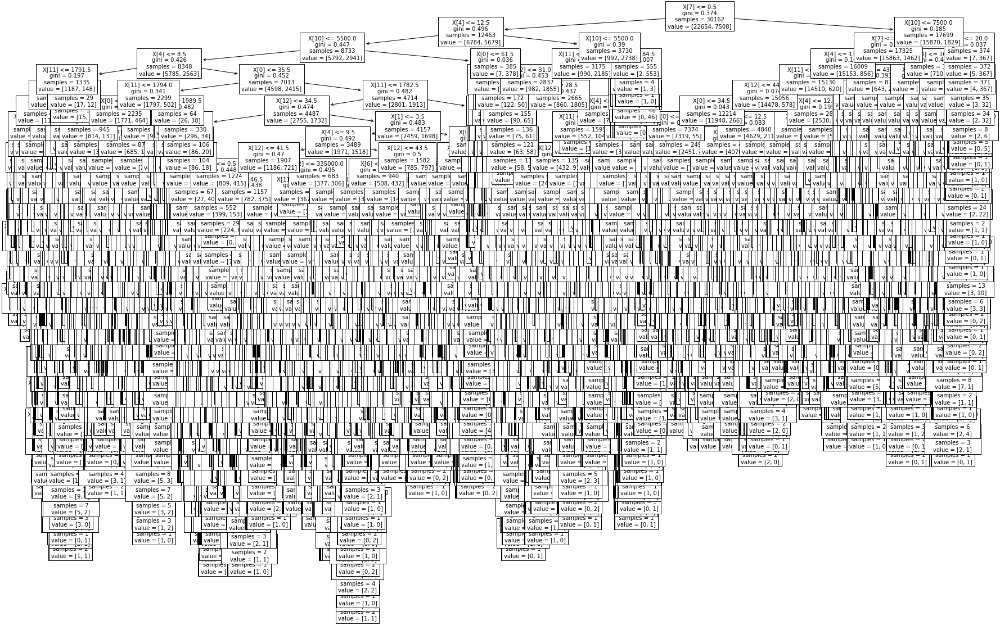

In [573]:
from sklearn import tree
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(30, 20))
tree.plot_tree(alltree, fontsize=10)
plt.show()